### Importing the necessary libraries

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import re
import nltk
import json

from textblob import TextBlob
from wordcloud import WordCloud

plt.style.use('fivethirtyeight')

### reading the given json file and converting it to dataframe

In [2]:
t = open(r"C:\Users\Pranav\Downloads\tweets.json", mode='r',encoding='cp1252')

In [3]:
data = json.load(t)

In [4]:
df1 = pd.DataFrame(data)

In [5]:
df1

,1374140386071961602,1374032432173842437,1373902876553048065,1373656782367813635,1372941634334232586,1372927482278539265,1372911723305394179,1372888121159868423,1372866915081797632,1372825553837944834,...,551388988372967425,551367485220745216,551150086517178368,551107822587748353,551106228404117505,551103473643945985,551102786675290112,550969541186953217,550941480525635584,550579446537678849
tweet_author,Hematopoiesis News,"Michael Wang, MD",1stOncology,Toby Eyre,Lymphoma Hub,David Ledger,N Wales Cancer Forum,European Pharmaceutical Review,Graham Collins,CLL Ireland,...,C A R E N,Werneth Cricket,"John P. Leonard, MD",Joy is a Lifestyle,Micheál 🇮🇪,Joy is a Lifestyle,𝓒𝓻𝓲𝔃𝔃𝔂 𝓟𝓮𝓻𝓻𝔂🌹,IQWiG,Medibooks,Medibooks
tweet_text,⚕️ Scientists conducted a Phase II study of ac...,This phase 2 Acalabrutinib-Venetoclax (AV) tri...,#NICE backs #AstraZenecas #Calquence for #CLL ...,#acalabrutinib is a valuable option in pts int...,NICE has recommended the use of acalabrutinib ...,NICE backs AstraZeneca’s Calquence for CLL htt...,This is England for now - these decisions usua...,"AstraZeneca’s Calquence (acalabrutinib), a che...",Superstar @tobyeyre82 responding to the excell...,CLL patients all know the drug Ibrutinib and y...,...,I miss them! 😋😆😅\n\n#FotoRus #FriendshipForeve...,"The fixtures are out, first team will travel t...",Partnering @GileadSciences &amp;Ono BTKi-combo...,Hanging out with Friends! :) #FF #CLL #Happine...,What I'd do to go to Gerrard's last game at An...,Hanging out with Friends! :) #FF #CLL #Happine...,Hanging out with Friends! :) #FF #CLL #Happine...,Zusatznutzen von #Idelalisib ist weder für #CL...,#Hematología PTK2 EXPRESSION AND IMMUNOCHEMOTH...,#Hematología MUTATIONS IN TLR/MYD88 PATHWAY ID...


### we can see that the converted dataframe needs to be transposed.


In [6]:
df2 = df1.T

In [7]:
df2.head()

,tweet_author,tweet_text
1374140386071961602,Hematopoiesis News,⚕️ Scientists conducted a Phase II study of ac...
1374032432173842437,"Michael Wang, MD",This phase 2 Acalabrutinib-Venetoclax (AV) tri...
1373902876553048065,1stOncology,#NICE backs #AstraZenecas #Calquence for #CLL ...
1373656782367813635,Toby Eyre,#acalabrutinib is a valuable option in pts int...
1372941634334232586,Lymphoma Hub,NICE has recommended the use of acalabrutinib ...


In [8]:
df2.shape

(43347, 2)

### converting the dataframe to csv file format

In [9]:
df2.to_csv('tweets.csv')

In [10]:
twitter = pd.read_csv(r"C:\Users\Pranav\Downloads\tweets.csv")

In [11]:
twitter.head()

,Unnamed: 0,tweet_author,tweet_text
0,1374140386071961602,Hematopoiesis News,⚕️ Scientists conducted a Phase II study of ac...
1,1374032432173842437,"Michael Wang, MD",This phase 2 Acalabrutinib-Venetoclax (AV) tri...
2,1373902876553048065,1stOncology,#NICE backs #AstraZenecas #Calquence for #CLL ...
3,1373656782367813635,Toby Eyre,#acalabrutinib is a valuable option in pts int...
4,1372941634334232586,Lymphoma Hub,NICE has recommended the use of acalabrutinib ...


In [12]:
twitter.shape

(43347, 3)

In [13]:
twitter.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 43347 entries, 0 to 43346
Data columns (total 3 columns):
 #   Column        Non-Null Count  Dtype 
---  ------        --------------  ----- 
 0   Unnamed: 0    43347 non-null  int64 
 1   tweet_author  43347 non-null  object
 2   tweet_text    43347 non-null  object
dtypes: int64(1), object(2)
memory usage: 1016.1+ KB


In [14]:
twitter = twitter.drop(['Unnamed: 0'], axis=1)

In [15]:
twitter.isnull().sum()

tweet_author    0
tweet_text      0
dtype: int64

In [16]:
twitter.tweet_author.value_counts()

Patient Power            1603
Paperbirds_Hematology    1510
VJHemOnc                 1079
Oncology Tube             714
Medivizor                 663
                         ... 
Streetwise Reports          1
Onco.com                    1
Investor's Champion         1
21                          1
𝓒𝓻𝓲𝔃𝔃𝔂 𝓟𝓮𝓻𝓻𝔂🌹               1
Name: tweet_author, Length: 9292, dtype: int64

*** we can see that "Patient Power" has the most number of tweets. 

In [17]:
twitter.tweet_text.describe()

count                                     43347
unique                                    41776
top       chronic lymphocytic leukemia慢性リンパ性白血病
freq                                         72
Name: tweet_text, dtype: object

*** it is evident that the most frequent tweet_text is "chronic lymphocytic leukemia慢性リンパ性白血病"

In [18]:
#twitter = twitter.drop(['_key'],axis=1)

In [19]:
twitter = twitter[0:40000]

Reducing the size of the data to avoid memory error

In [20]:
twitter.shape

(40000, 2)

In [21]:
twitter.head()

,tweet_author,tweet_text
0,Hematopoiesis News,⚕️ Scientists conducted a Phase II study of ac...
1,"Michael Wang, MD",This phase 2 Acalabrutinib-Venetoclax (AV) tri...
2,1stOncology,#NICE backs #AstraZenecas #Calquence for #CLL ...
3,Toby Eyre,#acalabrutinib is a valuable option in pts int...
4,Lymphoma Hub,NICE has recommended the use of acalabrutinib ...


In [22]:
from collections import Counter

In [23]:
col_list =  list(twitter["tweet_text"])


#### this will give us the word which occured the most
print("Given List:\n",col_list)
res = max(set(col_list), key = col_list.count)
print("Element with highest frequency:\n",res)

#### We need to create a user defined function to free the text from special symbols and unwanted characters

In [24]:
def cleanText(text):
    text =re.sub(r'@[A-Za-z0-9]+','', text)
    text =re.sub(r'#','',text)
    text =re.sub(r'RT[\s]+','',text)
    text =re.sub(r'https?:\/\/\S+','',text)
    
    return text

twitter['tweet_text'] = twitter['tweet_text'].apply(cleanText)

#show clean text

twitter.head(5)

,tweet_author,tweet_text
0,Hematopoiesis News,⚕️ Scientists conducted a Phase II study of ac...
1,"Michael Wang, MD",This phase 2 Acalabrutinib-Venetoclax (AV) tri...
2,1stOncology,NICE backs AstraZenecas Calquence for CLL
3,Toby Eyre,acalabrutinib is a valuable option in pts into...
4,Lymphoma Hub,NICE has recommended the use of acalabrutinib ...


### creating subjectivity and polarity scores for each record

In [25]:
# create a function to analyze subjectivity

def getsubjectivity(text):
    return TextBlob(text).sentiment.subjectivity

# create a function to analyze polarity

def getpolarity(text):
    return TextBlob(text).sentiment.polarity

# create new columns
twitter['Subjectivity'] = twitter['tweet_text'].apply(getsubjectivity)
twitter['Polarity'] = twitter['tweet_text'].apply(getpolarity)

twitter.head(5)

,tweet_author,tweet_text,Subjectivity,Polarity
0,Hematopoiesis News,⚕️ Scientists conducted a Phase II study of ac...,0.00,0.00
1,"Michael Wang, MD",This phase 2 Acalabrutinib-Venetoclax (AV) tri...,0.00,0.00
2,1stOncology,NICE backs AstraZenecas Calquence for CLL,1.00,0.60
3,Toby Eyre,acalabrutinib is a valuable option in pts into...,0.40,0.05
4,Lymphoma Hub,NICE has recommended the use of acalabrutinib ...,0.75,0.55


### plotting word cloud to see the most frequent word

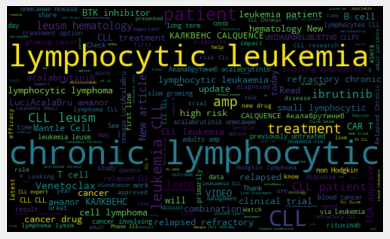

In [26]:
# plot the word cloud

allwords = ' '.join([twts for twts in twitter['tweet_text']])
wordCloud = WordCloud(width=500, height=300, random_state=21, max_font_size=119).generate(allwords)

plt.imshow(wordCloud, interpolation='bilinear')
plt.axis('off')
plt.show()

### analysing positive, neutral and negative sentiment based on polarity scores

In [27]:
# function to create negative, neutral, positive analysis.

def getanalysis(score):
    if score <0:
        return "Negative"
    elif score==0:
        return "Neutral"
    else:
        return "Positive"

twitter['Analysis'] = twitter['Polarity'].apply(getanalysis) 

twitter.head(5)

,tweet_author,tweet_text,Subjectivity,Polarity,Analysis
0,Hematopoiesis News,⚕️ Scientists conducted a Phase II study of ac...,0.00,0.00,Neutral
1,"Michael Wang, MD",This phase 2 Acalabrutinib-Venetoclax (AV) tri...,0.00,0.00,Neutral
2,1stOncology,NICE backs AstraZenecas Calquence for CLL,1.00,0.60,Positive
3,Toby Eyre,acalabrutinib is a valuable option in pts into...,0.40,0.05,Positive
4,Lymphoma Hub,NICE has recommended the use of acalabrutinib ...,0.75,0.55,Positive


### Below is a function to print all the positive and negative tweets which were identified by the algorithm.

In [28]:
# print all positive tweets

j=1
sortedDF = twitter.sort_values(by=['Polarity'])
for i in range(0, sortedDF.shape[0]):
    if(sortedDF['Analysis'][i] =='Positive'):
        print(str(j) +') '+sortedDF['tweet_text'][i])
        print()
        j = j+1

1) NICE backs AstraZenecas Calquence for CLL 

2) acalabrutinib is a valuable option in pts intolerant to ibrutinib. Further valuable data to help decision making in CLL 

Early View | Haematologica 

3) NICE has recommended the use of acalabrutinib for patients with treatment-naïve chronic lymphocytic leukemia. Find out more here  lymsm lymphoma

4) NICE backs AstraZeneca’s Calquence for CLL  

5) This is England for now - these decisions usually come to Wales too. 
More info

  

6) AstraZeneca’s Calquence (acalabrutinib), a chemotherapy-free monotherapy, will be offered to patients with chronic lymphocytic leukaemia.
oncology drugapprovals pharma healthnews
Find out more here:  

7) Superstar  responding to the excellent news of NICE approval of acalabrutinib in frontline CLL for FCR / BR unsuitable patients. 

8) CLL patients all know the drug Ibrutinib and yesterday in the UK Acalabrutinib was approved and now a new drug Pirtobrutinib is making a big impact for relapsed patients i

767) The addition of acalabrutinib to the combination of venetoclax and obinutuzumab was shown to be highly active in patients with newly diagnosed CLL, eliciting deep and durable responses that improved over time leukemia  

768) New article: Acalabrutinib and Its Therapeutic Potential in the Treatment of Chronic Lymphocytic Leukemia: A Short Review on Emerging Data.  CLL leusm hematology

769) Benjamin L. Lampson, MD, PhD, of  discusses the primary efficacy and safety findings from the ongoing phase II trial with acalabrutinib, venetoclax, and obinutuzumab in frontline CLL leukemia 

770) Will this acalabrutinib  early access programme extend to Irish patients who have few first line options?
  

771) Overall, Dr. Sharman said it is important to alert patients that headaches as an adverse event can occur with this treatment, but these do tend to pass in time, according to these findings.
 cllsm leusm

772) Great news for CLL pts in the UK that  will provide acalabrutinib for frontlin

CLL CLLsm 

1188) AstraZeneca Ends CLL Study Early After Endpoints are Hit | BioSpace  jobs biotech pharma oncology hematology

1189) Acalabrutinib plus obinutuzumab induces high rates of durable responses in chronic lymphocytic leukemia
Leusm ssbmt


1190) An AstraZeneca PLC (LON:AZN) drug being developed to treat chronic lymphocytic leukaemia has successfully navigated a phase III clinical trial. AZ’s Calquence, to use the jargon, demonstrated a statistically-signif...  via  Business BusinessNews 

1191)  AstraZeneca Ends Another Calquence Trial Early

1192) AstraZeneca ends another Calquence trial early 

1193) AstraZeneca Ends CLL Study Early After Endpoints are Hit  

1194) Acalabrutinib plus obinutuzumab induces high rates of durable responses in chronic lymphocytic leukemia. leukemia oncology 

1195) Calquence Phase III Elevatetn Trial Met Primary Endpoint At Interim Analysis In Previously-Untreated ChronicLymphocyticLeukaemia 

1196) “Treatment with acalabrutinib plus obinutuzu

1772) AstraZeneca Early Data Demonstrate Clinical Activity of Acalabrutinib in Difficult-to-Treat... Read more:  $AZN

1773) AstraZeneca Early Data Demonstrate Clinical Activity of Acalabrutinib in DifficulttoTreat C... Read more:  $AZN

1774) AstraZeneca Early Data Demonstrate Clinical Activity of Acalabrutinib in Difficult-to-Treat... Read more:  $AZN

1775) New data out for Btk inhibitors Imbruvica, acalabrutinib 

1776) Early Data Demonstrate Clinical Activity of Acalabrutinib in Difficult-to-Treat Chronic... | Business Wire 

1777) AstraZeneca PLC Release: Early Data Demonstrate Clinical Activity Of Acalabrutinib In Diffi... Read more:  $AZN

1778) Early Data Demonstrate Clinical Activity of Acalabrutinib in Difficult-to-Treat Chronic Lymphocytic... |  

1779) Early Data Demonstrate Clinical Activity of Acalabrutinib in Difficult-to-Treat Chronic Lymphocytic Leukaemia 

1780) Acalabrutinib Safe, Effective in Ibrutinib-Intolerant CLL/SLL 

1781) Early Data Demonstrate Clinical Acti


2187) My poem "taken". I wrote it 2016, 6 months after successfully completing treatment for HepC that I acquired as teenager in late 1960s. But I got progressively sicker post-tx. Eventually diagnosed chronic lymphocytic leukemia (CLL). Am ok today. But this is how it looked then. 

2188) A 76 y/o woman w/ chronic lymphocytic leukemia on ibrutinib is noted to be in asymptomatic AFib on a routine EKG performed for consideration of clinical trial participation. What is the best strategy for anticoagulation?  

Vote:  CardioOnc ACCED

2189) New article: Outcomes in CLL patients with NOTCH1 regulatory pathway mutations  CLL leusm hematology

2190) Rural Settings and the CLL Patient: Final live CME webinar February 27th. Strategies to address barriers to care, treatment adherence,  integrating CMS measures and more.  

2191) If any doctor on twitter can answer this question for me, I would appreciate it greatly! 

What type of doctor /specialist,  does/should , treat someone with 
Chronic

reniform nucleus 

2659) A Very Rare Case Presentation of Chronic Lymphocytic Leukemia Occurring during the Course of Chronic Myeloid Leukemia
By: Patkar Salil, Panchal Harsha*, Asha Anand, Patel Apurva and Parikh Sonia

Read the full text article:  

2660) Epigenetic regulation of steroidogenic enzymes expressed in peripheral blood mononuclear cells from healthy individuals and from patients with chronic lymphocytic leukemia. 

2661) New article: Genomic Instability and Clonal Evolution in Chronic Lymphocytic Leukemia: Clinical Relevance.  CLL leusm hematology

2662) New article: Microenvironment Remodeling and Subsequent Clinical Implications in Diffuse Large B-Cell Histologic Variant of Richter Syndrome.  CLL leusm hematology

2663) New article: Bruton tyrosine kinase inhibitors for the frontline treatment of chronic lymphocytic leukemia.  CLL leusm hematology

2664) New article: Refractory Chronic Lymphocytic Leukemia with Central Nervous System Involvement: A Case Report with Lite


3113) Good news from Australia
Drug combination approval 
Deborah Sims  CLL patient shares her amazing story on Australian news.
   _foreningen 

3114) Great news for CLL patients in Australia. They will have access to a combination of drugs proven to save lives.
Also good to see the Australian govt  focus attention on blood cancer.

 
 

3115) How is ChronicLymphocyticLeukemia diagnosed?

While there is no early screening process for CLL as of now, there are a number of accurate testing methods for the disease. Here's what a routine diagnosis might look like:

For More: 
leusm 

3116) New article: Serine-70 phosphorylated Bcl-2 prevents oxidative stress-induced DNA damage by modulating the mitochondrial redox metabolism.  CLL leusm hematology

3117) Our research project in CLL utilizes bigdata to predict outcomes in individuals with specific biomarkers of disease. Learn more about this project in chroniclymphocyticleukemia:   leusm 

3118) Disease flare when interrupting ibrutinib in

3519) Once diagnosed with CLL, telling loved ones is likely a top concern.

CLL patient , CLL patient &amp; advocate Leslie Powell and Robin Katz of the  share tips &amp; advice for telling others about your diagnosis.


3520) Erlene Seymour, MD, of , discusses the use of ibrutinib versus chemoimmunotherapy in older patients with untreated chronic lymphocytic leukemia leusm CLL


3521) Chronic lymphocytic leukemia is primarily a cancer of adults &amp; is a slow growing cancer involving lymphocytes. CLL  

3522) Prognostic and predictive role of gene mutations in chronic lymphocytic leukemia: results from the pivotal phase III study COMPLEMENT1 | Haematologica 

3523) TBT 5 years ago the  we're playing great baseball on their way to a WorldSeries berth and I was getting ready to present  CHEST2015 on LeukemicLungDisease BronchoPulmonaryLeukemicInfiltrates CLL pulmcc and POCUS teaching.... TimeFlies

3524) Webinar: "CLL Treatment: Finding the Best Option for YOU" Tues, Oct 27th - 10am PT

3914) 🎙 In a new podcast series, featuring Dr. Roger Strair, chief of blood disorders at  &amp; Dr. Seth Cohen of  Health we learn new insights into CLL treatments, clinical trials &amp; more.

Full Podcast:  

3915) New article: Disease Flare During Temporary Interruption of Ibrutinib Therapy in Patients with Chronic Lymphocytic Leukemia.  CLL leusm hematology

3916) New article: Population-based epidemiological data of follicular lymphoma in Poland: 15 years of observation.  CLL leusm hematology

3917) New article: Evaluation of immunophenotypic markers and clinico-hematological profile in chronic lymphocytic leukemia: implications for prognosis.  CLL leusm hematology

3918) New article: When CLL meets COVID-19.  CLL leusm hematology

3919) New article: Allogeneic hematopoietic cell transplantation after prior targeted therapy for high-risk chronic lymphocytic leukemia.  CLL leusm hematology

3920) ✔️Both watch-and-wait and treated CLL patients have high mortality rates (37 vs 32%) w

4328) Chronic lymphocytic leukemia is primarily a cancer of adults &amp; is a slow growing cancer involving lymphocytes. CLL  

4329) With the global coronavirus pandemic changing the way we live and work, what has 2020 taught us about learning? Read our latest blog now:        BSIUK CLL 

4330) New article: Comparison of Access to Novel Drugs for Lymphoma and Chronic Lymphocytic Leukemia Between India and the United States.  MMSM MultipleMyeloma hematology 

4331) Save the date - LIVE webinar 18 August. Join our special CLL event with international guests: A/Prof Matt Davids, Dana Farber Cancer Institute (USA) &amp; Dr Brian Koffman, Founder CLL Society USA, CLL patient/ doctor. 
Register:  

4332) HOMEGAME this weekend v otahuhuleopards in our FoxMemorial game Saturday 
No.2 v No.6  Both our Waipareira Sponsored TatPremiers and TatReserves looking to get back to winning ways.
CLL
veisarikid 
_Whanau… 

4333) An excellent collaborative international effort led by  &amp;  looking at CL

-w/ Dr. Jennifer Brown of  

4672) Hear Lydia Scarfo of  discuss the relationship between COVID19 and chronic lymphocytic Leukemia patients 💻👩‍⚕️🎬

Full interview here: 👉

EHA25Virtual  _Hematology EHA25 HemOnc CLL Leusm EHAtrending

4673) Scarfo et al
BTK &amp; PLCG2 mut relapsing post ibrutinib (full dose, minimal interruptions)
ERIC initiative
Targeted deep sequencing 
- 50% BTK mut
- PLCG2 mut rarely isolated w/out BTK mut (16% overall)

Non-covalent BTKi under encouraging Ix in space CLL lymsm EHA25Virtual 

4674) Michallet et al

Response adapted Rx based on BM MRD (-ve:&lt;0.01%) at 9m post ibrutinib+obinutuzumab 

MRD-ve: ibrutinib mono 9-&gt;16m
MRD+ve: FC-obinx4 in 1L CLL pts

Interesting concept &amp; effective overall strategy but 120/130 receive FC as few reach MRD-ve lymsm EHA25Virtual 

4675) Selective BTK inhibitor second generation. Drug for chronic lymphocytic leukemia and Mantle Cell lymphoma. Could be useful but we need randomized trial. Issue: time to effect probab


5013) Research from Pascal Lefevre lab :  DAPK3 participates in the mRNA processing of immediate early genes in CLL  

5014) It’s been grad day for many with no in-person ceremony. Today feels like graduation day for my “babies” umbralisib &amp; ublituximab. (U2 in the UNITY-CLL trial). Here’s to U2 being nurtured &amp; now flying high in good hands! Congrats 2 the TG team, sites, PIs, patients. cll $TGTX

5015) It’s been graduation day for many with no in-person ceremony. Today feels like graduation day for my “babies” umbralisib and ublituximab. (U2 and the UNITY-CLL trial). Here’s to U2 being nurtured and now flying high in good hands! Congrats to the team, sites, patients. cll

5016) $TGTX (+27% PM) TG announced positive topline results from the UNITY-CLL Phase 3 study evaluating the combo of umbralisib plus ublituximab (U2) in r/r CLL.

Met primary endpoint of improved PFS (p&lt;.0001) and will be stopped early for superior efficacy.



5017) Today, Health Canada approved a new f

5609) Great meeting &amp; great job by Andy as co-chair. lymphoma CLL 

5610) In line with the  monthly educational theme, take a look at the July 2019 _FDA approval of rituximab-pvvr for the treatment of CLL ➡️  lymsm 

5611) New article: Overview of current microRNA biomarker signatures as potential diagnostic tools for leukaemic conditions.  CLL leusm hematology

5612) New article: A 5-year follow-up to evaluate the efficacy and safety of ofatumumab added to fludarabine and cyclophosphamide in patients with relapsed chronic lymphocytic leukemia: final analysis of the COMPLEMENT 2 trial.  CLL leusm hematology

5613) New article: Is There a Role for Chemotherapy in the Era of Targeted Therapies?  CLL leusm hematology

5614) New article: HDAC3 functions as a positive regulator in Notch signal transduction.  CLL leusm hematology

5615) New article: Bendamustine, followed by ofatumumab and ibrutinib in chronic lymphocytic leukemia (CLL2-BIO): primary endpoint analysis of a multicentre, o

6176) Those living with CLL want to know what their choices are for treatment, including clinical trial opportunities. Is there an open trial that’s suitable for me? How can I learn more about enrollment?  

6177) This article reports absolutely fantastic news and a reminder of why I annually pester everyone to sponsor me. Thank you to everyone who supports my fundraising ventures bloodwise cll hope  research clinicaltrials beatingbloodcancer 

6178) Chronic lymphocytic leukemia is primarily a cancer of adults &amp; is a slow growing cancer involving lymphocytes. CLL  

6179) Herbal Turmeric, a Natural Prevention and Treatment of Chronic Lymphocytic Leukemia 

6180) VIDEO: Promising treatments are coming: a message to Lymphoma and CLL Patients, w/ Geroge Follows from _NHS:  

CancerTreatment PatientCare BloodCancer

6181) New article: A case of CNS aspergillosis in a patient with chronic lymphocytic leukemia on first-line ibrutinib therapy.  CLL leusm hematology

6182) New article: Pro


6517) Almost 8 years of continued collaboration on many CLL NHL projects and manuscripts. More work to be done moving forward. here is to team Work at ASH19 and beyond. 

6518) PhysRelations "LeukemiaMDA: ASH19 | 12/8 8:15 AM | Venetoclax Added to Ibrutinib in High-Risk CLL Achieves a High Rate of Undetectable Minimal Residual Disease. [RTS1] | Philip A. Thompson, M.B., B.S. of MDAndersonNews LeukemiaMDA | … 

6519) New article: Quantification of Differential Transcription Factor Activity and Multiomics-Based Classification into Activators and Repressors: diffTF.  CLL leusm hematology

6520) New article: Enhancing Model Interpretability and Accuracy for Disease Progression Prediction via Phenotype-Based Patient Similarity Learning.  CLL leusm hematology

6521) New article: Pathophysiology of chronic lymphocytic leukemia and human B1 cell development.  CLL leusm hematology

6522) ASH19 | 12/8 8:15 AM | Venetoclax Added to Ibrutinib in High-Risk CLL Achieves a High Rate of Undetectable 

6995) Expert Access 2019 Now Open
Speak to an expert CLL physician for free and with easy accessibility, enroll today!

MyExpertAccess
CLL CLLsm 

6996) Ibrutinib + venetoclax for R/R CLL.
At 21 months of follow up, only 1 patient progressed. High rates of MRD👇👇👇
hematology smallmolecules

  

6997) SF3B1, an important gene for MDS and CLL has its function further elucidated 

6998) Expert Access 2019 Now Open

Speak to an expert CLL physician for free and with easy accessibility, enroll today!



CLL CLLsm 
MyExpertAccess

6999) Great Leukemia seminar _kettering by  on Next-generation sequencing in CLL leusm lymsm 

7000) DYK:  estimates there will be more than 20,000 new cases of CLL in 2019. Learn more about the different types of CLL at  NationalHealthEducationWeek 

7001) Watch our latest episode of AskAlex, where 's PrecisionOncology expert Alex Rolland answers your questions about cancer &amp; then does a deep dive into Lymphoma: CLL and Follicular – New Treatments &amp; Advance

7452) ASH 2016 Page 2 Update on New Chronic Lymphocytic Leukemia Drugs  

7453) Chronic lymphocytic leukemia is primarily a cancer of adults &amp; is a slow growing cancer involving lymphocytes. CLL  

7454) Mutated ATM and unmutated IGHV identified as potential early drivers of disease in treatment-naive patients with chronic lymphocytic leukemia–
 oncology

7455) Our HIF1 alpha antibody helped show that distinct activities of glycolytic enzymes identify chronic lymphocytic leukemia patients with a more aggressive course and resistance to chemo-immunotherapy.  

7456) In our latest publication, learn about the current CLL treatment landscape and learn how , , and  developed best practices:  

7457) "The key things about the class to me was saving time, hotel cost, and arduous traveling." Read some of our Connected Learning Live testimonials to learn about more potential benefits for your company. CLL
 

7458) What new therapies are in the pipeline for CLL? cll specialist and dedicated

7849) Chronic lymphocytic leukemia is primarily a cancer of adults &amp; is a slow growing cancer involving lymphocytes. CLL  

7850) Chronic lymphocytic leukemia (CLL) care is not one-size-fits-all, how do doctors and patients work together to find the most suitable treatment? Watch our video with leading expert Dr. Wierda  from .   

7851) New combination for chronic lymphocytic leukemia 💙

7852) Coping with separation in my latest post about finding humor while surviving cancer: "The Beginning of the End." cll leukemia cancer lymphoma lls survivor cancerhumor cancersucks fightcancer chronicillness separation…  

7853) What can patients do if they have medical bills they can't afford? Listen as a panel of experts discuss available options  
cll medicalbills livewell patientpower

7854) Agree. Genetic tp53 and CKT abnormalities show room for improvement in CLL therapy. Need to define more efficient treatments. CAcells? 

7855) Concluding their conversation on access to oral oncolytics

staffawards cll yourteam 

8281) Nice update from Talha Munir  from the  conference on the _res funded CLARITY trial - making a bit impact for people with CLL. Thanks  

8282) Say Hi to the latest addition to our group - Katrine Melvold will do her master’s thesis on CLL, PhosphoFlow and DrugSensitivity. Let’s have some fun in the lab! 

8283) Treating Older Patients with Chronic Lymphocytic Leukemia: A Personalized Approach CLL  geriatrics 

8284) . - Great finally meeting you   &amp;  CLL Treatment Updates. THANK YOU for all you do for patient.  CLL ChronicLymphocyticLeukemia 

8285) Chronic lymphocytic leukemia is primarily a cancer of adults &amp; is a slow growing cancer involving lymphocytes. CLL  

8286) JITC Research: STIM1 at the plasma membrane as a new target in progressive chronic lymphocytic leukemia  

8287) I had my last chemo treatment on April 10th. I am finishing my fight with C.L.L. (Chronic Lymphocytic Leukemia) stay strong. I fight hard to give others strength and 

8654) Enormous thanks to everyone who joined us in Cambridge on Friday. We had a fantastic attendance, enthusiastic discussions &amp; brilliant speakers from  &amp; _NHS. Thankyou for all your time &amp; support! haematology CLL leukaemia bloodcancer psychology 

8655) The story of how our friend Deborah Sims helped change hundreds of CLL patients lives in Australia getting Venetoclax available there for the price of a normal prescription. We need to get this drug similarly approved &amp; at low cost for Irish patients
 

8656) I am interested in hematological diseases, in particular Chronic Lymphocytic Leukemia which can be diagnosed by Technology Test FISH, deletion  chromosome. 
  I believe that this research upon completion using FISH molecular technique could contribute to a new breakthrough in CLL

8657) New by : Outcomes of patients with chronic lymphocytic leukemia taking ibrutinib  Leukemia

8658) Chronic lymphocytic leukemia is primarily a cancer of adults &amp; is a slow gro

9080) Ibrutinib alone or in combination with rituximab produced superior progression-free survival in older adults with CLL than traditional first-line chemotherapy and targeted therapy, albeit with the risk of significant toxicity. ASH18  

9081) Watch as CLL expert Dr. Susan Leclair helps patients understand the purpose of the watch-and-wait strategy &amp; more:  leusm 

9082) . is seeking individuals who have been treated with GAZYVA  to share their experiences For more info email cindy.info lymsm FL leukemia CLL

9083) VIDEO: Promising treatments are coming: a message to Lymphoma and CLL patients, with George Follows of _Uni:   Leusm Lymsm PatientCare Hematology Hodgkin DrugAccess NovelTherapy Lymphoma

9084) The RSBShow  on 
Media mental manipulation, Iron toxicity, Copper deficiency, NFL eyesight exams,  Advanced Medicine, WHO vaccine hesitancy, Chronic Lymphocytic Leukemia Child anxiety depression, immunesystem cancer…
 

9085) NCIC latest- great work  High rates of proven invas

9378) In my opinion the best player ever to were the shirt. Happy birthday JT 💙💙💙💙💙 CLL  

9379) Phase 3 trial finds ibrutinib in combo with rituximab superior to standard treatment for some patients with CLL   leukaemia oncology pharma

9380) “Despite its efficacy, the majority of patients will relapse on venetoclax and up until now, we really didn’t have a good idea about why people were relapsing."

CLL leusm ASH18

9381) News: More favourable results for ibrutinib in chronic lymphocytic leukemia; the BTK inhibitor - either given alone or alongside rituximab - outplays chemoimmunotherapy wrt PFS. Study by Jennifer Woyach (_James) et al in , presented at ASH18 

9382) Chemoimmunotherapy Is Not Dead Yet in Chronic Lymphocytic Leukemia: Journal of Clinical Oncology: Vol 35, No 26 

9383) Straight from ASH - the latest in CLL treatments from two top specialists - very exciting to hear about all the new options!   ASH18 CLL CLLsm

9384) Early Dose-Escalation Data for Potential Treatment 


9663) VIDEO: Complete Epigenome of CLL reveals important areas of dysregulation with Iñaki Martín-Subero from :   ERIC18 Leusm Epigenetics Genome Genetics Camoldx Caxtx Oncopath Globonc  MedOnc DrugTargets CancerTargets

9664) A good overview on cll if you’ve been recently diagnosed 🎗👩‍⚕️leukaemia 



9665) A pilot study of lower doses of ibrutinib in patients with chronic lymphocytic leukemia thought provoking study. If confirmed in a bigger study, can significantly reduce the cost of care excellent news from NHS prospective ⁦⁦_simon⁩  

9666) What is CryptoLiveLeak? 

- Online Social Blog: Attention Mine CLL
- Marketing for Blockchain Companies and Foundations
- Press Coverage for Blockchain
- Cryptocurrency News and Media
- Social Influencer
- Event planning, Hosting, Speaking

Message us to collaborate!

9667) Chronic lymphocytic leukemia is primarily a cancer of adults &amp; is a slow growing cancer involving lymphocytes. CLL  

9668) While positive thinking &amp; physical activi

 

10248) Learn about treatment options and navigating life with Chronic Lymphocytic Leukemia (CLL). Register for this free workshop at Cancer Support Community  CLL 

10249) Comparison of clinical features and survival between young and old chronic lymphocytic leukemia patients: a single center study from Turkey. lymphoma lymsm 

10250) New mRNA Cancer Drivers Revealed in ChronicLymphocyticLeukemia  

10251) New blog post! How should you feel when your CLL tests come back as practically perfect? Read this guest blog from Larry Saltzman, executive research director of  for his thoughts  

10252) Full-length transcript characterization of SF3B1 mutation in chronic lymphocytic leukemia reveals downregulation of retained introns 

10253) Full-length transcript characterization of SF3B1 mutation in chronic lymphocytic leukemia reveals downregulation of retained introns   biorxiv_genomic

10254) Full-length transcript characterization of SF3B1 mutation in chronic lymphocytic leukemia reveal

10671) Precision medicine is effective in treating chronic lymphocytic leukemia  

10672) A study of real-world venetoclax-treated patients with chronic lymphocytic leukemia (CLL) found results consistent with those seen in clinical trials.
 

10673) VIDEO: How to choose between a multitude of new CLL drugs?  from  _kettering  speaks to us at the recent ASCO18 congress:   Leusm cllsm HemOnc Leukemia caxtx PatientCare NovelTherapies DrugSequencing Tolerability

10674) “These findings strongly suggest obinutuzumab be the preferred CD-20 antibody when combined with chlorambucil and also that obinutuzumab should be the preferred CD-20 antibody used in further combination regimens in CLL,” Dr. Goede said.

leusm CLL

10675) CLL functional cure  within rich for most combination leusm 

10676) The light chain IgLV3-21 defines a new poor prognostic subgroup in Chronic Lymphocytic Leukemia: results of a multicenter study 

10677) Chronic lymphocytic leukemia is primarily a cancer of adults &amp


11180) This is sure to be a great day, excellent programme &amp; the opportunity to meet others affected by CLL. Hope all goes well  from everyone here in the UK. We have  national patient &amp; carer conference next Saturday with  leading CLL session 

11181) Free  health &amp; wellbeing event for people who have recently finished treatment for lymphoma (UK's fifth most common cancer NHL Hodgkin CLL ) at Cecily Saunders building  find out more    

11182) Although feasible, we should be aware of infectious complications in older patients with CLL and therefore, monitor them closely and give appropriate prophylaxis gerionc geriheme 

11183) Efficacy Of Bendamustine And Rituximab As First Salvage Treatment In Chronic Lymphocytic Leukemia And Indirect Comparison With Ibrutinib: A GIMEMA, ERIC And UK CLL FORUM Study 

11184) The odds ratio of grade 3-4 hematologic [OR 1.70; p = 0.009: 95% CI (1.57-1.84)] and non-hematologic toxicities [OR 1.47; p = 0.022; 95% CI (1.39-1.55)] were increas

11612) Approaches for identifying patients with chronic lymphocytic leukemia at higher risk for disease progression have been refined. CLL leusm
 

11613) An important conversation about batting mechanics CLL orangetheory farm @ Hardtke Baseball… 

11614) Chronic lymphocytic leukemia is primarily a cancer of adults &amp; is a slow growing cancer involving lymphocytes. CLL  

11615) ibrutinib use in hematological malignancies (CLL, MCL, WM) and risk of HBV reactivation in patients with prior resolved Hepatitis B infection. 

Important observations by Dr. Sarah Hammond   and team!


NoHep HepatitisB TID 

11616) Too good 👌! Soccer ball morphology in Chronic lymphocytic leukemia CLL Hempath 

11617) The first of March, will always be a poignant day.
A day that we reluctantly recognise.
Our outlook on life was forever altered.
It is the day that Matt was diagnosed with cancer.
We do not celebrate this day. 
But we do celebrate life.
CLL Leukaemia Cancer BloodCancer 

11618) Chronic lymphoc

12090) Chronic lymphocytic leukemia is primarily a cancer of adults &amp; is a slow growing cancer involving lymphocytes. CLL  

12091) Our good friends in the  look at 15 top questions about Ibrutinib in this review of Biologic vs Immunotherapy treatments for CLL   

12092) Survey Helps Doctors Better Understand Therapy Choices by Chronic Lymphocytic Leukemia Patients. Read more &gt;&gt; 

12093) Update on New Chronic Lymphocytic Leukemia Drugs  

12094) New Developments in Ibrutinib for Chronic Lymphocytic Leukemia - Cancer Therapy Advisor 

12095) Chronic lymphocytic leukemia is primarily a cancer of adults &amp; is a slow growing cancer involving lymphocytes. CLL  

12096) XVII International Workshop on Chronic Lymphocytic Leukemia 2017 May 12--15, 2017, New York.  leukemia 

12097) VIDEO: The DUO trial: providing new hope for CLL patients, with Stephan Stilgenbauer of _ulm:  ASH17 _hematology medonc hemeonc leusm cllsm

12098) If you need medicines through the holiday period, nows

12475) CD19 CAR T cells are highly effecting in treating chronic lymphocytic leukemia.
 

12476) It was great meeting our friends from CLL ( Club des Logiciels Libres ) :D 
Such a great event 🐧🐧🐧🐧🐧🐧
OSSEC
CLL... 

12477) Study: CAR T-Cell therapy highly effective in high-risk chronic lymphocytic leukemia
 

12478) Chronic Lymphocytic Leukemia: A Rare Cause of Pathological Fracture of the Femur. 

12479) John G. Gribben, MD, DSc, FMedSci from  presents us Managing Patients With Newly Diagnosed Chronic Lymphocytic Leukemia in 2017!

12480) Acute promyelocytic leukemia and chronic lymphocytic leukemia diagnosed concurrently  


12481) Many CLL pts are on imbruvica. But what if the CLL outsmarts the drug? What then? Dr. Keating explains 

12482) BloodCancer news FDA approves CAR-T cell therapy to treat adults w/ certain types of large B-cell lymphoma  CLL

12483) New flowcytometry poster on CD49d expression in CLL &amp; SLL, from 32nd Annual Clinical Cytometry Meeting _ICCS  

12484) PC | 

12805) Assessing Response to New Treatments For Chronic Lymphocytic Leukemia  

12806) New CLL research study now available. There is no placebo. See if you qualify here: 

12807) Looking for new solutions for CLL?  explores CLL treatment w/ expert Dr. Jeff Sharman. Check it out! 

12808) The latest The Mike Paetzold Daily!  Thanks to  lymphoma cll

12809) More than 17 hospitals are already supporting our project in Chronic Lymphocytic Leukemia CLL  _es 

12810) More about the chemo experience - now with resources! Lymphoma cll 

12811) As i kiss my grandkids good night  Republicans R taking my healthcare away not a good thing 4 my fam SPMS and CLL both preexisting

12812) A positive review of current and future chronic lymphocytic leukemia treatments  

12813) Thanks to Sophie Laird from  Genetics Lab for her article on the XVII International Workshop on CLL.


12814) Want to know how Andrew is doing on Day 2 of CLL re-treatment? Join him &amp; Esther for a FB Live today 12 PT by liki

13234) . - follow them &amp; see the latest in my series of CLL video reports. clinicaltrials patientengagement PatientExperience 

13235) 59 (5-8): 'Outstanding' results announced from new blood cancer study. CLL leukaemia ONO_GS4059

13236) Therapeutic CD94/NKG2A blockade improves natural killer cell dysfunction in CLL - PubMed lymsm 

13237) CLL pts with high-risk genetics respond well with minimal toxicity to ONO/GS-4059 therapy - read more here:  lymsm 

13238) More about the chemo experience - now with resources! Lymphoma cll 

13239) CLL patient Andy shares his experiences on life, treatment &amp; epic fundraising challenges. to raise awareness:  

13240) New CLL research study now available. There is no placebo. See if you qualify here: 

13241) CLL though stable. Also old. 

13242) It was our honour to welcome you to Ireland &amp; enable the CLL community hear your inspirational story of hope. 

13243) Review benefits &amp; challenges of oral CLL therapies plus strategies for 

nobody tested Ibrutinib plus rituximab? better comparison JeffSharmanMD  ?

13519) Clonal kinetics - wow! Fantastic insight into future perspectives on CLL research and therapy. 

13520) Multidisciplinary team experts address critical aspects of care, communication strategies and more! CLL 

13521) TG Therapeutics’ med ublituximab hit its primary endpoint in a phase 3 study in chronic lymphocytic leukemia.



13522) $TGTX +83% $9.82 positive Ph3 GENUINE clinical trial of TG-1101 for patients with previously treated high risk Chronic Lymphocytic Leukemia.

13523) TG Therapeutics Announces Positive Topline Data from Phase 3 GENUINE Study of TG-1101 in Combination with Ibruti.. 

13524) TG Therapeutics Announces Positive Topline Data from Phase 3 GENUINE Study of TG-1101 in Combination with…  forex

13525) TG Therapeutics reports positive topline data in Phase 3 study of TG-1101. 
$TGTX halted premarket
biotech stocks 

13526) CpG-DNA taking its TOLL in lymphoma CLL myeloma Bcells leukemi


13951) Ibrutinib superior to idelalisib in patients with CLL   ASH16 leukemia leusm

13952) Ibrutinib superior to idelalisib in patients with CLL   ASH16 leukemia leusm

13953) Best practice management of CLL:  blooducation oncology 

13954) Pathologists have you ever made blood cookies? Chronic lymphocytic leukemia looks delicious! pathology 

13955) Targeted deep sequencing reveals clinically relevant subclonal IgHV rearrangements in chronic lymphocytic leukemia 

13956) Important on CLL &amp; possible complications of newer Tx.     

13957) Seeking more options for CLL? A new ClinicalTrial is enrolling now. No placebo Learn more:  

13958) Q: What are the most important factors for estimating chance of CLL recurring?  A: Chromosomal changes (cytogenetics)

13959) What is the Current and Future Economic Burden of CLL in the US? 

Read more here:  lymsm Lymphoma 

13960) Blog from one of our lovely patients with CLL, sharing her experiences and talking about taking part in research 


14510) The latest The Mike Paetzold Daily!  Thanks to   lymphoma cll

14511) LIH’s Department of Oncology's scientists awarded for their outstanding scientific publication !
 lih fnrawards

14512) CHMP adopts positive opinion for our treatment for certain patients with chronic lymphocytic leukemia CLL: 

14513) What’s it like to be single, attractive &amp; living w/ CLL? Jennifer Abraham explains   PowerfulPatient

14514) citohans: Great review on Venetoclax`s road to development. CLL. Innovation.  

14515) Great review on Venetoclax`s road to development. CLL. Innovation.  

14516) Positive CHMP opinion on  treatment for Chronic Lymphocytic Leukemia CLL. _Commission final decision expected by end of 2016. 

14517) Our Latest News: CHMP adopts positive opinion for our treatment for certain CLL patients: 

14518) More about the chemo experience - now with resources! Lymphoma cll 

14519) Please R/T: New CLL ClinicalTrial enrolling now. There is no placebo. See if you qualify.  

14520) 


14926) Great to see local research into TP53 mutations in CLL having a national &amp; European impact!
CLL leukaemia 

14927) Do you have relapsed CLL? A new trial is actively enrolling in your area now. No placebo. Learn more. 

14928) My patient with chronic lymphocytic leukemia (CLL) and normal renal function has mysteriously developed a… 

14929) CLL is the most common adult leukemia in Canada. There is no cure. The goal is to control disease progression. 

14930) Advances in Treating High-Risk CLL:  interviews Dr. Jeff Sharman and discusses potential new options.  

14931) Hosting tryouts at 3pm Est 
Funded org
Round 1 
CLL 
Ps4
Dm if interested 
bo3
 
_CREW 
 


14932) Relapsed, high-risk CLL? A new trial is actively enrolling in your area now. Learn more. 

14933) VIDEO: Lawrence Boise, PhD on the mechanism of action of venetoclax and its potential in treating CLL. ~ 

14934) ibrutinib &amp; obinutuzumab are recommended by hematologists _hematology for Tx of older pts with CLL 

15273) Maintenance rituximab betters PFS but not OS in CLL . asks Is it worth it?  

15274) TP53 mutations are early events in chronic lymphocytic leukemia disease progression and precede evolution to… 

15275) Thanks to Dr. Ghia, Dr. Gordon, Dr. Stilgenbauer &amp;  for leading great conversations on CLL management today EHA2016 EHA16

15276) Please share. An important new clinicaltrial is available for relapsed CLL. No placebo.  

15277) Relapsed, high-risk CLL? A new trial is actively enrolling in your area now. CureClick  

15278) $50 Lyft ride credit for new users. Download Lyft app and enter code BNB in Payment section  adha cll

15279) Packed 41st meeting of ERIC on their latest CLL research eha2016 _Hematology 

15280) The rivalry between Lake Park, Eastern and Central will forever live on CLL

15281) Do you have relapsed CLL? A new trial is actively enrolling in your area now. No placebo. Learn more. 

15282) Special Regulatory Designations to Create Opportunities for the Globa


15858) Targeted Leukemia Rx Gets Green Light 

15859) Targeted Leukemia Rx Gets Green Light 

15860) Targeted Leukemia Rx Gets Green Light -  

15861) Targeted Leukemia Rx Gets Green Light -  

15862) Targeted Leukemia Rx Gets Green Light -  

15863) Targeted Leukemia Rx Gets Green Light -  

15864) Targeted Leukemia Rx Gets Green Light -  

15865) Targeted Leukemia Rx Gets Green Light -  

15866) Targeted Leukemia Rx Gets Green Light -  

15867) Researchers are testing a new investigational drug designed to improve outcomes for patients with CLL (Chronic... 

15868) Looking for options for relapsed CLL? A new clinicaltrial may be an option. Click to learn more. 

15869) Relapsed, high-risk CLL ? A new trial is actively enrolling in your area now. Learn more. cancer cancertrial 

15870) Venclexta Approved for Chronic Lymphocytic Leukemia, Available at Biologics, Inc. 

15871) Targeted Leukemia Rx Gets Green Light -  

15872) Targeted Leukemia Rx Gets Green Light -  

15873) Targeted L


16293) Early this month the FDA approved Imbruvica for it's 5th treatment indication.
 cancer CLL 

16294) Early this month the FDA approved Imbruvica for it's 5th treatment indication.
 cancer CLL 

16295) (E1908) phase II randomized trial compares standard &amp; low dose rituximab with alemtuzumab to treat CLL in older... 

16296) Thanks to  and  for an awesome event at the Red and White Gala. A lot of money raised for CLL research.

16297) Dr Thomas Kipps: How far are we from a cure for CLL?  CLL 

16298) A high rate of telomeric sister chromatid exchange occurs in chronic lymphocytic leukaemia B-cells.  leukemia

16299) Patient Power's CLL Week-In-Review with experts from    &amp; more 

16300) Join us to create new ways to support patients living w/ cancers like CLL. Learn more...  

16301) It's a 4 part strategy game between the disease, me, meds, and the devil. I'm winning but there are so many damn moves. CLL remission

16302) EMJvideo - Exciting explosion of new drugs in CLL.

16986) Mutations in chronic lymphocytic leukemia suggest potential new uses of existing cancer drugs 

16987) New: Mutations in chronic lymphocytic leukemia suggest potential new uses of existing cancer drugs 

16988) Chronic lymphocytic leukemia mutations suggest new uses of existing cancer drugs - EurekAlert (press release) 

16989) Mutations in chronic lymphocytic leukemia suggest potential new uses of existing cancer drugs 

16990) Mutations in chronic lymphocytic leukemia suggest potential new uses of existing cancer drugs   science health

16991) Mutations in chronic lymphocytic leukemia suggest potential new uses of existing cancer drugs - 

16992) Mutations in chronic lymphocytic leukemia suggest potential new uses of existing cancer drugs … 

16993) Mutations in chronic lymphocytic leukemia suggest potential new uses of existing cancer drugs 

16994) Mutations in chronic lymphocytic leukemia suggest potential new uses of existing cancer drugs 

16995) Mutations in chronic lymp

In [49]:
# Similarly print negative tweets:

j=1
sortedDF = twitter.sort_values(by=['Polarity'], ascending=False)
for i in range(0, sortedDF.shape[0]):
    if(sortedDF['Analysis'][i]=='Negative'):
        print(str(j) +')'+ sortedDF['tweet_text'][i])
        print()
        j=j+1

1)new clinical trial: acalabrutinib, umbralisib, and ublituximab for the treatment of previously untreated mantle cell lymphoma  mcl lymsm hematology

2)the role of cd20 in addition to btk inhibitors is not a closed story.  we previously published obinutuzumab benefit with acalabrutinib (  

now we show, ublituximab to ibrutinib has benefit in 17p tgtherapeutics  



3)new clinical trial: acalabrutinib and rituximab for the treatment of previously untreated mantle cell lymphoma  mcl lymsm hematology

4)for the phase 3 trial, investigators set out to evaluate pfs benefit with acalabrutinib versus ibrutinib in previously treated patients with high-risk cll. leusm 

5)a head-to-head study of two leukemia drugs showed one may be safer relative to side effects associated with cardiac issues. cardiology cancer stroke


6)impact of catherapy in those patients with mantle cell lymphoma that remain alive in this cohort after acalabrutinib failure 

7)acalabrutinib shows noninferior pfs, less at

435)astrazeneca's calquence approved by us food &amp; drug administration - interactive investor  via black swan intelligen…

436)fda approves astrazeneca's calquence for rare blood cancer  | reuters: health news::: (reuters) - the u.s. food and…

437)breaking: _fda grants acc approval to calquence (acalabrutinib) for previously treated mantle cell lymphoma 

438)whelp, this is acalabrutinib now owned by $azn. very poor form from ascerta &amp; 3rd party 

439)another day, another btk announcement  acerta owners are due $1.5bn from $azn on approval

440)despite mystic disappointment,  received 2 breakthrough designations in 2 days - durvalumab in lung and acalabrutinib in mcl

441)nächster fda-"breakthrough-therapy"-status für astrazeneca - negative mystic-studiendaten belasten aktie weiter  

442)$azn acalabrutinib btk submission now 2h17 from 2q17. bydureon appears to failed efficacy endpt, manufacturing issues with 2.7b drug zs9

443)acalabrutinib, ono-4059 and other novel btk inhibi

not able to make it? check back soon for articles &amp; video segments from today's town hall:  

775)new article: false, reversed but not true: a curious case of hyperkalemia.  cll leusm hematology

776)thanks to   _mdphd for partnering in  tomorrow's cll town hall for patients! not too late to register:   

777)i'm nervous about doing a trial...i'm always found guilty.  do i need a lawyer now that ibrutinib has failed? cll 

778)new article: outdoor artificial light at night and risk of non-hodgkin lymphoma among women in the california teachers study cohort.  cll leusm hematology

779)trained under dr reddy goodtoseeyouagain ⁦⁩ updates on cll abrutinib approved in front line but results in combination with rituximab came back faster than expected ⁦⁩ ipc ⁦⁩ ⁦⁩ ⁦⁩ 

780)dr. susan o’brien from  explains some common cll treatment side effects and how they impact choosing a clltreatment plan. leusm  

781)new article: analysis of immunoglobulin heavy variable chain rearrangement in chron


1044)letter to blood: high efficacy of venetoclax plus obinutuzumab in patients with complex karyotype and cll 

1045)undetectable minimal residual disease after venetoclax treatment in patients with c... (via )  leukemia

1046)undetectable minimal residual disease after venetoclax treatment in patients with chronic lymphocytic leukemia  via 

1047)undetectable minimal residual disease after venetoclax treatment in patients with chr...  via  leukemia

1048)it's simply shocking how cavalier uk authorities are with their highriskcovid19 citizens. for the cll bloodcancer &amp; immunocompromised community in northernireland &amp; rest of uk it's not good enough. we in ireland share their fear. we urge uk politicians to actnowsavelives 

1049)check out: the occurrence of secondary blood cancers in patients with chronic lymphoc...  via  leukemia

1050)new by : the occurrence of secondary blood cancers in patients with chronic lymphocytic le...  leukemia

1051)check out the occurrence of sec

1354)updated data from the clinical trial e1912 fcr vs. ibrutinib in cll naive pts. &lt;70yo.  iwcll2019 

1355)iwcll2019 now live: "leveraging next-generation btkinhibitors in bcell malignancies: data updates and case challenge"

7) a paradigm shift in cll – secondary malignancies
-w/ prof. barbara eichhorst of  medscapelive 

1356)iwcll2019 now live: "leveraging next-generation btkinhibitors in bcell malignancies: data updates and case challenge"

6) a paradigm shift in cll – secondary malignancies
-w/ prof. barbara eichhorst of  medscapelive 

1357)in what was once an incurable cancer — chronic lymphocytic leukemia — scientists are seeing remissions that could last for decades. 

1358)if they are paying ban it shit! 
&gt;round up&lt;
blood cancer alert: non-hodgkin's lymphoma, b or t cell, chronic lymphocytic leukemia, mantle cell, hairy cell multiple myeloma linked to roundup weed killer. victims and families may be owed compensation. look it up! banit

1359)jennifer wilson  explai

1660)our plain language 101 training is quickly approaching! email us at training.org to sign up! clearlanguagelab cll literacyworks 

1661)genentech submits supplemental new drug application to fda for venclexta plus gazyva for previously untreated chronic lymphocytic leukemia with co-existing medical conditions 

1662)genentech submits supplemental new drug application to fda for venclexta plus gazyva for previously untreated chroni 

1663)$rhhby filed press release on march 07, 08:38:00: genentech submits supplemental new drug application to fda for venclexta plus gazyva for previously untreated chronic lymphocytic leukemia with co-existing medical conditions 

1664)genentech submits supplemental new drug application to fda for venclexta plus gazyva for previously untreated chronic lymphocytic leukemia with co-existing medical conditions  

1665)came across this paper today- food for thought, lower doses may mean fewer side effects for patients!
la pilot study of lower doses of ibru

1988)prognostic genetic testing underutilized in chronic lymphocytic leukemia | memorial sloan kettering cancer center 

1989)invasive fungal diseases in patients receiving ibrutinib, other btk and pi3k inhibitors for patients with cll and other hematological malignancies.

letter in  by dr. arbona-haddad &amp; team : 

aspergillosis cryptococcosis ifd

1990)our canadian friend, david, is still in the "watch and wait" stage of cll. but he doesn't let that get him down. hear his story of coping and thriving in this interview recorded at a cll conference in niagara falls.


1991)researchers  seek volunteers w/ relapsed chronic lymphocytic leukemia and small lymphocytic leukemia for new study using immunotherapy.  

1992)visit our resource center to download chapters on chronic lymphocytic leukemia and non-hodgkin lymphomas from the bethesda handbook of clinical hematology.  leusm lymsm meded 

1993)here cll expert anthony mato from _kettering discusses the use of umbralisib for patients 

2433)doesn't make sense to give ibrutinib for treatment naive unmutated cll in the absence of randomized data comparing it to fcr 

2434)genetic heterogeneity in chronic lymphocytic leukemia: what can conventional cytogenetics add?  leukemia 

2435)in cll, comorbidities and the complex karyotype are associated with an inferior outcome independently of cll-ipi 

2436)trial may help answer "how much time do i have after imbruvica fails for cll? " 

leukemia 

2437)another round of chemo down! my mom is kicking cll's ass! mymomissupermom chroniclymphocyticleukemia

2438)patients in usa with r/r fl, previously untreated dlbcl and cll now have injectable alternative to intravenous drug 

2439)long term follow-up with ibrutinib in chronic lymphocytic leukemia patients  

2440)video: s o’brien,  on promising cll &amp; follicular lymphoma data from icml2017: bgb-3111 &amp; obinituzumab 

2441)$tgtx
md anderson centre at eha2017 
tgr1202 potential in cll &amp; nhl heavily pre-treated b-cell mal

2732)upregulation of long noncoding rna miat in aggressive form of chronic lymphocytic…  leukemia 

2733)cll is a slowly progressing &amp; incurable cancer that affects blood-producing cells in bone marrow. hematology 

2734)bcl3 rearrangements and t(14;19) in chronic lymphocytic leukemia and other b-cell malignancies: a…  eurekamag

2735)lymphoma
atypical pneumocystis jirovecii pneumonia in previously untreated cll on single-agent ibrutinib


2736)cll bloodcancer  does this mean a chemo-free treatment?  and  and 

2737)tomorow is game day! 💥🏐💚🐝 masna cll

2738)atm mutations in major stereotyped subsets of chronic lymphocytic leukemia:…  leukemia 

2739)chronic lymphocytic leukemia development is accelerated in mice deficient for pro-apoptotic regulator…  leukemia

2740)what do ldh levels mean? w/ dr. thompson, cll expert from   

2741)genetic aberrations predict poor treatment response in elderly cll patients  

2742)genetic aberrations predict poor treatment response in elderly cll p

#### Plotting the polarity and subjectivity score on a scatterplot to visualise the distribution/variation of the data points

# plot the polarity and subjectivity
plt.figure(figsize=(8,6))
for i in range(0, twitter.shape[0]):
    plt.scatter(twitter['Polarity'][i], twitter['Subjectivity'][i], color='red')
    
plt.title('Sentiment Analysis')
plt.xlabel('Polarity')
plt.ylabel('Subjectivity')
plt.show()

In [29]:
# get percentage of positive tweets
ptweets = twitter[twitter.Analysis=='Positive']
ptweets = ptweets['tweet_text']

round((ptweets.shape[0]/twitter.shape[0])*100,1)

42.9

In [30]:
# get percentage of positive tweets
ntweets = twitter[twitter.Analysis=='Negative']
ntweets = ntweets['tweet_text']

round((ntweets.shape[0]/twitter.shape[0])*100,1)

7.3

#### We can observe that the total no of positive tweets (in percentage) is 42.1%. 
#### For negative tweets, the number is 7.3%
#### and the remaining i.e. 50.6% belongs to the neutral class.

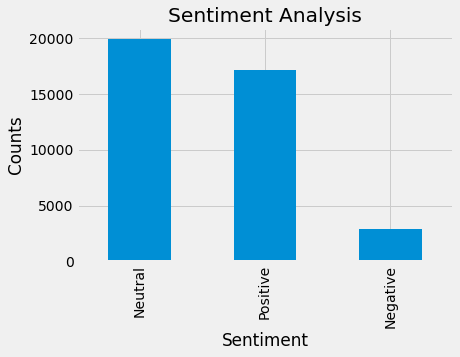

In [31]:
twitter['Analysis'].value_counts()

# plot and visualize the counts
plt.title('Sentiment Analysis')
plt.xlabel('Sentiment')
plt.ylabel('Counts')
twitter['Analysis'].value_counts().plot(kind='bar')
plt.show()

We can see that the most commonly identified tweet belongs to the Neutral class followed by Positive and Negative classes

#### We need to save our work in a csv format for easy accessibility. 

In [32]:
twitter.to_csv('raw_data.csv', index=False)

#pwd
you can use this command to see the path of your saved file.

### creating entities

In [33]:
import spacy
from spacy import displacy

nlp= spacy.load("en_core_web_sm")

def spacy_ner(text):
    text = text.replace('\n',' ')
    doc = nlp(text)
    entities=[]
    labels=[]
    position_start = []
    position_end = []
    
    for ent in doc.ents:
        if ent.label_ in ['PERSON','ORG','GPE']:
            entities.append(ent)
            labels.append(ent.label_)
    return entities, labels

def fit_ner(df):
    # the dataframe should have a column named text
    print("fitting spacy ner model")
    ner = df['text'].apply(spacy_ner)
    ner_org ={}
    ner_pe ={}
    ner_gpe ={}
    
    for x in ner:
        #print(list(x))
        for entity, label in zip(x[0],x[1]):
            # print(type(entity.text))
            if label =='ORG':
                ner_org[entity.text] = ner_org.get(entity.text,0)+1
            elif label =='Person':
                ner_per[entity.text] = ner_per.get(entity.text,0)+1
            else:
                ner_gpe[entity.text] = ner_gpe.get(entity.text,0)+1
            
    return {'ORG':ner_org,'PER':ner_per,'GPE':ner_gpe}  

In [34]:
words = nltk.word_tokenize(allwords)


In [35]:
pos_tags = nltk.pos_tag(words)

In [36]:
#pos_tags. This will create a list of tags/ entities depending on the word. such as Person, organisation, place.
"""
#Abbreviation	Meaning
#CC	coordinating conjunction
#CD	cardinal digit
#DT	determiner
#EX	existential there
#FW	foreign word
#IN	preposition/subordinating conjunction
JJ	This NLTK POS Tag is an adjective (large)
JJR	adjective, comparative (larger)
JJS	adjective, superlative (largest)
LS	list market
MD	modal (could, will)
NN	noun, singular (cat, tree)
NNS	noun plural (desks)
NNP	proper noun, singular (sarah)
NNPS	proper noun, plural (indians or americans)
PDT	predeterminer (all, both, half)
POS	possessive ending (parent\ ‘s)
PRP	personal pronoun (hers, herself, him, himself)
PRP$	possessive pronoun (her, his, mine, my, our )
RB	adverb (occasionally, swiftly)
RBR	adverb, comparative (greater)
RBS	adverb, superlative (biggest)
RP	particle (about)
TO	infinite marker (to)
UH	interjection (goodbye)
VB	verb (ask)
VBG	verb gerund (judging)
VBD	verb past tense (pleaded)
VBN	verb past participle (reunified)
VBP	verb, present tense not 3rd person singular(wrap)
VBZ	verb, present tense with 3rd person singular (bases)
WDT	wh-determiner (that, what)
WP	wh- pronoun (who)
WRB	wh- adverb (how) """

'\n#Abbreviation\tMeaning\n#CC\tcoordinating conjunction\n#CD\tcardinal digit\n#DT\tdeterminer\n#EX\texistential there\n#FW\tforeign word\n#IN\tpreposition/subordinating conjunction\nJJ\tThis NLTK POS Tag is an adjective (large)\nJJR\tadjective, comparative (larger)\nJJS\tadjective, superlative (largest)\nLS\tlist market\nMD\tmodal (could, will)\nNN\tnoun, singular (cat, tree)\nNNS\tnoun plural (desks)\nNNP\tproper noun, singular (sarah)\nNNPS\tproper noun, plural (indians or americans)\nPDT\tpredeterminer (all, both, half)\nPOS\tpossessive ending (parent\\ ‘s)\nPRP\tpersonal pronoun (hers, herself, him, himself)\nPRP$\tpossessive pronoun (her, his, mine, my, our )\nRB\tadverb (occasionally, swiftly)\nRBR\tadverb, comparative (greater)\nRBS\tadverb, superlative (biggest)\nRP\tparticle (about)\nTO\tinfinite marker (to)\nUH\tinterjection (goodbye)\nVB\tverb (ask)\nVBG\tverb gerund (judging)\nVBD\tverb past tense (pleaded)\nVBN\tverb past participle (reunified)\nVBP\tverb, present tense n

 #### for example in this data some of the many tags identified are:
 [('⚕️', 'JJ'),
 ('Scientists', 'NNS'),
 ('conducted', 'VBD'),
 ('a', 'DT'),
 ('Phase', 'NNP'),
 ('II', 'NNP'),
 ('study', 'NN'),
 ('of', 'IN'),
 ('acalabrutinib', 'NN')]

In [37]:
chunks = nltk.ne_chunk(pos_tags, binary=True)
for chunk in chunks:
    print(chunk)

('⚕️', 'JJ')
('Scientists', 'NNS')
('conducted', 'VBD')
('a', 'DT')
('Phase', 'NNP')
('II', 'NNP')
('study', 'NN')
('of', 'IN')
('acalabrutinib', 'NN')
('in', 'IN')
('patients', 'NNS')
('with', 'IN')
('relapsed/refractory', 'JJ')
('CLL', 'NNP')
('who', 'WP')
('were', 'VBD')
('ibrutinib-intolerant', 'JJ')
(',', ',')
('and', 'CC')
('found', 'VBD')
('an', 'DT')
('overall', 'JJ')
('response', 'NN')
('rate', 'NN')
('of', 'IN')
('73', 'CD')
('%', 'NN')
('.', '.')
('This', 'DT')
('phase', 'NN')
('2', 'CD')
('Acalabrutinib-Venetoclax', 'NNP')
('(', '(')
('AV', 'NNP')
(')', ')')
('trial', 'NN')
('that', 'WDT')
('is', 'VBZ')
('still', 'RB')
('in', 'IN')
('recruitment', 'JJ')
('phase', 'NN')
('will', 'MD')
('study', 'VB')
('how', 'WRB')
('well', 'RB')
('venetoclax', 'RB')
('and', 'CC')
('acalabrutinib', 'VB')
('works', 'NNS')
('in', 'IN')
(NE MCL/NNP)
('patients', 'NNS')
('who', 'WP')
('either', 'DT')
('relapsed', 'VBD')
('or', 'CC')
('non-respondent', 'JJ')
('to', 'TO')
('the', 'DT')
('initial',

('Lesen', 'NNP')
('Sie', 'NNP')
('jetzt', 'NN')
('den', 'NN')
('vollständigen', 'NN')
(NE Beitrag/NNP)
('unter', 'NN')
(':', ':')
('Arzt', 'NNP')
('Schmerz', 'NNP')
('CLL_Immunchemotherapie', 'NNP')
('Leukämie', 'NNP')
('Immuntherapie', 'NNP')
('Neutropenie', 'NNP')
('Mutation', 'NNP')
('Acalabrutinib', 'NNP')
('Patient', 'NNP')
('Therapie', 'NNP')
('Unverträglichkeiten', 'NNP')
('Zulassung', 'NNP')
('Studie', 'NNP')
('In', 'IN')
('this', 'DT')
('video', 'NN')
(',', ',')
('Dr', 'NNP')
('Danilov', 'NNP')
(',', ',')
(',', ',')
('discusses', 'VBZ')
('the', 'DT')
('use', 'NN')
('of', 'IN')
('acalabrutinib', 'NN')
(',', ',')
('(', '(')
(')', ')')
('as', 'IN')
('a', 'DT')
('treatment', 'NN')
('option', 'NN')
('for', 'IN')
('patients', 'NNS')
('with', 'IN')
(NE CLL/NNP)
(',', ',')
(NE SLL/NNP)
(',', ',')
('and', 'CC')
(NE MCL/NNP)
('.', '.')
('Watch', 'NN')
('Here', 'RB')
(':', ':')
(NE MedEd/NNP)
('MedTwitter', 'NNP')
('Healthcare', 'NNP')
('In', 'IN')
('this', 'DT')
('video', 'NN')
('interv

('Calquence', 'NNP')
('safety', 'NN')
('win', 'NN')
('against', 'IN')
(NE Imbruvica/NNP)
('in', 'IN')
('leukemia', 'JJ')
('trial', 'NN')
('showdown', 'NN')
('Outcomes', 'NNP')
('of', 'IN')
('relapsed', 'JJ')
('mantle', 'NN')
('cell', 'NN')
('lymphoma', 'NN')
('patients', 'NNS')
('after', 'IN')
('discontinuing', 'VBG')
('acalabrutinib', 'JJ')
('-', ':')
(NE Jain/NN)
('-', ':')
('-', ':')
(NE American/JJ Journal/NNP)
('of', 'IN')
(NE Hematology/NNP)
('-', ':')
(NE Wiley/NNP Online/NNP)
('Library', 'NNP')
('Calquence', 'NNP')
('approved', 'VBD')
('in', 'IN')
(NE Japan/NNP)
('for', 'IN')
('the', 'DT')
('treatment', 'NN')
('of', 'IN')
('relapsed', 'JJ')
('or', 'CC')
('refractory', 'JJ')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukaemia', 'NN')
('Calquence', 'NNP')
('ha', 'NN')
('raggiunto', 'NN')
('l', 'NN')
('’', 'NNP')
('endpoint', 'NN')
('primario', 'NN')
('di', 'NN')
('efficacia', 'NN')
('nello', 'JJ')
('studio', 'NN')
('testa', 'NN')
('a', 'DT')
('testa', 'JJ')
('contro', 'NN')
('ibr

('CALQUENCE', 'NNP')
('Met', 'NNP')
('Primary', 'NNP')
('Efficacy', 'NNP')
('Endpoint', 'NNP')
('in', 'IN')
('Head-to-Head', 'NNP')
('Trial', 'NNP')
('Against', 'NNP')
('ibrutinib', 'NN')
('in', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('Today', 'NNP')
('we', 'PRP')
('announced', 'VBD')
('high-level', 'JJ')
('results', 'NNS')
('from', 'IN')
('the', 'DT')
('head-to-head', 'JJ')
('ELEVATE-RR', 'JJ')
('Phase', 'NNP')
('III', 'NNP')
('trial', 'NN')
('in', 'IN')
('adults', 'NNS')
('with', 'IN')
('previously', 'RB')
('treated', 'VBN')
(',', ',')
('high-risk', 'JJ')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('.', '.')
('Learn', 'NNP')
('more', 'JJR')
(':', ':')
('$', '$')
(NE AZN/NNP)
('CALQUENCE', 'NNP')
('Met', 'NNP')
('Primary', 'NNP')
('Efficacy', 'NNP')
('Endpoint', 'NNP')
('in', 'IN')
('Head-to-Head', 'NNP')
('Trial', 'NNP')
('Against', 'NNP')
('ibrutinib', 'NN')
('in', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP AstraZeneca/NNP)
("'s", 'POS')
('Calque

('lt', 'NN')
(';', ':')
('0.001', 'CD')
(')', ')')
('in', 'IN')
('disease', 'NN')
('progression', 'NN')
('or', 'CC')
('death', 'NN')
('vs', 'NN')
(NE GCIb/NNP)
('(', '(')
('obinutuzumab+chlorambucil', 'NN')
(')', ')')
('.', '.')
(NE CALQUENCE/NNP)
('is', 'VBZ')
('an', 'DT')
('oral', 'JJ')
('treatment', 'NN')
('option', 'NN')
('for', 'IN')
('adult', 'NN')
('patients', 'NNS')
('with', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('(', '(')
(NE CLL/NNP)
(')', ')')
('.', '.')
('In', 'IN')
('a', 'DT')
('study', 'NN')
('of', 'IN')
('535', 'CD')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('(', '(')
(NE CLL/NNP)
(')', ')')
('patients', 'NNS')
(',', ',')
('1L', 'CD')
('CALQUENCE+obinutuzumab', 'NNP')
('demonstrated', 'VBD')
('90', 'CD')
('%', 'NN')
('relative', 'JJ')
('risk', 'NN')
('reduction', 'NN')
('(', '(')
('HR=0.10', 'NNP')
('[', 'RB')
('95', 'CD')
('%', 'NN')
('CI', 'NNP')
(':', ':')
('0.06-0.17', 'JJ')
(']', 'NN')
(',', ',')
('P', 'NNP')
('&', 'CC')


(NE CLL/NNP)
('who', 'WP')
('received', 'VBD')
('treatment', 'NN')
('with', 'IN')
('single-agent', 'JJ')
('acalabrutinib', 'NN')
('experienced', 'VBD')
('a', 'DT')
('low', 'JJ')
('incidence', 'NN')
('of', 'IN')
('cardiac', 'JJ')
('toxicities', 'NNS')
('leading', 'VBG')
('to', 'TO')
('treatment', 'NN')
('discontinuation', 'NN')
('.', '.')
('_hematology', 'NN')
(NE ASH20/NNP New2Trip/NNP)
(':', ':')
('Acalabrutinib', 'NNP')
('(', '(')
('Calquence', 'NNP')
(')', ')')
('-', ':')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukaemia', 'NN')
('(', '(')
(NE CLL/NNP)
(')', ')')
('Kinumpirma', 'NNP')
('ng', 'JJ')
('Department', 'NNP')
('of', 'IN')
(NE Health/NNP)
('na', 'FW')
('hindi', 'NN')
('na', 'TO')
('gagamitin', 'VB')
('sa', 'JJ')
('World', 'NNP')
('Health', 'NNP')
('Organization', 'NNP')
('solidarity', 'NN')
('trial', 'NN')
('ng', 'NN')
('therapeutics', 'NNS')
('o', 'VBP')
('mga', 'JJ')
('gamot', 'NN')
('ang', 'NN')
('Acalabrutinib', 'NNP')
('.', '.')
('At', 'IN')
('a', 'DT')
('median', 'J

('as', 'IN')
('an', 'DT')
('oral', 'JJ')
(',', ',')
('twice', 'RB')
('a', 'DT')
('day', 'NN')
('capsule', 'NN')
('.', '.')
('If', 'IN')
('you', 'PRP')
('or', 'CC')
('someone', 'NN')
('you', 'PRP')
('love', 'VBP')
('has', 'VBZ')
(NE CLL/NNP)
(',', ',')
('you', 'PRP')
('may', 'MD')
('have', 'VB')
('options', 'NNS')
('with', 'IN')
('prescription', 'NN')
(NE CALQUENCE/NNP)
('for', 'IN')
('adult', 'NN')
('patients', 'NNS')
('with', 'IN')
(NE CLL/NNP)
('.', '.')
('bloodcancerawareness', 'NN')
('ad', 'NN')
('Taking', 'NNP')
('CLL', 'NNP')
('medication', 'NN')
('should', 'MD')
('be', 'VB')
('as', 'RB')
('convenient', 'NN')
('as', 'IN')
('an', 'DT')
('oral', 'JJ')
(',', ',')
('2x', 'CD')
('a', 'DT')
('day', 'NN')
('capsule', 'NN')
(',', ',')
('allowing', 'VBG')
('you', 'PRP')
('to', 'TO')
('focus', 'VB')
('on', 'IN')
('the', 'DT')
('lifestyle', 'NN')
('you', 'PRP')
('want', 'VBP')
('.', '.')
('Calquence', 'NNP')
('is', 'VBZ')
('a', 'DT')
('prescription', 'NN')
('treatment', 'NN')
('option', 'NN

('patients', 'NNS')
('with', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('Consider', 'NNP')
('for', 'IN')
('any', 'DT')
('adult', 'NN')
('you', 'PRP')
('may', 'MD')
('know', 'VB')
('living', 'VBG')
('with', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('(', '(')
(NE CLL/NNP)
(')', ')')
(',', ',')
('small', 'JJ')
('lymphocytic', 'JJ')
('lymphoma', 'NN')
('(', '(')
(NE SLL/NNP)
(')', ')')
('or', 'CC')
('mantle', 'JJ')
('cell', 'NN')
('lymphoma', 'NN')
('(', '(')
(NE MCL/NNP)
(')', ')')
('.', '.')
('It', 'PRP')
('’', 'VBZ')
('s', 'VBZ')
('a', 'DT')
('convenient', 'JJ')
('oral', 'JJ')
('2x', 'CD')
('a', 'DT')
('day', 'NN')
('capsule', 'NN')
('.', '.')
('Learn', 'NNP')
('more', 'JJR')
(':', ':')
('bloodcancerawareness', 'NN')
('ad', 'NN')
('AZ', 'NNP')
('’', 'NNP')
('s', 'VBD')
(NE Calquence/NNP)
('shows', 'NNS')
('long-term', 'JJ')
('efficacy', 'NN')
('and', 'CC')
('tolerability', 'NN')
('in', 'IN')
(NE MCL/NNP CORRECTING/NNP)
('and', 'CC')
('REPLACING', 'NNP')
('CAL

('notice', 'NN')
("''", "''")
('has', 'VBZ')
('been', 'VBN')
('published', 'VBN')
('on', 'IN')
(NE Fintech/NNP Zoom/NNP)
('-', ':')
(NE Fintech/NN Blockchain/NNP Crypto/NNP Cryptocurrency/NNP)
('ICO', 'NNP')
('ASH', 'NNP')
(':', ':')
(NE AstraZeneca/NNP)
("'s", 'POS')
('Calquence', 'NNP')
(',', ',')
(NE BeiGene/NNP)
("'s", 'POS')
(NE Brukinsa/NNP)
('turn', 'NN')
('heads', 'NNS')
('with', 'IN')
('new', 'JJ')
('data', 'NNS')
(',', ',')
('putting', 'VBG')
(NE Imbruvica/NNP)
('on', 'IN')
('notice', 'JJ')
('ASH', 'NNP')
(':', ':')
(NE AstraZeneca/NNP)
('’', 'NNP')
('s', 'VBD')
(NE Calquence/NNP)
(',', ',')
(NE BeiGene/NNP)
('’', 'NNP')
('s', 'VBD')
(NE Brukinsa/NNP)
('turn', 'VB')
('heads', 'NNS')
('with', 'IN')
('new', 'JJ')
('data', 'NNS')
(',', ',')
('putting', 'VBG')
(NE Imbruvica/NNP)
('on', 'IN')
('notice', 'JJ')
('ASH', 'NNP')
(':', ':')
(NE AstraZeneca/NNP)
('’', 'NNP')
('s', 'VBD')
(NE Calquence/NNP)
(',', ',')
(NE BeiGene/NNP)
('’', 'NNP')
('s', 'VBD')
(NE Brukinsa/NNP)
('turn', '

('la', 'FW')
(NE Unión/NNP Europea/NNP)
('a', 'DT')
('través', 'NN')
('de', 'IN')
('La', 'NNP')
('Agencia', 'NNP')
('Europea', 'NNP')
('de', 'FW')
('Medicamentos', 'NNP')
('(', '(')
(NE EMA/NNP)
(')', ')')
('acaba', 'FW')
('de', 'FW')
('aprobar', 'FW')
('acalabrutinib', 'FW')
('para', 'FW')
('el', 'FW')
('tratamiento', 'FW')
('de', 'FW')
('leucemia', 'FW')
('linfocítica', 'NN')
('crónica', 'NN')
(',', ',')
('una', 'JJ')
('de', 'FW')
('las', 'FW')
('leucemias', 'FW')
('más', 'FW')
('comunes', 'NNS')
('en', 'IN')
('adultos', 'NN')
('.', '.')
('La', 'NNP')
('terapia', 'JJ')
('deberá', 'NN')
('ser', 'NN')
('aplicada', 'NN')
('por', 'NN')
('un', 'JJ')
('especialista', 'NN')
('en', 'FW')
('fármacos', 'NN')
('neoplásicos', 'NN')
('.', '.')
('Congratulations', 'NNS')
('to', 'TO')
('AstraZeneca', 'VB')
('on', 'IN')
('the', 'DT')
(NE EMA/NNP)
('approval', 'NN')
('of', 'IN')
(NE CALQUENCE/NNP)
('!', '.')
(NE BIBrands/NNP)
('CALQUENCE', 'NNP')
('is', 'VBZ')
('a', 'DT')
('prescription', 'NN')
('med

('twice', 'RB')
('a', 'DT')
('day', 'NN')
('capsule', 'NN')
('.', '.')
('If', 'IN')
('you', 'PRP')
('or', 'CC')
('someone', 'NN')
('you', 'PRP')
('love', 'VBP')
('has', 'VBZ')
(NE CLL/NNP)
(',', ',')
('you', 'PRP')
('may', 'MD')
('have', 'VB')
('options', 'NNS')
('with', 'IN')
('prescription', 'NN')
(NE CALQUENCE/NNP)
('for', 'IN')
('adult', 'NN')
('patients', 'NNS')
('.', '.')
('bloodcancerawareness', 'JJ')
('ad', 'NN')
('Top', 'NNP')
('story', 'NN')
(':', ':')
('Acalabrutinib', 'NNP')
('in', 'IN')
('patients', 'NNS')
('with', 'IN')
('relapsed', 'JJ')
('or', 'CC')
('refractory', 'JJ')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('-', ':')
(NE Medivizor/NNP)
('see', 'VB')
('more', 'JJR')
('Top', 'JJ')
('story', 'NN')
(':', ':')
('Acalabrutinib', 'NNP')
('in', 'IN')
('patients', 'NNS')
('with', 'IN')
('relapsed', 'JJ')
('or', 'CC')
('refractory', 'JJ')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('-', ':')
(NE Medivizor/NNP)
('see', 'VBP')
('more', 'JJR')
(

(',', ',')
('twice', 'RB')
('a', 'DT')
('day', 'NN')
('capsule', 'NN')
('.', '.')
('If', 'IN')
('you', 'PRP')
('or', 'CC')
('someone', 'NN')
('you', 'PRP')
('love', 'VBP')
('has', 'VBZ')
(NE CLL/NNP)
(',', ',')
('you', 'PRP')
('may', 'MD')
('have', 'VB')
('options', 'NNS')
('with', 'IN')
('prescription', 'NN')
(NE CALQUENCE/NNP)
('for', 'IN')
('adult', 'NN')
('patients', 'NNS')
('.', '.')
('bloodcancerawareness', 'NN')
('ad', 'NN')
(NE AstraZeneca/NNP)
('cancer', 'NN')
('drug', 'NN')
('found', 'VBD')
('ineffective', 'JJ')
('for', 'IN')
('treating', 'VBG')
('COVID-19', 'NNP')
('AstraZeneca', 'NNP')
("'s", 'POS')
(NE Calquence/NNP Fails/NNP Pair/NNP)
('of', 'IN')
(NE Phase/NNP II/NNP)
('COVID-19', 'NNP')
('Trials', 'NNP')
('Leucemia', 'NNP')
('linfocitica', 'NN')
(':', ':')
('acalabrutinib', 'NN')
('approvato', 'NN')
('in', 'IN')
(NE UE/NNP)
('-', ':')
(NE Leucemia/NN)
('linfocitica', 'NN')
(':', ':')
('acalabrutinib', 'JJ')
('Consider', 'NNP')
('CALQUENCE', 'NNP')
('for', 'IN')
('any', 

('has', 'VBZ')
('blood', 'NN')
('cancer', 'NN')
('(', '(')
(NE CLL/NNP)
(',', ',')
(NE SLL/NNP)
('or', 'CC')
(NE MCL/NNP)
(')', ')')
(',', ',')
('you', 'PRP')
('have', 'VBP')
('treatment', 'NN')
('options', 'NNS')
('with', 'IN')
('It', 'PRP')
('’', 'VBZ')
('s', 'VBZ')
('a', 'DT')
('convenient', 'JJ')
('oral', 'JJ')
(',', ',')
('2x', 'CD')
('a', 'DT')
('day', 'NN')
('capsule', 'NN')
(',', ',')
('so', 'IN')
('you', 'PRP')
('can', 'MD')
('focus', 'VB')
('on', 'IN')
('the', 'DT')
('lifestyle', 'NN')
('you', 'PRP')
('want', 'VBP')
('!', '.')
('bloodcancerawareness', 'NN')
('ad', 'NN')
(NE AstraZeneca/NNP)
('cancer', 'NN')
('drug', 'NN')
('found', 'VBD')
('ineffective', 'JJ')
('for', 'IN')
('treating', 'VBG')
('COVID-19', 'NNP')
('AstraZeneca', 'NNP')
("'s", 'POS')
(NE Calquence/NNP Fails/NNP Pair/NNP)
('of', 'IN')
(NE Phase/NNP II/NNP)
('COVID-19', 'NNP')
('Trials', 'NNP')
('Taking', 'NNP')
('CLL', 'NNP')
('medication', 'NN')
('should', 'MD')
('be', 'VB')
('as', 'RB')
('convenient', 'NN')
(

('capsule', 'NN')
(',', ',')
('allowing', 'VBG')
('you', 'PRP')
('to', 'TO')
('focus', 'VB')
('on', 'IN')
('the', 'DT')
('lifestyle', 'NN')
('you', 'PRP')
('want', 'VBP')
('.', '.')
(NE CALQUENCE/NNP)
('is', 'VBZ')
('a', 'DT')
('prescription', 'NN')
('treatment', 'NN')
('option', 'NN')
('for', 'IN')
('adult', 'NN')
('patients', 'NNS')
('with', 'IN')
(NE CLL/NNP)
('.', '.')
('bloodcancerawareness', 'NN')
('ad', 'NN')
('With', 'IN')
(',', ',')
('feel', 'VB')
('supported', 'VBN')
('day', 'NN')
('and', 'CC')
('night', 'NN')
('with', 'IN')
('their', 'PRP$')
('patient', 'NN')
('and', 'CC')
('caregiver', 'JJ')
('resources', 'NNS')
('.', '.')
(NE CALQUENCE/NNP)
('is', 'VBZ')
('an', 'DT')
('oral', 'JJ')
(',', ',')
('2x', 'CD')
('a', 'DT')
('day', 'NN')
('prescription', 'NN')
('medication', 'NN')
('used', 'VBN')
('to', 'TO')
('treat', 'VB')
('adult', 'NN')
('patients', 'NNS')
('with', 'IN')
(NE CLL/NNP)
('.', '.')
('Learn', 'NNP')
('more', 'JJR')
('at', 'IN')
('bloodcancerawareness', 'NN')
('ad'

('dan', 'VB')
('?', '.')
('The', 'DT')
(NE European/NNP Union/NNP)
('has', 'VBZ')
('approved', 'VBN')
('the', 'DT')
('next-generation', 'NN')
(NE BTK/NNP)
('inhibitor', 'NN')
('acalabrutinib', 'NN')
('for', 'IN')
('use', 'NN')
('in', 'IN')
('adult', 'NN')
('patients', 'NNS')
('with', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('.', '.')
('_News', 'NNS')
('AZ', 'NNP')
('’', 'NNP')
('s', 'VBD')
(NE BTK/NNP)
('inhibitor', 'NN')
(NE Calquence/NNP)
('fails', 'VBZ')
('in', 'IN')
('COVID-19', 'NNP')
('study', 'NN')
(NE AstraZenca/NNP)
('’', 'NNP')
('s', 'NN')
('Calquence', 'NNP')
('(', '(')
('acalabrutinib', 'NN')
(')', ')')
('Fails', 'VBZ')
('to', 'TO')
('Meet', 'VB')
('its', 'PRP$')
('Primary', 'NNP')
('Endpoint', 'NNP')
('in', 'IN')
('P-II', 'NNP')
('Studies', 'NNPS')
('for', 'IN')
('COVID-19', 'NNP')
('AstraZeneca', 'NNP')
("'s", 'POS')
(NE Calquence/NNP)
('fails', 'VBZ')
('COVID-19', 'NNP')
('study', 'NN')
(',', ',')
('joining', 'VBG')
('the', 'DT')
('list', 'NN')
(

('оправдалась', 'NNP')
('.', '.')
('Во', 'VB')
('2-ой', 'JJ')
('фазе', 'NNP')
('клин', 'NNP')
('.', '.')
('испытаний', 'JJ')
(NE Calquence/NNP)
('не', 'NNP')
('улучшил', 'NNP')
('выживаемость', 'NNP')
('тяжелых', 'NNP')
('пациентов', 'NNP')
('Update', 'NNP')
('on', 'IN')
(NE CALAVI/NNP Phase/NNP)
('II', 'NNP')
('trials', 'NNS')
('for', 'IN')
(NE Calquence/NNP)
('in', 'IN')
('patients', 'NNS')
('hospitalised', 'VBN')
('with', 'IN')
('respiratory', 'NN')
('symptoms', 'NNS')
('of', 'IN')
('COVID-19', 'NNP')
('|', 'NNP')
('Small', 'NNP')
('Molecules', 'NNP')
('AstraZeneca', 'NNP')
('’', 'NNP')
('s', 'VBD')
(NE Calquence/NNP)
('fails', 'NNS')
('to', 'TO')
('improve', 'VB')
('survival', 'NN')
('rates', 'NNS')
('in', 'IN')
('coronavirus', 'NN')
('patients', 'NNS')
(':', ':')
('pharmaceutical', 'JJ')
('$', '$')
('AZN', 'NNP')
('(', '(')
('-1.2', 'NNP')
('%', 'NN')
(')', ')')
('reports', 'VBZ')
(NE CALAVI/NNP Phase/NNP)
('II', 'NNP')
('trials', 'NNS')
('for', 'IN')
(NE Calquence/NNP)
('in', 'IN

('being', 'VBG')
('junked', 'VBN')
('?', '.')
('ICMR-NARI', 'JJ')
('chief', 'JJ')
('Dr', 'NNP')
('Samiran', 'NNP')
('Panda', 'NNP')
('tells', 'VBZ')
('in', 'IN')
('a', 'DT')
('detailed', 'JJ')
('interview', 'NN')
('.', '.')
(NE AstraZeneca/NNP)
('’', 'NNP')
('s', 'NN')
('Calquence', 'NNP')
('(', '(')
('acalabrutinib', 'NN')
(')', ')')
('has', 'VBZ')
('been', 'VBN')
('approved', 'VBN')
('in', 'IN')
('the', 'DT')
(NE European/NNP Union/NNP)
('(', '(')
(NE EU/NNP)
(')', ')')
('for', 'IN')
('the', 'DT')
('treatment', 'NN')
('of', 'IN')
('adult', 'NN')
('patients', 'NNS')
('with', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukaemia', 'NN')
('healthcare', 'NN')
('leukaemia', 'JJ')
('bloodcancer', 'NN')
('Cancer', 'NNP')
('Calquence', 'NNP')
('approved', 'VBD')
('in', 'IN')
('the', 'DT')
(NE EU/NNP)
('for', 'IN')
('the', 'DT')
('treatment', 'NN')
('of', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukaemia', 'NN')
(NE Calquence/NNP)
('approved', 'VBD')
('in', 'IN')
('the', 'DT')
(NE

('Excited', 'VBD')
('to', 'TO')
('open', 'VB')
('REMoDL-A', 'NNP')
('(', '(')
('CI', 'NNP')
('Andy', 'NNP')
('Davies', 'NNP')
(')', ')')
(':', ':')
('trial', 'NN')
('design', 'NN')
('allowing', 'VBG')
('HD-MTX', 'NNP')
('prophylaxis', 'NN')
('if', 'IN')
('indicated', 'VBN')
('.', '.')
('R-CHOP', 'JJ')
('+/-Acalabrutinib', 'NN')
('(', '(')
('also', 'RB')
('likely', 'RB')
('to', 'TO')
('provide', 'VB')
('additional', 'JJ')
(NE CNS/NNP)
('prophylaxis', 'NN')
(')', ')')
('Data', 'NNP')
('from', 'IN')
(NE Phase/NNP)
('I/II', 'NNP')
('ACCEPT', 'NNP')
('TRIAL', 'NNP')
('promising', 'NN')
('(', '(')
('ASH', 'NNP')
('2020', 'CD')
(')', ')')
('Also', 'RB')
('correlative', 'JJ')
('translational', 'JJ')
('work', 'NN')
('lymsm', 'NN')
(NE DLBCL/NNP Acalabrutinib/NNP)
(',', ',')
('a', 'DT')
('next-gen', 'JJ')
(NE BTK/NNP)
('inhibitor', 'NN')
(',', ',')
('provides', 'VBZ')
('prolonged', 'JJ')
('progression-free', 'JJ')
('survival', 'NN')
('and', 'CC')
('better', 'JJR')
('tolerability', 'NN')
(',', ',

('The', 'DT')
('...', ':')
('frontpag', 'NN')
(NE AstraZeneca/NNP Pharma/NNP)
('|', 'NNP')
('Company', 'NNP')
('will', 'MD')
('launch', 'VB')
('Calquence', 'NNP')
('in', 'IN')
(NE India/NNP)
('on', 'IN')
('October', 'NNP')
('21', 'CD')
(NE AstraZeneca/NNP Pharma/NNP India/NNP)
('to', 'TO')
('launch', 'VB')
('cancer', 'NN')
('drug', 'NN')
('with', 'IN')
('brand', 'NN')
('name', 'NN')
(',', ',')
("'Calquence", 'NNP')
("'", 'POS')
('on', 'IN')
('October', 'NNP')
('21', 'CD')
(NE CancerDrug/NNP Calquence/NNP)
('AstraZeneca', 'NNP')
('Pharma', 'NNP')
(':', ':')
('Drug', 'NNP')
('firm', 'NN')
(NE AstraZeneca/NNP Pharma/NNP India/NNP)
('said', 'VBD')
('it', 'PRP')
('will', 'MD')
('launch', 'VB')
('its', 'PRP$')
('Acalabrutinib', 'NNP')
('100', 'CD')
('mg', 'NN')
('capsules', 'NNS')
(',', ',')
('used', 'VBD')
('for', 'IN')
('treatment', 'NN')
('of', 'IN')
('various', 'JJ')
('types', 'NNS')
('of', 'IN')
('blood', 'NN')
('cancers', 'NNS')
(',', ',')
('under', 'IN')
('the', 'DT')
('brand', 'NN')


('shows', 'NNS')
('positive', 'JJ')
('results', 'NNS')
('for', 'IN')
(NE CLL/NNP)
('.', '.')
('lymphomahub', 'NN')
(NE Najít/NNP)
('účinnou', 'NNP')
('léčbu', 'VBD')
('medikamenty', 'JJ')
('pro', 'JJ')
('onemocnění', 'FW')
('covid-19', 'JJ')
('pomohou', 'NN')
('i', 'NN')
('čeští', 'VBP')
('odborníci', 'NN')
('.', '.')
('SolidarityTrial', 'NNP')
('WHO', 'NNP')
('_Europe', 'VBP')
('_cz', 'NNP')
('CZECRIN', 'NNP')
('lecbacovidu', 'VBZ')
(NE SUKL/NNP)
('remdesivir', 'NN')
('acalabrutinib', 'NN')
('interferon', 'NN')
('From', 'IN')
(NE Medscape/NNP)
('Hematology-Oncology', 'NNP')
('Headlines', 'NNP')
('&', 'CC')
('gt', 'NN')
(';', ':')
('&', 'CC')
('gt', 'NN')
(';', ':')
('Acalabrutinib', 'NNP')
('Bests', 'VBZ')
('Other', 'JJ')
('Frontline', 'NNP')
('CLL', 'NNP')
('Therapies', 'NNP')
('Acalabrutinib', 'NNP')
(',', ',')
('alone', 'RB')
('or', 'CC')
('in', 'IN')
('combo', 'JJ')
('with', 'IN')
('obinutuzumab', 'NN')
(',', ',')
('showed', 'VBD')
('favorable', 'JJ')
('PFS', 'NNP')
('and', 'CC')


('Woyach', 'NNP')
(',', ',')
(NE MD/NNP)
(',', ',')
('of', 'IN')
('_James', 'NNS')
(',', ',')
('discusses', 'VBZ')
('the', 'DT')
('safety', 'NN')
('profile', 'NN')
('of', 'IN')
('acalabrutinib', 'NNS')
('compared', 'VBN')
('with', 'IN')
('ibrutinib', 'NN')
('in', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('.', '.')
('leusm', 'JJ')
(NE CALQUENCE/NNP)
('is', 'VBZ')
('a', 'DT')
('prescription', 'NN')
('medicine', 'NN')
('used', 'VBN')
('to', 'TO')
('treat', 'VB')
('adults', 'NNS')
('with', 'IN')
('mantle', 'NN')
('cell', 'NN')
('lymphoma', 'NN')
('(', '(')
(NE MCL/NNP)
(')', ')')
('who', 'WP')
('have', 'VBP')
('received', 'VBN')
('at', 'IN')
('least', 'JJS')
('one', 'CD')
('prior', 'JJ')
('treatment', 'NN')
('for', 'IN')
('their', 'PRP$')
('cancer', 'NN')
('.', '.')
(NE CALQUENCE/NNP)
('is', 'VBZ')
('a', 'DT')
('prescription', 'NN')
('medicine', 'NN')
('used', 'VBN')
('to', 'TO')
('treat', 'VB')
('adults', 'NNS')
('with', 'IN')
('mantle', 'NN')
('cell', 'NN')
('lymp

('leukaemia', 'NN')
('.', '.')
('7NEWS', 'CD')
('Federal', 'NNP')
('Health', 'NNP')
('Minister', 'NNP')
('announced', 'VBD')
('that', 'IN')
('from', 'IN')
('September', 'NNP')
('1', 'CD')
('Keytruda', 'NNP')
('is', 'VBZ')
('now', 'RB')
('reimbursed', 'VBN')
('on', 'IN')
(NE PBS/NNP)
('for', 'IN')
('relapsed/refractory', 'NN')
(NE PMBCL/NNP)
('&', 'CC')
('amp', 'NN')
(';', ':')
('Calquence', 'NNP')
('(', '(')
('Acalabrutinib', 'NNP')
(')', ')')
('is', 'VBZ')
('approved', 'VBN')
('for', 'IN')
(NE CLL/NNP)
('&', 'CC')
('amp', 'NN')
(';', ':')
('SLL', 'NNP')
('.', '.')
(NE Great/NNP)
('news', 'NN')
('for', 'IN')
('lymphoma', 'NN')
('patients', 'NNS')
('lime4lymphoma', 'JJ')
('lymphomaawarenessmonth', 'JJ')
('_Aus', 'NN')
('To', 'TO')
('mark', 'VB')
('World', 'NNP')
('Lymphoma', 'NNP')
('Awareness', 'NNP')
('month', 'NN')
(',', ',')
(NE Calquence/NNP)
('is', 'VBZ')
('now', 'RB')
('reimbursed', 'VBN')
('for', 'IN')
('certain', 'JJ')
(NE Australian/JJ)
('patients', 'NNS')
('with', 'IN')
('chr

('fármacos', 'NN')
(')', ')')
('Resultados', 'NNP')
('habrá', 'NN')
('recién', 'NN')
('en', 'IN')
('unos', 'JJ')
('meses', 'NNS')
('New', 'NNP')
('clinical', 'JJ')
('trial', 'NN')
(':', ':')
('Acalabrutinib', 'NNP')
('and', 'CC')
(NE Obinutuzumab/NNP)
('for', 'IN')
('the', 'DT')
('Treatment', 'NNP')
('of', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('CLL', 'NNP')
('leusm', 'VBZ')
('hematology', 'NN')
('Cancer', 'NNP')
('drugs', 'NNS')
('may', 'MD')
('dampen', 'VB')
('cytokinestorm', 'NN')
('that', 'WDT')
('occurs', 'VBZ')
('in', 'IN')
('patients', 'NNS')
('with', 'IN')
('severe', 'JJ')
(NE COVID19/NNP)
('.', '.')
('_kettering', 'VBG')
('calquence', 'NN')
('BTKinhibitors', 'NNS')
('ICYMI', 'NNP')
(':', ':')
('Both', 'DT')
('the', 'DT')
('phase', 'NN')
('2', 'CD')
('ACE-CL-001', 'JJ')
('trial', 'NN')
('and', 'CC')
('the', 'DT')
('pivotal', 'JJ')
('phase', 'NN')
('3', 'CD')
(NE ASCEND/NNP)
('trial', 'NN')
('showed', 'VBD')
('the', 'DT')
('long-term', 'JJ')
('efficacy', 'NN')
('an

('When', 'WRB')
(NE Administered/NNP)
('Orally', 'RB')
('With', 'IN')
('COCA-COLA', 'NNP')
('in', 'IN')
(NE Healthy/NNP Participants/NNP Cancer/NNP)
('drugs', 'NNS')
('tapped', 'VBD')
('for', 'IN')
(NE COVID19/NNP)
('to', 'TO')
('dampen', 'VB')
('cytokinestorm', 'NN')
('that', 'WDT')
('occurs', 'VBZ')
('in', 'IN')
('patients', 'NNS')
('with', 'IN')
('severe', 'JJ')
('COVID-19', 'NNP')
('.', '.')
('_kettering', 'VBG')
('calquence', 'NN')
('BTKinhibitors', 'NNS')
('Acalabrutinib', 'NNP')
('showing', 'VBG')
('80', 'CD')
('percent', 'JJ')
('improvement', 'NN')
('in', 'IN')
('patients', 'NNS')
('on', 'IN')
('oxygen', 'NN')
('and', 'CC')
('50', 'CD')
('percent', 'NN')
('improvement', 'NN')
('for', 'IN')
('those', 'DT')
('on', 'IN')
('ventilators', 'NNS')
(',', ',')
('all', 'DT')
('being', 'VBG')
('discharged', 'VBN')
('in', 'IN')
('a', 'DT')
('small', 'JJ')
('off-label', 'NN')
('study', 'NN')
('.', '.')
(NE FDA/NNP)
('needs', 'VBZ')
('an', 'DT')
('EUA', 'NN')
('for', 'IN')
('small', 'JJ')
('

('AND', 'VBP')
('no', 'DT')
('serious', 'JJ')
('toxicity', 'NN')
('with', 'IN')
('short', 'JJ')
('course', 'NN')
('of', 'IN')
('acalabrutinib', 'NN')
('.', '.')
('Sounds', 'VBZ')
('promising', 'JJ')
('!', '.')
(NE AACRCovid/NNP Off/NNP)
('label', 'NN')
('use', 'NN')
('of', 'IN')
(NE Acalabrutinib/NNP)
('to', 'TO')
('treat', 'VB')
('severe', 'JJ')
(NE Covid/NNP)
('-19', 'NNP')
('infection', 'NN')
(NE Louis/NNP Staudt/NNP)
('(', '(')
(')', ')')
(':', ':')
('More', 'JJR')
('support', 'NN')
('for', 'IN')
('idea', 'NN')
('that', 'WDT')
('different', 'JJ')
('types', 'NNS')
('of', 'IN')
('therapies', 'NNS')
('work', 'VBP')
('at', 'IN')
('different', 'JJ')
('stages', 'NNS')
('of', 'IN')
(NE COVID19/NNP)
('.', '.')
(NE Lymphoma/NNP)
('BTK', 'NNP')
('inhibitor', 'NN')
('acalabrutinib', 'NN')
('may', 'MD')
('work', 'VB')
('at', 'IN')
('``', '``')
('trunk', 'NN')
("''", "''")
('of', 'IN')
('tree', 'NN')
('to', 'TO')
('prevent', 'VB')
('cytokine', 'JJ')
('storm', 'NN')
('.', '.')
(NE AACRcovid/NNP 

('have', 'VBP')
('only', 'RB')
('interest', 'NN')
('in', 'IN')
('insider', 'NN')
('trading', 'NN')
('.', '.')
('SEC', 'NNP')
('let', 'VB')
('this', 'DT')
('scam', 'JJ')
('run', 'NN')
('on', 'IN')
('daily', 'JJ')
('basis', 'NN')
('with', 'IN')
('no', 'DT')
('action', 'NN')
('.', '.')
('$', '$')
('spy', 'JJ')
('$', '$')
('AZN.PLC', 'NNP')
('ASTRAZENECA', 'NNP')
(':', ':')
(NE LYMPHOMA/JJ)
(NE DRUG/NNP)
('ACALABRUTINIB', 'NNP')
('A', 'NNP')
('POTENTIAL', 'NNP')
('THERAPY', 'NNP')
('FOR', 'NNP')
('SEVERE', 'NNP')
('COVID-19', 'NNP')
('ASTRAZENECA', 'NNP')
(':', ':')
(NE LYMPHOMA/JJ)
(NE DRUG/NNP)
('ACALABRUTINIB', 'NNP')
('A', 'NNP')
('POTENTIAL', 'NNP')
('THERAPY', 'NNP')
('FOR', 'NNP')
('SEVERE', 'NNP')
('COVID-19', 'NNP')
('ASTRAZENECA', 'NNP')
(':', ':')
(NE LYMPHOMA/JJ)
(NE DRUG/NNP)
('ACALABRUTINIB', 'NNP')
('A', 'NNP')
('POTENTIAL', 'NNP')
('THERAPY', 'NNP')
('FOR', 'NNP')
('SEVERE', 'NNP')
('COVID-19', 'NNP')
('ASTRAZENECA', 'NNP')
(':', ':')
(NE LYMPHOMA/JJ)
(NE DRUG/NNP)
('ACALAB

('patients', 'NNS')
('with', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('(', '(')
(NE CLL/NNP)
(')', ')')
('or', 'CC')
('small', 'JJ')
('lymphocytic', 'JJ')
('lymphoma', 'NN')
('(', '(')
(NE SLL/NNP)
(')', ')')
('.', '.')
('See', 'VB')
('if', 'IN')
(NE CALQUENCE/NNP)
('can', 'MD')
('be', 'VB')
('used', 'VBN')
('to', 'TO')
('treat', 'VB')
('your', 'PRP$')
('adult', 'NN')
('patients', 'NNS')
('with', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('(', '(')
(NE CLL/NNP)
(')', ')')
('or', 'CC')
('small', 'JJ')
('lymphocytic', 'JJ')
('lymphoma', 'NN')
('(', '(')
(NE SLL/NNP)
(')', ')')
('.', '.')
('In', 'IN')
('a', 'DT')
('study', 'NN')
('of', 'IN')
('535', 'CD')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('(', '(')
(NE CLL/NNP)
(')', ')')
('patients', 'NNS')
(',', ',')
('1L', 'CD')
('CALQUENCE+obinutuzumab', 'NNP')
('demonstrated', 'VBD')
('90', 'CD')
('%', 'NN')
('relative', 'JJ')
('risk', 'NN')
('reduction', 'NN')
('(', '(')
('HR=

(',', ',')
('e.g.', 'NN')
(',', ',')
(NE Baricitinib/NNP)
('&', 'CC')
('amp', 'NN')
(';', ':')
('Btk', 'NNP')
('inhibitor', 'NN')
('like', 'IN')
(NE Acalabrutinib/NNP)
('.', '.')
('Timing', 'NN')
('is', 'VBZ')
('critical', 'JJ')
('.', '.')
('Got', 'NNP')
('many', 'JJ')
('requests', 'NNS')
('to', 'TO')
('test', 'VB')
('remdesivir', 'NN')
('+', 'NNP')
('dexamethason/baricitinib', 'NN')
('combo', 'NN')
('.', '.')
('No', 'UH')
('.', '.')
('Do', 'VBP')
("n't", 'RB')
('make', 'VB')
('sense', 'NN')
('.', '.')
('アストラゼネカのアカラブルチニブ（Calquence）、慢性リンパ性白血病患者さんに対する長期有効性と忍容性を2つの臨床試験で示す', 'VB')
(NE _JPより/JJ)
('NEW', 'NNP')
(':', ':')
('Acalabrutinib', 'NNP')
('in', 'IN')
('patients', 'NNS')
('with', 'IN')
('relapsed', 'JJ')
('or', 'CC')
('refractory', 'JJ')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('via', 'IN')
(NE Leukemia/NNP)
('EHA25virtual', 'NNP')
('|', 'NNP')
('ACE-CL-001', 'NNP')
('trial', 'NN')
('is', 'VBZ')
('very', 'RB')
('important', 'JJ')
('because', 'IN')
('of', 'IN')
('th

('provoca', 'NN')
('la', 'FW')
('propagación', 'FW')
('de', 'FW')
(NE COVIDー19/NNP)
('acalabrutinib、新型コロナ重症例のサイトカインストーム改善／アストラゼネカ', 'NN')
('Carenet医療ニュース', 'NNP')
('carenet', 'NN')
('El', 'NNP')
('acalabrutinib', 'NN')
(',', ',')
('usado', 'JJ')
('en', 'FW')
('el', 'FW')
('tratamiento', 'FW')
('contra', 'JJ')
('la', 'NN')
('leucemia', 'NN')
(',', ',')
('bloquearía', 'NN')
('la', 'NN')
('proteína', 'FW')
(NE BTK/NNP)
('que', 'NN')
('provoca', 'NN')
('la', 'FW')
('propagación', 'FW')
('de', 'FW')
('la', 'FW')
('Covid-19', 'NNP')
('.', '.')
('Especialistas', 'NNP')
('no', 'DT')
('descartan', 'NN')
('que', 'NN')
('se', 'NN')
('aplique', 'NN')
('para', 'NN')
('los', 'NN')
('casos', 'NN')
('graves', 'NNS')
('en', 'VBP')
('el', 'JJ')
('Perú', 'NNP')
('.', '.')
('Reapertura', 'NNP')
('de', 'IN')
('centros', 'FW')
('comerciales', 'NNS')
('buscar', 'VBP')
('impulsar', 'JJ')
('economía', 'NN')
('.', '.')
('La', 'NNP')
('OIT', 'NNP')
('advierte', 'NN')
('de', 'FW')
('un', 'FW')
('posible', 'JJ')
(

(NE Lenalidomide/NNP)
('and', 'CC')
(NE Acalabrutinib/NNP)
('(', '(')
('R2A', 'NNP')
(')', ')')
('may', 'MD')
('be', 'VB')
('well', 'RB')
('tolerated', 'VBN')
('and', 'CC')
('effective', 'JJ')
('in', 'IN')
('relapsed/refractory', 'JJ')
('aggressive', 'JJ')
(NE BCellLymphoma/NNP)
('EHA20', 'NNP')
('Nuovi', 'NNP')
('dati', 'VBZ')
('di', 'JJ')
('fase', 'NN')
('II', 'NNP')
('indicano', 'NN')
('che', 'NN')
('un', 'JJ')
('regime', 'NN')
('combinato', 'NN')
('di', 'NN')
(NE Truxima/NNP)
(',', ',')
('lenalidomide', 'RB')
('e', 'JJ')
('acalabrutinib', 'NNS')
('può', 'VBP')
('essere', 'RB')
('ben', 'VBN')
('tollerato', 'NN')
('ed', 'FW')
('efficace', 'NN')
('nella', 'NN')
('terapia', 'NN')
('del', 'NN')
('linfoma', 'VBZ')
('a', 'DT')
('cellule', 'NN')
('B', 'NNP')
('aggressivo', 'NN')
('refrattario/recidivato', 'NN')
(NE AstraZeneca/NNP)
("'s", 'POS')
(NE Blood/NNP Cancer/NNP Drug/NNP Calquence/NNP)
('May', 'NNP')
('Benefit', 'NNP')
('Severely-Ill', 'JJ')
('COVID-19', 'NNP')
('Patients', 'NNPS')

('LA', 'NNP')
('TOLLERABILITÀ', 'NNP')
('A', 'NNP')
('LUNGO', 'NNP')
('TERMINE', 'NNP')
('DI', 'NNP')
('ACALABRUTINIB', 'NNP')
('I', 'PRP')
('risultati', 'VBP')
('di', 'NNS')
('due', 'JJ')
('studi', 'VBP')
('presentati', 'JJ')
('al', 'NN')
('25°', 'CD')
('Congresso', 'NNP')
('EHA', 'NNP')
('(', '(')
(NE European/NNP Hematology/NNP Association/NNP)
(')', ')')
(NE Kanser/NNP)
('ilacı', 'NN')
('Acalabrutinib', 'NNP')
(',', ',')
('ağır', 'VBZ')
('Covid-19', 'NNP')
('vakalarında', 'NN')
('potansiyel', 'NN')
('bir', 'NN')
('tedavi', 'NN')
('stratejisi', 'NN')
('olabilir', 'NN')
(NE Leucemia/NNP)
('linfatica', 'NN')
('cronica', 'NN')
(':', ':')
('dimostrata', 'NN')
('affidabilità', 'NN')
('e', 'NN')
('tollerabilità', 'NN')
('di', 'NN')
('ACALABRUTINIB', 'NNP')
('At', 'IN')
('end', 'NN')
('of', 'IN')
('an', 'DT')
('off-label', 'JJ')
('observational', 'JJ')
('study', 'NN')
('on', 'IN')
('acalabrutinib', 'NN')
('as', 'IN')
('a', 'DT')
(NE COVID19/NNP)
('immunomodulatory', 'NN')
('treatment', 'NN

('amp', 'NN')
(';', ':')
('Waldenstroms', 'NNP')
(',', ',')
('via', 'IN')
('.', '.')
('Leucemia', 'NNP')
(',', ',')
('terapia', 'JJ')
('con', 'NN')
('Acalabrutinib', 'NNP')
('efficace', 'NN')
('e', 'NN')
('tollerata', 'JJ')
('📰Inhibition', 'NN')
('of', 'IN')
(NE Bruton/NNP)
('tyrosine', 'NN')
('kinase', 'NN')
('in', 'IN')
('patients', 'NNS')
('with', 'IN')
('severe', 'JJ')
('COVID-19', 'NNP')
('|', 'NNP')
('Science', 'NNP')
('Immunology', 'NNP')
('Acalabrutinib', 'NNP')
('🦠💊', 'NNP')
('Coronavirus', 'NNP')
('|', 'NNP')
('PruebanFármaco', 'NNP')
('|', 'NNP')
('Coronavirus', 'NNP')
('👉', 'NNP')
('Probaron', 'NNP')
('un', 'JJ')
('fármaco', 'NN')
('usado', 'JJ')
('contra', 'JJ')
('el', 'NN')
('cáncer', 'NN')
('.', '.')
('Se', 'NNP')
('trata', 'VBD')
('del', 'NN')
('Acalabrutinib', 'NNP')
('.', '.')
('vía', 'JJ')
('Start', 'NNP')
('your', 'PRP$')
('weekend', 'NN')
('by', 'IN')
('getting', 'VBG')
('all', 'PDT')
('the', 'DT')
('latest', 'JJS')
(NE COVID19/JJ)
('news', 'NN')
('in', 'IN')
('8',

('sobre', 'NN')
('la', 'NN')
('inflamacion', 'NN')
('provocada', 'NN')
('por', 'NN')
('el', 'NN')
('covid', 'NN')
('haran', 'NN')
('estudios', 'NNS')
('con', 'VBP')
('pacientes', 'NNS')
('de', 'VBP')
('paises', 'NNS')
('mas', 'VBP')
('afectados', 'JJ')
('y', 'NN')
('no', 'DT')
('aparece', 'NN')
(NE Panamá/NNP)
(',', ',')
('triste', 'NN')
('!', '.')
('...', ':')
('con', 'NN')
('un', 'JJ')
('medicamento', 'NN')
('q', 'NN')
('bloquea', 'NN')
('la', 'NN')
('proteína', 'FW')
(NE BTK/NNP)
('llamado', 'NN')
('acalabrutinib', 'NN')
('.', '.')
('Y', 'NNP')
('aquí', 'JJ')
('x', 'NNP')
('q', 'NN')
('no', 'RB')
('?', '.')
('Supongo', 'NNP')
('q', 'NN')
('la', 'NN')
('OMS', 'NNP')
('no', 'DT')
('ha', 'NN')
('aprobado', 'VBZ')
('tal', 'JJ')
('cosa', 'NN')
('..', 'NNP')
('susalaaabaaoo', 'NN')
(NE AstraZeneca/NNP)
('to', 'TO')
('start', 'VB')
('Calquence', 'NNP')
('in', 'IN')
('COVID-19', 'NNP')
('trial', 'NN')
('via', 'IN')
(NE Buena/NNP)
('noticia', 'FW')
('para', 'NN')
('pacientes', 'VBZ')
('de', 

('probaron', 'NN')
('con', 'NN')
('éxito', 'NNP')
('un', 'JJ')
('fármaco', 'NN')
('ya', 'NN')
(NE existenteEl/JJ)
('uso', 'JJ')
('del', 'NN')
('Acalabrutinib', 'NNP')
(',', ',')
('usado', 'JJ')
('contra', 'JJ')
('el', 'NN')
('cáncer', 'NN')
(',', ',')
('logró', 'JJ')
('combatir', 'NN')
('con', 'NN')
('éxito', 'VBZ')
('a', 'DT')
('la', 'NN')
('enfermedad', 'NN')
('en', 'IN')
('estados', 'JJ')
('avanzados', 'NN')
('.', '.')
('Noticias710', 'NNP')
('EEUU', 'NNP')
('|', 'NNP')
('Investigadores', 'NNP')
('observaron', 'NNP')
('que', 'NN')
('el', 'NN')
('uso', 'JJ')
('del', 'NN')
('medicamento', 'NN')
('“', 'NNP')
('Acalabrutinib', 'NNP')
('”', 'NNP')
(',', ',')
('un', 'JJ')
('fármaco', 'NN')
('usado', 'JJ')
('en', 'FW')
('el', 'FW')
('tratamiento', 'FW')
('de', 'FW')
('varios', 'FW')
('tipos', 'FW')
('de', 'FW')
('cáncer', 'FW')
('de', 'FW')
('sangre', 'FW')
(',', ',')
('proporcionó', 'FW')
('beneficios', 'NNS')
('clínicos', 'VBP')
('en', 'IN')
('los', 'NN')
('pacientes', 'NNS')
('críticos'

(NE Blood/NNP Cancer/NNP Drug/NNP Calquence/NNP)
('May', 'NNP')
('Benefit', 'NNP')
('Severely-Ill', 'JJ')
('COVID-19', 'NNP')
('Patients', 'NNPS')
(NE AstraZeneca/NNP)
("'s", 'POS')
(NE Blood/NNP Cancer/NNP Drug/NNP Calquence/NNP)
('May', 'NNP')
('Benefit', 'NNP')
('Severely-Ill', 'JJ')
('COVID-19', 'NNP')
('Patients', 'NNPS')
(NE
  BTK/NNP
  Inhibitor/NNP
  Acalabrutinib/NNP
  Shows/NNP
  Early/NNP
  Promise/NNP)
('for', 'IN')
('COVID-19', 'NNP')
('via', 'IN')
(NE AstraZeneca/NNP)
("'s", 'POS')
(NE Blood/NNP Cancer/NNP Drug/NNP Calquence/NNP)
('May', 'NNP')
('Benefit', 'NNP')
('Severely-Ill', 'JJ')
('COVID-19', 'NNP')
('Patients', 'NNPS')
('Doctors', 'NNPS')
('are', 'VBP')
('mixing', 'VBG')
('a', 'DT')
('new', 'JJ')
('drug', 'NN')
('with', 'IN')
(NE Coca/NNP Cola/NNP)
('to', 'TO')
('help', 'VB')
('cure', 'VB')
('coronavirus', 'JJ')
('patients', 'NNS')
('–', 'VBP')
(NE BGR/NNP)
('Doctors', 'NNS')
('are', 'VBP')
('mixing', 'VBG')
('a', 'DT')
('new', 'JJ')
('drug', 'NN')
('with', 'IN')
(

('patients', 'NNS')
('with', 'IN')
('severe', 'JJ')
('COVID-19', 'NNP')
('after', 'IN')
('treatment', 'NN')
('with', 'IN')
('acalabrutinib', 'NN')
(',', ',')
('a', 'DT')
('selective', 'JJ')
(NE BTK/NNP)
('inhibitor', 'NN')
('.', '.')
(NE AstraZeneca/NNP)
('’', 'NNP')
('s', 'VBD')
(NE Blood/NNP Cancer/NNP Drug/NNP Calquence/NNP)
('May', 'NNP')
('Benefit', 'NNP')
('Severely-Ill', 'JJ')
('COVID-19', 'NNP')
('Patients', 'NNP')
('Epidemiology', 'NNP')
('MedTwitter', 'NNP')
('AstraZeneca', 'NNP')
('’', 'NNP')
('s', 'VBD')
(NE Calquence/NNP Shows/NNP Promise/NNP)
('in', 'IN')
(NE Hospitalized/NNP)
('COVID-19', 'NNP')
('Patients', 'NNP')
('AstraZeneca', 'NNP')
('says', 'VBZ')
('new', 'JJ')
('analysis', 'NN')
('shows', 'VBZ')
('that', 'IN')
('its', 'PRP$')
(NE Bruton/NNP)
('’', 'NNP')
('s', 'FW')
('tyrosine', 'NN')
('kinase', 'NN')
('(', '(')
(NE BTK/NNP)
(')', ')')
('inhibitor', 'NN')
('Calquence', 'NNP')
('(', '(')
('acalabrutinib', 'NN')
(')', ')')
('cut', 'VBD')
('markers', 'NNS')
('of', 'I

('for', 'IN')
('cancer', 'NN')
(',', ',')
('limited', 'JJ')
('study', 'NN')
(',', ',')
(NE Calquence/NNP)
('with', 'IN')
('supp', 'NN')
('.', '.')
('Oxygen', 'NN')
(',', ',')
('found', 'VBD')
('the', 'DT')
('most', 'RBS')
('severe', 'JJ')
('cases', 'NNS')
('recovered', 'VBD')
('-', ':')
('82', 'CD')
('%', 'NN')
('-', ':')
('going', 'VBG')
('into', 'IN')
(NE Trial/NNP)
('for', 'IN')
('larger', 'JJR')
('study-refer', 'NN')
('to', 'TO')
(NE Forbes/NNP)
('&', 'CC')
('amp', 'NN')
(';', ':')
(NE Science/NNP Immunology/NNP)
('for', 'IN')
('articles', 'NNS')
('“', 'NNP')
('Researchers', 'NNP')
('observed', 'VBD')
('that', 'IN')
('the', 'DT')
('off-label', 'JJ')
('use', 'NN')
('of', 'IN')
('the', 'DT')
('cancer', 'NN')
('drug', 'NN')
('acalabrutinib', 'NN')
(',', ',')
('a', 'DT')
(NE BTK/NNP)
('inhibitor', 'NN')
('that', 'WDT')
('is', 'VBZ')
('approved', 'VBN')
('to', 'TO')
('treat', 'VB')
('several', 'JJ')
('blood', 'NN')
('cancers', 'NNS')
(',', ',')
('was', 'VBD')
('associated', 'VBN')
('wit

('CoronaCure', 'NNP')
('MarathiNews', 'NNP')
('Sakal', 'NNP')
('SakalNews', 'NNP')
('CLL治療薬', 'NNP')
('アストラゼネカのがん治療薬、新型コロナ治療で有望な初期結果', 'NNP')
('-', ':')
(NE Bloomberg/NNP)
('「Calquence」（カルクエンス、一般名アカラブルチニブ）は炎症にかかわるタンパク質を標的とするブルトン型チロシンキナーゼ（ＢＴＫ）阻害剤で、こうした合併症を抑える働きがあると', 'NNP')
('AstraZeneca', 'NNP')
('’', 'NNP')
('s', 'VBD')
(NE Calquence/NNP)
('improves', 'NNS')
('outcomes', 'RB')
('in', 'IN')
('Covid-19', 'NNP')
('patients', 'NNS')
('via', 'IN')
(NE Trials/NNP Arena/NNP Study/NNP)
('identifies', 'VBZ')
('potential', 'JJ')
('approach', 'NN')
('to', 'TO')
('treat', 'VB')
('patients', 'NNS')
('with', 'IN')
('severe', 'JJ')
(NE COVID19/NNP)
('.', '.')
('Early', 'NNP')
('data', 'NN')
('from', 'IN')
('a', 'DT')
('clinical', 'JJ')
('study', 'NN')
('suggest', 'VBP')
('that', 'IN')
('blocking', 'VBG')
('the', 'DT')
(NE Bruton/NNP)
('tyrosine', 'NN')
('kinase', 'NN')
('(', '(')
(NE BTK/NNP)
(')', ')')
('protein', 'NN')
('with', 'IN')
('the', 'DT')
('cancer', 'NN')
('drug', 'NN')
('acalabrutinib', 

('of', 'IN')
('patients', 'NNS')
('with', 'IN')
('severe', 'JJ')
('COVID-19', 'NNP')
('.', '.')
(NE AstraZeneca/NNP)
('’', 'NNP')
('s', 'VBD')
(NE Calquence/NNP Showed/NNP)
('Improvement', 'NNP')
('In', 'IN')
(NE Small/NNP Group/NNP Of/IN Hospitalized/NNP)
('Covid-19', 'NNP')
('Patients', 'NNP')
('via', 'IN')
('``', '``')
('Study', 'NNP')
('Shows', 'VBZ')
('That', 'IN')
(NE Acalabrutinib/NNP)
(',', ',')
('A', 'NNP')
(NE Bruton/NNP Tyrosine/NNP Kinase/NNP)
('(', '(')
(NE BTK/NNP)
(')', ')')
('Inhibitor', 'NNP')
('Can', 'MD')
('Treat', 'VB')
(NE Severe/JJ Respiratory/NNP Distress/NNP)
('In', 'IN')
('COVID-19', 'NNP')
('Patients', 'NNPS')
("''", "''")
('Interesting', 'VBG')
('study', 'NN')
('by', 'IN')
(NE Roschewski/NNP)
('et', 'CC')
('al', 'NN')
('.', '.')
('in', 'IN')
(NE Science/NNP Immunology/NNP)
('.', '.')
('Acalabrutinib', 'NNP')
('(', '(')
('selective', 'JJ')
(NE BTK/NNP)
('inh', 'NN')
('.', '.')
(')', ')')
('given', 'VBN')
('off-label', 'JJ')
('to', 'TO')
('patients', 'NNS')
('(

('14', 'CD')
('días', 'NN')
('(', '(')
('pacientes', 'VBZ')
('con', 'VBP')
('ventilación', 'IN')
('mecánica', 'NN')
(')', ')')
('.', '.')
('Calquence', 'NN')
(',', ',')
('medicamento', 'FW')
('contra', 'JJ')
('el', 'NN')
('cáncer', 'NN')
(',', ',')
('puede', 'VBP')
('ayudar', 'IN')
('a', 'DT')
('pacientes', 'NNS')
('con', 'VBP')
('covid-19', 'JJ')
('Calquence', 'NNP')
(',', ',')
('medicamento', 'NN')
('contra', 'NN')
('el', 'NN')
('cáncer', 'NN')
(',', ',')
('puede', 'VBP')
('ayudar', 'IN')
('a', 'DT')
('pacientes', 'NNS')
('con', 'VBP')
('covid-19', 'JJ')
(NE Calquence/NNP)
('showed', 'VBD')
('promising', 'JJ')
('clinical', 'JJ')
('improvement', 'NN')
('in', 'IN')
('majority', 'NN')
('of', 'IN')
('19', 'CD')
('hospitalised', 'JJ')
('COVID-19', 'JJ')
('patients', 'NNS')
(',', ',')
(NE Results/NNP)
('published', 'VBD')
('in', 'IN')
(NE Science/NNP Immunology/NNP)
('showed', 'VBD')
('that', 'IN')
(NE Calquence/NNP)
('(', '(')
('acalabrutinib', 'NN')
(')', ')')
(',', ',')
('a', 'DT')
(NE 

(NE Calquence/NNP Showed/NNP)
('Improvement', 'NNP')
('In', 'IN')
(NE Small/NNP Group/NNP Of/IN Hospitalized/NNP)
('Covid-19', 'JJ')
('Patients', 'NNPS')
("''", "''")
('health', 'NN')
('pharma', 'NN')
(NE Estudio/NNP)
('revela', 'NN')
('que', 'NN')
('el', 'NN')
('medicamento', 'NN')
('acalabrutinib', 'NN')
(',', ',')
('aprobado', 'JJ')
('por', 'NN')
('la', 'NN')
(NE FDA/NNP)
(',', ',')
('puede', 'NN')
('calmar', 'NN')
('la', 'FW')
('tormenta', 'FW')
('de', 'FW')
('citoquinas', 'FW')
('en', 'FW')
('pacientes', 'NNS')
('con', 'VBP')
('coronavirus', 'NN')
('.', '.')
('¡Toma', 'NN')
('eso', 'NN')
(',', ',')
('coronavirus', 'NN')
('!', '.')
('🥊🦠', 'JJ')
('El', 'NNP')
('medicamento', 'NN')
('Calquence', 'NNP')
('de', 'FW')
(NE AstraZeneca/NNP)
('ha', 'NN')
('mostrado', 'NN')
('indicios', 'NNS')
('de', 'IN')
('que', 'FW')
('puede', 'FW')
('ayudar', 'NN')
('a', 'DT')
('los', 'NN')
('pacientes', 'VBZ')
('hospitalizados', 'JJ')
('con', 'NN')
('Covid19', 'NNP')
('a', 'DT')
('superar', 'NN')
('lo'

('1', 'CD')
('of', 'IN')
('the', 'DT')
(NE BTK/NNP)
('inhibitors', 'NNS')
('studied', 'VBD')
('-', ':')
('should', 'MD')
('findings', 'NNS')
('be', 'VB')
('discarded', 'VBN')
('?', '.')
('Or', 'CC')
('is', 'VBZ')
('it', 'PRP')
('somewhere', 'RB')
('in-between', 'JJ')
('?', '.')
('allergen', 'NN')
('Anaphylaxis', 'NNP')
('Phase', 'NNP')
('III', 'NNP')
(',', ',')
(NE Randomized/NNP Trial/NNP)
('of', 'IN')
(NE
  Acalabrutinib/NNP
  Versus/NNP
  Idelalisib/NNP
  Plus/NNP
  Rituximab/NNP)
('or', 'CC')
(NE Bendamustine/NNP Plus/NNP Rituximab/NNP)
('in', 'IN')
('R/R', 'NNP')
('Chronic', 'NNP')
('Lymphocytic', 'NNP')
('Leukemia', 'NNP')
('CLL', 'NNP')
('The', 'DT')
('data', 'NN')
('presented', 'VBD')
('at', 'IN')
(NE ASCO2020/NNP)
('by', 'IN')
(NE AcertaPharma/NNP)
('showed', 'VBD')
(NE Acalabrutinib/NNP)
(',', ',')
('a', 'DT')
('second-generation', 'JJ')
(NE Bruton/NNP)
('tyrosine', 'NN')
('kinase', 'NN')
('(', '(')
(NE BTK/NNP)
(')', ')')
('inhibitor', 'NN')
(',', ',')
('helped', 'VBD')
(NE 

('%', 'NN')
('relative', 'JJ')
('risk', 'NN')
('reduction', 'NN')
('(', '(')
('HR=0.10', 'NNP')
('[', 'RB')
('95', 'CD')
('%', 'NN')
('CI', 'NNP')
(':', ':')
('0.06-0.17', 'JJ')
(']', 'NN')
(',', ',')
('P', 'NNP')
('&', 'CC')
('lt', 'NN')
(';', ':')
('0.001', 'CD')
(')', ')')
('in', 'IN')
('disease', 'NN')
('progression', 'NN')
('or', 'CC')
('death', 'NN')
('vs', 'NN')
(NE GCIb/NNP)
('(', '(')
('obinutuzumab+chlorambucil', 'NN')
(')', ')')
('.', '.')
(NE ASCO20/NNP)
('In', 'IN')
('a', 'DT')
('study', 'NN')
('of', 'IN')
('535', 'CD')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('(', '(')
(NE CLL/NNP)
(')', ')')
('patients', 'NNS')
(',', ',')
('1L', 'CD')
('CALQUENCE+obinutuzumab', 'NNP')
('demonstrated', 'VBD')
('90', 'CD')
('%', 'NN')
('relative', 'JJ')
('risk', 'NN')
('reduction', 'NN')
('(', '(')
('HR=0.10', 'NNP')
('[', 'RB')
('95', 'CD')
('%', 'NN')
('CI', 'NNP')
(':', ':')
('0.06-0.17', 'JJ')
(']', 'NN')
(',', ',')
('P', 'NNP')
('&', 'CC')
('lt', 'NN')
(';', ':')
('

('therapy', 'NN')
('.', '.')
(NE ASCO20/NNP)
('CALQUENCE', 'NNP')
('is', 'VBZ')
('a', 'DT')
('treatment', 'NN')
('option', 'NN')
('for', 'IN')
(NE Mantle/NNP Cell/NNP Lymphoma/NNP)
('(', '(')
(NE MCL/NNP)
(')', ')')
('in', 'IN')
('adult', 'NN')
('patients', 'NNS')
('who', 'WP')
('have', 'VBP')
('received', 'VBN')
('at', 'IN')
('least', 'JJS')
('one', 'CD')
('prior', 'JJ')
('therapy', 'NN')
('.', '.')
(NE ASCO20/NNP)
('CALQUENCE', 'NNP')
('is', 'VBZ')
('a', 'DT')
('treatment', 'NN')
('option', 'NN')
('for', 'IN')
(NE Mantle/NNP Cell/NNP Lymphoma/NNP)
('(', '(')
(NE MCL/NNP)
(')', ')')
('in', 'IN')
('adult', 'NN')
('patients', 'NNS')
('who', 'WP')
('have', 'VBP')
('received', 'VBN')
('at', 'IN')
('least', 'JJS')
('one', 'CD')
('prior', 'JJ')
('therapy', 'NN')
('.', '.')
(NE ASCO20/NNP)
('CALQUENCE', 'NNP')
('is', 'VBZ')
('a', 'DT')
('treatment', 'NN')
('option', 'NN')
('for', 'IN')
(NE Mantle/NNP Cell/NNP Lymphoma/NNP)
('(', '(')
(NE MCL/NNP)
(')', ')')
('in', 'IN')
('adult', 'NN')
('pat

('Seriously', 'NNP')
(',', ',')
('why', 'WRB')
('do', 'VBP')
('all', 'DT')
('the', 'DT')
('COVID-19', 'NNP')
('treatment', 'NN')
('medications', 'NNS')
('sound', 'VBP')
('like', 'IN')
('planets', 'NNS')
('from', 'IN')
('“', 'JJ')
('Guardians', 'NNPS')
('of', 'IN')
('the', 'DT')
(NE Galaxy/NNP)
('”', 'NNP')
('?', '.')
('🚀Remdesivir', 'NNP')
('🛸Favipiravir', 'NNP')
('🚀Tocilizumab', 'NNP')
('🛸Baricitinib', 'NNP')
('🚀Acalabrutinib', 'NNP')
('Acalabrutinib', 'NNP')
('(', '(')
(NE CALQUENCE/NNP)
(')', ')')
('Basic', 'NNP')
('covid', 'NN')
('bros', 'NNS')
('are', 'VBP')
('out', 'IN')
('there', 'RB')
('talking', 'VBG')
('about', 'IN')
('chloroquine', 'NN')
(',', ',')
('people', 'NNS')
('who', 'WP')
('think', 'VBP')
('they', 'PRP')
('know', 'VBP')
('what', 'WP')
("'s", 'VBZ')
('up', 'RP')
('are', 'VBP')
('talking', 'VBG')
('about', 'IN')
('remdesivir', 'NN')
(',', ',')
('but', 'CC')
('me', 'PRP')
('?', '.')
('I', 'PRP')
("'m", 'VBP')
('floating', 'VBG')
('above', 'IN')
('you', 'PRP')
('all', 'D

('cancer', 'NN')
('drug', 'NN')
('for', 'IN')
('use', 'NN')
('in', 'IN')
('treating', 'VBG')
('the', 'DT')
('sickest', 'JJS')
('COVID19', 'NN')
('patients', 'NNS')
(NE Selektif/NNP Bruton/NNP)
('’', 'NNP')
('s', 'FW')
('tyrosine', 'NN')
('kinase', 'NN')
('inhibitörü', 'NN')
('Acalabrutinib', 'NNP')
('(', '(')
('Calquence', 'NNP')
(')', ')')
(NE COVID19/NNP)
('sitokin', 'FW')
('fırtınasında', 'NN')
('etkinliğini', 'NN')
('araştıracak', 'NN')
(NE FazIII/NNP)
('çalışma', 'NNP')
('tasarlandı', 'NN')
('.', '.')
('Announces', 'NNS')
(NE CALAVI/NNP Trial/NNP)
('to', 'TO')
('Examine', 'VB')
(NE Acalabrutinib/NNP)
('for', 'IN')
('Patients', 'NNPS')
('with', 'IN')
('COVID-19', 'NNP')
('AstraZeneca', 'NNP')
('’', 'NNP')
('s', 'NN')
('Calquence', 'NNP')
('(', '(')
(NE BTK/NNP)
('inhibitor', 'NN')
(')', ')')
('Shows', 'VBZ')
(NE Early/JJ Promise/NNP For/IN COVID-19/NNP Patients/NNPS)
('EXCLUSIVE', 'NNP')
(':', ':')
(NE AstraZeneca/NNP)
('’', 'NNP')
('s', 'VBD')
(NE
  Calquence/NNP
  Shows/NNP
  Ear

('a', 'DT')
('randomised', 'JJ')
(',', ',')
('controlled', 'VBN')
(',', ',')
('phase', 'NN')
('3', 'CD')
('trial', 'NN')
('Acalabrutinib', 'NNP')
('for', 'IN')
('the', 'DT')
('initial', 'JJ')
('treatment', 'NN')
('of', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukaemia', 'NN')
('[', 'JJ')
('Comment', 'NNP')
(']', 'NNP')
('Acalabrutinib', 'NNP')
('for', 'IN')
('the', 'DT')
('initial', 'JJ')
('treatment', 'NN')
('of', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukaemia', 'NN')
('TheWiderWiserView', 'NNP')
('ELEVATE-TN', 'NNP')
('out', 'RP')
('in', 'IN')
('from', 'IN')
('Dr', 'NNP')
('Sharman', 'NNP')
('et', 'VBZ')
('al', 'SYM')
('-', ':')
('great', 'JJ')
('data', 'NNS')
('for', 'IN')
('acalabrutinib', 'NN')
('(', '(')
('and', 'CC')
('added', 'VBD')
(NE PFS/NNP)
('benefit', 'NN')
('of', 'IN')
('adding', 'VBG')
('obinutuzmab', 'NN')
('...', ':')
(')', ')')
('.', '.')
(NE CLLsm/NNP Acalabrutinib/NNP)
('with', 'IN')
('or', 'CC')
('without', 'IN')
('obinutuzumab', 'JJ')
('versus'

('inhibitor', 'NN')
('Calquence', 'NNP')
('(', '(')
('acalabrutinib', 'NN')
(')', ')')
('for', 'IN')
('treatment', 'NN')
('of', 'IN')
('exaggerated', 'JJ')
('immune', 'JJ')
('response', 'NN')
('in', 'IN')
('COVID-19', 'JJ')
('patients', 'NNS')
('.', '.')
('coronavirus', 'NN')
('covid19', 'JJ')
('coronapandemic', 'JJ')
('coronaoutbreak', 'NN')
(NE AstraZeneca/NNP)
('to', 'TO')
('study', 'VB')
(NE BTK/NNP)
('inhibitor', 'NN')
('Calquence', 'NNP')
('as', 'IN')
('treatment', 'NN')
('for', 'IN')
('cytokine', 'NN')
('storm', 'NN')
('associated', 'VBN')
('with', 'IN')
('COVID-19', 'NNP')
('infection', 'NN')
('.', '.')
('El', 'NNP')
('diseño', 'NN')
(NE CALAVI/NNP)
('se', 'NN')
('basa', 'NN')
('en', 'IN')
('``', '``')
('evidencia', 'JJ')
('científica', 'NN')
('sólida', 'NN')
("''", "''")
('que', 'NN')
('respalda', 'NN')
('el', 'NN')
('papel', 'FW')
('de', 'FW')
('la', 'FW')
('vía', 'FW')
('BTK', 'NNP')
('en', 'FW')
('la', 'FW')
('producción', 'FW')
('de', 'FW')
('citocinas', 'FW')
('inflamator

('s', 'VBD')
('live', 'JJ')
(NE CLL/NNP)
('webinar', 'NN')
('.', '.')
('cllsm', 'NN')
(NE Covid19/NNP)
('AstraZeneca', 'NNP')
('’', 'NNP')
('s', 'VBD')
('COVID-19', 'NNP')
('Taskforce', 'NNP')
('Starts', 'VBZ')
('With', 'IN')
(NE Calquence/NNP Trial/NNP)
('PharmaScrip', 'NNP')
('EXCLUSIVE', 'NNP')
(':', ':')
(NE AstraZeneca/NNP)
('’', 'NNP')
('s', 'VBD')
(NE
  Calquence/NNP
  Shows/NNP
  Early/NNP
  Promise/NNP
  For/IN
  COVID-19/NNP
  Patients/NNP)
('via', 'IN')
(NE AstraZeneca/NNP)
('to', 'TO')
('test', 'VB')
('blood', 'NN')
('cancer', 'NN')
('drug', 'NN')
('Calquence', 'NNP')
('in', 'IN')
('COVID-19', 'NNP')
('after', 'IN')
(NE NIH/NNP)
('sees', 'VBZ')
("'some", 'JJ')
('clinical', 'JJ')
('benefit', 'NN')
("'", 'POS')
('Positive', 'NNP')
('news', 'NN')
('on', 'IN')
('the', 'DT')
('coronavirus', 'NN')
('front', 'NN')
('as', 'IN')
('pharmaceutical', 'JJ')
('company', 'NN')
(NE AstraZeneca/NNP)
('is', 'VBZ')
('rushing', 'VBG')
('their', 'PRP$')
('medical', 'JJ')
('trials', 'NNS')
('for

(NE CRITICAT/NNP)
('DUR', 'NNP')
('$', '$')
('AZN', 'NNP')
('inicia', 'NN')
('el', 'NN')
('ensayo', 'NN')
('clínico', 'NN')
(NE CALAVI/NNP)
('con', 'NN')
('Calquence', 'NNP')
('contra', 'NN')
(NE COVID19/NNP)
('AstraZeneca', 'NNP')
('initiates', 'VBZ')
(NE CALAVI/NNP)
('clinical', 'JJ')
('trial', 'NN')
('with', 'IN')
(NE Calquence/NNP)
('against', 'IN')
('COVID-19', 'NNP')
('AstraZeneca', 'NNP')
('to', 'TO')
('start', 'VB')
('Calquence', 'NNP')
('in', 'IN')
('COVID-19', 'NNP')
('trial', 'NN')
(NE LifeatBJ/NNP)
(NE BarringtonJames/NNP)
('DrugTrial', 'NNP')
('ClinicalTrial', 'NNP')
('$', '$')
('AZN', 'NNP')
(':', ':')
(NE AstraZeneca/NNP)
('initiates', 'VBZ')
(NE CALAVI/NNP)
('clinical', 'JJ')
('trial', 'NN')
('with', 'IN')
(NE Calquence/NNP)
('against', 'IN')
('COVID-19', 'NNP')
('EXCLUSIVE', 'NNP')
(':', ':')
(NE AstraZeneca/NNP Calquence/NNP Shows/NNP Early/NNP Promise/NNP)
('For', 'IN')
('coronavirus', 'NN')
('Patients', 'NNS')
('Can', 'MD')
('a', 'DT')
('cancer', 'NN')
('drug', 'NN'

('Calquence', 'NNP')
('to', 'TO')
('assess', 'VB')
('its', 'PRP$')
('potential', 'JJ')
('as', 'IN')
('a', 'DT')
('cure', 'NN')
('for', 'IN')
('COVID-19', 'NNP')
('.', '.')
(NE COVID19/NNP CoronavirusUpdates/NNPS)
(NE AstraZeneca/NNP)
('to', 'TO')
('test', 'VB')
('impact', 'NN')
('of', 'IN')
('cancer', 'NN')
('drug', 'NN')
('Calquence', 'NNP')
('on', 'IN')
('coronavirus', 'NN')
('patients', 'NNS')
(':', ':')
('-', ':')
(NE AstraZeneca/NN)
('to', 'TO')
('test', 'VB')
('impact', 'NN')
('of', 'IN')
('cancer', 'NN')
('drug', 'NN')
('Calquence', 'NNP')
('on', 'IN')
('coronavirus', 'NN')
('patients', 'NNS')
('+1', 'VBP')
(NE VigorBot/NNP Medicine/NNP)
('EXCLUSIVE', 'NNP')
(':', ':')
(NE AstraZeneca/NNP)
('’', 'NNP')
('s', 'VBD')
(NE
  Calquence/NNP
  Shows/NNP
  Early/NNP
  Promise/NNP
  For/IN
  COVID-19/NNP)
('Patients', 'NNPS')
('The', 'DT')
('new', 'JJ')
('drug', 'NN')
(',', ',')
(NE Calquence/NNP)
(',', ',')
('is', 'VBZ')
('a', 'DT')
('tyrosine', 'JJ')
('kinase', 'NN')
('inhibitor', 'NN'

('initiates', 'VBZ')
(NE CALAVI/NNP)
('clinical', 'JJ')
('trial', 'NN')
('with', 'IN')
(NE Calquence/NNP)
('against', 'IN')
('COVID-19', 'NNP')
('via', 'IN')
(NE COVIDー19/NNP)
(NE COVID19/NNP)
('COVID19SWEDEN', 'NNP')
('AstraZeneca', 'NNP')
('to', 'TO')
('start', 'VB')
('Calquence', 'NNP')
('in', 'IN')
('COVID-19', 'NNP')
('trial', 'NN')
(NE AstraZeneca/NNP)
('to', 'TO')
('start', 'VB')
('Calquence', 'NNP')
('in', 'IN')
('COVID-19', 'NNP')
('trial', 'NN')
(NE AstraZeneca/NNP)
('to', 'TO')
('start', 'VB')
('Calquence', 'NNP')
('in', 'IN')
('COVID-19', 'NNP')
('trial', 'NN')
(NE Astra/NNP Zeneca/NNP)
('inleder', 'NN')
('tester', 'NN')
('av', 'JJ')
('läkemedlet', 'NN')
(NE Calquence/NNP)
('mot', 'VBD')
('covid-19', 'JJ')
('–', 'NNP')
('läkemedlet', 'NN')
('har', 'NN')
('potential', 'JJ')
('att', 'NN')
('hjälpa', 'NN')
('svårt', 'NN')
('sjuka', 'NN')
('coronapatienter', 'NN')
('.', '.')
(NE AstraZeneca/NNP)
('rozpoczyna', 'NN')
('testy', 'NN')
('leku', 'NN')
('przeciwko', 'NN')
(NE Covid_1

('catalysts', 'NNS')
(':', ':')
('Close', 'RB')
('$', '$')
(NE AGN/NNP)
('acquisition', 'NN')
('in', 'IN')
('~May', 'JJ')
('2020', 'CD')
(';', ':')
('(', '(')
('2', 'CD')
(')', ')')
(NE RINVOQ/NNP Ph/NNP)
('3', 'CD')
('data', 'NNS')
('in', 'IN')
('atopic', 'JJ')
('derm', 'NN')
('in', 'IN')
('mid-2020', 'NN')
(';', ':')
(NE SKYRIZI/NNP Ph3/NNP)
('(', '(')
(NE MOTIVATE/NNP)
(')', ')')
('data', 'NNS')
('in', 'IN')
(NE CD/NNP)
('induction', 'NN')
('in', 'IN')
('2020', 'CD')
(';', ':')
('BI', 'NNP')
('VOLTAIRE-X', 'NNP')
('interchangeability', 'NN')
('study', 'NN')
('read-out', 'NN')
('on', 'IN')
('biosimilar', 'JJ')
(NE HUMIRA/NNP)
(';', ':')
('head-to-head', 'JJ')
('Calquence/', 'NNP')
('IMBRUVICA', 'NNP')
('data', 'NNS')
('in', 'IN')
('R/R', 'NNP')
('CLL', 'NNP')
('2021+', 'CD')
('Second', 'NNP')
('generation', 'NN')
('BTK', 'NNP')
('inhibitors', 'NNS')
('impair', 'VBP')
('the', 'DT')
('anti‐fungal', 'JJ')
('response', 'NN')
('of', 'IN')
('macrophages', 'NNS')
('and', 'CC')
('neutrophils

(NE Overman/NNP)
('M', 'NNP')
('*', 'NNP')
('et', 'FW')
('al', 'NN')
('(', '(')
('J', 'NNP')
('Immunother', 'NNP')
('Cancer', 'NNP')
(')', ')')
('__Randomized', 'VBD')
('phase', 'NN')
('II', 'NNP')
('study', 'NN')
('of', 'IN')
('the', 'DT')
(NE Bruton/NNP)
('tyrosine', 'NN')
('kinase', 'NN')
('inhibitor', 'NN')
('acalabrutinib', 'NN')
(',', ',')
('alone', 'RB')
('or', 'CC')
('with', 'IN')
('pembrolizumab', 'NNS')
('in', 'IN')
('patients', 'NNS')
('with', 'IN')
('advanced', 'JJ')
('pancreatic', 'JJ')
('cancer__', 'NN')
('Trend', 'NNP')
('up+1720', 'NN')
(':', ':')
('*', 'JJ')
(NE Overman/NNP)
('M', 'NNP')
('*', 'NNP')
('et', 'FW')
('al', 'NN')
('(', '(')
('J', 'NNP')
('Immunother', 'NNP')
('Cancer', 'NNP')
(')', ')')
('__Randomized', 'VBD')
('phase', 'NN')
('II', 'NNP')
('study', 'NN')
('of', 'IN')
('the', 'DT')
(NE Bruton/NNP)
('tyrosine', 'NN')
('kinase', 'NN')
('inhibitor', 'NN')
('acalabrutinib', 'NN')
(',', ',')
('alone', 'RB')
('or', 'CC')
('with', 'IN')
('pembrolizumab', 'NNS')
(

('are', 'VBP')
('under', 'IN')
('investigation', 'NN')
('in', 'IN')
('this', 'DT')
('space', 'NN')
('leukemia', 'VBZ')
('gotoHEM', 'VBP')
('Today', 'NNP')
("'s", 'POS')
('pick', 'NN')
('on', 'IN')
('Oncology', 'NN')
(':', ':')
('``', '``')
('Randomized', 'NNP')
('phase', 'NN')
('II', 'NNP')
('study', 'NN')
('of', 'IN')
('the', 'DT')
(NE Bruton/NNP)
('tyrosine', 'NN')
('kinase', 'NN')
('inhibitor', 'NN')
('acalabrutinib', 'NN')
(',', ',')
('alone', 'RB')
('or', 'CC')
('with', 'IN')
('pembrolizumab', 'NNS')
('in', 'IN')
('patients', 'NNS')
('with', 'IN')
('advanced', 'JJ')
('pancreatic', 'JJ')
('cancer', 'NN')
("''", "''")
(',', ',')
(NE Jeff/NNP Sharman/NNP)
(',', ',')
(NE MD/NNP)
(',', ',')
(NE _Sharman/NNP)
('discusses', 'VBZ')
('results', 'NNS')
('from', 'IN')
('the', 'DT')
(NE ELEVATE/NNP TN/NNP)
('trial', 'NN')
(',', ',')
('which', 'WDT')
('led', 'VBD')
('to', 'TO')
('the', 'DT')
(NE FDA/NNP)
('approval', 'NN')
('of', 'IN')
('acalabrutinib', 'NN')
('for', 'IN')
('the', 'DT')
('mana

('Acalabrutinib', 'NNP')
('in', 'IN')
(NE Waldenstrom/NNP)
("'s", 'POS')
('Macroglobulinemia', 'NNP')
('with', 'IN')
('&', 'CC')
('gt', 'NN')
(';', ':')
('80', 'CD')
('%', 'NN')
('remaing', 'VBG')
('progression-free', 'JJ')
('at', 'IN')
('2', 'CD')
('years', 'NNS')
('..', 'RB')
('lymsm', 'VBP')
('An', 'DT')
('update', 'NN')
('in', 'IN')
('last', 'JJ')
('month', 'NN')
("'s", 'POS')
('highlighted', 'VBD')
('a', 'DT')
('possible', 'JJ')
('new', 'JJ')
('treatment', 'NN')
('for', 'IN')
('people', 'NNS')
('with', 'IN')
(NE Waldenström/NNP)
('’', 'NNP')
('s', 'NN')
('macroglobulinaemia', 'NN')
('called', 'VBN')
('acalabrutinib', 'NN')
('which', 'WDT')
('has', 'VBZ')
('the', 'DT')
('potential', 'JJ')
('to', 'TO')
('cause', 'VB')
('fewer', 'JJR')
('side', 'NN')
('effects', 'NNS')
('than', 'IN')
('ibrutinib', 'JJ')
('Read', 'NNP')
('more', 'RBR')
(':', ':')
('BloodCancer', 'NNP')
('LymSM', 'NNP')
('Accept', 'NNP')
('trial', 'NN')
('(', '(')
('acalabrutinib', 'JJ')
('+', 'NNP')
('RCHOP', 'NNP')
(

('lymsm', 'VBZ')
('leusm', 'JJ')
('hematology', 'NN')
('Preclinical', 'NNP')
('studies', 'NNS')
('indicate', 'VBP')
('that', 'IN')
('anti-CD19', 'JJ')
(NE CAR/NNP)
('T', 'NNP')
('cell', 'NN')
('function', 'NN')
('is', 'VBZ')
('improved', 'VBN')
('by', 'IN')
('treatment', 'NN')
('with', 'IN')
('the', 'DT')
(NE Bruton/NNP)
('tyrosine', 'NN')
('kinase', 'NN')
('inhibitors', 'NNS')
('ibrutinib', 'VBP')
('or', 'CC')
('acalabrutinib', 'VBP')
(',', ',')
('owing', 'VBG')
('to', 'TO')
('skewing', 'VBG')
('toward', 'IN')
('a', 'DT')
('memory-like', 'NN')
(',', ',')
('type', 'JJ')
('1', 'CD')
('T-helper', 'NNP')
('cell', 'NN')
('phenotype', 'NN')
(':', ':')
(NE ImmunoOnc/NNP)
('hemeonc', 'VBD')
('Dr.', 'NNP')
('Leslie', 'NNP')
('discussed', 'VBD')
('toxicities', 'NNS')
('and', 'CC')
('outcomes', 'NNS')
('observed', 'VBN')
('in', 'IN')
('patients', 'NNS')
('with', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('treated', 'VBN')
('with', 'IN')
('acalabrutinib', 'NN')
('in', 'IN')

('I', 'PRP')
('should', 'MD')
('stay', 'VB')
('on', 'IN')
('imbruvica', 'NN')
('or', 'CC')
('if', 'IN')
('calquence', 'NN')
('is', 'VBZ')
('a', 'DT')
('good', 'JJ')
('move', 'NN')
('.', '.')
('Time', 'NN')
('to', 'TO')
('text', 'VB')
('my', 'PRP$')
('onc', 'NN')
('...', ':')
('Orelabrutinib', 'NNP')
('for', 'IN')
(NE MCL/NNP)
('...', ':')
('highly', 'RB')
('active', 'JJ')
('and', 'CC')
('less', 'RBR')
('toxic', 'JJ')
('than', 'IN')
('ibrutinib', 'NN')
('(', '(')
('sounds', 'VBZ')
('very', 'RB')
('similar', 'JJ')
('to', 'TO')
('acalabrutinib', 'VB')
('and', 'CC')
('zanubrutinib', 'NNP')
(')', ')')
('.', '.')
('Eventually', 'RB')
('we', 'PRP')
('could', 'MD')
('have', 'VB')
('more', 'JJR')
('BTK', 'NNP')
('inhibitors', 'NNS')
('than', 'IN')
('statins', 'NNS')
('!', '.')
('Acalabrutinib', 'NNP')
('Triplet', 'NNP')
('Highly', 'NNP')
('Active', 'NNP')
('in', 'IN')
(NE Frontline/NNP)
('CLL', 'NNP')
('leukemia', 'NN')
(NE Acalabrutinib/NNP Benefit/NNP)
('in', 'IN')
(NE CLL/NNP)
('Sustained', 

('migliora', 'NNS')
('significativamente', 'VBP')
('il', 'JJ')
('tempo', 'NN')
('libero', 'NN')
('da', 'NN')
('progressione', 'NN')
('o', 'NN')
('morte', 'NN')
('nei', 'JJ')
('pazienti', 'NN')
('non', 'NN')
('precedentemente', 'NN')
('trattati', 'NN')
('tumore', 'IN')
('salute', 'NN')
('I', 'PRP')
('risultati', 'VBP')
('di', 'JJ')
('tollerabilità', 'NN')
('e', 'NN')
('sicurezza', 'NN')
(',', ',')
('fattori', 'JJ')
('fondamentali', 'NN')
('per', 'IN')
('questa', 'NN')
('popolazione', 'NN')
('di', 'NN')
('pazienti', 'NN')
(',', ',')
('si', 'FW')
('sono', 'FW')
('inoltre', 'NN')
('rivelati', 'NN')
('incoraggianti', 'NN')
('nei', 'NN')
('due', 'JJ')
('bracci', 'NN')
('di', 'NN')
('trattamento', 'IN')
('con', 'NN')
('acalabrutinib', 'NN')
('tumore', 'NN')
('leucemia', 'NN')
('Avec', 'NNP')
('un', 'NN')
('suivi', 'NN')
('plus', 'CC')
('important', 'JJ')
(',', ',')
('que', 'JJ')
('donne', 'NN')
('l', 'NN')
('’', 'NNP')
('acalabrutinib', 'NN')
('dans', 'NNS')
('le', 'VBP')
('lymphome', 'JJ')
(

('graft', 'NN')
('versus', 'NN')
('host', 'NN')
('disease', 'NN')
('.', '.')
('Acalabrutinib', 'NNP')
('may', 'MD')
('be', 'VB')
('an', 'DT')
('effective', 'JJ')
('treatment', 'NN')
('for', 'IN')
('graftversushost…', 'NN')
(NE Leucemia/NNP)
('linfatica', 'NN')
('cronica', 'NN')
(':', ':')
('acalabrutinib', 'NN')
('migliora', 'NNS')
('significativamente…', 'VBP')
('salutedomani', 'JJ')
('podcast', 'NN')
('ASH', 'NNP')
(':', ':')
(NE AstraZeneca/NNP)
("'s", 'POS')
(NE Calquence/NNP)
('posts', 'VBZ')
('sky-high', 'JJ')
('survival', 'JJ')
('numbers', 'NNS')
('in', 'IN')
('previously', 'RB')
('untreated', 'JJ')
(NE CLL/NNP Is/NNP)
(NE AbbVie/NNP)
("'s", 'POS')
(NE Imbruvica/NNP)
('concerned', 'VBD')
('about', 'IN')
(NE AZ/NNP)
("'s", 'POS')
('rising', 'VBG')
(NE Calquence/NNP)
('?', '.')
('We', 'PRP')
("'ve", 'VBP')
('got', 'VBN')
('this', 'DT')
('covered', 'VBN')
(',', ',')
('execs', 'NNS')
('say', 'VBP')
(NE Leucemia/NNP)
('linfatica', 'NN')
('cronica', 'NN')
(':', ':')
('acalabrutinib', 

('in', 'IN')
('the', 'DT')
('risk', 'NN')
('of', 'IN')
('disease', 'NN')
('progression', 'NN')
('or', 'CC')
('death', 'NN')
('compared', 'VBN')
('with', 'IN')
('obinutuzumab/chlorambucil', 'NN')
(NE CLL/NNP)
(NE ASH2019/NNP)
(NE ASH19/NNP)
('_sharman', 'NNP')
('jobs', 'NNS')
('Calquence', 'NNP')
('significantly', 'RB')
('prolonged', 'VBD')
('time', 'NN')
('patients', 'NNS')
('lived', 'VBD')
('without', 'IN')
('disease', 'NN')
('progression', 'NN')
('or…', 'NN')
('Calquence', 'NNP')
('significantly', 'RB')
('prolonged', 'VBD')
('time', 'NN')
('patients', 'NNS')
('lived', 'VBD')
('without', 'IN')
('disease', 'NN')
('progression', 'NN')
('or', 'CC')
('death', 'NN')
('in', 'IN')
('previously', 'RB')
('untreated', 'JJ')
('CLL', 'NNP')
(':', ':')
('pharma', 'JJ')
('regulatory', 'JJ')
('Calquence', 'NNP')
('significantly', 'RB')
('prolonged', 'VBD')
('the', 'DT')
('time', 'NN')
('patients', 'NNS')
('lived', 'VBD')
('without', 'IN')
('disease', 'NN')
('progression', 'NN')
('or', 'CC')
('death'

('in', 'IN')
(NE Frontline/NNP)
('CLL', 'NNP')
('ASH2019', 'NNP')
('ASH19', 'NNP')
('cll', 'NN')
('lylsm', 'VBD')
('It', 'PRP')
("'s", 'VBZ')
('time', 'NN')
('for', 'IN')
('us', 'PRP')
('to', 'TO')
('make', 'VB')
('a', 'DT')
('spl', 'NN')
(NE ASH19/NNP)
('.', '.')
('Brands', 'NNP')
('ask', 'VBP')
('us', 'PRP')
('questions', 'NNS')
('.', '.')
(NE Qollor/NN)
('answers', 'VBZ')
('them', 'PRP')
('.', '.')
('First', 'NNP')
('up', 'RB')
(',', ',')
('``', '``')
('Who', 'WP')
("'s", 'VBZ')
('winning', 'VBG')
('leukemia', 'NN')
('?', '.')
("''", "''")
('1', 'CD')
('.', '.')
('Venclexta', 'VB')
('2', 'CD')
('.', '.')
('Imbruvica', 'NNP')
('3', 'CD')
('.', '.')
('Calquence', 'NN')
('4', 'CD')
('.', '.')
('Gazya', 'NNP')
('Check', 'NNP')
('back', 'RB')
('daily', 'RB')
('for', 'IN')
('more', 'JJR')
('answers', 'NNS')
('.', '.')
('Or', 'CC')
(',', ',')
('let', 'VB')
('tell', 'VB')
('us', 'PRP')
('what', 'WDT')
('you', 'PRP')
('need', 'VBP')
('to', 'TO')
(NE KnowNow/NNP)
('.', '.')
('Mechanism', 'NN'

('This', 'DT')
('phase', 'NN')
('II', 'NNP')
('trial', 'NN')
('studies', 'NNS')
('how', 'WRB')
('well', 'RB')
('acalabrutinib', 'RB')
('works', 'VBZ')
('in', 'IN')
('treating', 'VBG')
('patients', 'NNS')
('with', 'IN')
('mantle', 'JJ')
('cell', 'NN')
('lymphoma', 'IN')
('that', 'DT')
('can', 'MD')
('not', 'RB')
('tolerate', 'VB')
('ibrutinib', 'NN')
('.', '.')
('Acalabrutinib', 'NNP')
('may', 'MD')
('stop', 'VB')
('the', 'DT')
('growth', 'NN')
('of…', 'RB')
('Accelerated', 'NNP')
('approval', 'NN')
('of', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('(', '(')
(NE CLL/NNP)
(')', ')')
('treatment', 'NN')
(NE Calquence/NNP)
('provides', 'VBZ')
(NE Canadian/JJ)
('cancer', 'NN')
('patients', 'NNS')
('with', 'IN')
('more', 'RBR')
('treatment', 'NN')
('options', 'NNS')
('ProjectOrbis', 'NNP')
('Drugandmeddevice', 'NNP')
('L', 'NNP')
('’', 'NNP')
('homologation', 'NN')
('accélérée', 'NN')
('de', 'FW')
('Calquence', 'NNP')
(',', ',')
('qui', 'NN')
('sert', 'NN')
('à', 'NNP'

("'", 'POS')
('en', 'NN')
('leucemia', 'NN')
('linfocítica', 'NN')
('crónica', 'NN')
('.', '.')
(NE Industria/NNP)
('|', 'NNP')
('presenta', 'NN')
('datos', 'NN')
('de', 'FW')
('Calquence', 'NNP')
('para', 'NN')
('leucemia', 'NN')
('linfocítica', 'NN')
('crónica', 'NN')
('.', '.')
('Today', 'NN')
("'s", 'POS')
(NE FridayFact/NNP)
('is', 'VBZ')
('from', 'IN')
('the', 'DT')
('recent', 'JJ')
(NE FDA/NNP)
('approval', 'NN')
('of', 'IN')
('acalabrutinib', 'NN')
('for', 'IN')
(NE CLL/NNP)
('&', 'CC')
('amp', 'NN')
(';', ':')
('SLL', 'NNP')
(':', ':')
('dyk', 'NN')
('leukemia', 'NN')
('lymphoma', 'NN')
('chroniclymphocyticleukemia', 'NN')
('smalllymphocyticlymphoma', 'NN')
(NE FDAapproval/NNP)
('oncology', 'NN')
('hematology', 'NN')
('hematologist', 'JJ')
('oncologist', 'NN')
(NE IndustriaFarmacéutica/NNP)
('AstraZeneca', 'NNP')
('presenta', 'NN')
('datos', 'NN')
('de', 'FW')
('Calquence', 'NNP')
('para', 'NN')
('leucemia', 'NN')
('linfocítica', 'NN')
('crónica', 'NN')
('Vía', 'NNP')
('AstraZ

('other', 'JJ')
('treatments', 'NNS')
('for', 'IN')
('patients', 'NNS')
('with', 'IN')
('mantle', 'JJ')
('cell', 'NN')
('lymphoma', 'NN')
('?', '.')
('-', ':')
(NE Medivizor/NN)
('via', 'IN')
('thanks', 'NNS')
('How', 'NNP')
('effective', 'JJ')
('and', 'CC')
('safe', 'JJ')
('is', 'VBZ')
('acalabrutinib', 'JJ')
('compared', 'VBN')
('to', 'TO')
('other', 'JJ')
('treatments', 'NNS')
('for', 'IN')
('...', ':')
('from', 'IN')
(':', ':')
(NE NonHodgkinsLymphoma/NNP How/NNP)
('effective', 'JJ')
('and', 'CC')
('safe', 'JJ')
('is', 'VBZ')
('acalabrutinib', 'JJ')
('compared', 'VBN')
('to', 'TO')
('other', 'JJ')
('treatments', 'NNS')
('for', 'IN')
('p', 'NN')
('...', ':')
('via', 'IN')
(NE NonHodgkinsLymphoma/NNP Project/NNP)
('Orbis', 'NNP')
('The', 'DT')
('simultaneous', 'JJ')
('approval', 'NN')
('of', 'IN')
(NE Calquence/NNP)
('(', '(')
('acalabrutinib', 'NN')
(')', ')')
('for', 'IN')
(NE CLL/NNP)
('by', 'IN')
(NE US/NNP)
(',', ',')
(NE Canada/NNP)
('and', 'CC')
(NE Australia/NNP)
('shows', 'N

('with', 'IN')
('big', 'JJ')
('CLL', 'NNP')
('green', 'JJ')
('light', 'VBD')
('The', 'DT')
(NE FDA/NNP)
('approved', 'VBD')
('acalabrutinib', 'NN')
('for', 'IN')
('the', 'DT')
('treatment', 'NN')
('of', 'IN')
('adult', 'NN')
('patients', 'NNS')
('with', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('or', 'CC')
('small', 'JJ')
('lymphocytic', 'JJ')
('lymphoma', 'NN')
('as', 'IN')
('either', 'DT')
('an', 'DT')
('initial', 'JJ')
('or', 'CC')
('subsequent', 'JJ')
('therapy', 'NN')
('.', '.')
('leusm', 'JJ')
(NE FDA/NNP)
('nod', 'NN')
('for', 'IN')
(NE AZ/NNP)
('’', 'NNP')
('s', 'VBD')
(NE Calquence/NNP)
('sets', 'VBZ')
('up', 'RP')
('new', 'JJ')
('Imbruvica', 'NNP')
('showdown', 'NN')
(NE AstraZeneca/NNP)
("'s", 'POS')
('Calquence', 'NNP')
('garners', 'NNS')
(NE FDA/NNP)
('approval', 'NN')
('for', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukaemia', 'NN')
(',', ',')
('small', 'JJ')
('lymphocytic', 'JJ')
('lymphoma', 'NN')
('.', '.')
(NE FDA/NNP)
('nod', 'NN')
('f

('[', 'NNP')
(',', ',')
(NE Givlaari/NNP)
('[', 'NNP')
('NDA', 'NNP')
('212194', 'CD')
(']', 'NNP')
('and', 'CC')
('many', 'JJ')
('others', 'NNS')
('.', '.')
('FDA', 'NNP')
(':', ':')
('Biotech', 'NNP')
('updates', 'VBZ')
('11/21', 'CD')
(':', ':')
('$', '$')
(NE GLYC/NNP)
('data', 'NN')
('delay', 'NN')
('-17', 'CD')
('%', 'NN')
('$', '$')
(NE AZN/NNP Calquence/NNP)
('FDA', 'NNP')
('Approval', 'NNP')
('Intra-day', 'NNP')
('offerings', 'NNS')
('$', '$')
(NE ONTX/NNP)
('-46', 'NNP')
('%', 'NN')
(';', ':')
('$', '$')
(NE BPTH/NNP)
('-22', 'NNP')
('%', 'NN')
('$', '$')
(NE ENLV/NNP)
('withdraws', 'JJ')
('offering', 'NN')
(NE Pipeline/NNP)
('updates', 'VBZ')
('$', '$')
('BIIB', 'NNP')
('$', '$')
('ENTA', 'NNP')
('$', '$')
('ENTX', 'NNP')
('$', '$')
('IMRN', 'NNP')
('$', '$')
('IOVA', 'NNP')
('$', '$')
('SNY', 'NNP')
('$', '$')
('TNXP', 'NNP')
('$', '$')
('XERS', 'NNS')
(NE FDA/NNP)
('Approves', 'VBZ')
(NE Acalabrutinib/NNP)
('for', 'IN')
(NE CLL/NNP)
('and', 'CC')
(NE SLL/NNP)
(',', ',')
('

('lymphocytic', 'JJ')
('leukaemia', 'NN')
(NE FDA/NNP Approves/NNP Acalabrutinib/NNP)
('for', 'IN')
(NE CLL/NNP)
('via', 'IN')
(NE BREAKING/NNP)
('-', ':')
('the', 'DT')
(NE FDA/NNP)
('has', 'VBZ')
('approved', 'VBN')
(NE Acalabrutinib/NNP)
(',', ',')
('a', 'DT')
('2nd', 'CD')
('generation', 'NN')
(NE BTK/NNP)
('inhibitor', 'NN')
(',', ',')
('for', 'IN')
('patients', 'NNS')
('with', 'IN')
(NE CLL/NNP)
('or', 'CC')
(NE SLL/NNP)
('.', '.')
('This', 'DT')
('is', 'VBZ')
('the', 'DT')
('2nd', 'JJ')
('agent', 'NN')
('approved', 'VBN')
('under', 'IN')
('the', 'DT')
(NE FDA/NNP)
('’', 'NNP')
('s', 'NN')
('Project', 'NNP')
('Orbis', 'NNP')
('--', ':')
('&', 'CC')
('gt', 'NN')
(';', ':')
(NE FDA/NNP)
('Approves', 'VBZ')
(NE Acalabrutinib/NNP)
('for', 'IN')
(NE CLL/NNP)
('via', 'IN')
(NE AstraZeneca/NNP)
('’', 'NNP')
('s', 'VBD')
(NE Calquence/NNP)
('steps', 'NNS')
('up', 'RB')
('to', 'TO')
('challenge', 'VB')
(NE Imbruvica/NNP)
('with', 'IN')
('big', 'JJ')
('CLL', 'NNP')
('green', 'JJ')
('light'

('either', 'CC')
('alone', 'RB')
('or', 'CC')
('in', 'IN')
('combination', 'NN')
('with', 'IN')
('obinutuzumab', 'NN')
(':', ':')
('interim', 'JJ')
('results', 'NNS')
('of', 'IN')
('phase', 'JJ')
('3', 'CD')
('ELEVATE-TN', 'JJ')
('trial', 'NN')
('to', 'TO')
('be', 'VB')
('presented', 'VBN')
('by', 'IN')
('_sharman', 'NN')
('at', 'IN')
(NE ASH19/NNP)
('.', '.')
('hematology', 'NN')
(NE CancerNews/NNP)
('Interesting', 'NNP')
('discussion', 'NN')
('on', 'IN')
('the', 'DT')
('phase', 'NN')
('3', 'CD')
(NE ELEVATE/NNP TN/NNP)
('trial', 'NN')
('with', 'IN')
('acalabrutinib', 'JJ')
('+/-', 'JJ')
('obinutuzumab', 'NN')
('vs', 'NN')
('obinutuzumab', 'NN')
('+', 'NNP')
('chlorambucil', 'NN')
('in', 'IN')
(NE CLL/NNP Data/NNP)
('to', 'TO')
('be', 'VB')
('presented', 'VBN')
('at', 'IN')
(NE ASH19/NNP)
('oncology', 'NN')
(NE MedEd/NNP)
('lymsm', 'NN')
('First', 'NNP')
('experience', 'NN')
('acalabrutinib', 'NN')
('outside', 'IN')
(NE CLL/NNP)
('trials', 'NNS')
('n=69', 'RB')
('9', 'CD')
('%', 'NN')

(':', ':')
('pharma', 'JJ')
('regulatory', 'JJ')
('2020-2023', 'JJ')
('call/prediction', 'NN')
(':', ':')
('Calquence', 'NN')
('will', 'MD')
('be', 'VB')
('dead', 'JJ')
('on', 'IN')
('arrival', 'NN')
('in', 'IN')
('1L', 'CD')
('CLL', 'NNP')
('after', 'IN')
('approval', 'NN')
(',', ',')
('max', 'JJ')
('peak', 'NN')
('market', 'NN')
('share', 'NN')
('of', 'IN')
('&', 'CC')
('lt', 'NN')
(';', ':')
('15-20', 'CD')
('%', 'NN')
('.', '.')
('Imbruvica', 'NNP')
('data', 'NNS')
('too', 'RB')
('good/broad', 'JJ')
('across', 'IN')
('1L', 'CD')
('risk', 'NN')
('status/subtypes', 'NNS')
('.', '.')
('At', 'IN')
('best', 'JJS')
('Calquence', 'NN')
('can', 'MD')
('hope', 'VB')
('to', 'TO')
('match', 'VB')
('these', 'DT')
('data', 'NNS')
(',', ',')
('and', 'CC')
(NE HOPE/NNP)
('for', 'IN')
(NE NCCN/NNP)
('language', 'NN')
('based', 'VBN')
('on', 'IN')
('tolerability', 'NN')
(NE Stellar/NNP)
('trial', 'NN')
('in', 'IN')
(NE Richters/NNP)
('transformation', 'NN')
('-', ':')
('integrating', 'NN')
('acalab

(':', ':')
('Recruiting', 'NN')
(',', ',')
(NE Condition/NNP)
('Summary', 'NNP')
(':', ':')
('Non-hodgkin', 'JJ')
('Lymphoma', 'NNP')
(',', ',')
('B', 'NNP')
('Cell', 'NNP')
('According', 'VBG')
('to', 'TO')
('Dr.', 'NNP')
('Siddiqi', 'NNP')
(',', ',')
('acalabrutinib', 'NN')
('would', 'MD')
('be', 'VB')
('an', 'DT')
('excellent', 'JJ')
('second', 'NN')
('option', 'NN')
('for', 'IN')
('patients', 'NNS')
('with', 'IN')
(NE CLL/NNP)
('if', 'IN')
('it', 'PRP')
('is', 'VBZ')
('approved', 'VBN')
('by', 'IN')
('the', 'DT')
(NE FDA/NNP)
('.', '.')
('cllsm', 'NN')
('hematology', 'NN')
(NE الـ/NNP)
('FDA', 'NNP')
('تمنح', 'NNP')
('صفة', 'NNP')
('الاختراق', 'NNP')
('لدواء', 'NNP')
('Calquence', 'NNP')
('FDA', 'NNP')
('Has', 'NNP')
('granted', 'VBN')
('Breakthrough', 'NNP')
('Therapy', 'NNP')
('Designation', 'NNP')
('for', 'IN')
(NE Calquence/NNP)
('-', ':')
('via', 'IN')
('Dr.', 'NNP')
('Siddiqi', 'NNP')
('from', 'IN')
('discusses', 'VBZ')
('how', 'WRB')
('she', 'PRP')
('sees', 'VBZ')
('acalabru

(NE Acalabrutinib/NNP)
('and', 'CC')
('ultimately', 'RB')
('for', 'IN')
(NE CLL/NNP)
('patients', 'NNS')
('!', '.')
(NE
  CLLsm/NNP
  Calquence/NNP
  Acalabrutinib/NNP
  Key/NNP
  Clinical/NNP
  Data/NNP
  Calquence/NNP)
('granted', 'VBD')
(NE US/NNP Breakthrough/NNP)
('Therapy', 'NNP')
('Designation', 'NNP')
('for', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukaemia', 'NN')
('(', '(')
(NE CLL/NNP)
(')', ')')
('.', '.')
(NE AstraZeneca/NNP)
("'s", 'POS')
('juggernaut', 'NN')
(NE PARP/NNP)
('player', 'NN')
(NE Lynparza/NNP)
('scoops', 'VBZ')
('up', 'RP')
('another', 'DT')
('dominant', 'JJ')
('win', 'NN')
('in', 'IN')
(NE PhIII/NNP)
('as', 'IN')
('the', 'DT')
(NE FDA/NNP)
('adds', 'VBZ')
('a', 'DT')
("'breakthrough", 'NN')
("'", "''")
('for', 'IN')
(NE Calquence/NNP)
('AstraZeneca', 'NNP')
('’', 'NNP')
('s', 'VBD')
(NE Calquence/NNP Wins/NNP Breakthrough/NNP)
('Therapy', 'NNP')
('Designation', 'NNP')
('from', 'IN')
(NE FDA/NNP)
('as', 'IN')
(NE Monotherapy/NNP)
('for', 'IN')
(NE C

('today', 'NN')
('announced', 'VBD')
('that', 'IN')
('the', 'DT')
(NE US/NNP Food/NNP)
('and', 'CC')
(NE Drug/NNP Administration/NNP)
('FDA', 'NNP')
('has', 'VBZ')
('granted…', 'VBN')
(NE AstraZeneca/NNP)
("'s", 'POS')
('juggernaut', 'NN')
(NE PARP/NNP)
('player', 'NN')
(NE Lynparza/NNP)
('scoops', 'VBZ')
('up', 'RP')
('another', 'DT')
('dominant', 'JJ')
('win', 'NN')
('in', 'IN')
(NE PhIII/NNP)
('as', 'IN')
('the', 'DT')
(NE FDA/NNP)
('adds', 'VBZ')
('a', 'DT')
("'breakthrough", 'NN')
("'", "''")
('for', 'IN')
(NE Calquence/NNP)
('&', 'CC')
('gt', 'NN')
(';', ':')
('&', 'CC')
('gt', 'NN')
(';', ':')
('&', 'CC')
('gt', 'NN')
(';', ':')
('strategy', 'NN')
('competitiveintelligence', 'NN')
('marketing', 'NN')
('healthcare', 'NN')
('pharma', 'NN')
('biotech', 'JJ')
('pharmaceutical', 'JJ')
('CI', 'NNP')
('AstraZeneca', 'NNP')
("'s", 'POS')
('juggernaut', 'NN')
(NE PARP/NNP)
('player', 'NN')
(NE Lynparza/NNP)
('scoops', 'VBZ')
('up', 'RP')
('another', 'DT')
('dominant', 'JJ')
('win', 'NN')

('PC', 'NNP')
('.', '.')
('ecancer：血液：EHA', 'NN')
('2019', 'CD')
(':', ':')
('Acalabrutinibは再発性または難治性の慢性リンパ性白血病において著しい有益性を示す', 'NNP')
('Acalabrutinib', 'NNP')
('for', 'IN')
('the', 'DT')
('treatment', 'NN')
('of', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('via', 'IN')
(NE Leukemia/NNP Acalabrutinib/NNP)
('With', 'IN')
(NE DAEPOCHR/NNP)
('or', 'CC')
(NE RCHOP/NNP)
('for', 'IN')
('People', 'NNS')
('With', 'IN')
(NE Untreated/NNP Diffuse/NNP Large/NNP Bcell/NNP Lymphoma/NNP)
(':', ':')
('Background', 'NNP')
('Diffuse', 'NNP')
('large', 'JJ')
('Bcell', 'NNP')
('lymphoma', 'NN')
('is', 'VBZ')
('the', 'DT')
('most', 'RBS')
('common', 'JJ')
('type', 'NN')
('of', 'IN')
(NE nonHodgkin/JJ)
('lymphoma', 'NN')
('.', '.')
('Most', 'JJS')
('people', 'NNS')
('with', 'IN')
('this', 'DT')
('cancer', 'NN')
('can', 'MD')
('be', 'VB')
('cured', 'VBN')
('.', '.')
('But…', 'NNP')
('renalcell', 'NN')
('kidneycancer', 'NN')
('El', 'NNP')
('ensayo', 'VBZ')
(NE ASCEND/NNP)
('comparó', 'N

('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
(NE アストラゼネカのアカラブルチニブ/NNP)
('(', '(')
('Calquence', 'NNP')
(')', ')')
('、再発又は難治性慢性リンパ性白血病患者さんの無増悪生存期間を有', 'NN')
('...', ':')
('Opinion/decision', 'NN')
('on', 'IN')
('a', 'DT')
(NE Paediatric/NNP)
('investigation', 'NN')
('plan', 'NN')
('(', '(')
(NE PIP/NNP)
(')', ')')
(':', ':')
('Acalabrutinib', 'NNP')
(',', ',')
('decision', 'NN')
('type', 'NN')
(':', ':')
(',', ',')
('therapeutic', 'JJ')
('area', 'NN')
(':', ':')
(',', ',')
(NE PIP/NNP)
('number', 'NN')
(':', ':')
('P/0062/2019', 'NN')
(':', ':')
('pharma', 'NN')
('regulatory', 'JJ')
('Do', 'NNP')
('we', 'PRP')
('need', 'VBP')
('acalabrutinib', 'NNS')
('for', 'IN')
('every', 'DT')
('CLL', 'NNP')
('patient', 'NN')
('when', 'WRB')
('we', 'PRP')
('will', 'MD')
('have', 'VB')
('a', 'DT')
('generic', 'JJ')
('ibrutinib', 'NN')
(NE ICML15/NNP)
('ICML2019', 'NNP')
('valuebasedcare', 'NN')
('ICML19', 'NNP')
('The', 'DT')
('success', 'NN')
('of', 'IN')
('this', 'DT')
('trial', 'NN')


('with', 'IN')
('previously-treated', 'JJ')
(NE CLL/NNP)
('EHA19', 'NNP')
('Single-Agent', 'NNP')
('Acalabrutinib', 'NNP')
('Showcases', 'NNP')
('Potential', 'NNP')
('Practice-Changing', 'NNP')
('Data', 'NNP')
('in', 'IN')
('Relapsed/Refractory', 'NNP')
('CLL', 'NNP')
('Acalabrutinib', 'NNP')
('incrementa', 'NN')
('la', 'NN')
(NE SLP/NNP)
('en', 'VBZ')
('leucemia', 'NN')
('linfocítica', 'NN')
('crónica', 'NN')
('refractaria', 'NN')
('|', 'NNP')
('ScienceLink', 'NNP')
('An', 'DT')
(NE AstraZeneca/NNP)
('PLC', 'NNP')
('(', '(')
(NE LON/NNP)
(':', ':')
('AZN', 'NNP')
(')', ')')
('drug', 'NN')
('being', 'VBG')
('developed', 'VBN')
('to', 'TO')
('treat', 'VB')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukaemia', 'NN')
('has', 'VBZ')
('shown', 'VBN')
('that', 'IN')
('it', 'PRP')
('significantly', 'RB')
('prolongs', 'VBZ')
('the', 'DT')
('time', 'NN')
('patients', 'NNS')
('can', 'MD')
('live', 'VB')
('without', 'IN')
('the', 'DT')
('disease', 'NN')
('progressing', 'NN')
('.', '.')
('An', 'DT

('at', 'IN')
('12:30', 'CD')
('PM', 'NNP')
('CEST', 'NNP')
(',', ',')
('we', 'PRP')
('will', 'MD')
('present', 'VB')
('new', 'JJ')
('Phase', 'NNP')
('III', 'NNP')
('data', 'NNS')
('in', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('(', '(')
(NE CLL/NNP)
(')', ')')
('at', 'IN')
(NE EHA24/NNP)
('.', '.')
('CALQUENCE®', 'NNP')
('(', '(')
('acalabrutinib', 'NN')
(')', ')')
('Significantly', 'RB')
('Prolonged', 'VBD')
('the', 'DT')
('Time', 'NNP')
('Patients', 'NNPS')
('Lived', 'VBD')
('without', 'IN')
(NE Disease/NNP Progression/NNP)
('in', 'IN')
('Relapsed', 'VBN')
('or', 'CC')
(NE
  Refractory/NNP
  Chronic/NNP
  Lymphocytic/NNP
  Leukemia/NNP
  Efficacy/NNP)
('of', 'IN')
('acalabrutinib', 'NN')
('in', 'IN')
('Ibrutinib-intolerant', 'NNP')
('R/R', 'NNP')
('CLL', 'NNP')
('patients', 'NNS')
('presented', 'VBD')
(NE _Hematology/NNP)
('EHA24', 'NNP')
('CC', 'NNP')
('Ich', 'NNP')
('habe', 'VBD')
('gerade', 'JJ')
('„', 'NNP')
('Paolo', 'NNP')
('Ghia', 'NNP')
(':', ':')
('A

('lymphocytic', 'JJ')
('leukemia', 'NN')
('trial', 'NN')
('pharma', 'NN')
(NE Leucemia/NNP)
('linfatica', 'NN')
('cronica', 'NN')
(',', ',')
('acalabrutinib', 'JJ')
('centra', 'JJ')
("l'end", 'NN')
('point', 'NN')
('in', 'IN')
('fase', 'NN')
(NE III/NNP Leucemia/NNP)
('linfatica', 'NN')
('cronica', 'NN')
(',', ',')
('acalabrutinib', 'JJ')
('centra', 'JJ')
("l'end", 'NN')
('point', 'NN')
('in', 'IN')
('fase', 'NN')
(NE III/NNP)
('AstraZeneca', 'NNP')
('stocks', 'NNS')
('up', 'RP')
('on', 'IN')
(NE Calquence/NNP)
('ammunition', 'NN')
('for', 'IN')
('big', 'JJ')
('BTK', 'NNP')
('rivalry', 'NN')
('with', 'IN')
('J', 'NNP')
('&', 'CC')
('amp', 'NN')
(';', ':')
('J', 'NNP')
(',', ',')
(NE AbbVie/NNP)
('$', '$')
('AZN', 'NNP')
('$', '$')
('JNJ', 'NNP')
('$', '$')
(NE ABBV/NNP Patients/NNPS)
('with', 'IN')
('previously', 'RB')
('untreated', 'JJ')
('disease', 'NN')
('had', 'VBD')
('an', 'DT')
('overall', 'JJ')
('response', 'NN')
('rate', 'NN')
('of', 'IN')
('95', 'CD')
('%', 'NN')
(',', ',')
('

('or', 'CC')
('refractory', 'JJ')
('mantle', 'NN')
('cell', 'NN')
('lymphoma', 'VBZ')
(NE Acalabrutinib/NNP)
("c'entra", 'JJ')
("l'end", 'VBP')
('pont', 'JJ')
(NE AstraZeneca/NNP)
('’', 'NNP')
('s', 'VBD')
(NE Calquence/NNP Phase/NNP)
('III', 'NNP')
('ELEVATE-TN', 'NNP')
('trial', 'NN')
('met', 'VBD')
('primary', 'JJ')
('end-point', 'NN')
('at', 'IN')
('interim', 'JJ')
('analysis', 'NN')
('in', 'IN')
('previously-untreated', 'JJ')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukaemia', 'NN')
('.', '.')
('$', '$')
('AZN.UK', 'NNP')
('Calquence', 'NNP')
('Phase', 'NNP')
('III', 'NNP')
('ELEVATE-TN', 'NNP')
('trial', 'NN')
('met', 'VBD')
('primary', 'JJ')
('endpoint', 'NN')
('(', '(')
(NE AstraZeneca/NNP Plc/NNP)
(')', ')')
('(', '(')
('More', 'JJR')
('at', 'IN')
(NE AstraZeneca/NNP Calquence/NNP Phase/NNP)
('III', 'NNP')
('ELEVATE-TN', 'NNP')
('trial', 'NN')
('meets', 'NNS')
('primary', 'JJ')
('endpoint', 'NN')
('-', ':')
('-', ':')
('$', '$')
(NE AZN/NNP Calquence/NNP Phase/NNP)
('III', '

('analyst', 'NN')
(NE ASCO/NNP)
('data', 'NNP')
('wo', 'MD')
("n't", 'RB')
('help', 'VB')
(NE AZ/NNP)
("'s", 'POS')
('Calquence', 'NNP')
('rival', 'NN')
('Imbruvica', 'NNP')
('in', 'IN')
(NE CLL/NNP)
(':', ':')
('analyst', 'NN')
(NE ASCO/NNP)
('data', 'NNP')
('wo', 'MD')
("n't", 'RB')
('help', 'VB')
(NE AZ/NNP)
("'s", 'POS')
('Calquence', 'NNP')
('take', 'NN')
('on', 'IN')
('Imbruvica', 'NNP')
('in', 'IN')
(NE CLL/NNP)
(':', ':')
('analyst', 'NN')
('$', '$')
('AZN', 'NNP')
('pharma', 'NN')
(NE ASCO/NNP)
('data', 'NN')
('wo', 'MD')
("n't", 'RB')
('help', 'VB')
(NE AZ/NNP)
("'s", 'POS')
('Calquence', 'NNP')
('rival', 'NN')
('Imbruvica', 'NNP')
('in', 'IN')
(NE CLL/NNP)
(':', ':')
('analyst', 'NN')
('&', 'CC')
('gt', 'NN')
(';', ':')
('&', 'CC')
('gt', 'NN')
(';', ':')
('&', 'CC')
('gt', 'NN')
(';', ':')
('strategy', 'NN')
('competitiveintelligence', 'NN')
('marketing', 'NN')
('CI', 'NNP')
('healthcare', 'NN')
('biotech', 'NN')
('pharma', 'JJ')
('pharmaceutical', 'JJ')
(NE ASCO/NNP)
('dat

(NE Calquence/NNP)
('trial', 'NN')
('early', 'RB')
('after', 'IN')
('Phase', 'NNP')
('3', 'CD')
('success', 'NN')
('in', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukaemia', 'NN')
('-', ':')
('AZ', 'NNP')
('ends', 'VBZ')
(NE Calquence/NNP)
('trial', 'NN')
('early', 'RB')
('after', 'IN')
('Phase', 'NNP')
('3', 'CD')
('success', 'NN')
('in', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukaemia', 'NN')
('-', ':')
('AZ', 'NNP')
('ends', 'VBZ')
(NE Calquence/NNP)
('trial', 'NN')
('early', 'RB')
('after', 'IN')
('Phase', 'NNP')
('3', 'CD')
('success', 'NN')
('in', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukaemia', 'NN')
(':', ':')
('pharmaceutical', 'JJ')
(NE AstraZeneca/NNP)
('ends', 'VBZ')
(NE Calquence/NNP)
('trial', 'NN')
('early', 'RB')
('after', 'IN')
('Phase', 'NNP')
('3', 'CD')
('success', 'NN')
('in', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukaemia', 'NN')
('pharma', 'NN')
('.', '.')
('to', 'TO')
('stop', 'VB')
(NE Calquence/NNP Phase/NNP)
('III', 'NNP

('アストラゼネカのアカラブルチニブ（CALQUENCE）、既治療のマントル細胞リンパ腫（MCL）治療薬として米国食品医薬品局（FDA）より承認を取得', 'NNP')
('Acalabrutinib', 'NNP')
('Monotherapy', 'NNP')
('In', 'IN')
(NE CLL/NNP)
('In', 'IN')
('the', 'DT')
('longer', 'JJR')
('follow', 'VB')
('up', 'RB')
('of', 'IN')
('this', 'DT')
('pivotal', 'JJ')
('study', 'NN')
('adverse', 'JJ')
('events', 'NNS')
('of', 'IN')
(NE Acalabrutinib/NNP)
('such', 'JJ')
('as', 'IN')
('infection', 'NN')
(',', ',')
('rash', 'NN')
(',', ',')
('fatigue', 'NN')
('got', 'VBD')
('better', 'RBR')
('with', 'IN')
('time', 'NN')
('in', 'IN')
('relapsed', 'JJ')
('mantlecelllymphoma', 'NN')
(NE Acalabrutinib/NNP)
('Therapy', 'NNP')
(':', ':')
('Infection', 'NNP')
('Rate', 'NNP')
('&', 'CC')
('amp', 'NN')
(';', ':')
(NE Headache/NNP Michael/NNP Wang/NNP)
(',', ',')
('M.D', 'NNP')
('.', '.')
(NE
  Lymphoma/NNP
  Acalabrutinib/NNP
  Key/NNP
  Clinical/NNP
  Data/NNP
  Ibrutinib/NNP)
('and', 'CC')
('acalabrutinib', 'NN')
('are', 'VBP')
('both', 'DT')
(NE FDA/NNP)
('approved', 'VBD')
('for', '

('frontline', 'NN')
('setting', 'VBG')
('for', 'IN')
(NE CLL/NNP)
('.', '.')
('Recorded', 'VBN')
('during', 'IN')
(NE ASH2018/NNP)
('.', '.')
('Cancer', 'NNP')
('BloodCancer', 'NNP')
('Leukemia', 'NNP')
('ASH2018', 'NNP')
('CALQUENCE', 'NNP')
('Dr.', 'NNP')
('Wang', 'NNP')
('on', 'IN')
(NE Updated/NNP Data/NNP)
('With', 'IN')
('Single-Agent', 'NNP')
('Acalabrutinib', 'NNP')
('in', 'IN')
(NE MCL/NNP)
('lymsm', 'NN')
('P2', 'NNP')
('study', 'NN')
(NE Pembro/NNP)
('+/-', 'NNP')
('acalabrutinib', 'NN')
('w', 'NN')
('PBMCs', 'NNP')
('profiling', 'VBG')
('➡️comb', 'NN')
('may', 'MD')
('potentiate', 'VB')
('PD-L1+', 'NNP')
('monocytes', 'NNS')
('&', 'CC')
('amp', 'NN')
(';', ':')
('CD8+', 'NNP')
('T', 'NNP')
('cells', 'NNS')
('.', '.')
('Increasing', 'VBG')
('activ', 'JJ')
('periph', 'NN')
('Tregs', 'NNP')
('in', 'IN')
('CR/PR', 'NNP')
('pts', 'NNS')
('may', 'MD')
('indicate', 'VB')
('marginalization', 'NN')
('of', 'IN')
(NE Tregs/NNP _J_George/NNP)
('GU19', 'NNP')
('bladdercancer', 'NN')
('👉

('in', 'IN')
(NE Healthy/NNP Volunteers/NNP)
('and', 'CC')
('Patients', 'NNPS')
('with', 'IN')
('B-Cell', 'NNP')
('Malignancies', 'NNP')
('.', '.')
('lymphoma', 'NN')
('lymsm', 'JJ')
('“', 'NN')
('This', 'DT')
('is', 'VBZ')
('a', 'DT')
('single', 'JJ')
('drug', 'NN')
('with', 'IN')
('durable', 'JJ')
('responses', 'NNS')
('[', 'VBP')
('in', 'IN')
('mantle', 'NN')
('cell', 'NN')
('lymphoma', 'NN')
(']', 'NNP')
('.', '.')
('The', 'DT')
('efficacy', 'NN')
('and', 'CC')
('toxicity', 'NN')
('profiles', 'NNS')
('stand', 'VBP')
('the', 'DT')
('test', 'NN')
('of', 'IN')
('time.', 'NN')
('”', 'NNP')
('See', 'NNP')
('more', 'JJR')
('on', 'IN')
('these', 'DT')
('findings', 'NNS')
(':', ':')
('Lymphoma', 'NNP')
('hematology', 'NN')
(NE Calquence/NNP Shows/NNP Durable/NNP Responses/NNP)
('in', 'IN')
('Relapsed', 'VBN')
('or', 'CC')
(NE Refractory/NNP Mantle/NNP Cell/NNP Lymphoma/NNP)
(',', ',')
('Phase', 'NNP')
('2', 'CD')
('Trial', 'NNP')
('Shows', 'NNP')
('New', 'NNP')
('Post', 'NNP')
(':', ':')
(

('healthcare', 'NN')
('pharma', 'JJ')
('pharmaceutical', 'JJ')
('CI', 'NNP')
('AZ', 'NNP')
("'s", 'POS')
(NE Calquence/NNP)
('found', 'VBD')
('success', 'NN')
('in', 'IN')
(NE MCL/NNP)
('.', '.')
(NE Will/NNP)
('CLL', 'NNP')
('follow', 'VB')
('?', '.')
('AstraZeneca', 'NNP')
('on', 'IN')
('presented', 'VBN')
('long-term', 'JJ')
('follow-up', 'JJ')
('data', 'NNS')
('from', 'IN')
('a', 'DT')
('trial', 'NN')
('of', 'IN')
(NE Calquence/NNP)
('in', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukaemia', 'NN')
('patients', 'NNS')
('which', 'WDT')
('showed', 'VBD')
('a', 'DT')
('sustained', 'VBN')
('a', 'DT')
('meaningful', 'JJ')
('response', 'NN')
('to', 'TO')
('the', 'DT')
('drug', 'NN')
('Long-term', 'NNP')
('follow-up', 'NN')
('of', 'IN')
('acalabrutinib', 'JJ')
('monotherapy', 'NN')
('in', 'IN')
('patients', 'NNS')
('with', 'IN')
('relapsed/refractory', 'JJ')
(NE MCL/NNP)
('shows', 'VBZ')
('that', 'IN')
('responses', 'NNS')
('are', 'VBP')
('durable', 'JJ')
('with', 'IN')
('no', 'DT')

('Please', 'NNP')
('bring', 'JJ')
('price', 'NN')
('transparency', 'NN')
('to', 'TO')
('shameful', 'JJ')
('drug', 'NN')
('pricing', 'NN')
('Big', 'NNP')
('I', 'PRP')
('..', 'VBP')
('..', 'RB')
('.', '.')
('.vj', 'NN')
('.', '.')
('.', '.')
('.', '.')
('..', 'JJ')
('....', 'JJ')
('..', 'NN')
('.', '.')
('...', ':')
('..', 'NN')
('.', '.')
('.', '.')
('...............', 'JJ')
('..', 'NN')
('....', 'NNP')
('Acalabrutinib', 'NNP')
('is', 'VBZ')
('Another', 'DT')
('BTK', 'NNP')
('Inhibitor', 'NNP')
('Active', 'NNP')
('drug', 'NN')
('for', 'IN')
('Waldenstrom', 'NNP')
('Macroglobulinemia', 'NNP')
('Acalabrutinib', 'NNP')
('is', 'VBZ')
('Another', 'DT')
('BTK', 'NNP')
('Inhibitor', 'NNP')
('Active', 'NNP')
('drug', 'NN')
('for', 'IN')
('Waldenstrom', 'NNP')
('Macroglobulinemia', 'NNP')
('San', 'NNP')
('Diego', 'NNP')
('start-up', 'JJ')
(NE VelosBio/NNP)
('raises', 'VBZ')
('$', '$')
('58M', 'CD')
('in', 'IN')
('A', 'DT')
('round', 'NN')
('.', '.')
('Co', 'NNP')
('is', 'VBZ')
('helmed', 'VBN')


('in', 'IN')
(NE CLL/NNP)
('(', '(')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
(')', ')')
(':', ':')
('via', 'IN')
('Read', 'NNP')
('more', 'RBR')
('about', 'IN')
('the', 'DT')
('efforts', 'NNS')
('of', 'IN')
(NE AcertaPharma/NNP)
('here', 'RB')
(':', ':')
('SFBTBiotech', 'JJ')
('Single-agent', 'JJ')
('acalabrutinib', 'NN')
('‘', 'NNP')
('impressive', 'JJ')
('’', 'NN')
('in', 'IN')
('patients', 'NNS')
('with', 'IN')
(NE WM/NNP Waldenstromsmacroglobulinemia/NNP)
(NE ASCO18/NNP)
('ASCO2018', 'NNP')
('Interview', 'NNP')
('with', 'IN')
('_simon', 'NNP')
('at', 'IN')
(NE EHA23/NNP)
('``', '``')
('What', 'WP')
('are', 'VBP')
('the', 'DT')
('key', 'JJ')
('findings', 'NNS')
('of', 'IN')
('the', 'DT')
('acalabrutinib', 'NN')
('study', 'NN')
('in', 'IN')
('patients', 'NNS')
('with', 'IN')
(NE WM/NNP)
('?', '.')
("''", "''")
('lymphoma', 'VBZ')
('lymsm', 'NN')
('Watch', 'NNP')
('here', 'RB')
(':', ':')
('What', 'WP')
('You', 'PRP')
('Should', 'VBP')
('Know', 'VB')
('About', 'IN')

('criteria', 'NNS')
('for', 'IN')
('acalabrutinib', 'JJ')
('trial', 'NN')
('in', 'IN')
('waldenstrom', 'NN')
('macroglobulinemia', 'NN')
('?', '.')
('🤔', 'NN')
('Should', 'MD')
('we', 'PRP')
('avoid', 'VB')
('them', 'PRP')
('also', 'RB')
('with', 'IN')
(NE Ibrutinib/NNP)
('?', '.')
(NE ASCO18/NNP)
(NE ASCO18/NNP)
('lymsm', 'VBZ')
('leusm', 'JJ')
('wmsm', 'JJ')
('Oral', 'NNP')
('Abstracts', 'NNP')
('Hematologic', 'NNP')
('Malignancies', 'NNP')
('Lymphoma', 'NNP')
('and', 'CC')
(NE CLL/NNP)
('Abstract', 'NNP')
('7501', 'CD')
('Acalabrutinib', 'NNP')
('in', 'IN')
(NE Waldenstroms/NNP Macroglobulinemia/NNP New/NNP)
('treatment', 'NN')
('option', 'NN')
('for', 'IN')
('patients', 'NNS')
('with', 'IN')
('relapsed', 'JJ')
('or', 'CC')
('difficult', 'JJ')
('to', 'TO')
('treat', 'VB')
('mant', 'JJ')
('...', ':')
('via', 'IN')
(NE NonHodgkinsLymphoma/NNP)
(NE LuciAcalaBru/NNP)
('-', ':')
('аналог', 'NN')
(NE КАЛКВЕНС/NN)
('(', '(')
(NE CALQUENCE/NNP)
(')', ')')
('-Акалабрутиниб', 'NN')
('(', '(')

(')', ')')
('-Акалабрутиниб', 'NN')
('(', '(')
('acalabrutinib', 'JJ')
(')', ')')
(':', ':')
('описание', 'NN')
(',', ',')
('показа', 'NNP')
('Acalabrutinib', 'NNP')
('With', 'IN')
('or', 'CC')
('Without', 'IN')
('Obinutuzumab', 'NNP')
('in', 'IN')
('Treating', 'VBG')
('Participants', 'NNS')
('With', 'IN')
(NE EarlyStage/NNP Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('or', 'CC')
(NE Small/NNP Lymphocytic/NNP Lymphoma/NNP)
(':', ':')
('This', 'DT')
('phase', 'NN')
('II', 'NNP')
('trials', 'NNS')
('studies', 'NNS')
('how', 'WRB')
('well', 'RB')
('acalabrutinib', 'VBZ')
('with', 'IN')
('or', 'CC')
('without', 'IN')
('obinutuzumab', 'JJ')
('works', 'NNS')
('in', 'IN')
('treating…', 'JJ')
('clinicaltrial', 'JJ')
('Acalabrutinib', 'NNP')
('With', 'IN')
('or', 'CC')
('Without', 'IN')
('Obinutuzumab', 'NNP')
('in', 'IN')
('Treating', 'VBG')
('Participants', 'NNS')
('With', 'IN')
('Early-Stage', 'NNP')
('Chronic', 'NNP')
('Lymphocytic', 'NNP')
('Leukemia', 'NNP')
('or', 'CC')
(NE Small/NNP Lymp

('(', '(')
(NE CALQUENCE/NNP)
(')', ')')
('-Акалабрутиниб', 'NN')
('(', '(')
('acalabrutinib', 'JJ')
(')', ')')
(':', ':')
('описание', 'NN')
(',', ',')
('показа', 'NNP')
(NE LuciAcalaBru/NNP)
('-', ':')
('аналог', 'NN')
(NE КАЛКВЕНС/NN)
('(', '(')
(NE CALQUENCE/NNP)
(')', ')')
('-Акалабрутиниб', 'NN')
('(', '(')
('acalabrutinib', 'JJ')
(')', ')')
(':', ':')
('описание', 'NN')
(',', ',')
('показа', 'NNP')
(NE LuciAcalaBru/NNP)
('-', ':')
('аналог', 'NN')
(NE КАЛКВЕНС/NN)
('(', '(')
(NE CALQUENCE/NNP)
(')', ')')
('-Акалабрутиниб', 'NN')
('(', '(')
('acalabrutinib', 'JJ')
(')', ')')
(':', ':')
('описание', 'NN')
(',', ',')
('показа', 'NNP')
(NE LuciAcalaBru/NNP)
('-', ':')
('аналог', 'NN')
(NE КАЛКВЕНС/NN)
('(', '(')
(NE CALQUENCE/NNP)
(')', ')')
('-Акалабрутиниб', 'NN')
('(', '(')
('acalabrutinib', 'JJ')
(')', ')')
(':', ':')
('описание', 'NN')
(',', ',')
('показа', 'NNP')
(NE LuciAcalaBru/NNP)
('-', ':')
('аналог', 'NN')
(NE КАЛКВЕНС/NN)
('(', '(')
(NE CALQUENCE/NNP)
(')', ')')
('-Акал

(NE КАЛКВЕНС/NN)
('(', '(')
(NE CALQUENCE/NNP)
(')', ')')
('-Акалабрутиниб', 'NN')
('(', '(')
('acalabrutinib', 'JJ')
(')', ')')
(':', ':')
('описание', 'NN')
(',', ',')
('показа', 'NNP')
(NE LuciAcalaBru/NNP)
('-', ':')
('аналог', 'NN')
(NE КАЛКВЕНС/NN)
('(', '(')
(NE CALQUENCE/NNP)
(')', ')')
('-Акалабрутиниб', 'NN')
('(', '(')
('acalabrutinib', 'JJ')
(')', ')')
(':', ':')
('описание', 'NN')
(',', ',')
('показа', 'NNP')
(NE LuciAcalaBru/NNP)
('-', ':')
('аналог', 'NN')
(NE КАЛКВЕНС/NN)
('(', '(')
(NE CALQUENCE/NNP)
(')', ')')
('-Акалабрутиниб', 'NN')
('(', '(')
('acalabrutinib', 'JJ')
(')', ')')
(':', ':')
('описание', 'NN')
(',', ',')
('показа', 'NNP')
(NE LuciAcalaBru/NNP)
('-', ':')
('аналог', 'NN')
(NE КАЛКВЕНС/NN)
('(', '(')
(NE CALQUENCE/NNP)
(')', ')')
('-Акалабрутиниб', 'NN')
('(', '(')
('acalabrutinib', 'JJ')
(')', ')')
(':', ':')
('описание', 'NN')
(',', ',')
('показа', 'NNP')
(NE LuciAcalaBru/NNP)
('-', ':')
('аналог', 'NN')
(NE КАЛКВЕНС/NN)
('(', '(')
(NE CALQUENCE/NNP)
(

('показа', 'NNP')
(NE LuciAcalaBru/NNP)
('-', ':')
('аналог', 'NN')
(NE КАЛКВЕНС/NN)
('(', '(')
(NE CALQUENCE/NNP)
(')', ')')
('-Акалабрутиниб', 'NN')
('(', '(')
('acalabrutinib', 'JJ')
(')', ')')
(':', ':')
('описание', 'NN')
(',', ',')
('показа', 'NNP')
(NE LuciAcalaBru/NNP)
('-', ':')
('аналог', 'NN')
(NE КАЛКВЕНС/NN)
('(', '(')
(NE CALQUENCE/NNP)
(')', ')')
('-Акалабрутиниб', 'NN')
('(', '(')
('acalabrutinib', 'JJ')
(')', ')')
(':', ':')
('описание', 'NN')
(',', ',')
('показа', 'NNP')
(NE LuciAcalaBru/NNP)
('-', ':')
('аналог', 'NN')
(NE КАЛКВЕНС/NN)
('(', '(')
(NE CALQUENCE/NNP)
(')', ')')
('-Акалабрутиниб', 'NN')
('(', '(')
('acalabrutinib', 'JJ')
(')', ')')
(':', ':')
('описание', 'NN')
(',', ',')
('показа', 'NNP')
(NE LuciAcalaBru/NNP)
('-', ':')
('аналог', 'NN')
(NE КАЛКВЕНС/NN)
('(', '(')
(NE CALQUENCE/NNP)
(')', ')')
('-Акалабрутиниб', 'NN')
('(', '(')
('acalabrutinib', 'JJ')
(')', ')')
(':', ':')
('описание', 'NN')
(',', ',')
('показа', 'NNP')
(NE LuciAcalaBru/NNP)
('-', ':

('-Акалабрутиниб', 'NN')
('(', '(')
('acalabrutinib', 'JJ')
(')', ')')
(':', ':')
('описание', 'NN')
(',', ',')
('показа', 'NNP')
(NE LuciAcalaBru/NNP)
('-', ':')
('аналог', 'NN')
(NE КАЛКВЕНС/NN)
('(', '(')
(NE CALQUENCE/NNP)
(')', ')')
('-Акалабрутиниб', 'NN')
('(', '(')
('acalabrutinib', 'JJ')
(')', ')')
(':', ':')
('описание', 'NN')
(',', ',')
('показа', 'NNP')
(NE LuciAcalaBru/NNP)
('-', ':')
('аналог', 'NN')
(NE КАЛКВЕНС/NN)
('(', '(')
(NE CALQUENCE/NNP)
(')', ')')
('-Акалабрутиниб', 'NN')
('(', '(')
('acalabrutinib', 'JJ')
(')', ')')
(':', ':')
('описание', 'NN')
(',', ',')
('показа', 'NNP')
(NE LuciAcalaBru/NNP)
('-', ':')
('аналог', 'NN')
(NE КАЛКВЕНС/NN)
('(', '(')
(NE CALQUENCE/NNP)
(')', ')')
('-Акалабрутиниб', 'NN')
('(', '(')
('acalabrutinib', 'JJ')
(')', ')')
(':', ':')
('описание', 'NN')
(',', ',')
('показа', 'NNP')
(NE LuciAcalaBru/NNP)
('-', ':')
('аналог', 'NN')
(NE КАЛКВЕНС/NN)
('(', '(')
(NE CALQUENCE/NNP)
(')', ')')
('-Акалабрутиниб', 'NN')
('(', '(')
('acalabruti

(')', ')')
('-Акалабрутиниб', 'NN')
('(', '(')
('acalabrutinib', 'JJ')
(')', ')')
(':', ':')
('описание', 'NN')
(',', ',')
('показа', 'NNP')
(NE LuciAcalaBru/NNP)
('-', ':')
('аналог', 'NN')
(NE КАЛКВЕНС/NN)
('(', '(')
(NE CALQUENCE/NNP)
(')', ')')
('-Акалабрутиниб', 'NN')
('(', '(')
('acalabrutinib', 'JJ')
(')', ')')
(':', ':')
('описание', 'NN')
(',', ',')
('показа', 'NNP')
(NE LuciAcalaBru/NNP)
('-', ':')
('аналог', 'NN')
(NE КАЛКВЕНС/NN)
('(', '(')
(NE CALQUENCE/NNP)
(')', ')')
('-Акалабрутиниб', 'NN')
('(', '(')
('acalabrutinib', 'JJ')
(')', ')')
(':', ':')
('описание', 'NN')
(',', ',')
('показа', 'NNP')
(NE LuciAcalaBru/NNP)
('-', ':')
('аналог', 'NN')
(NE КАЛКВЕНС/NN)
('(', '(')
(NE CALQUENCE/NNP)
(')', ')')
('-Акалабрутиниб', 'NN')
('(', '(')
('acalabrutinib', 'JJ')
(')', ')')
(':', ':')
('описание', 'NN')
(',', ',')
('показа', 'NNP')
(NE LuciAcalaBru/NNP)
('-', ':')
('аналог', 'NN')
(NE КАЛКВЕНС/NN)
('(', '(')
(NE CALQUENCE/NNP)
(')', ')')
('-Акалабрутиниб', 'NN')
('(', '(')
(

('аналог', 'NN')
(NE КАЛКВЕНС/NN)
('(', '(')
(NE CALQUENCE/NNP)
(')', ')')
('-Акалабрутиниб', 'NN')
('(', '(')
('acalabrutinib', 'JJ')
(')', ')')
(':', ':')
('описание', 'NN')
(',', ',')
('показа', 'NNP')
(NE LuciAcalaBru/NNP)
('-', ':')
('аналог', 'NN')
(NE КАЛКВЕНС/NN)
('(', '(')
(NE CALQUENCE/NNP)
(')', ')')
('-Акалабрутиниб', 'NN')
('(', '(')
('acalabrutinib', 'JJ')
(')', ')')
(':', ':')
('описание', 'NN')
(',', ',')
('показа', 'NNP')
(NE LuciAcalaBru/NNP)
('-', ':')
('аналог', 'NN')
(NE КАЛКВЕНС/NN)
('(', '(')
(NE CALQUENCE/NNP)
(')', ')')
('-Акалабрутиниб', 'NN')
('(', '(')
('acalabrutinib', 'JJ')
(')', ')')
(':', ':')
('описание', 'NN')
(',', ',')
('показа', 'NNP')
(NE LuciAcalaBru/NNP)
('-', ':')
('аналог', 'NN')
(NE КАЛКВЕНС/NN)
('(', '(')
(NE CALQUENCE/NNP)
(')', ')')
('-Акалабрутиниб', 'NN')
('(', '(')
('acalabrutinib', 'JJ')
(')', ')')
(':', ':')
('описание', 'NN')
(',', ',')
('показа', 'NNP')
(NE LuciAcalaBru/NNP)
('-', ':')
('аналог', 'NN')
(NE КАЛКВЕНС/NN)
('(', '(')
(NE

('-Акалабрутиниб', 'NN')
('(', '(')
('acalabrutinib', 'JJ')
(')', ')')
(':', ':')
('описание', 'NN')
(',', ',')
('показа', 'NNP')
(NE LuciAcalaBru/NNP)
('-', ':')
('аналог', 'NN')
(NE КАЛКВЕНС/NN)
('(', '(')
(NE CALQUENCE/NNP)
(')', ')')
('-Акалабрутиниб', 'NN')
('(', '(')
('acalabrutinib', 'JJ')
(')', ')')
(':', ':')
('описание', 'NN')
(',', ',')
('показа', 'NNP')
(NE LuciAcalaBru/NNP)
('-', ':')
('аналог', 'NN')
(NE КАЛКВЕНС/NN)
('(', '(')
(NE CALQUENCE/NNP)
(')', ')')
('-Акалабрутиниб', 'NN')
('(', '(')
('acalabrutinib', 'JJ')
(')', ')')
(':', ':')
('описание', 'NN')
(',', ',')
('показа', 'NNP')
(NE LuciAcalaBru/NNP)
('-', ':')
('аналог', 'NN')
(NE КАЛКВЕНС/NN)
('(', '(')
(NE CALQUENCE/NNP)
(')', ')')
('-Акалабрутиниб', 'NN')
('(', '(')
('acalabrutinib', 'JJ')
(')', ')')
(':', ':')
('описание', 'NN')
(',', ',')
('показа', 'NNP')
(NE LuciAcalaBru/NNP)
('-', ':')
('аналог', 'NN')
(NE КАЛКВЕНС/NN)
('(', '(')
(NE CALQUENCE/NNP)
(')', ')')
('-Акалабрутиниб', 'NN')
('(', '(')
('acalabruti

('-Акалабрутиниб', 'NN')
('(', '(')
('acalabrutinib', 'JJ')
(')', ')')
(':', ':')
('описание', 'NN')
(',', ',')
('показа', 'NNP')
(NE LuciAcalaBru/NNP)
('-', ':')
('аналог', 'NN')
(NE КАЛКВЕНС/NN)
('(', '(')
(NE CALQUENCE/NNP)
(')', ')')
('-Акалабрутиниб', 'NN')
('(', '(')
('acalabrutinib', 'JJ')
(')', ')')
(':', ':')
('описание', 'NN')
(',', ',')
('показа', 'NNP')
(NE LuciAcalaBru/NNP)
('-', ':')
('аналог', 'NN')
(NE КАЛКВЕНС/NN)
('(', '(')
(NE CALQUENCE/NNP)
(')', ')')
('-Акалабрутиниб', 'NN')
('(', '(')
('acalabrutinib', 'JJ')
(')', ')')
(':', ':')
('описание', 'NN')
(',', ',')
('показа', 'NNP')
(NE LuciAcalaBru/NNP)
('-', ':')
('аналог', 'NN')
(NE КАЛКВЕНС/NN)
('(', '(')
(NE CALQUENCE/NNP)
(')', ')')
('-Акалабрутиниб', 'NN')
('(', '(')
('acalabrutinib', 'JJ')
(')', ')')
(':', ':')
('описание', 'NN')
(',', ',')
('показа', 'NNP')
('BMO', 'NNP')
('$', '$')
(NE ABBV/NNP)
('(', '(')
('neutral', 'JJ')
(')', ')')
(':', ':')
('Mavyret', 'JJ')
('trends', 'NNS')
('are', 'VBP')
('strong', 'JJ

('role', 'NN')
('of', 'IN')
('acalabrutinib', 'NN')
('in', 'IN')
('the', 'DT')
('treatment', 'NN')
('of', 'IN')
('patients', 'NNS')
('with', 'IN')
(NE ChronicLymphocyticLeukemia/NNP)
('on', 'IN')
('TV', 'NN')
(NE CLL/NNP)
('leukemia', 'VBZ')
(NE New/NNP)
('treatment', 'NN')
('option', 'NN')
('for', 'IN')
('patients', 'NNS')
('with', 'IN')
('relapsed', 'JJ')
('or', 'CC')
('difficult', 'JJ')
('to', 'TO')
('treat', 'VB')
('ma', 'NNS')
('...', ':')
('(', '(')
('via', 'IN')
(')', ')')
(NE NonHodgkinsLymphoma/NNP)
('Dr.', 'NNP')
('Kay', 'NNP')
('Discusses', 'VBZ')
('the', 'DT')
('Role', 'NNP')
('of', 'IN')
('Acalabrutinib', 'NNP')
('in', 'IN')
(NE CLL/NNP)
('leusm', 'NN')
(NE AstraZeneca/NNP Outlook/NNP)
(':', ':')
('Calquence', 'NN')
('for', 'IN')
(NE Mantle/NNP Cell/NNP Myloma/NNP Was/NNP)
('initially', 'RB')
('interested', 'JJ')
('to', 'TO')
('see', 'VB')
(NE BTK/NNP)
('inhibitors', 'NNS')
('in', 'IN')
('bladdercancer', 'NN')
('(', '(')
('have', 'VBP')
('heard', 'VBN')
(NE _J_George/NN)
(

('in', 'IN')
('the', 'DT')
('fourth', 'JJ')
('quarter', 'NN')
('to', 'TO')
('$', '$')
('5.49', 'CD')
('billion', 'CD')
('buoyed', 'VBN')
('by', 'IN')
('new', 'JJ')
('drugs', 'NNS')
('such', 'JJ')
('as', 'IN')
('bladder', 'NN')
('cancer', 'NN')
('treatment', 'NN')
(NE Imfinzi/NNP)
('and', 'CC')
('lymphoma', 'JJ')
('medication', 'NN')
('Calquence', 'NNP')
('.', '.')
('9', 'CD')
('in', 'IN')
('10', 'CD')
('Mantle', 'NNP')
('Cell', 'NNP')
('Lymphoma', 'NNP')
('Patients', 'NNP')
('Benefit', 'NNP')
('from', 'IN')
(NE Calquence/NNP)
(',', ',')
(NE AstraZeneca/NNP Reports/NNP)
('.', '.')
('Read', 'NNP')
('more', 'RBR')
('&', 'CC')
('gt', 'NN')
(';', ':')
('&', 'CC')
('gt', 'NN')
(';', ':')
('Acalabrutinib', 'NNP')
(',', ',')
('ACP-196', 'NNP')
(',', ',')
(NE Акалабрутиниб/NNP)
(',', ',')
(NE أكالابروتينيب/NNP)
(',', ',')
(NE 阿可替尼/NNP)
(',', ',')
(NE Acalabrutinib/NNP)
(',', ',')
('ACP-196', 'NNP')
(',', ',')
(NE Акалабрутиниб/NNP)
(',', ',')
(NE أكالابروتينيب/NNP)
(',', ',')
(NE 阿可替尼/NNP)
(','

('Acalabrutinib', 'NNP')
('is', 'VBZ')
('the', 'DT')
('second', 'JJ')
('BTK-targeted', 'NNP')
('therapeutic', 'NN')
('to', 'TO')
('be', 'VB')
('approved', 'VBN')
('by', 'IN')
('the', 'DT')
(NE FDA/NNP)
('for', 'IN')
('patients', 'NNS')
('with', 'IN')
('mantle', 'JJ')
('cell', 'NN')
('lymphoma', 'NN')
('.', '.')
('The', 'DT')
('severe', 'JJ')
('platelet', 'NN')
('dysfunction', 'NN')
('seen', 'VBN')
('in', 'IN')
('patients', 'NNS')
('with', 'IN')
('non', 'JJ')
(NE Hodgkin/NNP)
('lymphoma', 'NN')
('treated', 'VBD')
('with', 'IN')
('ibrutinib', 'NN')
('is', 'VBZ')
('avoided', 'VBN')
('by', 'IN')
('the', 'DT')
('use', 'NN')
('of', 'IN')
('the', 'DT')
('second', 'JJ')
('generation', 'NN')
('Btk', 'NNP')
('inhibitor', 'NN')
(',', ',')
('acalabrutinib', 'NN')
('.', '.')
(NE Expert/NNP Emphasizes/NNP Importance/NNP)
('of', 'IN')
(NE Acalabrutinib/NNP Approval/NNP)
('in', 'IN')
(NE MCL/NNP)
('lymsm', 'VBD')
('Second-generation', 'NNP')
('BTK', 'NNP')
('inhibitor', 'NN')
('acalabrutinib', 'NN')
(

('Calquence', 'NNP')
('(', '(')
('acalabrutinib', 'NN')
(')', ')')
('Demonstrates', 'VBZ')
('Activity', 'NNP')
('in', 'IN')
('Relapsed', 'VBN')
('or', 'CC')
(NE Refractory/NNP Mantle/NNP Cell/NNP Lymphoma/NNP Trial/NNP)
('AstraZeneca', 'NNP')
('’', 'NNP')
('s', 'NN')
('Calquence', 'NNP')
('(', '(')
('acalabrutinib', 'NN')
(')', ')')
('Demonstrates', 'VBZ')
('Activity', 'NNP')
('in', 'IN')
('Relapsed', 'VBN')
('or', 'CC')
(NE Refractory/NNP Mantle/NNP Cell/NNP Lymphoma/NNP Trial/NNP)
('AstraZeneca', 'NNP')
('’', 'NNP')
('s', 'NN')
('CALQUENCE®', 'NNP')
('(', '(')
('acalabrutinib', 'NN')
(')', ')')
('Shows', 'VBZ')
('Potential', 'NNP')
('in', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP Trials/NNP)
('drug', 'NN')
('medicinal', 'JJ')
('pharmaceutical', 'JJ')
(NE AstraZeneca/NNP)
('’', 'NNP')
('s', 'NN')
('CALQUENCE®', 'NNP')
('(', '(')
('acalabrutinib', 'NN')
(')', ')')
('Shows', 'VBZ')
('Potential', 'NNP')
('in', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP Trials/NNP)
('Astr

('complete', 'JJ')
('response', 'NN')
('rate', 'NN')
('by', 'IN')
('investigator', 'NN')
('assessment', 'NN')
('with', 'IN')
('consistent', 'JJ')
('results', 'NNS')
('observed', 'VBD')
('across…', 'JJ')
('cancer', 'NN')
(NE AstraZenecas/NNP)
(NE CALQUENCEÂ/NNP)
('acalabrutinib', 'NN')
('Demonstrates', 'VBZ')
('Activity', 'NNP')
('in', 'IN')
('Relapsed', 'VBN')
('or', 'CC')
(NE Refractory/NNP Mantle/NNP Cell/NNP Lymphoma/NNP)
('Trial', 'NNP')
(':', ':')
('81', 'CD')
('overall', 'JJ')
('response', 'NN')
('rate', 'NN')
('and', 'CC')
('40', 'CD')
('complete', 'JJ')
('response', 'NN')
('rate', 'NN')
('by', 'IN')
('investigator', 'NN')
('assessment', 'NN')
('with', 'IN')
('consistent', 'JJ')
('results', 'NNS')
('observed', 'VBD')
('across', 'IN')
('several…', 'NN')
(NE Michael/NNP Wang/NNP)
('presenting', 'VBG')
('exciting', 'VBG')
('acalabrutinib', 'JJ')
('data', 'NNS')
('in', 'IN')
('R/R', 'NNP')
('MCL', 'NNP')
('ASH17', 'NNP')
('Acalabrutinib', 'NNP')
('was', 'VBD')
('approved', 'VBN')
('

(NE American/NNP Society/NNP)
('of', 'IN')
(NE Hematology/NNP Annual/NNP)
('Meeting', 'NN')
(':', ':')
('First', 'NNP')
('data', 'VBZ')
('presentation', 'NN')
('of', 'IN')
(NE CALQUENCEÂ/NNP)
('acalabrutinib', 'NN')
('recently', 'RB')
('approved', 'VBN')
('in', 'IN')
('the', 'DT')
(NE US/NNP)
('for', 'IN')
('patients', 'NNS')
('with', 'IN')
('previouslytreated', 'JJ')
('mantle', 'NN')
('cell…', 'VBD')
('The', 'DT')
(NE FDA/NNP)
('has', 'VBZ')
('approved', 'VBN')
('the', 'DT')
('therapeutic', 'JJ')
('acalabrutinib', 'NN')
('for', 'IN')
('treating', 'VBG')
('adults', 'NNS')
('who', 'WP')
('have', 'VBP')
('mantle', 'VBN')
('cell', 'NN')
('lymphoma', 'NN')
('.', '.')
('Acalabrutinib', 'NNP')
('among', 'IN')
('exciting', 'VBG')
('options', 'NNS')
('emerging', 'VBG')
('in', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('-', ':')
(NE Hale/NNP Plus/NNP Hearty/NNP)
(':', ':')
('Calquence', 'NN')
('for', 'IN')
('treating', 'VBG')
(NE Mantle/NNP)
('cell', 'NN')
('lymphoma', 'NN')
('On', 'I

('and', 'CC')
(NE Drug/NNP Administration/NNP)
('(', '(')
(NE FDA/NNP)
(')', ')')
('has', 'VBZ')
('approved', 'VBN')
('a', 'DT')
('medication', 'NN')
('to', 'TO')
('treat', 'VB')
('adults', 'NNS')
('...', ':')
('New', 'NNP')
('Lymphoma', 'NNP')
('Rx', 'NNP')
('Approved', 'NNP')
('-', ':')
('The', 'DT')
(NE US/NNP Food/NNP)
('and', 'CC')
(NE Drug/NNP Administration/NNP)
('(', '(')
(NE FDA/NNP)
(')', ')')
('has', 'VBZ')
('approved', 'VBN')
('a', 'DT')
('medication', 'NN')
('to', 'TO')
('treat', 'VB')
('adults', 'NNS')
('...', ':')
('New', 'NNP')
('Lymphoma', 'NNP')
('Rx', 'NNP')
('Approved', 'NNP')
('-', ':')
('The', 'DT')
(NE US/NNP Food/NNP)
('and', 'CC')
(NE Drug/NNP Administration/NNP)
('(', '(')
(NE FDA/NNP)
(')', ')')
('has', 'VBZ')
('approved', 'VBN')
('a', 'DT')
('medication', 'NN')
('to', 'TO')
('treat', 'VB')
('adults', 'NNS')
('...', ':')
('Calquence', 'NNP')
('(', '(')
('acalabrutinib', 'NN')
(')', ')')
('approved', 'VBD')
('to', 'TO')
('treat', 'VB')
('mantle', 'JJ')
('cell'

('source', 'NN')
('esmo', 'NN')
(NE ICYMI/NNP)
('(', '(')
('from', 'IN')
('10/31', 'CD')
(')', ')')
(':', ':')
('On', 'IN')
('Tuesday', 'NNP')
(',', ',')
('the', 'DT')
(NE FDA/NNP)
('approved', 'VBD')
(NE Calquence/NNP)
('for', 'IN')
('the', 'DT')
('treatment', 'NN')
('of', 'IN')
('adults', 'NNS')
('with', 'IN')
('mantle', 'NN')
('cell', 'NN')
('lymphoma', 'NN')
('Pharmacodynamics', 'NNPS')
('and', 'CC')
('proteomic', 'JJ')
('analysis', 'NN')
('of', 'IN')
('acalabrutinib', 'JJ')
('therapy', 'NN')
(':', ':')
('Similarity', 'NN')
('of', 'IN')
('on-target', 'JJ')
('effects', 'NNS')
('to…', 'VBP')
('leukemia', 'JJ')
('Acalabrutinib', 'NNP')
("Receives'Breakthrough", 'NNP')
('Therapy', 'NNP')
("Designation'in", 'NNP')
('Mantle', 'NNP')
('Cell', 'NNP')
('Lymphoma', 'NNP')
('Acalabrutinib', 'NNP')
("Receives'Breakthrough", 'NNP')
('Therapy', 'NNP')
("Designation'in", 'NNP')
('Mantle', 'NNP')
('Cell', 'NNP')
('Lymphoma', 'NNP')
('UPDATED', 'NNP')
(':', ':')
(NE AstraZeneca/NNP)
('gets', 'VBZ')

('win', 'VBP')
(NE FDA/NNP)
('approves', 'VBZ')
(NE AstraZeneca/NNP)
('’', 'NNP')
('s', 'VBD')
('Calquence', 'NNP')
(':', ':')
('$', '$')
('DPLO', 'NNP')
(':', ':')
('Diplomat', 'NNP')
('Pharmacy', 'NNP')
('has', 'VBZ')
('been', 'VBN')
('named', 'VBN')
('to', 'TO')
('the', 'DT')
('limited', 'JJ')
('pharmacy', 'NN')
('panel', 'NN')
('to', 'TO')
('dispense', 'VB')
(NE AstraZeneca/NNP)
("'s", 'POS')
('(', '(')
(NE AZN/NNP)
(')', ')')
(NE CALQUENCE/NNP)
('...', ':')
(NE FDA/NNP)
('Approves', 'VBZ')
(NE Acalabrutinib/NNP)
('(', '(')
('Calquence', 'NNP')
(')', ')')
('for', 'IN')
(NE Mantle/NNP Cell/NNP Lymphoma/NNP)
('via', 'IN')
('(', '(')
('acalabrutinib', 'JJ')
(')', ')')
('Approved', 'VBD')
('for', 'IN')
('Previously-Treated', 'NNP')
('Mantle', 'NNP')
('Cell', 'NNP')
('Lymphoma', 'NNP')
(',', ',')
(NE Available/NNP)
('...', ':')
('$', '$')
(NE AZN/NNP)
("'s", 'POS')
('newly', 'RB')
('approved', 'VBN')
(NE Calquence/NNP)
('could', 'MD')
('be', 'VB')
('a', 'DT')
('competitor', 'NN')
('to',

('mantle', 'NN')
('cell', 'NN')
('lymphoma', 'NN')
(NE Cancer/NNP News/NNP)
(':', ':')
(NE _FDA/NN)
('Approves', 'VBZ')
(NE Calquence/NNP)
('for', 'IN')
(NE Mantle/NNP Cell/NNP Lymphoma/NNP)
('Meet', 'NNP')
('the', 'DT')
(NE Peninsula/NNP)
('company', 'NN')
('that', 'WDT')
('just', 'RB')
('nailed', 'VBD')
('its', 'PRP$')
('1st', 'JJ')
('cancer', 'NN')
('drug', 'NN')
('win', 'VBP')
('$', '$')
(NE TGTX/NNP)
('Excellent', 'NNP')
('umbralisib', 'NN')
('(', '(')
('pi3-k', 'JJ')
('delta', 'NN')
('inhibitor', 'NN')
(')', ')')
('safety', 'NN')
('data', 'NNS')
('.', '.')
('Interesting', 'VBG')
('to', 'TO')
('compare', 'VB')
('w/', 'JJ')
('acalabrutinib', 'JJ')
('label', 'NN')
(':', ':')
('here', 'RB')
('are', 'VBP')
('the', 'DT')
('acalabrutinib', 'NN')
('data', 'NNS')
('that', 'WDT')
('lead', 'VBP')
('to', 'TO')
('approval', 'NN')
('in', 'IN')
(NE MCL/NNP)
('.', '.')
('$', '$')
(NE AZN/NNP)
('FDA', 'NNP')
('Approves', 'NNP')
('Acalabrutinib', 'NNP')
('(', '(')
('btk', 'JJ')
('inhibitor', 'NN')

('-', ':')
('Reuters', 'NNS')
('via', 'IN')
(NE Black/NNP Swan/NNP)
('Intelligent', 'NNP')
('Insight™', 'NNP')
('Avella', 'NNP')
('selected', 'VBN')
('by', 'IN')
(NE AstraZeneca/NNP)
('to', 'TO')
('distribute', 'VB')
('CALQUENCE®', 'NNP')
('(', '(')
('acalabrutinib', 'NN')
(')', ')')
(NE US/NNP)
('FDA', 'NNP')
('APPROVES', 'NNP')
('ASTRAZENECA', 'NNP')
("'S", 'POS')
('CALQUENCE®', 'NNP')
('(', '(')
('acalabrutinib', 'NN')
(')', ')')
('FOR', 'IN')
(NE ADULT/NNP)
('PATIENTS', 'NNP')
('...', ':')
(NE AstraZeneca/NNP)
('plc', 'NN')
(':', ':')
(NE US/JJ)
(NE FDA/NNP)
('approves', 'VBZ')
(NE AstraZeneca/NNP)
("'s", 'POS')
('Calquence', 'NNP')
('(', '(')
('acalabrutinib', 'NN')
(')', ')')
('for', 'IN')
('adult', 'NN')
('patients', 'NNS')
('with', 'IN')
('...', ':')
('Acalabrutinib', 'NNP')
('Gains', 'NNP')
('FDA', 'NNP')
('Approval', 'NNP')
('in', 'IN')
(NE MCL/NNP)
('FDA', 'NNP')
('Approves', 'NNP')
('Acalabrutinib', 'NNP')
('(', '(')
('Calquence', 'NNP')
(')', ')')
('for', 'IN')
(NE Mantle/

('health', 'NN')
(NE AstraZeneca/NNP)
('wins', 'VBZ')
('early', 'JJ')
(NE US/NNP)
('approval', 'NN')
('for', 'IN')
('blood', 'NN')
('cancer', 'NN')
('drug', 'NN')
('-', ':')
('Reuters', 'NNS')
('via', 'IN')
(NE Black/NNP Swan/NNP)
('Intelligent', 'NNP')
('Insight™', 'NNP')
('Aggressive', 'NNP')
('Mantle', 'NNP')
('cell', 'NN')
('lymphoma', 'NN')
('gets', 'VBZ')
('a', 'DT')
('new', 'JJ')
('therapy', 'NN')
('option', 'NN')
('.', '.')
(NE Mantlecell/NNP)
('BTK', 'NNP')
('inhibitor', 'NN')
('aggressive', 'JJ')
('Second', 'NNP')
('BTK', 'NNP')
('inhibitor', 'NN')
('-', ':')
('acalabrutinib', 'NN')
('available', 'JJ')
('now', 'RB')
('for', 'IN')
(NE MCL/NNP)
('patients', 'NNS')
('Aggressive', 'NNP')
('mantle', 'NN')
('cell', 'NN')
('lymphoma', 'VBZ')
('gets', 'VBZ')
('a', 'DT')
('new', 'JJ')
('treatment', 'NN')
('option', 'NN')
('.', '.')
('acalabrutinib', 'NN')
('mantlecell', 'NN')
('lymphoma', 'VBZ')
('new', 'JJ')
('threapy', 'NN')
('BTK…', 'NNP')
('FDA', 'NNP')
('Approves', 'NNP')
('Acala

(')', ')')
('for', 'IN')
('previously', 'RB')
('treated', 'VBN')
('mantle', 'NN')
('cell', 'NN')
('lymphoma', 'NN')
('BREAKING', 'NN')
(':', ':')
('Calquence', 'NN')
('Approved', 'NNP')
('for', 'IN')
(NE Mantle/NNP Cell/NNP Lymphoma/NNP)
('Treatment', 'NNP')
('FDA', 'NNP')
('approves', 'VBZ')
(NE AstraZeneca/NNP)
("'s", 'POS')
('Calquence', 'NNP')
('for', 'IN')
('rare', 'JJ')
('blood', 'NN')
('cancer', 'NN')
(NE FDA/NNP)
('approves', 'VBZ')
(NE AstraZeneca/NNP)
("'s", 'POS')
('Calquence', 'NNP')
('for', 'IN')
('rare', 'JJ')
('blood', 'NN')
('cancer', 'NN')
(NE FDA/NNP)
('approves', 'VBZ')
(NE AstraZeneca/NNP)
("'s", 'POS')
('Calquence', 'NNP')
('for', 'IN')
('rare', 'JJ')
('blood', 'NN')
('cancer', 'NN')
('...', ':')
('more', 'JJR')
('at', 'IN')
('The', 'DT')
(NE PDUFA/NNP)
('was', 'VBD')
('Q1', 'NNP')
('AstraZeneca', 'NNP')
('gets', 'VBZ')
('an', 'DT')
('early', 'JJ')
('green', 'JJ')
('light', 'NN')
('on', 'IN')
(NE BTK/NNP)
('blockbuster', 'NN')
('hopeful', 'JJ')
(NE Calquence/NNP)
(

('Combination', 'NN')
('of', 'IN')
(NE Acalabrutinib/NNP)
('and', 'CC')
('Vistusertib', 'NNP')
('in', 'IN')
(NE Subjects/NNP With/IN Relapsed/Refractory/NNP)
('B-cel…', 'NNP')
('New', 'NNP')
('cancer', 'NN')
('clinical', 'JJ')
('trial', 'NN')
(':', ':')
('Combination', 'NN')
('of', 'IN')
(NE Acalabrutinib/NNP)
('and', 'CC')
('Vistusertib', 'NNP')
('in', 'IN')
(NE Subjects/NNP With/IN Relapsed/Refractory/NNP)
('B-cel…', 'NNP')
('New', 'NNP')
('Combo', 'NNP')
('Treatment', 'NNP')
('for', 'IN')
(NE DLBCL/NNP)
(',', ',')
('R-Chop', 'NNP')
('Plus', 'NNP')
('Acalabrutinib', 'NNP')
(',', ',')
(NE Being/NNP)
('Tested', 'VBN')
('in', 'IN')
('UK', 'NNP')
('.', '.')
('Read', 'NNP')
('more', 'RBR')
('&', 'CC')
('gt', 'NN')
(';', ':')
('&', 'CC')
('gt', 'NN')
(';', ':')
(NE New/NNP Combo/NNP Treatment/NNP)
('for', 'IN')
(NE DLBCL/NNP)
(',', ',')
('R-Chop', 'NNP')
('Plus', 'NNP')
('Acalabrutinib', 'NNP')
(',', ',')
(NE Being/NNP)
('Tested', 'VBN')
('in', 'IN')
('UK', 'NNP')
('.', '.')
('Read', 'NNP'

(NE US/NNP)
('FDA', 'NNP')
('accepts', 'VBZ')
('regulatory', 'JJ')
('submission', 'NN')
('for', 'IN')
('acalabrutinib', 'NN')
('and', 'CC')
('grants', 'NNS')
('Priority', 'NNP')
('Review', 'NNP')
("''", "''")
('pharma', 'NN')
('biotech', 'NN')
('medtech', 'VBP')
(NE US/NNP)
('FDA', 'NNP')
('accepts', 'VBZ')
('regulatory', 'JJ')
('submission', 'NN')
('for', 'IN')
('acalabrutinib', 'NN')
('and', 'CC')
('grants', 'NNS')
('Priority', 'NNP')
('Review', 'NNP')
('Priority', 'NNP')
('review', 'NN')
('and', 'CC')
('breakthrough', 'NN')
('status', 'NN')
('for', 'IN')
(NE AZ/NNP)
('’', 'NNP')
('acalabrutinib', 'VBZ')
('regulatory', 'JJ')
(NE WuXiAppTec/NNP US/NNP)
('FDA', 'NNP')
('accepts', 'VBZ')
('regulatory', 'JJ')
('submission', 'NN')
('for', 'IN')
('acalabrutinib', 'NN')
('and', 'CC')
('grants', 'NNS')
('Priority', 'NNP')
('Review', 'NNP')
('.', '.')
('Read', 'NNP')
('Blog', 'NNP')
(':', ':')
('$', '$')
('WX', 'NNP')
('WuXiAppTec', 'NNP')
('US', 'NNP')
('FDA', 'NNP')
('accepts', 'VBZ')
('reg

('Read', 'NNP')
('Blog', 'NNP')
(':', ':')
('$', '$')
('WX', 'NNP')
('Following', 'NNP')
('PhIII', 'NNP')
('breakdown', 'NN')
(',', ',')
('$', '$')
(NE AZN/NNP)
('cruises', 'VBZ')
('toward', 'IN')
('an', 'DT')
(NE FDA/NNP)
('decision', 'NN')
('for', 'IN')
('its', 'PRP$')
('BTK', 'NNP')
('blockbuster', 'NN')
('hopeful', 'NN')
('biotech', 'NN')
('pharma', 'SYM')
('-', ':')
(NE AcertaPharma/NNP Priority/NNP)
('review', 'NN')
('and', 'CC')
('breakthrough', 'NN')
('status', 'NN')
('for', 'IN')
(NE AZ/NNP)
("'", 'POS')
('acalabrutinib', 'NN')
('.', '.')
('Read', 'VBN')
('more', 'RBR')
(':', ':')
('AstraZeneca', 'NN')
(':', ':')
('revue', 'NN')
('prioritaire', 'VB')
('pour', 'NN')
('acalabrutinib', 'IN')
('-', ':')
(NE InvestingFrance/NN)
(NE AstraZeneca/NN)
(':', ':')
('revue', 'NN')
('prioritaire', 'VB')
('pour', 'NN')
('acalabrutinib', 'IN')
('-', ':')
(NE Acalabrutinib/NNP)
('(', '(')
('ACP-196', 'NNP')
(')', ')')
(':', ':')
('a', 'DT')
('selective', 'JJ')
('second-generation', 'NN')
(NE 

('therapy', 'NN')
('designation', 'NN')
('to', 'TO')
('acalabrutinib', 'VB')
('.', '.')
('hematology', 'NN')
('lymphoma', 'JJ')
('Mantle', 'NNP')
('Cell', 'NNP')
('Lymphoma', 'NNP')
(':', ':')
(NE FDA/NNP Grants/NNP Breakthrough/NNP)
('Therapy', 'NNP')
('Designation', 'NNP')
('to', 'TO')
(NE Acalabrutinib/NNP)
('-', ':')
(NE Cancer/NNP Therapy/NNP Advisor/NNP)
('via', 'IN')
('Bl…', 'NNP')
('Acalabrutinib', 'NNP')
('granted', 'VBD')
('Breakthrough', 'NNP')
('Therapy', 'NNP')
('Designation', 'NNP')
('by', 'IN')
(NE US/NNP FDA/NNP)
('for', 'IN')
('the', 'DT')
('treatment', 'NN')
('of', 'IN')
('patients', 'NNS')
('with', 'IN')
('mantle', 'JJ')
('cell', 'NN')
('lymp…', 'VBZ')
('``', '``')
(NE AstraZeneca/NNP)
("'s", 'POS')
('acalabrutinib', 'NN')
('a', 'DT')
('Breakthrough', 'NNP')
('Therapy', 'NNP')
('for', 'IN')
('mantle', 'NN')
('cell', 'NN')
('lymphoma', 'NN')
("''", "''")
(NE AstraZeneca/NNP)
("'s", 'POS')
('acalabrutinib', 'NN')
('a', 'DT')
('Breakthrough', 'NNP')
('Therapy', 'NNP')
(

('to', 'TO')
(NE AstraZeneca/NNP)
('for', 'IN')
('acalabrutinib', 'JJ')
(NE AstraZeneca/NNP)
('PLC', 'NNP')
(':', ':')
('BTD', 'NNP')
('for', 'IN')
(NE AZ/NNP)
("'s", 'POS')
('acalabrutinib', 'NN')
('in', 'IN')
('mantle', 'NN')
('cell', 'NN')
('lymphoma', 'NN')
('.', '.')
('Read', 'VBN')
('more', 'JJR')
(':', ':')
('$', '$')
(NE AZN/NNP AstraZeneca/NNP)
("'s", 'POS')
(NE ACALABRUTINIB/NNP)
('GRANTED', 'NNP')
('BREAKTHROUGH', 'NNP')
('THERAPY', 'NNP')
('DESIGNATION', 'NNP')
('BY', 'NNP')
('US', 'NNP')
('FDA', 'NNP')
('FOR', 'NNP')
('TREATMENT', 'NNP')
('OF', 'NNP')
('MANTLE', 'NNP')
('CELL', 'NNP')
('LYMPHOMA', 'NNP')
('Acalabrutinib', 'NNP')
('granted', 'VBD')
('breakthrough', 'IN')
('therapy', 'NN')
('designation', 'NN')
('by', 'IN')
(NE US/NNP FDA/NNP)
('for', 'IN')
('the', 'DT')
('treatment', 'NN')
('of', 'IN')
('patients', 'NNS')
('with', 'IN')
('mantle', 'JJ')
('cell…', 'JJ')
('$', '$')
('AZN', 'NNP')
('second', 'JJ')
('breakthrough', 'NN')
('designation', 'NN')
('in', 'IN')
('two

('of', 'IN')
('Acalabrutinib', 'NNP')
('in', 'IN')
('Difficult-to-Treat', 'NNP')
('Chronic', 'NNP')
('Lymphocytic', 'NNP')
('Leukaemia', 'NNP')
('AE', 'NNP')
('profile', 'NN')
('for', 'IN')
('acalabrutinib', 'NN')
('in', 'IN')
(NE Ibrutinib/NNP)
('intolerant', 'JJ')
('patients', 'NNS')
('.', '.')
('Several', 'JJ')
('toxicities', 'NNS')
('demonstrated', 'VBD')
('grade', 'JJ')
('1-3', 'JJ')
('.', '.')
('Early', 'JJ')
('Data', 'NNP')
('Demonstrate', 'NNP')
('Clinical', 'NNP')
('Activity', 'NNP')
('of', 'IN')
('Acalabrutinib', 'NNP')
('in', 'IN')
('Difficult-to-Treat', 'NNP')
('Chronic', 'NNP')
('Lymphocytic', 'NNP')
('Leukaemia', 'NNP')
('ASH16', 'NNP')
('Words', 'NNP')
('that', 'WDT')
('should', 'MD')
('inspire', 'VB')
('skepticism', 'NN')
(':', ':')
('``', '``')
('Grade', 'VBD')
('5', 'CD')
('fungal', 'JJ')
('infection', 'NN')
(',', ',')
('unrelated', 'JJ')
('to', 'TO')
('study', 'VB')
('drug', 'NN')
('.', '.')
("''", "''")
('Looking', 'VBG')
('at', 'IN')
('you', 'PRP')
(',', ',')
('aca

(')', ')')
(':', ':')
('acalabrutinib', 'NN')
(',', ',')
('spebrutinib', 'NN')
('(', '(')
('CC-292', 'NNP')
(')', ')')
(',', ',')
('GS-4059', 'NNP')
(',', ',')
('BGB-3111', 'NNP')
('Preclinical', 'NNP')
('evaluation', 'NN')
('of', 'IN')
('the', 'DT')
('novel', 'JJ')
(NE BTK/NNP)
('inhibitor', 'NN')
('acalabrutinib', 'NN')
('in', 'IN')
('canine', 'JJ')
('models', 'NNS')
('of', 'IN')
('B-cell', 'NNP')
('non-Hodgkin', 'JJ')
('lymphoma', 'NN')
('New', 'NNP')
('agents', 'NNS')
('are', 'VBP')
('active', 'JJ')
('in', 'IN')
(NE MCL/NNP)
('but', 'CC')
('not', 'RB')
('yet', 'RB')
('avail', 'VBN')
('in', 'IN')
(NE UK/NNP)
('-', ':')
('temsirolimus', 'NN')
(',', ',')
('lenalidomide', 'RB')
(',', ',')
('venetoclax', 'NN')
(',', ',')
('idelalisib', 'NN')
(',', ',')
('acalabrutinib', 'NN')
('.', '.')
('lymphomaexpert', 'JJ')
('Overview', 'NNP')
('of', 'IN')
('the', 'DT')
('Phase', 'NNP')
('I', 'PRP')
('study', 'VBP')
('with', 'IN')
('acalabrutinib', 'NNS')
('(', '(')
('ACP-196', 'NNP')
(')', ')')
('i

('indications', 'NNS')
(NE Acalabrutinib/NNP)
('recommended', 'VBD')
('for', 'IN')
('orphan', 'JJ')
('drug', 'NN')
('designation', 'NN')
('in', 'IN')
(NE Europe/NNP)
('for', 'IN')
('three', 'CD')
('indications', 'NNS')
(NE Acalabrutinib/NNP)
('recommended', 'VBD')
('for', 'IN')
('orphan', 'JJ')
('drug', 'NN')
('designation', 'NN')
('in', 'IN')
(NE Europe/NNP)
('for', 'IN')
('three', 'CD')
('indications', 'NNS')
(':', ':')
('AstraZeneca', 'NNP')
('and', 'CC')
(NE Acerta/NNP)
('...', ':')
('Acalabrutinib', 'NNP')
('recommended', 'VBD')
('for', 'IN')
('orphan', 'JJ')
('drug', 'NN')
('designation', 'NN')
('in', 'IN')
(NE Europe/NNP)
('for', 'IN')
('three', 'CD')
('indications', 'NNS')
(':', ':')
('AstraZeneca', 'NNP')
('and', 'CC')
(NE Acerta/NNP)
('...', ':')
('Acalabrutinib', 'NNP')
('recommended', 'VBD')
('for', 'IN')
('orphan', 'JJ')
('drug', 'NN')
('designation', 'NN')
('in', 'IN')
(NE Europe/NNP)
('for', 'IN')
('three', 'CD')
('indications', 'NNS')
(':', ':')
('AstraZeneca', 'NNP')
(

('...', ':')
('Read', 'NNP')
('more', 'RBR')
(':', ':')
('BRIEF-AstraZeneca', 'NNP')
('says', 'VBZ')
('acalabrutinib', 'NN')
('recommended', 'VBD')
('for', 'IN')
('orphan', 'JJ')
('drug', 'NN')
('designation', 'NN')
('in', 'IN')
(NE Europe/NNP)
('BRIEF-AstraZeneca', 'NNP')
('says', 'VBZ')
('acalabrutinib', 'NN')
('recommended', 'VBD')
('for', 'IN')
('orphan', 'JJ')
('drug', 'NN')
('designation', 'NN')
('in', 'IN')
(NE Europe/NNP)
('BRIEF-AstraZeneca', 'NNP')
('says', 'VBZ')
('acalabrutinib', 'NN')
('recommended', 'VBD')
('for', 'IN')
('orphan', 'JJ')
('drug', 'NN')
('designation', 'NN')
('in', 'IN')
(NE Europe/NNP)
(':', ':')
('*', 'NN')
('Acalabrutinib', 'NNP')
('recomm', 'NN')
('...', ':')
('AstraZeneca', 'NNP')
(':', ':')
('Acalabrutinib', 'NNP')
('Recommended', 'NNP')
('for', 'IN')
(NE EU/NNP Orphan/NNP Designation/NNP)
('in', 'IN')
('3', 'CD')
('Indications', 'NNS')
('More', 'JJR')
('news', 'NN')
(':', ':')
('AstraZeneca', 'NNP')
('(', '(')
('$', '$')
('AZN', 'NNP')
(')', ')')
(':

('7', 'CD')
('billion', 'CD')
('in', 'IN')
(NE Acerta/NNP Pharma/NNP Phase/NNP)
('III', 'NNP')
('BTK', 'NNP')
('inhibitor', 'NN')
(',', ',')
('acalabrutinib', 'JJ')
('|', 'NNP')
('AstraZeneca', 'NNP')
('comprará', 'NN')
('fatia', 'NN')
('majoritária', 'NN')
('na', 'TO')
(NE Acerta/NNP)
('por', 'VB')
(NE US/NNP)
('$', '$')
('4', 'CD')
('bi', 'NN')
(':', ':')
('Transação', 'NNP')
('visa', 'FW')
('o', 'NN')
('medicamento', 'NN')
('acalabrutinib', 'NN')
(',', ',')
('cont', 'NN')
('...', ':')
('AstraZeneca', 'NNP')
('comprará', 'VBP')
('fatia', 'JJ')
('majoritária', 'NNS')
('na', 'TO')
(NE Acerta/NNP)
('por', 'VB')
(NE US/NNP)
('$', '$')
('4', 'CD')
('bi', 'NN')
(':', ':')
('Transação', 'NNP')
('visa', 'FW')
('o', 'NN')
('medicamento', 'NN')
('acalabrutinib', 'NN')
(',', ',')
('cont', 'NN')
('...', ':')
('AstraZeneca', 'NNP')
('comprará', 'VBP')
('fatia', 'JJ')
('majoritária', 'NNS')
('na', 'TO')
(NE Acerta/NNP)
('por', 'VB')
(NE US/NNP)
('$', '$')
('4', 'CD')
('bi', 'NN')
(':', ':')
('Tran

('durable', 'JJ')
('in', 'IN')
('patie', 'NN')
('...', ':')
('Drug', 'NNP')
('shows', 'VBZ')
('potential', 'JJ')
('as', 'IN')
('safe', 'JJ')
(',', ',')
('effective', 'JJ')
('for', 'IN')
('most', 'JJS')
('prevalent', 'JJ')
('form', 'NN')
('of', 'IN')
('adult', 'NN')
('leukemia', 'NN')
(':', ':')
('The', 'DT')
('new', 'JJ')
('drug', 'NN')
('acalabrutinib', 'NNS')
('...', ':')
('Drug', 'NNP')
('shows', 'VBZ')
('potential', 'JJ')
('as', 'IN')
('safe', 'JJ')
(',', ',')
('effective', 'JJ')
('for', 'IN')
('most', 'JJS')
('prevalent', 'JJ')
('form', 'NN')
('of', 'IN')
('adult', 'NN')
('leukemia', 'NN')
(':', ':')
('The', 'DT')
('new', 'JJ')
('drug', 'NN')
('acalabrutinib', 'NNS')
('...', ':')
('Drug', 'NNP')
('shows', 'VBZ')
('potential', 'JJ')
('as', 'IN')
('safe', 'JJ')
(',', ',')
('effective', 'JJ')
('for', 'IN')
('most', 'JJS')
('prevalent', 'JJ')
('form', 'NN')
('of', 'IN')
('adult', 'NN')
('leukemia', 'NN')
(':', ':')
('The', 'DT')
('new', 'JJ')
('drug', 'NN')
('acalabrutinib', 'NNS')
('

('article', 'NN')
(':', ':')
('Monoclonal', 'JJ')
('B-cell', 'NNP')
('Lymphocytosis', 'NNP')
('Exacerbated', 'NNP')
('by', 'IN')
('Prednisolone', 'NNP')
('Therapy', 'NNP')
('for', 'IN')
(NE Dermatomyositis/NNP)
('CLL', 'NNP')
('leusm', 'VBZ')
('hematology', 'NN')
('Chronic', 'NNP')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('presenting', 'NN')
('as', 'IN')
('scleral', 'JJ')
('nodule', 'NN')
('.', '.')
('Pleased', 'VBD')
('that', 'DT')
('are', 'VBP')
('contributing', 'VBG')
('to', 'TO')
('the', 'DT')
(NE AML/NNP)
('and', 'CC')
(NE CLL/NNP)
('projects', 'NNS')
('!', '.')
('The', 'DT')
('has', 'VBZ')
('released', 'VBN')
('answers', 'NNS')
('to', 'TO')
('top', 'VB')
('questions', 'NNS')
('from', 'IN')
('patients', 'NNS')
('regarding', 'VBG')
('whether', 'IN')
('or', 'CC')
('not', 'RB')
('they', 'PRP')
('should', 'MD')
('get', 'VB')
('the', 'DT')
(NE COVIDvaccine/NNP)
('&', 'CC')
('amp', 'NN')
(';', ':')
('more', 'RBR')
(':', ':')
('cll', 'JJ')
('bloodcancer', 'NN')
('We', 'PRP')
('are', 'VB

('shows', 'VBZ')
('no', 'DT')
('antibodies', 'NNS')
('I', 'PRP')
('have', 'VBP')
('CLL', 'VBN')
('T-cell', 'NNP')
('dysfunction', 'NN')
('in', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('from', 'IN')
('an', 'DT')
('epigenetic', 'JJ')
('perspective', 'NN')
('.', '.')
('Haematology', 'NNP')
('TheWiderWiserView', 'NNP')
('Evaluating', 'NNP')
('zanubrutinib', 'NN')
('combined', 'VBN')
('with', 'IN')
('obinutuzumab', 'NN')
('in', 'IN')
('patients', 'NNS')
('with', 'IN')
('chronic', 'JJ')
('lymphoc', 'NN')
('...', ':')
('(', '(')
('via', 'IN')
(')', ')')
(NE Leukemia/NNP Clinical/NNP)
('staging', 'NN')
('of', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('[', 'NNP')
('Aug', 'NNP')
('1', 'CD')
(',', ',')
('1975', 'CD')
(']', 'NN')
('Rai', 'NNP')
(',', ',')
(NE Sawitsky/NNP)
(',', ',')
(NE Cronkite/NNP)
(',', ',')
(NE Chanana/NNP)
(',', ',')
(NE Levy/NNP)
(',', ',')
(NE Pasternack/NNP)
('CLLsm', 'NNP')
('leusm', 'NN')
('.', '.')
(',', ',')
('of', 'IN'

('TheWiderWiserView', 'NNP')
('R.', 'NNP')
('Gregory', 'NNP')
('Bociek', 'NNP')
(',', ',')
(NE MD/NNP)
(',', ',')
('of', 'IN')
(',', ',')
('discusses', 'VBZ')
('the', 'DT')
('evolving', 'VBG')
('role', 'NN')
('of', 'IN')
('prognostic', 'JJ')
('factors', 'NNS')
('in', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('leusm', 'IN')
('Our', 'PRP$')
('good', 'JJ')
('friends', 'NNS')
('in', 'IN')
(NE UK/NNP)
('CLLSA', 'NNP')
('have', 'VBP')
('another', 'DT')
('great', 'JJ')
('webinar', 'NN')
('today', 'NN')
('with', 'IN')
('Prof.', 'NNP')
('Hillmen', 'NNP')
('covering', 'VBG')
(NE CLL/NNP)
('clinicaltrial', 'NN')
('This', 'DT')
('will', 'MD')
('be', 'VB')
('of', 'IN')
('great', 'JJ')
('interest', 'NN')
('to', 'TO')
('our', 'PRP$')
('community', 'NN')
('.', '.')
('_NI', 'VB')
('_ie', 'JJ')
('New', 'NNP')
('article', 'NN')
(':', ':')
('All', 'DT')
('in', 'IN')
('the', 'DT')
('family', 'NN')
(':', ':')
('back-to-back', 'JJ')
('kinase', 'NN')
('inhibitors', 'NNS')
('for', 'IN')

('via', 'IN')
(NE CLL/NNP HeidiYates/NNP)
('CLL', 'NNP')
('Happy', 'NNP')
('to', 'TO')
('contribute', 'VB')
('to', 'TO')
('this', 'DT')
('study', 'NN')
('showing', 'VBG')
('neoantigen', 'JJ')
('vaccines', 'NNS')
('induce', 'VBP')
('epitope', 'NN')
('spreading', 'NN')
('and', 'CC')
('long', 'RB')
('lived', 'JJ')
('responses', 'NNS')
('in', 'IN')
('melanoma', 'NN')
('(', '(')
('from', 'IN')
('the', 'DT')
('Wu', 'NNP')
('lab', 'NN')
(')', ')')
('.', '.')
('Trial', 'JJ')
('in', 'IN')
(NE RCC/NNP)
('ongoing', 'NN')
(',', ',')
('run', 'VBN')
('by', 'IN')
('and', 'CC')
('hopefully', 'RB')
('soon', 'RB')
('in', 'IN')
(NE CLL/NNP Good/NNP)
('to', 'TO')
('see', 'VB')
('the', 'DT')
('latest', 'JJS')
('information', 'NN')
('on', 'IN')
('the', 'DT')
('Covid-19', 'NNP')
('vaccination', 'NN')
('schedule', 'NN')
('for', 'IN')
('cancer', 'NN')
('patients', 'NNS')
('.', '.')
('A', 'DT')
('CLL', 'JJ')
('patients', 'NNS')
('are', 'VBP')
('now', 'RB')
('in', 'IN')
('Cohort', 'NNP')
('4', 'CD')
('including'

(NE New/NNP)
('article', 'NN')
(':', ':')
('Managing', 'NNP')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('in', 'IN')
('2020', 'CD')
(':', ':')
('an', 'DT')
('update', 'NN')
('on', 'IN')
('recent', 'JJ')
('clinical', 'JJ')
('advances', 'NNS')
('with', 'IN')
('a', 'DT')
('focus', 'NN')
('on', 'IN')
(NE BTK/NNP)
('and', 'CC')
('BCL-2', 'NNP')
('inhibitors', 'NNS')
(NE CLL/NNP)
('leusm', 'VBD')
('hematology', 'JJ')
('Higher-order', 'NNP')
('connections', 'NNS')
('between', 'IN')
('stereotyped', 'VBN')
('subsets', 'NNS')
(':', ':')
('implications', 'NNS')
('for', 'IN')
('improved', 'JJ')
('patient', 'JJ')
('classification', 'NN')
('in', 'IN')
(NE CLL/NNP)
('CLL', 'NNP')
('MKSAP', 'NNP')
('Pearl', 'NNP')
(':', ':')
('Intravenous', 'JJ')
('immunoglobulin', 'NN')
('G', 'NNP')
('replacement', 'NN')
('therapy', 'NN')
('reduces', 'VBZ')
('the', 'DT')
('risk', 'NN')
('of', 'IN')
('infections', 'NNS')
('in', 'IN')
('patients', 'NNS')
('with', 'IN')
('chronic', 'JJ')
('lymphocytic',

('analysis', 'NN')
('and', 'CC')
('genomic', 'JJ')
('microarrays', 'NNS')
('are', 'VBP')
('both', 'DT')
('useful', 'JJ')
('but', 'CC')
('not', 'RB')
('equivalent', 'JJ')
('methods', 'NNS')
('for', 'IN')
('genomic', 'JJ')
('complexity', 'NN')
('risk', 'NN')
('stratification', 'NN')
('in', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('patients', 'NNS')
('hvhebron', 'VBP')
('hemat', 'JJ')
('[', 'NNP')
('Text', 'NNP')
('complet', 'NN')
(']', 'NNP')
('Vit', 'NNP')
('D', 'NNP')
('insufficiency', 'NN')
('&', 'CC')
('amp', 'NN')
(';', ':')
('prognosis', 'NN')
('in', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('(', '(')
(NE CLL/NNP)
(')', ')')
('[', 'VBD')
('Nov', 'NNP')
('3', 'CD')
(',', ',')
('2010', 'CD')
(']', 'NN')
(NE Shanafelt/NNP)
(',', ',')
(NE Drake/NNP)
('et', 'CC')
('al', 'NN')
('.', '.')
(NE CLLsm/NNP)
('leusm', 'JJ')
(NE SuppOnc/NNP)
('geriheme', 'NN')
(NE Hun/NNP Ju/NNP Lee/NNP)
(',', ',')
(NE MD/NNP)
(',', ',')
('discusses', 'VBZ')
('a'

('lymphocytic', 'JJ')
('leukemia', 'NN')
('is', 'VBZ')
('scant', 'JJ')
('in', 'IN')
('relapsed', 'JJ')
('but', 'CC')
('accelerated', 'VBN')
('in', 'IN')
('refractory', 'NN')
('cases', 'NNS')
('after', 'IN')
('chemo', 'NN')
('(', '(')
('immune', 'JJ')
(')', ')')
('therapy', 'NN')
(NE CLL/NNP)
('leusm', 'VBZ')
('hematology', 'PRP$')
('New', 'NNP')
('article', 'NN')
(':', ':')
('Chromosome', 'NN')
('banding', 'NN')
('analysis', 'NN')
('and', 'CC')
('genomic', 'JJ')
('microarrays', 'NNS')
('are', 'VBP')
('both', 'DT')
('useful', 'JJ')
('but', 'CC')
('not', 'RB')
('equivalent', 'JJ')
('methods', 'NNS')
('for', 'IN')
('genomic', 'JJ')
('complexity', 'NN')
('risk', 'NN')
('stratification', 'NN')
('in', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('patients', 'NNS')
(NE CLL/NNP)
('leusm', 'JJ')
('hematology', 'NN')
('T-cell', 'NNP')
('dysfunction', 'NN')
('in', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('from', 'IN')
('an', 'DT')
('epigenetic', 'JJ')

('on', 'IN')
('March', 'NNP')
('11th', 'CD')
('to', 'TO')
('learn', 'VB')
('about', 'IN')
('the', 'DT')
(NE AP/NNP)
("'s", 'POS')
('role', 'NN')
('in', 'IN')
('managing', 'VBG')
('patients', 'NNS')
('with', 'IN')
(NE CLL/NNP)
('who', 'WP')
('are', 'VBP')
('receiving', 'VBG')
(NE BTK/NNP)
('inhibitor', 'NN')
('therapy', 'NN')
('.', '.')
('💊Imatinib', 'NN')
('is', 'VBZ')
('the', 'DT')
('active', 'JJ')
('ingredient', 'NN')
('of', 'IN')
('the', 'DT')
('medicine', 'NN')
(',', ',')
(NE Gleevec/NNP)
(',', ',')
('and', 'CC')
('is', 'VBZ')
('used', 'VBN')
('to', 'TO')
('treat', 'VB')
(':', ':')
('🔸chronic', 'JJ')
('myelogenous', 'JJ')
('leukemia', 'NN')
('🔸acute', 'NNP')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('🔸dermatofibrosarcoma', 'NN')
('protuberans', 'VBZ')
('🔸gastrointestinal', 'JJ')
('stromal', 'JJ')
('tumors', 'NNS')
('(', '(')
(NE GIST/NNP)
(')', ')')
('Imatinib', 'NNP')
('works', 'NNS')
('by', 'IN')
('stopping', 'VBG')
('the', 'DT')
('Bcr-Abl', 'JJ')
('tyrosine-kinase', 'NN')
('.', 

('my', 'PRP$')
('treatment', 'NN')
('options', 'NNS')
('in', 'IN')
(NE CLL/NNP)
('?', '.')
('Dr.', 'NNP')
('Carlo', 'NNP')
('Moreno', 'NNP')
('SSBD', 'NNP')
(NE ASHC21/NNP)
('CLL', 'NNP')
('New', 'NNP')
('article', 'NN')
(':', ':')
('RGDS-Modified', 'JJ')
('Superporous', 'NNP')
('Poly', 'NNP')
('(', '(')
('2-Hydroxyethyl', 'JJ')
('Methacrylate', 'NNP')
(')', ')')
('-Based', 'VBD')
(NE Scaffolds/NNP)
('as', 'IN')
('3D', 'CD')
('In', 'IN')
(NE Vitro/NNP Leukemia/NNP Model/NNP)
('CLL', 'NNP')
('leusm', 'VBZ')
('hematology', 'PRP$')
('New', 'NNP')
('article', 'NN')
(':', ':')
('CAR-T', 'JJ')
('Therapy', 'NNP')
(',', ',')
('the', 'DT')
('End', 'NN')
('of', 'IN')
('a', 'DT')
('Chapter', 'NN')
('or', 'CC')
('the', 'DT')
('Beginning', 'NN')
('of', 'IN')
('a', 'DT')
('New', 'NNP')
('One', 'CD')
('?', '.')
('CLL', 'NNP')
('leusm', 'VBZ')
('hematology', 'PRP$')
('New', 'NNP')
('article', 'NN')
(':', ':')
('Non-Coding', 'JJ')
('RNAs', 'NN')
(':', ':')
('The', 'DT')
('``', '``')
(NE Dark/NNP Side/N

('article', 'NN')
(':', ':')
('A', 'DT')
('single-tube', 'JJ')
('multiplex', 'NN')
('method', 'NN')
('for', 'IN')
('monitoring', 'VBG')
('mutations', 'NNS')
('in', 'IN')
('cysteine', 'JJ')
('481', 'CD')
('of', 'IN')
(NE Bruton/NNP Tyrosine/NNP Kinase/NNP)
('(', '(')
(NE BTK/NNP)
(')', ')')
('gene', 'NN')
('in', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('patients', 'NNS')
('treated', 'VBN')
('with', 'IN')
('ibrutinib', 'JJ')
(NE CLL/NNP)
('leusm', 'NN')
('hematology', 'NN')
('📚Il', 'NNP')
('CLL', 'NNP')
('e', 'NN')
('la', 'NN')
('Fondazione', 'NNP')
('hanno', 'NN')
('sottoscritto', 'NN')
('una', 'JJ')
('convenzione', 'NN')
('con', 'NN')
('l', 'NN')
('’', 'NNP')
('obiettivo', 'VBZ')
('di', 'FW')
('realizzare', 'NN')
('il', 'NN')
('progetto', 'NN')
('“', 'NNP')
('Residenza', 'NNP')
('per', 'IN')
(NE Traduttori/NNP)
('”', 'NNP')
(',', ',')
('un', 'JJ')
('soggiorno', 'NN')
('mensile', 'NN')
('presso', 'NN')
('il', 'JJ')
('Vittoriale', 'NNP')
(',', ',')
('a', 'DT')
('

('learn', 'VB')
('more', 'JJR')
(':', ':')
('Join', 'NNP')
('Lurie', 'NNP')
('Cancer', 'NNP')
('Center', 'NNP')
('oncologist', 'NN')
(',', ',')
('Dr.', 'NNP')
('Shuo', 'NNP')
('Ma', 'NNP')
(',', ',')
('and', 'CC')
('nurse', 'JJ')
('practitioner', 'NN')
(',', ',')
(NE Jennifer/NNP Boyer/NNP)
(',', ',')
('for', 'IN')
('a', 'DT')
('virtual', 'JJ')
('town', 'NN')
('hall', 'NN')
('meeting', 'NN')
('on', 'IN')
('Sat', 'NNP')
('.', '.')
('March', 'NNP')
('20', 'CD')
('for', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('patients', 'NNS')
('and', 'CC')
('family', 'NN')
('members', 'NNS')
('.', '.')
('Register', 'NNP')
('for', 'IN')
('this', 'DT')
('webinar', 'NN')
('at', 'IN')
(':', ':')
('CLL', 'NNP')
('Our', 'PRP$')
(NE HIF1/NNP)
('alpha', 'NN')
('antibody', 'NN')
('helped', 'VBD')
('show', 'VB')
('that', 'IN')
('distinct', 'JJ')
('activities', 'NNS')
('of', 'IN')
('glycolytic', 'JJ')
('enzymes', 'NNS')
('identify', 'VBP')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemi

('patients', 'NNS')
('?', '.')
('Hematology', 'NNP')
('experts', 'NNS')
('from', 'IN')
(NE Rocky/NNP Mountain/NNP Cancer/NNP Centers/NNP)
('address', 'IN')
('these', 'DT')
('questions', 'NNS')
('&', 'CC')
('amp', 'NN')
(';', ':')
('more', 'RBR')
(':', ':')
('Our', 'PRP$')
('sister', 'NN')
('charities', 'NNS')
('and', 'CC')
('will', 'MD')
('be', 'VB')
('running', 'VBG')
('a', 'DT')
('webinar', 'NN')
('on', 'IN')
('19th', 'CD')
('March', 'NNP')
('on', 'IN')
('active', 'JJ')
('monitoring', 'NN')
('(', '(')
('watch', 'NN')
('and', 'CC')
('wait', 'NN')
(')', ')')
(',', ',')
('what', 'WP')
('it', 'PRP')
('is', 'VBZ')
('and', 'CC')
('how', 'WRB')
('to', 'TO')
('live', 'VB')
('well', 'RB')
('whilst', 'RB')
('on', 'IN')
('it', 'PRP')
('.', '.')
('More', 'JJR')
('details', 'NNS')
('and', 'CC')
('registration', 'NN')
('can', 'MD')
('be', 'VB')
('found', 'VBN')
('here', 'RB')
(':', ':')
('CLL', 'NNP')
('leukaemia', 'VBZ')
('Risk-adapted', 'JJ')
(',', ',')
('ofatumumab-based', 'JJ')
('chemoimmunoth

('option', 'NN')
('for', 'IN')
('the', 'DT')
('treatment', 'NN')
('of', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
(':', ':')
('the', 'DT')
('evidence', 'NN')
('so', 'RB')
('far', 'RB')
(NE CLL/NNP)
('leusm', 'JJ')
('hematology', 'NN')
('Chronic', 'NNP')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('(', '(')
(NE CLL/NNP)
(')', ')')
('is', 'VBZ')
('the', 'DT')
('most', 'RBS')
('common', 'JJ')
('form', 'NN')
('of', 'IN')
('leukemia', 'NN')
('in', 'IN')
(NE U.S./NNP)
('adults', 'NNS')
('.', '.')
('Learn', 'VB')
('about', 'IN')
('the', 'DT')
('signs', 'NNS')
('and', 'CC')
('symptoms', 'NNS')
('and', 'CC')
('what', 'WP')
('to', 'TO')
('expect', 'VB')
('if', 'IN')
('you', 'PRP')
('or', 'CC')
('a', 'DT')
('loved', 'JJ')
('one', 'CD')
('is', 'VBZ')
('diagnosed', 'VBN')
('.', '.')
('RareDiseaseDay', 'NNP')
('How', 'NNP')
('often', 'RB')
('do', 'VBP')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('(', '(')
(NE CLL/NNP)
(')', ')')
('patients', 'NNS')
('participate

('of', 'IN')
('melena', 'NN')
(',', ',')
('chest', 'VB')
('discomfort', 'NN')
('&', 'CC')
('amp', 'NN')
(';', ':')
('lightheadedness', 'NN')
('.', '.')
('Multiple', 'NNP')
('cauterized', 'VBD')
('bleeding', 'VBG')
('ulcers', 'NNS')
('are', 'VBP')
('revealed', 'VBN')
('.', '.')
('How', 'WRB')
('would', 'MD')
('you', 'PRP')
('manage', 'VB')
('stroke', 'JJR')
('risk', 'NN')
('w/', 'IN')
('the', 'DT')
('GI', 'NNP')
('bleeding', 'VBG')
('history', 'NN')
('?', '.')
('Vote', 'NN')
(':', ':')
(NE CardioOnc/NNP)
('ACCED', 'NNP')
('Very', 'NNP')
('promising', 'VBG')
('to', 'TO')
('see', 'VB')
('novel', 'JJ')
('targets', 'NNS')
('be', 'VB')
('discovered', 'VBN')
('that', 'DT')
('could', 'MD')
('expand', 'VB')
('the', 'DT')
('use', 'NN')
('of', 'IN')
(NE CARs/NNP)
('to', 'TO')
('other', 'JJ')
('cancers', 'NNS')
('.', '.')
('CLL', 'NNP')
('synthetic', 'JJ')
('biology', 'NN')
('diagnostics', 'NNS')
('vaccines', 'NNS')
('celltherapy', 'VBP')
('cellulartherapeutics', 'NNS')
('celltherapyrx', 'VBP')
('

('Discovery', 'NNP')
('leusm', 'VBZ')
(NE CLL/NNP Rural/NNP Settings/NNP)
('and', 'CC')
('the', 'DT')
(NE CLL/NNP)
('Patient', 'NNP')
(':', ':')
('Final', 'NNP')
('live', 'VBP')
(NE CME/NNP)
('webinar', 'VBP')
('February', 'NNP')
('27th', 'CD')
('.', '.')
('Strategies', 'NNS')
('to', 'TO')
('address', 'VB')
('barriers', 'NNS')
('to', 'TO')
('care', 'VB')
(',', ',')
('treatment', 'NN')
('adherence', 'NN')
(',', ',')
('integrating', 'VBG')
(NE CMS/NNP)
('measures', 'NNS')
('and', 'CC')
('more', 'JJR')
('.', '.')
('If', 'IN')
('any', 'DT')
('doctor', 'NN')
('on', 'IN')
('twitter', 'NN')
('can', 'MD')
('answer', 'VB')
('this', 'DT')
('question', 'NN')
('for', 'IN')
('me', 'PRP')
(',', ',')
('I', 'PRP')
('would', 'MD')
('appreciate', 'VB')
('it', 'PRP')
('greatly', 'RB')
('!', '.')
('What', 'WP')
('type', 'NN')
('of', 'IN')
('doctor', 'NN')
('/specialist', 'NN')
(',', ',')
('does/should', 'NN')
(',', ',')
('treat', 'NN')
('someone', 'NN')
('with', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leuke

('Chronic', 'JJ')
('Lymphocytic', 'NNP')
('Leukemia', 'NNP')
('Presenting', 'NNP')
('as', 'IN')
(NE Scleral/NNP Nodule/NNP)
('CLL', 'NNP')
('leusm', 'VBZ')
('hematology', 'PRP$')
('New', 'NNP')
('article', 'NN')
(':', ':')
('Randomized', 'VBN')
('controlled', 'VBD')
('trial', 'NN')
('of', 'IN')
('individualized', 'JJ')
(',', ',')
('low', 'JJ')
('dose', 'NN')
(',', ',')
('fixed', 'VBN')
('duration', 'NN')
('lenalidomide', 'NN')
('maintenance', 'NN')
('versus', 'NN')
('observation', 'NN')
('after', 'IN')
('frontline', 'JJ')
('chemo-immunotherapy', 'NN')
('in', 'IN')
(NE CLL/NNP)
('CLL', 'NNP')
('leusm', 'VBZ')
('hematology', 'PRP$')
('New', 'NNP')
('article', 'NN')
(':', ':')
('Erythrodermic', 'JJ')
('Psoriasis', 'NNP')
('Precipitated', 'VBN')
('by', 'IN')
('B-cell', 'NNP')
('Chronic', 'NNP')
('Lymphocytic', 'NNP')
('Leukemia', 'NNP')
('CLL', 'NNP')
('leusm', 'VBZ')
('hematology', 'NN')
('Last', 'JJ')
('chance', 'NN')
('!', '.')
('Register', 'NNP')
('for', 'IN')
(NE PFAS/NNP)
('in', 'IN'

('to', 'TO')
('register', 'NN')
('is', 'VBZ')
('today', 'NN')
(',', ',')
('Feb', 'NNP')
('22', 'CD')
(',', ',')
('23:59', 'CD')
('CET➡️', 'NNP')
('Want', 'NNP')
('to', 'TO')
('know', 'VB')
('which', 'WDT')
('abstracts', 'VBZ')
('during', 'IN')
(NE ASH20/NNP)
('were', 'VBD')
('considered', 'VBN')
('practice-changing', 'NN')
('in', 'IN')
('the', 'DT')
('fields', 'NNS')
('of', 'IN')
('lymphoma', 'NN')
('and', 'CC')
(NE CLL/NNP)
('?', '.')
('Click', 'NNP')
('here', 'RB')
('for', 'IN')
('further', 'JJ')
('information', 'NN')
(':', ':')
('lymsm', 'NN')
('Advances', 'NNS')
('in', 'IN')
('the', 'DT')
('Management', 'NNP')
('of', 'IN')
(NE CLL/NNP)
(':', ':')
('Bringing', 'VBG')
('the', 'DT')
('Data', 'NNPS')
('to', 'TO')
(NE Life/NNP)
('is', 'VBZ')
('this', 'DT')
('Thursday', 'NNP')
('with', 'IN')
('!', '.')
('👉', 'NN')
(NE ICYMI/NNP)
(',', ',')
('1', 'CD')
('more', 'RBR')
('LIVE', 'JJ')
('!', '.')
('date', 'NN')
('is', 'VBZ')
('available', 'JJ')
('.', '.')
(NE HemOnc/NNP)
('CME', 'NNP')
('CLL

('date', 'NN')
('!', '.')
('The', 'DT')
(NE Nordic/NNP)
('CLL', 'NNP')
('meeting', 'NN')
('goes', 'VBZ')
('virtual', 'JJ')
('on', 'IN')
('April', 'NNP')
('13th', 'CD')
('.', '.')
('Free', 'JJ')
('registration', 'NN')
('opens', 'VBZ')
('soon', 'RB')
('.', '.')
('Excellent', 'JJ')
('speakers', 'NNS')
('including', 'VBG')
(NE Richard/NNP Rosenquist/NNP Brandell/NNP)
('and', 'CC')
(NE Matthew/NNP Davids/NNP)
('.', '.')
(NE NCLLSG2021/NNP Advances/NNPS)
('in', 'IN')
('treatment', 'NN')
('of', 'IN')
(NE CLL/NNP)
('(', '(')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
(')', ')')
(':', ':')
('Patients', 'NNS')
('with', 'IN')
('disruption', 'NN')
('of', 'IN')
(NE TP53/NNP)
('gene', 'NN')
('have', 'VBP')
('historically', 'VBN')
('had', 'VBD')
('poorer', 'VBN')
('treatment', 'NN')
('outcomes', 'NNS')
('.', '.')
('New', 'NNP')
('trial', 'NN')
('with', 'IN')
('drug', 'NN')
('APR-246', 'NNP')
('looks', 'VBZ')
('promising', 'VBG')
('in', 'IN')
('overcoming', 'VBG')
('that', 'IN')
('!', 

('diagnosed', 'VBN')
('with', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
(',', ',')
('or', 'CC')
(NE CLL/NNP)
(',', ',')
('you', 'PRP')
('may', 'MD')
('need', 'VB')
('help', 'NN')
('with', 'IN')
('practical', 'JJ')
('tasks', 'NNS')
(',', ',')
('as', 'RB')
('well', 'RB')
('as', 'IN')
('with', 'IN')
('the', 'DT')
('emotional', 'JJ')
('challenges', 'NNS')
('of', 'IN')
('coping', 'VBG')
('with', 'IN')
('your', 'PRP$')
('diagnosis', 'NN')
('.', '.')
(NE BloodCancer/NNP Cancer/NNP)
('CLL', 'NNP')
('experts', 'NNS')
('from', 'IN')
('&', 'CC')
('amp', 'NN')
(';', ':')
('join', 'VB')
('us', 'PRP')
('for', 'IN')
('a', 'DT')
('new', 'JJ')
('webinar', 'NN')
('discussing', 'NN')
('when', 'WRB')
('&', 'CC')
('amp', 'NN')
(';', ':')
('why', 'WRB')
(NE CLL/NNP)
('patients', 'NNS')
('would', 'MD')
('switch', 'VB')
('meds', 'NNS')
(',', ',')
('which', 'WDT')
('lifestyle', 'VBZ')
('changes', 'NNS')
('can', 'MD')
('help', 'VB')
('&', 'CC')
('amp', 'VB')
(';', ':')
('more', 'JJR')
('!

('9.6', 'CD')
('and', 'CC')
('white', 'JJ')
('cell', 'NN')
('count', 'NN')
('down', 'RB')
('to', 'TO')
('125', 'CD')
('.', '.')
(NE CLL/NNP)
('ChronicLymphocyticLeukemia', 'NNP')
('Hark', 'NNP')
('!', '.')
(NE HHD2021/NNP)
('virtual', 'JJ')
('Thursday', 'NNP')
('this', 'DT')
('week', 'NN')
('.', '.')
('Opening', 'VBG')
('8am', 'CD')
('CET', 'NNP')
('by', 'IN')
('prof.', 'NN')
('J.', 'NNP')
('Gribben', 'NNP')
('president', 'NN')
(NE _Hematology/NNP)
('.', '.')
('Registration', 'NN')
('at', 'IN')
('_hematology', 'NNP')
('COVID19', 'NNP')
('CLL', 'NNP')
('AML', 'NNP')
('ALL', 'NNP')
('leusm', 'VBZ')
('BigData', 'NNP')
('The', 'DT')
('BCL-2', 'NNP')
('inhibitor', 'NN')
('venetoclax', 'NN')
('(', '(')
('ABT-199', 'NNP')
(')', ')')
(',', ',')
('FDA-approved', 'NNP')
('for', 'IN')
('treatment', 'NN')
('of', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('and', 'CC')
('acute', 'JJ')
('myeloid', 'NN')
('leukemia', 'NN')
(',', ',')
('has', 'VBZ')
('been', 'VBN')
('shown', 'VBN

(',', ',')
('treatment', 'NN')
('&', 'CC')
('amp', 'NN')
(';', ':')
('more', 'RBR')
('.', '.')
('Learn', 'NNP')
('more', 'JJR')
('&', 'CC')
('amp', 'NN')
(';', ':')
('sign', 'CC')
('up', 'IN')
(':', ':')
('Genomic', 'NNP')
('Instability', 'NNP')
('and', 'CC')
(NE Clonal/NNP Evolution/NNP)
('in', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
(':', ':')
('Clinical', 'JJ')
('Relevance', 'NN')
(':', ':')
('cagenome', 'NN')
(NE CLLsm/NNP)
('leusm', 'NN')
(NE CLL/NNP First/NNP)
('master', 'NN')
('thesis', 'NN')
('of', 'IN')
('our', 'PRP$')
('lab', 'NN')
('on', 'IN')
(NE CRISPR/NNP)
('gene', 'NN')
('editing', 'VBG')
('in', 'IN')
(NE CLL/NNP)
('cells', 'NNS')
('has', 'VBZ')
('been', 'VBN')
('defended', 'VBN')
('brilliantly', 'RB')
('today', 'NN')
('by', 'IN')
('_pezzella', 'NN')
('!', '.')
('Warmest', 'NNP')
('congratulations', 'NNS')
('Laura', 'NNP')
(':', ':')
(')', ')')
('TumourImmunology', 'NN')
('When', 'WRB')
('our', 'PRP$')
('lives', 'NNS')
('take', 'VBP')
('a', 'DT')
('change', '

('our', 'PRP$')
('efforts', 'NNS')
('to', 'TO')
('treat', 'VB')
('patients', 'NNS')
('with', 'IN')
('various', 'JJ')
('types', 'NNS')
('of', 'IN')
('lymphomas', 'NN')
('.', '.')
('Immunotherapy', 'NNP')
('for', 'IN')
(NE BcR/NNP)
('stereotypy', 'NN')
('in', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
(':', ':')
('Lymphocyte', 'NNP')
('doubling', 'VBG')
('time', 'NN')
('seems', 'VBZ')
('to', 'TO')
('maintain', 'VB')
('its', 'PRP$')
('prognostic', 'JJ')
('role', 'NN')
('for', 'IN')
(NE CLL/NNP)
('in', 'IN')
('the', 'DT')
('era', 'NN')
('of', 'IN')
('targeted', 'JJ')
('therapy', 'NN')
('.', '.')
('Join', 'VB')
('us', 'PRP')
('in', 'IN')
('1', 'CD')
('week', 'NN')
('on', 'IN')
('Feb', 'NNP')
('17', 'CD')
('for', 'IN')
('a', 'DT')
('new', 'JJ')
(NE CLL/NNP)
('Ask', 'NNP')
('the', 'DT')
(NE Expert/NNP Live/NNP)
('webinar', 'NN')
('featuring', 'VBG')
('Dr.', 'NNP')
('Nicole', 'NNP')
('Lamanna', 'NNP')
(',', ',')
('MD', 'NNP')
('from', 'IN')
('&', 'CC')
('amp', 'NNS')
(';'

('.', '.')
('REGISTER', 'NNP')
('NOW➡️', 'NNP')
(NE ClinicalXchange/NNP Practical/NNP)
('strategies', 'NNS')
('for', 'IN')
('managing', 'VBG')
('side', 'JJ')
('effects', 'NNS')
('of', 'IN')
('venetoclax', 'NN')
('in', 'IN')
(NE CLL/NNP)
(':', ':')
(NE CLLsm/NNP)
('leusm', 'VBZ')
(NE JNCCN360/NNP)
('Interesting', 'NNP')
('data', 'NNS')
('published', 'VBN')
('in', 'IN')
('showing', 'VBG')
('constitutive', 'JJ')
('activation', 'NN')
('of', 'IN')
(NE AKT/NNP)
('is', 'VBZ')
('a', 'DT')
('common', 'JJ')
('feature', 'NN')
('in', 'IN')
('and', 'CC')
('high-risk', 'JJ')
('CLL', 'NNP')
('and', 'CC')
('drives', 'VBZ')
('RT-like', 'JJ')
('transformation', 'NN')
('of', 'IN')
('murine', 'NN')
(NE CLL/NNP)
('model', 'NN')
('through', 'IN')
('induction', 'NN')
('of', 'IN')
(NE NOTCH1/NNP)
('signaling', 'VBG')
('in', 'IN')
('B', 'NNP')
('cells', 'NNS')
(':', ':')
(NE CONGRESS/NNP)
('|', 'NNP')
('TCTM21', 'NNP')
('|', 'NNP')
(NE Michael/NNP Bishop/NNP _UC_BMT/NNP)
(',', ',')
(',', ',')
('reported', 'VBD

('clinicopathological', 'JJ')
('study', 'NN')
('of', 'IN')
('66', 'CD')
('cases', 'NNS')
('comparing', 'VBG')
('cases', 'NNS')
('with', 'IN')
('prior', 'JJ')
('history', 'NN')
('of', 'IN')
('treatment', 'NN')
('to', 'TO')
('those', 'DT')
('without', 'IN')
('.', '.')
(NE CLL/NNP)
('leusm', 'VBZ')
('hematology', 'PRP$')
('New', 'NNP')
('article', 'NN')
(':', ':')
('High', 'JJ')
('expression', 'NN')
('of', 'IN')
(NE BCL6/NNP)
('inhibits', 'VBZ')
('the', 'DT')
('differentiation', 'NN')
('and', 'CC')
('development', 'NN')
('of', 'IN')
('hematopoietic', 'JJ')
('stem', 'NN')
('cells', 'NNS')
('and', 'CC')
('affects', 'VBZ')
('the', 'DT')
('growth', 'NN')
('and', 'CC')
('development', 'NN')
('of', 'IN')
('chickens', 'NNS')
('.', '.')
(NE CLL/NNP)
('leusm', 'VBZ')
('hematology', 'PRP$')
('New', 'NNP')
('article', 'NN')
(':', ':')
('Low', 'JJ')
('expression', 'NN')
('of', 'IN')
(NE ZHX1/NNP)
('and', 'CC')
(NE ZHX2/NNP)
('impacts', 'NNS')
('on', 'IN')
('the', 'DT')
('prognosis', 'NN')
('of', 'IN'

('leukaemia', 'NN')
(NE CLLSociety/NNP)
('WorldCancerDay', 'NNP')
('Telling', 'NNP')
('the', 'DT')
('world', 'NN')
('to', 'TO')
('Test', 'VB')
('Before', 'IN')
('Treat™', 'NNP')
('!', '.')
('Telling', 'VBG')
('the', 'DT')
('world', 'NN')
('about', 'IN')
(NE CLL/NNP)
('!', '.')
('Vi', 'NNP')
('kæmper', 'NN')
('for', 'IN')
('blodkræft', 'NN')
('patienter', 'NN')
('og', 'NN')
('en', 'FW')
('blodcancer', 'NN')
('fri', 'NN')
('verden', 'NN')
('!', '.')
('WorldCancerDay', 'NNP')
('VerdensCancerDag', 'NNP')
('IAmAndIWill', 'NNP')
('all', 'DT')
('aml', 'VBP')
('cll', 'JJ')
('cml', 'NN')
('cmml', 'NN')
('lymfekræft', 'NN')
('mds', 'NN')
(NE WCD2021/NNP Lav/NNP)
('din', 'NN')
('egen', 'NN')
('poster', 'NN')
('her', 'PRP$')
(':', ':')
('CLLSociety', 'NN')
('Today', 'NN')
('!', '.')
('ASH', 'NNP')
('2020', 'CD')
('Comes', 'NNP')
('to', 'TO')
('You', 'PRP')
('!', '.')
('Dr.', 'NNP')
('Mato', 'NNP')
('+', 'NNP')
('Dr.', 'NNP')
('Wierda', 'NNP')
('discussing', 'VBG')
('their', 'PRP$')
('ASH', 'JJ')
(

('gt', 'NN')
(';', ':')
('&', 'CC')
('gt', 'NN')
(';', ':')
('Bendamustine', 'NNP')
(',', ',')
('followed', 'VBN')
('by', 'IN')
('ofatumumab', 'NN')
('and', 'CC')
('ibrutinib', 'NN')
('in', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('(', '(')
('CLL2-BIO', 'NNP')
(')', ')')
(':', ':')
('primary', 'JJ')
('endpoint', 'NN')
('analysis', 'NN')
('of', 'IN')
('a', 'DT')
('multicenter', 'NN')
(',', ',')
('open-label', 'JJ')
('phase-II', 'JJ')
('trial', 'NN')
('|', 'NNP')
('Haematologica', 'NNP')
('CLL', 'NNP')
('leusm', 'NN')
('Are', 'NNP')
('you', 'PRP')
('interested', 'JJ')
('in', 'IN')
('attending', 'VBG')
(NE iwCLL2021/JJ)
('-', ':')
('whether', 'IN')
('in', 'IN')
(NE Krakow/NNP)
(',', ',')
(NE Poland/NNP)
('or', 'CC')
('virtually', 'RB')
('?', '.')
('If', 'IN')
('so', 'RB')
(',', ',')
('ensure', 'VB')
('you', 'PRP')
("'re", 'VBP')
('following', 'VBG')
('both', 'DT')
('us', 'PRP')
('and', 'CC')
('and', 'CC')
('visit', 'NN')
('to', 'TO')
('opt', 'VB')
('in', 'IN')
('f

(NE ASH20/NNP)
('_hematology', 'NNP')
('HemOnc', 'NNP')
('Leukemia', 'NNP')
('Leusm', 'NNP')
('CLLsm', 'NNP')
('CTSM', 'NNP')
('TrialUpdate', 'NNP')
('Crusader', 'NNP')
('against', 'IN')
('cancer', 'NN')
(',', ',')
('Dr.', 'NNP')
('Barrientos', 'NNP')
('finds', 'VBZ')
('professional', 'JJ')
('fulfillment', 'NN')
('bringing', 'VBG')
('hope', 'NN')
('to', 'TO')
('patients', 'NNS')
('diagnosed', 'VBN')
('with', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('(', '(')
(NE CLL/NNP)
(')', ')')
('.', '.')
('Alumnus', 'NNP')
('of', 'IN')
(NE WomenInMedicine/NNP)
('MedTwitter', 'NNP')
('Results', 'NNP')
('for', 'IN')
('our', 'PRP$')
('CD19-targeted', 'JJ')
(NE CAR/NNP)
('T', 'NNP')
('cell', 'NN')
('therapy', 'NN')
('lisocabtagene', 'NN')
('maraleucel', 'NN')
('(', '(')
('liso-cel', 'JJ')
(')', ')')
('in', 'IN')
('patients', 'NNS')
('with', 'IN')
('heavily', 'RB')
('pretreated', 'VBN')
('mantle', 'NN')
('cell', 'NN')
('lymphoma', 'NN')
('and', 'CC')
('relapsed/refractory', 'NN

('care', 'NN')
('center', 'NN')
('study', 'NN')
('.', '.')
(NE CLL/NNP)
('leusm', 'VBZ')
('hematology', 'PRP$')
('New', 'NNP')
('article', 'NN')
(':', ':')
('Entospletinib', 'NN')
('and', 'CC')
('obinutuzumab', 'NN')
('in', 'IN')
('patients', 'NNS')
('with', 'IN')
('relapsed/refractory', 'JJ')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('and', 'CC')
('B-cell', 'NNP')
('malignancies', 'NNS')
('.', '.')
(NE CLL/NNP)
('leusm', 'VBZ')
('hematology', 'NN')
('Benefits', 'NNS')
('of', 'IN')
('debulking', 'VBG')
('regimens', 'NNS')
('prior', 'RB')
('to', 'TO')
(NE Venetoclax/NNP)
('therapy', 'NN')
('in', 'IN')
(NE CLL/NNP)
(',', ',')
('with', 'IN')
(NE Ian/NNP Flinn/NNP)
(':', ':')
('_hematology', 'NN')
(NE ASH20/NNP)
(NE HemOnc/NNP Leukemia/NNP Leusm/NNP)
('CLLsm', 'NNP')
('CTsm', 'NNP')
('TrialUpdate', 'NNP')
('Which', 'NNP')
('patients', 'NNS')
('with', 'IN')
(NE CLL/NNP)
('can', 'MD')
('most', 'VB')
('benefit', 'VB')
('from', 'IN')
('dasatinib', 'NN')
('tx', 'NN')
('?', '.'

('mantlecelllymphoma', 'VB')
('patient', 'JJ')
('care', 'NN')
(':', ':')
('establishing', 'NN')
('prognosis', 'NN')
(',', ',')
('frontline', 'JJ')
('chemoimmunotherapy', 'NN')
(',', ',')
('using', 'VBG')
('novel', 'JJ')
('agents', 'NNS')
(',', ',')
('managing', 'VBG')
(NE AEs/NNP)
('and', 'CC')
('intolerance', 'NN')
(',', ',')
('and', 'CC')
('much', 'RB')
('more', 'RBR')
('.', '.')
('Join', 'VB')
('us', 'PRP')
('!', '.')
('lymsm', 'JJ')
('Results', 'NNP')
('for', 'IN')
('our', 'PRP$')
('CD19-targeted', 'JJ')
(NE CAR/NNP)
('T', 'NNP')
('cell', 'NN')
('therapy', 'NN')
('lisocabtagene', 'NN')
('maraleucel', 'NN')
('(', '(')
('liso-cel', 'JJ')
(')', ')')
('in', 'IN')
('patients', 'NNS')
('with', 'IN')
('heavily', 'RB')
('pretreated', 'VBN')
('mantle', 'NN')
('cell', 'NN')
('lymphoma', 'NN')
('and', 'CC')
('relapsed/refractory', 'NN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
(NE Data/NNP)
('...', ':')
('cannabis', 'NN')
('marijuana', 'NNS')
('weed', 'VBP')
(NE Please/NNP)


('Cancer', 'NNP')
('Institute', 'NNP')
('discusses', 'VBZ')
('the', 'DT')
('future', 'NN')
('of', 'IN')
(NE CAR/NNP)
('T-Cell', 'NNP')
('therapy', 'NN')
('in', 'IN')
('the', 'DT')
('treatment', 'NN')
('of', 'IN')
('younger', 'JJR')
('patients', 'NNS')
('with', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia.', 'NN')
('.', '.')
('issues', 'NNS')
('new', 'JJ')
('guidance', 'NN')
('on', 'IN')
(NE COVID19/NNP)
('vaccination', 'NN')
('in', 'IN')
('cancer', 'NN')
('patients', 'NNS')
('-', ':')
('recommendation', 'NN')
('in', 'IN')
(NE CLL/NNP)
('is', 'VBZ')
('to', 'TO')
('receive', 'VB')
('the', 'DT')
('vaccine', 'NN')
('once', 'RB')
('available', 'JJ')
('to', 'TO')
('you', 'PRP')
('.', '.')
('How', 'WRB')
('does', 'VBZ')
('measurable', 'JJ')
('residual', 'JJ')
('disease', 'NN')
('(', '(')
(NE MRD/NNP)
(')', ')')
('impact', 'NN')
('treatment', 'NN')
('decisions', 'NNS')
('and', 'CC')
('practice', 'NN')
('patterns', 'NNS')
('for', 'IN')
('patients', 'NNS')
('with', 'IN')
(NE CLL/NNP)

('patient', 'NN')
('with', 'IN')
('relapsed', 'JJ')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('treated', 'VBN')
('with', 'IN')
(NE Ibrutinib/NNP)
('.', '.')
(NE CLL/NNP)
('leusm', 'VBZ')
('hematology', 'PRP$')
('New', 'NNP')
('article', 'NN')
(':', ':')
('Cytokine', 'JJ')
('adsorption', 'NN')
('therapy', 'NN')
('in', 'IN')
('lymphoma-associated', 'JJ')
('hemophagocytic', 'JJ')
('lymphohistiocytosis', 'NN')
('and', 'CC')
('allogeneic', 'JJ')
('stem', 'NN')
('cell', 'NN')
('transplantation', 'NN')
('.', '.')
(NE CLL/NNP)
('leusm', 'VBZ')
('hematology', 'PRP$')
('New', 'NNP')
('article', 'NN')
(':', ':')
('Chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('B-cell-derived', 'NNP')
('TNFα', 'NNP')
('impairs', 'VBZ')
('bone', 'NN')
('marrow', 'NN')
('myelopoiesis', 'NN')
('.', '.')
(NE CLL/NNP)
('leusm', 'VBZ')
('hematology', 'PRP$')
('New', 'NNP')
('article', 'NN')
(':', ':')
('Adapter', 'NNP')
('chimeric', 'VBP')
('antigen', 'NN')
('receptor', 'NN')
('(', '(')
(NE

(NE MD/NNP)
(',', ',')
('discusses', 'VBZ')
('how', 'WRB')
('he', 'PRP')
('navigates', 'VBZ')
('treatment', 'NN')
('selection', 'NN')
('for', 'IN')
('patients', 'NNS')
('with', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('and', 'CC')
('exciting', 'JJ')
('developments', 'NNS')
('in', 'IN')
('the', 'DT')
('pipeline', 'NN')
('leusm', 'NN')
(NE BPK/NNP)
('and', 'CC')
(NE Symbasis/NNP Sign/NNP)
('MOU', 'NNP')
('to', 'TO')
('Develop', 'VB')
(NE CLL/NNP)
('Treatment', 'NNP')
('cancer', 'NN')
(NE ChronicLymphocyticLeukemia/NNP)
('CLL', 'NNP')
('Mr', 'NNP')
('David', 'NNP')
('Ozor', 'NNP')
('has', 'VBZ')
('been', 'VBN')
('diagnosed', 'VBN')
('of', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('(', '(')
(NE Blood/NNP Cancer/NNP)
(')', ')')
('&', 'CC')
('amp', 'NN')
(';', ':')
('needs', 'VBZ')
('5', 'CD')
('Million', 'NNP')
('Naira', 'NNP')
('for', 'IN')
('specialized', 'NNP')
('care', 'NN')
('&', 'CC')
('amp', 'NN')
(';', ':')
('chemotherapy', 'NN')
('Pls', 'NNP')
('

('boosts', 'VBZ')
('autologous', 'JJ')
('Vγ9Vδ2-T', 'NNP')
('cell', 'NN')
('responses', 'NNS')
('towards', 'VBP')
(NE CD1d/NNP)
('in', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('Wonderful', 'NNP')
('time', 'NN')
('working', 'VBG')
('on', 'IN')
('this', 'DT')
('with', 'IN')
('.', '.')
('Begs', 'NNP')
('the', 'DT')
('question', 'NN')
(',', ',')
('will', 'MD')
('the', 'DT')
(NE COVID19/NNP)
('vaccine', 'NN')
('work', 'NN')
('for', 'IN')
(NE CLL/NNP)
('?', '.')
('We', 'PRP')
("'ll", 'MD')
('let', 'VB')
('you', 'PRP')
('know', 'VB')
('.', '.')
('Practical', 'JJ')
('Advice', 'NN')
('for', 'IN')
('Coping', 'VBG')
('with', 'IN')
('a', 'DT')
(NE CLL/NNP)
('Diagnosis', 'NN')
(':', ':')
('What', 'WP')
('’', 'VBZ')
('s', 'NN')
('Next', 'NNP')
('?', '.')
(NE CLLsm/NNP)
('leusm', 'VBD')
(NE NEW/NNP)
('in', 'IN')
('our', 'PRP$')
('blog', 'NN')
(':', ':')
('GEP', 'NNP')
('fellow', 'VB')
(NE Niamh/NNP Appleby/NNP)
('explains', 'VBZ')
('her', 'PRP$')
('latest', 'JJS')
('study', '

('LEUKEMIA', 'NNP')
('CLL', 'NNP')
('Clinical', 'NNP')
('Trials', 'NNP')
('Explained', 'VBD')
(NE CLLsm/NNP)
('leusm', 'NN')
('clinicaltrials', 'NNS')
(NE TLR9/NNP)
('expression', 'NN')
('and', 'CC')
('levels', 'NNS')
('of', 'IN')
('its', 'PRP$')
('agonist', 'NN')
(',', ',')
('cell-free', 'JJ')
(NE DNA/NNP)
(',', ',')
('correlate', 'NN')
('with', 'IN')
('increased', 'JJ')
('leukaemia', 'NN')
('cell', 'NN')
('migration', 'NN')
('and', 'CC')
('a', 'DT')
('poor', 'JJ')
('prognosis', 'NN')
('in', 'IN')
('pts', 'NNS')
('with', 'IN')
(NE CLL/NNP)
(';', ':')
('dual', 'JJ')
('targeting', 'NN')
('of', 'IN')
(NE TLR9/NNP)
('&', 'CC')
('amp', 'NN')
(';', ':')
(NE BTK/NNP)
('synergistically', 'RB')
('inhibits', 'VBZ')
(NE CLL/NNP)
('cell', 'NN')
('migration', 'NN')
('in', 'IN')
('preclinical', 'JJ')
('models', 'NNS')
(':', ':')
('leusm', 'JJ')
('Health', 'NNP')
('Canada', 'NNP')
('Approves', 'NNP')
('IMBRUVICA®', 'NNP')
('*', 'NNP')
('(', '(')
('ibrutinib', 'NN')
(')', ')')
('Plus', 'CC')
(NE Ritu

('for', 'IN')
('diagnosis', 'NN')
(',', ',')
('treatment', 'NN')
('and', 'CC')
('follow-up', 'NN')
('of', 'IN')
(NE CLL/NNP)
('.', '.')
('These', 'DT')
('guidelines', 'NNS')
('are', 'VBP')
('endorsed', 'VBN')
('by', 'IN')
(NE EHA/NNP)
('through', 'IN')
('the', 'DT')
(NE Scientific/NNP Working/NNP Group/NNP)
('on', 'IN')
('CLL/European', 'NNP')
('Research', 'NNP')
('Initiative', 'NNP')
('on', 'IN')
(NE CLL/NNP)
('(', '(')
(NE ERIC/NNP)
(')', ')')
('.', '.')
(NE Join/NNP Emil/NNP)
('J', 'NNP')
('Freireich', 'NNP')
('Hematology', 'NNP')
('Grand', 'NNP')
('Rounds', 'NNP')
(':', ':')
('“', 'NN')
(NE CLL/NNP)
('ASH20', 'NNP')
('Update', 'NNP')
("''", "''")
('presented', 'VBN')
('by', 'IN')
(NE William/NNP Wierda/NNP)
(',', ',')
(NE MD/NNP)
(',', ',')
(NE PhD/NNP)
(',', ',')
(',', ',')
('of', 'IN')
('|', 'NN')
('Wed', 'NNP')
(',', ',')
('Jan.', 'NNP')
('13', 'CD')
(',', ',')
('8', 'CD')
('am', 'VBP')
(NE CST/NNP)
('|', 'NNP')
('|', 'NNP')
('EndCancer', 'NNP')
('leusm', 'NN')
(NE MedEd/NNP Leu

('amp', 'NN')
(';', ':')
(NE Manuel/NNP)
('A.', 'NN')
(NE Santiago/NNP)
(',', ',')
('MD', 'NNP')
('&', 'CC')
('gt', 'NN')
(';', ':')
('&', 'CC')
('gt', 'NN')
(';', ':')
(NE CLL/NNP Advocates/NNP Network/NNP)
('COVID', 'NNP')
('statement', 'NN')
('is', 'VBZ')
('now', 'RB')
('available', 'JJ')
('in', 'IN')
(NE English/NNP)
(',', ',')
(NE German/NNP)
(',', ',')
(NE Spanish/NNP)
('and', 'CC')
(NE Greek/NNP)
('Other', 'JJ')
('languages', 'NNS')
('will', 'MD')
('follow', 'VB')
('soon', 'RB')
('.', '.')
('vaccnations', 'NNS')
('covid', 'VBP')
('cll', 'JJ')
('bloodcancer', 'NN')
('Primary', 'NNP')
('cutaneous', 'JJ')
('lymphomas', 'NN')
('in', 'IN')
('patients', 'NNS')
('with', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia/small', 'NN')
('lymphocytic', 'JJ')
('lymphoma', 'NN')
('(', '(')
('CLL/SLL', 'NNP')
(')', ')')
(':', ':')
('a', 'DT')
('series', 'NN')
('of', 'IN')
('12', 'CD')
('cases', 'NNS')
('.', '.')
('lymphoma', 'NN')
('lymsm', 'VBD')
(NE New/NNP)
('article', 'NN')
(':', '

('amp', 'VBP')
(';', ':')
('address', 'CC')
('everything', 'NN')
('from', 'IN')
('the', 'DT')
(NE COVID19/NNP)
('vaccine', 'NN')
('to', 'TO')
('what', 'WP')
('do', 'VB')
('as', 'IN')
('things', 'NNS')
('re-open', 'JJ')
('&', 'CC')
('amp', 'NN')
(';', ':')
('more', 'RBR')
(':', ':')
('New', 'NNP')
('article', 'NN')
(':', ':')
('Choosing', 'NN')
('between', 'IN')
('novel', 'JJ')
('agents', 'NNS')
('and', 'CC')
('chemoimmunotherapy', 'NN')
('in', 'IN')
(NE CLL/NNP)
('.', '.')
(NE CLL/NNP)
('leusm', 'VBZ')
('hematology', 'PRP$')
('New', 'NNP')
('article', 'NN')
(':', ':')
('EHA', 'NNP')
('Endorsement', 'NNP')
('of', 'IN')
(NE ESMO/NNP Clinical/NNP Practice/NNP Guidelines/NNP)
('for', 'IN')
(NE Diagnosis/NNP)
(',', ',')
(NE Treatment/NNP)
(',', ',')
('and', 'CC')
('Follow-up', 'NNP')
('of', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('.', '.')
(NE CLL/NNP)
('leusm', 'VBZ')
('hematology', 'PRP$')
('New', 'NNP')
('article', 'NN')
(':', ':')
('Concurrent', 'JJ')
('BK', 'NNP')
('polyom

('of', 'IN')
(NE Memorial/NNP Sloan/NNP)
('Kettering', 'NNP')
('Cancer', 'NNP')
('Center', 'NNP')
('gives', 'VBZ')
('an', 'DT')
('overview', 'NN')
('of', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('and', 'CC')
('discusses', 'VBZ')
('findings', 'NNS')
('of', 'IN')
('the', 'DT')
(NE informCLL/JJ)
('registry', 'NN')
('presented', 'VBD')
('at', 'IN')
(NE ASH2020/NNP)
('.', '.')
('_kettering', 'VBG')
('The', 'DT')
(NE Leukemia/NNP)
('&', 'CC')
('amp', 'NN')
(';', ':')
(NE Lymphoma/NNP Society/NNP Svar/NNP)
('fra', 'NN')
('_dk', 'NNP')
('på', 'NN')
('mange', 'NN')
('spørgsmål', 'NN')
('om', 'JJ')
('vaccination', 'NN')
('mod', 'NN')
('covid19', 'NN')
('hvordan', 'NN')
('og', 'NN')
('hvornår', 'NN')
('?', '.')
('kontakt', 'VB')
('egen', 'NN')
('læge', 'NN')
('for', 'IN')
('ordinering', 'VBG')
('!', '.')
('blodkræft', 'NN')
('blodcancer', 'NN')
('lymfekræft', 'NN')
('leukæmi', 'NN')
('mds', 'VBP')
('all', 'DT')
('aml', 'VBP')
('apl', 'JJ')
('cll', 'NN')
('cml', 'NN')
('su

('and', 'CC')
(NE Clonal/NNP Evolution/NNP)
('in', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
(':', ':')
(NE Clinical/JJ Relevance/NNP)
('.', '.')
(NE CLL/NNP)
('leusm', 'VBZ')
('hematology', 'PRP$')
('New', 'NNP')
('article', 'NN')
(':', ':')
('Microenvironment', 'NN')
('Remodeling', 'VBG')
('and', 'CC')
(NE Subsequent/NNP Clinical/NNP Implications/NNP)
('in', 'IN')
(NE Diffuse/NNP Large/NNP)
('B-Cell', 'NNP')
('Histologic', 'NNP')
('Variant', 'NNP')
('of', 'IN')
(NE Richter/NNP Syndrome/NNP)
('.', '.')
(NE CLL/NNP)
('leusm', 'VBZ')
('hematology', 'PRP$')
('New', 'NNP')
('article', 'NN')
(':', ':')
(NE Bruton/NNP)
('tyrosine', 'VB')
('kinase', 'NN')
('inhibitors', 'NNS')
('for', 'IN')
('the', 'DT')
('frontline', 'JJ')
('treatment', 'NN')
('of', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('.', '.')
(NE CLL/NNP)
('leusm', 'VBZ')
('hematology', 'PRP$')
('New', 'NNP')
('article', 'NN')
(':', ':')
('Refractory', 'NNP')
('Chronic', 'NNP')
('Lymphocytic', 'NNP'

('The', 'DT')
(NE Leukemia/NNP)
('&', 'CC')
('amp', 'NN')
(';', ':')
(NE
  Lymphoma/NNP
  Society/NNP
  Chronic/NNP
  Lymphocytic/NNP
  Leukemia/NNP
  Market/NNP
  Size/NNP)
(',', ',')
(NE Epidemiology/NNP)
(',', ',')
('Leading', 'VBG')
('Companies', 'NNS')
(',', ',')
(NE Drugs/NNP)
('and', 'CC')
(NE Competitive/NNP Analysis/NNP)
('by', 'IN')
(NE DelveInsight/NNP New/NNP)
('clinical', 'JJ')
('trial', 'NN')
(':', ':')
('Copanlisib', 'NNP')
('Plus', 'NNP')
('Ibrutinib', 'NNP')
('in', 'IN')
('R/R', 'NNP')
('CLL', 'NNP')
('CLL', 'NNP')
('leusm', 'VBZ')
('hematology', 'NN')
('Extended', 'VBD')
('follow-up', 'NN')
('of', 'IN')
('the', 'DT')
(NE TRANSCEND/NNP)
('CLL', 'NNP')
('004', 'CD')
('monotherapy', 'NN')
('cohort', 'NN')
('w/', 'NN')
(NE Tanya/NNP Siddiqi/NNP)
('of', 'IN')
(':', ':')
(NE ASH20/NNP)
('_hematology', 'NNP')
('HemOnc', 'NNP')
('Leusm', 'NNP')
('Leukemia', 'NNP')
('CLLsm', 'NNP')
('tcellrx', 'NN')
(NE AbbVie/NNP Presents/NNP)
('Extended', 'VBD')
('Follow-Up', 'NNP')
('Data',

('With', 'IN')
(NE Chemotherapy/NNP)
('in', 'IN')
(NE Subjects/NNP With/IN Richter/NNP)
("'s", 'POS')
('Transformation', 'NNP')
('CLL', 'NNP')
('leusm', 'VBZ')
('hematology', 'NN')
('We', 'PRP')
('are', 'VBP')
('so', 'RB')
('amazed', 'JJ')
('to', 'TO')
('see', 'VB')
('the', 'DT')
('response', 'NN')
('to', 'TO')
('Our', 'PRP$')
(NE CLL/NNP Stories/NNPS)
('.', '.')
('This', 'DT')
('was', 'VBD')
('a', 'DT')
('first', 'JJ')
('of', 'IN')
('its', 'PRP$')
('kind', 'NN')
('for', 'IN')
('us', 'PRP')
('here', 'RB')
('at', 'IN')
(NE AbbVie/NNP)
('and', 'CC')
('we', 'PRP')
('feel', 'VBP')
('so', 'RB')
('privileged', 'VBN')
('to', 'TO')
('be', 'VB')
('able', 'JJ')
('to', 'TO')
('share', 'NN')
('your', 'PRP$')
('stories', 'NNS')
('to', 'TO')
('help', 'VB')
('others', 'NNS')
('with', 'IN')
('a', 'DT')
(NE CLL/NNP)
('diagnosis', 'NN')
(NE Clinical/NNP)
('characteristics', 'NNS')
('and', 'CC')
('outcome', 'NN')
('of', 'IN')
('SARS-CoV-2', 'NNP')
('infection', 'NN')
('in', 'IN')
('admitted', 'JJ')
('pat

('in', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('ASH2020', 'NNP')
('bloodcancer', 'NN')
('medtwitter', 'NN')
('via', 'IN')
('Anti-SARS-CoV-2', 'NNP')
('antibody', 'NN')
('response', 'NN')
('in', 'IN')
('patients', 'NNS')
('with', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('|', 'NNP')
('Leukemia', 'NNP')
('._Winter', 'NNP')
('of', 'IN')
('highlights', 'NNS')
('the', 'DT')
('role', 'NN')
('of', 'IN')
('frontline', 'NN')
('targeted', 'VBN')
('therapies', 'NNS')
('in', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('cll', 'NN')
('leusm', 'VBZ')
(NE Great/NNP)
('to', 'TO')
('see', 'VB')
('the', 'DT')
('faces', 'VBZ')
('of', 'IN')
('some', 'DT')
('of', 'IN')
('the', 'DT')
('world', 'NN')
('experts', 'NNS')
('working', 'VBG')
('to', 'TO')
('find', 'VB')
('a', 'DT')
('cure', 'NN')
('for', 'IN')
(NE CLL/NNP)
('.', '.')
('Maybe', 'RB')
('2021', 'CD')
('will', 'MD')
('be', 'VB')
('the', 'DT')
('year', 'NN')
('?', '.')
('Many', 'JJ')
('inspirat

('us', 'PRP')
('(', '(')
('+91', 'NNP')
(')', ')')
('9837605768', 'CD')
('.', '.')
(NE COVID__19/NNP)
(',', ',')
(NE HIV/NNP)
(',', ',')
('medicines', 'NNS')
(',', ',')
('pharmaceutical', 'JJ')
(',', ',')
('wholesaler', 'NN')
(',', ',')
(NE GenericMedicines/NNP)
(',', ',')
(NE Exporter/NNP New/NNP)
('article', 'NN')
(':', ':')
('Case', 'JJ')
('Report', 'NNP')
(':', ':')
('Chronic', 'NNP')
('Lymphocytic', 'NNP')
('Leukemia', 'NNP')
('With', 'IN')
('a', 'DT')
('Rare', 'JJ')
('Translocation', 'NNP')
('t', 'NN')
('(', '(')
('14', 'CD')
(';', ':')
('19', 'CD')
(')', ')')
('(', '(')
('q32', 'NN')
(';', ':')
('q13', 'CC')
(')', ')')
('Involving', 'NNP')
('IGH/BCL3', 'NNP')
('Rearrangements', 'NNS')
(':', ':')
('Report', 'NN')
('of', 'IN')
(NE Three/NNP Chinese/NNP Cases/NNP)
('and', 'CC')
(NE Literature/NNP Review/NNP)
('.', '.')
(NE CLL/NNP)
('leusm', 'VBZ')
('hematology', 'PRP$')
('New', 'NNP')
('article', 'NN')
(':', ':')
(NE HDAC6/NNP Inhibition/NNP)
('Alleviates', 'VBZ')
('CLL-Induced', 

('for', 'IN')
(NE CLL/NNP)
(',', ',')
('care', 'NN')
('disparities', 'NNS')
(',', ',')
(NE COVID19/NNP)
('concerns', 'VBZ')
('&', 'CC')
('amp', 'NN')
(';', ':')
('more', 'RBR')
('.', '.')
('Read', 'VB')
('more', 'RBR')
('on', 'IN')
('umbralisib/ublituximab', 'NN')
('for', 'IN')
(NE CLL/NNP)
(':', ':')
(NE WednesdayWisdom/NNP WW/NNP)
('leukemia', 'NN')
('hematology', 'NN')
('hematologist', 'NN')
('oncology', 'NN')
('oncologist', 'NN')
(NE CLL/NNP S1925/NNP)
('(', '(')
(NE NCT04269902/NNP)
(')', ')')
('The', 'DT')
(NE EVOLVE/NNP)
('CLL/SLL', 'NNP')
('Study', 'NNP')
(':', ':')
('Testing', 'VBG')
('Newly', 'RB')
('Diagnosed', 'VBN')
(NE Asymptomatic/JJ)
('High-Risk', 'JJ')
('Patients', 'NNS')
('with', 'IN')
(NE Chronic/NNP Lymphocytic/NNP)
('Leukemia/Small', 'NNP')
('Lymphocytic', 'NNP')
('Lymphoma', 'NNP')
('was', 'VBD')
('activated', 'VBN')
('on', 'IN')
('12/14/20', 'CD')
('.', '.')
('To', 'TO')
('learn', 'VB')
('more', 'JJR')
(',', ',')
('visit', 'IN')
('the', 'DT')
(NE CTSU/NNP)
('memb

('|', 'JJ')
(NE EndCancer/NNP)
('ASH20', 'NNP')
('leusm', 'VBZ')
('leukemia', 'VB')
('How', 'NNP')
('might', 'MD')
('emerging', 'VBG')
(NE CLL/NNP)
('therapies', 'NNS')
('impact', 'VBP')
('patient', 'JJ')
('care', 'NN')
('?', '.')
('Dr.', 'NNP')
('Jennifer', 'NNP')
('Woyach', 'NNP')
('of', 'IN')
(NE _James/NNP)
('shares', 'NNS')
('her', 'PRP$')
('perspective', 'NN')
('.', '.')
('leusm', 'JJ')
(NE CLLsm/NNP)
('CLL', 'NNP')
('Clinical', 'NNP')
('Trials', 'NNP')
('Explained', 'VBD')
(':', ':')
('CLL', 'NNP')
('leusm', 'VBZ')
(NE CLLsm/NNP)
('clinicaltrials', 'NNS')
(NE New/NNP AI/NNP)
('ECG', 'NNP')
('tools', 'NNS')
('may', 'MD')
('help', 'VB')
('identify', 'VB')
('signs', 'NNS')
('of', 'IN')
('atrial', 'JJ')
('fibrillation', 'NN')
('in', 'IN')
('patients', 'NNS')
('with', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('.', '.')
('Learn', 'VB')
('more', 'JJR')
('about', 'IN')
('the', 'DT')
('recent', 'JJ')
('clinicaltrial', 'NN')
('in', 'IN')
('.', '.')
('clinicalresear

('3', 'CD')
(NE CLL14/NNP)
('trial', 'NN')
('suggesting', 'VBG')
('venetoclax', 'JJ')
('plus', 'CC')
('obinutuzumab', 'JJ')
('to', 'TO')
('be', 'VB')
('an', 'DT')
('effective', 'JJ')
('long-term', 'JJ')
('treatment', 'NN')
('for', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('patients', 'NNS')
('ineligible', 'JJ')
('for', 'IN')
('standard', 'JJ')
('treatment', 'NN')
('.', '.')
('What', 'WP')
(NE CLL/NNP Symptoms/NNP)
('Can', 'MD')
('Be', 'VB')
('Monitored', 'VBN')
('via', 'IN')
(NE Telemedicine/NNP)
('?', '.')
('Watch', 'NNP')
('as', 'IN')
(NE CLL/NNP)
('expert', 'NN')
('Dr.', 'NNP')
(NE John/NNP Pagel/NNP)
('discusses', 'VBZ')
('getting', 'VBG')
('optimal', 'JJ')
('care', 'NN')
('by', 'IN')
(NE CLL/NNP)
('symptom', 'NN')
('type', 'NN')
(':', ':')
(NE CLLsm/NNP)
('leusm', 'VBZ')
(NE New/NNP)
('clinical', 'JJ')
('trial', 'NN')
(':', ':')
('Ibrutinib', 'NN')
('for', 'IN')
('the', 'DT')
('Treatment', 'NNP')
('of', 'IN')
('Patients', 'NNPS')
('With', 'IN')
('B-Cell', '

(NE AML/NNP)
('data', 'NNS')
('.', '.')
('US', 'IN')
(NE HCPs/NNP)
('can', 'MD')
('access', 'NN')
('our', 'PRP$')
('32', 'CD')
('posters', 'NNS')
('&', 'CC')
('amp', 'NN')
(';', ':')
('11', 'CD')
('oral', 'JJ')
('presentations', 'NNS')
('here', 'RB')
(':', ':')
('ASH20', 'VB')
('A', 'DT')
('chemotherapy-free', 'JJ')
('investigational', 'JJ')
('combination', 'NN')
('reduced', 'VBD')
('the', 'DT')
('risk', 'NN')
('of', 'IN')
('disease', 'NN')
('progression', 'NN')
('or', 'CC')
('death', 'NN')
('for', 'IN')
('patients', 'NNS')
('with', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
(',', ',')
('reported', 'VBD')
(NE John/NNP Gribben/NNP)
(',', ',')
(NE MD/NNP)
(',', ',')
(NE DSc/NNP)
(',', ',')
('of', 'IN')
(',', ',')
('at', 'IN')
(NE ASH20/NNP)
('.', '.')
('By', 'IN')
('.', '.')
('_hematology', 'NN')
(NE LeukSM/NNP John/NNP)
('N.', 'NNP')
('Allan', 'NNP')
(',', ',')
(NE MD/NNP)
(',', ',')
('discussed', 'VBD')
('the', 'DT')
('latest', 'JJS')
('research', 'NN')
('coming',

('Clin', 'NNP')
('Med', 'NNP')
(':', ':')
('Driver', 'NNP')
('Mutations', 'NNP')
('and', 'CC')
(NE Single/NNP Copy/NNP)
('Number', 'NNP')
('Abnormalities', 'NNP')
('Identify', 'NNP')
('Binet', 'NNP')
('Stage', 'NNP')
('A', 'NNP')
('Patients', 'NNP')
('with', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('with', 'IN')
(NE Aggressive/NNP Progression/NNP)
('.', '.')
('In', 'IN')
(NE CLL/NNP)
(',', ',')
('dr', 'VBZ')
(NE Wierda/NNP)
("'s", 'POS')
('presentation', 'NN')
('on', 'IN')
(NE TRANSCEND/NNP)
('CLL', 'NNP')
('004', 'CD')
('was', 'VBD')
('selected', 'VBN')
('as', 'IN')
('one', 'CD')
('of', 'IN')
('the', 'DT')
(NE BestOfASH/NNP ASH20/NNP)
('lymsm', 'VBD')
(NE Top/NNP Downloaded/NNP)
('CRBIOTECH', 'NNP')
('paper', 'NN')
(':', ':')
('A', 'DT')
('carotenoid-enriched', 'JJ')
('extract', 'NN')
('from', 'IN')
('pumpkin', 'JJ')
('delays', 'NNS')
('cell', 'VBP')
('proliferation', 'NN')
('in', 'IN')
('a', 'DT')
('human', 'JJ')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')


('trials', 'NNS')
(',', ',')
('and', 'CC')
('how', 'WRB')
('current', 'JJ')
('events', 'NNS')
('like', 'IN')
(NE COVID19/NNP)
('are', 'VBP')
('impacting', 'VBG')
('cancer', 'NN')
('patients', 'NNS')
('.', '.')
('Attend', 'NNP')
('live', 'VBP')
('to', 'TO')
('hear', 'VB')
('exciting', 'VBG')
(NE CLL/NNP)
('news', 'NN')
('today', 'NN')
('at', 'IN')
('4pm', 'CD')
('PT', 'NNP')
('/', 'VBD')
('7pm', 'CD')
('ET', 'NNP')
('from', 'IN')
(NE ASH20/NNP)
('!', '.')
('Presented', 'VBN')
('at', 'IN')
(NE ASH20/NNP)
(':', ':')
('Using', 'VBG')
(NE RWD/NNP)
('to', 'TO')
('understand', 'VB')
(NE IgG/NNP)
('testing', 'VBG')
('rates', 'NNS')
('for', 'IN')
('patients', 'NNS')
('with', 'IN')
(NE CLL/NNP)
('_hematology', 'NNP')
('cancerresearch', 'NN')
('realworldevidence', 'NN')
(NE Great/NNP)
('news', 'NN')
('today', 'NN')
('for', 'IN')
(NE CLL/NNP)
('patients', 'NNS')
('in', 'IN')
(NE Scotland/NNP)
('with', 'IN')
('the', 'DT')
('approval', 'NN')
('of', 'IN')
('a', 'DT')
('chemotherapy-free', 'JJ')
('tre

('.', '.')
('leusm', 'JJ')
('NEWS', 'NNP')
('from', 'IN')
(NE ASH20/NNP)
('-', ':')
('5-year', 'JJ')
('data', 'NNS')
('from', 'IN')
('phase', 'NN')
('3', 'CD')
(NE MURANO/NNP)
('study', 'NN')
('show', 'NN')
('sustained', 'VBD')
('benefit', 'NN')
('of', 'IN')
('venetoclax-rituximab', 'NN')
('for', 'IN')
('advanced', 'JJ')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('_hematology', 'NN')
('/', 'NNP')
('data', 'NNS')
('presented', 'VBN')
('by', 'IN')
(NE Arnon/NNP)
('P.', 'NNP')
('Kater', 'NNP')
(',', ',')
(NE MD/NNP)
(',', ',')
(NE PhD/NNP Venetoclax/NNP)
('and', 'CC')
(NE Rituximab/NNP Sustains/NNP Survival/NNP Benefit/NNP)
('After', 'IN')
('5', 'CD')
('Years', 'NNS')
('in', 'IN')
(NE CLL/NNP ASH20/NNP)
('via', 'IN')
(NE Loxo/NNP Oncology/NNP)
('at', 'IN')
(NE Lilly/NNP Announces/NNP Updated/NNP Data/NNP)
('from', 'IN')
('the', 'DT')
('Phase', 'NNP')
('1/2', 'CD')
(NE BRUIN/NNP Clinical/NNP Trial/NNP)
('for', 'IN')
('LOXO-305', 'NNP')
('in', 'IN')
(NE Chronic/NNP Lymphocy

('from', 'IN')
('the', 'DT')
('Phase', 'NNP')
('1/2', 'CD')
(NE BRUIN/NNP Clinical/NNP Trial/NNP)
('for', 'IN')
('LOXO-305', 'NNP')
('in', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('and', 'CC')
(NE Small/NNP Lymphocytic/NNP Lymphoma/NNP)
('at', 'IN')
(NE ASH20/NNP)
('$', '$')
(NE LLY/NNP Loxo/NNP Oncology/NNP)
('at', 'IN')
(NE Lilly/NNP Announces/NNP Updated/NNP Data/NNP)
('from', 'IN')
('the', 'DT')
('Phase', 'NNP')
('1/2', 'CD')
(NE BRUIN/NNP Clinical/NNP Trial/NNP)
('for', 'IN')
('LOXO-305', 'NNP')
('in', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('and', 'CC')
(NE Small/NNP Lymphocytic/NNP Lymphoma/NNP)
('at', 'IN')
('the', 'DT')
(NE American/JJ Society/NNP)
('of', 'IN')
(NE Hematology/NNP Annual/NNP)
('Meeting', 'NNP')
('clinicaltrial', 'JJ')
(NE Jennifer/NNP Crombie/NNP)
(',', ',')
('MD', 'NNP')
('(', '(')
(')', ')')
(',', ',')
('presents', 'NNS')
('updated', 'VBD')
('results', 'NNS')
('on', 'IN')
('the', 'DT')
('safety', 'NN')
('and', 'CC')
('preliminary', 'J

('of', 'IN')
('ibrutinib', 'NN')
(',', ',')
('idelalisib', 'NN')
(',', ',')
('and', 'CC')
('venetoclax', 'NN')
('against', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('cells', 'NNS')
('.', '.')
('lymphoma', 'NN')
('lymsm', 'JJ')
('Clonal', 'NNP')
('dynamics', 'NNS')
('in', 'IN')
('a', 'DT')
('composite', 'JJ')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('and', 'CC')
('hairy', 'NN')
('cell', 'NN')
('leukemia-variant', 'JJ')
('.', '.')
('lymphoma', 'NN')
('lymsm', 'JJ')
('Clonal', 'NNP')
('dynamics', 'NNS')
('in', 'IN')
('a', 'DT')
('composite', 'JJ')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('and', 'CC')
('hairy', 'NN')
('cell', 'NN')
('leukemia-variant', 'JJ')
('.', '.')
('Survival', 'JJ')
('Benefit', 'NNP')
('of', 'IN')
(NE Venetoclax/NNP)
('and', 'CC')
(NE Rituximab/NNP)
('in', 'IN')
('Relapsed/Refractory', 'NNP')
('CLL', 'NNP')
('Persists', 'VBZ')
('Out', 'NNP')
('to', 'TO')
('Five', 'CD')
('Years', 'NNS')
('-', ':')
(NE OncLiv

(',', ',')
('2020', 'CD')
('-', ':')
('Patients', 'NNS')
('with', 'IN')
('relapsed', 'JJ')
('or', 'CC')
('refractory', 'JJ')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('treated', 'VBN')
('with', 'IN')
('venetoclax', 'NN')
('and', 'CC')
('rituximab', 'NN')
('had', 'VBD')
('a', 'DT')
('sustained…', 'JJ')
('Disease-Free', 'JJ')
('Survival', 'NNP')
('Data', 'NNP')
('from', 'IN')
(NE CAPTIVATE/NNP Study/NNP Demonstrate/NNP Benefit/NNP)
('of', 'IN')
('IMBRUVICA®', 'NNP')
('(', '(')
('ibrutinib', 'NN')
(')', ')')
('-Based', 'VBD')
(NE Regimen/NNP)
('as', 'IN')
(NE Fixed/NNP Duration/NNP)
(',', ',')
('First-Line', 'NNP')
('Treatment', 'NNP')
('for', 'IN')
('Patients', 'NNPS')
('with', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP Clinical/NNP)
('Trials/Medical', 'NNP')
('Discoveries', 'NNP')
('Survival', 'NNP')
('Benefit', 'NNP')
('of', 'IN')
(NE Venetoclax/NNP)
('and', 'CC')
(NE Rituximab/NNP)
('in', 'IN')
('Relapsed/Refractory', 'NNP')
('CLL', 'NNP')
('Persists', 'VBZ')

('!', '.')
(NE CLL/NNP)
('ASHTogether', 'NNP')
('leukemia', 'NN')
('bloodcancer', 'NN')
('Combined', 'VBN')
('Data', 'NNP')
('from', 'IN')
(NE Multiple/NNP)
('Phase', 'NNP')
('3', 'CD')
('Studies', 'NNPS')
('of', 'IN')
('IMBRUVICA®', 'NNP')
('(', '(')
('ibrutinib', 'NN')
(')', ')')
('Show', 'NNP')
('Efficacy', 'NNP')
('and', 'CC')
(NE Safety/NNP)
('in', 'IN')
('High-Risk', 'NNP')
(',', ',')
('Previously', 'RB')
('Untreated', 'VBN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('(', '(')
(NE CLL/NNP)
(')', ')')
('and', 'CC')
('Real-World', 'NNP')
('Data', 'NNP')
('Indicating', 'NNP')
('Low', 'NNP')
('Biomarker', 'NNP')
('Testing', 'NNP')
('Rates', 'NNS')
('for', 'IN')
('These', 'DT')
('Patients', 'NNS')
(NE StockMarket/NNP Great/NNP)
('work', 'NN')
(NE ASH20/NNP Subclonal/NNP)
('C481mut', 'NNP')
('assoc', 'NN')
('with', 'IN')
(NE BTKi/NNP)
('resis', 'NN')
('in', 'IN')
(NE CLL/NNP)
(',', ',')
('how', 'WRB')
('does', 'VBZ')
('it', 'PRP')
('drive', 'VB')
('overall', 'JJ')
('resistance', '

('rituximab', 'NN')
('had', 'VBD')
('a', 'DT')
('sustained…', 'JJ')
('Survival', 'NNP')
('Benefit', 'NNP')
('of', 'IN')
(NE Venetoclax/NNP)
('and', 'CC')
(NE Rituximab/NNP)
('in', 'IN')
('Relapsed/Refractory', 'NNP')
('CLL', 'NNP')
('Persists', 'VBZ')
('Out', 'NNP')
('to', 'TO')
('Five', 'CD')
('Years', 'NNS')
('-', ':')
(NE OncLive/NN)
(':', ':')
('December', 'NNP')
('5', 'CD')
(',', ',')
('2020', 'CD')
('-', ':')
('Patients', 'NNS')
('with', 'IN')
('relapsed', 'JJ')
('or', 'CC')
('refractory', 'JJ')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('treated', 'VBN')
('with', 'IN')
('venetoclax', 'NN')
('and', 'CC')
('rituximab', 'NN')
('had', 'VBD')
('a', 'DT')
('sustained…', 'JJ')
('Survival', 'NNP')
('Benefit', 'NNP')
('of', 'IN')
(NE Venetoclax/NNP)
('and', 'CC')
(NE Rituximab/NNP)
('in', 'IN')
('Relapsed/Refractory', 'NNP')
('CLL', 'NNP')
('Persists', 'VBZ')
('Out', 'NNP')
('to', 'TO')
('Five', 'CD')
('Years', 'NNS')
('-', ':')
(NE OncLive/NN)
(':', ':')
('December', 'N

('yr', 'NN')
(NE Murano/NNP)
('f/u', 'NN')
('by', 'IN')
(NE Kater/NNP)
('ASH20', 'NNP')
('-median', 'JJ')
('19', 'CD')
('mths', 'NNS')
(NE uMRD/JJ)
('to', 'TO')
('MRD+', 'NNP')
('-median', 'JJ')
('25', 'CD')
('mths', 'NNS')
('MRD+', 'NNP')
('to', 'TO')
('clinical', 'JJ')
('PD', 'NNP')
('-retreatment', 'NN')
('successful', 'JJ')
('in', 'IN')
('some', 'DT')
('-fastest', 'JJ')
('time', 'NN')
('to', 'TO')
('recurrence', 'VB')
('in', 'IN')
('high', 'JJ')
('risk', 'NN')
('(', '(')
(NE TP53/NNP)
('abnl', 'RB')
(',', ',')
(NE CK/NNP)
(',', ',')
(NE IGHV/NNP)
('unmutated', 'VBD')
(')', ')')
('-5yr', 'NN')
('PFS', 'NNP')
('37.8', 'CD')
('%', 'NN')
(',', ',')
('5', 'CD')
('yr', 'NN')
('OS', 'NNP')
('82.1', 'CD')
('%', 'NN')
('in', 'IN')
('R/R', 'NNP')
('CLL', 'NNP')
(',', ',')
('far', 'RB')
('superior', 'JJ')
('to', 'TO')
('R-Benda', 'NNP')
('CLL', 'NNP')
('Very', 'NNP')
('elegant', 'JJ')
('presentation', 'NN')
('by', 'IN')
('_Al_Sawaf', 'JJ')
('showing', 'VBG')
('that', 'IN')
('Obin-Ven', 'NNP')

(';', ':')
('presentation', 'NN')
('.', '.')
('I', 'PRP')
('’', 'VBP')
('ll', 'JJ')
('say', 'VBP')
(',', ',')
('I', 'PRP')
('am', 'VBP')
('a', 'DT')
('big', 'JJ')
('fan', 'NN')
('of', 'IN')
('treatment', 'NN')
('discontinuation', 'NN')
('concept', 'NN')
('in', 'IN')
(NE CLL/NNP)
('ASHKudos', 'NNP')
('to', 'TO')
('authors', 'NNS')
('of', 'IN')
('this', 'DT')
('abstract', 'NN')
('.', '.')
('_hematology', 'NN')
(NE ASH20/NNP)
('BREAKING', 'NN')
(':', ':')
('Researchers', 'NNP')
('present', 'JJ')
('new', 'JJ')
('data', 'NNS')
('from', 'IN')
('the', 'DT')
('Phase', 'NNP')
('2', 'CD')
('CAPTIVATE', 'NNP')
('clinical', 'JJ')
('trial', 'NN')
('in', 'IN')
('first-line', 'JJ')
('treatment', 'NN')
('of', 'IN')
(NE CLL/NNP)
(NE ASH20/NNP)
('Disease-Free', 'NNP')
('Survival', 'NNP')
('Data', 'NNP')
('from', 'IN')
(NE CAPTIVATE/NNP Study/NNP Demonstrate/NNP Benefit/NNP)
('of', 'IN')
('IMBRUVICA®', 'NNP')
('(', '(')
('ibrutinib', 'NN')
(')', ')')
('-Based', 'VBD')
(NE Regimen/NNP)
('as', 'IN')
(NE Fi

('malignancies', 'NNS')
('.', '.')
(NE CLL/NNP)
('leusm', 'VBZ')
('hematology', 'PRP$')
('New', 'NNP')
('article', 'NN')
(':', ':')
('Chemotherapy-free', 'JJ')
('frontline', 'NN')
('therapy', 'NN')
('for', 'IN')
(NE CLL/NNP)
(':', ':')
('is', 'VBZ')
('it', 'PRP')
('worth', 'IN')
('it', 'PRP')
('?', '.')
('CLL', 'NNP')
('leusm', 'VBZ')
('hematology', 'PRP$')
('New', 'NNP')
('article', 'NN')
(':', ':')
('Clinical', 'JJ')
('characteristics', 'NNS')
('and', 'CC')
('mortality', 'NN')
('of', 'IN')
('patients', 'NNS')
('with', 'IN')
('hematologic', 'JJ')
('malignancies', 'NNS')
('and', 'CC')
('COVID-19', 'NNP')
(':', ':')
('a', 'DT')
('systematic', 'JJ')
('review', 'NN')
('.', '.')
('CLL', 'NNP')
('leusm', 'JJ')
('hematology', 'NN')
(NE OncoAlert/NNP Approaches/NNP)
('for', 'IN')
('relapsed', 'VBN')
(NE CLL/NNP)
('after', 'IN')
('chemotherapy-free', 'JJ')
('frontline', 'NN')
('regimens', 'NNS')
('|', 'VBP')
(NE Hematology/NNP)
('|', 'JJ')
(NE American/JJ Society/NNP)
('of', 'IN')
(NE Hematolo

('for', 'IN')
(NE CLL/NNP)
('.', '.')
('➡️', 'CC')
('Excellent', 'NNP')
('ASH20', 'NNP')
('educational', 'JJ')
('preview', 'NN')
('with', 'IN')
('Dr.', 'NNP')
('Lamanna', 'NNP')
('presenting', 'VBG')
('clinical', 'JJ')
('pearls', 'NNS')
('for', 'IN')
('the', 'DT')
('management', 'NN')
('of', 'IN')
(NE BTK/NNP)
('inhibitor', 'NN')
('toxicities', 'NNS')
('in', 'IN')
(NE CLL/NNP)
('.', '.')
('On', 'IN')
('the', 'DT')
('lookout', 'NN')
('👀', 'NN')
('for', 'IN')
('the', 'DT')
('hematology2020', 'JJ')
('education', 'NN')
('📖', 'NN')
('in', 'IN')
('digital', 'JJ')
('format', 'NN')
('!', '.')
('Some', 'DT')
('studies', 'NNS')
('showed', 'VBD')
('worse', 'JJR')
('outcomes', 'NNS')
('in', 'IN')
('AA', 'NNP')
('patients', 'NNS')
('with', 'IN')
(NE CLL/NNP NHL/NNP)
('despite', 'IN')
('similar', 'JJ')
('access', 'NN')
('.', '.')
(NE Review/NNP)
('_hematology', 'NNP')
('ASH20', 'NNP')
('ASHFromHome', 'NNP')
('Survival', 'NNP')
('by', 'IN')
('gender', 'NN')
('and', 'CC')
('race', 'NN')
('in', 'IN')
(

('\u2066\u2069', 'NN')
('from', 'IN')
('\u2066_kettering\u2069', 'JJ')
('presenting', 'VBG')
('data', 'NNS')
('on', 'IN')
('re', 'NN')
('treatment', 'NN')
('with', 'IN')
('venetoclax', 'NN')
('in', 'IN')
('cll', 'NN')
('at', 'IN')
(NE ASH2020/NNP)
('.', '.')
('This', 'DT')
('is', 'VBZ')
('a', 'DT')
('key', 'JJ')
('sequencing', 'VBG')
('question', 'NN')
('.', '.')
('Listen', 'VB')
('in', 'IN')
('at', 'IN')
('the', 'DT')
('meeting', 'NN')
('for', 'IN')
('the', 'DT')
('data', 'NNS')
('...', ':')
(NE CLL/NNP)
('WorldDisabilityDay', 'NNP')
('Depending', 'NNP')
('on', 'IN')
('how', 'WRB')
('many', 'JJ')
('leukemia', 'VBP')
('cells', 'NNS')
('reach', 'VB')
('your', 'PRP$')
('lymph', 'NN')
('nodes', 'NNS')
(',', ',')
('your', 'PRP$')
('leukemia', 'NN')
('may', 'MD')
('be', 'VB')
('classified', 'VBN')
('as', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('(', '(')
(NE CLL/NNP)
(')', ')')
('or', 'CC')
('small', 'JJ')
('lymphocytic', 'JJ')
('lymphoma', 'NN')
('(', '(')
(NE SLL/

('with', 'IN')
(NE Umbralisib/NNP)
('as', 'IN')
('a', 'DT')
('Treatment', 'NNP')
('for', 'IN')
('Patients', 'NNPS')
('with', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('.', '.')
('TG', 'NNP')
('Therapeutics', 'NNPS')
('Announces', 'NNPS')
('Publication', 'NNP')
('of', 'IN')
('Phase', 'NNP')
('2', 'CD')
('Data', 'NNP')
('Evaluating', 'NNP')
('Umbralisib', 'NNP')
('in', 'IN')
(NE Patients/NNP)
('with', 'IN')
(NE
  Chronic/NNP
  Lymphocytic/NNP
  Leukemia/NNP
  Who/NNP
  Are/NNP
  Intolerant/NNP)
('to', 'TO')
(NE Prior/NNP)
('BTK', 'NNP')
('or', 'CC')
(NE PI3K/NNP Inhibitor/NNP Therapy/NNP)
('in', 'IN')
(NE Blood/NNP Announces/NNP Publication/NNP)
('of', 'IN')
('Phase', 'NNP')
('2', 'CD')
('Data', 'NNP')
('Evaluating', 'NNP')
('Umbralisib', 'NNP')
('in', 'IN')
(NE Patients/NNP)
('with', 'IN')
(NE
  Chronic/NNP
  Lymphocytic/NNP
  Leukemia/NNP
  Who/NNP
  Are/NNP
  Intolerant/NNP)
('to', 'TO')
(NE Prior/NNP)
('BTK', 'NNP')
('or', 'CC')
(NE PI3K/NNP Inhibitor/NNP Therapy/NNP)
('in

('!', '.')
('God', 'NNP')
('gets', 'VBZ')
('the', 'DT')
('glory', 'NN')
('!', '.')
('!', '.')
('!', '.')
(NE Covid/NNP Vaccines/NNP)
('&', 'CC')
('amp', 'NN')
(';', ':')
(NE CLL/NNP Patients/NNPS)
(':', ':')
('This', 'DT')
('has', 'VBZ')
('certainly', 'RB')
('been', 'VBN')
('on', 'IN')
('my', 'PRP$')
('mind', 'NN')
('.', '.')
(NE Brian/NNP Koffman/NNP)
('of', 'IN')
('does', 'VBZ')
('good', 'JJ')
('job', 'NN')
('of', 'IN')
('summing', 'VBG')
('up', 'RP')
('what', 'WP')
('we', 'PRP')
('do', 'VBP')
('&', 'CC')
('amp', 'VB')
(';', ':')
('do', 'VBP')
("n't", 'RB')
('know', 'VB')
('about', 'IN')
('effectiveness', 'NN')
('&', 'CC')
('amp', 'NN')
(';', ':')
('safety', 'NN')
('of', 'IN')
('the', 'DT')
('new', 'JJ')
('covid', 'NN')
('vaccines', 'NNS')
('for', 'IN')
('people', 'NNS')
('like', 'IN')
('me', 'PRP')
('with', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('Genomic', 'NNP')
('experts', 'NNS')
('discuss', 'VBP')
('case', 'NN')
('studies', 'NNS')
('of', 'IN')
('patient

('Wendtner', 'NNP')
('von', 'NNP')
('der', 'NN')
('Schwabing', 'NNP')
('den', 'JJ')
('Track', 'NNP')
('der', 'NN')
(NE CLL/NNP)
('vertreten', 'NN')
('die', 'NN')
('wichtigsten', 'VBP')
(NE Daten/NNP)
('des', 'FW')
(NE ASH20/NNP)
('präsentieren', 'NN')
('.', '.')
('Auf', 'NNP')
('👉', 'NNP')
('leusm', 'VBD')
(NE New/NNP)
('article', 'NN')
(':', ':')
('Serine-70', 'JJ')
('phosphorylated', 'JJ')
('Bcl-2', 'JJ')
('prevents', 'NNS')
('oxidative', 'JJ')
('stress-induced', 'JJ')
(NE DNA/NNP)
('damage', 'NN')
('by', 'IN')
('modulating', 'VBG')
('the', 'DT')
('mitochondrial', 'JJ')
('redox', 'NN')
('metabolism', 'NN')
('.', '.')
(NE CLL/NNP)
('leusm', 'VBZ')
('hematology', 'PRP$')
('New', 'NNP')
('article', 'NN')
(':', ':')
('A', 'DT')
('phase', 'NN')
('II', 'NNP')
('Japanese', 'NNP')
('trial', 'NN')
('of', 'IN')
('fludarabine', 'NN')
(',', ',')
('cyclophosphamide', 'NN')
('and', 'CC')
('rituximab', 'NN')
('for', 'IN')
('previously', 'RB')
('untreated', 'VBN')
('chronic', 'JJ')
('lymphocytic', '

('continue', 'VB')
('£50.00', 'NNP')
('would', 'MD')
('go', 'VB')
('a', 'DT')
('long', 'JJ')
('way', 'NN')
('to', 'TO')
('paying', 'VBG')
('for', 'IN')
('a', 'DT')
('conference', 'NN')
('place', 'NN')
('in', 'IN')
('2021', 'CD')
('.', '.')
('CLL', 'NNP')
('leukaemia', 'JJ')
('bloodcancer', 'NN')
('bloodcancerawareness', 'NN')
('charity', 'NN')
('fundraising', 'VBG')
('If', 'IN')
('you', 'PRP')
('can', 'MD')
(',', ',')
('please', 'VB')
('make', 'VB')
('a', 'DT')
('donation', 'NN')
('so', 'RB')
('our', 'PRP$')
('work', 'NN')
('can', 'MD')
('continue', 'VB')
('£35.00', 'NNP')
('could', 'MD')
('cover', 'VB')
('the', 'DT')
('cost', 'NN')
('of', 'IN')
('producing', 'VBG')
('an', 'DT')
('email', 'NN')
('bulletin', 'NN')
('to', 'TO')
('all', 'DT')
('our', 'PRP$')
('members', 'NNS')
('to', 'TO')
('inform', 'VB')
('them', 'PRP')
('of', 'IN')
('upcoming', 'VBG')
('events', 'NNS')
('&', 'CC')
('amp', 'NN')
(';', ':')
('the', 'DT')
('latest', 'JJS')
('news', 'NN')
('on', 'IN')
(NE CLL/NNP)
('leukae

('our', 'PRP$')
('workshops', 'NNS')
('before', 'IN')
('enjoying', 'VBG')
('your', 'PRP$')
('holidays', 'NNS')
('!', '.')
('ucdavis', 'JJ')
('ucd', 'JJ')
('aggies', 'NNS')
('leadershipdevelopment', 'JJ')
('leadership', 'NN')
('cll', 'NN')
('Another', 'DT')
('amazing', 'JJ')
('story', 'NN')
(':', ':')
('CLL', 'NNP')
('.', '.')
('I', 'PRP')
('still', 'RB')
('remember', 'VB')
('the', 'DT')
('privilege', 'NN')
('of', 'IN')
('looking', 'VBG')
('down', 'RP')
('the', 'DT')
('microscope', 'NN')
('with', 'IN')
(NE Daniel/NNP Catovsky/NNP)
('+Estela', 'NNP')
('Matutes', 'VBZ')
(':', ':')
('the', 'DT')
('stories', 'NNS')
(',', ',')
('insights', 'NNS')
('and', 'CC')
('discussion', 'NN')
('of', 'IN')
('biology/patient-focused', 'JJ')
('treatment', 'NN')
('and', 'CC')
('associated', 'JJ')
('improvements', 'NNS')
('in', 'IN')
('patient', 'JJ')
('outcome', 'NN')
('.', '.')
('of', 'IN')
('breaks', 'NNS')
('down', 'RP')
('factors', 'NNS')
('that', 'WDT')
('should', 'MD')
('be', 'VB')
('kept', 'VBN')
('i

('Paper', 'NN')
(':', ':')
('5', 'CD')
('yr', 'NN')
('Analysis', 'NN')
('of', 'IN')
(NE Murano/NNP Study/NNP)
('Demonstrates', 'VBZ')
('Enduring', 'NNP')
('Undetectable', 'NNP')
('Minimal', 'NNP')
('Residual', 'NNP')
('Disease', 'NNP')
('(', '(')
(NE uMRD/JJ)
(')', ')')
('in', 'IN')
('a', 'DT')
('Subset', 'NNP')
('of', 'IN')
('non', 'JJ')
('17p', 'CD')
('del', 'NN')
(',', ',')
('mutated', 'VBD')
('R/R', 'NNP')
('CLL', 'NNP')
('Pts', 'NNP')
('Following', 'VBG')
('Fixed-Duration', 'NNP')
('Venetoclax-Rituximab', 'NNP')
('(', '(')
(NE VenR/NNP)
(')', ')')
('Therapy', 'NNP')
('(', '(')
('Tx', 'NNP')
(')', ')')
(NE CADTH/NNP)
('has', 'VBZ')
('issued', 'VBN')
('a', 'DT')
('recommendation', 'NN')
('for', 'IN')
(NE Venetoclax/NNP)
('(', '(')
('Venclexta', 'NNP')
(')', ')')
('in', 'IN')
('combo', 'NN')
('with', 'IN')
(NE Obinutuzumab/NNP)
('to', 'TO')
('be', 'VB')
('reimbursed', 'VBN')
('with', 'IN')
('clinical', 'JJ')
('criteria', 'NNS')
('and/or', 'VBP')
('conditions', 'NNS')
('for', 'IN')
('

('the', 'DT')
('last', 'JJ')
('Day', 'NNP')
('of', 'IN')
('the', 'DT')
(NE ESH/NNP)
('E-Conference', 'NN')
('on', 'IN')
('CLL', 'NNP')
('!', '.')
('Starting', 'VBG')
('at', 'IN')
('12:00', 'CD')
('CET', 'NNP')
('with', 'IN')
('the', 'DT')
('last', 'JJ')
('3', 'CD')
('Meet', 'NNP')
('The', 'DT')
(NE Expert/NNP Sessions/NNP)
('!', '.')
('Seats', 'NNS')
('are', 'VBP')
('still', 'RB')
('available', 'JJ')
(',', ',')
('register', 'RB')
('now', 'RB')
('➡', 'JJ')
('Access', 'NNP')
('the', 'DT')
('live', 'JJ')
('➡', 'NN')
(NE ESHCONFERENCES/NNP)
('Dr.', 'NNP')
('Hoffman', 'NNP')
('reviewed', 'VBD')
('the', 'DT')
('case', 'NN')
('of', 'IN')
('a', 'DT')
('53-year-old', 'JJ')
('woman', 'NN')
('with', 'IN')
('relapsed', 'JJ')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('during', 'IN')
('a', 'DT')
(NE Targeted/NNP Oncology/NNP Case/NNP)
('Based', 'VBD')
(NE Peer/NNP Perspective/NNP)
('event', 'NN')
('.', '.')
('leusm', 'NN')
('leukemias', 'JJ')
('Chronic', 'NNP')
('Lymphocytic', 'NNP

('and', 'CC')
('Immune-Based', 'JJ')
('Therapeutic', 'JJ')
('Interventions', 'NNS')
('in', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('Starting', 'NNP')
('soon', 'RB')
('!', '.')
('Spend', 'NNP')
('and', 'CC')
('hour', 'NN')
('with', 'IN')
(NE Ian/NNP)
('W.', 'NNP')
('Flinn', 'NNP')
(',', ',')
('MD', 'NNP')
('this', 'DT')
('evening', 'NN')
('at', 'IN')
('5:30pm', 'CD')
('CT/6:30pm', 'NNP')
('ET', 'NNP')
('as', 'IN')
('he', 'PRP')
('discusses', 'VBZ')
('the', 'DT')
('optimal', 'JJ')
('management', 'NN')
('of', 'IN')
('patients', 'NNS')
('with', 'IN')
('treatment-naive', 'JJ')
('and', 'CC')
('R/R', 'NNP')
('CLL', 'NNP')
('.', '.')
('Use', 'NNP')
('password', 'NN')
('6610', 'CD')
('to', 'TO')
('access', 'NN')
('.', '.')
('I', 'PRP')
('have', 'VBP')
('a', 'DT')
('$', '$')
('15,000', 'CD')
('a', 'DT')
('month', 'NN')
('drug', 'NN')
('habit', 'NN')
('.', '.')
('$', '$')
('500', 'CD')
('a', 'DT')
('hit', 'NN')
('.', '.')
('I', 'PRP')
('do', 'VBP')
("n't", 'RB')
('even', 'RB')
('get'

('clinical', 'JJ')
('trials', 'NNS')
('in', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukaemia', 'NN')
('in', 'IN')
('the', 'DT')
('UK', 'NNP')
('.', '.')
(NE CLL/NNP)
('leusm', 'VBZ')
('hematology', 'PRP$')
('New', 'NNP')
('article', 'NN')
(':', ':')
('From', 'IN')
('the', 'DT')
('archives', 'NNS')
('of', 'IN')
(NE MD/NNP Anderson/NNP Cancer/NNP Center/NNP)
('Untreated', 'VBD')
('leukemic', 'JJ')
('non-nodal', 'JJ')
('mantle', 'NN')
('cell', 'NN')
('lymphoma', 'NN')
('with', 'IN')
('relapse', 'NN')
('as', 'IN')
('pleomorphic', 'JJ')
('variant', 'JJ')
('mantle', 'NN')
('cell', 'NN')
('lymphoma', 'VBZ')
('21', 'CD')
('years', 'NNS')
('later', 'RB')
('.', '.')
(NE CLL/NNP)
('leusm', 'VBZ')
('hematology', 'PRP$')
('New', 'NNP')
('article', 'NN')
(':', ':')
('Inactivated', 'VBN')
(NE STAT5/NNP)
('pathway', 'NN')
('underlies', 'VBZ')
('a', 'DT')
('novel', 'JJ')
('inhibitory', 'JJ')
('role', 'NN')
('of', 'IN')
(NE EBF1/NNP)
('in', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukem

('new', 'JJ')
('...', ':')
('read', 'VBP')
('about', 'IN')
('“', 'JJ')
('Time', 'NNP')
('for', 'IN')
(NE Treatment/NNP)
('”', 'NNP')
('in', 'IN')
('this', 'DT')
('week', 'NN')
('’', 'NNP')
('s', 'NN')
('blog', 'NN')
('.', '.')
('Link', 'NNP')
('in', 'IN')
(NE Bio/NNP)
('.', '.')
('nonhodgkinslymphoma', 'CC')
('sll', 'JJ')
('cll', 'NN')
('strong', 'JJ')
('findacure', 'NN')
('NICE', 'NNP')
('gives', 'VBZ')
('green', 'JJ')
('light', 'NN')
('for', 'IN')
('chemotherapy-free', 'JJ')
('combination', 'NN')
(',', ',')
('Venclyxto®', 'NNP')
('▼', 'NNP')
('(', '(')
('venetoclax', 'NN')
(')', ')')
('plus', 'CC')
('obinutuzumab', 'JJ')
('for', 'IN')
('all', 'DT')
('front-line', 'JJ')
('patients', 'NNS')
('with', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukaemia', 'NN')
('(', '(')
(NE CLL/NNP)
(')', ')')
('via', 'IN')
('2', 'CD')
(NE DAYS/NNP LEFT/NNP)
('BEFORE', 'IN')
(NE THE/NNP LIVE/NNP)
('PROGRAMME', 'NNP')
(',', ',')
(NE REGISTER/NNP)
('NOW', 'NNP')
('!', '.')
('→', 'NNP')
('Translation

('to', 'TO')
('novel', 'JJ')
('therapeutic', 'JJ')
('strategies', 'NNS')
('.', '.')
('Haematologica', 'NNP')
('2020', 'CD')
('Volume', 'NN')
('105', 'CD')
('(', '(')
('9', 'CD')
(')', ')')
(':2205-2217', 'NN')
('.', '.')
('Julio', 'NNP')
('Delgado', 'NNP')
(',', ',')
(NE Ferran/NNP Nadeu/NNP)
(',', ',')
(NE Dolors/NNP Colomer/NNP)
('and', 'CC')
(NE Elias/NNP Campo/NNP)
('Dr.', 'NNP')
('Pleyer', 'NNP')
('discusses', 'VBZ')
('the', 'DT')
('phase', 'NN')
('2', 'CD')
('study', 'NN')
('of', 'IN')
('ibrutinib', 'NN')
('and', 'CC')
('short-course', 'JJ')
('fludarabine', 'NN')
('in', 'IN')
('previously', 'RB')
('untreated', 'JJ')
('patients', 'NNS')
('with', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('.', '.')
('cllsm', 'NN')
('leusm', 'JJ')
('📢Manitoba', 'NNP')
('Primary', 'NNP')
('Care', 'NNP')
('Providers', 'NNP')
('-', ':')
('please', 'NN')
('join', 'VB')
('us', 'PRP')
('tomorrow', 'NN')
('12-1', 'JJ')
('p.m.', 'NN')
('via', 'IN')
(NE Zoom/NNP)
('for', 'IN')
('our', 

(',', ',')
('is', 'VBZ')
('the', 'DT')
('subject', 'NN')
('of', 'IN')
('an', 'DT')
('ORAL', 'NNP')
('+', 'NNP')
('poster', 'NN')
('presentations', 'NNS')
('at', 'IN')
(NE ASH2020/NNP Cold/NNP)
('and', 'CC')
('flu', 'NN')
('season', 'NN')
('is', 'VBZ')
('approaching', 'VBG')
(',', ',')
('and', 'CC')
('for', 'IN')
('those', 'DT')
('with', 'IN')
(NE CLL/NNP)
(',', ',')
('increased', 'VBD')
('risk', 'NN')
('of', 'IN')
('sinus', 'JJ')
('infections', 'NNS')
('during', 'IN')
('this', 'DT')
('time', 'NN')
('should', 'MD')
('warrant', 'VB')
('extra', 'JJ')
('precaution', 'NN')
('.', '.')
('Tune', 'NNP')
('in', 'IN')
('to', 'TO')
('webinar', 'VB')
('Wed', 'NNP')
('3:30', 'CD')
('ET', 'NNP')
('to', 'TO')
('hear', 'VB')
('Dr.', 'NNP')
('Stacey', 'NNP')
('Gray', 'NNP')
('of', 'IN')
(NE Sinus/NNP Center/NNP)
('explain', 'NN')
('.', '.')
('For', 'IN')
('those', 'DT')
('asking', 'VBG')
('about', 'RB')
('$', '$')
('APTO', 'NNP')
('nodal', 'CC')
('reduction', 'NN')
(NE CLL/NNP)
('is', 'VBZ')
(NE Chronic

('asymptomatic', 'JJ')
('immunocompromised', 'JJ')
('cancer', 'NN')
('patient', 'NN')
('.', '.')
(NE COVID19/NNP)
('CLL', 'NNP')
('With', 'IN')
('the', 'DT')
('COVID-19', 'NNP')
('health', 'NN')
('crisis', 'NN')
(',', ',')
('telemedicine', 'NN')
('has', 'VBZ')
('emerged', 'VBN')
('as', 'IN')
('part', 'NN')
('of', 'IN')
('routine', 'JJ')
('healthcare', 'NN')
('.', '.')
(NE Will/NNP)
('telemedicine', 'VBZ')
('become', 'VBN')
('routine', 'JJ')
('in', 'IN')
(NE CLL/NNP)
('care', 'NN')
('?', '.')
('CLL', 'NNP')
('CLLpatients', 'NNP')
('CLLawareness', 'NNP')
('Learn', 'NNP')
('more', 'RBR')
('with', 'IN')
('expert', 'JJ')
('Dr.', 'NNP')
(NE John/NNP Pagel/NNP)
(':', ':')
('Cold', 'NNP')
('and', 'CC')
('flu', 'NN')
('season', 'NN')
('is', 'VBZ')
('here', 'RB')
('&', 'CC')
('amp', 'RB')
(';', ':')
('during', 'IN')
('COVID19', 'NNP')
('it', 'PRP')
('means', 'VBZ')
('taking', 'VBG')
('extra', 'JJ')
('precautions', 'NNS')
('as', 'IN')
(NE CLL/NNP)
('patients', 'NNS')
('.', '.')
('from', 'IN')
('&

('176,200', 'CD')
('people', 'NNS')
('in', 'IN')
('the', 'DT')
(NE U.S./NNP)
('are', 'VBP')
('diagnosed', 'VBN')
('with', 'IN')
('bloodcancer', 'NN')
('each', 'DT')
('year', 'NN')
('.', '.')
('That', 'DT')
("'s", 'VBZ')
('why', 'WRB')
('he', 'PRP')
('decided', 'VBD')
('to', 'TO')
('challenge', 'VB')
('himself', 'PRP')
('to', 'TO')
('do', 'VB')
('176,200', 'CD')
('push-ups', 'NNS')
('in', 'IN')
('a', 'DT')
('year', 'NN')
('—', 'NN')
('to', 'TO')
('raise', 'VB')
('awareness', 'NN')
('.', '.')
('Watch', 'VB')
('his', 'PRP$')
('inspirational', 'JJ')
('story', 'NN')
(':', ':')
('Last', 'JJ')
('week', 'NN')
(',', ',')
('we', 'PRP')
('joined', 'VBD')
('Dr.', 'NNP')
('Jessica', 'NNP')
('Marini', 'NNP')
(',', ',')
(NE PGY2/NNP Oncology/NNP Resident/NNP)
(',', ',')
('for', 'IN')
('a', 'DT')
('CE', 'NNP')
('lecture', 'NN')
('on', 'IN')
('the', 'DT')
('evolving', 'NN')
('therapies', 'NNS')
('for', 'IN')
('the', 'DT')
('management', 'NN')
('of', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leuke

('patients', 'NNS')
('with', 'IN')
('stage', 'JJ')
('Binet', 'NNP')
('A', 'NNP')
('high-risk', 'JJ')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('(', '(')
(NE CLL/NNP)
(')', ')')
(':', ':')
('a', 'DT')
('randomized', 'JJ')
('phase', 'NN')
('3', 'CD')
('trial', 'NN')
('.', '.')
('New', 'NNP')
('article', 'NN')
(':', ':')
(NE SHC014748M/NNP)
(',', ',')
('a', 'DT')
('novel', 'JJ')
('selective', 'JJ')
('inhi-bitor', 'NN')
('of', 'IN')
(NE PI3Kδ/NNP)
(',', ',')
('demonstrates', 'VBZ')
('promising', 'VBG')
('preclinical', 'JJ')
('antitumor', 'NN')
('activity', 'NN')
('in', 'IN')
('B', 'NNP')
('cell', 'NN')
('lymphomas', 'NN')
('and', 'CC')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('.', '.')
(NE CLL/NNP)
('leusm', 'VBZ')
('hematology', 'PRP$')
('New', 'NNP')
('article', 'NN')
(':', ':')
('-Active', 'JJ')
('AKT', 'NNP')
('signaling', 'VBG')
('triggers', 'NNS')
('CLL', 'NNP')
('towards', 'NNS')
(NE Richter/NNP)
("'s", 'POS')
('transformation', 'NN')
('via', 'IN

('’', 'NNP')
('s', 'NN')
('“', 'NNP')
('holiday', 'NN')
(',', ',')
('”', 'VBP')
('I', 'PRP')
('penned', 'VBD')
('the', 'DT')
('following', 'JJ')
('thoughts', 'NNS')
(':', ':')
('cancer', 'NN')
('halloween', 'NN')
('cll', 'NN')
('bloodcancer', 'NN')
('fear', 'NN')
('haunting', 'VBG')
('candy', 'NN')
('You', 'PRP')
("'re", 'VBP')
('just', 'RB')
('in', 'IN')
('time', 'NN')
('to', 'TO')
('join', 'VB')
('at', 'IN')
('10:00', 'CD')
('AM', 'NNP')
('EDT', 'NNP')
('for', 'IN')
('an', 'DT')
('encore', 'NN')
('presentation', 'NN')
('on', 'IN')
('key', 'JJ')
('factors', 'NNS')
('when', 'WRB')
('selecting', 'VBG')
('treatment', 'NN')
('for', 'IN')
('patients', 'NNS')
('w/', 'JJ')
('CLL', 'NNP')
('and', 'CC')
('the', 'DT')
(NE AP/NNP)
('role', 'NN')
('in', 'IN')
('the', 'DT')
('prevention', 'NN')
(',', ',')
('mitigation', 'NN')
(',', ',')
('and', 'CC')
('management', 'NN')
('of', 'IN')
('adverse', 'JJ')
('events', 'NNS')
('!', '.')
(NE JADPROLive/JJ Join/NNP)
('at', 'IN')
('10:00', 'CD')
('AM', 'NNP

('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('has', 'VBZ')
('led', 'VBN')
('to', 'TO')
('options', 'NNS')
('for', 'IN')
('time-limited', 'JJ')
('therapy', 'NN')
('in', 'IN')
('a', 'DT')
('space', 'NN')
('that', 'WDT')
('has', 'VBZ')
('been', 'VBN')
('dominated', 'VBN')
('by', 'IN')
('continuous', 'JJ')
('therapeutic', 'JJ')
('agents', 'NNS')
('.', '.')
('leukemia', 'NN')
('leusm', 'NN')
('Should', 'NNP')
('You', 'PRP')
('Discuss', 'VBP')
('a', 'DT')
(NE CLL/NNP Clinical/NNP Trial/NNP)
('with', 'IN')
(NE Your/NNP Doctor/NNP)
('?', '.')
(NE CLLsm/NNP)
('RANK–RANKL', 'NNP')
('is', 'VBZ')
('an', 'DT')
('important', 'JJ')
('survival', 'NN')
('axis', 'NN')
('for', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('(', '(')
(NE CLL/NNP)
(')', ')')
('cells', 'NNS')
('within', 'IN')
('their', 'PRP$')
('microenvironment', 'NN')
('.', '.')
('From', 'IN')
('a', 'DT')
('study', 'NN')
('by', 'IN')
(NE Begüm/NNP Alankus/NNP)
(',', ',')
(NE Veronika/NNP Ecker/NNP Jürgen/

('To', 'TO')
('2023', 'CD')
('Cost-effectiveness', 'NN')
('of', 'IN')
('first-line', 'JJ')
('vs', 'JJ')
('third-line', 'JJ')
('ibrutinib', 'NN')
('in', 'IN')
('patients', 'NNS')
('with', 'IN')
('untreated', 'JJ')
('CLL', 'NNP')
('.', '.')
('The', 'DT')
('monthly', 'JJ')
('cost', 'NN')
('of', 'IN')
('ibrutinib', 'NN')
('would', 'MD')
('need', 'VB')
('to', 'TO')
('be', 'VB')
('decreased', 'VBN')
('by', 'IN')
('at', 'IN')
('least', 'JJS')
('72', 'CD')
('%', 'NN')
('for', 'IN')
('first-line', 'JJ')
('ibrutinib', 'NN')
('to', 'TO')
('be', 'VB')
('cost-effective', 'JJ')
('.', '.')
('|', 'JJ')
('Blood', 'NNP')
('|', 'JJ')
(NE American/JJ Society/NNP)
('of', 'IN')
(NE Hematology/NNP)
('Dr.', 'NNP')
('Davids', 'NNP')
('discusses', 'VBZ')
('the', 'DT')
('current', 'JJ')
('treatment', 'NN')
('landscape', 'NN')
('for', 'IN')
('patients', 'NNS')
('with', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('beyond', 'IN')
('chemoimmunotherapy', 'NN')
('.', '.')
('leusm', 'CC')
('leukem

('U/L', 'NNP')
('.', '.')
(NE CLLsm/NNP)
('leusm', 'JJ')
('lymsm', 'RB')
('Check', 'NNP')
('out', 'IN')
(':', ':')
('Comparing', 'VBG')
('chemotherapy-free', 'JJ')
('treatments', 'NNS')
('for', 'IN')
('patients', 'NNS')
('with', 'IN')
('treatment', 'NN')
('naïve', 'JJ')
('c', 'NN')
('...', ':')
('via', 'IN')
(NE Leukemia/NNP)
('$', '$')
(NE TGTX/NNP)
('announced', 'VBD')
('the', 'DT')
(NE _FDA/NNP)
('granted', 'VBD')
(NE Fast/NNP Track/NNP)
('Designation', 'NNP')
('to', 'TO')
('Ublituximab', 'NNP')
('in', 'IN')
('combination', 'NN')
('with', 'IN')
(NE Umbralisib/NNP)
('(', '(')
('U2', 'NNP')
(')', ')')
('for', 'IN')
('the', 'DT')
('treatment', 'NN')
('of', 'IN')
('adult', 'NN')
('patients', 'NNS')
('with', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('.', '.')
('Learn', 'VB')
('more', 'JJR')
('here', 'RB')
(':', ':')
('Congratulations', 'NNS')
('to', 'TO')
('Prof.', 'NNP')
(NE John/NNP Seymour/NNP)
('&', 'CC')
('amp', 'NN')
(';', ':')
('Prof.', 'NNP')
('Andrew', 'N

('plus', 'CC')
('umbralisib', 'JJ')
('for', 'IN')
('the', 'DT')
('treatment', 'NN')
('of', 'IN')
('adult', 'NN')
('patients', 'NNS')
('with', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('.', '.')
('leukemia', 'NN')
('leusm', 'VBD')
('Dr.', 'NNP')
('Susan', 'NNP')
('O', 'NNP')
('’', 'NNP')
('Brien', 'NNP')
('from', 'IN')
('discusses', 'NNS')
('why', 'WRB')
('patients', 'NNS')
('should', 'MD')
('discuss', 'VB')
(NE CLL/NNP)
('clinical', 'JJ')
('trial', 'NN')
('options', 'NNS')
('with', 'IN')
('their', 'PRP$')
('physician', 'NN')
('.', '.')
('leusm', 'JJ')
('TG', 'NNP')
('Therapeutics', 'NNP')
('Announces', 'NNP')
('Fast', 'NNP')
('Track', 'NNP')
('Designation', 'NNP')
('Granted', 'VBN')
('by', 'IN')
('the', 'DT')
(NE FDA/NNP)
('to', 'TO')
('Ublituximab', 'NNP')
('in', 'IN')
('Combination', 'NNP')
('with', 'IN')
(NE Umbralisib/NNP)
('for', 'IN')
('the', 'DT')
('Treatment', 'NNP')
('of', 'IN')
(NE Adult/NNP Patients/NNPS)
('with', 'IN')
(NE Chronic/NNP Lymphocytic/NNP

('...', ':')
('via', 'IN')
('Leukemia', 'NNP')
('What', 'WP')
("'s", 'VBZ')
('the', 'DT')
('best', 'JJS')
('language', 'NN')
('for', 'IN')
(NE ChronicLymphocyticLeukemia/NNP)
('patients', 'NNS')
('who', 'WP')
('are', 'VBP')
('in', 'IN')
('watch', 'NN')
('&', 'CC')
('amp', 'NN')
(';', ':')
('wait', 'NN')
('to', 'TO')
('use', 'VB')
('when', 'WRB')
('telling', 'VBG')
('others', 'NNS')
('about', 'IN')
('their', 'PRP$')
('CLL', 'NNP')
('diagnosis', 'NN')
('?', '.')
('Host', 'NNP')
('&', 'CC')
('amp', 'NN')
(';', ':')
(NE CLL/NNP)
('patient', 'NN')
('and', 'CC')
('social', 'JJ')
('worker', 'NN')
(NE Robin/NNP Katz/NNP)
('from', 'IN')
('share', 'NN')
('communication', 'NN')
('tips', 'NNS')
('.', '.')
('📷', 'VB')
('Grab', 'NNP')
('a', 'DT')
('Mask', 'NNP')
('!', '.')
('!', '.')
('For', 'IN')
('those', 'DT')
('who', 'WP')
('don', 'VBP')
('’', 'JJ')
('t', 'NN')
('know', 'VBP')
('.', '.')
('I', 'PRP')
('suffer', 'VBP')
('from', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('.', '.')
('Whil

('in', 'IN')
(NE CLL/NNP)
('w/', 'VBP')
(NE Andreas/NNP Agathangelidis/NNP)
('from', 'IN')
(':', ':')
(NE ERIC2020/NNP)
(NE HemOnc/NNP)
(NE OncoAlert/NNP Leusm/NNP Leukemia/NNP)
('CLLsm', 'NNP')
('CLL', 'NNP')
('Dr.', 'NNP')
(NE Richard/NNP Furman/NNP)
('talks', 'VBZ')
('common', 'JJ')
('reasons', 'NNS')
('for', 'IN')
('initiating', 'VBG')
(NE ChronicLymphocyticLeukemia/NNP)
('(', '(')
(NE CLL/NNP)
(')', ')')
('therapy', 'NN')
(',', ',')
('and', 'CC')
('the', 'DT')
('prognostic', 'JJ')
('markers', 'NNS')
('that', 'WDT')
('are', 'VBP')
('most', 'RBS')
('important', 'JJ')
('in', 'IN')
('treatment', 'NN')
('planning', 'NN')
('.', '.')
('(', '(')
('CC', 'NNP')
(')', ')')
('leusm', 'VBZ')
('lymsm', 'JJ')
('How', 'NNP')
('Does', 'NNP')
('COVID', 'NNP')
('Impact', 'NNP')
('CLL', 'NNP')
('Patients', 'NNP')
('?', '.')
(NE CLLsm/NNP Just/NNP)
('published', 'VBN')
('!', '.')
('🚨', 'NN')
('Updated', 'VBD')
('clinical', 'JJ')
('practice', 'NN')
('guidelines', 'NNS')
('on', 'IN')
('chronic', 'JJ')
(

('10', 'CD')
('and', 'CC')
('15', 'CD')
('(', '(')
('16', 'CD')
(')', ')')
('and', 'CC')
(NE EYP/NNP)
('units', 'NNS')
('8', 'CD')
('and', 'CC')
('14', 'CD')
('maths', 'NNS')
(NE CLL/NNP)
('EYTagteam', 'NNP')
('forestschool', 'NN')
('outdoorclassroom', 'NN')
('VIDEO', 'NNP')
(':', ':')
('The', 'DT')
('past', 'NN')
('and', 'CC')
('present', 'NN')
('of', 'IN')
('immunoglobulin', 'NN')
('genes', 'NNS')
('in', 'IN')
(NE CLL/NNP)
('w/', 'VBP')
(NE Andreas/NNP Agathangelidis/NNP)
('of', 'IN')
(NE _CERTH/NN)
(':', ':')
('👉', 'JJ')
(NE ERIC2020/NNP)
(NE HemOnc/NNP)
(NE OncoAlert/NNP Leusm/NNP Leukemia/NNP)
('CLLsm', 'NNP')
('CLL', 'NNP')
('Real-World', 'NNP')
('Evidence', 'NNP')
('for', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('in', 'IN')
('the', 'DT')
('Era', 'NNP')
('of', 'IN')
(NE Targeted/NNP)
('Therapies', 'NNP')
('TBT', 'NNP')
('5', 'CD')
('years', 'NNS')
('ago', 'RB')
('the', 'DT')
('we', 'PRP')
("'re", 'VBP')
('playing', 'VBG')
('great', 'JJ')
('baseball', 'NN')
('on', 'IN'

('for', 'IN')
('R/R', 'NNP')
('CLL', 'NNP')
('|', 'NNP')
('Blood', 'NNP')
('|', 'NNP')
('ASH', 'NNP')
('Learn', 'NNP')
('more', 'JJR')
(':', ':')
('Evaluating', 'VBG')
('the', 'DT')
('combination', 'NN')
('of', 'IN')
('obinutuzumab', 'NN')
(',', ',')
('ibrutinib', 'NN')
('and', 'CC')
('venetoclax', 'NN')
('i', 'NN')
('...', ':')
('Leukemia', 'NNP')
('(', '(')
('via', 'IN')
(')', ')')
('Chronic', 'NNP')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('is', 'VBZ')
('primarily', 'RB')
('a', 'DT')
('cancer', 'NN')
('of', 'IN')
('adults', 'NNS')
('&', 'CC')
('amp', 'NN')
(';', ':')
('is', 'VBZ')
('a', 'DT')
('slow', 'JJ')
('growing', 'NN')
('cancer', 'NN')
('involving', 'VBG')
('lymphocytes', 'NNS')
('.', '.')
('CLL', 'NNP')
('This', 'DT')
('month', 'NN')
('we', 'PRP')
('are', 'VBP')
('featuring', 'VBG')
('our', 'PRP$')
('SureSeq™', 'NNP')
('CLL+CNV', 'NNP')
('Panel', 'NNP')
(',', ',')
('which', 'WDT')
('detects', 'VBZ')
('12', 'CD')
('key', 'NN')
('genes', 'NNS')
('and', 'CC')
('5', 'CD')
('chro

(';', ':')
('Richters', 'NNP')
('risk', 'VBP')
('score', 'RB')
('strongly', 'RB')
('prognostic', 'JJ')
('CLL-naive', 'JJ')
('pts', 'NNS')
('do', 'VBP')
('relatively', 'RB')
('well', 'RB')
('although', 'IN')
('small', 'JJ')
('no', 'DT')
('.', '.')
('lymsm', 'VB')
('lymphoma', 'JJ')
('New', 'NNP')
('article', 'NN')
(':', ':')
('COVID-19', 'JJ')
('in', 'IN')
('cancer', 'NN')
('patients', 'NNS')
('can', 'MD')
('be', 'VB')
('challenging', 'VBG')
('to', 'TO')
('screen', 'VB')
('in', 'IN')
('a', 'DT')
('resource', 'NN')
('limited', 'JJ')
('setting', 'NN')
('.', '.')
(NE CLL/NNP)
('leusm', 'VBZ')
('hematology', 'PRP$')
('New', 'NNP')
('article', 'NN')
(':', ':')
('Demyelinating', 'VBG')
('brain', 'NN')
('lesions', 'NNS')
('developing', 'VBG')
('in', 'IN')
('a', 'DT')
('patient', 'NN')
('with', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukaemia', 'NN')
('shortly', 'RB')
('after', 'IN')
('treatment', 'NN')
('with', 'IN')
('a', 'DT')
('fludarabine', 'NN')
('containing', 'VBG')
('regimen', 

(NE MD/NNP)
(',', ',')
('of', 'IN')
(';', ':')
(NE John/NNP M./NNP Burke/NNP)
(',', ',')
(NE MD/NNP)
(',', ',')
('of', 'IN')
(';', ':')
(',', ',')
('of', 'IN')
(';', ':')
('and', 'CC')
(NE Nicole/NNP Lamanna/NNP)
(',', ',')
(NE MD/NNP)
(',', ',')
('of', 'IN')
(',', ',')
('discuss', 'VB')
('prognostic', 'JJ')
('and', 'CC')
('predictive', 'JJ')
('factors', 'NNS')
('for', 'IN')
(NE CLL/NNP)
('.', '.')
(NE New/NNP Research/NNP)
(':', ':')
('Genetic', 'JJ')
('Loss', 'NNP')
('of', 'IN')
(NE LCK/NNP Kinase/NNP Leads/NNP)
('to', 'TO')
('Acceleration', 'NNP')
('of', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
(':', ':')
('Most', 'JJS')
('patients', 'NNS')
('with', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('(', '(')
(NE CLL/NNP)
(')', ')')
('exhibit', 'VBP')
('an', 'DT')
('indolent', 'JJ')
('disease', 'NN')
('course', 'NN')
('and', 'CC')
('unresponsive', 'JJ')
('B', 'NNP')
('cell', 'NN')
('receptors', 'NNS')
('(', '(')
(NE BCRs/NNP)
(')', ')')
('exemplified', 'VBD

('eJH', 'JJ')
('case', 'NN')
('report', 'NN')
('.', '.')
('Ibrutinib', 'NNP')
('for', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('in', 'IN')
('the', 'DT')
('setting', 'NN')
('of', 'IN')
('respiratory', 'JJ')
('failure', 'NN')
('from', 'IN')
('severe', 'JJ')
('COVID‐19', 'NNP')
('infection', 'NN')
(':', ':')
('Case', 'NNP')
('report', 'NN')
('and', 'CC')
('literature', 'NN')
('review', 'NN')
('.', '.')
('New', 'NNP')
('clinical', 'JJ')
('trial', 'NN')
(':', ':')
('ICP-022', 'JJ')
(NE Versus/NNP Chlorambucil/NNP Combined/NNP)
('With', 'IN')
(NE Rituximab/NNP)
('in', 'IN')
('the', 'DT')
('Treatment', 'NNP')
('of', 'IN')
(NE Untreated/NNP)
('CLL/SLL', 'NNP')
('CLL', 'NNP')
('leusm', 'VBZ')
('hematology', 'PRP$')
('New', 'NNP')
('clinical', 'JJ')
('trial', 'NN')
(':', ':')
('CC-486', 'NNP')
(',', ',')
(NE Lenalidomide/NNP)
(',', ',')
('and', 'CC')
(NE Obinutuzumab/NNP)
('for', 'IN')
('the', 'DT')
('Treatment', 'NNP')
('of', 'IN')
('Recurrent', 'NNP')
('or', 'CC')
(NE 

('With', 'IN')
('the', 'DT')
('17p', 'CD')
('Deletion…NCT01889186', 'NNP')
('.', '.')
('Estimated', 'VBN')
('Primary', 'JJ')
('Completion', 'NN')
(NE Date/NNP)
('-', ':')
('11/2020', 'CD')
('Learn', 'NNP')
('about', 'IN')
('sequencing', 'VBG')
(NE BTK/NNP)
('inhibitors', 'NNS')
('to', 'TO')
('treat', 'VB')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('—', 'NNP')
('watch', 'VB')
('our', 'PRP$')
('newest', 'JJS')
('CME', 'NNP')
('video', 'NN')
(',', ',')
('taken', 'VBN')
('from', 'IN')
('our', 'PRP$')
('recent', 'JJ')
('web', 'NN')
('broadcast', 'NN')
('at', 'IN')
(NE SOHO2020/NNP)
('!', '.')
('Epigenetic', 'NNP')
('regulation', 'NN')
('of', 'IN')
('steroidogenic', 'JJ')
('enzymes', 'NNS')
('expressed', 'VBN')
('in', 'IN')
('peripheral', 'JJ')
('blood', 'NN')
('mononuclear', 'JJ')
('cells', 'NNS')
('from', 'IN')
('healthy', 'JJ')
('individuals', 'NNS')
('and', 'CC')
('from', 'IN')
('patients', 'NNS')
('with', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('.', '.')
(

('malignancies', 'NNS')
('working', 'VBG')
('party', 'NN')
('.', '.')
(NE CLL/NNP)
('leusm', 'VBZ')
('hematology', 'PRP$')
('New', 'NNP')
('article', 'NN')
(':', ':')
('Chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia-associated', 'JJ')
('paraneoplastic', 'JJ')
('pemphigus', 'NN')
(':', ':')
('potential', 'JJ')
('cause', 'NN')
('and', 'CC')
('therapeutic', 'JJ')
('strategies', 'NNS')
('.', '.')
('CLL', 'NNP')
('leusm', 'JJ')
('hematology', 'NN')
('.', '.')
(',', ',')
('of', 'IN')
('_James', 'NNS')
(',', ',')
('on', 'IN')
('the', 'DT')
('role', 'NN')
('of', 'IN')
('targeted', 'JJ')
('therapies', 'NNS')
('in', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('leusm', 'NN')
('Nice', 'NNP')
('conclusion', 'NN')
('by', 'IN')
(NE Gaidano/NNP)
('in', 'IN')
(NE CLL/NNP)
('management', 'NN')
('New', 'NNP')
('potential', 'JJ')
('targets', 'NNS')
('for', 'IN')
(NE CLL/NNP Mécanismes/NNP)
('of', 'IN')
('resistance', 'NN')
('to', 'TO')
(NE Ibrutinib/NNP)
('CLL', 'NNP')
('Acala', 'N

('a', 'DT')
('social', 'JJ')
('media', 'NNS')
('network', 'NN')
('made', 'VBD')
('up', 'IN')
('of', 'IN')
('their', 'PRP$')
('teams', 'NNS')
('social', 'JJ')
('media', 'NNS')
('accounts', 'NNS')
('🙌', 'VBP')
(NE CLL/NNP Lacrosse/NNP)
('NewPartnership', 'NNP')
('Sportskred', 'NNP')
('Day', 'NNP')
('2', 'CD')
('of', 'IN')
(NE ERIC2020/NNP)
('has', 'VBZ')
('started', 'VBN')
('❕❗', 'NNP')
('Stephan', 'NNP')
('Stilgenbauer', 'NNP')
('of', 'IN')
('_ulm', 'NNP')
('discussing', 'VBG')
('the', 'DT')
('anti-apoptotic', 'JJ')
('phenotype', 'NN')
('Explore', 'NNP')
('our', 'PRP$')
(NE ERIC2020/NNP)
('coverage', 'NN')
('here', 'RB')
(':', ':')
('👉', 'JJ')
(NE HemOnc/NNP)
(NE OncoAlert/NNP Leusm/NNP Leukemia/NNP)
('CLLsm', 'NNP')
('CLL', 'NNP')
('End', 'NNP')
('the', 'DT')
('week', 'NN')
('by', 'IN')
('joining', 'VBG')
('an', 'DT')
('interactive', 'JJ')
('discussion', 'NN')
('between', 'IN')
(NE Drs/NNP Neil/NNP Love/NNP)
('and', 'CC')
(NE William/NNP Wierda/NNP)
('from', 'IN')
(NE MD/NNP Anderson/N

('you', 'PRP')
('have', 'VBP')
('been', 'VBN')
('recently', 'RB')
('diagnosed', 'VBN')
('with', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('(', '(')
(NE CLL/NNP)
(')', ')')
('in', 'IN')
('bloodcancer', 'NN')
(NE Venetoclax/NNP Plus/NNP Rituximab/NNP)
('in', 'IN')
(NE Relapsed/NNP Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
(':', ':')
('4-Year', 'JJ')
('Results', 'NNS')
('and', 'CC')
('Evaluation', 'NNP')
('of', 'IN')
(NE Impact/NNP)
('of', 'IN')
(NE Genomic/NNP Complexity/NNP)
('and', 'CC')
(NE Gene/NNP Mutations/NNP)
('From', 'IN')
('the', 'DT')
(NE MURANO/NNP Phase/NNP)
('III', 'NNP')
('Study', 'NNP')
('.', '.')
('TheWiderWiserView', 'NNP')
('New', 'NNP')
('article', 'NN')
(':', ':')
('DBS', 'NNP')
('Assay', 'NNP')
('with', 'IN')
('LC-MS/MS', 'NNP')
('for', 'IN')
('the', 'DT')
('Determination', 'NNP')
('of', 'IN')
(NE Idelalisib/NNP)
(',', ',')
('A', 'NNP')
('Selective', 'NNP')
('PI3K-δ', 'NNP')
('Inhibitor', 'NNP')
('in', 'IN')
(NE Mice/NNP Blood/NNP)
('and', 'C

('started', 'VBN')
('the', 'DT')
('fight', 'NN')
(',', ',')
('but', 'CC')
('you', 'PRP')
('can', 'MD')
('make', 'VB')
('a', 'DT')
('difference', 'NN')
('by', 'IN')
('fighting', 'VBG')
('against', 'IN')
('it', 'PRP')
('!', '.')
('Learn', 'NNP')
('more', 'JJR')
('about', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('by', 'IN')
('consulting', 'VBG')
('Dr.', 'NNP')
('Bhargava', 'NNP')
(',', ',')
(NE Director/NNP)
('and', 'CC')
('Head', 'NNP')
(',', ',')
(NE Institute/NNP)
('of', 'IN')
(NE Blood/NNP Disorders/NNP)
('and', 'CC')
(NE Bone/NNP Marrow/NNP Transplant/NNP)
('at', 'IN')
(NE Fortis/NNP Hospital/NNP)
(',', ',')
(NE Gurugram/NNP)
('.', '.')
(NE Leukemia/NNP Diagnosis/NNP)
('and', 'CC')
('Treatment', 'NNP')
('of', 'IN')
(NE CLL/NNP)
(':', ':')
('Rec', 'NN')
('...', ':')
(':', ':')
('HemaSphere', 'NNP')
('leusm', 'VBZ')
('New', 'NNP')
(':', ':')
('The', 'DT')
('impact', 'NN')
('of', 'IN')
('a', 'DT')
('pharmaceutical', 'JJ')
('care', 'NN')
('program', 'NN')
('for', 'IN')
('pati

('with', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('(', '(')
(NE CLL/NNP)
(')', ')')
(',', ',')
('the', 'DT')
('most', 'RBS')
('common', 'JJ')
('form', 'NN')
('of', 'IN')
('leukemia', 'NN')
('in', 'IN')
('adults', 'NNS')
('in', 'IN')
('the', 'DT')
('U.S', 'NNP')
('.', '.')
('The', 'DT')
(NE Hawaii/NNP Society/NNP)
('of', 'IN')
(NE Clinical/NNP Oncology/NNP)
('is', 'VBZ')
('kicking', 'VBG')
('off', 'RP')
('part', 'NN')
('3', 'CD')
('of', 'IN')
('its', 'PRP$')
('webinar', 'NN')
('series', 'NN')
('in', 'IN')
('just', 'RB')
('a', 'DT')
('couple', 'NN')
('of', 'IN')
('hours', 'NNS')
('.', '.')
('Do', 'VBP')
("n't", 'RB')
('miss', 'VB')
('this', 'DT')
('informative', 'JJ')
('discussion', 'NN')
(NE AND/NNP)
('takeaway', 'NN')
('tools', 'NNS')
('for', 'IN')
('achieving', 'VBG')
('effective', 'JJ')
('care', 'NN')
('delivery', 'NN')
(':', ':')
('``', '``')
('Can', 'MD')
('We', 'PRP')
('Tip', 'VB')
('the', 'DT')
(NE Scale/NNP Towards/NNP Better/NNP Outcomes/NNP)
('in', 'IN

('here', 'RB')
('👉', 'JJ')
(NE Leukemia/NNP Leusm/NNP)
('OncoAlert', 'NNP')
('📣ERIC2020', 'NN')
(':', ':')
('We', 'PRP')
("'re", 'VBP')
('excited', 'VBN')
('to', 'TO')
('hear', 'VB')
('updates', 'NNS')
('in', 'IN')
('the', 'DT')
(NE CLL/NNP)
('field', 'NN')
('🎥👨\u200d⚕️', 'NNP')
('Don', 'NNP')
('’', 'NNP')
('t', 'NN')
('miss', 'VBD')
('the', 'DT')
('REGISTRATION', 'NNP')
('DEADLINE', 'NNP')
(':', ':')
('📅Monday', 'NN')
(',', ',')
('28', 'CD')
('September', 'NNP')
('2020', 'CD')
('Click', 'NNP')
('below', 'IN')
('to', 'TO')
('register', 'VB')
(':', ':')
('👉', 'VB')
(NE ERIC2020/NNP)
(NE HemOnc/NNP)
(NE OncoAlert/NNP Leusm/NNP Leukemia/NNP Spindle/NNP)
('cell', 'NN')
('melanoma', 'NN')
('coexisting', 'VBG')
('with', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia/small', 'NN')
('lymphocytic', 'JJ')
('lymphoma', 'NN')
(':', ':')
('a', 'DT')
('rare', 'JJ')
('collision', 'NN')
('tumor', 'NN')
('in', 'IN')
('multiple', 'JJ')
('sites', 'NNS')
('.', '.')
('lymphoma', 'NN')
('lymsm', '

('ago', 'RB')
('.', '.')
('His', 'PRP$')
('determination', 'NN')
('to', 'TO')
('beat', 'VB')
('his', 'PRP$')
('cancer', 'NN')
('is', 'VBZ')
('a', 'DT')
('testament', 'NN')
('to', 'TO')
('the', 'DT')
('power', 'NN')
('of', 'IN')
('hope', 'NN')
('and', 'CC')
('scientific', 'JJ')
('advancement', 'NN')
('.', '.')
('bloodcancerawareness', 'JJ')
(NE OurExpresssions/NNPS Positive/NNP)
('predictive', 'JJ')
('value', 'NN')
('of', 'IN')
(NE CD200/NNP)
('positivity', 'NN')
('in', 'IN')
('the', 'DT')
('differential', 'JJ')
('diagnosis', 'NN')
('of', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('-', ':')
(NE Sorigue/NNP)
('-', ':')
('2020', 'CD')
('-', ':')
(NE Cytometry/NNP Part/NNP)
('B', 'NNP')
(':', ':')
(NE Clinical/JJ Cytometry/NNP)
('|', 'NNP')
('Janssen', 'NNP')
('Research', 'NNP')
('&', 'CC')
('amp', 'NN')
(';', ':')
('Development', 'NNP')
(',', ',')
(NE LLC/NNP)
('’', 'NNP')
('s', 'VBD')
('JNJ-75348780', 'NNP')
('entered', 'VBD')
('first', 'RB')
('in', 'IN')
('human',

('(', '(')
('ibrutinib', 'NN')
(')', ')')
(',', ',')
('a', 'DT')
('medication', 'NN')
('approved', 'VBD')
('for', 'IN')
('use', 'NN')
('in', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('and', 'CC')
('small', 'JJ')
('lymphocytic', 'JJ')
('lymphoma', 'NN')
('.', '.')
('Learn', 'NNP')
('more', 'JJR')
(':', ':')
('Comparing', 'JJ')
('front-line', 'JJ')
('treatments', 'NNS')
('for', 'IN')
('older', 'JJR')
('patients', 'NNS')
('with', 'IN')
('chronic', 'JJ')
('lympho', 'NN')
('...', ':')
('Leukemia', 'NNP')
('(', '(')
('via', 'IN')
(')', ')')
('Enjoying', 'VBG')
('a', 'DT')
('workshop', 'NN')
('on', 'IN')
('CLL', 'NNP')
('with', 'IN')
(NE Drs/NNP Carolina/NNP)
('&', 'CC')
('amp', 'NN')
(';', ':')
(NE Miguel/NNP Pavlovsky/NNP)
(',', ',')
(NE Buenos/NNP Aires/NNP)
(',', ',')
('and', 'CC')
('many', 'JJ')
('friends', 'NNS')
('from', 'IN')
(NE Latin/NNP America/NNP)
('.', '.')
('Excellent', 'NNP')
('technical', 'JJ')
('quality', 'NN')
('&', 'CC')
('amp', 'NN')
(';', ':')
('i

('With', 'IN')
(NE Your/NNP Doctor/NNP)
('on', 'IN')
(NE CLL/NNP)
('Treatment', 'NNP')
('Decisions', 'NNP')
('CLLsm', 'NNP')
('leusm', 'NN')
(NE BCAM/NNP Chronic/NNP)
('lymphocytic', 'JJ')
('leukemia', 'NN')
('is', 'VBZ')
('primarily', 'RB')
('a', 'DT')
('cancer', 'NN')
('of', 'IN')
('adults', 'NNS')
('&', 'CC')
('amp', 'NN')
(';', ':')
('is', 'VBZ')
('a', 'DT')
('slow', 'JJ')
('growing', 'NN')
('cancer', 'NN')
('involving', 'VBG')
('lymphocytes', 'NNS')
('.', '.')
(NE CLL/NNP)
('VIDEO', 'NNP')
(':', ':')
('Long-term', 'JJ')
('outcomes', 'NNS')
('of', 'IN')
('anti-CD19', 'JJ')
('CAR-T', 'NNP')
('in', 'IN')
('R/R', 'NNP')
('CLL', 'NNP')
('w/', 'NN')
(NE David/NNP)
('L.', 'NNP')
('Porter', 'NNP')
('of', 'IN')
(':', ':')
(NE SOHO2020/NNP)
(NE OncoAlert/NNP)
(NE HemOnc/NNP)
('ImmunoOnc', 'NNP')
('CARTcells', 'NNP')
('tcellrx', 'VBZ')
(NE Leukemia/NNP Leusm/NNP Back/NNP)
('to', 'TO')
('the', 'DT')
('blog', 'NN')
('(', '(')
('and', 'CC')
('cancer', 'NN')
(')', ')')
(':', ':')
('The', 'DT')
(

('of', 'IN')
('your', 'PRP$')
('condition', 'NN')
('.', '.')
('Register', 'NNP')
('👉', 'NNP')
('Novel', 'NNP')
('agents', 'NNS')
('are', 'VBP')
('becoming', 'VBG')
('an', 'DT')
('important', 'JJ')
('part', 'NN')
('of', 'IN')
('the', 'DT')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('landscape', 'NN')
('as', 'IN')
('they', 'PRP')
('improve', 'VBP')
('outcomes', 'NNS')
('for', 'IN')
('patients', 'NNS')
('.', '.')
('Risk-adapted', 'JJ')
('bendamustine', 'NN')
('and', 'CC')
('rituximab', 'NN')
(':', ':')
('an', 'DT')
('alternative', 'NN')
('for', 'IN')
('older', 'JJR')
('individuals', 'NNS')
('with', 'IN')
(NE CLL/NNP)
('.', '.')
('leukemia', 'NN')
('cancer', 'NN')
('New', 'NNP')
('article', 'NN')
(':', ':')
('Development', 'NNP')
('of', 'IN')
(NE PROTACs/NNP)
('to', 'TO')
('address', 'VB')
('clinical', 'JJ')
('limitations', 'NNS')
('associated', 'VBN')
('with', 'IN')
('BTK-targeted', 'NNP')
('kinase', 'NN')
('inhibitors', 'NNS')
('.', '.')
(NE CLL/NNP)
('leusm', 'VBZ')
('h

('Ibrutinib-Rituximab', 'NNP')
('vs', 'NN')
(NE Classic/NNP Chemoimmunotherapy/NNP)
('for', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('?', '.')
('CLL', 'NNP')
('leusm', 'VBZ')
('hematology', 'PRP$')
('New', 'NNP')
('article', 'NN')
(':', ':')
('8-Chloro-Adenosine', 'JJ')
('Inhibits', 'NNP')
('Proliferation', 'NNP')
('of', 'IN')
('MDA-MB-231', 'NNP')
('and', 'CC')
('SK-BR-3', 'NNP')
('Breast', 'NNP')
('Cancer', 'NNP')
('Cells', 'NNP')
('by', 'IN')
('Regulating', 'VBG')
('ADAR1/p53', 'NNP')
('Signaling', 'NNP')
('Pathway', 'NNP')
('.', '.')
('CLL', 'NNP')
('leusm', 'JJ')
('hematology', 'NN')
('Kudos', 'NNP')
('to', 'TO')
('for', 'IN')
('featuring', 'VBG')
('real', 'JJ')
(NE Wonder/NNP Women/NNP)
('front', 'JJ')
('line', 'NN')
('healthcare', 'NN')
('pros', 'NNS')
('.', '.')
('Fabulous', 'JJ')
('marketing', 'VBG')
('launch', 'NN')
('with', 'IN')
('a', 'DT')
('relatable', 'JJ')
('icon', 'NN')
('during', 'IN')
('a', 'DT')
('pandemic', 'JJ')
('.', '.')
('As', 'IN')
('a', 'DT')
('le

(NE MedEd/NNP Leukemia/NNP)
('CONGRESS', 'NNP')
('|', 'NNP')
('SOHO2020', 'NNP')
('|', 'NNP')
('See', 'NNP')
('below', 'IN')
('the', 'DT')
('3', 'CD')
('principal', 'JJ')
('challenges', 'NNS')
('with', 'IN')
(NE BTK/NNP)
('inhibitors', 'NNS')
('for', 'IN')
(NE CLL/NNP)
('by', 'IN')
(NE Paolo/NNP Ghia/NNP)
('from', 'IN')
('leusm', 'NN')
('If', 'IN')
('you', 'PRP')
('missed', 'VBD')
('out', 'RP')
('on', 'IN')
('our', 'PRP$')
('last', 'JJ')
(NE MolecularTumorBoard/NNP)
('session', 'NN')
('on', 'IN')
(NE CLL/NNP)
(',', ',')
('you', 'PRP')
('can', 'MD')
('now', 'RB')
('watch', 'VB')
('the', 'DT')
('recording', 'NN')
('!', '.')
('This', 'DT')
('session', 'NN')
('features', 'VBZ')
(',', ',')
(',', ',')
('_p', 'NNP')
(',', ',')
(',', ',')
('and', 'CC')
('Dr.', 'NNP')
('Chaudhry', 'NNP')
('.', '.')
('Check', 'VB')
('it', 'PRP')
('out', 'RP')
('here', 'RB')
('➡️', 'NNP')
("'Prognostic", 'NNP')
('and', 'CC')
('Predictive', 'NNP')
('Molecular', 'NNP')
('Biomarkers', 'NNP')
('in', 'IN')
(NE Chronic

('Chronic', 'NNP')
('Lymphocytic', 'NNP')
('Leukemia', 'NNP')
('&', 'CC')
('amp', 'NN')
(';', ':')
(NE Small/NNP Lymphocytic/NNP Lymphoma/NNP)
('will', 'MD')
('be', 'VB')
('the', 'DT')
('topics', 'NNS')
('presented', 'VBN')
('by', 'IN')
('Dr.', 'NNP')
('Parameswaran', 'NNP')
('Venugopal', 'NNP')
('from', 'IN')
('Wednesday', 'NNP')
(',', ',')
('Sept.', 'NNP')
('16', 'CD')
('for', 'IN')
('the', 'DT')
('2020', 'CD')
(':', ':')
('New', 'NNP')
('and', 'CC')
('Emerging', 'NNP')
('Treatments', 'NNP')
('for', 'IN')
(NE Blood/NNP Cancers/NNP Virtual/NNP Series/NNP)
('.', '.')
('Register', 'NNP')
('now', 'RB')
('for', 'IN')
('free', 'JJ')
('at', 'IN')
(NE SOHO2020/NNP)
('MTP', 'NNP')
('Session', 'NNP')
('XIX', 'NNP')
(':', ':')
('CLL', 'NNP')
('|', 'NNP')
('Seymour', 'NNP')
('|', 'NNP')
('Park', 'NNP')
('|', 'NNP')
('Ferrajoli', 'NNP')
('leusm', 'VBZ')
(NE Janssen/NNP Announces/NNP)
('EuropeanCommission', 'NNP')
('Decision', 'NNP')
('for', 'IN')
(NE Expanded/NNP Use/NNP)
('of', 'IN')
('IMBRUVICA

('to', 'TO')
('treat', 'VB')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('(', '(')
(NE CLL/NNP)
(')', ')')
('.', '.')
(NE CLL/NNP)
('is', 'VBZ')
('a', 'DT')
('type', 'NN')
('of', 'IN')
('cancer', 'NN')
('that', 'WDT')
('affects', 'VBZ')
('your', 'PRP$')
('white', 'JJ')
('blood', 'NN')
('cells', 'NNS')
('.', '.')
('Evolution', 'NN')
('in', 'IN')
('the', 'DT')
('management', 'NN')
('of', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('in', 'IN')
(NE Japan/NNP)
(':', ':')
('should', 'MD')
('MRD', 'VB')
('negativity', 'NN')
('be', 'VB')
('the', 'DT')
('goal', 'NN')
('?', '.')
('lymphoma', 'NN')
('lymsm', 'VBD')
(NE New/NNP)
('clinical', 'JJ')
('trial', 'NN')
(':', ':')
('A', 'DT')
('Study', 'NNP')
('of', 'IN')
('JNJ-75348780', 'NNP')
('in', 'IN')
('Participants', 'NNS')
('With', 'IN')
('Non-Hodgkin', 'NNP')
('Lymphoma', 'NNP')
('(', '(')
(NE NHL/NNP)
(')', ')')
('and', 'CC')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('(', '(')
(NE CLL/NNP)
(')', ')')


('lymphocytic', 'JJ')
('leukemia', 'NN')
('|', 'NNP')
('Blood', 'NNP')
('Advances', 'NNP')
('|', 'VBD')
(NE American/JJ Society/NNP)
('of', 'IN')
(NE Hematology/NNP)
('Dr.', 'NNP')
('Paul', 'NNP')
('Hampel', 'NNP')
('_p', 'NNP')
('and', 'CC')
('I', 'PRP')
('will', 'MD')
('be', 'VB')
('moderating', 'VBG')
("'s", 'POS')
('Molecular', 'JJ')
(NE Tumor/NNP Board/NNP)
('on', 'IN')
(NE CLL/NNP)
('tomorrow', 'NN')
('at', 'IN')
('7.15', 'CD')
('AM', 'NNP')
('PST', 'NNP')
('(', '(')
('9.15', 'CD')
('AM', 'NNP')
('CST', 'NNP')
(',', ',')
('8', 'CD')
('PM', 'NNP')
('Nepal', 'NNP')
(')', ')')
('.', '.')
('Excellent', 'JJ')
('educational', 'JJ')
('opportunity', 'NN')
('to', 'TO')
('learn', 'VB')
('about', 'IN')
(NE CLL/NNP)
('management', 'NN')
('.', '.')
('Free', 'JJ')
('admission', 'NN')
(':', ':')
('Register', 'NN')
('Here', 'RB')
('➡️', 'JJ')
('VIDEO', 'NNP')
(':', ':')
('CLL', 'NN')
(':', ':')
('the', 'DT')
(NE GREEN/NNP)
('study', 'NN')
('w/', 'VBD')
(NE Véronique/NNP Leblond/NNP)
('of', 'IN')

('in', 'IN')
('a', 'DT')
('study', 'NN')
('of', 'IN')
('patients', 'NNS')
('with', 'IN')
(NE CLL/NNP)
('resistant', 'NN')
('to', 'TO')
('venetoclax', 'VB')
('.', '.')
('Learn', 'NNP')
('More', 'JJR')
(':', ':')
('Long-Term', 'JJ')
('Outcomes', 'NNS')
('From', 'IN')
('a', 'DT')
(NE Randomized/NNP Dose/NNP Optimization/NNP Study/NNP)
('of', 'IN')
('CAR-T', 'NNP')
('Chimeric', 'NNP')
('Antigen', 'NNP')
('Receptor', 'NNP')
('Modified', 'NNP')
('T', 'NNP')
('Cells', 'NNP')
('in', 'IN')
(NE Relapsed/NNP Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('_pubs', 'NNP')
('CLL', 'NNP')
('Society', 'NNP')
('highlights', 'NNS')
('that', 'WDT')
(NE CLL/NNP)
('patients', 'NNS')
('need', 'VBP')
('to', 'TO')
('be', 'VB')
('protected', 'VBN')
('and', 'CC')
('are', 'VBP')
('high', 'JJ')
('risk', 'NN')
('to', 'TO')
(NE COVID/NNP)
('.', '.')
('On', 'IN')
('WLD20', 'IN')
('we', 'PRP')
('thank', 'VBP')
(NE Irish/JJ)
('politician', 'NN')
('for', 'IN')
('highlighting', 'VBG')
(NE CLL/NNP)
('and', 'CC')
('immune', '

('who', 'WP')
('have', 'VBP')
('a', 'DT')
('viral', 'JJ')
('co-infection', 'NN')
('of', 'IN')
(NE COVID19/NNP)
('and', 'CC')
('parainfluenza', 'NN')
(':', ':')
('leusm', 'NN')
(NE JNCCN360/NNP)
('CLL', 'NNP')
('Acquisition', 'NNP')
('of', 'IN')
('the', 'DT')
('Recurrent', 'NNP')
('Gly101Val', 'NNP')
('Mutation', 'NNP')
('in', 'IN')
(NE BCL2/NNP Confers/NNP Resistance/NNP)
('to', 'TO')
(NE Venetoclax/NNP)
('in', 'IN')
(NE Patients/NNP)
('with', 'IN')
('Progressive', 'NNP')
('Chronic', 'NNP')
('Lymphocytic', 'NNP')
('Leukemia', 'NNP')
('cytofpub', 'NN')
('Gobsmacked', 'VBD')
('!', '.')
('I', 'PRP')
("'m", 'VBP')
('a', 'DT')
(NE WEGOHealthAwards/NNP Finalist/NNP)
('for', 'IN')
('HealthcareCollaborator', 'NNP')
('.', '.')
('With', 'IN')
('over', 'IN')
('13,00', 'CD')
('nominations', 'NNS')
(',', ',')
('it', 'PRP')
("'s", 'VBZ')
('an', 'DT')
('honor', 'NN')
('to', 'TO')
('be', 'VB')
('amongst', 'JJ')
('top', 'JJ')
('patients', 'NNS')
('helping', 'VBG')
('patients', 'NNS')
('!', '.')
(NE Pat

('Ingenuity', 'NNP')
('and', 'CC')
(NE Le/NNP Creativity/NNP)
('trademarks', 'VBZ')
('genericwords', 'NNS')
(NE Languages/NNP)
('registrability', 'NN')
('cll', 'NN')
('starter', 'NN')
('fokus', 'NN')
('blodkræft', 'NN')
('i', 'NN')
('sep.', 'NN')
(',', ',')
('stor', 'NN')
('udvikling', 'VBG')
('i', 'JJ')
('behandlinger', 'NN')
(',', ',')
('flere', 'RB')
('overlever', 'RB')
('blodcancer', 'JJ')
('end', 'NN')
('tidligere', 'EX')
('bloodcancerawarenessmonth', 'JJ')
('letstalkaboutbloodcancer', 'NN')
('makebloodcancervisible', 'JJ')
('lyle_dk', 'NN')
('aml', 'IN')
('all', 'DT')
('cll', 'NN')
('cml', 'NN')
('apl', 'NN')
('lymfekræft', 'NN')
('leukæmi', 'NN')
('og', 'NN')
('mds', 'NN')
('lymphoma', 'NN')
('leukemia', 'NN')
(NE CLL/NNP Society/NNP)
("'s", 'POS')
('ASCO', 'NNP')
('2020', 'CD')
('Conference', 'NNP')
('Coverage', 'NNP')
('.', '.')
('End', 'NN')
('of', 'IN')
('suspense', 'NN')
('!', '.')
('Here', 'RB')
('is', 'VBZ')
('Dr.', 'NNP')
('Koffman', 'NNP')
("'s", 'POS')
(NE ASCO/NNP Top

('2', 'CD')
('starting', 'VBG')
('now', 'RB')
('!', '.')
('I', 'PRP')
('HAVE', 'VBP')
(NE CLL/NNP)
(',', ',')
(NE THAT/NNP)
("'S", 'VBZ')
(NE CHRONIC/NNP)
('LYMPHOCYTIC', 'NNP')
('LEUKEMIA', 'NNP')
(',', ',')
(NE WITHOUT/NNP MY/NNP)
('SOCIAL', 'NNP')
('SECURITY', 'NNP')
('&', 'CC')
('amp', 'NN')
(';', ':')
('MEDICARE', 'NNP')
('I', 'PRP')
('WILL', 'VBP')
('HAVE', 'VBP')
(NE NO/NNP MEDICAL/NNP)
('COVERAGE', 'NNP')
('...', ':')
(NE PERIOD/NNP)
('..', 'NNP')
('I', 'PRP')
('WO', 'VBP')
("N'T", 'RB')
('BE', 'NNP')
('ABLE', 'NNP')
('TO', 'NNP')
(NE AFFORD/NNP)
('ANY', 'NNP')
('OTHER', 'NNP')
('MEDICAL', 'NNP')
('COVERAGE', 'NNP')
(NE DONALD/NNP)
(NE TRUMP/NNP)
('DOES', 'NNP')
("N'T", 'NNP')
('CARE', 'VB')
('ABOUT', 'NNP')
('THE', 'NNP')
('POOR', 'NNP')
('&', 'CC')
('amp', 'NN')
(';', ':')
(NE DISABLED/JJ)
(NE AMERICAN/NNP)
('CITIZENS', 'NNP')
('...', ':')
(NE ONLY/JJ)
(NE ABOUT/NNP)
('HIMSELF', 'NNP')
('Phase', 'NNP')
('1b', 'CD')
('study', 'NN')
('to', 'TO')
('investigate', 'VB')
('the', 'D

('a', 'DT')
('family', 'NN')
('genetic', 'JJ')
('predisposition', 'NN')
('for', 'IN')
('heme', 'NN')
('cancer', 'NN')
('&', 'CC')
('amp', 'NN')
(';', ':')
('available', 'JJ')
('treatments', 'NNS')
('.', '.')
('endcancer', 'NN')
('leusm', 'JJ')
('Treatment', 'NNP')
('with', 'IN')
('T-cell', 'NNP')
('immunosuppressive', 'JJ')
('therapy', 'NN')
('was', 'VBD')
('significantly', 'RB')
('associated', 'VBN')
('with', 'IN')
('development', 'NN')
('of', 'IN')
('squamous', 'JJ')
('cell', 'NN')
('carcinoma', 'NN')
('following', 'VBG')
('diagnosis', 'NN')
('of', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('.', '.')
('A', 'DT')
('carotenoid-enriched', 'JJ')
('extract', 'NN')
('from', 'IN')
('pumpkin', 'JJ')
('delays', 'NNS')
('cell', 'VBP')
('proliferation', 'NN')
('in', 'IN')
('a', 'DT')
('human', 'JJ')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('cell', 'NN')
('line', 'NN')
('through', 'IN')
('the', 'DT')
('modulation', 'NN')
('of', 'IN')
('autophagic', 'JJ')

(',', ',')
('leusm', 'NN')
(',', ',')
('lymsm', 'NN')
(',', ',')
('mmsm', 'NN')
(',', ',')
('bmtsm', 'NN')
('mdssm', 'NN')
('Chronic', 'NNP')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('is', 'VBZ')
('primarily', 'RB')
('a', 'DT')
('cancer', 'NN')
('of', 'IN')
('adults', 'NNS')
('&', 'CC')
('amp', 'NN')
(';', ':')
('is', 'VBZ')
('a', 'DT')
('slow', 'JJ')
('growing', 'NN')
('cancer', 'NN')
('involving', 'VBG')
('lymphocytes', 'NNS')
('.', '.')
(NE CLL/NNP Exciting/NNP)
('data', 'NNS')
('from', 'IN')
('Dr.', 'NNP')
('Rogers', 'NNP')
('’', 'NNP')
('team', 'NN')
('right', 'RB')
('here', 'RB')
('_James', 'RB')
('!', '.')
('MRD-negative', 'JJ')
('pts', 'NNS')
('2', 'CD')
('mos', 'NNS')
('after', 'IN')
('end', 'NN')
('of', 'IN')
('tx', 'NN')
('for', 'IN')
('tx-naive', 'JJ')
('and', 'CC')
('R/R', 'NNP')
('disease', 'NN')
('.', '.')
('Obinutuzumab', 'NNP')
(',', ',')
(NE Ibrutinib/NNP)
(',', ',')
('and', 'CC')
(NE Venetoclax/NNP)
('in', 'IN')
('Treatment-Naive', 'NNP')
('and', 'CC')
('Relapsed', 

('recruitment', 'NN')
('of', 'IN')
('prohibitin-2', 'NN')
('.', '.')
(NE CLL/NNP)
('leusm', 'VBZ')
('hematology', 'PRP$')
('New', 'NNP')
('article', 'NN')
(':', ':')
('Noninvasive', 'JJ')
('evaluation', 'NN')
('of', 'IN')
(NE CD20/NNP)
('expression', 'NN')
('using', 'VBG')
('64Cu-labeled', 'JJ')
('F', 'NNP')
('(', '(')
('ab', 'IN')
("'", 'POS')
(')', ')')
('2', 'CD')
('fragments', 'NNS')
('of', 'IN')
('obinutuzumab', 'NN')
('in', 'IN')
('lymphoma', 'NN')
('.', '.')
('CLL', 'NNP')
('leusm', 'JJ')
('hematology', 'NN')
('Phase', 'NNP')
('II', 'NNP')
('Study', 'NNP')
('of', 'IN')
(NE Combination/NNP Obinutuzumab/NNP)
(',', ',')
(NE Ibrutinib/NNP)
(',', ',')
('and', 'CC')
(NE Venetoclax/NNP)
('in', 'IN')
('Treatment-Naïve', 'NNP')
('and', 'CC')
('Relapsed', 'VBD')
('or', 'CC')
(NE Refractory/NNP Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('“', 'VBD')
('The', 'DT')
('regimen', 'NNS')
('of', 'IN')
('obinutuzumab', 'NN')
(',', ',')
('ibrutinib', 'NN')
(',', ',')
('and', 'CC')
('venetoclax', 'JJ

('to', 'TO')
(NE Transition/NNP)
('Arzerra®', 'NNP')
('(', '(')
('ofatumumab', 'NN')
(')', ')')
('to', 'TO')
('an', 'DT')
('Oncology', 'NNP')
('Access', 'NNP')
('Program', 'NNP')
('for', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP Patients/NNPS)
('in', 'IN')
('the', 'DT')
(NE U.S./NNP)
(',', ',')
(NE GMAB/NNP)
(',', ',')
('16:06:59', 'CD')
('“', 'VBD')
('The', 'DT')
('regimen', 'NNS')
('of', 'IN')
('obinutuzumab', 'NN')
(',', ',')
('ibrutinib', 'NN')
(',', ',')
('and', 'CC')
('venetoclax', 'JJ')
('met', 'VBD')
('its', 'PRP$')
('primary', 'JJ')
('goal', 'NN')
('of', 'IN')
('achieving', 'VBG')
('deep', 'JJ')
('remissions', 'NNS')
('with', 'IN')
('a', 'DT')
('fixed-duration', 'JJ')
('combination', 'NN')
('of', 'IN')
('targeted', 'JJ')
('agents.', 'NN')
('”', 'NNP')
('CLLsm', 'NNP')
('leukemia', 'VBZ')
('``', '``')
('Chronic', 'NNP')
('Lymphocytic', 'NNP')
('Leukemia', 'NNP')
('and', 'CC')
(NE Multiple/NNP Myeloma/NNP)
('in', 'IN')
('the', 'DT')
('Community', 'NNP')
(':', ':')
('Imp

('meta', 'CC')
('property=', 'NN')
("''", "''")
('twitter', 'NN')
(':', ':')
('image', 'NN')
("''", "''")
('content=', 'NN')
("''", "''")
('/', 'NNP')
('&', 'CC')
('gt', 'NN')
(';', ':')
('&', 'CC')
('lt', 'NN')
(';', ':')
('meta', 'CC')
('property=', 'NN')
("''", "''")
('og', 'NN')
(':', ':')
('image', 'NN')
("''", "''")
('content=', 'NN')
("''", "''")
('/', 'NNP')
('&', 'CC')
('gt', 'NN')
(';', ':')
('Delighted', 'NNP')
('for', 'IN')
('the', 'DT')
('opportunity', 'NN')
('and', 'CC')
('thankful', 'NN')
('for', 'IN')
('the', 'DT')
('support', 'NN')
('of', 'IN')
(NE LLNI/NNP Cll/NNP)
('epigenetics', 'NNS')
('VIDEO', 'NNP')
(':', ':')
('Significance', 'NN')
('of', 'IN')
(NE ERIC/NNP)
('study', 'NN')
('in', 'IN')
('identifying', 'VBG')
('p53', 'NN')
('mutants', 'NNS')
('in', 'IN')
(NE CLL/NNP)
('w/', 'NN')
(NE Kostas/NNP Stamatopoulos/NNP)
('of', 'IN')
(':', ':')
('_Hematology', 'NN')
(NE EHA25/NNP)
(NE HemOnc/NNP Oncoalert/NNP)
('EHAtrending', 'NNP')
('EHA25Virtual', 'NNP')
('Leusm', 'NN

(':', ':')
('Whole-exome', 'JJ')
('and', 'CC')
('whole-genome', 'JJ')
('sequencing', 'NN')
('in', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
(':', ':')
('new', 'JJ')
('biomarkers', 'NNS')
('to', 'TO')
('target', 'VB')
('.', '.')
('CLL', 'NNP')
('leusm', 'JJ')
('hematology', 'NN')
('A', 'DT')
('very', 'RB')
('rough', 'JJ')
('draft', 'NN')
('of', 'IN')
('a', 'DT')
('fact', 'NN')
('sheet', 'NN')
('to', 'TO')
('accompany', 'VB')
('my', 'PRP$')
('CLL', 'NNP')
('case', 'NN')
('study', 'NN')
('.', '.')
('I', 'PRP')
('would', 'MD')
('love', 'VB')
('some', 'DT')
('feedback', 'NN')
('from', 'IN')
('the', 'DT')
('healthcarescience', 'NN')
('community', 'NN')
('.', '.')
('traineebms', 'NN')
('ibms', 'JJ')
('haematology', 'NN')
(NE CLL/NNP Coping/NNP)
('with', 'IN')
(NE CLL/NNP)
('as', 'IN')
('a', 'DT')
('Cancer', 'NNP')
('caregiver', 'NN')
(NE Leukemia/NNP)
('How', 'NNP')
('We', 'PRP')
('Manage', 'VBP')
('Patients', 'NNS')
('With', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukem

('what', 'WP')
('happens', 'VBZ')
('with', 'IN')
('adults', 'NNS')
('with', 'IN')
('newly‐diagnosed', 'JJ')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukaemia', 'NN')
('CLL', 'NNP')
('over', 'IN')
('time', 'NN')
('?', '.')
('Systematic', 'JJ')
('review', 'NN')
('from', 'IN')
('identified', 'JJ')
('52', 'CD')
('tools', 'NNS')
('and', 'CC')
('looks', 'VBZ')
('at', 'IN')
('the', 'DT')
('evidence', 'NN')
('.', '.')
('cancer', 'NN')
('Join', 'NNP')
('us', 'PRP')
('on', 'IN')
('8/18', 'CD')
('for', 'IN')
('the', 'DT')
('``', '``')
('Is', 'VBZ')
('It', 'PRP')
('Time', 'NNP')
('to', 'TO')
('Treat', 'VB')
('Your', 'PRP$')
('CLL', 'NNP')
('?', '.')
('What', 'WP')
('You', 'PRP')
('Need', 'VBP')
('to', 'TO')
('Know', 'VB')
("''", "''")
('webinar', 'NN')
('.', '.')
('Register', 'RB')
('now', 'RB')
('to', 'TO')
('hear', 'VB')
('from', 'IN')
(NE CLL/NNP)
('expert', 'NN')
(',', ',')
('Dr.', 'NNP')
('Susan', 'NNP')
("O'Brien", 'NNP')
('of', 'IN')
(':', ':')
('PAID', 'NNP')
('(', '(')
('$', '$')
('125'

(',', ',')
('friendly', 'JJ')
('-', ':')
('for', 'IN')
('info', 'NN')
(NE AML/NNP)
('MultipleMyeloma', 'NNP')
('Leukemia', 'NNP')
('lymphoma', 'NN')
(NE CLL/NNP Happy/NNP)
('to', 'TO')
('be', 'VB')
('involved', 'VBN')
('in', 'IN')
('one', 'CD')
('of', 'IN')
('the', 'DT')
('stories', 'NNS')
('with', 'IN')
('the', 'DT')
('very', 'RB')
('talented', 'JJ')
('&', 'CC')
('amp', 'NN')
(';', ':')
(',', ',')
('along', 'IN')
('with', 'IN')
('.', '.')
('Using', 'VBG')
('single', 'JJ')
('cell', 'NN')
(NE mtDNA/NN)
('mutations', 'NNS')
('to', 'TO')
('dissect', 'VB')
('subclones', 'NNS')
('in', 'IN')
(NE CLL/NNP)
('and', 'CC')
('solid', 'JJ')
('tumors', 'NNS')
('.', '.')
('WBW', 'NNP')
('to', 'TO')
('ASCO20', 'VB')
('!', '.')
('Do', 'VBP')
("n't", 'RB')
('miss', 'VB')
('these', 'DT')
('conference', 'NN')
('highlights', 'NNS')
('on', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('cancer', 'NN')
('leusm', 'NN')
('medtwitter', 'NN')
(NE Tanya/NNP Siddiqi/NNP)
(',', ',')
('M.D.', 'NNP')
(',', ',')

(';', ':')
('register', 'NN')
('here', 'RB')
(':', ':')
('Another', 'DT')
('term', 'NN')
('for', 'IN')
('immunoglobulin', 'NN')
('is', 'VBZ')
('antibody', 'JJ')
('.', '.')
('Many', 'JJ')
('autoimmune', 'JJ')
('conditions', 'NNS')
('are', 'VBP')
('treated', 'VBN')
('with', 'IN')
(NE Immunoglobulin/NNP)
('G', 'NNP')
('(', '(')
('lgG', 'NN')
(')', ')')
(',', ',')
('from', 'IN')
('Primary', 'NNP')
('Immune', 'NNP')
('Deficiency', 'NNP')
('Disease', 'NNP')
('to', 'TO')
(NE Chronic/NNP)
('B-Cell', 'NNP')
('Lymphocytic', 'NNP')
('leukemia', 'NN')
('.', '.')
(NE Kroger/NNP Specialty/NNP Pharmacy/NNP)
('is', 'VBZ')
('here', 'RB')
('to', 'TO')
('help', 'VB')
('you', 'PRP')
('through', 'IN')
('this', 'DT')
('journey', 'NN')
('.', '.')
('specialtypharmacy', 'NN')
('Have', 'VBP')
('you', 'PRP')
('signed', 'VBN')
('up', 'RP')
('for', 'IN')
('next', 'JJ')
('Tuesday', 'NNP')
("'s", 'POS')
('(', '(')
('Aug', 'NNP')
('18', 'CD')
(')', ')')
('Is', 'VBZ')
('It', 'PRP')
('Time', 'NNP')
('to', 'TO')
('Treat

('6th', 'CD')
(',', ',')
('2020', 'CD')
(',', ',')
('for', 'IN')
('our', 'PRP$')
('second', 'JJ')
(NE Virtual/NNP MolecularTumorBoard/NNP)
('on', 'IN')
(NE CLL/NNP)
('.', '.')
('Learn', 'NNP')
('from', 'IN')
('oncologists', 'NNS')
('at', 'IN')
('top-tier', 'JJ')
('institutions', 'NNS')
(',', ',')
('for', 'IN')
('free', 'JJ')
('!', '.')
('Moderated', 'VBN')
('by', 'IN')
('from', 'IN')
(',', ',')
('alongside', 'RB')
('from', 'IN')
('.', '.')
('Sign', 'NNP')
('Up', 'NNP')
('Here➡️', 'NNP')
('New', 'NNP')
('article', 'NN')
(':', ':')
('Biomarkers', 'NNS')
('in', 'IN')
('HCV-related', 'NNP')
('mixed', 'JJ')
('cryoglobulinemia', 'NN')
('patients', 'NNS')
('withnon-Hodgkin', 'JJ')
('lymphoma', 'NN')
('.', '.')
(NE CLL/NNP)
('leusm', 'VBZ')
('hematology', 'PRP$')
('New', 'NNP')
('article', 'NN')
(':', ':')
('Suppression', 'NN')
('of', 'IN')
('CXCL-1', 'NNP')
('Could', 'NNP')
('Restore', 'NNP')
('Necroptotic', 'NNP')
('Pathway', 'NNP')
('in', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)


('patient', 'JJ')
(NE FAQs/NNP)
('during', 'IN')
('this', 'DT')
('free', 'JJ')
('webinar', 'NN')
('on', 'IN')
('Aug.', 'NNP')
('12', 'CD')
('at', 'IN')
('4PM', 'CD')
('(', '(')
('ET', 'NNP')
(')', ')')
('.', '.')
('Learn', 'NNP')
('more', 'JJR')
('and', 'CC')
('register', 'NN')
(':', ':')
('lymsm', 'NN')
('Thrilled', 'VBD')
('to', 'TO')
('receive', 'VB')
('expanded', 'JJ')
('coverage', 'NN')
('of', 'IN')
('our', 'PRP$')
(NE ClonoSeq/NNP)
('assay', 'NN')
('in', 'IN')
(NE CLL/NNP)
('.', '.')
('It', 'PRP')
('’', 'VBD')
('s', 'PRP')
('an', 'DT')
('important', 'JJ')
('advance', 'NN')
('for', 'IN')
('this', 'DT')
('community', 'NN')
('.', '.')
(NE
  Got2Adapt/NNP
  Adaptive/NNP
  Biotechnologies/NNP
  Receives/NNP
  Expanded/NNP)
('FDA', 'NNP')
('Clearance', 'NNP')
('for', 'IN')
('the', 'DT')
('clonoSEQ®', 'NN')
('Assay', 'NNP')
('to', 'TO')
(NE Assess/NNP Minimal/NNP Residual/NNP Disease/NNP)
('(', '(')
(NE MRD/NNP)
(')', ')')
('in', 'IN')
('Patients', 'NNS')
('with', 'IN')
(NE Chronic/NNP 

('have', 'VBP')
('received', 'VBN')
('some', 'DT')
('great', 'JJ')
('audience', 'NN')
('questions', 'NNS')
('so', 'IN')
('you', 'PRP')
('do', 'VBP')
("n't", 'RB')
('want', 'VB')
('to', 'TO')
('miss', 'VB')
('this', 'DT')
('on', 'IN')
('Monday', 'NNP')
('@', 'NNP')
('11am', 'CD')
('EST', 'NNP')
('.', '.')
('Save', 'VB')
('your', 'PRP$')
('virtual', 'JJ')
('seat', 'NN')
('today', 'NN')
(':', ':')
('Join/Share', 'NN')
(':', ':')
('``', '``')
('Is', 'VBZ')
('It', 'PRP')
('Time', 'NNP')
('to', 'TO')
('Treat', 'VB')
('Your', 'PRP$')
('CLL', 'NNP')
('?', '.')
('What', 'WP')
('You', 'PRP')
('Need', 'VBP')
('to', 'TO')
('Know', 'VB')
("''", "''")
('webinar', 'NN')
('Tuesday', 'NNP')
('8/18', 'CD')
('1pmET', 'CD')
('CLL', 'NNP')
('CLLsm', 'NNP')
('Register', 'NNP')
('here', 'RB')
(':', ':')
('A', 'DT')
('comprehensive', 'JJ')
('and', 'CC')
('definitive', 'JJ')
('review', 'NN')
('of', 'IN')
('important', 'JJ')
('advances', 'NNS')
('in', 'IN')
('understanding', 'JJ')
('and', 'CC')
('treatment', 'N

('leukemia', 'NN')
('(', '(')
(NE CLL/NNP)
(')', ')')
('risk', 'NN')
('is', 'VBZ')
('mediated', 'VBN')
('by', 'IN')
('multiple', 'JJ')
('enhancer', 'NN')
('variants', 'NNS')
('within', 'IN')
(NE CLL/NNP)
('risk', 'NN')
('loci', 'NN')
('.', '.')
('Ibrutinib-mediated', 'JJ')
('macrophage', 'NN')
('inhibition', 'NN')
('may', 'MD')
('underlie', 'VB')
('an', 'DT')
('increased', 'VBN')
('risk', 'NN')
('of', 'IN')
('invasive', 'JJ')
('fungal', 'JJ')
('infection', 'NN')
('in', 'IN')
('patients', 'NNS')
('with', 'IN')
(NE CLL/NNP)
('treated', 'VBD')
('with', 'IN')
('this', 'DT')
('agent', 'NN')
('.', '.')
('Treatment', 'NN')
('of', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('|', 'NNP')
('article', 'NN')
('If', 'IN')
('you', 'PRP')
('are', 'VBP')
('attending', 'VBG')
(NE CGC2020/NNP)
('please', 'NN')
('join', 'VB')
('us', 'PRP')
('for', 'IN')
('Dr.', 'NNP')
('Fléchère', 'NNP')
('Fortin', 'NNP')
('’', 'NNP')
('s', 'JJ')
('presentation', 'NN')
(':', ':')
('‘', 'JJ')
('Genomic', 'NNP')
('

('.', '.')
('Register', 'NN')
(':', ':')
('Questions', 'NNS')
('for', 'IN')
('our', 'PRP$')
('panel', 'NN')
('?', '.')
('3', 'CD')
('hours', 'NNS')
('to', 'TO')
('go', 'VB')
('before', 'IN')
('The', 'DT')
(NE CLL/NNP Sessions/NNP)
('webinar', 'NN')
('!', '.')
('Do', 'VBP')
("n't", 'RB')
('miss', 'VB')
('this', 'DT')
('exclusive', 'JJ')
('broadcast', 'NN')
('w/', 'NN')
(NE John/NNP Gribben/NNP)
(',', ',')
(NE Susan/NNP)
("O'Brien", 'NNP')
(',', ',')
('&', 'CC')
('amp', 'NN')
(';', ':')
(NE Barbara/NNP Eichhorst/NNP)
('who', 'WP')
('will', 'MD')
('outline', 'VB')
(NE CLL/NNP)
('updates', 'NNS')
('from', 'IN')
(NE ASCO/NNP)
('&', 'CC')
('amp', 'NN')
(';', ':')
('EHA', 'NNP')
('!', '.')
('Register', 'NNP')
('here', 'RB')
('👉', 'VBZ')
(NE _Hematology/NNP Leusm/NNP)
('RNS', 'NNP')
('(', '(')
(NE AIM/NNP)
(':', ':')
('CLL', 'NNP')
(')', ')')
('Cello', 'NNP')
('Health', 'NNP')
('PLC', 'NNP')
(':', ':')
('Results', 'NNS')
('of', 'IN')
('Court', 'NNP')
('Meeting', 'NNP')
('and', 'CC')
('General'

(NE Know/NNP)
('.', '.')
('Tuesday', 'NNP')
(',', ',')
('Aug', 'NNP')
('18th', 'CD')
('-', ':')
('10am', 'CD')
('PT', 'NNP')
('|', 'VBD')
('1pm', 'CD')
('ET', 'NNP')
('.', '.')
('Register', 'NNP')
('here', 'RB')
(':', ':')
('Chronic', 'NNP')
('Lymphocytic', 'NNP')
('Leukemia', 'NNP')
('Therapeutics', 'NNP')
('Market', 'NNP')
('Analysis', 'NNP')
('&', 'CC')
('amp', 'NN')
(';', ':')
('Technological', 'NNP')
('Innovation', 'NNP')
('by', 'IN')
('Leading', 'VBG')
(NE Key/JJ)
('Players', 'NNS')
(':', ':')
('Hoffmann-La', 'NNP')
('Roche', 'NNP')
('Ltd.', 'NNP')
(',', ',')
(NE AbbVie/NNP Inc./NNP)
(',', ',')
(NE Teva/NNP Pharmaceutical/NNP Industries/NNPS Ltd./NNP)
(',', ',')
(NE Johnson/NNP)
('&', 'CC')
('amp', 'NN')
(';', ':')
(NE Johnson/NNP Services/NNPS)
('–', 'NNP')
('Medic', 'NNP')
('Report', 'NNP')
('Clinical', 'NNP')
('Pearls', 'NNP')
('&', 'CC')
('amp', 'NN')
(';', ':')
('Morning', 'VBG')
('Reports', 'NNS')
(':', ':')
('Chronic', 'NNP')
('Lymphocytic', 'NNP')
('Leukemia', 'NNP')
('He

('savings', 'NNS')
('compared', 'VBN')
('to', 'TO')
('first-line', 'JJ')
('regimens', 'NNS')
('consisting', 'VBG')
('of', 'IN')
('chemoimmunotherapies', 'NNS')
('and', 'CC')
('ibrutinib-based', 'JJ')
('therapies', 'NNS')
('only', 'RB')
('.', '.')
('NEW', 'JJ')
(':', ':')
('Atrial', 'JJ')
('fibrillation', 'NN')
('as', 'IN')
('a', 'DT')
('side', 'NN')
('effect', 'NN')
('of', 'IN')
('ibrutinib', 'NN')
('treatment', 'NN')
('in', 'IN')
('patients', 'NNS')
('with', 'IN')
('chr', 'NN')
('...', ':')
('via', 'IN')
(NE Leukemia/NNP Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('from', 'IN')
('Having', 'VBG')
('cancer', 'NN')
('in', 'IN')
('the', 'DT')
('time', 'NN')
('of', 'IN')
('COVID-19', 'NNP')
('has', 'VBZ')
('convinced', 'VBN')
('me', 'PRP')
('we', 'PRP')
('are', 'VBP')
('all', 'DT')
('``', '``')
('Aboard', 'NNP')
('the', 'DT')
(NE Titanic/NNP)
('.', '.')
("''", "''")
('cancer', 'NN')
('cll', 'NN')
('leukemia', 'NN')
('mask', 'NN')
('facecovering', 'VBG')
('anti-masker', 'JJ')
('super-spreade

('Hoffman', 'NNP')
('reviewed', 'VBD')
('a', 'DT')
('case', 'NN')
('of', 'IN')
('a', 'DT')
('61-year-old', 'JJ')
('ma', 'NN')
('with', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
(',', ',')
('during', 'IN')
('a', 'DT')
('virtual', 'JJ')
('Case', 'NNP')
('Based', 'VBD')
(NE Peer/NNP Perspectives/NNP)
('event', 'NN')
('.', '.')
('leusm', 'CC')
(NE DNA/NNP)
('methylation', 'NN')
('profiles', 'NNS')
('in', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('patients', 'NNS')
('treated', 'VBN')
('with', 'IN')
('chemoimmunotherapy', 'NN')
('.', '.')
('New', 'NNP')
('article', 'NN')
(':', ':')
('Differential', 'JJ')
('roles', 'NNS')
('of', 'IN')
('miR-15a/16-1', 'JJ')
('and', 'CC')
('miR-497/195', 'JJ')
('clusters', 'NNS')
('in', 'IN')
('immune', 'NN')
('cell', 'NN')
('development', 'NN')
('and', 'CC')
('homeostasis', 'NN')
('.', '.')
(NE CLL/NNP)
('leusm', 'VBZ')
('hematology', 'PRP$')
('New', 'NNP')
('article', 'NN')
(':', ':')
('Second', 'JJ')
('cancer',

('to', 'TO')
('her', 'PRP$')
('mom', 'NN')
('who', 'WP')
('was', 'VBD')
('diagnosed', 'VBN')
('with', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('.', '.')
('Ibrutinib', 'NNP')
('for', 'IN')
('improved', 'JJ')
(NE CAR/NNP)
('chimeric', 'NN')
('antigen', 'NN')
('receptor', 'NN')
('T', 'NNP')
('cell', 'NN')
('production', 'NN')
('for', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('patients', 'NNS')
('Updated', 'VBN')
(NE UK/NNP)
('CLL', 'NNP')
('forum', 'NN')
('guidance', 'NN')
('for', 'IN')
('the', 'DT')
('post', 'NN')
('lockdown', 'JJ')
('period', 'NN')
('in', 'IN')
('the', 'DT')
('UK', 'NNP')
('.', '.')
(NE COVID19/NNP)
('CLL', 'NNP')
('Are', 'NNP')
('you', 'PRP')
('up', 'IN')
('to', 'TO')
('date', 'NN')
('on', 'IN')
('the', 'DT')
('latest', 'JJS')
('clinical', 'JJ')
('trial', 'NN')
('data', 'NNS')
('on', 'IN')
('novel', 'NN')
('small', 'JJ')
('molecule', 'NN')
('therapies', 'NNS')
('for', 'IN')
('the', 'DT')
('treatment', 'NN')
('of', 'IN')


('New', 'NNP')
('article', 'NN')
(':', ':')
('Comparison', 'NN')
('of', 'IN')
(NE Access/NNP)
('to', 'TO')
(NE Novel/NNP Drugs/NNP)
('for', 'IN')
(NE Lymphoma/NNP)
('and', 'CC')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP Between/NNP India/NNP)
('and', 'CC')
('the', 'DT')
(NE United/NNP States/NNPS)
('.', '.')
(NE MMSM/NNP)
('MultipleMyeloma', 'NNP')
('hematology', 'NN')
('Anti-cancer', 'NNP')
('screening', 'NN')
('of', 'IN')
('herbal', 'JJ')
('drugs', 'NNS')
('using', 'VBG')
('cancer', 'NN')
('patient', 'NN')
('cells', 'NNS')
('Saarumsciences', 'NNP')
('Herbalmedicines', 'NNP')
('Cancer', 'NNP')
('biotech', 'NN')
('pharmaceuticals', 'NNS')
('nutraceuticals', 'NNS')
('Patientprimarycells', 'NNP')
('3Dculture', 'CD')
('phenotypicscreening', 'VBG')
('plantextracts', 'NNS')
('neurosphere', 'RB')
('mammosphere', 'RB')
(NE AML/NNP)
('CLL', 'NNP')
('Save', 'NNP')
('the', 'DT')
('date', 'NN')
('-', ':')
(NE LIVE/NNP)
('webinar', 'NN')
('18', 'CD')
('August', 'NNP')
('.', '.')
('Join', 'VB')


('Here', 'RB')
('is', 'VBZ')
('his', 'PRP$')
('story', 'NN')
('in', 'IN')
('his', 'PRP$')
('own', 'JJ')
('words', 'NNS')
(':', ':')
(NE Kenneth/NNP Research/NNP Global/NNP Leukemia/NNP)
('Treatment', 'NNP')
('Market-By', 'NNP')
('Disease', 'NNP')
('Type', 'NNP')
('(', '(')
(NE Chronic/NNP Myelogenous/NNP Leukemia/NNP)
(',', ',')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
(',', ',')
(NE Acute/NNP Lymphoblastic/NNP Leukemia/NNP)
(',', ',')
('and', 'CC')
(NE Acute/NNP Myeloid/NNP Leukemia/NNP)
(')', ')')
(',', ',')
('By', 'IN')
(NE Drug/NNP Class/NNP)
('(', '(')
(NE Small/NNP Molecule/NNP And/CC Biologics/NNP)
(')', ')')
(',', ',')
('By', 'IN')
('Region', 'NN')
(':', ':')
('Fore', 'CD')
('New', 'NNP')
('clinical', 'JJ')
('trial', 'NN')
(':', ':')
('A', 'DT')
('Study', 'NNP')
('of', 'IN')
('CG-806', 'NNP')
('in', 'IN')
(NE Patients/NNPS With/IN Relapsed/VBN)
('or', 'CC')
(NE Refractory/NNP Acute/NNP Myeloid/NNP Leukemia/NNP)
('CLL', 'NNP')
('leusm', 'VBZ')
('hematology', 'NN')
('BUS', '

('trials', 'NNS')
('.', '.')
('CLL', 'NNP')
('leusm', 'JJ')
('hematology', 'NN')
('Check', 'NNP')
('out', 'IN')
(NE Atrial/NNP)
('fibrillation', 'NN')
('as', 'IN')
('a', 'DT')
('side', 'NN')
('effect', 'NN')
('of', 'IN')
('ibrutinib', 'NN')
('treatment', 'NN')
('in', 'IN')
('patients', 'NNS')
('wit', 'VBP')
('...', ':')
('via', 'IN')
(NE Leukemia/NNP)
('AMG-176', 'NNP')
(',', ',')
('an', 'DT')
('Mcl-1', 'JJ')
('Antagonist', 'NN')
(',', ',')
(NE Shows/NNP)
('Preclinical', 'NNP')
('Efficacy', 'NNP')
('in', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('This', 'DT')
('is', 'VBZ')
('my', 'PRP$')
('cousin', 'NN')
(',', ',')
(NE Katelyn/NNP Brown/NNP)
('.', '.')
('She', 'PRP')
('was', 'VBD')
('recently', 'RB')
('diagnosed', 'VBN')
('with', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('and', 'CC')
(NE Small/NNP Lymphocytic/NNP Lymphoma/NNP)
('.', '.')
('She', 'PRP')
('’', 'VBD')
('s', 'PRP')
('only', 'RB')
('21', 'CD')
('.', '.')
('We', 'PRP')
('want', 'VBP')
('to', 'TO')
('hel

('Here', 'RB')
('is', 'VBZ')
('Number', 'NNP')
('11', 'CD')
('Clinical', 'NNP')
('activity', 'NN')
('of', 'IN')
('anti-ROR1', 'JJ')
('antibody', 'NN')
('cirmtuzumab', 'NN')
('in', 'IN')
('combination', 'NN')
('with', 'IN')
('ibrutinib', 'JJ')
('Duvelisib', 'NNP')
('(', '(')
(NE PI3K/NNP)
('g/d', 'RB')
(')', ')')
('as', 'IN')
(NE COVID19/NNP)
('SARS_CoV2', 'NNP')
('therapeutic', 'JJ')
('Is', 'VBZ')
('this', 'DT')
('a', 'DT')
('separate', 'JJ')
('trial', 'NN')
('from', 'IN')
('trial', 'NN')
('?', '.')
('cancer', 'NN')
('lymphoma', 'NN')
('leukemia', 'NN')
(NE CLL/NNP)
('SLL', 'NNP')
('FL', 'NNP')
('PTCL', 'NNP')
('Very', 'NNP')
('happy', 'JJ')
('to', 'TO')
('partner', 'NN')
('with', 'IN')
(NE Community/NNP Oncology/NNP)
('program', 'NN')
('on', 'IN')
(NE CLL/NNP)
('for', 'IN')
('this', 'DT')
('Central', 'NNP')
('NewJersey', 'NNP')
('patient', 'JJ')
('educational', 'JJ')
('program', 'NN')
('.', '.')
(NE DinnerWithTheDocs/NNP)
('PatientPower', 'NNP')
('Chronic', 'NNP')
('Lymphocytic', 'NNP

('for', 'IN')
('First-Line', 'NNP')
('Treatment', 'NNP')
('of', 'IN')
(NE CLL/NNP)
('|', 'NNP')
('|', 'NNP')
('\u2066\u2069', 'NNP')
('&', 'CC')
('amp', 'NN')
(';', ':')
('\u2066\u2069', 'CC')
('|\u2066\u2069', 'VB')
('\u2066\u2069', 'JJ')
('\u2066\u2069', 'NNP')
('\u2066\u2069', 'NNP')
('\u2066\u2069', 'NNP')
('\u2066\u2069', 'NNP')
('\u2066leusm', 'NNP')
('endcancer', 'NN')
('In', 'IN')
('a', 'DT')
('phase', 'NN')
('1', 'CD')
('and', 'CC')
('2', 'CD')
('trial', 'NN')
(',', ',')
('HLA-mismatched', 'JJ')
('anti-CD19', 'JJ')
('CAR-NK', 'NNP')
('cells', 'NNS')
('derived', 'VBN')
('from', 'IN')
('cord', 'NN')
('blood', 'NN')
('led', 'VBD')
('to', 'TO')
('a', 'DT')
('response', 'NN')
('in', 'IN')
('8', 'CD')
('of', 'IN')
('11', 'CD')
('patients', 'NNS')
('with', 'IN')
('relapsed', 'JJ')
('or', 'CC')
('refractory', 'JJ')
('CD19-positive', 'JJ')
('cancers', 'NNS')
('(', '(')
('non-Hodgkin', 'JJ')
('’', 'NNP')
('s', 'NN')
('lymphoma', 'NN')
('or', 'CC')
('chronic', 'JJ')
('lymphocytic', 'JJ')

('approach', 'NN')
('in', 'IN')
('reviewing', 'VBG')
('and', 'CC')
('discussing', 'VBG')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('.', '.')
(NE Click/NNP)
('on', 'IN')
('this', 'DT')
('link', 'NN')
('to', 'TO')
('sign', 'VB')
('up', 'RP')
(':', ':')
('6', 'CD')
('month', 'NN')
('checkup', 'NN')
('today', 'NN')
('It', 'PRP')
('was', 'VBD')
('good', 'JJ')
('.', '.')
('Numbers', 'NNS')
('are', 'VBP')
('still', 'RB')
('the', 'DT')
('same', 'JJ')
('no', 'DT')
('chemo', 'NN')
('!', '.')
('Chronic', 'NNP')
('Lymphocytic', 'NNP')
('Leukemia', 'NNP')
('!', '.')
('!', '.')
('🙏🙏🙏🙏🙏🙏🙏', 'NN')
('He', 'PRP')
('said', 'VBD')
('I', 'PRP')
('see', 'VBP')
('U', 'JJ')
('in', 'IN')
('6', 'CD')
('months', 'NNS')
('.', '.')
('He', 'PRP')
('said', 'VBD')
('stay', 'JJ')
('safe', 'JJ')
('!', '.')
(NE COVID19/NNP)
('and', 'CC')
(NE CLL/NNP)
('by', 'IN')
(NE ERIC/NNP)
('and', 'CC')
(NE CLL/NNP Campus/NNP Prognostic/NNP Significance/NNP)
('of', 'IN')
('PET/CT', 'NNP')
('in', 'IN')
(NE Patients/

('cll', 'NN')
('leukemia', 'NN')
('I', 'PRP')
('was', 'VBD')
('diagnosed', 'VBN')
('with', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('(', '(')
(NE CLL/NNP)
(')', ')')
('in', 'IN')
('April', 'NNP')
('.', '.')
('I', 'PRP')
('realized', 'VBD')
('this', 'DT')
('morning', 'NN')
('I', 'PRP')
('never', 'RB')
('posted', 'VBD')
('anything', 'NN')
('for', 'IN')
('my', 'PRP$')
('friends', 'NNS')
('here', 'RB')
('.', '.')
('Here', 'RB')
('’', 'JJ')
('s', 'VBP')
('the', 'DT')
('latest', 'JJS')
('update', 'NN')
(':', ':')
('Hey', 'NNP')
('everybody', 'NN')
(',', ',')
('I', 'PRP')
('haven', 'VBP')
('’', 'JJ')
('t', 'NN')
('posted', 'VBD')
('anything', 'NN')
('recently', 'RB')
('so', 'IN')
('I…', 'NNP')
('I', 'PRP')
('’', 'VBP')
('m', 'JJ')
('doing', 'VBG')
('a', 'DT')
('200', 'CD')
('mile', 'NN')
('cycle', 'NN')
('for', 'IN')
('cancer', 'NN')
('research', 'NN')
('so', 'RB')
('please', 'VB')
('help', 'VB')
('me', 'PRP')
('raise', 'VB')
('money', 'NN')
('.', '.')
('My', 'PRP$')


('.', '.')
(',', ',')
('of', 'IN')
(',', ',')
('discusses', 'NNS')
('novel', 'VBP')
('approaches', 'NNS')
('under', 'IN')
('investigation', 'NN')
('in', 'IN')
('relapsed/refractory', 'NN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('leusm', 'NN')
('Do', 'VBP')
('you', 'PRP')
('want', 'VB')
('to', 'TO')
('know', 'VB')
('more', 'JJR')
('about', 'IN')
('first-line', 'JJ')
('treatment', 'NN')
('of', 'IN')
(NE CLL/NNP)
('?', '.')
('📽️', 'NNP')
('Watch', 'NNP')
('the', 'DT')
('interview', 'NN')
('with', 'IN')
(NE Astrid/NNP Pavlovsky/NNP)
('here', 'RB')
(':', ':')
('The', 'DT')
('slides', 'NNS')
('presented', 'VBN')
('in', 'IN')
('this', 'DT')
('video', 'NN')
('are', 'VBP')
('available', 'JJ')
('to', 'TO')
('download', 'VB')
('from', 'IN')
('our', 'PRP$')
('website', 'NN')
('as', 'IN')
('a', 'DT')
(NE PDF/NNP)
('resource', 'NN')
('.', '.')
('lymsm', 'VB')
('``', '``')
('If', 'IN')
('it', 'PRP')
('is', 'VBZ')
('eventually', 'RB')
('confirmed', 'VBN')
('that', 'IN')
(NE CLL/NN

(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
(')', ')')
('PandemicPoems', 'NNPS')
('covid19', 'VBP')
('health', 'NN')
('medicine', 'NN')
('leukemia', 'VBP')
(NE New/NNP)
('article', 'NN')
('ahead', 'RB')
('of', 'IN')
('print', 'NN')
(':', ':')
(NE ITGA4/NNP)
('gene', 'NN')
('methylation', 'NN')
('status', 'NN')
('in', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('lylcl', 'NN')
('Click', 'NNP')
('the', 'DT')
('link', 'NN')
('to', 'TO')
('read', 'VB')
('more', 'JJR')
('Chronic', 'NNP')
('Lymphocytic', 'NNP')
('Leukemia', 'NNP')
('|', 'VBZ')
('This', 'DT')
('Thursday', 'NNP')
(',', ',')
('July', 'NNP')
('2', 'CD')
(',', ',')
('join', 'VB')
('us', 'PRP')
('discussing', 'VBG')
(NE CLL/NNP)
('treatment', 'NN')
('costs', 'NNS')
('with', 'IN')
('patients', 'NNS')
('and', 'CC')
('medical', 'JJ')
('experts', 'NNS')
('from', 'IN')
('and', 'CC')
('_james', 'NNS')
('.', '.')
(NE Fixed/NNP Duration/NNP Therapy/NNP)
('?', '.')
('Other', 'JJ')
('financial', 'JJ')
('resources', 'N

('of', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('(', '(')
(NE CLL/NNP)
(')', ')')
('and', 'CC')
('abdominal', 'JJ')
('cramps', 'NNS')
('at', 'IN')
('a', 'DT')
('follow-up', 'JJ')
('examination', 'NN')
('.', '.')
('Can', 'MD')
('you', 'PRP')
('solve', 'VB')
('this', 'DT')
('radiology', 'NN')
('case', 'NN')
('from', 'IN')
(NE Germany/NNP)
('?', '.')
('Pathologic', 'NNP')
('Findings', 'NNPS')
('in', 'IN')
(NE Bronchopulmonary/NNP Leukemic/NNP Infiltrates/NNP)
('in', 'IN')
(NE Patients/NNP With/IN Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('by', 'IN')
('_innervated', 'JJ')
('BREAKING', 'NN')
(':', ':')
('The', 'DT')
(NE FDA/NNP)
('granted', 'VBD')
('an', 'DT')
(NE Orphan/NNP Drug/NNP)
('designation', 'NN')
('to', 'TO')
('cirmtuzumab', 'VB')
('for', 'IN')
('treatment', 'NN')
('of', 'IN')
('patients', 'NNS')
('with', 'IN')
('mantle', 'JJ')
('cell', 'NN')
('lymphoma', 'NN')
('and', 'CC')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia/small', 'NN')
('lymphocytic', 

('A', 'DT')
('review', 'NN')
('of', 'IN')
('bioanalytical', 'JJ')
('methods', 'NNS')
('for', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('drugs', 'NNS')
('and', 'CC')
('metabolites', 'NNS')
('in', 'IN')
('biological', 'JJ')
('matrices', 'NNS')
('maskotlib', 'VBP')
(NE New/NNP JITC/NNP)
('article', 'NN')
(':', ':')
(NE CD3xCD19/NNP)
('DAmolecule', 'NNP')
('treatment', 'NN')
('induces', 'NNS')
('non-apoptotic', 'JJ')
('killing', 'NN')
('and', 'CC')
('is', 'VBZ')
('efficient', 'JJ')
('against', 'IN')
('high-risk', 'JJ')
('chemotherapy', 'NN')
('and', 'CC')
('venetoclax-resistant', 'JJ')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('cells', 'NNS')
('Chronic', 'NNP')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('is', 'VBZ')
('primarily', 'RB')
('a', 'DT')
('cancer', 'NN')
('of', 'IN')
('adults', 'NNS')
('&', 'CC')
('amp', 'NN')
(';', ':')
('is', 'VBZ')
('a', 'DT')
('slow', 'JJ')
('growing', 'NN')
('cancer', 'NN')
('involving', 'VBG')
('lymphocytes', 'NNS')


(NE CLL/NNP)
('leusm', 'VBZ')
('hematology', 'PRP$')
('New', 'NNP')
('article', 'NN')
(':', ':')
('Ibrutinib', 'NN')
('in', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
(':', ':')
('Clinical', 'JJ')
('Applications', 'NNS')
(',', ',')
(NE Drug/NNP Resistance/NNP)
(',', ',')
('and', 'CC')
('Prospects', 'NNS')
('.', '.')
(NE CLL/NNP)
('leusm', 'VBZ')
('hematology', 'PRP$')
('New', 'NNP')
('article', 'NN')
(':', ':')
(NE CD3xCD19/NNP)
('DAmolecule', 'NNP')
('treatment', 'NN')
('induces', 'NNS')
('non-apoptotic', 'JJ')
('killing', 'NN')
('and', 'CC')
('is', 'VBZ')
('efficient', 'JJ')
('against', 'IN')
('high-risk', 'JJ')
('chemotherapy', 'NN')
('and', 'CC')
('venetoclax-resistant', 'JJ')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('cells', 'NNS')
('.', '.')
(NE CLL/NNP)
('leusm', 'VBZ')
('hematology', 'PRP$')
('New', 'NNP')
('article', 'NN')
(':', ':')
('In', 'IN')
('human', 'JJ')
('visualization', 'NN')
('of', 'IN')
('ibrutinib-induced', 'JJ')
(NE CLL/NNP)
('compartm

('leukemia', 'NN')
('Excited', 'VBD')
('to', 'TO')
('share', 'NN')
('this', 'DT')
('review', 'NN')
('on', 'IN')
('targeted', 'JJ')
('agents', 'NNS')
('in', 'IN')
(NE CLL/NNP)
('co-authored', 'JJ')
('with', 'IN')
('gurus', 'NN')
('Mary', 'NNP')
('Ann', 'NNP')
('Anderson', 'NNP')
('and', 'CC')
(NE John/NNP Seymour/NNP)
('.', '.')
('Exciting', 'NNP')
('times', 'NNS')
('for', 'IN')
(NE CLL/NNP)
(',', ',')
('and', 'CC')
('an', 'DT')
('even', 'RB')
('more', 'RBR')
('exciting', 'JJ')
('future', 'NN')
('!', '.')
('Cancer-related', 'JJ')
('cognitive', 'JJ')
('impairment', 'NN')
('in', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('via', 'IN')
(NE Leukemia/NNP)
('Long-term', 'NNP')
('effects', 'NNS')
('of', 'IN')
('ofatumumab', 'NN')
('and', 'CC')
('chlorambucil', 'NN')
('in', 'IN')
('previously', 'RB')
('untreated', 'JJ')
('patients', 'NNS')
('w', 'VBP')
('...', ':')
('(', '(')
('via', 'IN')
(')', ')')
(NE Leukemia/NNP Wow/NNP)
('...', ':')
('very', 'RB')
('interesting', 'JJ

('poor', 'JJ')
('survival', 'NN')
('and', 'CC')
('promotes', 'VBZ')
('the', 'DT')
('progression', 'NN')
('of', 'IN')
('gastric', 'JJ')
('cancer', 'NN')
('via', 'IN')
('regulating', 'VBG')
('miR-502-3p/OLFM4/STAT3', 'JJ')
('pathway', 'NN')
('.', '.')
('CLL', 'NNP')
('leusm', 'JJ')
('hematology', 'NN')
('oncology', 'NN')
('quiz', 'NN')
(NE Which/NNP)
('is', 'VBZ')
('more', 'RBR')
('frequently', 'RB')
('observed', 'VBN')
('in', 'IN')
('your', 'PRP$')
('patients', 'NNS')
('with', 'IN')
('rheumatoid', 'JJ')
('arthritis', 'NN')
('(', '(')
('RA', 'NNP')
(')', ')')
('compared', 'VBN')
('to', 'TO')
('the', 'DT')
('general', 'JJ')
('population', 'NN')
('?', '.')
('a', 'DT')
(')', ')')
('Diffuse', 'NNP')
('large', 'JJ')
('B-cell', 'NNP')
('lymphoma', 'NN')
('(', '(')
(NE DLBCL/NNP)
(')', ')')
('b', 'NN')
(')', ')')
('Hepatosplenic', 'NNP')
('T-cell', 'NNP')
('lymphoma', 'NNP')
('c', 'NN')
(')', ')')
('Chronic', 'NNP')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('(', '(')
(NE CLL/NNP)
(')', ')')
('E

('discussed', 'JJ')
('tools', 'NNS')
('for', 'IN')
('the', 'DT')
('management', 'NN')
('of', 'IN')
(NE CLL/NNP)
('in', 'IN')
('the', 'DT')
('next', 'JJ')
('generation', 'NN')
('diagnostic', 'JJ')
('era', 'NN')
('.', '.')
('He', 'PRP')
('predicted', 'VBD')
('many', 'JJ')
('tests', 'NNS')
('will', 'MD')
('be', 'VB')
('substituted', 'VBN')
('for', 'IN')
('fewer', 'JJR')
('&', 'CC')
('amp', 'NN')
(';', ':')
('more', 'RBR')
('comprehensive', 'JJ')
('diagnostic', 'JJ')
('tests', 'NNS')
('that', 'WDT')
('captures', 'VBZ')
('more', 'JJR')
('information', 'NN')
('.', '.')
('lymsm', 'NN')
('Sequencing', 'NNP')
('of', 'IN')
(NE CLL/NNP)
('therapies', 'NNS')
('and', 'CC')
('some', 'DT')
('of', 'IN')
('the', 'DT')
('questions', 'NNS')
('asked', 'VBD')
('today', 'NN')
('at', 'IN')
('the', 'DT')
('live', 'JJ')
('Q', 'NNP')
('&', 'CC')
('amp', 'NN')
(';', ':')
('A', 'DT')
('Answering', 'NNP')
('these', 'DT')
('important', 'JJ')
('question', 'NN')
('is', 'VBZ')
('Prof.', 'NNP')
('Carol', 'NNP')
('Moren

('featured', 'VBN')
('in', 'IN')
('a', 'DT')
('video', 'JJ')
('panel', 'NN')
('discussion', 'NN')
('with', 'IN')
('_Times', 'NNS')
('about', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('(', '(')
(NE CLL/NNP)
(')', ')')
('.', '.')
('He', 'PRP')
('shared', 'VBD')
('his', 'PRP$')
('thoughts', 'NNS')
('on', 'IN')
('limited', 'JJ')
('duration', 'NN')
('of', 'IN')
('therapy', 'NN')
('based', 'VBN')
('on', 'IN')
('MRD', 'NNP')
('testing', 'VBG')
('.', '.')
('Watch', 'VB')
('the', 'DT')
('video', 'NN')
('below', 'IN')
('to', 'TO')
('learn', 'VB')
('more', 'JJR')
('.', '.')
('Is', 'VBZ')
(NE CLL/NNP Care/NNP Finally/NNP)
('Returning', 'NNP')
('to', 'TO')
(NE Normal/NNP)
('?', '.')
('cllstrong', 'JJ')
('patientpower', 'NN')
('Nice', 'NNP')
('article', 'NN')
('in', 'IN')
('for', 'IN')
(NE CLL/NNP)
('.', '.')
('Take', 'NNP')
('home', 'NN')
('point', 'NN')
('is', 'VBZ')
('that', 'IN')
('sequence', 'NN')
('of', 'IN')
(NE BTKi/NNP)
('and', 'CC')
(NE BCL2/NNP)
('likely', 'RB')
('

(':', ':')
('A', 'DT')
('72-year-old', 'JJ')
('man', 'NN')
('with', 'IN')
('a', 'DT')
('medical', 'JJ')
('history', 'NN')
('of', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('and', 'CC')
('bilateral', 'JJ')
('retinal', 'JJ')
('detachment', 'NN')
('status', 'NN')
('post', 'NN')
('scleral', 'JJ')
('banding', 'NN')
('surgery', 'NN')
('30', 'CD')
('years', 'NNS')
('prior', 'JJ')
('presents', 'NNS')
('with', 'IN')
('right', 'JJ')
('proptosis', 'NN')
('and', 'CC')
('erythema', 'NN')
('.', '.')
('ACRCaseinPoint', 'NNP')
('.', '.')
('Tomorrow', 'NN')
('!', '.')
('Register', 'NNP')
('here', 'RB')
('for', 'IN')
(NE CLL/NNP Society/NNP)
('’', 'NNP')
('s', 'VBD')
('COVID-19', 'NNP')
('Virtual', 'NNP')
('Community', 'NNP')
('Meeting', 'NNP')
(':', ':')
('Managing', 'VBG')
('Re-Entry', 'NN')
('on', 'IN')
('June', 'NNP')
('18', 'CD')
('and', 'CC')
('ask', 'VB')
('your', 'PRP$')
('questions', 'NNS')
('to', 'TO')
('our', 'PRP$')
('expert', 'JJ')
('panel', 'NN')
(',', ',')
(',', ','

('empower', 'VB')
('yourself', 'PRP')
('to', 'TO')
('take', 'VB')
('control', 'NN')
('of', 'IN')
('a', 'DT')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('diagnosis', 'NN')
('!', '.')
('In', 'IN')
('this', 'DT')
('video', 'NN')
(',', ',')
(NE Jenn/NNP)
('talks', 'NNS')
('about', 'IN')
('how', 'WRB')
('she', 'PRP')
('copes', 'VBZ')
('as', 'IN')
('a', 'DT')
('caregiver', 'NN')
('to', 'TO')
('her', 'PRP$')
('mother', 'NN')
('that', 'WDT')
('was', 'VBD')
('diagnosed', 'VBN')
('with', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('.', '.')
('Learn', 'NNP')
('more', 'JJR')
('about', 'IN')
(NE CLL/NNP)
('at', 'IN')
('.', '.')
('Chronic', 'NNP')
('Lymphocytic', 'NNP')
('Leukemia', 'NNP')
('(', '(')
(NE CLL/NNP)
(')', ')')
('can', 'MD')
('come', 'VB')
('with', 'IN')
('a', 'DT')
('variety', 'NN')
('of', 'IN')
('side', 'JJ')
('effects', 'NNS')
('.', '.')
('In', 'IN')
('this', 'DT')
('video', 'NN')
('CLL', 'NNP')
('survivors', 'NNS')
(',', ',')
(NE Steve/NNP)
('and', 'CC')
(N

(')', ')')
(':', ':')
('A', 'DT')
('case', 'NN')
('report', 'NN')
(NE Tänään/NNP)
('debytoi', 'VBZ')
('myös', 'FW')
('chicagolacrosseleague', 'NN')
('🥍🌟', 'NN')
('.', '.')
('finlax', 'JJ')
('lacrosse', 'JJ')
('cll', 'NN')
(NE CLL/NNP New/NNP)
('by', 'IN')
(':', ':')
('Cancer-related', 'JJ')
('cognitive', 'JJ')
('impairment', 'NN')
('in', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
(NE Leukemia/NNP New/NNP)
('article', 'NN')
(':', ':')
('Histological', 'JJ')
('findings', 'NNS')
('in', 'IN')
('chilblain-lupus', 'NN')
('like', 'IN')
(NE COVID/NNP)
('lesions', 'NNS')
(':', ':')
('in', 'IN')
('search', 'NN')
('of', 'IN')
('an', 'DT')
('answer', 'NN')
('to', 'TO')
('understand', 'VB')
('their', 'PRP$')
('etiology', 'NN')
('.', '.')
(NE CLL/NNP)
('leusm', 'VBZ')
('hematology', 'PRP$')
('New', 'NNP')
('article', 'NN')
(':', ':')
('FMOD', 'JJ')
('expression', 'NN')
('in', 'IN')
('whole', 'JJ')
('blood', 'NN')
('aids', 'NNS')
('in', 'IN')
('distinguishing', 'VBG')
('between'

('/SLL', 'NNP')
('patient', 'VBD')
('7', 'CD')
('at', 'IN')
('dose', 'JJ')
('600mg', 'CD')
('had', 'VBD')
('significant', 'JJ')
('increase', 'NN')
('in', 'IN')
('lymphocyte', 'JJ')
('count', 'NN')
('during', 'IN')
('1st', 'CD')
('week', 'NN')
('of', 'IN')
('CG-806', 'NNP')
('treatment', 'NN')
('Are', 'NNP')
('you', 'PRP')
('participating', 'VBG')
('in', 'IN')
(NE EHA25Virtual/NNP)
('?', '.')
('Follow', 'NNP')
('us', 'PRP')
('for', 'IN')
('updates', 'NNS')
('on', 'IN')
('how', 'WRB')
('we', 'PRP')
('are', 'VBP')
('advancing', 'VBG')
('science', 'NN')
('and', 'CC')
('addressing', 'VBG')
('unmet', 'JJ')
('patient', 'NN')
('needs', 'NNS')
('in', 'IN')
('hematology', 'NN')
('.', '.')
('Check', 'VB')
('out', 'RP')
('our', 'PRP$')
('latest', 'JJS')
('data', 'NN')
('in', 'IN')
('the', 'DT')
('frontline', 'JJ')
('treatment', 'NN')
('of', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
(':', ':')
('Nice', 'JJ')
('work', 'NN')
('by', 'IN')
('_pau', 'NNS')
('and', 'CC')
('all', 'D

('up.', 'NN')
('”', 'NNP')
('KLL14', 'NNP')
('ÇALIŞMASI', 'NN')
(':', ':')
('VENETOCLAX-OBİNUTUZUMAB', 'JJ')
(NE REJİMİNİN/NNP)
('UZUN', 'NNP')
('DÖNEM', 'NNP')
('SONUÇLARI', 'NNP')
('DA', 'NNP')
('OLUMLU', 'NNP')
('GÖRÜNÜYOR', 'NNP')
('ASCO20', 'NNP')
('cll', 'NN')
('hematolojiistanbul', 'NN')
('kll', 'NN')
('kroniklenfositiklösemi', 'NN')
('leukemia', 'NN')
('leukemiatreatment', 'NN')
('lösemitedavisi', 'NN')
('memorialataşehirhematoloji', 'NN')
('obinutuzumab', 'NN')
('profdrhisari', 'VBP')
(NE Atrial/NNP)
('fibrillation', 'NN')
('in', 'IN')
('patients', 'NNS')
('with', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('(', '(')
(NE CLL/NNP)
(')', ')')
('treated', 'VBD')
('with', 'IN')
('ibrutinib', 'NN')
(':', ':')
('risk', 'NN')
('prediction', 'NN')
(',', ',')
('ma…', 'FW')
('Free', 'NNP')
(',', ',')
('drop-in', 'JJ')
('Video', 'NNP')
('Chat', 'NNP')
('...', ':')
('AnCan/Throwing', 'NNP')
('Bones', 'NNP')
('Blood', 'NNP')
('Cancers', 'NNP')
('Virtual', 'NNP')
('Sup

('even', 'RB')
('be', 'VB')
('there', 'RB')
('for', 'IN')
('her', 'PRP$')
('because', 'NN')
('of', 'IN')
(NE COVID/NNP)
('.', '.')
('i', 'NN')
('’', 'VBP')
('m', 'NN')
('just', 'RB')
('tapped', 'VBD')
('It', 'PRP')
("'s", 'VBZ')
('important', 'JJ')
('to', 'TO')
('know', 'VB')
('the', 'DT')
('type', 'NN')
('of', 'IN')
(NE CLL/NNP)
('each', 'DT')
('patient', 'NN')
('has', 'VBZ')
('to', 'TO')
('determine', 'VB')
('the', 'DT')
('best', 'JJS')
('treatment', 'NN')
('options', 'NNS')
('.', '.')
('Test', 'NN')
('before', 'IN')
('treat', 'NN')
('is', 'VBZ')
('crucial', 'JJ')
('.', '.')
('New', 'NNP')
('article', 'NN')
(':', ':')
('The', 'DT')
('Evolution', 'NNP')
('of', 'IN')
(NE Targeted/NNP Therapies/NNPS)
('in', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukaemia/NNP)
('.', '.')
(NE CLL/NNP)
('leusm', 'VBZ')
('hematology', 'PRP$')
('New', 'NNP')
('article', 'NN')
(':', ':')
('A', 'DT')
('Scoping', 'NNP')
('Review', 'NNP')
('of', 'IN')
('Interactions', 'NNP')
('between', 'IN')
('Omega-3', 'NNP')


('leukemia', 'NN')
('via', 'IN')
(NE Leukemia/NNP Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('|', 'NNP')
('Watch', 'NNP')
('leading', 'VBG')
('expert', 'JJ')
('Dr.', 'NNP')
('Alessandra', 'NNP')
('Ferrajoli', 'NNP')
(',', ',')
(',', ',')
('share', 'NN')
('guidelines', 'NNS')
('for', 'IN')
('managing', 'VBG')
(NE CLL/NNP)
('treatment', 'NN')
(',', ',')
('routine', 'JJ')
('testing', 'NN')
('and', 'CC')
(NE IVIG/NNP)
('during', 'IN')
('coronavirus', 'NN')
('.', '.')
('leusm', 'JJ')
('chronicleukemia', 'NN')
('chronicillness', 'JJ')
('Long-term', 'JJ')
('follow-up', 'NN')
('of', 'IN')
('the', 'DT')
(NE RESONATE/NNP)
('phase', 'NN')
('3', 'CD')
('trial', 'NN')
('of', 'IN')
('ibrutinib', 'NN')
('vs', 'NN')
('ofatumumab', 'NN')
(NE CLL/NNP Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('|', 'NNP')
('Tomorrow', 'NNP')
('!', '.')
('Should', 'MD')
('you', 'PRP')
('delay', 'VB')
(NE CLL/NNP)
('treatment', 'NN')
('because', 'IN')
('of', 'IN')
('coronavirus', 'NN')
('?', '.')
('Join', 'NNP')
('expert',

('to', 'TO')
('chemo-immunotherapy', 'NN')
('.', '.')
('A', 'DT')
('carotenoid-enriched', 'JJ')
('extract', 'NN')
('from', 'IN')
('pumpkin', 'JJ')
('delays', 'NNS')
('cell', 'VBP')
('proliferation', 'NN')
('in', 'IN')
('a', 'DT')
('human', 'JJ')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('cell', 'NN')
('line', 'NN')
('through', 'IN')
('the', 'DT')
('modulation', 'NN')
('of', 'IN')
('autophagic', 'JJ')
('flux', 'NN')
('carotenoid', 'NN')
('pumpkin', 'NN')
('leukemia', 'NN')
('Other', 'JJ')
('social', 'JJ')
('media', 'NNS')
('channels', 'NNS')
(':', ':')
('Excellent', 'NNP')
('review', 'NN')
('exploring', 'VBG')
('the', 'DT')
('complex', 'JJ')
('roles', 'NNS')
('of', 'IN')
('T', 'NNP')
('cells', 'NNS')
('in', 'IN')
(NE CLL/NNP)
(':', ':')
('``', '``')
('T-cells', 'NNS')
('in', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
(':', ':')
('Guardians', 'NNPS')
('or', 'CC')
('drivers', 'NNS')
('of', 'IN')
('disease', 'NN')
('?', '.')
("''", "''")
(NE ASCO20/N

(NE TGTX/NNP TG/NNP)
('Therapeutics', 'NNP')
('Announces', 'NNP')
('Final', 'NNP')
('Results', 'NNP')
('of', 'IN')
('the', 'DT')
(NE GENUINE/NNP)
('Phase', 'NNP')
('3', 'CD')
('Study', 'NNP')
('Evaluating', 'NNP')
('Ublituximab', 'NNP')
('plus', 'CC')
('Ibrutinib', 'NNP')
('in', 'IN')
('$', '$')
(NE TGTX/NNP TG/NNP)
('Therapeutics', 'NNP')
('Announces', 'NNP')
('Final', 'NNP')
('Results', 'NNP')
('of', 'IN')
('the', 'DT')
(NE GENUINE/NNP)
('Phase', 'NNP')
('3', 'CD')
('Study', 'NNP')
('Evaluating', 'NNP')
('Ublituximab', 'NNP')
('plus', 'CC')
('Ibrutinib', 'NNP')
('in', 'IN')
('Previously', 'NNP')
('Treated', 'NNP')
('High-Risk', 'NNP')
('Chronic', 'NNP')
('Lymphocytic', 'NNP')
('Leukemia', 'NNP')
('at', 'IN')
('the', 'DT')
('56th', 'CD')
(NE American/JJ Society/NNP)
('of', 'IN')
(NE Clinical/NNP Oncology/NNP Annual/NNP Meeting/NNP)
('TG', 'NNP')
('Therapeutics', 'NNP')
('Announces', 'NNP')
('Final', 'NNP')
('Results', 'NNP')
('of', 'IN')
('the', 'DT')
(NE GENUINE/NNP)
('Phase', 'NNP')

(':', ':')
('leusm', 'NN')
('tcellrx', 'NN')
(NE ImmunoOnc/NNP)
('HemOnc', 'NNP')
('oncoalert', 'JJ')
('Meeting', 'NNP')
('Library', 'NNP')
('|', 'VBD')
('Long-term', 'NNP')
('follow-up', 'NN')
('of', 'IN')
('anti-CD19', 'JJ')
(NE CAR/NNP)
('T-cell', 'NNP')
('therapy', 'NN')
('for', 'IN')
('B-cell', 'NNP')
('lymphoma', 'NN')
('and', 'CC')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('.', '.')
('The', 'DT')
(NE FDA/NNP)
('expanded', 'VBD')
('its', 'PRP$')
('approval', 'NN')
('of', 'IN')
('ibrutinib', 'NN')
('(', '(')
(NE Imbruvica/NNP)
(';', ':')
('Pharmacyclics', 'NNS')
(')', ')')
('to', 'TO')
('include', 'VB')
('its', 'PRP$')
('use', 'NN')
('in', 'IN')
('combination', 'NN')
('with', 'IN')
('rituximab', 'NN')
('for', 'IN')
('the', 'DT')
('primary', 'JJ')
('treatment', 'NN')
('of', 'IN')
('adults', 'NNS')
('with', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('(', '(')
(NE CLL/NNP)
(')', ')')
('or', 'CC')
('small', 'JJ')
('lymphocytic', 'JJ')
('lymphom

(NE Early/JJ)
('discontinuation', 'NN')
('clearly', 'RB')
('a/w', 'JJ')
('⬇️', 'NNP')
('PFS', 'NNP')
('Optimum', 'NNP')
('time', 'NN')
('length', 'NN')
('of', 'IN')
('venetoclax', 'JJ')
('therapy', 'NN')
('remains', 'VBZ')
('somewhat', 'RB')
('unclear', 'JJ')
('in', 'IN')
('R/R', 'NNP')
('CLL', 'NNP')
('.', '.')
(NE ASCO20/NNP)
('with', 'IN')
('and', 'CC')
('colleagues', 'NNS')
('New', 'NNP')
('article', 'NN')
(':', ':')
('Infectious', 'JJ')
('Complications', 'NNS')
('of', 'IN')
(NE Tyrosine/NNP Kinase/NNP Inhibitors/NNP)
('in', 'IN')
(NE Hematological/NNP Malignancies/NNP)
('.', '.')
('CLL', 'NNP')
('leusm', 'JJ')
('hematology', 'NN')
('Data', 'NNP')
('on', 'IN')
(NE BOVen/NNP)
('regimen', 'NNS')
('in', 'IN')
('frontline', 'JJ')
('CLL', 'NNP')
('.', '.')
('High', 'JJ')
('rates', 'NNS')
('of', 'IN')
('undetectable', 'JJ')
('MRD', 'NNP')
('leading', 'VBG')
('to', 'TO')
('time', 'NN')
('limited', 'JJ')
('therapy', 'NN')
('.', '.')
(NE Great/NNP)
('partnership', 'NN')
('between', 'IN')
('

('made', 'VBD')
('so', 'RB')
('far', 'RB')
('by', 'IN')
('the', 'DT')
('group', 'NN')
('in', 'IN')
('maintaining', 'VBG')
('...', ':')
('RNS', 'NNP')
('(', '(')
(NE AIM/NNP)
(':', ':')
('CLL', 'NNP')
(')', ')')
('Cello', 'NNP')
('Health', 'NNP')
('PLC', 'NNP')
(':', ':')
('AGM', 'NNP')
('Statement', 'NNP')
('[', 'NNP')
('Observatory', 'NNP')
('of', 'IN')
('Patients', 'NNPS')
('With', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('/', 'NNP')
('Lymphocytic', 'NNP')
('Lymphoma', 'NNP')
('or', 'CC')
('Waldenstrom', 'NNP')
('Disease', 'NNP')
('Infected', 'NNP')
('With', 'IN')
('COVID-19', 'NNP')
('Dr.', 'NNP')
('Dressler', 'NNP')
('makes', 'VBZ')
('some', 'DT')
('recommendations', 'NNS')
('for', 'IN')
('how', 'WRB')
('to', 'TO')
('treat', 'VB')
(NE CLL/NNP)
('(', '(')
('a', 'DT')
('form', 'NN')
('of', 'IN')
('blood', 'NN')
('cancer', 'NN')
(')', ')')
('in', 'IN')
('this', 'DT')
('episode', 'NN')
('of', 'IN')
(NE Dog/NNP Cancer/NNP Answers/NNPS)
(':', ':')
('Chronic', 'NNP')
('Lymphoc

('but', 'CC')
('we', 'PRP')
('had', 'VBD')
('to', 'TO')
('pay', 'VB')
('€120', 'NN')
('for', 'IN')
('my', 'PRP$')
('husband', 'NN')
('and', 'CC')
('4', 'CD')
('kids', 'NNS')
('to', 'TO')
('be', 'VB')
('vaccinated', 'VBN')
('last', 'JJ')
('year', 'NN')
('.', '.')
('this', 'DT')
('is', 'VBZ')
('what', 'WP')
('it', 'PRP')
('feels', 'VBZ')
('like', 'IN')
('to', 'TO')
('be', 'VB')
('Shielding', 'VBG')
('in', 'IN')
('a', 'DT')
('world', 'NN')
('that', 'WDT')
('just', 'RB')
('wants', 'VBZ')
('to', 'TO')
('have', 'VB')
('a', 'DT')
('haircut', 'NN')
('or', 'CC')
('a', 'DT')
('latte', 'NN')
('.', '.')
('via', 'IN')
(NE _JShare/JJ)
(NE CLL/NNP)
('BloodCancer', 'NNP')
('Leukaemia', 'NNP')
('_uk', 'NNP')
('Covid19', 'NNP')
('coronavirus', 'NN')
('staysafe', 'JJ')
('stayhome', 'NN')
(NE Jennifer/NNP Woyach/NNP)
(',', ',')
(NE MD/NNP)
(',', ',')
('of', 'IN')
('_James', 'NNS')
(',', ',')
('discusses', 'VBZ')
('the', 'DT')
('utility', 'NN')
('of', 'IN')
('time-limited', 'JJ')
('therapies', 'NNS')
('in'

(NE Lymphoma/NNP)
(':', ':')
('Assessment', 'NN')
('of', 'IN')
('the', 'DT')
('Reach', 'NNP')
('of', 'IN')
('Intervention', 'NNP')
('of', 'IN')
('a', 'DT')
(NE Randomized/NNP Controlled/NNP Trial/NNP)
('.', '.')
(NE CLL/NNP)
('leusm', 'VBZ')
('hematology', 'PRP$')
('New', 'NNP')
('article', 'NN')
(':', ':')
(NE Chemical/NNP)
('Lift-Off', 'NNP')
('Lithography', 'NNP')
('of', 'IN')
(NE Metal/NNP)
('and', 'CC')
(NE Semiconductor/NNP Surfaces/NNP)
('.', '.')
(NE CLL/NNP)
('leusm', 'VBZ')
('hematology', 'PRP$')
('New', 'NNP')
('article', 'NN')
(':', ':')
('Survey', 'NN')
('of', 'IN')
('ex', 'JJ')
('vivo', 'JJ')
('drug', 'NN')
('combination', 'NN')
('effects', 'NNS')
('in', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('reveals', 'NNS')
('synergistic', 'JJ')
('drug', 'NN')
('effects', 'NNS')
('and', 'CC')
('genetic', 'JJ')
('dependencies', 'NNS')
('.', '.')
(NE CLL/NNP)
('leusm', 'VBZ')
('hematology', 'PRP$')
('New', 'NNP')
('article', 'NN')
(':', ':')
('Treatment', 'NN')

('artifacts', 'NNS')
('in', 'IN')
('single-cell', 'JJ')
('genomics', 'NNS')
('studies', 'NNS')
('.', '.')
('CLL', 'NNP')
('leusm', 'JJ')
('hematology', 'NN')
(NE Michael/NNP Choi/NNP)
(',', ',')
(NE MD/NNP)
(',', ',')
('of', 'IN')
(',', ',')
('discusses', 'VBZ')
('the', 'DT')
('utility', 'NN')
('of', 'IN')
('duvelisib', 'NN')
('in', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('leusm', 'VBD')
(NE New/NNP)
('article', 'NN')
(':', ':')
('Treatment', 'NN')
('of', 'IN')
('relapsed/refractory', 'NN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia/small', 'NN')
('lymphocytic', 'JJ')
('lymphoma', 'NN')
('with', 'IN')
('the', 'DT')
(NE BTK/NNP)
('inhibitor', 'NN')
('zanubrutinib', 'NN')
(':', ':')
('phase', 'NN')
('2', 'CD')
(',', ',')
('single-arm', 'NN')
(',', ',')
('multicenter', 'NN')
('study', 'NN')
('.', '.')
('CLL', 'NNP')
('leusm', 'JJ')
('hematology', 'NN')
('Prognosis', 'NNP')
('Assessment', 'NNP')
('of', 'IN')
('Early-Stage', 'NNP')
('Chronic', 'NNP')
('Lymp

('the', 'DT')
('primary', 'JJ')
('end', 'NN')
('point', 'NN')
('of', 'IN')
('the', 'DT')
('global', 'JJ')
('phase', 'NN')
(NE III/NNP)
('UNITY-CLL', 'NNP')
('trial', 'NN')
('.', '.')
('cllsm', 'NN')
('.', '.')
(',', ',')
('of', 'IN')
(',', ',')
('explains', 'VBZ')
('how', 'WRB')
('investigational', 'JJ')
(',', ',')
('reversible', 'JJ')
('BTK', 'NNP')
('inhibitors', 'NNS')
('have', 'VBP')
('shown', 'VBN')
('preliminary', 'JJ')
('activity', 'NN')
('in', 'IN')
('patients', 'NNS')
('with', 'IN')
('newly', 'RB')
('diagnosed', 'VBN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('who', 'WP')
('develop', 'VBP')
('acquired', 'VBN')
('resistance', 'NN')
('to', 'TO')
('irreversible', 'JJ')
('inhibitors', 'NNS')
('leusm', 'VBP')
(NE Chronic/NNP)
('lymphocytic', 'JJ')
('leukemia', 'NN')
('is', 'VBZ')
('primarily', 'RB')
('a', 'DT')
('cancer', 'NN')
('of', 'IN')
('adults', 'NNS')
('&', 'CC')
('amp', 'NN')
(';', ':')
('is', 'VBZ')
('a', 'DT')
('slow', 'JJ')
('growing', 'NN')
('cancer',

('tentative', 'JJ')
('steps', 'NNS')
('outside', 'IN')
('her', 'PRP$')
("'cocoon", 'NN')
("'", 'POS')
('and', 'CC')
('muses', 'NNS')
('over', 'IN')
('what', 'WP')
("'s", 'VBZ')
('next', 'JJ')
('for', 'IN')
('the', 'DT')
(NE CLL/NNP)
('community', 'NN')
('as', 'IN')
('the', 'DT')
(NE Covid19/NNP)
('crisis', 'NN')
('continues', 'VBZ')
('in', 'IN')
(NE Ireland/NNP)
('.', '.')
('DYK', 'NN')
(':', ':')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('(', '(')
(NE CLL/NNP)
(')', ')')
(',', ',')
('a', 'DT')
('slow-progressing', 'JJ')
('cancer', 'NN')
('of', 'IN')
('the', 'DT')
('bone', 'NN')
('marrow', 'NN')
('and', 'CC')
('blood', 'NN')
(',', ',')
('is', 'VBZ')
('one', 'CD')
('of', 'IN')
('the', 'DT')
('most', 'RBS')
('common', 'JJ')
('types', 'NNS')
('of', 'IN')
('leukemia', 'NN')
('in', 'IN')
('adults', 'NNS')
('.', '.')
(NE LIVE/NNP CE/NNP)
('Today', 'NN')
(':', ':')
('Join', 'NN')
('at', 'IN')
('8', 'CD')
('PM', 'NNP')
('ET', 'NNP')
('to', 'TO')
('learn', 'VB')
('more', 'JJR'

('the', 'DT')
('UNITY-CLL', 'NNP')
('trial', 'NN')
(')', ')')
('.', '.')
('Here', 'RB')
('’', 'JJ')
('s', 'NN')
('to', 'TO')
('U2', 'NNP')
('being', 'VBG')
('nurtured', 'VBN')
('&', 'CC')
('amp', 'NNS')
(';', ':')
('now', 'RB')
('flying', 'VBG')
('high', 'JJ')
('in', 'IN')
('good', 'JJ')
('hands', 'NNS')
('!', '.')
('Congrats', 'NNS')
('2', 'CD')
('the', 'DT')
('TG', 'NNP')
('team', 'NN')
(',', ',')
('sites', 'NNS')
(',', ',')
(NE PIs/NNP)
(',', ',')
('patients', 'NNS')
('.', '.')
('cll', 'JJ')
('$', '$')
('TGTX', 'NNP')
('It', 'PRP')
('’', 'VBD')
('s', 'RB')
('been', 'VBN')
('graduation', 'JJ')
('day', 'NN')
('for', 'IN')
('many', 'JJ')
('with', 'IN')
('no', 'DT')
('in-person', 'JJ')
('ceremony', 'NN')
('.', '.')
('Today', 'JJ')
('feels', 'NNS')
('like', 'IN')
('graduation', 'NN')
('day', 'NN')
('for', 'IN')
('my', 'PRP$')
('“', 'JJ')
('babies', 'NNS')
('”', 'VBP')
('umbralisib', 'JJ')
('and', 'CC')
('ublituximab', 'JJ')
('.', '.')
('(', '(')
('U2', 'NNP')
('and', 'CC')
('the', 'DT')


('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
(':', ':')
('A', 'DT')
('rare', 'JJ')
('entity', 'NN')
('in', 'IN')
(NE Indian/JJ)
('literature', 'NN')
('.', '.')
(NE CLL/NNP)
('leusm', 'VBD')
('hematology', 'PRP$')
('Our', 'PRP$')
('case', 'NN')
('series', 'NN')
('for', 'IN')
('untreated', 'JJ')
('CLL', 'NNP')
('patients', 'NNS')
('with', 'IN')
(NE COVIDー19/NNP)
('.', '.')
('Highlights', 'VBZ')
('the', 'DT')
('importance', 'NN')
('of', 'IN')
('shielding', 'VBG')
('for', 'IN')
('patients', 'NNS')
('on', 'IN')
('W', 'NNP')
('&', 'CC')
('amp', 'NN')
(';', ':')
('W', 'NNP')
('and', 'CC')
('clinicians', 'NNS')
(',', ',')
('be', 'VB')
('aware', 'JJ')
('of', 'IN')
('Covid-induced-Lymphocytosis', 'NNP')
('_MDSRKTO', 'NNP')
('Covid-19', 'NNP')
('infection', 'NN')
('in', 'IN')
('therapy-naive', 'JJ')
('patients', 'NNS')
('with', 'IN')
('B-cell', 'NNP')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('|', 'NNP')
('Elsevier', 'NNP')
('Enhanced', 'NNP')
('Reader', 'NNP')
('D

('15', 'CD')
(')', ')')
('Adherence', 'NN')
('to', 'TO')
(NE Oral/NNP)
('Therapies', 'NNPS')
(':', ':')
('The', 'DT')
(NE Nurse/NNP)
("'s", 'POS')
(NE Role/NNP Highlights/NNPS)
('from', 'IN')
(NE MedscapeLIVE/NNP)
('“', 'NNP')
('Optimizing', 'VBG')
('the', 'DT')
('Use', 'NNP')
('of', 'IN')
(NE BTK/NNP Inhibitors/NNP)
('in', 'IN')
(NE CLL/NNP)
(':', ':')
(NE Skills/NNP Challenge/NNP)
('and', 'CC')
(NE Clinical/NNP Pearls/NNP)
("''", "''")
(':', ':')
('14', 'CD')
(')', ')')
(NE Myalgia/NNP Highlights/NNP)
('from', 'IN')
(NE MedscapeLIVE/NNP)
('“', 'NNP')
('Optimizing', 'VBG')
('the', 'DT')
('Use', 'NNP')
('of', 'IN')
(NE BTK/NNP Inhibitors/NNP)
('in', 'IN')
(NE CLL/NNP)
(':', ':')
(NE Skills/NNP Challenge/NNP)
('and', 'CC')
(NE Clinical/NNP Pearls/NNP)
("''", "''")
(':', ':')
('13', 'CD')
(')', ')')
('Headaches', 'NNP')
('Highlights', 'NNP')
('from', 'IN')
(NE MedscapeLIVE/NNP)
('“', 'NNP')
('Optimizing', 'VBG')
('the', 'DT')
('Use', 'NNP')
('of', 'IN')
(NE BTK/NNP Inhibitors/NNP)
('in',

('place', 'NN')
('7th', 'CD')
('May', 'NNP')
('at', 'IN')
('10AM', 'CD')
(',', ',')
('providing', 'VBG')
('an', 'DT')
('opportunity', 'NN')
('for', 'IN')
(NE UK/NNP)
('CLL', 'NNP')
('patients', 'NNS')
('to', 'TO')
('ask', 'VB')
('questions', 'NNS')
('.', '.')
('Resources', 'NNPS')
('to', 'TO')
('support', 'VB')
('you', 'PRP')
('as', 'IN')
('shielding', 'VBG')
('continues', 'VBZ')
('will', 'MD')
('be', 'VB')
('shared', 'VBN')
('.', '.')
('Please', 'VB')
('register', 'NN')
('at', 'IN')
('haematology', 'NN')
('bloodcancerawareness', 'RB')
('Early', 'JJ')
('results', 'NNS')
('from', 'IN')
('a', 'DT')
('phase', 'NN')
('Ia/b', 'NNP')
('dose', 'JJ')
('escalation', 'NN')
('trial', 'NN')
('evaluating', 'VBG')
('the', 'DT')
('safety', 'NN')
('and', 'CC')
('tolerability', 'NN')
('of', 'IN')
('CG-806', 'NNP')
('in', 'IN')
('patients', 'NNS')
('with', 'IN')
('relapsed', 'JJ')
('or', 'CC')
('refractory', 'JJ')
('CLL/SLL', 'NNP')
('or', 'CC')
(NE NHL/NNP)
('were', 'VBD')
('presented', 'VBN')
('at', '

(NE Leukemia/NNP Newly/NNP)
('Diagnosed', 'VBN')
('with', 'IN')
(NE CLL/NNP)
('?', '.')
('CLL', 'NNP')
('Society', 'NNP')
('Tuesday', 'NNP')
('April', 'NNP')
('28', 'CD')
('Webinar', 'NNP')
('``', '``')
('Just', 'NNP')
('Diagnosed', 'VBD')
('...', ':')
('What', 'WP')
('Do', 'VBP')
('I', 'PRP')
('Need', 'VBP')
('to', 'TO')
('Know', 'VB')
('?', '.')
("''", "''")
('Find', 'VBP')
('out', 'RP')
('from', 'IN')
('Dr.', 'NNP')
('Neil', 'NNP')
('Kay', 'NNP')
('&', 'CC')
('amp', 'NN')
(';', ':')
('Dr.', 'NNP')
(NE Brian/NNP)
('Koffman', 'NNP')
('The', 'DT')
('longest', 'JJS')
('follow-up', 'NN')
('for', 'IN')
('ibrutinib', 'JJ')
('monotherapy', 'NN')
('to', 'TO')
('date', 'NN')
('maintained', 'VBD')
('the', 'DT')
('benefit', 'NN')
('of', 'IN')
('the', 'DT')
(NE Bruton/NNP)
('’', 'NNP')
('s', 'FW')
('tyrosine', 'NN')
('kinase', 'NN')
('inhibitor', 'NN')
('for', 'IN')
('patients', 'NNS')
('with', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia/small', 'NN')
('lymphocytic', 'JJ')
('lymphom

('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('.', '.')
('JAOAClinicalImage', 'NN')
('Activity', 'NN')
('expiring', 'VBG')
('in', 'IN')
('a', 'DT')
('few', 'JJ')
('days', 'NNS')
('!', '.')
('Determine', 'NNP')
('optimal', 'JJ')
('therapy/treatment', 'NN')
('for', 'IN')
('patients', 'NNS')
('who', 'WP')
('have', 'VBP')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('(', '(')
(NE CLL/NNP)
(')', ')')
('based', 'VBN')
('on', 'IN')
('the', 'DT')
('latest', 'JJS')
('clinical', 'JJ')
('data', 'NN')
('.', '.')
('Earn', 'VB')
('up', 'IN')
('to', 'TO')
('1.0', 'CD')
('CMEcredits', 'NNS')
('!', '.')
(NE Click/NNP)
('here', 'RB')
(':', ':')
('Oncology', 'NNP')
('CityofHope', 'NNP')
(NE ParadigmMedCom/NNP)
('How', 'NNP')
('I', 'PRP')
('manage', 'VBP')
(NE CLL/JJ)
('with', 'IN')
('venetoclax-based', 'JJ')
('treatments', 'NNS')
('|', 'JJ')
('Blood', 'NNP')
('|', 'JJ')
(NE American/JJ Society/NNP)
('of', 'IN')
(NE Hematology/NNP)
('CLL', 'NNP')
('leusm', 'VBZ')
('How', 'WRB')
('I', 'PRP'

('PFS', 'NNP')
('40.2', 'CD')
('mos', 'NN')
('with', 'IN')
(NE CR/NNP)
(',', ',')
('vs', 'RB')
('1', 'CD')
('month', 'NN')
('without', 'IN')
('!', '.')
('leusm', 'JJ')
('New', 'NNP')
('clinical', 'JJ')
('trial', 'NN')
(':', ':')
('A', 'DT')
('Phase', 'NNP')
('I', 'PRP')
('Study', 'NNP')
('of', 'IN')
('LP-108', 'NNP')
('in', 'IN')
(NE Patients/NNPS With/IN Relapsed/VBN)
('or', 'CC')
('Refractory', 'JJ')
('B-cell', 'NNP')
('Lymphoma', 'NNP')
('CLL', 'NNP')
('leusm', 'JJ')
('hematology', 'NN')
('Live-Webinar', 'JJ')
('_lymphome', 'NN')
(':', ':')
(NE Aktuelle/NNP Therapiekonzepte/NNP)
('bei', 'VBD')
('Lymphomen', 'NNS')
(':', ':')
(NE HodgkinLymphom/NNP Myelom/NNP)
('CLL', 'NNP')
('iNHL', 'JJ')
('aNHL', 'RB')
('CART-Zell', 'NNP')
('plus', 'CC')
('COVID19-Hinweisen', 'NNP')
('mit', 'NN')
(NE _Einsele/NNP)
('u.a', 'NN')
('.', '.')
('New', 'NNP')
('article', 'NN')
(':', ':')
('Hybrid', 'JJ')
('inhibitors', 'NNS')
('of', 'IN')
(NE DNA/NNP)
('and', 'CC')
(NE HDACs/NNP)
('remarkably', 'RB')
('e

('the', 'DT')
('next', 'JJ')
('live', 'JJ')
('BDFACSMatters', 'NNP')
('webinar', 'VBP')
('focusing', 'VBG')
('on', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('phenotyping', 'VBG')
('using', 'VBG')
('singlecellmultiomics', 'NNS')
('solutions', 'NNS')
('.', '.')
('Register', 'NNP')
('now', 'RB')
('!', '.')
('It', 'PRP')
('’', 'VBD')
('s', 'JJ')
('with', 'IN')
('great', 'JJ')
('sadness', 'NN')
('we', 'PRP')
('share', 'NN')
('that', 'IN')
(NE Senior/NNP Instructor/NNP)
('of', 'IN')
('Management', 'NNP')
('Brenda', 'NNP')
('Eichelberger', 'NNP')
('passed', 'VBD')
('away', 'RB')
('earlier', 'RBR')
('this', 'DT')
('month', 'NN')
('after', 'IN')
('many', 'JJ')
('years', 'NNS')
('of', 'IN')
('triumph', 'NN')
('over', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('.', '.')
('What', 'WP')
(NE Small/NNP Business/NNP Owners/NNP)
('should', 'MD')
('know', 'VB')
('about', 'IN')
('the', 'DT')
(NE CARES/NNP Act/NNP)
(':', ':')
('A', 'DT')
('Summary', 'NNP')
('

('utility', 'NN')
('of', 'IN')
('duvelisib', 'NN')
('in', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('leusm', 'NN')
(NE CLL/NNP)
(NE OSUCCC/NNP)
('oncologynurses', 'VBZ')
(':', ':')
('Join', 'VB')
('us', 'PRP')
('on', 'IN')
('May', 'NNP')
('2', 'CD')
('for', 'IN')
('this', 'DT')
('MedscapeLIVE', 'NNP')
('virtual', 'JJ')
('symposium', 'NN')
('!', '.')
('Tune', 'NNP')
('in', 'IN')
('as', 'IN')
('of', 'IN')
('&', 'CC')
('amp', 'NN')
(';', ':')
('other', 'JJ')
('experts', 'NNS')
('discuss', 'VB')
('how', 'WRB')
('to', 'TO')
('identify', 'VB')
('&', 'CC')
('amp', 'VB')
(';', ':')
('treat', 'VB')
('adverse', 'JJ')
('effects', 'NNS')
('associated', 'VBN')
('with', 'IN')
('the', 'DT')
('use', 'NN')
('of', 'IN')
(NE BTK/NNP)
('inhibitors', 'NNS')
('in', 'IN')
('the', 'DT')
('treatment', 'NN')
('of', 'IN')
(NE CLL/NNP)
('.', '.')
('REGISTER', 'NN')
(':', ':')
('❗️EXPIRING', 'NN')
('SOON❗️', 'NNP')
('Determine', 'NNP')
('optimal', 'JJ')
('therapy/treatment', 'NN')
('for', '

(':', ':')
('lo', 'NN')
('...', ':')
(NE Leukemia/NNP)
('ICYMI', 'NNP')
(':', ':')
('Researchers', 'NNS')
('found', 'VBD')
('that', 'IN')
('in', 'IN')
('patients', 'NNS')
('with', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('receiving', 'VBG')
('commercial', 'JJ')
('ibrutinib', 'NN')
(',', ',')
('initial', 'JJ')
('dose', 'NN')
('and', 'CC')
('dose', 'JJ')
('modification', 'NN')
('during', 'IN')
('therapy', 'NN')
('did', 'VBD')
('not', 'RB')
('appear', 'VB')
('to', 'TO')
('impact', 'VB')
('event-free', 'JJ')
('survival', 'NN')
('or', 'CC')
('overall', 'JJ')
('survival', 'NN')
('.', '.')
('Congrats', 'NNPS')
('to', 'TO')
('Pfizer', 'VB')
('on', 'IN')
('the', 'DT')
(NE EMA/NNP)
('approval', 'NN')
('of', 'IN')
('RUXIENCE™', 'NNP')
('.', '.')
(NE BIBrands/NNP)
('RUXIENCE™', 'NNP')
('is', 'VBZ')
('a', 'DT')
('biosimilar', 'NN')
('for', 'IN')
('the', 'DT')
('treatment', 'NN')
('of', 'IN')
('adult', 'NN')
('patients', 'NNS')
('with', 'IN')
('non-Hodgkin', 'JJ')
('’', 'NNP

(':', ':')
('-why', 'NN')
('are', 'VBP')
('you', 'PRP')
('taking', 'VBG')
('that', 'IN')
('?', '.')
('-everyone', 'NN')
('should', 'MD')
('.', '.')
('do', 'VB')
("n't", 'RB')
('you', 'PRP')
('watch', 'VB')
('TV', 'NN')
('doc', 'NN')
('?', '.')
('-are', 'NN')
('you', 'PRP')
('serious', 'JJ')
('?', '.')
('-jk', 'NN')
('.', '.')
('It', 'PRP')
('is', 'VBZ')
('for', 'IN')
('my', 'PRP$')
('RA', 'NNP')
(',', ',')
('remember', 'VB')
('?', '.')
('-', ':')
('...', ':')
('Love', 'VB')
('my', 'PRP$')
('patients', 'NNS')
("'", 'POS')
('sense', 'NN')
('of', 'IN')
('humor', 'NN')
(NE COVID19/NNP Tumor/NNP)
('mutationalload', 'NN')
('predicts', 'VBZ')
('time', 'NN')
('to', 'TO')
('first', 'VB')
('treatment', 'NN')
('in', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('Leukemia', 'NNP')
('(', '(')
(NE CLL/NNP)
(')', ')')
('and', 'CC')
('monoclonal', 'JJ')
('B-cell', 'NNP')
('lymphocytosis', 'NN')
('beyond', 'IN')
('the', 'DT')
(NE CLL/NNP)
('international', 'JJ')
('prognostic', 'JJ')
('index', 'NN')
('

(':', ':')
('Regulation', 'NN')
('of', 'IN')
(NE Selective/NNP)
('B', 'NNP')
('Cell', 'NNP')
('Autophagy', 'NNP')
('by', 'IN')
('the', 'DT')
('Pro-oxidant', 'JJ')
('Adaptor', 'NNP')
('p66SHC', 'NN')
('.', '.')
(NE CLL/NNP)
('leusm', 'VBZ')
('hematology', 'PRP$')
('New', 'NNP')
('article', 'NN')
(':', ':')
('HSV-1', 'JJ')
('Encephalitis', 'NNP')
('in', 'IN')
('an', 'DT')
('Elderly', 'JJ')
('Man', 'NN')
('Receiving', 'VBG')
(NE Ibrutinib/NNP)
('for', 'IN')
(NE Waldenstrom/NNP)
("'s", 'POS')
('Macroglobulinemia', 'NNP')
('.', '.')
(NE CLL/NNP)
('leusm', 'VBZ')
('hematology', 'PRP$')
('New', 'NNP')
('article', 'NN')
(':', ':')
('Comparative', 'JJ')
('analysis', 'NN')
('of', 'IN')
('targeted', 'JJ')
('next-generation', 'NN')
('sequencing', 'NN')
('panels', 'NNS')
('for', 'IN')
('the', 'DT')
('detection', 'NN')
('of', 'IN')
('gene', 'NN')
('mutations', 'NNS')
('in', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
(':', ':')
('an', 'DT')
(NE ERIC/NNP)
('multi-center', 'NN')
(

(NE Click/NNP)
('here', 'RB')
('for', 'IN')
('info', 'JJ')
(NE AML/NNP)
('MultipleMyeloma', 'NNP')
('Leukemia', 'NNP')
('lymphoma', 'NN')
('CLL', 'NNP')
('.', '.')
('discusses', 'VBZ')
('the', 'DT')
('future', 'NN')
('of', 'IN')
('combination', 'NN')
('therapies', 'NNS')
('in', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('leusm', 'VBD')
(NE International/NNP Prognostic/NNP Score/NNP)
('for', 'IN')
(NE Asymptomatic/NNP)
('Early-stage', 'NNP')
('Chronic', 'NNP')
('Lymphocytic', 'NNP')
('Leukemia', 'NNP')
('|', 'NNP')
('Blood', 'NNP')
('|', 'JJ')
(NE American/JJ Society/NNP)
('of', 'IN')
(NE Hematology/NNP International/NNP Prognostic/NNP Score/NNP)
('for', 'IN')
(NE Asymptomatic/NNP)
('Early-stage', 'NNP')
('Chronic', 'NNP')
('Lymphocytic', 'NNP')
('Leukemia', 'NNP')
('|', 'NNP')
('Blood', 'NNP')
('|', 'JJ')
(NE American/JJ Society/NNP)
('of', 'IN')
(NE Hematology/NNP)
('ICYMI', 'NNP')
(':', ':')
('Medicare', 'NNP')
('beneficiaries', 'NNS')
('saw', 'VBD')
('unfavora

('diagnosis', 'NN')
('of', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia/small', 'NN')
('lymphocytic', 'JJ')
('lymphoma', 'NN')
('and', 'CC')
('other', 'JJ')
('indolent', 'NN')
('lymphomas', 'NNS')
(',', ',')
('including', 'VBG')
('mantle', 'NN')
('cell', 'NN')
('lymphoma', 'NN')
('.', '.')
('FL', 'NNP')
('lymsm', 'JJ')
('hematology', 'NN')
('.', '.')
('from', 'IN')
('the', 'DT')
('Journals', 'NNS')
(':', ':')
('Case', 'NNP')
('study', 'NN')
('shows', 'NNS')
(NE CLL/NNP)
('may', 'MD')
('mask', 'VB')
(NE COVID19/NNP)
('infection', 'NN')
('by', 'IN')
(NE Mark/NNP)
('S.', 'NNP')
('Lesney', 'NNP')
('$', '$')
(NE CLL/NNP Cello/NNP Health/NNP)
('says', 'VBZ')
('trading', 'NN')
('in', 'IN')
('first', 'JJ')
('quarter', 'NN')
('‘', 'NNP')
('in', 'IN')
('line', 'NN')
('’', 'NN')
('with', 'IN')
('expectations', 'NNS')
(',', ',')
('will', 'MD')
('pay', 'VB')
('interim', 'JJ')
('dividend', 'NN')
('via', 'IN')
(NE _UK/NNP)
('CLL', 'NNP')
('RNS', 'NNP')
('(', '(')
(NE AIM/NNP)
(':', ':')
(

('to', 'TO')
('her', 'PRP$')
('comprehensive', 'JJ')
('discussion', 'NN')
('of', 'IN')
('data', 'NNS')
('from', 'IN')
('key', 'JJ')
('clinical', 'JJ')
('trials', 'NNS')
('➡️', 'VBP')
('lymsm', 'JJ')
(NE DRG/NNP)
('epidemiology', 'NN')
('report', 'NN')
('estimates', 'VBZ')
('over', 'IN')
('40,000', 'CD')
('newly', 'RB')
('diagnosed', 'VBN')
('cases', 'NNS')
('of', 'IN')
('chroniclymphocyticleukemia', 'NN')
('across', 'IN')
('the', 'DT')
(NE United/NNP States/NNPS)
(',', ',')
(NE Western/NNP Europe/NNP)
('and', 'CC')
(NE Japan/NNP)
('.', '.')
('Detailed', 'VBN')
('global', 'JJ')
('reports', 'NNS')
('available', 'JJ')
('now', 'RB')
(NE CLL/NNP)
('leukemia', 'NN')
('lymphocyticleukemia', 'NN')
('_Commission', 'NN')
('Responses', 'VBZ')
('to', 'TO')
('the', 'DT')
(NE CD19/NNP)
('CAR', 'NNP')
('NK', 'NNP')
('cell', 'NN')
('therapy', 'NN')
('were', 'VBD')
('evident', 'JJ')
('within', 'IN')
('one', 'CD')
('month', 'NN')
('following', 'VBG')
('infusion', 'NN')
(',', ',')
('and', 'CC')
('persist

('.', '.')
(NE CLL/NNP)
('leusm', 'VBZ')
('hematology', 'PRP$')
('New', 'NNP')
('article', 'NN')
(':', ':')
('Chronic', 'JJ')
('Lymphocytic', 'NNP')
('Leukemia', 'NNP')
('with', 'IN')
(NE Divergent/NNP Richter/NNP)
("'s", 'POS')
('Transformation', 'NNP')
('into', 'IN')
('a', 'DT')
(NE Clonally/NNP Related/NNP Classical/NNP Hodgkin/NNP)
("'s", 'POS')
('and', 'CC')
(NE Plasmablastic/JJ Lymphoma/NNP)
(':', ':')
('A', 'DT')
('Case', 'NNP')
('Report', 'NNP')
('.', '.')
(NE CLL/NNP)
('leusm', 'VBZ')
('hematology', 'PRP$')
('New', 'NNP')
('article', 'NN')
(':', ':')
('Sensitivity', 'NN')
('of', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('cells', 'NNS')
('to', 'TO')
('chemotherapeutic', 'JJ')
('drugs', 'NNS')
('ex', 'VBP')
('vivo', 'FW')
('depends', 'VBZ')
('on', 'IN')
('expression', 'NN')
('status', 'NN')
('of', 'IN')
('cell', 'NN')
('surface', 'NN')
('receptors', 'NNS')
('.', '.')
(NE CLL/NNP)
('leusm', 'VBZ')
('hematology', 'PRP$')
('New', 'NNP')
('article', 'NN')
(':

('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
(']', 'NNP')
('.', '.')
(NE MCL/NNP)
('lymsm', 'VBD')
('hematology', 'NN')
('``', '``')
('My', 'PRP$')
('rent', 'NN')
('of', 'IN')
('$', '$')
('4800', 'CD')
('is', 'VBZ')
('due', 'JJ')
('.', '.')
('The', 'DT')
(NE Landlord/NNP)
('has', 'VBZ')
('asked', 'VBN')
('if', 'IN')
('I', 'PRP')
("'ll", 'MD')
('pay', 'VB')
('the', 'DT')
('full', 'JJ')
('amount', 'NN')
('by', 'IN')
('credit', 'NN')
('card', 'NN')
('or', 'CC')
('half', 'NN')
('on', 'IN')
('the', 'DT')
('1st', 'CD')
('and', 'CC')
('the', 'DT')
('other', 'JJ')
('half', 'NN')
('on', 'IN')
('the', 'DT')
('15th', 'CD')
('.', '.')
('My', 'PRP$')
('$', '$')
('585.00', 'CD')
('health', 'NN')
('insurance', 'NN')
('is', 'VBZ')
('also', 'RB')
('due', 'JJ')
('on', 'IN')
('the', 'DT')
('15th', 'CD')
('which', 'WDT')
('I', 'PRP')
('ca', 'MD')
("n't", 'RB')
('miss', 'VB')
('as', 'IN')
('I', 'PRP')
("'m", 'VBP')
('now', 'RB')
('testing', 'VBG')
('for', 'IN')
(NE Chronic/NNP Lymphocytic/NNP

('treatment', 'NN')
('💊💉', 'NNP')
('CLL', 'NNP')
('leukaemia', 'NN')
('bloodcancer', 'NN')
('patients', 'NNS')
('If', 'IN')
('you', 'PRP')
('have', 'VBP')
('not', 'RB')
('received', 'VBN')
('your', 'PRP$')
('letter', 'NN')
('telling', 'VBG')
('you', 'PRP')
('that', 'IN')
('you', 'PRP')
('’', 'VBP')
('re', 'JJ')
('vulnerable', 'JJ')
(',', ',')
('or', 'CC')
('been', 'VBN')
('contacted', 'VBN')
('by', 'IN')
('your', 'PRP$')
('GP', 'NNP')
('or', 'CC')
('hospital', 'NN')
('clinician', 'NN')
(',', ',')
('by', 'IN')
('Monday', 'NNP')
('30', 'CD')
('March', 'NNP')
(',', ',')
('contact', 'VB')
('your', 'PRP$')
('GP', 'NNP')
('or', 'CC')
('clinician', 'JJ')
('after', 'IN')
('you', 'PRP')
('register', 'VBP')
('with', 'IN')
('this', 'DT')
('service', 'NN')
('New', 'NNP')
('article', 'NN')
(':', ':')
('Performance', 'NN')
('of', 'IN')
('anti-CD19', 'JJ')
('chimeric', 'JJ')
('antigen', 'NN')
('receptor', 'NN')
('T', 'NNP')
('cells', 'NNS')
('in', 'IN')
('genetically', 'RB')
('defined', 'VBN')
('clas

('CLL', 'NNP')
('meds', 'NNS')
('?', '.')
('Pharmacist', 'NNP')
('Tom', 'NNP')
('Henry', 'NNP')
('will', 'MD')
('let', 'VB')
('you', 'PRP')
('know', 'VB')
('tomorrow', 'NN')
('!', '.')
(NE CLL/NNP Society/NNP)
('COVID-19', 'NNP')
('Virtual', 'NNP')
('Community', 'NNP')
('Meeting', 'NNP')
('!', '.')
('Register', 'NN')
(':', ':')
('ICYMI', 'NN')
(':', ':')
('Jennifer', 'NNP')
('A.', 'NN')
('Woyach', 'NNP')
(',', ',')
(NE MD/NNP)
(',', ',')
('spoke', 'VBD')
('about', 'IN')
('frontline', 'NN')
('treatments', 'NNS')
('available', 'JJ')
('for', 'IN')
('patients', 'NNS')
('with', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('and', 'CC')
('the', 'DT')
('toxicities', 'NNS')
('present', 'VBP')
('for', 'IN')
('these', 'DT')
('treatments', 'NNS')
('.', '.')
('|', 'NN')
('_James', 'VBZ')
('According', 'VBG')
('to', 'TO')
('the', 'DT')
(NE American/JJ Cancer/NNP Society/NNP)
(',', ',')
('85', 'CD')
('of', 'IN')
('every', 'DT')
('100', 'CD')
('people', 'NNS')
('(', '(')
('age', '

(NE Danielle/NNP Brander/NNP)
(',', ',')
('Dr.', 'NNP')
('Susan', 'NNP')
('Leclair', 'NNP')
('on', 'IN')
('COVID-19', 'NNP')
('testing', 'NN')
(',', ',')
(NE Pharmacist/NNP Tom/NNP Henry/NNP)
(',', ',')
('a', 'DT')
(NE CLL/NNP)
('patient', 'NN')
('.', '.')
('Dr.', 'NNP')
(NE Brian/NNP Koffman/NNP)
('will', 'MD')
('moderate', 'VB')
('.', '.')
('Register', 'NN')
(':', ':')
('Global', 'NNP')
('Chronic', 'NNP')
('Lymphocytic', 'NNP')
('Leukemia', 'NNP')
('Therapeutics', 'NNP')
(NE Market/NNP)
('-', ':')
('Premium', 'NN')
('Insight', 'NNP')
(',', ',')
(NE Competitive/NNP News/NNP Feed/NNP Analysis/NNP)
(',', ',')
(NE Company/NNP Usability/NNP Profiles/NNP)
(',', ',')
(NE Market/NNP Sizing/NNP)
('&', 'CC')
('amp', 'NN')
(';', ':')
('Forecasts', 'NNS')
('to', 'TO')
('2025', 'CD')
('Global', 'NNP')
('Chronic', 'NNP')
('Lymphocytic', 'NNP')
('Leukemia', 'NNP')
('Therapeutics', 'NNP')
(NE Market/NNP)
('-', ':')
('Premium', 'NN')
('Insight', 'NNP')
(',', ',')
(NE Competitive/NNP News/NNP Feed/NNP

('.', '.')
('The', 'DT')
('congressman', 'NN')
('is', 'VBZ')
('in', 'IN')
('remission', 'NN')
('for', 'IN')
('stage', 'NN')
('four', 'CD')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('–', 'NN')
('here', 'RB')
('is', 'VBZ')
('how', 'WRB')
('that', 'DT')
('diagnosis', 'NN')
('changed', 'VBD')
('the', 'DT')
('trajectory', 'NN')
('of', 'IN')
('his', 'PRP$')
('political', 'JJ')
('work', 'NN')
('.', '.')
('New', 'NNP')
(':', ':')
('Evaluating', 'VBG')
('the', 'DT')
('risk', 'NN')
('of', 'IN')
('infection', 'NN')
('associated', 'VBN')
('with', 'IN')
('ibrutinib', 'JJ')
('treatment', 'NN')
('in', 'IN')
('patients', 'NNS')
('...', ':')
('via', 'IN')
(NE Leukemia/NNP)
('Important', 'NNP')
('shielding', 'VBG')
('guidance', 'NN')
('for', 'IN')
('all', 'DT')
('CLL', 'NNP')
('leukaemia', 'NN')
('bloodcancer', 'NN')
('patients', 'NNS')
('to', 'TO')
('be', 'VB')
('aware', 'JJ')
('of', 'IN')
('here', 'RB')
(NE Please/NNP)
('also', 'RB')
('keep', 'VBP')
('an', 'DT')
('eye', 'NN')
('on', 

('inhibitors', 'NNS')
('which', 'WDT')
('have', 'VBP')
('revolutionized', 'VBN')
('the', 'DT')
('treatment', 'NN')
('paradigm', 'NN')
('in', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('.', '.')
(NE Latest/NNP Advice/NNP)
('On', 'IN')
('Coronavirus', 'NNP')
('For', 'IN')
(NE People/NNP Affected/NNP By/IN Blood/NNP Cancer/NNP)
('mmsm', 'VBD')
('cll', 'JJ')
('leukemia', 'NN')
('hematology', 'NN')
('myeloma', 'VBZ')
('The', 'DT')
('March', 'NNP')
('supplement', 'JJ')
('issue', 'NN')
('takes', 'VBZ')
('a', 'DT')
('look', 'NN')
('at', 'IN')
('the', 'DT')
('future', 'NN')
('of', 'IN')
('chemoimmunotherapy', 'NN')
('for', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
(',', ',')
('the', 'DT')
('latest', 'JJS')
(NE FDA/NNP)
('approvals', 'NNS')
('for', 'IN')
('the', 'DT')
('treatment', 'NN')
('of', 'IN')
('lymphoid', 'NN')
('and', 'CC')
('plasma', 'NN')
('cell', 'NN')
('malignancies', 'NNS')
(',', ',')
('and', 'CC')
('more', 'JJR')
('Since', 'IN')
('I', 

('to', 'TO')
('this', 'DT')
('.', '.')
('Please', 'VB')
('join', 'VB')
('us', 'PRP')
('or', 'CC')
('send', 'VB')
('questions', 'NNS')
('to', 'TO')
('askpatientpower', 'VB')
('!', '.')
(NE COVIDー19/NNP)
(NE COVID19/NNP)
('CLL', 'NNP')
('Chronic', 'NNP')
('Lymphocytic', 'NNP')
('Leukemia', 'NNP')
('Resulting', 'NNP')
('in', 'IN')
(NE Hemorrhagic/NNP Brain/NNP Masses/NNP)
('After', 'IN')
('Sepsis', 'NNP')
('Take', 'VB')
('a', 'DT')
('look', 'NN')
('at', 'IN')
('the', 'DT')
('different', 'JJ')
('lymphoma', 'NN')
('and', 'CC')
(NE CLL/NNP)
('subtypes', 'NNS')
('covered', 'VBN')
('by', 'IN')
('the', 'DT')
('💻➡️', 'NNP')
('lymphoma', 'NN')
('lymsm', 'NN')
(NE CLL/NNP)
('Getting', 'NNP')
('ready', 'JJ')
('for', 'IN')
('two', 'CD')
('live', 'JJ')
('ask', 'IN')
('the', 'DT')
('expert', 'NN')
('broadcasts', 'NNS')
('today', 'NN')
('for', 'IN')
('specific', 'JJ')
('hematologic', 'JJ')
('conditions', 'NNS')
(',', ',')
(NE CLL/NNP)
('and', 'CC')
('myeloma', 'NN')
('.', '.')
('Thanks', 'NNS')
('to', 

('patients', 'NNS')
('with', 'IN')
('c', 'NNS')
('...', ':')
('(', '(')
('via', 'IN')
(')', ')')
(NE Leukemia/NNP Chronic/NNP)
('lymphocytic', 'JJ')
('leukemia', 'NN')
('is', 'VBZ')
('primarily', 'RB')
('a', 'DT')
('cancer', 'NN')
('of', 'IN')
('adults', 'NNS')
('&', 'CC')
('amp', 'NN')
(';', ':')
('is', 'VBZ')
('a', 'DT')
('slow', 'JJ')
('growing', 'NN')
('cancer', 'NN')
('involving', 'VBG')
('lymphocytes', 'NNS')
('.', '.')
(NE CLL/NNP Human/NNP)
('medicines', 'VBZ')
(NE European/NNP)
('public', 'JJ')
('assessment', 'JJ')
('report', 'NN')
('(', '(')
(NE EPAR/NNP)
(')', ')')
(':', ':')
('Mabthera', 'NN')
(',', ',')
('rituximab', 'NN')
(',', ',')
(NE Lymphoma/NNP)
(',', ',')
('Non-Hodgkin', 'NNP')
(',', ',')
(NE Arthritis/NNP)
(',', ',')
(NE Rheumatoid/NNP)
(',', ',')
(NE Leukemia/NNP)
(',', ',')
(NE Lymphocytic/NNP)
(',', ',')
(NE Chronic/NNP)
(',', ',')
('B-Cell', 'NNP')
(',', ',')
(NE Date/NNP)
('of', 'IN')
('authorisation', 'NN')
(':', ':')
(',', ',')
('...', ':')
('-', ':')
(NE Ag

('a', 'DT')
('time-limited', 'JJ')
('or', 'CC')
('continuous', 'JJ')
('fashion', 'NN')
('in', 'IN')
('the', 'DT')
('future', 'NN')
(',', ',')
('says', 'VBZ')
('of', 'IN')
('and', 'CC')
('leukemia', 'VB')
(NE New/NNP)
('article', 'NN')
(':', ':')
('Treatment', 'NN')
('with', 'IN')
('rituximab', 'NN')
('of', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('in', 'IN')
('pregnancy', 'NN')
('.', '.')
(NE CLL/NNP)
('leusm', 'VBZ')
('hematology', 'PRP$')
('New', 'NNP')
('article', 'NN')
(':', ':')
('Precision', 'NN')
(NE Medicine/NNP Management/NNP)
('of', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('.', '.')
('CLL', 'NNP')
('leusm', 'JJ')
('hematology', 'NN')
('My', 'NNP')
('biggest', 'JJS')
('concern', 'NN')
('now', 'RB')
('as', 'IN')
('a', 'DT')
('hematologist', 'NN')
('and', 'CC')
('oncologist', 'NN')
('?', '.')
('stocks', 'NNS')
('of', 'IN')
('blood', 'NN')
('products', 'NNS')
('in', 'IN')
('blood', 'NN')
('banks', 'NNS')
('!', '.')
('We', 'PRP')
('need', 'VBP'

('by', 'IN')
('a', 'DT')
('collective', 'JJ')
('body', 'NN')
('of', 'IN')
(NE UK/NNP)
('CLL', 'NNP')
('experts', 'NNS')
('today', 'NN')
('.', '.')
('Please', 'NNP')
('retweet', 'NN')
('and', 'CC')
('share', 'NN')
(NE CLL/NNP)
(NE COVID19/NNP)
('COVID2019uk', 'NNP')
('New', 'NNP')
('UK', 'NNP')
('CLL', 'NNP')
('forum', 'NN')
('guidance', 'NN')
('on', 'IN')
(NE COVID19/NNP)
('for', 'IN')
('our', 'PRP$')
('CLL', 'NNP')
('patients', 'NNS')
('.', '.')
('Please', 'NNP')
('retweet', 'NN')
('.', '.')
('CLL', 'NNP')
('lympsom', 'JJ')
(NE Covid_19/NNP)
('COVID2019uk', 'NNP')
('Jennifer', 'NNP')
('A.', 'NN')
('Woyach', 'NNP')
(',', ',')
(NE MD/NNP)
(',', ',')
('spoke', 'VBD')
('with', 'IN')
('CancerNetwork®', 'NNP')
('about', 'IN')
('frontline', 'NN')
('treatments', 'NNS')
('available', 'JJ')
('for', 'IN')
('patients', 'NNS')
('with', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('and', 'CC')
('the', 'DT')
('toxicities', 'NNS')
('present', 'VBP')
('for', 'IN')
('these', 'DT')


('the', 'DT')
('world', 'NN')
('well', 'RB')
('over', 'IN')
('the', 'DT')
('next', 'JJ')
('few', 'JJ')
('months', 'NNS')
('.', '.')
('Stay', 'NNP')
('safe', 'JJ')
('.', '.')
('Resistance', 'NN')
('to', 'TO')
(NE Venetoclax/NNP)
('in', 'IN')
(NE CLL/NNP)
('in', 'IN')
('by', 'IN')
(NE Nicely/NNP)
('written', 'VBN')
('.', '.')
('Most', 'JJS')
('at', 'IN')
('risk', 'NN')
(':', ':')
('pts', 'NNS')
('w/', 'VBP')
('blood', 'NN')
('malignancies', 'NNS')
(':', ':')
('non-Hodgkin', 'JJ')
('lymphoma', 'NN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('acute', 'NN')
('myeloid', 'NN')
('leukemia', 'NN')
('acute', 'JJ')
('lymphoblastic', 'JJ')
('leukemia', 'NN')
('&', 'CC')
('amp', 'NN')
(';', ':')
('multiple', 'JJ')
('myeloma', 'NN')
('Also', 'RB')
('at', 'IN')
('risk', 'NN')
(':', ':')
('those', 'DT')
('in', 'IN')
(NE ACTIVE/NNP)
('treatment', 'NN')
('for', 'IN')
('any', 'DT')
('type', 'NN')
('of', 'IN')
('cancer', 'NN')
('&', 'CC')
('amp', 'NN')
(';', ':')
('those', 'DT')
('who', 

('|', 'NNP')
('Important', 'NNP')
('New', 'NNP')
('Venetoclax', 'NNP')
('Study', 'NNP')
('from', 'IN')
('_pmcc_rmh', 'NNP')
('_research', 'NNP')
('|', 'NNP')
('Turmeric', 'NNP')
(',', ',')
('a', 'DT')
('Natural', 'NNP')
('Prevention', 'NNP')
('and', 'CC')
('Treatment', 'NNP')
('of', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('A', 'NNP')
('case', 'NN')
('of', 'IN')
(NE Tcell/NNP)
('large', 'JJ')
('granular', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('due', 'JJ')
('to', 'TO')
('a', 'DT')
('chronic', 'JJ')
('active', 'JJ')
(NE EpsteinBarr/NNP)
('virus', 'NN')
('infection', 'NN')
('in', 'IN')
('systemic', 'JJ')
('lupus', 'NN')
('erythematosus', 'NN')
('.', '.')
('Our', 'PRP$')
('own', 'JJ')
('discusses', 'VBZ')
('the', 'DT')
('issues', 'NNS')
('she', 'PRP')
("'s", 'VBZ')
('facing', 'VBG')
('due', 'JJ')
('to', 'TO')
(NE COVID19/NNP)
('&', 'CC')
('amp', 'NN')
(';', ':')
('the', 'DT')
('uncertainty', 'NN')
('in', 'IN')
('ensuring', 'VBG')
('access', 'NN')
('to', 'TO')
('the', 

('waiting', 'VBG')
('for', 'IN')
('clinical', 'JJ')
('trial', 'NN')
('data', 'NNS')
('to', 'TO')
('evolve', 'VB')
('.', '.')
('When', 'WRB')
('Should', 'MD')
('I', 'PRP')
('See', 'VB')
('a', 'DT')
(NE CLL/NNP Specialist/NNP)
('?', '.')
('thank', 'NN')
('you', 'PRP')
(NE CllStrong/NNP Chronic/NNP)
('lymphocytic', 'JJ')
('leukemia', 'NN')
('is', 'VBZ')
('primarily', 'RB')
('a', 'DT')
('cancer', 'NN')
('of', 'IN')
('adults', 'NNS')
('&', 'CC')
('amp', 'NN')
(';', ':')
('is', 'VBZ')
('a', 'DT')
('slow', 'JJ')
('growing', 'NN')
('cancer', 'NN')
('involving', 'VBG')
('lymphocytes', 'NNS')
('.', '.')
(NE CLL/NNP Multiple/NNP)
('BCL2', 'NNP')
('mutations', 'NNS')
('cooccurring', 'VBG')
('with', 'IN')
(NE Gly101Val/NNP)
('emerge', 'NN')
('in', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('progression', 'NN')
('on', 'IN')
('venetoclax', 'JJ')
('|', 'NNP')
('Blood', 'NNP')
('|', 'JJ')
(NE American/JJ Society/NNP)
('of', 'IN')
(NE Hematology/NNP)
('\u2066I', 'NNP')
('was', 'VB

('Plevova', 'NNP')
('on', 'IN')
('the', 'DT')
('genomics', 'NNS')
('of', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
(NE Nitin/NNP Jain/NNP)
(',', ',')
(NE MD/NNP)
(',', ',')
('The', 'DT')
(NE University/NNP)
('of', 'IN')
(NE Texas/NNP Houston/NNP)
(',', ',')
('discusses', 'VBZ')
('results', 'NNS')
('from', 'IN')
('a', 'DT')
('trial', 'NN')
('exploring', 'VBG')
('the', 'DT')
('combination', 'NN')
('of', 'IN')
('ibrutinib', 'NN')
('and', 'CC')
('venetoclax', 'NN')
('for', 'IN')
('patients', 'NNS')
('with', 'IN')
('relapsed/refractory', 'JJ')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('.', '.')
('Listen', 'VBN')
('here', 'RB')
(':', ':')
('Learn', 'NNP')
('more', 'JJR')
(':', ':')
('Venetoclax', 'NN')
('in', 'IN')
('elderly', 'JJ')
('patients', 'NNS')
('with', 'IN')
('relapsed', 'JJ')
('or', 'CC')
('unresponsive', 'JJ')
('chronic', 'JJ')
('l', 'NN')
('...', ':')
('Leukemia', 'NNP')
('(', '(')
('via', 'IN')
(')', ')')
(NE ChronicLymphocyticLeukemia/NN

('unresponsive', 'JJ')
('chronic', 'JJ')
('lymph', 'NN')
('...', ':')
('via', 'IN')
(NE Leukemia/NNP Mohs/NNP)
('frozen', 'JJ')
('section', 'NN')
('of', 'IN')
('the', 'DT')
('day', 'NN')
('-', ':')
(NE Chronic/NNP)
('lymphocytic', 'JJ')
('leukemia', 'NN')
('(', '(')
(NE CLL/NNP)
(')', ')')
('.', '.')
('Note', 'VB')
('the', 'DT')
('dense', 'NN')
('nodules', 'NNS')
('of', 'IN')
('lymphocytes', 'NNS')
(',', ',')
('some', 'DT')
('appearing', 'VBG')
('crushed', 'VBN')
('.', '.')
('A', 'DT')
('recent', 'JJ')
('analysis', 'NN')
('of', 'IN')
('a', 'DT')
('telemedicine', 'JJ')
('program', 'NN')
('that', 'WDT')
('helps', 'VBZ')
('patients', 'NNS')
('with', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('connect', 'NN')
('with', 'IN')
('cancer', 'NN')
('experts', 'NNS')
('has', 'VBZ')
('found', 'VBN')
('that', 'IN')
('this', 'DT')
('has', 'VBZ')
('greatly', 'RB')
('improved', 'VBN')
('care', 'NN')
('management', 'NN')
('for', 'IN')
('the', 'DT')
('patients', 'NNS')
('living', '

('work', 'NN')
('!', '.')
('CLL', 'NNP')
('is', 'VBZ')
('one', 'CD')
('of', 'IN')
('the', 'DT')
('most', 'RBS')
('common', 'JJ')
('types', 'NNS')
('of', 'IN')
('leukemia', 'NN')
('in', 'IN')
('adults', 'NNS')
('.', '.')
('Here', 'RB')
("'s", 'VBZ')
('what', 'WP')
('you', 'PRP')
('need', 'VBP')
('to', 'TO')
('know', 'VB')
('.', '.')
(NE Leukemia/NNP Cancer/NNP)
('CancerDiagnosis', 'NNP')
('EuropeanCancer', 'NNP')
(':', ':')
('ERNEuroBloodNet', 'NN')
(':', ':')
('EuroBloodNet', 'JJ')
('February', 'NNP')
('Newsletter', 'NNP')
('focuses', 'VBZ')
('on', 'IN')
('RareDiseaseDay', 'NNP')
(',', ',')
(NE EUCancerPlan/NNP)
(',', ',')
(NE Lymphoma/NNP Coalition/NNP Global/NNP)
('Patient', 'NNP')
('Survey', 'NNP')
('on', 'IN')
(NE Lymphomas/NNP)
('and', 'CC')
(NE CLL/NNP)
(',', ',')
('new', 'JJ')
('Linkedin', 'NNP')
('and', 'CC')
(NE Facebook/NNP)
('profiles', 'NNS')
(',', ',')
('among', 'IN')
('other', 'JJ')
('topics', 'NNS')
('!', '.')
('Check', 'NNP')
('and', 'CC')
('subscri…', 'VB')
(NE Check/N

('rate', 'NN')
('in', 'IN')
('study', 'NN')
('.', '.')
(NE Michael/NNP Choi/NNP)
(',', ',')
(NE MD/NNP)
(',', ',')
('of', 'IN')
('sheds', 'NNS')
('light', 'VBN')
('on', 'IN')
('the', 'DT')
('data', 'NN')
('with', 'IN')
(NE BTK/NNP)
('and', 'CC')
('BCL-2', 'NNP')
('inhibitors', 'NNS')
('in', 'IN')
(NE CLL/NNP)
('and', 'CC')
('shared', 'VBD')
('ongoing', 'JJ')
('research', 'NN')
('being', 'VBG')
('done', 'VBN')
('with', 'IN')
(NE PI3K/NNP)
('inhibitors', 'NNS')
('and', 'CC')
(NE CARTcell/NNP)
('therapy', 'NN')
('in', 'IN')
('the', 'DT')
('relapsed/refractory', 'NN')
('setting', 'VBG')
('leukemia', 'JJ')
('New', 'NNP')
('by', 'IN')
(':', ':')
('Venetoclax', 'NN')
('in', 'IN')
('elderly', 'JJ')
('patients', 'NNS')
('with', 'IN')
('relapsed', 'JJ')
('or', 'CC')
('unresponsive', 'JJ')
('chronic', 'JJ')
('lymphocytic', 'NN')
('...', ':')
(NE Leukemia/NNP Hey/NNP)
('friends', 'VBZ')
('!', '.')
('I', 'PRP')
("'m", 'VBP')
('trying', 'VBG')
('something', 'NN')
('new', 'JJ')
('in', 'IN')
(NE MedEd

('new', 'JJ')
('website', 'NN')
('is', 'VBZ')
('now', 'RB')
('live', 'JJ')
('!', '.')
('Head', 'NN')
('over', 'IN')
('to', 'TO')
('to', 'TO')
('view', 'VB')
('all', 'PDT')
('the', 'DT')
('latest', 'JJS')
('therapeutic', 'JJ')
('information', 'NN')
('related', 'VBN')
('to', 'TO')
('the', 'DT')
('management', 'NN')
('of', 'IN')
('lymphoma', 'NN')
('&', 'CC')
('amp', 'NN')
(';', ':')
('CLL', 'NNP')
('!', '.')
('lymsm', 'NN')
('While', 'IN')
('this', 'DT')
('isn', 'JJ')
('’', 'NNP')
('t', 'NN')
('a', 'DT')
('day', 'NN')
('to', 'TO')
('celebrate', 'VB')
(',', ',')
('it', 'PRP')
('is', 'VBZ')
('a', 'DT')
('day', 'NN')
('to', 'TO')
('recognize', 'VB')
('and', 'CC')
('reflect', 'VB')
('upon', 'NN')
('.', '.')
('14', 'CD')
('years', 'NNS')
('ago', 'RB')
('I', 'PRP')
('was', 'VBD')
('diagnosed', 'VBN')
('with', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('.', '.')
('It', 'PRP')
('came', 'VBD')
('out', 'IN')
('of', 'IN')
('left', 'JJ')
('field', 'NN')
('and', 'CC')
('I', 'PR

('year', 'NN')
('.', '.')
('aml', 'CC')
('mm', 'JJ')
('cll', 'NN')
('all', 'DT')
('precisionmedicine', 'VBP')
(NE Bioinformatics/NNP Clinical/NNP Trial/NNP Combination/NNP)
('Therapies', 'NNP')
('(', '(')
('Background', 'NNP')
('on', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('and', 'CC')
(NE Treatment/NNP)
('–', 'NNP')
('has', 'VBZ')
('been', 'VBN')
('published', 'VBN')
('on', 'IN')
('The', 'DT')
(NE Globe/NNP)
('-', ':')
('With', 'IN')
('a', 'DT')
('derth', 'NN')
('of', 'IN')
('prospective', 'JJ')
('trials', 'NNS')
('comparing', 'VBG')
('active', 'JJ')
('regimens', 'NNS')
(',', ',')
('this', 'DT')
('is', 'VBZ')
('a', 'DT')
('nice', 'JJ')
('study', 'NN')
('to', 'TO')
('help', 'VB')
('guide', 'VB')
('trmt', 'NN')
('and', 'CC')
('counsel', 'NN')
('pts', 'NNS')
('.', '.')
('Cost', 'NN')
(',', ',')
('and', 'CC')
('AE', 'NNP')
('profile', 'NN')
('are', 'VBP')
('currently', 'RB')
('my', 'PRP$')
('go', 'NN')
('to', 'TO')
('factors', 'NNS')
('in', 'IN')
('determining', 'VBG')
('trmt

('%', 'NN')
('response', 'NN')
('rate', 'NN')
('in', 'IN')
('non-Hodgkin', 'JJ')
('lymphoma', 'NN')
('and', 'CC')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('patients', 'NNS')
('.', '.')
('Read', 'VB')
('more', 'JJR')
('=', 'NNP')
('&', 'CC')
('gt', 'NN')
(';', ':')
('CLL', 'NNP')
('patients', 'NNS')
('are', 'VBP')
('at', 'IN')
('increased', 'JJ')
('risk', 'NN')
('of', 'IN')
('infection', 'NN')
('because', 'IN')
('the', 'DT')
('immune', 'NN')
('system', 'NN')
('that', 'WDT')
('is', 'VBZ')
('not', 'RB')
('working', 'VBG')
('properly', 'RB')
('.', '.')
('Infections', 'NNS')
('can', 'MD')
('be', 'VB')
('more', 'RBR')
('serious', 'JJ')
('than', 'IN')
('for', 'IN')
('people', 'NNS')
('whose', 'WP$')
('immune', 'JJ')
('response', 'NN')
('is', 'VBZ')
('normal', 'JJ')
('bloodcancerawareness', 'JJ')
('haematology', 'NN')
('leukaemia', 'NN')
('cancer', 'NN')
('charity', 'NN')
('In', 'IN')
(NE CLL/NNP)
(',', ',')
(NE BTK/NNP)
('inhibitors', 'NNS')
('as', 'IN')
('monotherapy', 'NN

('lymphocytic', 'JJ')
('leukemia', 'NN')
('is', 'VBZ')
('primarily', 'RB')
('a', 'DT')
('cancer', 'NN')
('of', 'IN')
('adults', 'NNS')
('&', 'CC')
('amp', 'NN')
(';', ':')
('is', 'VBZ')
('a', 'DT')
('slow', 'JJ')
('growing', 'NN')
('cancer', 'NN')
('involving', 'VBG')
('lymphocytes', 'NNS')
('.', '.')
(NE CLL/NNP Check/NNP)
('out', 'IN')
(NE Ibrutinib/NNP)
('versus', 'IN')
('other', 'JJ')
('standard', 'JJ')
('treatments', 'NNS')
('for', 'IN')
('patients', 'NNS')
('with', 'IN')
('chronic', 'JJ')
('lympho', 'NN')
('...', ':')
('via', 'IN')
(NE Leukemia/NNP Annu/NNP Rev/NNP Pathol/NNP)
(':', ':')
('Genomic', 'NNP')
('and', 'CC')
(NE Epigenomic/NNP Alterations/NNP)
('in', 'IN')
(NE Chronic/NNP Lymphocytic/NNP)
('Leukemia.', 'NNP')
('.', '.')
('discusses', 'VBZ')
('the', 'DT')
('phase', 'NN')
(NE III/NNP)
('CLL14', 'NNP')
('trial', 'NN')
('in', 'IN')
('patients', 'NNS')
('with', 'IN')
('previously', 'RB')
('untreated', 'VBN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('_ket

('at', 'IN')
('the', 'DT')
('end', 'NN')
('of', 'IN')
('the', 'DT')
('tunnel', 'NN')
('.', '.')
('This', 'DT')
('ValentinesDay', 'NNP')
(',', ',')
('read', 'VBD')
(NE Lisa/NNP)
("'s", 'POS')
('story', 'NN')
('&', 'CC')
('gt', 'NN')
(';', ':')
('DRG', 'NNP')
('epidemiology', 'VBP')
('report', 'NN')
('estimates', 'NNS')
('over', 'IN')
('35,000', 'CD')
('newly', 'RB')
('diagnosed', 'VBN')
('cases', 'NNS')
('of', 'IN')
('chroniclymphocyticleukemia', 'NN')
('across', 'IN')
('the', 'DT')
(NE United/NNP States/NNPS)
(',', ',')
(NE Western/NNP Europe/NNP)
('and', 'CC')
(NE Japan/NNP)
('.', '.')
('Detailed', 'VBN')
('global', 'JJ')
('reports', 'NNS')
('available', 'JJ')
('now', 'RB')
(NE CLL/NNP)
('leukemia', 'NN')
('lymphocyticleukemia', 'NN')
('cancer', 'NN')
('Un', 'NNP')
('reciente', 'VBZ')
('estudio', 'FW')
('sobre', 'NN')
('pacientes', 'NNS')
('con', 'VBP')
('leucemia', 'NN')
('linfocítica', 'NN')
('crónica', 'NN')
('🧬en', 'NNP')
('Países', 'NNP')
('Bajos', 'NNP')
(',', ',')
('ha', 'NN')


('killer', 'NN')
('cell', 'NN')
('therapy', 'NN')
('induces', 'NNS')
('response', 'NN')
('in', 'IN')
('non-Hodgkin', 'JJ')
('Lymphoma', 'NNP')
('and', 'CC')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('.', '.')
('Healio', 'NNP')
(':', ':')
('New', 'NNP')
('article', 'NN')
(':', ':')
('[', 'NN')
('Chronic', 'NNP')
('lymphocytic', 'JJ')
('leukemia', 'NN')
(']', 'NNP')
('.', '.')
(NE CLL/NNP)
('leusm', 'VBZ')
('hematology', 'PRP$')
('New', 'NNP')
('article', 'NN')
(':', ':')
('Stage', 'NN')
('IV', 'NNP')
('Small', 'NNP')
('Lymphocytic', 'NNP')
('Lymphoma', 'NNP')
('Presenting', 'VBG')
('with', 'IN')
(NE Unilateral/NNP Vision/NNP Loss/NNP)
('.', '.')
(NE CLL/NNP)
('leusm', 'VBZ')
('hematology', 'PRP$')
('New', 'NNP')
('article', 'NN')
(':', ':')
('IGLV3-21', 'JJ')
('*', 'NN')
('01', 'CD')
('is', 'VBZ')
('an', 'DT')
('inherited', 'JJ')
('risk', 'NN')
('factor', 'NN')
('for', 'IN')
(NE CLL/NNP)
('through', 'IN')
('the', 'DT')
('acquisition', 'NN')
('of', 'IN')
('a', 'DT')
('single-point',

('the', 'DT')
('challenges', 'NNS')
('he', 'PRP')
('has', 'VBZ')
('faced', 'VBN')
('through', 'IN')
('diagnosis', 'NN')
('and', 'CC')
('treatment', 'NN')
('.', '.')
('cll', 'NN')
('leukemia', 'NN')
('patientpower', 'NN')
('Evaluating', 'VBG')
('the', 'DT')
('effects', 'NNS')
('of', 'IN')
('venetoclax', 'NN')
('and', 'CC')
('obinutuzumab', 'NN')
('in', 'IN')
('patients', 'NNS')
('with', 'IN')
('untreated', 'JJ')
('ch', 'NN')
('...', ':')
('(', '(')
('via', 'IN')
(')', ')')
(NE Leukemia/NNP Please/NNP)
('RT', 'NNP')
(':', ':')
('an', 'DT')
('exciting', 'JJ')
('opportunity', 'NN')
('for', 'IN')
('a', 'DT')
('talented', 'JJ')
(NE PhD/NNP)
('student', 'NN')
('to', 'TO')
('join', 'VB')
('my', 'PRP$')
('lab', 'NN')
('_LRC', 'NN')
('in', 'IN')
('Oct', 'NNP')
('2020', 'CD')
('.', '.')
('Please', 'VB')
('apply', 'RB')
('at', 'IN')
(NE Glasgow/NNP)
('foxo', 'VBP')
(NE CLL/NNP)
('Changing', 'NNP')
('lives', 'VBZ')
('!', '.')
('Duvelisib', 'NNP')
('cll', 'NN')
('sll', 'NN')
('ibrutinib', 'NN')
('ly

('tolerable', 'JJ')
('toxicity', 'NN')
('profile', 'NN')
('in', 'IN')
('patients', 'NNS')
('with', 'IN')
('relapsed/refractory', 'JJ')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('in', 'IN')
('a', 'DT')
('phase', 'NN')
('I/II', 'NNP')
('clinical', 'JJ')
('trial', 'NN')
('.', '.')
('leusm', 'JJ')
('bloodcancer', 'NN')
('A', 'DT')
('Phase', 'NNP')
('I/II', 'NNP')
('clinical', 'JJ')
('trial', 'NN')
('from', 'IN')
(NE MD/NNP Anderson/NNP Cancer/NNP Center/NNP)
('(', '(')
('TX', 'NNP')
(',', ',')
(NE USA/NNP)
(')', ')')
('demonstrated', 'VBD')
('a', 'DT')
('73', 'CD')
('%', 'NN')
('response', 'NN')
('rate', 'NN')
('against', 'IN')
('non-Hodgkin', 'JJ')
('’', 'JJ')
('s', 'NN')
('lymphoma', 'NN')
('and', 'CC')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('.', '.')
('Utilizing', 'VBG')
('allogenic', 'JJ')
('CAR-NK', 'NNP')
('cells', 'NNS')
('obtained', 'VBN')
('from', 'IN')
('umbilical', 'JJ')
('cord', 'NN')
('blood', 'NN')
('.', '.')
('Cancer', 'NNP')
('Neil', '

('profiling', 'VBG')
('.', '.')
('CLL', 'NNP')
('leusm', 'JJ')
('hematology', 'NN')
('CLL', 'NNP')
('cells', 'NNS')
('and', 'CC')
('other', 'JJ')
('immune', 'JJ')
('cells', 'NNS')
('that', 'WDT')
('respond', 'VBP')
('to', 'TO')
('ibrutinib', 'VB')
('manifest', 'JJS')
('distinctive', 'JJ')
('epigenetic', 'JJ')
('and', 'CC')
('transcriptional', 'JJ')
('patterns', 'NNS')
('.', '.')
('These', 'DT')
('patterns', 'NNS')
('predict', 'VBP')
('how', 'WRB')
('swiftly', 'RB')
('the', 'DT')
('treatment', 'NN')
('is', 'VBZ')
('having', 'VBG')
('an', 'DT')
('effect', 'NN')
('on', 'IN')
('the', 'DT')
(NE CLL/NNP)
('cells', 'NNS')
('.', '.')
(NE CLL/NNP Bcell/NNP)
('leukemia', 'NN')
('cancer', 'NN')
('immunesystem', 'NN')
(NE IMMUNOTHERAPY/NNP)
('|', 'NNP')
('Exciting', 'NNP')
('results', 'NNS')
('with', 'IN')
('anti-CD19', 'JJ')
('chimeric', 'JJ')
('antigen', 'NN')
('receptors', 'NNS')
('?', '.')
('I', 'PRP')
('IT', 'VBP')
("'S", 'VBZ')
(NE ONLY/NNP)
('NATURAL', 'NNP')
('!', '.')
('|', 'NN')
('Use', 

('.', '.')
('So', 'RB')
('now', 'RB')
('this', 'DT')
('medicare', 'NN')
('patient', 'NN')
('could', 'MD')
('end', 'VB')
('up', 'RP')
('suffering', 'VBG')
('with', 'IN')
('shingles', 'NNS')
('.', '.')
('The', 'DT')
('un', 'JJ')
('ethical', 'JJ')
('practices', 'NNS')
('of', 'IN')
('these', 'DT')
('PBM', 'NNP')
('continues', 'VBZ')
('unabated', 'JJ')
('Chronic', 'NNP')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('expert', 'NN')
('Dr.', 'NNP')
('Philip', 'NNP')
('Thompson', 'NNP')
(',', ',')
('from', 'IN')
(',', ',')
('discusses', 'VBZ')
('types', 'NNS')
('of', 'IN')
('oral', 'JJ')
('treatments', 'NNS')
('for', 'IN')
(NE CLL/NNP)
('.', '.')
('leukemia', 'NN')
('cll', 'NN')
('patientpower', 'NN')
('\u2066\u2069', 'NNP')
('speaking', 'NN')
('tonight', 'NN')
('\u2066\u2069', 'NNP')
('event', 'NN')
('.', '.')
('Topic', 'NNP')
('will', 'MD')
('be', 'VB')
('post', 'VBN')
(NE Venetoclax/NNP)
('treatment', 'NN')
('strategies', 'NNS')
('in', 'IN')
(NE CLL/NNP)
('.', '.')
('Great', 'NNP')
('lecture', 

('Significant', 'NNP')
('changes', 'NNS')
('in', 'IN')
('antioxidant', 'JJ')
('defence', 'NN')
('mechanisms', 'NNS')
('are', 'VBP')
('consistent', 'JJ')
('in', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukaemia/NNP)
('.', '.')
('Blood', 'NNP')
('testing', 'VBG')
('for', 'IN')
('nutrient', 'NN')
('status', 'NN')
('?', '.')
('WorldCancerDay', 'NNP')
('Cancer', 'NNP')
('leukemia', 'NN')
('Today', 'NNP')
('is', 'VBZ')
('world', 'NN')
('cancer', 'NN')
('day', 'NN')
('and', 'CC')
('we', 'PRP')
('stand', 'VBP')
('together', 'RB')
('with', 'IN')
(NE CLL/NNP)
('and', 'CC')
('all', 'DT')
('cancer', 'NN')
('patients', 'NNS')
('and', 'CC')
('urge', 'VB')
('our', 'PRP$')
('government', 'NN')
('to', 'TO')
('focus', 'VB')
('on', 'IN')
('initiatives', 'NNS')
('to', 'TO')
('improve', 'VB')
('the', 'DT')
('lives', 'NNS')
('of', 'IN')
('patients', 'NNS')
('.', '.')
(NE CLL/NNP Support/NNP)
('is', 'VBZ')
('dedicated', 'VBN')
('to', 'TO')
('providing', 'VBG')
('education', 'NN')
(',', ',')
('support', 'NN')
(

(NE Venetoclax/NNP)
(')', ')')
('as', 'IN')
('Chemotherapy-Free', 'JJ')
('and', 'CC')
('Fixed-Duration', 'NNP')
('Treatment', 'NNP')
('for', 'IN')
('Patients', 'NNPS')
('with', 'IN')
(NE ChronicLymphocyticLeukemia/NNP)
('(', '(')
(NE LLC/NNP)
(')', ')')
('without', 'IN')
('Previous', 'NNP')
('Treatment', 'NNP')
('$', '$')
(NE ABBV/NNP)
('HSP70/HSF1', 'NNP')
('axis', 'NN')
(',', ',')
('regulated', 'VBN')
('via', 'IN')
('a', 'DT')
('PI3K/AKT', 'NNP')
('pathway', 'NN')
(',', ',')
('is', 'VBZ')
('a', 'DT')
('druggable', 'JJ')
('target', 'NN')
('in', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('.', '.')
('Risk', 'NNP')
('stratification', 'NN')
('of', 'IN')
(NE TLS/NNP)
('in', 'IN')
(NE CLL/NNP)
('patients', 'NNS')
('on', 'IN')
('venetoclax', 'JJ')
('leusm', 'JJ')
('hematology', 'NN')
('hemeonc', 'NN')
('cll', 'NN')
('meded', 'VBD')
(NE New/NNP)
('article', 'NN')
(':', ':')
('High', 'JJ')
('rate', 'NN')
('of', 'IN')
('MRD-responses', 'NNP')
('in', 'IN')
('young', 'JJ')


('associated', 'VBN')
('with', 'IN')
('high', 'JJ')
(NE ROR1/NNP)
('expression', 'NN')
('in', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('.', '.')
('lymphoma', 'NN')
('lymsm', 'JJ')
(NE C9111/NNP Chronic/NNP)
('lymphocytic', 'JJ')
('leukemia', 'NN')
(',', ',')
('in', 'IN')
('remission', 'NN')
(NE C9110/NNP Chronic/NNP)
('lymphocytic', 'JJ')
('leukemia', 'NN')
(',', ',')
('not', 'RB')
('in', 'IN')
('remission', 'NN')
('New', 'NNP')
('by', 'IN')
(':', ':')
('Premedication', 'NN')
('with', 'IN')
('methylprednisolone', 'NN')
('before', 'IN')
('obinutuzumab', 'JJ')
('treatment', 'NN')
('in', 'IN')
('patients', 'NNS')
('w', 'VBP')
('...', ':')
(NE Leukemia/NNP Check/NNP)
('out', 'IN')
(':', ':')
('Premedication', 'NN')
('with', 'IN')
('methylprednisolone', 'NN')
('before', 'IN')
('obinutuzumab', 'JJ')
('treatment', 'NN')
('in', 'IN')
('pat', 'NN')
('...', ':')
('via', 'IN')
(NE Leukemia/NNP Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('(', '(')
(NE CLL/NNP)
(')', ')')
('

('passing', 'NN')
('of', 'IN')
(NE Elena/NNP Georgieva/NNP)
('from', 'IN')
(NE Bulgarian/NNP Lymphoma/NNP Association/NNP)
('.', '.')
(NE Elena/NNP)
('was', 'VBD')
('a', 'DT')
(NE CLL/NNP)
('patient', 'NN')
('who', 'WP')
('worked', 'VBD')
('tirelessly', 'RB')
('for', 'IN')
('patients', 'NNS')
('to', 'TO')
('get', 'VB')
('better', 'JJR')
('treatments', 'NNS')
('.', '.')
('We', 'PRP')
('will', 'MD')
('miss', 'VB')
('her', 'PRP$')
('greatly', 'RB')
('.', '.')
('Condolences', 'NNS')
('to', 'TO')
('her', 'PRP$')
('family', 'NN')
('and', 'CC')
('friends', 'NNS')
('.', '.')
('Comparing', 'VBG')
('time', 'NN')
('to', 'TO')
('next', 'JJ')
('treatment', 'NN')
(',', ',')
('health', 'NN')
('care', 'NN')
('resource', 'NN')
('utilization', 'NN')
('and', 'CC')
('costs', 'NNS')
('between', 'IN')
('patients', 'NNS')
('with', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('treated', 'VBN')
('with', 'IN')
('ibrutinib', 'NN')
('or', 'CC')
('chemoimmunotherapy', 'NN')
('via', 'IN')
(NE Chronic/NNP)
('lymph

('seniorprograms', 'NNS')
('seniorcitizens', 'VBZ')
('envrionmentalscience', 'NN')
('.', '.')
('looking', 'VBG')
('for', 'IN')
('patients', 'NNS')
('with', 'IN')
(NE CLL/NNP)
('that', 'WDT')
('has', 'VBZ')
('progressed', 'VBN')
('despite', 'IN')
('treatment', 'NN')
(',', ',')
('or', 'CC')
('were', 'VBD')
('intolerant', 'JJ')
('to', 'TO')
('therapy', 'VB')
('.', '.')
(NE Call/NNP Office/NNP)
('of', 'IN')
(NE Patient/NNP)
('Recruitment', 'NNP')
('1-800-411-1222', 'JJ')
('.', '.')
('Refer', 'VB')
('to', 'TO')
('study', 'VB')
('19-H-0111', 'JJ')
('website', 'NN')
(':', ':')
('High', 'JJ')
('efficacy', 'NN')
('of', 'IN')
('venetoclax', 'JJ')
('plus', 'CC')
('obinutuzumab', 'JJ')
('in', 'IN')
('patients', 'NNS')
('with', 'IN')
('complex', 'JJ')
('karyotype', 'NN')
('and', 'CC')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('|', 'NNP')
('Blood', 'NNP')
('|', 'JJ')
(NE American/JJ Society/NNP)
('of', 'IN')
(NE Hematology/NNP)
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia慢性リン

('simplified', 'VBN')
('prognostic', 'JJ')
('index', 'NN')
('for', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('treated', 'VBN')
('with', 'IN')
('ibrutinib', 'NN')
(':', ':')
('Results', 'NNS')
('from', 'IN')
('a', 'DT')
('multicenter', 'NN')
('retrospective', 'JJ')
('cohort', 'NN')
('study', 'NN')
('.', '.')
('CLL', 'NNP')
('leusm', 'JJ')
('hematology', 'NN')
(NE Great/NNP)
('excitement', 'NN')
('in', 'IN')
('nursery', 'DT')
('today', 'NN')
('!', '.')
('We', 'PRP')
('have', 'VBP')
('a', 'DT')
('crime', 'NN')
('scene', 'NN')
('with', 'IN')
('clues', 'NNS')
('to', 'TO')
('help', 'VB')
('us', 'PRP')
('solve', 'VB')
('the', 'DT')
('mystery', 'NN')
('!', '.')
('Who', 'WP')
('has', 'VBZ')
('been', 'VBN')
('in', 'IN')
('the', 'DT')
('3', 'CD')
('bears', 'NNS')
('cottage', 'NN')
('!', '.')
('?', '.')
('🐻', 'JJ')
('🐻', 'NN')
('🐻', 'NNP')
('👧', 'NNP')
('CLL', 'NNP')
('successfulstudents', 'VBZ')
('minidetectives', 'NNS')
('goldilocks', 'NNS')
(NE Chronic/NNP Lymphocytic/NN

('I', 'PRP')
('developed', 'VBD')
(NE Afib/NNP)
('.', '.')
('It', 'PRP')
('also', 'RB')
('decays', 'VBZ')
('into', 'IN')
('a', 'DT')
('series', 'NN')
('of', 'IN')
('other', 'JJ')
('radioactive', 'JJ')
('elements', 'NNS')
(',', ',')
('called', 'VBN')
('“', 'NNP')
('daughters.', 'NN')
('”', 'VBD')
('The', 'DT')
('first', 'JJ')
('one', 'CD')
('for', 'IN')
('radium-226', 'NN')
('is', 'VBZ')
('radon', 'VBN')
(',', ',')
('a', 'DT')
('radioactive', 'JJ')
('gas', 'NN')
('and', 'CC')
('the', 'DT')
('second-leading', 'JJ')
('cause', 'NN')
('of', 'IN')
('lung', 'NN')
('cancer', 'NN')
('in', 'IN')
('the', 'DT')
(NE U.S./NNP Radon/NNP)
('has', 'VBZ')
('also', 'RB')
('been', 'VBN')
('linked', 'VBN')
('to', 'TO')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('.', '.')
('Genomic', 'NNP')
('arrays', 'VBZ')
('identify', 'VB')
('high-risk', 'JJ')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('with', 'IN')
('genomic', 'JJ')
('complexity', 'NN')
(':', ':')
('a', 'DT')
('multi-ce

(';', ':')
('rituximab', 'NN')
('in', 'IN')
('relapsed', 'JJ')
('or', 'CC')
('refractory', 'JJ')
(NE CLL/NNP Any/NNP)
('good', 'JJ')
('foods', 'NNS')
('for', 'IN')
('fatigue', 'NN')
('?', '.')
('I', 'PRP')
('have', 'VBP')
(NE CLL/NNP)
(',', ',')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('.', '.')
('It', 'PRP')
('’', 'VBD')
('s', 'NN')
('in', 'IN')
('stage', 'NN')
('0', 'CD')
('.', '.')
('So', 'RB')
(',', ',')
('don', 'JJ')
('’', 'NNP')
('t', 'NN')
('worry', 'NN')
('.', '.')
(NE Doesn/NNP)
('’', 'NNP')
('t', 'VBZ')
('keep', 'VB')
('it', 'PRP')
('from', 'IN')
('draining', 'VBG')
('my', 'PRP$')
('energy', 'NN')
('some', 'DT')
('of', 'IN')
('the', 'DT')
('time', 'NN')
('or', 'CC')
('making', 'VBG')
('me', 'PRP')
('less', 'JJR')
('resistant', 'JJ')
('to', 'TO')
('colds', 'VB')
('&', 'CC')
('amp', 'VB')
(';', ':')
('flus', 'CC')
('.', '.')
('Just', 'NNP')
('haven', 'RB')
('’', 'VBD')
('t', 'JJ')
('felt', 'NNS')
('like', 'IN')
('myself', 'PRP')
('for', 'IN')
('over', 'IN')
(

(NE Chronic/NNP)
('lymphocytic', 'JJ')
('leukemia', 'NN')
('New', 'NNP')
('clinical', 'JJ')
('trial', 'NN')
(':', ':')
('The', 'DT')
(NE Study/NNP)
('for', 'IN')
(NE CML/NNP Who/NNP)
('Failed', 'VBD')
(NE Prior/NNP)
('TKIs', 'NNP')
('or', 'CC')
('With', 'IN')
(NE T315I/NNP Mutation/NNP)
('or', 'CC')
('Ph+', 'NNP')
('ALL', 'NNP')
('Who', 'NNP')
('Failed', 'VBD')
(NE Prior/NNP)
('TKIs', 'NNP')
('or', 'CC')
('With', 'IN')
(NE T315I/NNP Mutation/NNP)
('CLL', 'NNP')
('leusm', 'VBZ')
('hematology', 'NN')
('Thanks', 'NNS')
('!', '.')
('Doing', 'VBG')
('great', 'JJ')
('thing', 'NN')
('by', 'IN')
('helping', 'VBG')
('educate', 'JJ')
('CLL', 'NNP')
('patients', 'NNS')
('leusm', 'VBP')
('leukemia', 'JJ')
(NE CLL/NNP)
('expert', 'NN')
('Dr.', 'NNP')
('Justin', 'NNP')
('Taylor', 'NNP')
('discusses', 'VBZ')
('the', 'DT')
('potential', 'NN')
('of', 'IN')
('acquiring', 'VBG')
('genetic', 'JJ')
('mutations', 'NNS')
('over', 'IN')
('time', 'NN')
(':', ':')
('_kettering', 'VBG')
(NE _MD/NNP)
('cll', 'NN'

('people', 'NNS')
('who', 'WP')
('care', 'VBP')
('for', 'IN')
('them', 'PRP')
('.', '.')
('Check', 'VB')
('out', 'RP')
(NE Jenn/NNP)
("'s", 'POS')
('tips', 'NNS')
('for', 'IN')
('coping', 'VBG')
('as', 'IN')
('a', 'DT')
('caregiver', 'NN')
('.', '.')
('CLL', 'NNP')
('expert', 'JJ')
('Dr.', 'NNP')
('Jennifer', 'NNP')
('Woyach', 'NNP')
('provides', 'VBZ')
('an', 'DT')
('update', 'NN')
('on', 'IN')
(NE CLL/NNP)
('remission', 'NN')
('duration', 'NN')
('trial', 'NN')
('data', 'NNS')
('comparing', 'VBG')
('different', 'JJ')
('regimens', 'NNS')
('.', '.')
('cll', 'NN')
('leukemia', 'NN')
('patientpower', 'NN')
('_James', 'NNS')
(NE Jennifer/NNP Woyach/NNP)
(',', ',')
(NE MD/NNP)
(',', ',')
('discusses', 'VBZ')
('ongoing', 'VBG')
('research', 'NN')
('with', 'IN')
(NE BTK/NNP)
('inhibitors', 'NNS')
('in', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('leusm', 'NN')
('Could', 'NNP')
('CAR-T', 'NNP')
('therapy', 'NN')
('be', 'VB')
('more', 'RBR')
('viable', 'JJ')
('than', 'IN'

(NE Hematology/NNP)
('(', '(')
(NE ASH/NNP)
(')', ')')
(NE Annual/NNP Meeting/NNP)
('.', '.')
('cll', 'NN')
('leukemia', 'NN')
('ash2019', 'NN')
('ash19', 'NN')
('patientpower', 'NN')
(NE Experimental/NNP)
('CAR-T', 'NNP')
('therapies', 'NNS')
('led', 'VBD')
('to', 'TO')
('high', 'VB')
('overall', 'JJ')
('response', 'NN')
('rates', 'NNS')
('in', 'IN')
('people', 'NNS')
('with', 'IN')
('mantle', 'JJ')
('cell', 'NN')
('lymphoma', 'NN')
('and', 'CC')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('.', '.')
(NE CLL/NNP)
('lymphoma', 'VBD')
(NE Adaptive/NNP)
('and', 'CC')
(NE Genentech/NNP Partner/NNP)
('to', 'TO')
('Use', 'VB')
('clonoSEQ®', 'JJ')
('Assay', 'NNP')
('to', 'TO')
(NE Measure/NNP Minimal/NNP Residual/NNP Disease/NNP)
('as', 'IN')
('a', 'DT')
('Primary', 'JJ')
('Endpoint', 'NN')
('in', 'IN')
(NE Phase/NNP)
('III', 'NNP')
('Study', 'NNP')
('of', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP Patients/NNP)
('|', 'NNP')
('Global', 'NNP')
('survey', 'NN')
('on', 'I

('her', 'PRP$')
('presentation', 'NN')
('of', 'IN')
('the', 'DT')
('phase', 'NN')
('I', 'PRP')
('study', 'VBP')
('treating', 'VBG')
('relapsed', 'VBD')
('or', 'CC')
('refractory', 'JJ')
('patients', 'NNS')
('with', 'IN')
(NE CLL/NNP)
('with', 'IN')
(NE CAR/NNP)
('T-cell', 'NNP')
('therapy', 'NN')
('lymphoma', 'NN')
('My', 'NNP')
('2', 'CD')
('cents', 'NNS')
('on', 'IN')
(NE Cardiac/NNP)
('amyloid', 'NN')
('+', 'VBD')
('the', 'DT')
('experts', 'NNS')
('tweet', 'VBP')
('down', 'RP')
('below', 'RB')
('.', '.')
('➡️Let', 'VB')
('’', 'NNP')
('s', 'PRP')
('not', 'RB')
('call', 'VB')
('it', 'PRP')
('rare', 'JJ')
('.', '.')
('➡️Always', 'NNS')
('look', 'VBP')
('for', 'IN')
('it', 'PRP')
('in', 'IN')
('any', 'DT')
('patient', 'NN')
('with', 'IN')
(NE HFpEF/NNP)
('.', '.')
('➡️If', 'MD')
('not', 'RB')
('plasma', 'VB')
('cell', 'NN')
('dyscrasia', 'NN')
(',', ',')
('rule', 'NN')
('out', 'IN')
(NE CLL/NNP Lymphoma/NNP)
('.', '.')
('mmsm', 'NN')
('myeloma', 'NN')
('endcancer', 'NN')
('_hasan', 'NNP

('$', '$')
('TGTX', 'NNP')
('$', '$')
('ABBV', 'NNP')
('$', '$')
('JNJ', 'NNP')
('umbralisib', 'JJ')
('ibrutinib', 'NN')
(NE WATCH/NNP)
(':', ':')
('Dr.', 'NNP')
('Fakhri', 'NNP')
('on', 'IN')
('Selecting', 'VBG')
('the', 'DT')
(NE Optimal/NNP Treatment/NNP)
('in', 'IN')
(NE CLL/NNP)
('leukemia', 'VBD')
('The', 'DT')
('Number', 'NNP')
('of', 'IN')
('Signaling', 'NNP')
('Pathways', 'NNP')
('Altered', 'NNP')
('by', 'IN')
(NE Driver/NNP Mutations/NNP)
('in', 'IN')
(NE
  Chronic/NNP
  Lymphocytic/NNP
  Leukemia/NNP
  Impacts/NNP
  Disease/NNP
  Outcome/NNP
  Association/NNP)
('btwn', 'VBD')
(NE NOTCH1/NNP)
('mut', 'NN')
('+response', 'NN')
('to', 'TO')
('anti-CD20', 'NN')
('again', 'RB')
('shown', 'VBN')
('in', 'IN')
(NE COMPLEMENT/NNP)
('trial', 'NN')
('.', '.')
('Mech', 'NNP')
('of', 'IN')
('resistance', 'NN')
('to', 'TO')
('anti-CD20', 'NN')
('remains', 'NNS')
('unclear', 'JJ')
('Enough', 'RB')
('to', 'TO')
('alter', 'VB')
('immunochemotherapy', 'NN')
('on', 'IN')
('this', 'DT')
('basis

('(', '(')
(NE CLL/NNP)
(')', ')')
('Why', 'WRB')
('would', 'MD')
('$', '$')
('TGTX', 'VB')
('just', 'RB')
('update', 'VB')
('the', 'DT')
('date', 'NN')
('?', '.')
('You', 'PRP')
('diagnose', 'VBP')
('a', 'DT')
('patient', 'NN')
('with', 'IN')
(NE CLL/NNP)
('.', '.')
('What', 'WP')
('’', 'VBD')
('s', 'PRP')
('the', 'DT')
('best', 'JJS')
('initial', 'JJ')
('medication', 'NN')
('for', 'IN')
('him', 'PRP')
('?', '.')
('via', 'IN')
(NE Chronic/NNP)
('lymphocytic', 'JJ')
('leukemia', 'NN')
('(', '(')
(NE CLL/NNP)
(')', ')')
('New', 'NNP')
('article', 'NN')
(':', ':')
('Sortilin', 'NNP')
('as', 'IN')
('a', 'DT')
('Novel', 'NNP')
('Diagnostic', 'NNP')
('and', 'CC')
('Therapeutic', 'NNP')
('Biomarker', 'NNP')
('in', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('.', '.')
('CLL', 'NNP')
('leusm', 'JJ')
('hematology', 'NN')
('I', 'PRP')
('am', 'VBP')
('a', 'DT')
('bit', 'NN')
('confused', 'JJ')
('.', '.')
('A', 'DT')
('doc', 'JJ')
('mentions', 'NNS')
('chronic', 'JJ')
('lymphocytic', 'JJ'

('a', 'DT')
('patient', 'NN')
('with', 'IN')
(NE CLL/NNP)
('.', '.')
('What', 'WP')
('’', 'VBD')
('s', 'PRP')
('the', 'DT')
('best', 'JJS')
('initial', 'JJ')
('medication', 'NN')
('for', 'IN')
('him', 'PRP')
('?', '.')
('via', 'IN')
(NE Trabectedin/NNP Targets/NNP Leukemic/NNP Cells/NNP)
('and', 'CC')
(NE Restores/NNP Immune/NNP Cell/NNP Function/NNP)
('in', 'IN')
(NE Models/NNP)
('of', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('A', 'NNP')
('CLL', 'NNP')
('panel', 'NN')
('of', 'IN')
('patients', 'NNS')
('and', 'CC')
('family', 'NN')
('members', 'NNS')
('share', 'NN')
('ways', 'NNS')
('they', 'PRP')
('continue', 'VBP')
('to', 'TO')
('make', 'VB')
('plans', 'NNS')
('and', 'CC')
('remain', 'VB')
('optimistic', 'JJ')
('about', 'IN')
('the', 'DT')
('future', 'NN')
('.', '.')
('cll', 'NN')
('patientpower', 'NN')
('Survival', 'NNP')
('up', 'RP')
('for', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('1995', 'CD')
('to', 'TO')
('2017', 'CD')
('chronic', 'JJ')
('ly

('Multi-fungal', 'JJ')
('sepsis', 'NN')
('and', 'CC')
('mucormycosis', 'NN')
('of', 'IN')
('the', 'DT')
('central', 'JJ')
('nervous', 'JJ')
('system', 'NN')
('in', 'IN')
('a', 'DT')
('patient', 'NN')
('treated', 'VBN')
('with', 'IN')
('ibrutinib', 'NN')
(',', ',')
('a', 'DT')
('case', 'NN')
('report', 'NN')
('and', 'CC')
('review', 'NN')
('of', 'IN')
('the', 'DT')
('literature', 'NN')
('.', '.')
('CLL', 'NNP')
('leusm', 'JJ')
('hematology', 'NN')
('Mechanism', 'NNP')
('for', 'IN')
('IL-15-Driven', 'NNP')
('B', 'NNP')
('Cell', 'NNP')
('Chronic', 'NNP')
('Lymphocytic', 'NNP')
('Leukemia', 'NNP')
('Cycling', 'NNP')
(':', ':')
('Roles', 'NNS')
('for', 'IN')
(NE AKT/NNP)
('and', 'CC')
(NE STAT5/NNP)
('in', 'IN')
(NE Modulating/NNP Cyclin/NNP D2/NNP)
('and', 'CC')
(NE DNA/NNP Damage/NNP Response/NNP Proteins/NNP)
('.', '.')
('What', 'WP')
('is', 'VBZ')
(NE Chronic/JJ Lymphocytic/NNP Leukemia/NNP)
('?', '.')
('Cancer', 'NNP')
('Doctors', 'NNPS')
('Explain', 'VBP')
('the', 'DT')
(NE Symptoms/N

('(', '(')
('specifically', 'RB')
(NE BiTEs/NNP)
(')', ')')
('will', 'MD')
('be', 'VB')
('advanced', 'VBN')
('to', 'TO')
('obtain', 'VB')
(NE MRD/NNP)
('negative', 'JJ')
('responses', 'NNS')
('.', '.')
('Proteomics', 'NNPS')
('insights', 'NNS')
('into', 'IN')
('the', 'DT')
('pathology', 'NN')
('and', 'CC')
('prognosis', 'NN')
('of', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('Supporting', 'VBG')
(NE Emergent/NNP Literacy/NNP)
(',', ',')
('it', 'PRP')
("'s", 'VBZ')
(NE NEVER/NNP)
('too', 'RB')
('early', 'RB')
('.', '.')
('Links', 'NNS')
('to', 'TO')
(NE CACHE/NNP)
('EYE', 'NNP')
('units', 'NNS')
('9', 'CD')
('and', 'CC')
('15/16', 'CD')
('EYtwittertagteam', 'NNP')
('books', 'NNS')
('readingforpleasure', 'NN')
('stories', 'VBZ')
(NE CLL/NNP)
('communication', 'NN')
('language', 'NN')
(NE CLL/NNP Leukämie/NNP Onkologie/NNP Hämatologie/NNP)
('pml', 'NN')
('mabs', 'NN')
('cll', 'NN')
('“', 'NNP')
('One', 'CD')
('of', 'IN')
('the', 'DT')
('world', 'NN')
('’', 'NNP')
('

('patient', 'JJ')
('progression', 'NN')
('say', 'VBP')
('thay', 'JJ')
('$', '$')
(NE TGTX/NNP)
("'", 'POS')
('s', 'NN')
('U2', 'NNP')
('approval', 'NN')
('is', 'VBZ')
('a', 'DT')
('foregone', 'JJ')
('conclusion', 'NN')
('.', '.')
('Finally', 'RB')
('found', 'VBD')
('the', 'DT')
('time', 'NN')
('to', 'TO')
('listen', 'VB')
('to', 'TO')
('the', 'DT')
('full', 'JJ')
('presentation', 'NN')
('.', '.')
('ibrutinib', 'NN')
('you', 'PRP')
('have', 'VBP')
('a', 'DT')
('problem', 'NN')
('.', '.')
('cll', 'NN')
('lymphoma', 'JJ')
('lymsm', 'JJ')
('Transcriptomics-based', 'JJ')
('validation', 'NN')
('of', 'IN')
('the', 'DT')
('relatedness', 'NN')
('of', 'IN')
('heterogeneous', 'JJ')
('nuclear', 'JJ')
('ribonucleoproteins', 'NNS')
('to', 'TO')
('chronic', 'VB')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('as', 'IN')
('potential', 'JJ')
('biomarkers', 'NNS')
('of', 'IN')
('the', 'DT')
('disease', 'NN')
('aggressiveness', 'VB')
('How', 'WRB')
('do', 'JJ')
('people', 'NNS')
('keep', 'VB')
('the', 'DT')


('leukemia', 'NN')
('According', 'VBG')
('to', 'TO')
(',', ',')
(NE ChronicLymphocyticLeukemia/NNP)
('is', 'VBZ')
('the', 'DT')
('most', 'RBS')
('common', 'JJ')
('leukemia', 'NN')
('in', 'IN')
('adults', 'NNS')
('.', '.')
('The', 'DT')
('estimated', 'JJ')
('number', 'NN')
('of', 'IN')
('new', 'JJ')
('cases', 'NNS')
('of', 'IN')
(NE CLL/NNP)
('in', 'IN')
('2019', 'CD')
('are', 'VBP')
('20,940', 'CD')
(',', ',')
('which', 'WDT')
('is', 'VBZ')
('about', 'IN')
('one-quarter', 'NN')
('of', 'IN')
('the', 'DT')
('new', 'JJ')
('cases', 'NNS')
('of', 'IN')
('leukemia', 'NN')
('.', '.')
('For', 'IN')
('more', 'JJR')
('details', 'NNS')
('visit', 'NN')
(':', ':')
('Building', 'NN')
('on', 'IN')
(NE BTK/NNP Inhibition/NNP)
('in', 'IN')
(NE CLL/NNP)
('leukemia', 'NN')
(NE Zanubrutinib/NNP)
('has', 'VBZ')
('produced', 'VBN')
('a', 'DT')
('93', 'CD')
('%', 'NN')
('response', 'NN')
('rate', 'NN')
('in', 'IN')
('patients', 'NNS')
('with', 'IN')
('treatment-naive', 'JJ')
('17p-deletion', 'JJ')
('CLL', 'N

('(', '(')
(NE CLL/NNP)
(')', ')')
('and', 'CC')
(NE Mantle/NNP)
('Cell…', 'NNP')
('So', 'NNP')
('grateful', 'JJ')
('to', 'TO')
('be', 'VB')
('awarded', 'VBN')
('a', 'DT')
('2020', 'CD')
('Scholar', 'NNP')
('Award', 'NNP')
('from', 'IN')
('_hematology', 'NN')
('to', 'TO')
('support', 'VB')
('my', 'PRP$')
('research', 'NN')
('using', 'VBG')
('exercise', 'NN')
('training', 'NN')
('in', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('.', '.')
('ASHAwards', 'NNS')
(NE CLL/NNP)
('ExerciseOncology', 'NNP')
('The', 'DT')
(NE Truth/NNP About/IN CLL/NNP Symptoms/NNP)
('For', 'IN')
('patients', 'NNS')
('with', 'IN')
('slow-growing', 'JJ')
('Chronic', 'NNP')
('Lymphocytic', 'NNP')
('Leukemia', 'NNP')
(',', ',')
('watchful', 'JJ')
('waiting', 'NN')
('(', '(')
('also', 'RB')
('called', 'VBN')
('“', 'NNP')
('watch', 'NN')
('and', 'CC')
('wait', 'VB')
('”', 'NNP')
(')', ')')
('may', 'MD')
('be', 'VB')
('the', 'DT')
('safest', 'JJS')
('approach', 'NN')
('for', 'IN')
('your', 'PRP$')

('effect', 'NN')
('management', 'NN')
(',', ',')
('testing', 'VBG')
('and', 'CC')
('more', 'JJR')
('.', '.')
('Travelling', 'VBG')
('extras', 'NNS')
('for', 'IN')
('_Goodburn', 'NN')
('He', 'PRP')
('probably', 'RB')
('wouldn', 'VBD')
('’', 'NNP')
('t', 'NN')
('mind', 'NN')
('if', 'IN')
('I', 'PRP')
('‘', 'VBP')
('decorated', 'VBN')
('’', 'NNP')
('one', 'CD')
('of', 'IN')
('his', 'PRP$')
('face', 'NN')
('masks', 'NNS')
(',', ',')
('right', 'JJ')
('👹🤪😅', 'NN')
(NE Leukaemia/NNP)
('CLL', 'NNP')
('BloodCancer', 'NNP')
('SpotLeukaemia', 'NNP')
('LeavingOnAJetPlane', 'NNP')
('AirTransat', 'NNP')
('CanadaHereWeCome', 'NNP')
('🇬🇧✈️🇨🇦', 'NNP')
('He', 'PRP')
('sigo', 'VBD')
('testigo', 'NN')
('de', 'IN')
('la', 'FW')
('transforacón', 'FW')
('del', 'FW')
('arbol', 'NN')
('qie', 'NN')
('está', 'JJ')
('detrás', 'NN')
('de', 'IN')
('mi', 'FW')
('ventana', 'NN')
('.', '.')
('Ya', 'NNP')
('casi', 'VBZ')
('no', 'DT')
('tiene', 'NN')
('hojas', 'NN')
('.', '.')
('chemotherapy', 'NN')
(NE CLL/NNP)
('@', '

('leukemia', 'NN')
('-', ':')
(NE Medivizor/NNP)
('see', 'VBP')
('more', 'JJR')
('Recomendamos', 'NNP')
('el', 'JJ')
('material', 'NN')
('de', 'IN')
('con', 'NN')
(NE Kari/NNP Vega/NNP)
('_vega', 'NNP')
(',', ',')
('una', 'JJ')
('deportista', 'NN')
('total', 'NN')
(',', ',')
('defiende', 'VB')
('los', 'JJ')
('colores', 'NNS')
('del', 'VBP')
(NE Guma/NNP)
('en', 'FW')
('basquet', 'NN')
('y', 'NN')
('fútbol', 'NN')
(',', ',')
('campeona', 'JJ')
('con', 'NN')
(NE CLL/NNP)
('y', 'NNP')
('máxima', 'NNP')
('artillera', 'NN')
('del', 'NN')
('año', 'NN')
('.', '.')
('New', 'NNP')
('by', 'IN')
(':', ':')
('Evaluating', 'JJ')
('blood', 'NN')
('or', 'CC')
('marrow', 'VB')
('transplantation', 'NN')
('with', 'IN')
('post-transplant', 'JJ')
('cyclophosphamide', 'NN')
('...', ':')
(NE Leukemia/NNP)
('⚡️', 'NNP')
('“', 'NNP')
('MondayNightIBD', 'NNP')
('//', 'NNP')
('Elderly', 'NNP')
('onset', 'VBD')
(NE Crohns/NNP)
('with', 'IN')
('malignancy', 'NN')
(NE CLL/NNP)
('part', 'NN')
('2', 'CD')
('”', 'NN'

('and', 'CC')
(NE CLL/NNP)
('mean', 'VBP')
('for', 'IN')
('your', 'PRP$')
('clinical', 'JJ')
('practice', 'NN')
('?', '.')
('_Okosun', 'NN')
('and', 'CC')
(NE Alexey/NNP Danilov/NNP)
('summarise', 'VBD')
('the', 'DT')
('highlights', 'NNS')
(',', ',')
('incl', 'VBP')
('the', 'DT')
(NE PHOENIX/NNP)
(',', ',')
(NE TRANSCEND/NNP)
('NHL', 'NNP')
('001', 'CD')
(',', ',')
(NE ELEVATE/NNP TN/NNP)
('and', 'CC')
(NE MURANO/NNP)
('trials', 'NNS')
('.', '.')
(NE MedEd/NNP Watch/NNP)
('their', 'PRP$')
('videos', 'NNS')
('and', 'CC')
('download', 'NN')
('slides', 'NNS')
('here', 'RB')
('👇', 'VBP')
(NE New/NNP)
('clinical', 'JJ')
('trial', 'NN')
(':', ':')
('A', 'DT')
('Study', 'NNP')
('of', 'IN')
('the', 'DT')
(NE Safety/NNP)
('and', 'CC')
(NE Efficacy/NNP)
('of', 'IN')
(NE Venetoclax/NNP)
('in', 'IN')
(NE Japanese/JJ)
('Participants', 'NNS')
('With', 'IN')
(NE Relapsed/JJ)
('and', 'CC')
(NE Refractory/NNP Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('(', '(')
('Including', 'VBG')
(NE Small/NNP Lympho

(NE American/JJ Eskimo/NNP)
('dog', 'NN')
('with', 'IN')
('moderately', 'RB')
('enlarged', 'VBN')
('submandibular', 'NN')
(',', ',')
('prescapular', 'NN')
(',', ',')
('and', 'CC')
('popliteal', 'JJ')
('lymph', 'NN')
('nodes', 'NNS')
('.', '.')
('On', 'IN')
('blood', 'NN')
('analysis', 'NN')
('a', 'DT')
('moderate', 'JJ')
(',', ',')
('poorly', 'RB')
('regenerative', 'JJ')
('anemia', 'NN')
('&', 'CC')
('amp', 'NN')
(';', ':')
('marked', 'VBN')
('lymphocytosis', 'NN')
('were', 'VBD')
('observed', 'VBN')
('.', '.')
('New', 'NNP')
('article', 'NN')
(':', ':')
('Two-drug', 'JJ')
('combination', 'NN')
('benefits', 'NNS')
('patients', 'NNS')
('with', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('.', '.')
(NE CLL/NNP)
('leusm', 'VBZ')
('hematology', 'PRP$')
('New', 'NNP')
('article', 'NN')
(':', ':')
('Cationic', 'NNP')
('Amino', 'NNP')
('Acid', 'NNP')
('Transporter-1-Mediated', 'NNP')
('Arginine', 'NNP')
('Uptake', 'NNP')
('Is', 'VBZ')
('Essential', 'NNP')
('for', 'IN')
(N

(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('-', ':')
(NE Ibrutinib/NNP)
('also', 'RB')
('known', 'VBN')
('to', 'TO')
('be', 'VB')
('a', 'DT')
('risk', 'NN')
('factor', 'NN')
('for', 'IN')
('atrial', 'JJ')
('fibrillation', 'NN')
(',', ',')
('wonder', 'VB')
('if', 'IN')
('this', 'DT')
('correlates', 'VBZ')
('to', 'TO')
('patients', 'NNS')
('who', 'WP')
('experience', 'VBP')
('more', 'JJR')
('severe', 'JJ')
('HTN', 'NNP')
('?', '.')
('A', 'NNP')
('Phase', 'NNP')
('II', 'NNP')
('Study', 'NNP')
('of', 'IN')
(NE Curcumin/NNP)
('and', 'CC')
(NE Vitamin/NNP)
('D', 'NNP')
('in', 'IN')
(NE Previously/NNP)
('Untreated', 'VBD')
('Patients', 'NNS')
('with', 'IN')
(NE Early/JJ Stage/NNP Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('(', '(')
(NE CLL/NNP)
(')', ')')
('or', 'CC')
(NE Small/NNP Lymphocytic/NNP Lymphoma/NNP)
('(', '(')
(NE SLL/NNP)
(')', ')')
('|', 'VBD')
(NE Blood/NNP)
('|', 'JJ')
(NE American/JJ Society/NNP)
('of', 'IN')
(NE Hematology/NNP New/NNP)
('article', 'NN')
(':', ':')
('Inhi

('expression', 'NN')
('and', 'CC')
('cytokines', 'NNS')
('in', 'IN')
('progresión', 'NN')
('from', 'IN')
(NE MBL/NNP)
('to', 'TO')
(NE CLL/NNP)
('.', '.')
('Presented', 'VBN')
('by', 'IN')
(NE Gonzalo/NNP Blanco/NNP)
('.', '.')
('Poster3027', 'NNP')
('ash2019', 'NN')
(',', ',')
('lymphoidmalignancies', 'NNS')
(',', ',')
('imim', 'NN')
(',', ',')
(NE CLL/NNP)
(',', ',')
(NE translationalHematology/NN)
('.', '.')
(',', ',')
(',', ',')
('_pau', 'UH')
(',', ',')
(NE hospitaldelMar/NN)
(',', ',')
(NE _Vhebron/NNP Chronic/NNP Lymphocytic/NNP Leukemia/NNP Market/NNP)
('Poised', 'VBD')
('to', 'TO')
(NE Expand/NNP)
('at', 'IN')
('a', 'DT')
('Robust', 'JJ')
('Pace', 'NN')
('Over', 'IN')
('2017-2027', 'JJ')
('news', 'NN')
('pharma', 'NN')
('pharmiweb', 'NN')
('At', 'IN')
('the', 'DT')
('end', 'NN')
('of', 'IN')
('12', 'CD')
('cycles', 'NNS')
('of', 'IN')
('treatment', 'NN')
('with', 'IN')
('the', 'DT')
('regimen', 'NNS')
(',', ',')
('the', 'DT')
('objective', 'JJ')
('response', 'NN')
('rate', 'NN

('point-counterpoint', 'JJ')
('format', 'NN')
('.', '.')
('Chronic', 'NNP')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('is', 'VBZ')
('a', 'DT')
('type', 'NN')
('of', 'IN')
('blood', 'NN')
('cancer', 'NN')
('that', 'WDT')
('begins', 'VBZ')
('in', 'IN')
('the', 'DT')
('bone', 'NN')
('marrow', 'NN')
(',', ',')
('can', 'MD')
('progress', 'VB')
('slowly', 'RB')
('or', 'CC')
('quickly', 'RB')
('depending', 'VBG')
('on', 'IN')
('the', 'DT')
('type', 'NN')
('of', 'IN')
(NE CLL/NNP)
(',', ',')
('and', 'CC')
('mostly', 'RB')
('affects', 'VBZ')
('older', 'JJR')
('adults', 'NNS')
('.', '.')
(NE ASH19/NNP)
('leusm', 'IN')
('We', 'PRP')
('’', 'VBP')
('re', 'NNS')
('at', 'IN')
(NE ASH19/NNP)
('to', 'TO')
('share', 'NN')
('and', 'CC')
('learn', 'VB')
('about', 'IN')
('the', 'DT')
('latest', 'JJS')
(NE BloodCancer/NNP)
('research', 'NN')
(',', ',')
('which', 'WDT')
('has', 'VBZ')
('the', 'DT')
('potential', 'NN')
('to', 'TO')
('help', 'VB')
('patients', 'NNS')
('like', 'IN')
(NE Jim/NNP)
(',', ',')
('wh

('talked', 'VBD')
('to', 'TO')
(NE Yue/NNP Lynn/NNP Wang/NNP)
('(', '(')
(')', ')')
('about', 'IN')
('her', 'PRP$')
('team', 'NN')
('’', 'NN')
('s', 'NN')
('work', 'NN')
('looking', 'VBG')
('at', 'IN')
('distinct', 'JJ')
('chroniclymphocyticleukaemia', 'NN')
('cell', 'NN')
('populations', 'NNS')
(',', ',')
('which', 'WDT')
('may', 'MD')
('explain', 'VB')
('why', 'WRB')
('combination', 'NN')
('treatment', 'NN')
('could', 'MD')
('be', 'VB')
('so', 'RB')
('powerful', 'JJ')
('.', '.')
('WATCH', 'VB')
('the', 'DT')
('video', 'NN')
('here', 'RB')
('.', '.')
(NE CLL/NNP AbbVie/NNP)
("'s", 'POS')
('releases', 'NNS')
('new', 'JJ')
('data', 'NNS')
('for', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('treatment', 'NN')
(NE Korea/NNP Biomedical/NNP Review/NNP New/NNP)
('Long-Term', 'NNP')
('Data', 'NNP')
('Continues', 'NNP')
('to', 'TO')
('Demonstrate', 'VB')
('Progression-Free', 'NNP')
('Survival', 'NNP')
('and', 'CC')
(NE Overall/NNP Survival/NNP Benefits/NNP)
('with', 'IN')

('by', 'IN')
('SD', 'NNP')
('.', '.')
('Responses', 'NNS')
('deepen', 'VBP')
('over', 'IN')
('time', 'NN')
(',', ',')
('no', 'DT')
('reported', 'VBD')
(NE CRs/NNP)
('w/median', 'JJ')
('tx', 'NN')
('duration', 'NN')
('of', 'IN')
('2.7mos', 'CD')
('.', '.')
(NE ASH19/NNP Great/NNP)
('presentation', 'NN')
('by', 'IN')
('Dr', 'NNP')
('Anthony', 'NNP')
('Mato', 'NNP')
('.', '.')
('LOXO-305', 'NNP')
('works', 'NNS')
('even', 'RB')
('after', 'IN')
('triple', 'JJ')
('novel', 'JJ')
('therapy', 'NN')
('failure', 'NN')
('.', '.')
(NE ASH19/NNP)
('CLL', 'NNP')
(NE BeiGene/NNP Announces/NNP Clinical/NNP Data/NNP)
('on', 'IN')
('BRUKINSA™', 'NNP')
('(', '(')
('Zanubrutinib', 'NNP')
(')', ')')
('at', 'IN')
('the', 'DT')
('61st', 'CD')
(NE American/JJ Society/NNP)
('of', 'IN')
(NE Hematology/NNP)
('(', '(')
(NE ASH/NNP)
(')', ')')
(NE Annual/NNP)
('Meeting', 'NN')
(':', ':')
('(', '(')
('Oral', 'JJ')
('presentations', 'NNS')
('on', 'IN')
('data', 'NNS')
('from', 'IN')
('two', 'CD')
('clinical', 'JJ')


('!', '.')
('Standing', 'VBG')
('room', 'NN')
('only', 'RB')
('for', 'IN')
('session', 'NN')
('on', 'IN')
('CLL', 'NNP')
(':', ':')
('Mechanisms', 'NNP')
('of', 'IN')
('Response', 'NNP')
('&', 'CC')
('amp', 'NN')
(';', ':')
('Resistance', 'NNP')
('to', 'TO')
(NE Targeted/NNP Agents/NNP)
('|', 'NNP')
('targetedtherapy', 'NN')
('combinationtherapy', 'NN')
('btk', 'NN')
('blc2', 'NN')
('leukemia', 'NN')
(NE ASH19/NNP)
(':', ':')
('Jennifer', 'NNP')
('Woyach', 'NNP')
(',', ',')
(NE MD/NNP)
(',', ',')
('associate', 'NN')
('professor', 'NN')
('at', 'IN')
('discusses', 'NNS')
('current', 'JJ')
('clinical', 'JJ')
('trials', 'NNS')
('going', 'VBG')
('on', 'IN')
('in', 'IN')
('the', 'DT')
(NE CLL/NNP)
('space', 'NN')
('that', 'WDT')
('are', 'VBP')
('most', 'RBS')
('likely', 'JJ')
('to', 'TO')
('impact', 'VB')
('the', 'DT')
('treatment', 'NN')
('landscape', 'NN')
('.', '.')
('Eloquent', 'NNP')
('review', 'NN')
('of', 'IN')
(NE CLLsm/NNP)
('CLL', 'NNP')
('treatments', 'NNS')
('and', 'CC')
('compar

('more', 'RBR')
('about', 'IN')
('the', 'DT')
('long-term', 'JJ')
(NE CLL/NNP)
('data', 'NN')
('from', 'IN')
('the', 'DT')
(NE MURANO/NNP)
('trial', 'NN')
('we', 'PRP')
('’', 'VBP')
('re', 'JJ')
('presenting', 'NN')
('at', 'IN')
(NE ASH19/NNP)
(':', ':')
('New', 'NNP')
('Long-Term', 'NNP')
('Data', 'NNP')
('Continues', 'NNP')
('to', 'TO')
('Demonstrate', 'VB')
('Progression-Free', 'NNP')
('Survival', 'NNP')
('and', 'CC')
(NE Overall/NNP Survival/NNP Benefits/NNP)
('with', 'IN')
('VENCLEXTA®/', 'NNP')
('VENCLYXTO®', 'NNP')
('(', '(')
('venetoclax', 'NN')
(')', ')')
('Combination', 'NN')
('in', 'IN')
('Patients', 'NNS')
('with', 'IN')
('Relapsed/Refractory', 'NNP')
('Chronic', 'NNP')
('Lymphocytic', 'NNP')
('Leukemia', 'NNP')
('(', '(')
(NE CLL/NNP)
(')', ')')
('news', 'NN')
('pharma', 'NN')
('pharmiweb', 'VBD')
(NE New/NNP)
('Long-Term', 'NNP')
('Data', 'NNP')
('Continues', 'NNP')
('to', 'TO')
('Demonstrate', 'VB')
('Progression-Free', 'NNP')
('Survival', 'NNP')
('and', 'CC')
(NE Overal

('on', 'IN')
('Patient', 'NNP')
('Power', 'NNP')
('’', 'NNP')
('s', 'VBD')
(NE Facebook/NNP)
('.', '.')
('You', 'PRP')
('may', 'MD')
('be', 'VB')
('surprised', 'VBN')
('.', '.')
(NE CLL/NNP)
(NE ASH19/NNP)
('ASH2019', 'NNP')
('An', 'DT')
('interesting', 'JJ')
('article', 'NN')
('on', 'IN')
('the', 'DT')
('relationship', 'NN')
('of', 'IN')
('treatment', 'NN')
(NE CLL/NNP)
('and', 'CC')
('blood', 'NN')
('pressure', 'NN')
('.', '.')
('Unfortunately', 'RB')
(',', ',')
('data', 'NNS')
('on', 'IN')
('the', 'DT')
('course', 'NN')
('of', 'IN')
('the', 'DT')
('underlying', 'JJ')
('disease', 'NN')
('are', 'VBP')
('not', 'RB')
('presented', 'VBN')
('.', '.')
('Hypertension', 'NNP')
('in', 'IN')
(NE Patients/NNP Treated/NNP)
('With', 'IN')
(NE Ibrutinib/NNP)
('for', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('$', '$')
('ABBV', 'NNP')
('reveals', 'NNS')
('findings', 'NNS')
('from', 'IN')
('mid-stage', 'NN')
('study', 'NN')
('evaluating', 'VBG')
('combo', 'NN')
(NE IMBRUVICA/NNP)
('+', 'NN

('study', 'NN')
('in', 'IN')
(NE CLL/NNP)
(NE ASH19/NNP Oncoalert/NNP)
('MRD', 'NNP')
('negativity', 'NN')
('rate', 'NN')
('in', 'IN')
(NE CAPTIVATE/NNP)
('CLL', 'NNP')
('trial', 'NN')
(NE ASH19/NNP)
('oncoalert', 'VBZ')
(NE Great/NNP)
('presentation', 'NN')
('by', 'IN')
('on', 'IN')
('frontline', 'NN')
(NE CLL/NNP Median/NNP)
('age', 'NN')
('of', 'IN')
('enrollment', 'NN')
('in', 'IN')
(NE CAPTIVATE/NNP)
('is', 'VBZ')
('substantially', 'RB')
('lower', 'JJR')
('than', 'IN')
('median', 'JJ')
('age', 'NN')
('of', 'IN')
(NE CLL/NNP)
('patients', 'NNS')
(NE ASH19/NNP)
('_hematology', 'NNP')
('oncoalert', 'VBZ')
('So', 'RB')
('for', 'IN')
('next', 'JJ')
('interesting', 'JJ')
('front', 'JJ')
('line', 'NN')
('q', 'VBD')
('What', 'WP')
('does', 'VBZ')
('an', 'DT')
('anti-CD20', 'JJ')
('mab', 'NN')
('add', 'NN')
('to', 'TO')
('ibrutinib', 'VB')
('(', '(')
('or', 'CC')
('other', 'JJ')
(NE BTKi/NNP)
(')', ')')
('plus', 'CC')
('venetoclax', 'JJ')
('in', 'IN')
("'time", 'RB')
('limited', 'VBN')
("'

('(', '(')
('venetoclax', 'NN')
(')', ')')
('Combination', 'NNP')
('Data', 'NNP')
('Show', 'NNP')
('High', 'NNP')
('Rates', 'NNPS')
('of', 'IN')
(NE Disease/NNP Clearance/NNP)
('in', 'IN')
(NE Previously/NNP)
('Untreated', 'VBD')
('Patients', 'NNS')
('with', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('(', '(')
(NE CLL/NNP)
(')', ')')
('Dr.', 'NNP')
('Lampson', 'NNP')
('presenting', 'VBG')
('interesting', 'JJ')
('triple', 'JJ')
('combo', 'NN')
('in', 'IN')
(NE CLL/NNP ASH19/NNP)
('oncoalert', 'IN')
('These', 'DT')
('Novel/Novel', 'NNP')
('combinations', 'NNS')
('have', 'VBP')
('pretty', 'RB')
('promising', 'JJ')
('signals', 'NNS')
('for', 'IN')
('CLL', 'NNP')
('but', 'CC')
('would', 'MD')
('be', 'VB')
('most', 'RBS')
('convincing', 'JJ')
('if', 'IN')
('ALL', 'DT')
('patients', 'NNS')
('stop', 'VBP')
('therapy', 'NN')
(NE CLLsm/NNP)
('ASH19', 'NNP')
('lymsm', 'JJ')
('Practice', 'NNP')
('makes', 'VBZ')
('perfect', 'NN')
('.', '.')
('Dr.', 'NNP')
('Cheson', 'NNP')
('asking', 'VBG

('lymphopenia', 'NN')
('and', 'CC')
('neutropenia', 'NN')
('in', 'IN')
('a', 'DT')
('dog', 'NN')
('with', 'IN')
('large', 'JJ')
('granular', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('.', '.')
(NE ASH19/NNP)
('NOW', 'NNP')
('LIVE', 'NNP')
(':', ':')
('“', 'NN')
(NE Expert/NNP Perspectives/NNP)
('on', 'IN')
('the', 'DT')
('Role', 'NNP')
('of', 'IN')
(NE BTK/NNP Inhibitors/NNP)
('in', 'IN')
(NE CLL/NNP)
('”', 'NNP')
('3', 'CD')
(')', ')')
(NE BTK/NNP Inhibitors/NNPS)
('in', 'IN')
(NE CLL/NNP)
(':', ':')
('Approved', 'NNP')
('&', 'CC')
('amp', 'NN')
(';', ':')
('In', 'IN')
('development', 'NN')
('(', '(')
(NE Partial/NNP)
(')', ')')
('(', '(')
('cont', 'NN')
(')', ')')
('-w/', 'VBZ')
('Prof.', 'NNP')
('Danielle', 'NNP')
('Brander', 'NNP')
('of', 'IN')
(NE MedscapeLIVE/NNP)
('ASH19', 'NNP')
('NOW', 'NNP')
('LIVE', 'NNP')
(':', ':')
('“', 'NN')
(NE Expert/NNP Perspectives/NNP)
('on', 'IN')
('the', 'DT')
('Role', 'NNP')
('of', 'IN')
(NE BTK/NNP Inhibitors/NNP)
('in', 'IN')
(NE CLL/NNP)

('of', 'IN')
(NE Patient/NNP)
('Recruitment', 'NNP')
('1-800-411-1222', 'JJ')
('.', '.')
('Refer', 'VB')
('to', 'TO')
('study', 'VB')
('19-H-0111', 'JJ')
('website', 'NN')
(':', ':')
('Venetoclax', 'NNP')
('and', 'CC')
('obinutuzumab', 'NN')
('for', 'IN')
('frontline', 'JJ')
('treatment', 'NN')
('of', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('[', 'NNP')
('Nov', 'NNP')
('14', 'CD')
(',', ',')
('2019', 'CD')
(']', 'NN')
(NE Stephens/NNP)
('CLLsm', 'NNP')
('Listening', 'NNP')
('to', 'TO')
('``', '``')
('Monoclonal', 'NNP')
('antibodies', 'NNS')
('may', 'MD')
('awaken', 'VB')
('a', 'DT')
('deadly', 'JJ')
('disease', 'NN')
("''", "''")
('by', 'IN')
(NE Anna/NNP DeVeaux/NNP)
(',', ',')
(NE MSc/NNP)
('via', 'IN')
('_ht', 'NNP')
('-', ':')
('convert', 'VB')
('your', 'PRP$')
('articles', 'NNS')
('to', 'TO')
('audio', 'VB')
('.', '.')
(NE Visit/NNP)
('PML', 'NNP')
('CLL', 'NNP')
('Rituximab', 'NNP')
('MABs', 'NNP')
('NHL', 'NNP')
('Lymphoma', 'NNP')
('Expert', 'NNP')
('A

('|', 'VBD')
('12/7', 'CD')
('8:15', 'CD')
('AM', 'NNP')
('|', 'NNP')
('Combined', 'NNP')
('Ibrutinib', 'NNP')
('and', 'CC')
(NE Venetoclax/NNP)
('for', 'IN')
('First-Line', 'NNP')
('Treatment', 'NNP')
('for', 'IN')
('Patients', 'NNPS')
('with', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('(', '(')
(NE CLL/NNP)
(')', ')')
('|', 'NN')
('of', 'IN')
('|', 'NNP')
('leusm', 'FW')
('endcancer', 'NN')
('Headed', 'VBN')
('to', 'TO')
(NE ASH19/NNP)
('this', 'DT')
('week', 'NN')
('?', '.')
('We', 'PRP')
('are', 'VBP')
('excited', 'VBN')
('to', 'TO')
('hear', 'VB')
('about', 'IN')
('advances', 'NNS')
('for', 'IN')
('some', 'DT')
('of', 'IN')
('the', 'DT')
('more', 'JJR')
('rare', 'JJ')
('cancers', 'NNS')
('like', 'IN')
(NE Chronic/NNP)
('lymphocytic', 'JJ')
('leukemia', 'NN')
('(', '(')
(NE CLL/NNP)
(')', ')')
(',', ',')
('which', 'WDT')
('often', 'RB')
('has', 'VBZ')
('a', 'DT')
('poor', 'JJ')
('prognosis', 'NN')
('.', '.')
('We', 'PRP')
("'re", 'VBP')
('committed', 'VBN')
('to', 'TO')


(')', ')')
('Presenter', 'NN')
(':', ':')
('Dr.', 'NNP')
(NE William/NNP)
('G.', 'NNP')
('Wierda', 'NNP')
('Session', 'NNP')
('Name', 'NN')
(':', ':')
('642', 'CD')
('.', '.')
('CLL', 'NN')
(':', ':')
('T', 'NN')
('...', ':')
('Chronic', 'NNP')
('Lymphocytic', 'NNP')
('Leukemia', 'NNP')
(':', ':')
('The', 'DT')
(NE Silent/NNP Killer/NNP Treatable/NNP)
('with', 'IN')
(NE Cannabis/NNP Guest/NNP)
('commentary', 'NN')
(':', ':')
('Most', 'JJS')
('anticipated', 'JJ')
('studies', 'NNS')
('on', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('at', 'IN')
(NE ASH/NNP Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
(':', ':')
('The', 'DT')
(NE Silent/NNP Killer/NNP Treatable/NNP)
('with', 'IN')
('Cannabis', 'NNP')
('2019', 'CD')
('Chronic', 'NNP')
('Lymphocytic', 'NNP')
('Leukemia', 'NNP')
('CLL', 'NNP')
('Clinical', 'NNP')
('Trials', 'NNP')
('Guide', 'NNP')
('Companies', 'NNP')
('Drugs', 'NNP')
('Phases', 'NNP')
('Subjects', 'NNP')
('Current', 'NNP')
('Status', 'NNP')
('and', 'CC')


('|', 'JJ')
('0-5', 'JJ')
(NE UNIDASPORELOBJETIVO/NNP)
('CLLPY', 'NNP')
('🔴⚪⚫', 'NNP')
('TorneoClausura', 'NNP')
('🏆', 'NNP')
('DvoCapiata', 'NNP')
('VS.', 'NNP')
('CLL', 'NNP')
('⏱️', 'VBD')
('40', 'CD')
("'", "''")
('ST', 'NNP')
('|', 'NNP')
('0-5', 'JJ')
(NE UNIDASPORELOBJETIVO/NNP)
('CLLPY', 'NNP')
('🔴⚪⚫', 'NNP')
('TorneoClausura', 'NNP')
('🏆', 'NNP')
('DvoCapiata', 'NNP')
('VS.', 'NNP')
('CLL', 'NNP')
('⏱️', 'VBD')
('37', 'CD')
("'", "''")
('ST', 'NNP')
('|', 'NNP')
('GOOOOOOOOL', 'NNP')
('|', 'NNP')
('Liz', 'NNP')
('Peña', 'NNP')
('⚽', 'NNP')
('UNIDASPORELOBJETIVO', 'NNP')
('CLLPY', 'NNP')
('🔴⚪⚫', 'NNP')
('TorneoClausura', 'NNP')
('🏆', 'NNP')
('DvoCapiata', 'NNP')
('VS.', 'NNP')
('CLL', 'NNP')
('⏱️', 'VBD')
('33', 'CD')
("'", "''")
('ST', 'NNP')
('|', 'NNP')
('0-4', 'JJ')
(NE UNIDASPORELOBJETIVO/NNP)
('CLLPY', 'NNP')
('🔴⚪⚫', 'NNP')
('TorneoClausura', 'NNP')
('🏆', 'NNP')
('CDC', 'NNP')
('VS.', 'NNP')
('CLL', 'NNP')
('⏱️', 'VBD')
('28', 'CD')
("'", "''")
('ST', 'NNP')
('|', 'NNP')


('have', 'VBP')
('been', 'VBN')
('unclear', 'JJ')
('-', ':')
('another', 'DT')
('piece', 'NN')
('of', 'IN')
('the', 'DT')
('jigsaw', 'NN')
(',', ',')
('showing', 'VBG')
('that', 'IN')
(NE alloSCTs/JJ)
('continue', 'VBP')
('to', 'TO')
('have', 'VB')
('a', 'DT')
('curative', 'JJ')
('role', 'NN')
('.', '.')
(NE Sad/NNP)
('news', 'NN')
('on', 'IN')
('the', 'DT')
('death', 'NN')
('of', 'IN')
(NE Clive/NNP James/NNP)
('who', 'WP')
('had', 'VBD')
(NE CLL/NNP)
('A', 'NNP')
('few', 'JJ')
('years', 'NNS')
('back', 'RB')
('he', 'PRP')
('said', 'VBD')
('his', 'PRP$')
('goodbyes', 'NN')
('and', 'CC')
('was', 'VBD')
('sure', 'JJ')
('he', 'PRP')
('would', 'MD')
("n't", 'RB')
('see', 'VB')
('the', 'DT')
('following', 'JJ')
('spring', 'NN')
('but', 'CC')
('due', 'JJ')
('to', 'TO')
('access', 'NN')
('to', 'TO')
('Ibrutinib', 'VB')
('it', 'PRP')
('gave', 'VBD')
('him', 'PRP')
('more', 'JJR')
('time', 'NN')
('to', 'TO')
('write', 'VB')
('and', 'CC')
('enjoy', 'VB')
('life', 'NN')
('.', '.')
('One', 'CD')


(')', ')')
('Used', 'VBN')
('in', 'IN')
(NE Routine/NNP Clinical/NNP Practice/NNP)
('CLL', 'NNP')
('leusm', 'VBZ')
('hematology', 'NN')
(NE Targeted/NNP Therapies/NNP)
('in', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
(':', ':')
('Is', 'VBZ')
('2', 'CD')
('(', '(')
('or', 'CC')
('3', 'CD')
(')', ')')
('Better', 'JJR')
('Than', '$')
('1', 'CD')
('?', '.')
('lymphoma', 'NN')
('lymsm', 'NN')
(NE Chimeric/NNP Antigen/NNP Receptor/NNP)
('T', 'NNP')
('Cells', 'NNP')
('in', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
(':', ':')
('Are', 'VBP')
('We', 'PRP')
('Any', 'NNP')
('Closer', 'NNP')
('to', 'TO')
('a', 'DT')
('Cure', 'NN')
('?', '.')
('lymphoma', 'NN')
('lymsm', 'NN')
('Resistance', 'NNP')
('Mechanisms', 'NNP')
('to', 'TO')
(NE Targeted/NNP Agents/NNP)
('in', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('.', '.')
('lymphoma', 'NN')
('lymsm', 'VBD')
(NE New/NNP)
('article', 'NN')
(':', ':')
('Evolving', 'NN')
('Strategies', 'NNS')
('in', 'IN')
('First-Line', 'NNP'

('to', 'TO')
('2027SummaryChronic', 'CD')
('lymphocytic', 'JJ')
('leukemia', 'NN')
(NE CLL/NNP International/NNP Statistical/NNP Classification/NNP)
('of…', 'MD')
(NE STAT3/NNP)
('promotes', 'VBZ')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('progression', 'NN')
('through', 'IN')
('upregulating', 'JJ')
(NE SMYD3/NNP)
('expression', 'NN')
(NE FDA/NNP)
('Approves', 'VBZ')
(NE New/NNP Treatment/NNP)
('for', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('When', 'WRB')
('your', 'PRP$')
('mom', 'NN')
('has', 'VBZ')
(NE Chronic/NNP)
('lymphocytic', 'JJ')
('leukemia', 'NN')
('that', 'WDT')
('is', 'VBZ')
('rare', 'JJ')
('...', ':')
('If', 'IN')
('she', 'PRP')
('is', 'VBZ')
('scared', 'JJ')
('about', 'IN')
('her', 'PRP$')
('oncologist', 'JJ')
('appointment', 'NN')
('and', 'CC')
('she', 'PRP')
('asks', 'VBZ')
('you', 'PRP')
('to', 'TO')
('pray', 'VB')
('for', 'IN')
('her', 'PRP')
(',', ',')
('religious', 'JJ')
('or', 'CC')
('not', 'RB')
('you', 'PRP')
('pray', 'VBP')
('for'

('leusm', 'VBZ')
('hematology', 'PRP$')
('New', 'NNP')
('article', 'NN')
(':', ':')
('Reassessing', 'VBG')
('the', 'DT')
('role', 'NN')
('of', 'IN')
('chemoimmunotherapy', 'NN')
('in', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('.', '.')
('CLL', 'NNP')
('leusm', 'JJ')
('hematology', 'NN')
('Adherence', 'NNP')
('to', 'TO')
('the', 'DT')
('2018', 'CD')
('WCRF/AICR', 'NNP')
('cancer', 'NN')
('prevention', 'NN')
('guidelines', 'NNS')
('and', 'CC')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('in', 'IN')
('the', 'DT')
('MCC-Spain', 'NNP')
('study', 'NN')
('.', '.')
('lymphoma', 'CC')
('lymsm', 'JJ')
('Minimising', 'NNP')
('and', 'CC')
('managing', 'VBG')
('treatment-associated', 'JJ')
('complications', 'NNS')
('in', 'IN')
('patients', 'NNS')
('with', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukaemia', 'NN')
(NE CLL/NNP)
('leusm', 'NN')
(NE Leukemia/NNP)
('is', 'VBZ')
('cancer', 'NN')
('of', 'IN')
('blood-forming', 'JJ')
('tissues', 'NNS')
(',', 

('more', 'JJR')
('about', 'IN')
('this', 'DT')
('advancement', 'NN')
('&', 'CC')
('gt', 'NN')
(';', ':')
('&', 'CC')
('gt', 'NN')
(';', ':')
('❤', 'CC')
('this', 'DT')
('idea', 'NN')
(';', ':')
('links', 'VBZ')
('to', 'TO')
(NE EYE/NNP)
('unit', 'NN')
('9', 'CD')
('Supporting', 'VBG')
(NE Emergent/NNP Literacy/NNP)
('and', 'CC')
('working', 'VBG')
('in', 'IN')
('partnership', 'NN')
('with', 'IN')
('parents/carers', 'NNS')
('literacy', 'VBP')
('readingforpleasure', 'NN')
('stories', 'NNS')
(NE CLL/NNP)
('EYtwittertagteam', 'NNP')
('FDA', 'NNP')
('takes', 'VBZ')
('second', 'JJ')
('action', 'NN')
('under', 'IN')
('international', 'JJ')
('collaboration', 'NN')
(',', ',')
('approves', 'VBZ')
('new', 'JJ')
('treatment', 'NN')
('option', 'NN')
('for', 'IN')
('patients', 'NNS')
('with', 'IN')
('chronic', 'JJ')
('l', 'NN')
(NE FDA/NNP)
('takes', 'VBZ')
('second', 'JJ')
('action', 'NN')
('under', 'IN')
('international', 'JJ')
('collaboration', 'NN')
(',', ',')
('approves', 'VBZ')
('new', 'JJ')
(

('VS.', 'NNP')
('Olimpia', 'NNP')
('⏱️', 'NNP')
('¡Partido', 'NNP')
('en', 'FW')
('marcha', 'NN')
('!', '.')
('|', 'JJ')
('0-0', 'JJ')
(NE UNIDASPORELOBJETIVO/NNP)
('CLLPY', 'NNP')
('🔴⚪⚫', 'NNP')
('Scan', 'NNP')
('results', 'NNS')
('-', ':')
('Cup', 'NNP')
('with', 'IN')
(NE Handle/NNP)
('today', 'NN')
(':', ':')
('CLL', 'NNP')
('SUR', 'NNP')
('RCN', 'NNP')
('ESP', 'NNP')
('STX', 'NNP')
('OAP3', 'NNP')
('PIN', 'NNP')
('FIF', 'NNP')
('THRL', 'NNP')
('LXI', 'NNP')
('KGH', 'NNP')
('APGN', 'NNP')
('SCIN', 'NNP')
('CPG', 'NNP')
('PAC', 'NNP')
('NTBR', 'NNP')
('...', ':')
('Loving', 'VBG')
('WorldNurseryRhymeWeek', 'NNP')
('Our', 'PRP$')
('play', 'NN')
('trays', 'NNS')
('so', 'RB')
('far', 'RB')
('this', 'DT')
('week', 'NN')
('eyfs', 'NN')
('eyfstwitterpals', 'NNS')
('rhyme', 'VBP')
('singing', 'VBG')
('cll', 'NN')
(NE Clinical/JJ)
('studies', 'NNS')
('like', 'IN')
('the', 'DT')
(NE GENIUNE/NNP)
('trial', 'NN')
('(', '(')
(NE NCT02301156/NNP)
(')', ')')
('have', 'VBP')
('shown', 'VBN')
('how

(NE Oslo/NNP)
('.', '.')
('Chronic', 'NNP')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('is', 'VBZ')
('primarily', 'RB')
('a', 'DT')
('cancer', 'NN')
('of', 'IN')
('adults', 'NNS')
('&', 'CC')
('amp', 'NN')
(';', ':')
('is', 'VBZ')
('a', 'DT')
('slow', 'JJ')
('growing', 'NN')
('cancer', 'NN')
('involving', 'VBG')
('lymphocytes', 'NNS')
('.', '.')
(NE CLL/NNP Very/NNP)
('proud', 'NN')
('that', 'IN')
('my', 'PRP$')
('3', 'CD')
('year', 'NN')
('olds', 'NNS')
('had', 'VBD')
('the', 'DT')
('patience', 'NN')
('to', 'TO')
('protect', 'VB')
('their', 'PRP$')
('Humpties', 'NNS')
('for', 'IN')
('the', 'DT')
('whole', 'JJ')
('afternoon', 'NN')
('!', '.')
('nurseryrhymes', 'NNS')
('humptydumpty', 'JJ')
('stem', 'NN')
('cll', 'NN')
('eyfs', 'NN')
('literacy', 'NN')
('What', 'WP')
("'s", 'VBZ')
('your', 'PRP$')
('favourite', 'JJ')
('rhyme', 'NN')
('?', '.')
('Here', 'RB')
("'s", 'VBZ')
('a', 'DT')
('clue', 'NN')
('for', 'IN')
('mine', 'NN')
('...', ':')
('🐷', 'JJ')
(NE ESHCLL2020/NNP Translational/NNP

('of', 'IN')
('dosing', 'VBG')
('and', 'CC')
('outcomes', 'NNS')
('for', 'IN')
('patients', 'NNS')
('with', 'IN')
('ibrutinib-treated', 'JJ')
('relapsed', 'VBD')
('or', 'CC')
('refractory', 'JJ')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('in', 'IN')
('a', 'DT')
(NE Canadian/JJ)
('centre', 'NN')
('Dr.', 'NNP')
('Amjat', 'NNP')
('Hayat', 'NNP')
('from', 'IN')
(NE Galway/NNP University/NNP Hospital/NNP)
('providing', 'VBG')
('his', 'PRP$')
('incredible', 'JJ')
('insights', 'NNS')
('into', 'IN')
(NE CLL/NNP)
(',', ',')
('treatments', 'NNS')
('available', 'JJ')
('now', 'RB')
('in', 'IN')
(NE Ireland/NNP)
('and', 'CC')
('how', 'WRB')
('each', 'DT')
('patient', 'NN')
('requires', 'VBZ')
('support', 'VB')
('on', 'IN')
('their', 'PRP$')
('individual', 'JJ')
('journey', 'NN')
(NE iBTK/NN)
('immunesystem', 'NN')
('immunosurveillance', 'NN')
(NE CLL/NNP)
('HI19', 'NNP')
('very', 'RB')
('interesting', 'JJ')
('talk', 'NN')
('by', 'IN')
(NE María/NNP José/NNP Terol/NNP)
('Changing',

(',', ',')
('you', 'PRP')
('’', 'VBP')
('re', 'VB')
('just', 'RB')
('tired.', 'JJ')
('’', 'VBP')
('It', 'PRP')
('’', 'NNP')
('s', 'VBZ')
('not', 'RB')
('tiredness', 'JJ')
('–', 'IN')
('it', 'PRP')
('’', 'VBZ')
('s', 'JJ')
('something', 'NN')
('more', 'RBR')
('insidious', 'JJ')
('.', '.')
('It', 'PRP')
('’', 'VBZ')
('s', 'CC')
('there', 'EX')
('all', 'PDT')
('the', 'DT')
('time', 'NN')
('and', 'CC')
('it', 'PRP')
('’', 'NNP')
('s', 'VBD')
('very', 'RB')
('difficult', 'JJ')
('.', '.')
('Scan', 'JJ')
('results', 'NNS')
('-', ':')
('Cup', 'NNP')
('with', 'IN')
(NE Handle/NNP)
('today', 'NN')
(':', ':')
('KGH', 'NNP')
('TYMN', 'NNP')
('CLL', 'NNP')
('SLPE', 'NNP')
('SDL', 'NNP')
('WPC', 'NNP')
('BME', 'NNP')
('TRIG', 'NNP')
('PGIT', 'NNP')
('STX', 'NNP')
('KGP', 'NNP')
('ESP', 'NNP')
('ARR', 'NNP')
('BBA', 'NNP')
('AIE', 'NNP')
('BRGE', 'NNP')
('...', ':')
('VIDEO', 'NNP')
(':', ':')
('Will', 'NNP')
('cellular', 'JJ')
('therapy', 'NN')
('have', 'VBP')
('a', 'DT')
('role', 'NN')
('in', 'IN')

('12/2019', 'CD')
('This', 'DT')
('sure', 'JJ')
('fits', 'VBZ')
('the', 'DT')
('bill', 'NN')
('for', 'IN')
('exceptional', 'JJ')
('!', '.')
('Alsawah', 'NNP')
('et', 'CC')
('al', 'JJ')
('Intrathecal', 'NNP')
('alemtuzumab', 'NN')
('for', 'IN')
('refractory', 'JJ')
('leptomeningeal', 'JJ')
('TPLL', 'NNP')
('with', 'IN')
('clear', 'JJ')
('evidence', 'NN')
('of', 'IN')
('efficacy', 'NN')
('used', 'VBN')
('IT', 'NNP')
('Campath-1G', 'NNP')
('in', 'IN')
(NE CNS/NNP)
('CLL', 'NNP')
('30', 'CD')
('yr', 'NN')
('ago', 'RB')
('!', '.')
('V', 'NNP')
('interesting', 'JJ')
('case', 'NN')
('report', 'NN')
('.', '.')
('Frequency', 'NNP')
('of', 'IN')
('genetic', 'JJ')
('events', 'NNS')
('seen', 'VBN')
('in', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('and', 'CC')
('demonstrated', 'VBN')
('in', 'IN')
('a', 'DT')
('word', 'NN')
('cloud', 'NN')
('.', '.')
(NE CHRONIC/NNP)
('LYMPHOCYTIC', 'NNP')
('LEUKEMIA', 'NNP')
('part', 'NN')
('2', 'CD')
('via', 'IN')
(NE CHRONIC/NNP)
('LYMPHOC

('¡Final', 'NNP')
('del', 'FW')
('partido', 'NN')
('!', '.')
('|', 'JJ')
('0-18', 'JJ')
(NE UNIDASPORELOBJETIVO/NNP)
('CLLPY', 'NNP')
('🔴⚪⚫', 'NNP')
('TorneoClausura', 'NNP')
('🏆', 'NNP')
('SP', 'NNP')
('VS.', 'NNP')
('CLL', 'NNP')
('⏱️', 'NNP')
('¡Empieza', 'NNP')
('el', 'VBZ')
('ST', 'NNP')
('!', '.')
('|', 'JJ')
('0-8', 'JJ')
(NE UNIDASPORELOBJETIVO/NNP)
('CLLPY', 'NNP')
('🔴⚪⚫', 'NNP')
('Our', 'PRP$')
('CLL', 'NNP')
('events', 'NNS')
('are', 'VBP')
('always', 'RB')
('a', 'DT')
('good', 'JJ')
('way', 'NN')
('for', 'IN')
('patients', 'NNS')
('to', 'TO')
('become', 'VB')
('informed', 'JJ')
('on', 'IN')
('treatment', 'NN')
('options', 'NNS')
('and', 'CC')
('also', 'RB')
('to', 'TO')
('connect', 'VB')
('with', 'IN')
('others', 'NNS')
('with', 'IN')
(NE CLL/NNP Next/NNP)
('Saturday', 'NNP')
('in', 'IN')
(NE Galway/NNP Lookin/NNP)
('forward', 'RB')
('connecting', 'VBG')
('with', 'IN')
('our', 'PRP$')
('community', 'NN')
('.', '.')
(NE TorneoClausura/NNP)
('🏆', 'NNP')
('SP', 'NNP')
('VS.', 

('≤70', 'CD')
('years', 'NNS')
('old', 'JJ')
('with', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('or', 'CC')
('small', 'JJ')
('lymphocytic', 'JJ')
('lymphoma', 'NN')
('lymphoma', 'NN')
('Decreased', 'VBD')
(NE NOTCH1/NNP Activation/NNP)
('Correlates', 'VBZ')
('with', 'IN')
(NE Response/NNP)
('to', 'TO')
(NE Ibrutinib/NNP)
('in', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP Congratulations/NNP)
('Dr.', 'NNP')
('Ferrajoli', 'NNP')
(',', ',')
('our', 'PRP$')
('cll', 'NN')
('expert', 'NN')
('!', '.')
('she', 'PRP')
('is', 'VBZ')
('an', 'DT')
('incredible', 'JJ')
('physician', 'NN')
('and', 'CC')
('a', 'DT')
('gem', 'NN')
('of', 'IN')
('person', 'NN')
('!', '.')
('!', '.')
('Well', 'RB')
('deserved', 'VBN')
('.', '.')
('endcancer', 'NN')
('leusm', 'NN')
(NE PathWays/NNP Case/NNP Study/NNP)
(':', ':')
('A', 'DT')
('68-year-old', 'JJ')
('male', 'NN')
('with', 'IN')
('history', 'NN')
('of', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('presente

('Cells', 'NNP')
('Derived', 'NNP')
('From', 'IN')
(NE Patients/NNPS With/IN)
(NE CLL/NNP)
('Single-cell', 'NNP')
('RNA', 'NNP')
('sequencing', 'VBG')
('characterizes', 'JJ')
('T-cell', 'NNP')
('impairment', 'NN')
('in', 'IN')
('CAR-T', 'NNP')
('cells', 'NNS')
('derived', 'VBN')
('from', 'IN')
('patients', 'NNS')
('with', 'IN')
(NE CLL/NNP)
('.', '.')
('oncology', 'NN')
('cancer', 'NN')
('MedTweetorial', 'NNP')
(':', ':')
('tweetorial', 'JJ')
('Author', 'NN')
(':', ':')
('_boy', 'JJ')
('Type', 'NN')
(':', ':')
('Physiology', 'NNP')
('MedEd', 'NNP')
('Specialties', 'NNS')
(':', ':')
('Nephrology', 'NNP')
('Renal', 'NNP')
('Neph', 'NNP')
('Oncology', 'NNP')
('Onc', 'NNP')
(NE HemeOnc/NNP Topics/NNPS)
(':', ':')
('pseudohyperkalemia', 'NN')
('hyperkalemia', 'NN')
(NE CLL/NNP)
('N-methylated', 'JJ')
('thrombospondin-1', 'JJ')
('mimetic', 'JJ')
('peptides', 'NNS')
('selectively', 'RB')
('kill', 'VBP')
('the', 'DT')
('leukemic', 'JJ')
('CD5+', 'NNP')
('B', 'NNP')
('cells', 'NNS')
(',', ',')


('CLL', 'NNP')
(',', ',')
('I', 'PRP')
('take', 'VBP')
('two', 'CD')
('different', 'JJ')
('chemo', 'NN')
('drugs', 'NNS')
('.', '.')
('These', 'DT')
('have', 'VBP')
('side', 'NN')
('fx', 'NN')
('.', '.')
('To', 'TO')
('treat', 'VB')
('the', 'DT')
('side', 'NN')
('effects', 'NNS')
('of', 'IN')
('chemo', 'NN')
('drugs', 'NNS')
(',', ',')
('I', 'PRP')
('take', 'VBP')
('five', 'CD')
('different', 'JJ')
('meds', 'NNS')
('.', '.')
('Those', 'DT')
('have', 'VBP')
('side', 'JJ')
('fx', 'NN')
('too', 'RB')
('.', '.')
('So', 'IN')
('I', 'PRP')
('take', 'VBP')
('four', 'CD')
('more', 'JJR')
('drugs', 'NNS')
('to', 'TO')
('deal', 'VB')
('with', 'IN')
('those', 'DT')
('side', 'JJ')
('fx', 'NN')
('...', ':')
(NE LYMPHOMA/NNP)
('|', 'NNP')
('T', 'NNP')
('CELLS', 'NNP')
('CASH', 'NNP')
('OUT', 'NNP')
('AT', 'NNP')
('THE', 'NNP')
(NE ATM/NNP)
('💳', 'NNP')
('|', 'NNP')
('ATM', 'NNP')
('activity', 'NN')
('in', 'IN')
('T', 'NNP')
('cells', 'NNS')
('is', 'VBZ')
('critical', 'JJ')
('for', 'IN')
('immune', '

('We', 'PRP')
('intend', 'VBP')
('to', 'TO')
('face', 'VB')
('those', 'DT')
('challenges', 'NNS')
('head-on', 'VBP')
('&', 'CC')
('amp', 'VBP')
(';', ':')
('continue', 'VB')
('to', 'TO')
('fight', 'VB')
('on', 'IN')
('behalf', 'NN')
('of', 'IN')
('patients', 'NNS')
('&', 'CC')
('amp', 'NN')
(';', ':')
('everyone', 'NN')
('affected', 'VBN')
('by', 'IN')
(NE CLL/NNP)
('leukaemia', 'NN')
('.', '.')
('We', 'PRP')
('firmly', 'RB')
('believe', 'VB')
('our', 'PRP$')
('new', 'JJ')
('branding', 'NN')
('as', 'IN')
(NE CLL/NNP Support/NNP)
('will', 'MD')
('help', 'VB')
('us', 'PRP')
('in', 'IN')
('our', 'PRP$')
('mission', 'NN')
('.', '.')
('haematology', 'NN')
('bloodcancer', 'NN')
('charity', 'NN')
('Why', 'WRB')
('did', 'VBD')
('we', 'PRP')
('feel', 'VB')
('the', 'DT')
('need', 'NN')
('to', 'TO')
('rebrand', 'VB')
('?', '.')
('We', 'PRP')
('need', 'VBP')
('to', 'TO')
('raise', 'VB')
('our', 'PRP$')
('profile', 'NN')
('to', 'TO')
('ensure', 'VB')
('the', 'DT')
('needs', 'NNS')
('of', 'IN')
('pe

('team', 'NN')
(',', ',')
('and', 'CC')
('his', 'PRP$')
('passion', 'NN')
('for', 'IN')
('helping', 'VBG')
('others', 'NNS')
('battling', 'VBG')
('illness', 'NN')
('with', 'IN')
('keeping', 'VBG')
('him', 'PRP')
('focused', 'VBN')
('on', 'IN')
('the', 'DT')
('future', 'NN')
('.', '.')
('Connaissez-vous', 'JJ')
('le', 'JJ')
('parcours', 'NN')
('de', 'IN')
(NE Marc/NNP)
('avec', 'FW')
('la', 'NN')
('leucémielymphoïdechronique', 'NN')
('?', '.')
('Lisez', 'NNP')
('son', 'NN')
('récit', 'NN')
('(', '(')
('en', 'IN')
('anglais', 'NN')
(')', ')')
('au', 'NN')
(NE CLL/NNP)
('cancerdusang', 'NN')
('Did', 'NNP')
('you', 'PRP')
('read', 'VBP')
(NE Mark/NNP)
("'s", 'POS')
('journey', 'NN')
('with', 'IN')
(NE ChronicLymphocyticLeukemia/NNP)
('?', '.')
('CLL', 'NNP')
('Bloodcancer', 'NNP')
('2nd', 'CD')
('postgraduate', 'NN')
(NE CLL/NNP)
('conference', 'NN')
('in', 'IN')
(NE Bologna/NNP)
(':', ':')
(NE John/NNP Seymour/NNP Melbourne/NNP)
('gave', 'VBD')
('an', 'DT')
('excellent', 'JJ')
('overview'

('science', 'NN')
(',', ',')
("''", "''")
('Wayne', 'NNP')
('Campbell', 'NNP')
('.', '.')
('Thanks', 'NNS')
('for', 'IN')
('sharing', 'VBG')
('science', 'NN')
('at', 'IN')
(NE FNCE/NNP)
('r/t', 'NN')
('this', 'DT')
('article', 'NN')
(':', ':')
('How', 'WRB')
('To', 'TO')
('Get', 'VB')
('More', 'JJR')
('Nutrition', 'NNP')
('Pairing', 'NNP')
('Foods', 'NNP')
('CLL', 'NNP')
('👏👏👏', 'NNP')
('Relevant', 'NNP')
('for', 'IN')
('designing', 'VBG')
('clinicaltrials', 'NNS')
('in', 'IN')
(NE CLL/NNP)
('👍👍', 'NNP')
('@', 'NNP')
('_pethema', 'NNP')
('_es', 'NNP')
('_Hematology', 'NNP')
('_hematology', 'NNP')
('@', 'NNP')
('EBV-miR-BHRF1-1', 'NNP')
('Targets', 'NNP')
('p53', 'VBZ')
('Gene', 'NNP')
(':', ':')
('Potential', 'JJ')
('Role', 'NNP')
('in', 'IN')
('Epstein-Barr', 'NNP')
('Virus', 'NNP')
('Associated', 'NNP')
('Chronic', 'NNP')
('Lymphocytic', 'NNP')
('Leukemia', 'NNP')
('.', '.')
('Invasive', 'NNP')
('Genitourinary', 'NNP')
('Aspergillosis', 'NNP')
('in', 'IN')
('a', 'DT')
('Patient', 'NN

('...', ':')
('The', 'DT')
('fun', 'NN')
('with', 'IN')
('doctors', 'NNS')
('never', 'RB')
('stops', 'VBZ')
(':', ':')
('``', '``')
('Do', 'VBP')
("n't", 'RB')
('Squeeze', 'VB')
('the', 'DT')
('Charmin', 'NN')
('!', '.')
("''", "''")
('cancer', 'NN')
('chemo', 'NN')
('colon', 'NN')
('sideeffects', 'VBZ')
('leukemia', 'JJ')
('cll', 'NN')
('oncology', 'NN')
('probiotics', 'NNS')
('scope', 'VBP')
('bidet', 'JJ')
("sundon'tshine", 'NN')
('survivor', 'NN')
('cancersucks', 'NNS')
('celiac', 'VBP')
('gluten', 'JJ')
('bloodtest', 'JJS')
('Join', 'NNP')
('us', 'PRP')
('for', 'IN')
('a', 'DT')
('full', 'JJ')
('day', 'NN')
('of', 'IN')
(NE CCO/NNP)
('education', 'NN')
('on', 'IN')
('December', 'NNP')
('6', 'CD')
('in', 'IN')
(NE Orlando/NNP)
('.', '.')
('Take', 'VB')
('your', 'PRP$')
('pick', 'NN')
('from', 'IN')
('9', 'CD')
('symposia', 'NNS')
(',', ',')
('including', 'VBG')
('topics', 'NNS')
('on', 'IN')
(NE AML/NNP)
(',', ',')
(NE BetaThalassemia/NNP)
(',', ',')
(NE BTKInhibitors/NNP)
(',', ',

('be', 'VB')
('a', 'DT')
('telephone', 'NN')
('interview', 'NN')
('taking', 'VBG')
('place', 'NN')
('on', 'IN')
('the', 'DT')
('11th', 'CD')
('November', 'NNP')
('.', '.')
('The', 'DT')
('risk', 'NN')
('of', 'IN')
('second', 'JJ')
('primary', 'JJ')
('cancers', 'NNS')
('in', 'IN')
('survivors', 'NNS')
('of', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('-', ':')
(NE Medivizor/NNP)
('via', 'IN')
('thanks', 'NNS')
(NE Barbara/NNP Eichhorst/NNP)
('highlights', 'VBZ')
('the', 'DT')
(NE CLL/NNP)
('data', 'NN')
('we', 'PRP')
('may', 'MD')
('expect', 'VB')
('at', 'IN')
(NE ASH19/NNP)
(',', ',')
('incl', 'NN')
('.', '.')
('novel-novel', 'JJ')
('combos', 'NN')
(',', ',')
('phase', 'NN')
('II', 'NNP')
('trial', 'NN')
('updates', 'NNS')
('&', 'CC')
('amp', 'NN')
(';', ':')
('CAR-T', 'NNP')
('📊☑', 'NN')
('With', 'IN')
('the', 'DT')
('abstracts', 'NNS')
('out', 'RP')
('this', 'DT')
('Friday', 'NNP')
(',', ',')
('is', 'VBZ')
('there', 'RB')
('anything', 'NN')
('you', 'PRP')
("'re

('s', 'VBD')
('really', 'RB')
('how', 'WRB')
('science', 'NN')
('is', 'VBZ')
('done', 'VBN')
('.', '.')
('(', '(')
('...', ':')
('don', 'VBZ')
('’', 'JJ')
('t', 'IN')
('we', 'PRP')
('love', 'VBP')
('how', 'WRB')
('it', 'PRP')
('’', 'VBZ')
('s', 'JJ')
('really', 'RB')
('done', 'VBN')
('!', '.')
('!', '.')
('.', '.')
(NE FNCE/NNP)
('CLL', 'NNP')
('We', 'PRP')
('’', 'VBP')
('re', 'JJ')
('not', 'RB')
('quite', 'RB')
('at', 'IN')
('a', 'DT')
('“', 'NN')
(NE Microsoft/NNP)
('cut', 'VBD')
('copy', 'JJ')
('paste', 'NN')
('”', 'NNP')
('level', 'NN')
('yet', 'RB')
('but', 'CC')
('we', 'PRP')
('’', 'VBP')
('re', 'JJ')
('getting', 'VBG')
('there', 'RB')
('.', '.')
(NE CRISPR/NNP)
('FNCE', 'NNP')
('CLL', 'NNP')
('(', '(')
('love', 'VB')
('an', 'DT')
('analogy', 'NN')
('to', 'TO')
('bring', 'VB')
('people', 'NNS')
('along', 'IN')
('in', 'IN')
('understanding', 'VBG')
('!', '.')
(')', ')')
('It', 'PRP')
('’', 'VBZ')
('s', 'JJ')
('time', 'NN')
('for', 'IN')
('CRISPR', 'NNP')
('101', 'CD')
('with', 'IN

('I', 'PRP')
('need', 'VBP')
('to', 'TO')
('prepare', 'VB')
('my', 'PRP$')
('morning', 'NN')
('pill', 'NN')
('brulee', 'NN')
('.', '.')
('VIDEO', 'NN')
(':', ':')
('Immunoglobulin', 'NNP')
('receptor', 'NN')
('signalling', 'VBG')
('pathway', 'NN')
('in', 'IN')
(NE CLL/NNP)
('w/', 'NN')
(NE Stefano/NNP Casola/NNP)
('of', 'IN')
('at', 'IN')
(NE iwCLL2019/NN)
(':', ':')
('CLL', 'NNP')
('Leukemia', 'NNP')
('Cancer', 'NNP')
('I', 'PRP')
('recommend', 'VBP')
('this', 'DT')
('review', 'NN')
('for', 'IN')
('every', 'DT')
('immunologist', 'NN')
('like', 'IN')
('myself', 'PRP')
('with', 'IN')
('an', 'DT')
('admittedly', 'RB')
('embarrassing', 'JJ')
('lack', 'NN')
('of', 'IN')
('knowledge', 'NN')
('about', 'IN')
('B', 'NNP')
('cell', 'NN')
('classification/differentiation', 'NN')
(':', ':')
('Chronic', 'NNP')
('Lymphocytic', 'NNP')
('Leukemia', 'NNP')
('B-Cell', 'NNP')
('Normal', 'NNP')
('Cellular', 'NNP')
('Counterpart', 'NNP')
(':', ':')
('Clues', 'NNS')
('From', 'IN')
('a', 'DT')
('Functional'

('und', 'JJ')
('freuen', 'NN')
('uns', 'JJ')
('auf', 'JJ')
('eure', 'NN')
('Antworten', 'NNP')
('.', '.')
(NE CoachesLifeLive/NNP)
('CLL', 'NNP')
('AmericanFootballCoaches', 'NNP')
('Trisomy', 'NNP')
('12', 'CD')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('expresses', 'VBZ')
('a', 'DT')
('unique', 'JJ')
('set', 'NN')
('of', 'IN')
('activated', 'JJ')
('and', 'CC')
('targetable', 'JJ')
('pathways', 'NNS')
('.', '.')
('Our', 'PRP$')
('Nursery', 'NN')
('children', 'NNS')
('have', 'VBP')
('been', 'VBN')
('predicting', 'VBG')
('and', 'CC')
('describing', 'VBG')
('the', 'DT')
('inside', 'NN')
('of', 'IN')
('a', 'DT')
('pumpkin', 'NN')
('.', '.')
('“', 'CC')
('I', 'PRP')
('think', 'VBP')
('it', 'PRP')
('’', 'VBZ')
('s', 'JJ')
('got', 'VBD')
('seeds', 'NNS')
('”', 'NNP')
('“', 'NNP')
('Slime', 'NNP')
(',', ',')
('super', 'JJ')
('sticky', 'JJ')
('”', 'NN')
('“', 'VBD')
('Its', 'PRP$')
('really', 'RB')
('cold', 'JJ')
('”', 'NN')
('successfulstudents', 'NNS')
(NE CLL/NNP)
('VIDEO'

(NE Laurie/NNP Cristaldo/NNP)
('.', '.')
(NE UNIDASPORELOBJETIVO/NNP)
('CLLPY', 'NNP')
('🔴⚪⚫', 'NNP')
('LibertadoresFem', 'NNP')
('🏆', 'NNP')
('CLL', 'NNP')
('VS.', 'NNP')
('CORINTHIANS', 'NNP')
('⏱️', 'VBD')
('6', 'CD')
("'", "''")
('ST', 'NNP')
('|', 'NNP')
('⚽', 'NNP')
('2-0', 'JJ')
(NE UNIDASPORELOBJETIVO/NNP)
('CLLPY', 'NNP')
('🔴⚪⚫', 'NNP')
('LibertadoresFem', 'NNP')
('🏆', 'NNP')
('CLL', 'NNP')
('VS.', 'NNP')
('CORINTHIANS', 'NNP')
('⏱️', 'NNP')
('¡Inició', 'NNP')
('el', 'FW')
('segundo', 'NN')
('tiempo', 'NN')
('!', '.')
('|', 'JJ')
('⚽', 'JJ')
('2-0', 'JJ')
('|', 'NN')
(NE UNIDASPORELOBJETIVO/NNP)
('CLLPY', 'NNP')
('🔴⚪⚫', 'NNP')
('LibertadoresFem', 'NNP')
('🏆', 'NNP')
('CLL', 'NNP')
('VS.', 'NNP')
('CORINTHIANS', 'NNP')
('⏱️', 'NNP')
('¡Final', 'NNP')
('del', 'FW')
('primer', 'NN')
('tiempo', 'NN')
('!', '.')
('|', 'JJ')
('⚽', 'JJ')
('2-0', 'JJ')
(NE UNIDASPORELOBJETIVO/NNP)
('CLLPY', 'NNP')
('🔴⚪⚫', 'NNP')
('LibertadoresFem', 'NNP')
('🏆', 'NNP')
('CLL', 'NNP')
('VS.', 'NNP')
('C

('CLL', 'NNP')
('!', '.')
(NE Natalia/NNP Peña/NNP)
('se', 'VBD')
('encontró', 'JJ')
('con', 'NN')
('un', 'JJ')
('rebote', 'NN')
('fuera', 'NN')
('del', 'NN')
('área', 'NNP')
('y', 'NN')
('definió', 'NN')
('por', 'NN')
('encima', 'FW')
('de', 'FW')
('Córdoba', 'NNP')
('para', 'NN')
('marcar', 'NN')
('la', 'NN')
('segunda', 'VBD')
(NE ÑAÑvsCLL/JJ)
('0-2', 'JJ')
(NE CopaLibertadoresFemenina/NNP)
('DesdeLasCanchasEc', 'NNP')
('LibertadoresFem', 'NNP')
('🏆', 'NNP')
('CLL', 'NNP')
('VS.', 'NNP')
('ÑAÑAS', 'NNP')
('⏱️', 'NNP')
('GOOOOOOOOL', 'NNP')
('43', 'CD')
("'", "''")
('|', 'JJ')
('⚽', 'IN')
('2-0', 'JJ')
('|', 'NNP')
('LIZ', 'NNP')
('PEÑA', 'NNP')
('UNIDASPORELOBJETIVO', 'NNP')
('CLLPY', 'NNP')
('🔴⚪⚫', 'VBD')
('37', 'CD')
("'", "''")
('|', 'JJ')
('¡GOOOL', 'NNP')
('de', 'FW')
('CLL', 'NNP')
('!', '.')
(NE Natalia/NNP Peña/NNP)
('hizo', 'NN')
('una', 'NN')
('pared', 'VBD')
('con', 'JJ')
(NE Galeano/NNP)
('y', 'NN')
('definió', 'NN')
('por', 'NN')
('un', 'JJ')
('costado', 'NN')
('de', 'I

('de', 'IN')
('la', 'FW')
('classe', 'JJ')
('en', 'IN')
('télé-enseignement', 'JJ')
('qui', 'JJ')
('obtiennent', 'NN')
('les', 'NNS')
('moyennes', 'NNS')
('les', 'NNS')
('plus', 'CC')
('basses', 'NNS')
(',', ',')
('comparativement', 'NN')
('à', 'NNP')
('ceux', 'NN')
('de', 'IN')
('la', 'FW')
('classe', 'FW')
('virtuelle', 'FW')
('synchrone', 'NN')
('et', 'NN')
('la', 'NN')
('formation', 'NN')
('individualisée', 'NN')
('en', 'IN')
('ligne', 'NN')
('.', '.')
('»', 'CC')
(NE CLL/NNP Pédagogie/NNP)
('Phase', 'NNP')
('2', 'CD')
('CLARITY', 'NNP')
('trial', 'NN')
('showing', 'VBG')
('ibrutinib', 'JJ')
('+', 'NNP')
('venetoclax', 'NN')
('was', 'VBD')
('well', 'RB')
('tolerated', 'VBN')
('in', 'IN')
('rel/ref', 'NN')
(NE CLL/NNP)
(',', ',')
('with', 'IN')
('a', 'DT')
('high', 'JJ')
('rate', 'NN')
('of', 'IN')
(NE MRD/NNP)
('eradication', 'NN')
('.', '.')
('We', 'PRP')
("'re", 'VBP')
('teaming', 'VBG')
('up', 'RP')
('with', 'IN')
(NE Gilda/NNP)
("'s", 'POS')
(NE Club/NNP Quad/NNP Cities/NNP)
('

('clinical', 'JJ')
('trial', 'NN')
('results', 'NNS')
('and', 'CC')
('novel', 'JJ')
('targeted', 'JJ')
('agents', 'NNS')
('.', '.')
('Learn', 'NNP')
('more', 'JJR')
(':', ':')
('At', 'IN')
('the', 'DT')
('2019', 'CD')
(NE Annual/NNP Meeting/NNP)
(',', ',')
(NE Daniel/NNP Persky/NNP)
(',', ',')
(NE MD/NNP)
(',', ',')
('addressed', 'VBD')
('a', 'DT')
('recent', 'JJ')
('study', 'NN')
('that', 'IN')
('further', 'RB')
('established', 'VBD')
('the', 'DT')
('effectiveness', 'NN')
('of', 'IN')
('ibrutinib', 'NN')
(',', ',')
('a', 'DT')
('drug', 'NN')
('used', 'VBN')
('to', 'TO')
('treat', 'VB')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('(', '(')
(NE CLL/NNP)
(')', ')')
('and', 'CC')
('small', 'JJ')
('lymphocytic', 'JJ')
('lymphoma', 'NN')
('(', '(')
(NE SLL/NNP)
(')', ')')
('.', '.')
('CancerResearch', 'NNP')
('Chronic', 'NNP')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('(', '(')
(NE CLL/NNP)
(')', ')')
('is', 'VBZ')
('the', 'DT')
('most', 'RBS')
('common', 'JJ')
('type', 'NN'

('SM', 'NNP')
('BSL', 'NNP')
('communication', 'NN')
(NE CLL/NNP New/NNP)
('CLL', 'NNP')
('biomarkers', 'NNS')
('with', 'IN')
('prognostic', 'JJ')
('value', 'NN')
(':', ':')
('i-tRF-GlyCCC', 'JJ')
('.', '.')
('High', 'JJ')
('expression', 'NN')
('predict', 'VBP')
('poor', 'JJ')
('survival', 'NN')
('.', '.')
('_foreningen', 'NN')
('_dk', 'JJ')
('glyphosate', 'NN')
('found', 'VBN')
('in', 'IN')
('roundup', 'NN')
('is', 'VBZ')
('been', 'VBN')
('proven', 'RB')
('to', 'TO')
('cause', 'VB')
('non-hodgkins', 'JJ')
('lymphoma', 'NN')
(',', ',')
('b', 'NN')
('or', 'CC')
('t', 'NN')
('cell', 'NN')
(',', ',')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
(',', ',')
('mantle', 'NN')
('cell', 'NN')
(',', ',')
('hairy', 'NN')
('cell', 'NN')
(',', ',')
('multiple', 'JJ')
('myeloma', 'NN')
('.', '.')
('a', 'DT')
('class', 'NN')
('action', 'NN')
('lawsuit', 'NN')
('has', 'VBZ')
('been', 'VBN')
('filed', 'VBN')
('in', 'IN')
(NE US/NNP)
('against', 'IN')
(NE Monsanto/NNP)
('.', '.')
('Chronic

('previous', 'JJ')
('therapy', 'NN')
('lines', 'NNS')
('.', '.')
('But', 'CC')
('he', 'PRP')
('&', 'CC')
('amp', 'NN')
(';', ':')
('his', 'PRP$')
('physician', 'NN')
('decided', 'VBD')
('to', 'TO')
('continue', 'VB')
('4th', 'CD')
('month', 'NN')
('on', 'IN')
('CG-806', 'NNP')
(',', ',')
('that', 'WDT')
('would', 'MD')
('be', 'VB')
('seeing', 'VBG')
('a', 'DT')
('stable', 'JJ')
('disease', 'NN')
('at', 'IN')
('least', 'JJS')
('or', 'CC')
('some', 'DT')
('clinical', 'JJ')
('activity', 'NN')
(',', ',')
('otherwise', 'RB')
('he', 'PRP')
('would', 'MD')
('disconnected', 'VB')
('the', 'DT')
('CG-806', 'NNP')
('Verastem', 'NNP')
('announced', 'VBD')
('that', 'IN')
('its', 'PRP$')
('partner', 'NN')
(NE Yakult/NNP Honsha/NNP)
('has', 'VBZ')
('dosed', 'VBN')
('the', 'DT')
('first', 'JJ')
('patient', 'NN')
('in', 'IN')
('a', 'DT')
('Phase', 'NNP')
('1b', 'CD')
('Japanese', 'JJ')
('bridging', 'VBG')
('study', 'NN')
('evaluating', 'VBG')
(NE COPIKTRA/NNP)
('(', '(')
('duvelisib', 'NN')
(')', ')')


('Amazing', 'NNP')
('work', 'NN')
('and', 'CC')
('I', 'PRP')
('learn', 'VBP')
('a', 'DT')
('lot', 'NN')
('from', 'IN')
('you', 'PRP')
('.', '.')
('Thank', 'VB')
('you', 'PRP')
(',', ',')
('Dominik', 'FW')
('!', '.')
('leukemia', 'NN')
('FAQ', 'NNP')
('during', 'IN')
('my', 'PRP$')
('lectures', 'NNS')
('on', 'IN')
(NE CLL/NNP)
('therapy', 'NN')
(':', ':')
('what', 'WP')
('is', 'VBZ')
('the', 'DT')
('value', 'NN')
('of', 'IN')
('the', 'DT')
('different', 'JJ')
('venetoclax', 'NN')
('combinations', 'NNS')
(',', ',')
('with', 'IN')
('obinutuzumab', 'JJ')
('(', '(')
('Ven-Obi', 'NNP')
(')', ')')
('or', 'CC')
('ibrutinib', 'JJ')
('(', '(')
('Ven-Ibru', 'NNP')
(')', ')')
('?', '.')
('Therefore', 'UH')
(',', ',')
('I', 'PRP')
('produced', 'VBD')
('a', 'DT')
('Table', 'NN')
('with', 'IN')
('an', 'DT')
('ITT-based', 'JJ')
('reporting', 'NN')
('of', 'IN')
('peripheral', 'JJ')
('blood', 'NN')
('MRD', 'NNP')
('values', 'NNS')
('(', '(')
('as', 'IN')
('per', 'IN')
('2018', 'CD')
('guidelines', 'NNS'

('Uses', 'NNS')
(':', ':')
(NE IBRUTINIB/NNP)
('is', 'VBZ')
('a', 'DT')
('medicine', 'NN')
('that', 'WDT')
('targets', 'VBZ')
('proteins', 'VBZ')
('incancer', 'JJ')
('cells', 'NNS')
('and', 'CC')
('stops', 'VBZ')
('the', 'DT')
('cancer', 'NN')
('cells', 'NNS')
('from', 'IN')
('growing.chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('small', 'JJ')
('lymphocytic', 'JJ')
('lymphoma', 'NN')
(',', ',')
('marginal', 'JJ')
('zone', 'NN')
('lymphomaWaldenstrom', 'NN')
('macroglobulinemia', 'NN')
(',', ',')
('and', 'CC')
('chronic', 'JJ')
('graft-versus-host', 'NN')
('disease.Pharmaceuticalmedicine', 'NN')
(NE RSP/NNP Molecular/NNP Interactions/NNP Between/NNP Innate/NNP)
('and', 'CC')
(NE Adaptive/NNP Immune/NNP Cells/NNP)
('in', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('and', 'CC')
('Their', 'NNP')
('Therapeutic', 'NNP')
('Implications', 'NNP')
('.', '.')
(NE CLL14/NNP)
('Trial', 'JJ')
('Outcomes', 'NNS')
(':', ':')
('Lori', 'NNP')
('A.', 'NNP')
('Leslie', 'NNP')
(',', '

('to', 'TO')
(NE Know/NNP)
('via', 'IN')
(NE RNS/NNP)
('(', '(')
(NE AIM/NNP)
(':', ':')
('CLL', 'NNP')
(')', ')')
('Cello', 'NNP')
('Health', 'NNP')
('PLC', 'NNP')
(':', ':')
('Disposal', 'NNP')
('[', 'NNP')
('DLBCL', 'NNP')
('is', 'VBZ')
('the', 'DT')
('most', 'RBS')
('common', 'JJ')
('form', 'NN')
('of', 'IN')
('non-Hodgkin', 'JJ')
('’', 'NNP')
('s', 'NN')
('lymphomas', 'NN')
('(', '(')
(NE NHL/NNP)
(')', ')')
(',', ',')
('constituting', 'VBG')
('33', 'CD')
('%', 'NN')
('of', 'IN')
('diagnosed', 'JJ')
('lymphomas', 'NN')
('.', '.')
('Access', 'NNP')
('an', 'DT')
('insight', 'JJ')
('overview', 'NN')
('of', 'IN')
('the', 'DT')
('hemato-onco', 'JJ')
('market', 'NN')
('in', 'IN')
('our', 'PRP$')
(NE Hemato/NNP Oncology/NNP)
('eBook', 'NN')
(':', ':')
(NE DLBCL/NNP)
('lymphoma', 'VBZ')
(NE NHL/NNP)
('treatment', 'NN')
(NE CLL/NNP MM/NNP)
('AML', 'NNP')
('Identification', 'NNP')
('of', 'IN')
(NE
  Distinct/NNP
  Unmutated/NNP
  Chronic/NNP
  Lymphocytic/NNP
  Leukemia/NNP
  Subsets/NNP)
(

('expression', 'NN')
('and', 'CC')
('modified', 'VBN')
('Matutes', 'NNS')
('score', 'RBR')
('in', 'IN')
('the', 'DT')
('diagnostic', 'JJ')
('differentiation', 'NN')
('of', 'IN')
('mantle', 'NN')
('cell', 'NN')
('lymphoma', 'NN')
('and', 'CC')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('using', 'VBG')
('flow', 'JJ')
('cytometry', 'NN')
('.', '.')
('lymphoma', 'NN')
('lymsm', 'JJ')
('Ublituximab', 'NNP')
('and', 'CC')
(NE Umbralisib/NNP)
('in', 'IN')
('Relapsed/', 'NNP')
('Refractory', 'NNP')
('B-cell', 'NNP')
('Non-Hodgkin', 'NNP')
('Lymphoma', 'NNP')
('and', 'CC')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('.', '.')
('lymphoma', 'NN')
('lymsm', 'NN')
('Targeting', 'VBG')
(NE BCL2/NNP)
('in', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('and', 'CC')
('Other', 'JJ')
('Hematologic', 'NNP')
('Malignancies', 'NNP')
('.', '.')
('lymphoma', 'NN')
('lymsm', 'JJ')
('VIDEO', 'NNP')
(':', ':')
('Real-world', 'JJ')
('evidence', 'NN')
('of', 'IN')
('venetoclax', 'JJ')
(

('community', 'NN')
('incl', 'VBP')
('improved', 'VBN')
('treatment', 'NN')
('options', 'NNS')
('.', '.')
('We', 'PRP')
('were', 'VBD')
('asked', 'VBN')
('at', 'IN')
(NE CLLHZ19/NNP)
(NE iwCLL2019/NN)
('to', 'TO')
('provide', 'VB')
('the', 'DT')
('vital', 'JJ')
('patient', 'NN')
('perspective', 'NN')
('so', 'RB')
('is', 'VBZ')
('collaborating', 'VBG')
('w', 'JJ')
(NE EU/NNP Research/NNP Initiative/NNP)
('on', 'IN')
(NE CLL/NNP)
('(', '(')
(NE ERIC/NNP)
(')', ')')
('5', 'CD')
('things', 'NNS')
('every', 'DT')
('physician', 'NN')
('should', 'MD')
('know', 'VB')
('about', 'IN')
(NE CLL/NNP)
('.', '.')
(NE Leukemia/NNP)
('is', 'VBZ')
('cancer', 'NN')
('of', 'IN')
('blood-forming', 'JJ')
('tissues', 'NNS')
(',', ',')
('including', 'VBG')
('bone', 'NN')
('marrow', 'NN')
('.', '.')
('Many', 'JJ')
('types', 'NNS')
('exist', 'VBP')
('such', 'JJ')
('as', 'IN')
('acute', 'JJ')
('lymphoblastic', 'JJ')
('leukemia', 'NN')
(',', ',')
('acute', 'JJ')
('myeloid', 'NN')
('leukemia', 'NN')
(',', ',')
('a

('with', 'IN')
('venetoclax/ibrutinib', 'JJ')
('cervicalcancer', 'NN')
("'In", 'POS')
('science', 'NN')
('you', 'PRP')
('must', 'MD')
('have', 'VB')
('a', 'DT')
('good', 'JJ')
('idea', 'NN')
('and', 'CC')
('be', 'VB')
('persistent', 'JJ')
('but', 'CC')
(',', ',')
('you', 'PRP')
('also', 'RB')
('have', 'VBP')
('to', 'TO')
('be', 'VB')
('very', 'RB')
('lucky', 'JJ')
("'", "''")
('-', ':')
(NE Carlo/NNP Croce/NNP)
(',', ',')
('the', 'DT')
('scientist', 'NN')
('who', 'WP')
('discovered', 'VBD')
(NE BCL2/NNP)
('and', 'CC')
('revolutionized', 'VBD')
('our', 'PRP$')
('understanding', 'NN')
('of', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('🙌', 'NNP')
('TG', 'NNP')
('Therapeutics', 'NNP')
('Announces', 'NNP')
('Data', 'NNP')
('Presentations', 'NNP')
('at', 'IN')
('the', 'DT')
(NE XVIII/NNP International/NNP Workshop/NNP)
('on', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('(', '(')
(NE iwCLL/NN)
(')', ')')
('-', ':')
(NE Right/JJ)
('sorter', 'NN')
('to', 'TO')
('enrich', 'VB'

('pivotal', 'JJ')
('studies', 'NNS')
('on', 'IN')
('the', 'DT')
('genetics', 'NNS')
('of', 'IN')
(NE CLL/NNP)
('.', '.')
('About', 'IN')
('5', 'CD')
('out', 'IN')
('of', 'IN')
('every', 'DT')
('100,000', 'CD')
('adults', 'NNS')
('in', 'IN')
('the', 'DT')
(NE U.S./NNP)
('are', 'VBP')
('diagnosed', 'VBN')
('with', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('(', '(')
(NE CLL/NNP)
(')', ')')
('each', 'DT')
('year', 'NN')
('.', '.')
('Learn', 'NNP')
('more', 'JJR')
('about', 'IN')
('this', 'DT')
('bloodcancer', 'NN')
('at', 'IN')
(NE BloodCancerAwarenessMonth/NNP Great/NNP)
('moment', 'NN')
(',', ',')
('for', 'IN')
('us', 'PRP')
('Brazilians', 'NNPS')
(',', ',')
('here', 'RB')
('in', 'IN')
(NE iwCLL2019/JJ)
('speaking', 'VBG')
('about', 'IN')
('ethnic', 'JJ')
('diversity', 'NN')
('in', 'IN')
(NE South/NNP America/NNP)
('affecting', 'VBG')
(NE CLL/NNP)
('incidence', 'NN')
('.', '.')
('Chronic', 'NNP')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('(', '(')
(NE CLL/NNP)
(')

('to', 'TO')
('attend', 'VB')
(NE iwCLL2019/NN)
('and', 'CC')
('see', 'VB')
('the', 'DT')
('efforts', 'NNS')
('of', 'IN')
('the', 'DT')
('clinical', 'JJ')
('community', 'NN')
('to', 'TO')
('find', 'VB')
('new', 'JJ')
('treatments', 'NNS')
('for', 'IN')
('cll', 'NN')
('patients', 'NNS')
('.', '.')
('Thank', 'NNP')
('you', 'PRP')
('iwCLL2019', 'VBP')
('for', 'IN')
('allowing', 'VBG')
('patient', 'JJ')
('advocates', 'NNS')
('to', 'TO')
('attend', 'VB')
('.', '.')
('CLLHZ19', 'VB')
('It', 'PRP')
("'s", 'VBZ')
('Day', 'NNP')
('3', 'CD')
('of', 'IN')
(NE iwCLL2019/NN)
('!', '.')
('From', 'IN')
('the', 'DT')
('meeting', 'NN')
('we', 'PRP')
("'ll", 'MD')
('be', 'VB')
('bringing', 'VBG')
('you', 'PRP')
('coverage', 'NN')
('on', 'IN')
('clinical', 'JJ')
('assessment', 'NN')
(',', ',')
('initial', 'JJ')
('therapy', 'NN')
('and', 'CC')
('resistance', 'NN')
('mechanisms', 'NNS')
('in', 'IN')
(NE CLL/NNP)
(',', ',')
('full', 'JJ')
('coverage', 'NN')
('on', 'IN')
(NE CLLsm/NNP Leusm/NNP)
('Today', 'N

('forward', 'RB')
('to', 'TO')
('meeting', 'VBG')
('some', 'DT')
('new', 'JJ')
('and', 'CC')
('some', 'DT')
('familiar', 'JJ')
('faces', 'VBZ')
(NE CLL/NNP)
('BloodCancerAwarenessMonth', 'NNP')
('makebloodcancervisible', 'JJ')
('Links', 'NNS')
('to', 'TO')
(NE CACHE/NNP)
('EYE', 'NNP')
('units', 'NNS')
('9', 'CD')
('and', 'CC')
('15', 'CD')
('and', 'CC')
(NE BTEC/NNP)
('CPLD', 'NNP')
('units', 'NNS')
('1', 'CD')
('and', 'CC')
('6', 'CD')
('EYtwittertagteam', 'NNP')
('EYMatters', 'NNP')
('CLL', 'NNP')
('speech', 'NN')
('communication', 'NN')
('language', 'NN')
(NE Verastem/NNP Oncology/NNP Announces/NNP)
('COPIKTRA™', 'NNP')
('(', '(')
('Duvelisib', 'NNP')
(')', ')')
('Presentations', 'NNS')
('at', 'IN')
('the', 'DT')
('18th', 'CD')
(NE Annual/NNP International/NNP Workshop/NNP)
('on', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('iwCLL2019', 'NN')
('in', 'IN')
(NE Edinburgh/NNP)
('has', 'VBZ')
('started', 'VBN')
('today', 'NN')
('.', '.')
('Very', 'RB')
('productive', 'JJ')
('m

(NE New/NNP)
('treatment', 'NN')
('on', 'IN')
('the', 'DT')
('way', 'NN')
('to', 'TO')
('cll', 'VB')
('patients', 'NNS')
('Amazing', 'NNP')
('so', 'RB')
('much', 'RB')
('happened', 'VBD')
('the', 'DT')
('last', 'JJ')
('5', 'CD')
('years', 'NNS')
('CLLHZ19', 'NNP')
('Starting', 'VBG')
('a', 'DT')
('exiting', 'JJ')
('day', 'NN')
('on', 'IN')
('cllhz19', 'NN')
('and', 'CC')
('interesting', 'JJ')
('program', 'NN')
('about', 'IN')
('cll', 'NN')
('in', 'IN')
(NE Edinburgh/NNP)
('.', '.')
('letstalkaboutbloodcancer', 'NN')
(NE MakeBloodCancerVisible/JJ)
(NE BloodCancerAwarenessMonth/NNP Welcome/NNP)
('to', 'TO')
('the', 'DT')
(NE XVIII/NNP International/NNP Workshop/NNP)
('on', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('!', '.')
('iwCLL2019', 'NN')
('According', 'VBG')
('to', 'TO')
('Dr.', 'NNP')
('Jain', 'NNP')
(',', ',')
('ongoing', 'VBG')
('phase', 'NN')
('III', 'NNP')
('trials', 'NNS')
('will', 'MD')
('bring', 'VB')
('additional', 'JJ')
('modifications', 'NNS')
('to', 'TO')
('t

('Status', 'NNP')
('and', 'CC')
(NE Outlook/NNP)
('to', 'TO')
('2025', 'CD')
('Published', 'VBN')
('by', 'IN')
(NE VPA/NNP Research/NNP Prices/NNPS)
('from', 'IN')
(NE USD/NNP)
('$', '$')
('1799', 'CD')
(':', ':')
('The', 'DT')
('global', 'JJ')
('clinical', 'JJ')
('trial', 'NN')
('report', 'NN')
('2019', 'CD')
('Chronic', 'NNP')
('Lymphocytic', 'NNP')
('Leukemia', 'NNP')
('CLL…', 'NNP')
('ICYMI', 'NNP')
(':', ':')
('Ibrutinib', 'NNP')
('demonstrates', 'VBZ')
('long-term', 'JJ')
('efficacy', 'NN')
('and', 'CC')
('tolerability', 'NN')
('in', 'IN')
('relapsed/refractory', 'NN')
('CLL', 'NNP')
('.', '.')
(NE Paul/NNP Barr/NNP)
(',', ',')
(NE MD/NNP)
(',', ',')
('shares', 'NNS')
('6-year', 'JJ')
('follow-up', 'JJ')
('data', 'NNS')
('from', 'IN')
('patients', 'NNS')
('with', 'IN')
(NE CLL/NNP)
('or', 'CC')
('SLL', 'NNP')
('in', 'IN')
('the', 'DT')
(NE RESONATE/NNP)
('study', 'NN')
('.', '.')
('cll', 'NN')
('sll', 'NN')
('lymphoma', 'NN')
('Listen', 'NNP')
('now', 'RB')
('or', 'CC')
('read', 

(NE Cello/NNP Signal/NNP)
('still', 'RB')
('struggling', 'VBG')
('but', 'CC')
('it', 'PRP')
("'s", 'VBZ')
('all', 'DT')
('about', 'IN')
('the', 'DT')
(NE Health/NNP)
('bit', 'NN')
('really', 'RB')
('.', '.')
('3', 'CD')
('%', 'NN')
('plus', 'CC')
('divvy', 'NN')
('not', 'RB')
('bad', 'JJ')
('and', 'CC')
('lot', 'NN')
('to', 'TO')
('like', 'IN')
('.', '.')
('I', 'PRP')
('do', 'VBP')
("n't", 'RB')
('hold', 'VB')
('.', '.')
('Combined', 'JJ')
('Influence', 'NN')
('of', 'IN')
('B-Cell', 'NNP')
('Receptor', 'NNP')
('Rearrangement', 'NNP')
('and', 'CC')
(NE Somatic/NNP Hypermutation/NNP)
('on', 'IN')
('B-Cell', 'NNP')
('Class-Switch', 'NNP')
('Fate', 'NNP')
('in', 'IN')
(NE Health/NNP)
('and', 'CC')
('in', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('.', '.')
('RNS', 'NNP')
('(', '(')
(NE AIM/NNP)
(':', ':')
('CLL', 'NNP')
(')', ')')
('Cello', 'NNP')
('Health', 'NNP')
('PLC', 'NNP')
(':', ':')
('Interim', 'JJ')
('Results', 'NNP')
('[', 'NNP')
('Combined', 'NNP')
('Influence', 'NNP')

('gt', 'NN')
(';', ':')
('&', 'CC')
('gt', 'NN')
(';', ':')
('Frankly', 'NNP')
('Speaking', 'VBG')
('About', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP Kirsty/NNP Sadler/NNP)
('put', 'VBD')
('her', 'PRP$')
('symptoms', 'NNS')
('down', 'RP')
('to', 'TO')
('both', 'DT')
('her', 'PRP$')
('age', 'NN')
('and', 'CC')
('the', 'DT')
('stresses', 'NNS')
('of', 'IN')
('a', 'DT')
('busy', 'JJ')
('job', 'NN')
('.', '.')
('However', 'RB')
(',', ',')
('when', 'WRB')
('she', 'PRP')
('suddenly', 'RB')
('collapsed', 'VBD')
('and', 'CC')
('was', 'VBD')
('rushed', 'VBN')
('to', 'TO')
('A', 'NNP')
('&', 'CC')
('amp', 'NN')
(';', ':')
('E', 'NNP')
(',', ',')
('tests', 'NNS')
('confirmed', 'VBD')
('she', 'PRP')
('had', 'VBD')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukaemia', 'NN')
('(', '(')
(NE CLL/NNP)
(')', ')')
('.', '.')
('Here', 'RB')
(',', ',')
('she', 'PRP')
('shares', 'NNS')
('her', 'PRP$')
('SpotLeukaemia', 'NNP')
('story', 'NN')
('&', 'CC')
('gt', 'NN')
(';', ':')
('Scan', 'JJ')
('res

('XIII', 'NN')
(':', ':')
('CLL', 'NNP')
('8:45', 'CD')
('AM', 'NNP')
('|', 'NNP')
('Alessandra', 'NNP')
('Ferrajoli', 'NNP')
(',', ',')
('MD', 'NNP')
('of', 'IN')
('|', 'NNP')
('Case', 'NNP')
('Presentation', 'NNP')
('|', 'NNP')
('leusm', 'VBZ')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('Treatment', 'NNP')
('(', '(')
('PDQ®', 'NNP')
(')', ')')
('–Health', 'VBP')
('Professional', 'NNP')
('Version', 'NNP')
('-', ':')
(NE National/NNP Cancer/NNP Institute/NNP)
('SAT', 'NNP')
('9/14', 'CD')
('Session', 'NNP')
('XIII', 'NN')
(':', ':')
('CLL', 'NNP')
('8:15', 'CD')
('AM', 'NNP')
('|', 'NNP')
('Nitin', 'NNP')
('Jain', 'NNP')
(',', ',')
('MD', 'NNP')
('of', 'IN')
('|', 'NNP')
('Shifting', 'NNP')
('SOC', 'NNP')
('for', 'IN')
(NE Frontline/NNP Therapy/NNP)
('of', 'IN')
(NE CLL/NNP)
('|', 'NNP')
('leusm', 'VBZ')
(NE Chronic/NNP)
('lymphocytic', 'JJ')
('leukemia', 'NN')
('is', 'VBZ')
('a', 'DT')
('type', 'NN')
('of', 'IN')
('cancer', 'NN')
('in', 'IN')
('which', 'WDT')
('the', 'DT')
('bone'

('predominate', 'VBP')
('in', 'IN')
('1st', 'CD')
('Line', 'NNP')
('treatment', 'NN')
('.', '.')
('RWE', 'CC')
('from', 'IN')
('more', 'JJR')
('than', 'IN')
('2,300', 'CD')
('HCPS', 'NNP')
(',', ',')
(NE EU5/NNP)
('and', 'CC')
(NE Brazil/NNP)
('(', '(')
('Sept', 'NNP')
('2018-April', 'JJ')
('2019', 'CD')
(')', ')')
('.', '.')
('More', 'JJR')
('RWD', 'JJ')
('available', 'JJ')
('in', 'IN')
('oncology-hematology', 'NN')
('in', 'IN')
('22+', 'CD')
('indications', 'NNS')
('.', '.')
(NE CLL/NNP)
('FISH', 'NNP')
('tests', 'NNS')
('for', 'IN')
('chromosomal', 'JJ')
('abnormalities', 'NNS')
(',', ',')
('which', 'WDT')
('about', 'IN')
('three-quarters', 'NNS')
('of', 'IN')
(NE CLL/NNP)
('patients', 'NNS')
('have', 'VBP')
('in', 'IN')
('their', 'PRP$')
('CLL', 'NNP')
('cells', 'NNS')
('.', '.')
('These', 'DT')
('abnormalities', 'NNS')
('often', 'RB')
('change', 'VBP')
('the', 'DT')
('expression', 'NN')
('or', 'CC')
('function', 'NN')
('of', 'IN')
('molecules', 'NNS')
('that', 'WDT')
('result', 'V

('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('(', '(')
(NE CLL/NNP)
(')', ')')
('found', 'VBD')
('that', 'IN')
('a', 'DT')
('combination', 'NN')
('of', 'IN')
('rituximab', 'NN')
('and', 'CC')
('ibrutinib', 'NN')
('extended', 'VBD')
('patient', 'JJ')
('survival', 'NN')
('.', '.')
('Frontrunner', 'NNP')
('to', 'TO')
('lead', 'VB')
(NE FDA/NNP)
(',', ',')
('dogged', 'VBN')
('by', 'IN')
('controversies', 'NNS')
(',', ',')
('has', 'VBZ')
('developed', 'VBN')
('knack', 'NN')
('for', 'IN')
('confronting', 'VBG')
('them', 'PRP')
('via', 'IN')
(NE CLL/NNP _FDA/NNP)
('In', 'IN')
('this', 'DT')
('month', 'NN')
('’', 'VBD')
('s', 'NN')
('You', 'PRP')
('Make', 'VBP')
('the', 'DT')
(NE Call/NNP)
(',', ',')
(NE Eric/NNP Jacobsen/NNP)
(',', ',')
(NE MD/NNP)
(',', ',')
('discusses', 'VBZ')
('how', 'WRB')
('to', 'TO')
('treat', 'VB')
('a', 'DT')
('patient', 'NN')
('with', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('who', 'WP')
('develops', 'VBZ')
('warm', 'JJ')
('au

(':', ':')
('a', 'DT')
('subgroup', 'JJ')
('analysis', 'NN')
('of', 'IN')
('the', 'DT')
(NE GREEN/NNP)
('study', 'NN')
('|', 'NNP')
('leusm', 'NN')
(NE Relevant/NNP Biomarkers/NNP)
('for', 'IN')
('the', 'DT')
('Treatment', 'NNP')
('of', 'IN')
(NE Hematological/NNP)
('...', ':')
(':', ':')
('Oncology', 'NNP')
('Times', 'NNP')
('lymsm', 'JJ')
('lymphoma', 'NN')
(NE CLL/NNP)
('DLBCL', 'NNP')
('BTK', 'NNP')
('Inhibitors', 'NNP')
('for', 'IN')
('the', 'DT')
('Treatment', 'NNP')
('of', 'IN')
(NE CLL/NNP)
('...', ':')
(':', ':')
('Oncology', 'NNP')
('Times', 'NNP')
('leusm', 'JJ')
('Interesting', 'NNP')
('concept', 'NN')
('to', 'TO')
('start', 'VB')
('with', 'IN')
('targeted', 'JJ')
('therapy', 'NN')
('then', 'RB')
('use', 'VB')
('chemoimmunotherapy', 'NN')
('based', 'VBN')
('on', 'IN')
(NE MRD/NNP)
('status', 'NN')
('.', '.')
('Recent', 'JJ')
('paper', 'NN')
(NE CLL/NNP Chronic/NNP)
('lymphocytic', 'JJ')
('leukemia', 'NN')
('is', 'VBZ')
('primarily', 'RB')
('a', 'DT')
('cancer', 'NN')
('of',

('favourite', 'JJ')
('children', 'NNS')
("'s", 'POS')
('book', 'NN')
('?', '.')
('😃', 'NNP')
('Books', 'NNP')
('&', 'CC')
('gt', 'NN')
(';', ':')
('Let', 'VB')
('us', 'PRP')
('know', 'VB')
('below', 'IN')
('👇', 'JJ')
('NationalReadABookDay', 'NNP')
('reading', 'NN')
('books', 'NNS')
('earlyyears', 'VBZ')
('eyfs', 'JJ')
('literacy', 'NN')
(NE CLL/NNP)
('CLL', 'NNP')
('usually', 'RB')
('develops', 'VBZ')
('slowly', 'RB')
('.', '.')
('More', 'JJR')
('than', 'IN')
('half', 'NN')
('of', 'IN')
('all', 'DT')
('patients', 'NNS')
('don', 'VBP')
('’', 'JJ')
('t', 'NNS')
('have', 'VBP')
('any', 'DT')
('symptoms', 'NNS')
('at', 'IN')
('the', 'DT')
('early', 'JJ')
('stages', 'NNS')
('.', '.')
('People', 'NNS')
('with', 'IN')
(NE CLL/NNP)
('don', 'NN')
('’', 'NNP')
('t', 'NN')
('always', 'RB')
('feel', 'VB')
('unwell', 'RB')
('at', 'IN')
('first', 'JJ')
(',', ',')
('routine', 'JJ')
('blood', 'NN')
('tests', 'NNS')
('for', 'IN')
('some', 'DT')
('other', 'JJ')
('reasons', 'NNS')
('often', 'RB')
('trig

('CLL', 'NNP')
('⏱️', 'NNP')
('¡PARTIDO', 'NNP')
('EN', 'NNP')
('MARCHA', 'NNP')
('!', '.')
('|', 'NN')
('⚽', 'JJ')
('0-0', 'JJ')
(NE UNIDASPORELOBJETIVO/NNP)
('CLLPY', 'NNP')
('🔴⚪⚫', 'NNP')
('Venetoclax', 'NNP')
('and', 'CC')
(NE Obinutuzumab/NNP)
('for', 'IN')
('Front-line', 'NNP')
('Treatment', 'NNP')
('of', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('|', 'NNP')
('Great', 'NNP')
('overview', 'NN')
('from', 'IN')
('\u2066\u2069', 'JJ')
('\u2066\u2069', 'NN')
('in', 'IN')
('latest', 'JJS')
('\u2069', 'NN')
('on', 'IN')
('chemotherapy-free', 'JJ')
('therapy', 'NN')
('for', 'IN')
(NE CLL/NNP New/NNP)
(':', ':')
('Ibrutinib', 'NNP')
('–', 'NNP')
('rituximab', 'NN')
('vs', 'NN')
('chemoimmunotherapy', 'NN')
('for', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('via', 'IN')
(NE Leukemia/NNP Learn/NNP)
('about', 'IN')
('the', 'DT')
('current', 'JJ')
(NE CLL/NNP)
('treatment', 'NN')
('landscape', 'NN')
('and', 'CC')
('how', 'WRB')
(',', ',')
(',', ',')
('and', '

('Join', 'NNP')
('us', 'PRP')
('for', 'IN')
('dinner', 'NN')
('at', 'IN')
('our', 'PRP$')
('MedscapeLIVE', 'NNP')
('symposium', 'NN')
('on', 'IN')
('9/7', 'CD')
('!', '.')
('Explore', 'VB')
('the', 'DT')
('latest', 'JJS')
('data', 'NN')
('on', 'IN')
('the', 'DT')
('use', 'NN')
('of', 'IN')
(NE BTK/NNP)
('inhibitors', 'NNS')
('for', 'IN')
('the', 'DT')
('treatment', 'NN')
('of', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('(', '(')
(NE CLL/NNP)
(')', ')')
('w/', 'VBP')
('Prof.', 'NNP')
(NE John/NNP Allan/NNP)
('of', 'IN')
('&', 'CC')
('amp', 'NN')
(';', ':')
('other', 'JJ')
('experts', 'NNS')
('.', '.')
('REGISTER👉', 'NNP')
('Scan', 'JJ')
('results', 'NNS')
('-', ':')
(NE MACD/NNP Bearish/NNP Centerline/NNP Cross/NNP)
('today', 'NN')
(':', ':')
('ADT', 'NNP')
('WIL', 'NNP')
('CLL', 'NNP')
('OTMP', 'NNP')
('JOUL', 'NNP')
('TEG', 'NNP')
('CLTV', 'NNP')
('SDL', 'NNP')
('KMK', 'NNP')
('...', ':')
(NE Melanoma/NNP Associated/NNP)
('with', 'IN')
(NE CLL/NNP Creates/NNP N

('of', 'IN')
('B-cells', 'NNP')
('for', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukaemia', 'NN')
('(', '(')
(NE CLL/NNP)
(')', ')')
('⏳Apply', 'NN')
('by', 'IN')
('Sept', 'NNP')
('6', 'CD')
('➡️', 'NNP')
('📢CNAG', 'NNP')
('CRG', 'NNP')
('JobOpening', 'NNP')
('We', 'PRP')
('are', 'VBP')
('looking', 'VBG')
('for', 'IN')
('a', 'DT')
('Bioinformatics', 'NNP')
('Analyst', 'NNP')
('through', 'IN')
('the', 'DT')
('EU-funded', 'JJ')
('_Research', 'NN')
(NE Synergy/NNP)
('project', 'NN')
(NE BCLLatlas/NNP)
(',', ',')
('on', 'IN')
('multi-omic', 'JJ')
('single-cell', 'JJ')
('characterisation', 'NN')
('of', 'IN')
('B-cells', 'NNP')
('for', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukaemia', 'NN')
('(', '(')
(NE CLL/NNP)
(')', ')')
('⏳Apply', 'NN')
('by', 'IN')
('Sept', 'NNP')
('6', 'CD')
('➡️', 'NN')
('Today', 'NN')
('marks', 'VBZ')
('the', 'DT')
('start', 'NN')
('of', 'IN')
('bloodcancerawareness', 'JJ')
('Month', 'NNP')
('.', '.')
('Our', 'PRP$')
('goal', 'NN')
('is', 'VBZ')
('

('find', 'NN')
('for', 'IN')
('my', 'PRP$')
('nature', 'NN')
('and', 'CC')
('curiosity', 'NN')
('table', 'NN')
('...', ':')
('clear', 'JJ')
('plastic', 'JJ')
('fish', 'NN')
('bowls', 'NN')
('£1', 'NNP')
('each', 'DT')
('from', 'IN')
(NE Poundland/NNP)
('(', '(')
('in', 'IN')
('the', 'DT')
(NE Baby/NNP Shower/NNP)
('section', 'NN')
(')', ')')
('.', '.')
('I', 'PRP')
("'ve", 'VBP')
('already', 'RB')
('popped', 'VBN')
('into', 'IN')
('the', 'DT')
('forest', 'JJS')
('opposite', 'JJ')
('my', 'PRP$')
('home', 'NN')
('to', 'TO')
('collect', 'VB')
('acorns', 'NNS')
('!', '.')
(NE EYtwittertagteam/NNP)
('EYFS', 'NNP')
('nature', 'NN')
('curiosity', 'NN')
(NE LANGUAGE/NNP)
('CLL', 'NNP')
('Here', 'RB')
('’', 'VBZ')
('s', 'PRP')
('a', 'DT')
('preview', 'NN')
('of', 'IN')
('our', 'PRP$')
('upcoming', 'JJ')
('paper', 'NN')
('on', 'IN')
('biomarker', 'NN')
('discovery', 'NN')
('and', 'CC')
('dose', 'JJ')
('prediction', 'NN')
('in', 'IN')
(NE CLL/NNP)
('.', '.')
('Thanks', 'NNS')
('to', 'TO')
('every

('by', 'IN')
(':', ':')
('Immunoglobulin', 'NN')
('levels', 'NNS')
('at', 'IN')
('diagnosis', 'NN')
('and', 'CC')
('outcomes', 'NNS')
('of', 'IN')
('patients', 'NNS')
('with', 'IN')
('chronic', 'JJ')
('lymphocy', 'NN')
('...', ':')
('Leukemia', 'NNP')
('Final', 'NNP')
('results', 'NNS')
('of', 'IN')
('this', 'DT')
('poll', 'NN')
('-', ':')
('most', 'JJS')
('still', 'RB')
('prefer', 'VBP')
(NE BTKi/NNP)
('pre', 'NN')
('BCL2i', 'NNP')
('if', 'IN')
('prior', 'JJ')
('immunochemotherapy', 'NN')
('with', 'IN')
('short', 'JJ')
('1st', 'CD')
('remission', 'NN')
('and', 'CC')
('no', 'DT')
('contraindication', 'NN')
('to', 'TO')
('either', 'DT')
('targeted', 'VBN')
('novel', 'NN')
('agent', 'NN')
('.', '.')
('Interesting', 'JJ')
('debate', 'NN')
('.', '.')
('Pros', 'NNS')
('and', 'CC')
('Cons', 'NNS')
('to', 'TO')
('both', 'DT')
('approaches', 'NNS')
('.', '.')
('Thanks', 'NNS')
('for', 'IN')
('voting', 'NN')
('.', '.')
('CLL', 'NNP')
('lymsm', 'JJ')
('Developmental', 'NNP')
('subtypes', 'NNS')


(NE Langerhans/NNP Cell/NNP Sarcoma/NNP)
('and', 'CC')
(NE Chronic/NNP Lymphocytic/NNP)
('Leukemia/Small', 'NNP')
('Lymphocytic', 'NNP')
('Lymphoma', 'NNP')
('in', 'IN')
('a', 'DT')
('patient', 'NN')
('with', 'IN')
('a', 'DT')
('history', 'NN')
('of', 'IN')
(NE Chronic/NNP Lymphocytic/NNP)
('Leukemia/Small', 'NNP')
('Lymphocytic', 'NNP')
('Lymphoma', 'NNP')
('.', '.')
('Chlorambucil', 'NNP')
(',', ',')
('rituximab', 'NN')
('and', 'CC')
('lenalidomide', 'JJ')
('combination', 'NN')
('treatment', 'NN')
('for', 'IN')
('patients', 'NNS')
('with', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('-', ':')
(NE Medivizor/NNP)
('Concurrent', 'NNP')
('cutaneous', 'JJ')
('localization', 'NN')
('of', 'IN')
(NE Langerhans/NNP Cell/NNP Sarcoma/NNP)
('and', 'CC')
(NE Chronic/NNP Lymphocytic/NNP)
('Leukemia/Small', 'NNP')
('Lymphocytic', 'NNP')
('Lymphoma', 'NNP')
('in', 'IN')
('a', 'DT')
('patient', 'NN')
('with', 'IN')
('a', 'DT')
('history', 'NN')
('of', 'IN')
(NE Chronic/NNP Lymph

('to', 'TO')
('have', 'VB')
('their', 'PRP$')
('needs', 'NNS')
('met', 'VBN')
('.', '.')
('We', 'PRP')
("'re", 'VBP')
('optimistic', 'JJ')
('this', 'DT')
('will', 'MD')
('help', 'VB')
('address', 'VB')
('unmet', 'JJ')
('needs', 'NNS')
('of', 'IN')
('those', 'DT')
('with', 'IN')
('leukaemia', 'NN')
('&', 'CC')
('amp', 'NN')
(';', ':')
('other', 'JJ')
('bloodcancers', 'NNS')
(NE Canadian/JJ)
('evidence-based', 'JJ')
('guideline', 'NN')
('for', 'IN')
('the', 'DT')
('first-line', 'JJ')
('treatment', 'NN')
('of', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('I', 'PRP')
('was', 'VBD')
('fortunate', 'NN')
('to', 'TO')
('have', 'VB')
('the', 'DT')
('following', 'JJ')
('originally', 'RB')
('published', 'VBN')
('on', 'IN')
('The', 'DT')
(NE Mighty/NNP)
(';', ':')
('hopefully', 'RB')
('it', 'PRP')
('can', 'MD')
('resonate', 'VB')
('with', 'IN')
('even', 'RB')
('more', 'RBR')
('suffering', 'VBG')
('from', 'IN')
('cancer', 'NN')
(':', ':')
("''", "''")
('Cancer', 'NNP')
(',', '

('was', 'VBD')
('great', 'JJ')
('fun', 'NN')
('and', 'CC')
('I', 'PRP')
('hope', 'VBP')
('we', 'PRP')
('answered', 'VBD')
('some', 'DT')
('questions', 'NNS')
('about', 'IN')
(NE CLL/NNP)
('|', 'NNP')
('Video', 'NNP')
('and', 'CC')
('transcript', 'NN')
('below', 'IN')
(':', ':')
('This', 'DT')
('is', 'VBZ')
('really', 'RB')
('important', 'JJ')
(':', ':')
('Patients', 'NNS')
('are', 'VBP')
('getting', 'VBG')
('the', 'DT')
('wrong', 'JJ')
('care', 'NN')
('and', 'CC')
('not', 'RB')
('only', 'RB')
('is', 'VBZ')
('it', 'PRP')
('not', 'RB')
('helping', 'VBG')
('and', 'CC')
('often', 'RB')
('hurting', 'VBG')
('them', 'PRP')
(',', ',')
('it', 'PRP')
('even', 'RB')
('costs', 'VBZ')
('more', 'RBR')
('.', '.')
('See', 'VB')
('Dr.', 'NNP')
('Koffman', 'NNP')
('’', 'NNP')
('s', 'VBZ')
('interview', 'NN')
('with', 'IN')
('Dr.', 'NNP')
('Nabhan', 'NNP')
(':', ':')
('CLL', 'NNP')
('CLLsm', 'NNP')
('LetsCureThis', 'NNP')
('The', 'DT')
('impacts', 'NNS')
('of', 'IN')
('zanubrutinib', 'NN')
('on', 'IN')
(

('⏱️', 'VBD')
('35', 'CD')
("'", "''")
('ST', 'NNP')
('|', 'NNP')
('5-0', 'JJ')
(NE UNIDASPORELOBJETIVO/NNP)
('CLLPY', 'NNP')
('🔴⚪⚫', 'NNP')
('Torneo', 'NNP')
('clausura', 'VBD')
('-', ':')
('1ra', 'CD')
('Fecha🏆', 'NNP')
('CLL', 'NNP')
('VS.', 'NNP')
('Guarani', 'NNP')
(NE CAMBIO/NNP)
('|', 'NNP')
('🔁', 'NNP')
('Ángeles', 'VBZ')
(NE Portillo/NNP)
('por', 'NN')
('Liz', 'NNP')
('Peña', 'NNP')
('.', '.')
(NE UNIDASPORELOBJETIVO/NNP)
('CLLPY', 'NNP')
('🔴⚪⚫', 'NNP')
('Torneo', 'NNP')
('clausura', 'VBD')
('-', ':')
('1ra', 'CD')
('Fecha🏆', 'NNP')
('CLL', 'NNP')
('VS.', 'NNP')
('Guarani', 'NNP')
(NE CAMBIO/NNP)
('|', 'NNP')
('🔁', 'NNP')
('Natalia', 'NNP')
('Barros', 'NNP')
('por', 'NN')
(NE Angélica/NNP Vázquez/NNP)
('.', '.')
(NE UNIDASPORELOBJETIVO/NNP)
('CLLPY', 'NNP')
('🔴⚪⚫', 'NNP')
('Torneo', 'NNP')
('clausura', 'VBD')
('-', ':')
('1ra', 'CD')
('Fecha🏆', 'NNP')
('CLL', 'NNP')
('VS.', 'NNP')
('Guarani', 'NNP')
(NE CAMBIO/NNP)
('|', 'NNP')
('🔁', 'NNP')
('Liza', 'NNP')
('Larrea', 'NNP')
('

('in', 'IN')
('treatment-naive', 'JJ')
('patients', 'NNS')
('with', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia–', 'NN')
('oncology', 'IN')
('Our', 'PRP$')
(NE HIF1/NNP)
('alpha', 'NN')
('antibody', 'NN')
('helped', 'VBD')
('show', 'VB')
('that', 'IN')
('distinct', 'JJ')
('activities', 'NNS')
('of', 'IN')
('glycolytic', 'JJ')
('enzymes', 'NNS')
('identify', 'VBP')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('patients', 'NNS')
('with', 'IN')
('a', 'DT')
('more', 'RBR')
('aggressive', 'JJ')
('course', 'NN')
('and', 'CC')
('resistance', 'NN')
('to', 'TO')
('chemo-immunotherapy', 'NN')
('.', '.')
('OncoAlert', 'VB')
('A', 'DT')
('cross-trial', 'JJ')
('comparison', 'NN')
('of', 'IN')
('single-agent', 'JJ')
('ibrutinib', 'JJ')
('versus', 'NN')
('chlorambucil-obinutuzumab', 'NN')
('in', 'IN')
('previously', 'RB')
('untreated', 'JJ')
('patients', 'NNS')
('with', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('or', 'CC')
('small', 'JJ')
('lymphocy

('with', 'IN')
('placebo', 'JJ')
('New', 'NNP')
('by', 'IN')
(':', ':')
('Combination', 'NN')
('treatment', 'NN')
('using', 'VBG')
('olaptesed', 'JJ')
('pegol', 'NN')
('for', 'IN')
('patients', 'NNS')
('with', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('...', ':')
(NE Leukemia/NNP Scotland/NNP)
(':', ':')
('New', 'NNP')
('treatment', 'NN')
('option', 'NN')
('for', 'IN')
('leukaemia', 'NN')
('[', 'NNP')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukaemia', 'NN')
('(', '(')
(NE CLL/NNP)
(')', ')')
(']', 'VBZ')
('patients', 'NNS')
('Treatment', 'JJ')
('option', 'NN')
(':', ':')
('Combination', 'NN')
('of', 'IN')
('targeted', 'JJ')
('drugs', 'NNS')
('venetoclax', 'FW')
('(', '(')
('Venclyxto', 'NNP')
(')', ')')
('&', 'CC')
('amp', 'NN')
(';', ':')
('rituximab', 'NN')
('(', '(')
(NE Mabthera/NNP)
(',', ',')
(NE Rixathon/NNP)
(',', ',')
(NE Truxima/NNP)
(')', ')')
('.', '.')
(NE Scotland/NNP)
('leukaemia', 'NN')
(NE CLL/NNP)
('treatmentoption', 'NN')
('Check', 'NNP')
('out', 'IN')
(':', 

('Survival', 'NNP')
('Rates', 'NNPS')
('in', 'IN')
('Relapsed/Refractory', 'NNP')
('CLL', 'NNP')
(':', ':')
('ASCOdailynews', 'NNP')
('leusm', 'VBZ')
(NE CLL/NNP)
('targetedtherapy', 'NN')
('``', '``')
('The', 'DT')
('key', 'JJ')
('things', 'NNS')
('about', 'IN')
('the', 'DT')
('class', 'NN')
('to', 'TO')
('me', 'PRP')
('was', 'VBD')
('saving', 'VBG')
('time', 'NN')
(',', ',')
('hotel', 'NN')
('cost', 'NN')
(',', ',')
('and', 'CC')
('arduous', 'JJ')
('traveling', 'NN')
('.', '.')
("''", "''")
('Read', 'VBD')
('some', 'DT')
('of', 'IN')
('our', 'PRP$')
('Connected', 'NNP')
('Learning', 'NNP')
('Live', 'NNP')
('testimonials', 'NNS')
('to', 'TO')
('learn', 'VB')
('about', 'IN')
('more', 'JJR')
('potential', 'JJ')
('benefits', 'NNS')
('for', 'IN')
('your', 'PRP$')
('company', 'NN')
('.', '.')
('CLL', 'NNP')
('CAR-T', 'JJ')
('therapy', 'NN')
('article', 'NN')
('on', 'IN')
('potential', 'NN')
('for', 'IN')
('use', 'NN')
('in', 'IN')
(NE CLL/NNP)
('Friends', 'NNP')
('I', 'PRP')
('’', 'VBP')
(

('so', 'RB')
('.', '.')
('It', 'PRP')
("'s", 'VBZ')
('funny', 'JJ')
(',', ',')
('but', 'CC')
('despite', 'IN')
(NE CLL/NNP)
('causing', 'VBG')
('my', 'PRP$')
('extreme', 'JJ')
('fatigue', 'NN')
(',', ',')
('night', 'NN')
('sweats', 'NNS')
(',', ',')
('and', 'CC')
('other', 'JJ')
('``', '``')
('fun', 'NN')
("''", "''")
('symptoms', 'NNS')
(',', ',')
('the', 'DT')
('idea', 'NN')
('of', 'IN')
('chemo', 'NN')
('makes', 'VBZ')
('me', 'PRP')
('more', 'RBR')
('anxious', 'JJ')
('than', 'IN')
('leukemia', 'NN')
('.', '.')
('All', 'DT')
('kinds', 'NNS')
('of', 'IN')
('irony', 'NN')
('right', 'NN')
('there', 'RB')
('.', '.')
('Second', 'JJ')
('Cancers', 'NNS')
('After', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP Key/NNP Insights/NNP)
('in', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
(':', ':')
('from', 'IN')
(NE Lymphoma/NNP)
('&', 'CC')
('amp', 'NN')
(';', ':')
('Myeloma', 'NNP')
('2018', 'CD')
('Ibrutinib–Rituximab', 'NNP')
('or', 'CC')
(NE Chemoimmunotherapy/NNP)
('for', 'IN')

('with', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('with', 'IN')
('dete', 'JJ')
('...', ':')
('via', 'IN')
(NE Leukemia/NNP Ibrutinib/NNP)
('versus', 'NN')
('rituximab', 'NN')
('in', 'IN')
('relapsed', 'JJ')
('or', 'CC')
('refractory', 'JJ')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('or', 'CC')
('small', 'JJ')
('lymphocytic', 'JJ')
('lymphoma', 'NN')
(':', ':')
('a', 'DT')
('randomized', 'JJ')
(',', ',')
('open-label', 'JJ')
('phase', 'NN')
('3', 'CD')
('study', 'NN')
('.', '.')
('lymphoma', 'CC')
('lymsm', 'JJ')
('Reading', 'NNP')
('areas', 'NNS')
('and', 'CC')
('environment', 'NN')
('are', 'VBP')
('vitally', 'RB')
('important', 'JJ')
('to', 'TO')
('support', 'VB')
('emergent', 'JJ')
('literacy', 'NN')
(';', ':')
('these', 'DT')
('huge', 'JJ')
('hand', 'NN')
('painted', 'VBN')
('books', 'NNS')
('are', 'VBP')
('amazing', 'VBG')
('...', ':')
('looks', 'VBZ')
('like', 'IN')
('your', 'PRP$')
("'", 'POS')
('e', 'NN')
('in', 'IN')
('a', 'DT')
('gian

('severity', 'NN')
('of', 'IN')
('disease', 'NN')
('in', 'IN')
('patients', 'NNS')
('with', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
(',', ',')
('according', 'VBG')
('to', 'TO')
('new', 'JJ')
('data', 'NNS')
('from', 'IN')
('researchers', 'NNS')
('in', 'IN')
(NE CCR/NNP)
(',', ',')
('_kettering', 'VBG')
('and', 'CC')
('_nhlbi', 'JJ')
(NE Tait/NNP Shanafelt/NNP)
(',', ',')
(NE SCI/NNP)
('member', 'NN')
(NE Steven/NNP Coutre/NNP)
(',', ',')
('and', 'CC')
('colleagues', 'NNS')
('found', 'VBD')
('a', 'DT')
('combo', 'NN')
('of', 'IN')
('two', 'CD')
('drugs', 'NNS')
('could', 'MD')
('replace', 'VB')
('chemotherapy', 'NN')
('for', 'IN')
('people', 'NNS')
('with', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('.', '.')
('A', 'DT')
('patient', 'NN')
('reported', 'VBD')
('feeling', 'JJ')
('better', 'JJR')
('within', 'IN')
('2', 'CD')
('weeks', 'NNS')
('of', 'IN')
('starting', 'VBG')
('the', 'DT')
('targeted', 'JJ')
('tx', 'NN')
('.', '.')
(NE CLL/NNP 

('.', '.')
('Register', 'NN')
('here', 'RB')
(':', ':')
('New', 'NNP')
('JCOCCI', 'NNP')
('article', 'NN')
('by', 'IN')
(NE Weymann/NNP)
('of', 'IN')
('et', 'FW')
('al', 'NN')
('proposes', 'VBZ')
('a', 'DT')
('supervised', 'JJ')
('learning', 'NN')
('algorithm', 'NN')
('for', 'IN')
('determining', 'VBG')
('best-performing', 'JJ')
('proxy', 'NN')
('for', 'IN')
('of', 'IN')
('lines', 'NNS')
('of', 'IN')
('therapy', 'NN')
('in', 'IN')
('4', 'CD')
('patient', 'JJ')
('groups', 'NNS')
(':', ':')
('advanced', 'JJ')
('cancers', 'NNS')
(';', ':')
('diffuse', 'VB')
(NE DLBCL/NNP)
(';', ':')
('follicular', 'JJ')
('lymphoma', 'NN')
(';', ':')
('and', 'CC')
('CLL', 'VB')
('This', 'DT')
('should', 'MD')
('change', 'VB')
(NE CLL/NNP)
('treatment', 'NN')
('completely', 'RB')
(',', ',')
('once', 'RB')
('ibrutinib', 'JJ')
('+', 'NNP')
('rituximab', 'NN')
('is', 'VBZ')
('licensed', 'VBN')
('and', 'CC')
('reimbursed', 'VBN')
('as', 'IN')
('first', 'JJ')
('line', 'NN')
('treatment', 'NN')
('.', '.')
('Unfor

(NE TP53/NNP)
('mut', 'NN')
(',', ',')
('del', 'FW')
('17p', 'CD')
('included', 'VBD')
(NE High/NNP)
('risk', 'NN')
('biomarker', 'NN')
('for', 'IN')
(NE FCR/NNP)
('resistance', 'NN')
('?', '.')
('lymsm', 'JJ')
('Ibrutinib', 'NNP')
('plus', 'CC')
('rituximab', 'VB')
("'more", 'CD')
('effective', 'JJ')
('and', 'CC')
('less', 'RBR')
('toxic', 'NN')
("'", "''")
('than', 'IN')
('chemoimmunotherapy', 'NN')
('for', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('Drug', 'NNP')
('combo', 'NN')
('heralds', 'NNS')
('major', 'JJ')
('shift', 'NN')
('in', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('treatment', 'NN')
('leukemia', 'NN')
('anemia', 'NN')
('cll', 'NN')
(NE Linfomas/NNP)
('oncotype', 'NN')
('testing', 'VBG')
('for', 'IN')
(NE BreastCancer/NNP)
('LungCancer', 'NNP')
('ProstateCancer', 'NNP')
('obesity', 'NN')
('hypertension', 'NN')
('strokes', 'NNS')
(NE OvarianCancer/NNP)
('pancreaticCancer', 'NN')
('breastcancerawareness', 'NN')
('digitaltv', '

('characterisation', 'NN')
('of', 'IN')
('B-cells', 'NNP')
('for', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukaemia', 'NN')
('(', '(')
(NE CLL/NNP)
(')', ')')
('⏳Apply', 'NN')
('by', 'IN')
('Sept', 'NNP')
('6', 'CD')
('➡️', 'NNP')
('📢CNAG', 'NNP')
('CRG', 'NNP')
('JobOpening', 'NNP')
('We', 'PRP')
('are', 'VBP')
('looking', 'VBG')
('for', 'IN')
('a', 'DT')
('Bioinformatics', 'NNP')
('Analyst', 'NNP')
('through', 'IN')
('the', 'DT')
('EU-funded', 'JJ')
('_Research', 'NN')
(NE Synergy/NNP)
('project', 'NN')
(NE BCLLatlas/NNP)
(',', ',')
('on', 'IN')
('multi-omic', 'JJ')
('single-cell', 'JJ')
('characterisation', 'NN')
('of', 'IN')
('B-cells', 'NNP')
('for', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukaemia', 'NN')
('(', '(')
(NE CLL/NNP)
(')', ')')
('⏳Apply', 'NN')
('by', 'IN')
('Sept', 'NNP')
('6', 'CD')
('➡️', 'NNP')
('Combination', 'NNP')
('treatment', 'NN')
('using', 'VBG')
('olaptesed', 'JJ')
('pegol', 'NN')
('for', 'IN')
('patients', 'NNS')
('with', 'IN')
('chronic

('Under', 'IN')
('Investigation', 'NNP')
('for', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('leusm', 'JJ')
('bloodcancer', 'NN')
('via', 'IN')
('Have', 'VBP')
('a', 'DT')
(NE CLL/NNP)
('question', 'NN')
('you', 'PRP')
("'d", 'MD')
('like', 'VB')
('an', 'DT')
('expert', 'NN')
('to', 'TO')
('weigh', 'VB')
('in', 'IN')
('on', 'IN')
('?', '.')
('Be', 'NNP')
('sure', 'JJ')
('register', 'NN')
('for', 'IN')
('the', 'DT')
('live', 'JJ')
('Ask', 'NNP')
('The', 'DT')
(NE Expert/NNP)
('session', 'NN')
('on', 'IN')
('August', 'NNP')
('6th', 'CD')
('with', 'IN')
('Dr.', 'NNP')
('Susan', 'NNP')
('Leclair', 'NNP')
('of', 'IN')
('and', 'CC')
('Dr.', 'NNP')
('Justin', 'NNP')
('Taylor', 'NNP')
('of', 'IN')
('_kettering', 'VBG')
('leusm', 'JJ')
('Drug', 'NNP')
('combo', 'NN')
('heralds', 'NNS')
('major', 'JJ')
('shift', 'NN')
('in', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('treatment', 'NN')
('-', ':')
(NE Stanford/NNP Medical/NNP Center/NNP Report/NNP)
('via', 'IN')
(N

('-', ':')
(NE Hallek/NNP)
('-', ':')
('-', ':')
(NE American/JJ Journal/NNP)
('of', 'IN')
(NE Hematology/NNP)
('-', ':')
(NE Wiley/NNP Online/NNP)
('Library', 'NNP')
('leukemia', 'NN')
(NE CLL/NNP Synchronous/NNP Diagnosis/NNP)
('of', 'IN')
('Primary', 'NNP')
('Myelofibrosis', 'NNP')
('and', 'CC')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
(':', ':')
('A', 'DT')
('Case', 'NNP')
('Report', 'NNP')
('and', 'CC')
(NE Literature/NNP Review/NNP)
('by', 'IN')
(NE Rodrigue/NNP Mintsa/NNP Nguema/NNP)
('in', 'IN')
(NE BJSTRJournal/NNP Biomedicalopenaccessjournals/NNP)
('What', 'WP')
('is', 'VBZ')
('the', 'DT')
('outlook', 'NN')
('for', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('?', '.')
('New', 'NNP')
('Treatments', 'NNP')
('for', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('Here', 'RB')
('is', 'VBZ')
('an', 'DT')
('example', 'NN')
('where', 'WRB')
(NE Mohs/NNP)
('surgery', 'NN')
('helped', 'VBD')
('diagnose', 'VB')
('a', 'DT')
('patient', 'NN')
('with', 'IN'

('(', '(')
('via', 'IN')
(')', ')')
(NE Leukemia/NNP Living/NNP)
('well', 'RB')
('with', 'IN')
(NE CLL/NNP)
(':', ':')
('A', 'DT')
('webinar', 'NN')
('Enjoy', 'NN')
('!', '.')
('!', '.')
(NE CLLsm/NNP)
('LetsCureThis', 'NNP')
('ICYMI', 'NNP')
(':', ':')
(NE FDA/NNP)
('approved', 'VBD')
('rituximab-pvvr', 'JJ')
(',', ',')
('a', 'DT')
('rituximab', 'NN')
('biosimilar', 'NN')
(',', ',')
('for', 'IN')
('the', 'DT')
('treatment', 'NN')
('of', 'IN')
('adults', 'NNS')
('with', 'IN')
('CD20-positive', 'JJ')
(',', ',')
('B-cell', 'NNP')
('non-hodgkin', 'JJ')
('lymphoma', 'NN')
('and', 'CC')
(NE CLL/NNP)
(',', ',')
('as', 'RB')
('well', 'RB')
('as', 'IN')
('granulomatosis', 'NN')
('with', 'IN')
('polyangiitis', 'NN')
('and', 'CC')
('microscopic', 'NN')
('polyangiitis', 'NN')
('.', '.')
('lymphoma', 'JJ')
(NE CLL/NNP)
('Read', 'NNP')
('the', 'DT')
('details', 'NNS')
(':', ':')
('Do', 'VBP')
("n't", 'RB')
('miss', 'VB')
('the', 'DT')
(NE NEW/NNP)
('issue', 'NN')
('of', 'IN')
(NE HemOnc/NNP Times/N

('has', 'VBZ')
('approved', 'VBN')
(NE Pfizer/NNP)
('’', 'NNP')
('s', 'VBD')
('rituximab', 'JJ')
('biosimilar', 'NN')
(',', ',')
(NE Ruxience/NNP)
('(', '(')
('rituximab-pvvr', 'NN')
(')', ')')
(',', ',')
('or', 'CC')
(NE Rituxan/NNP)
('.', '.')
('The', 'DT')
('biosimilar', 'NN')
('was', 'VBD')
('approved', 'VBN')
('to', 'TO')
('treat', 'VB')
('non-Hodgkin', 'JJ')
('lymphoma', 'NN')
(',', ',')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
(',', ',')
('and', 'CC')
('granulomatosis', 'NN')
('with', 'IN')
('polyangiitis', 'NN')
('and', 'CC')
('microscopic', 'NN')
('polyangiitis', 'NN')
('.', '.')
('Ask', 'VB')
('the', 'DT')
(NE Expert/NN)
(':', ':')
('What', 'WP')
('Should', 'MD')
('CLL', 'VB')
('Patients', 'NNS')
('Know', 'VBP')
('About', 'IN')
('Their', 'NNP')
('Blood', 'NNP')
('Work', 'NNP')
('?', '.')
('To', 'TO')
('find', 'VB')
('out', 'RP')
('join', 'NN')
('us', 'PRP')
('Tuesday', 'NNP')
(',', ',')
('8/6', 'CD')
('along', 'IN')
('with', 'IN')
('experts', 'NNS')
('from',

('certain', 'JJ')
('types', 'NNS')
('of', 'IN')
('non-Hodgkin', 'JJ')
('lymphoma', 'NN')
('and', 'CC')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('.', '.')
('DEVELOPING', 'NN')
(':', ':')
('The', 'DT')
(NE Food/NNP)
('and', 'CC')
(NE Drug/NNP Administration/NNP)
('has', 'VBZ')
('approved', 'VBN')
('a', 'DT')
('second', 'JJ')
('biosimilar', 'NN')
('to', 'TO')
(NE Rituxan/NNP)
('for', 'IN')
('the', 'DT')
('treatment', 'NN')
('of', 'IN')
('certain', 'JJ')
('adult', 'NN')
('patients', 'NNS')
('with', 'IN')
('CD20-positive', 'JJ')
('B-cell', 'NNP')
('non-Hodgkin', 'JJ')
('’', 'NNP')
('s', 'NN')
('lymphoma', 'NN')
('and', 'CC')
('those', 'DT')
('with', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('.', '.')
(NE Pfizer/NNP Announces/NNPS)
(NE FDA/NNP Has/NNP)
('Approved', 'VBN')
(NE Ruxience/NNP)
('(', '(')
('Rituximab-Pvvr', 'NNP')
(')', ')')
('For', 'IN')
('The', 'DT')
('Treatment', 'NNP')
('Of', 'IN')
(NE Adult/NNP Patients/NNPS)
('With', 'IN')
('Non-Ho

('Analysis', 'NNP')
('&', 'CC')
('amp', 'NN')
(';', ':')
('Regional', 'NNP')
('Outlook', 'NNP')
('to', 'TO')
('2026', 'VB')
('How', 'NNP')
('to', 'TO')
('Choose', 'VB')
('the', 'DT')
(NE Best/NNP Treatment/NNP)
('and', 'CC')
('Testing', 'NNP')
('for', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('in', 'IN')
('the', 'DT')
(NE Tsunami/NNP)
('of', 'IN')
(NE New/NNP Treatment/NNP Options/NNP)
('.', '.')
('How', 'WRB')
('to', 'TO')
('Choose', 'VB')
('the', 'DT')
(NE Best/NNP Treatment/NNP)
('and', 'CC')
('Testing', 'NNP')
('for', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('in', 'IN')
('the', 'DT')
(NE Tsunami/NNP)
('of', 'IN')
(NE New/NNP Treatment/NNP Options/NNP)
('.', '.')
('-', ':')
(NE PubMed/NNP)
('-', ':')
(NE NCBI/NNP How/NNP)
('to', 'TO')
('Choose', 'VB')
('the', 'DT')
(NE Best/NNP Treatment/NNP)
('and', 'CC')
('Testing', 'NNP')
('for', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('in', 'IN')
('the', 'DT')
(NE Tsunami/NNP)
('of', 'IN')
(NE New/NNP Treatmen

('Inc.', 'NNP')
('has', 'VBZ')
('commenced', 'VBN')
('dosing', 'NN')
('of', 'IN')
('CG-806', 'NNP')
(',', ',')
('their', 'PRP$')
('pan-FLT3/pan-BT', 'JJ')
(',', ',')
('in', 'IN')
('their', 'PRP$')
('Phase', 'NN')
('I', 'PRP')
('study', 'VBP')
('on', 'IN')
('its', 'PRP$')
('use', 'NN')
('in', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
(',', ',')
('small', 'JJ')
('lymphocytic', 'JJ')
('lymphoma', 'NN')
(',', ',')
('and', 'CC')
('non-Hodgkin', 'JJ')
('lymphomas', 'NN')
('.', '.')
(NE
  Study/NNP
  Reports/NNPS
  Ibrutinib/NNP
  And/CC
  Venetoclax/NNP
  Combo/NNP
  Effective/NNP)
('As', 'IN')
('Front-line', 'NNP')
('Therapy', 'NNP')
('For', 'IN')
(NE
  Select/NNP
  Chronic/NNP
  Lymphocytic/NNP
  Leukemia/NNP
  Patients/NNPS)
('PETImaging', 'VBG')
('/', 'JJ')
('CTImaging', 'NNP')
('in', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('CLL', 'NNP')
('and', 'CC')
('RichterTransformation', 'NNP')
('by', 'IN')
(NE Joanna/NNP M./NNP Rhodes/NNP)
('&', 'CC')
('amp', 'N

('and', 'CC')
('relapsed/refractory', 'JJ')
('settings', 'NNS')
('leukemia', 'VBP')
('My', 'NNP')
('TeamDavao', 'NNP')
('CLl', 'NNP')
('Davao', 'NNP')
('👉🤓😜😁👈', 'NNP')
('Davao', 'NNP')
('....', 'VBD')
('3rd', 'CD')
('Stop', 'NNP')
('of', 'IN')
('the', 'DT')
(NE Visayas/NNP)
('and', 'CC')
(NE Mindanao/NNP Real/NNP Estate/NNP Market/NNP Research/NNP)
('.', '.')
(NE SantosKnightFrank/NNP)
('CapitalMarkets', 'NNPS')
('Advisory', 'NNP')
('Consultancy', 'NNP')
('Research', 'NNP')
('CLI', 'NNP')
('TeamDavao', 'NNP')
('Davao', 'NNP')
('RealEstate', 'NNP')
('@', 'NNP')
('…', 'NNP')
('Chronic', 'NNP')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('is', 'VBZ')
('primarily', 'RB')
('a', 'DT')
('cancer', 'NN')
('of', 'IN')
('adults', 'NNS')
('&', 'CC')
('amp', 'NN')
(';', ':')
('is', 'VBZ')
('a', 'DT')
('slow', 'JJ')
('growing', 'NN')
('cancer', 'NN')
('involving', 'VBG')
('lymphocytes', 'NNS')
('.', '.')
(NE CLL/NNP)
('👉👉👉Our', 'NNP')
('group', 'NN')
('’', 'NNP')
('s', 'VBZ')
('new', 'JJ')
('report|',

('LYMPHOCYTIC', 'NNP')
('LEUKEMIA', 'NNP')
('part', 'NN')
('30', 'CD')
('MEDICINE', 'NN')
(':', ':')
(NE CHRONIC/NNP)
('LYMPHOCYTIC', 'NNP')
('LEUKEMIA', 'NNP')
('part', 'NN')
('29', 'CD')
('Dose', 'NNP')
('reductions', 'NNS')
('in', 'IN')
('ibrutinib', 'JJ')
('therapy', 'NN')
('are', 'VBP')
('not', 'RB')
('associated', 'VBN')
('with', 'IN')
('inferior', 'JJ')
('outcomes', 'NNS')
('in', 'IN')
('patients', 'NNS')
('with', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('(', '(')
(NE CLL/NNP)
(')', ')')
(NE BTK/NNP Inhibitors/NNP Show/NNP Continued/NNP Promise/NNP)
('in', 'IN')
(NE CLL/NNP)
('leukemia', 'VBD')
('$', '$')
(NE TGTX/NNP)
('Phase', 'NNP')
('2', 'CD')
('Evaluate', 'NNP')
('the', 'DT')
(NE Efficacy/NNP)
('and', 'CC')
(NE Safety/NNP)
('of', 'IN')
('TGR-1202', 'NNP')
('in', 'IN')
(NE
  Patients/NNPS
  With/IN
  Chronic/NNP
  Lymphocytic/NNP
  Leukemia/NNP
  Who/NNP
  Are/NNP
  Intolerant/NNP)
('to', 'TO')
(NE Prior/NNP)
('Therapy…NCT02742090', 'NNP')
('.', '.')

('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('(', '(')
(NE CLL/NNP)
(')', ')')
('beyond', 'IN')
('chemoimmunotherapy', 'NN')
('regimens', 'NNS')
('.', '.')
('Look', 'VB')
('back', 'RP')
('at', 'IN')
('some', 'DT')
('of', 'IN')
('the', 'DT')
('advances', 'NNS')
('from', 'IN')
('the', 'DT')
('past', 'JJ')
('50', 'CD')
('years', 'NNS')
('in', 'IN')
(NE CLL/NNP)
('via', 'IN')
('.', '.')
('DYK', 'NNP')
('up', 'RB')
('to', 'TO')
('80', 'CD')
('%', 'NN')
('of', 'IN')
('people', 'NNS')
('living', 'VBG')
('with', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('(', '(')
(NE CLL/NNP)
(')', ')')
('have', 'VBP')
('a', 'DT')
('genetic', 'JJ')
('mutation', 'NN')
('?', '.')
('Learn', 'VB')
('about', 'IN')
('genetic', 'JJ')
('testing', 'NN')
('and', 'CC')
('recent', 'JJ')
('advances', 'NNS')
('in', 'IN')
(NE CLL/NNP)
('.', '.')
(NE Ibrutinib/NNP Plus/NNP Venetoclax/NNP)
('in', 'IN')
('Relapsed/Refractory', 'NNP')
('Chronic', 'NNP')
('Lymphocytic', 'NNP')
('Leukemia', '

('with', 'IN')
('the', 'DT')
('groups', 'NNS')
('of', 'IN')
('and', 'CC')
('.', '.')
('Thank', 'NNP')
('you', 'PRP')
('for', 'IN')
('the', 'DT')
('warm', 'JJ')
('welcome', 'NN')
('!', '.')
(NE FunctionalPrecisionMedicine/NNP)
('CLL', 'NNP')
(NE Boston/NNP Prognostic/NNP Score/NNP)
('and', 'CC')
(NE Cytogenetic/NNP Risk/NNP Classification/NNP)
('for', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('Patients', 'NNS')
(':', ':')
('Center', 'NNP')
('for', 'IN')
(NE International/NNP Blood/NNP)
('and', 'CC')
(NE
  Marrow/NNP
  Transplant/NNP
  Research/NNP
  Report/NNP
  Prognostic/NNP
  Score/NNP)
('and', 'CC')
(NE Cytogenetic/NNP Risk/NNP Classification/NNP)
('for', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('Patients', 'NNS')
(':', ':')
('Center', 'NNP')
('for', 'IN')
(NE International/NNP Blood/NNP)
('and', 'CC')
(NE Marrow/NNP Transplant/NNP Research/NNP Report/NNP Ibrutinib/NNP)
('reprograms', 'VBZ')
('the', 'DT')
('glucocorticoid', 'JJ')
('receptor', 'NN')
('in', 'IN'

('2023', 'CD')
('Josh', 'NNP')
('Brody', 'NNP')
('MD', 'NNP')
('on', 'IN')
(NE New/NNP)
('PI3K-Delta', 'NNP')
('Inhibitor', 'NNP')
('Umbralisib', 'NNP')
('Icahn', 'NNP')
('School', 'NNP')
('of', 'IN')
(NE Medicine/NNP)
('at', 'IN')
(NE Mount/NNP Sinai/NNP The/DT Mount/NNP Sinai/NNP Hospital/NNP)
('CLL', 'NNP')
('Leukemia', 'NNP')
('3', 'CD')
('ways', 'NNS')
('our', 'PRP$')
('Moon', 'NNP')
('Shots', 'NNP')
('Program', 'NNP')
('is', 'VBZ')
('ending', 'VBG')
(NE CLL/NNP)
(':', ':')
('-targetedtherapy', 'NN')
('-immunotherapy', 'NN')
('-genomics', 'NNS')
('Learn', 'NNP')
('more', 'JJR')
(':', ':')
('leusm', 'NN')
(NE CancerMoonshot/NNP)
('endcancer', 'NN')
('Looking', 'VBG')
('for', 'IN')
('the', 'DT')
('latest', 'JJS')
('advances', 'NNS')
('in', 'IN')
(NE CLL/NNP)
('?', '.')
('Join', 'NNP')
('us', 'PRP')
('at', 'IN')
(NE iwCLL2019/NN)
('or', 'CC')
('follow', 'VB')
('the', 'DT')
('discussion', 'NN')
('Thanks', 'VBZ')
('!', '.')
('It', 'PRP')
("'s", 'VBZ')
('great', 'JJ')
('to', 'TO')
('hav

('Luck', 'NNP')
('to', 'TO')
('all', 'DT')
('players', 'NNS')
(',', ',')
('coaches', 'NNS')
('and', 'CC')
('teams', 'NNS')
('!', '.')
('Have', 'VBP')
('fun', 'NN')
('!', '.')
(NE CLL/NNP Intermediate/NNP)
('AllStars', 'NNP')
('!', '.')
('Follow', 'NNP')
('us', 'PRP')
('live', 'VBP')
('on', 'IN')
('GameChanger', 'NNP')
('!', '.')
('VIDEO', 'NN')
(':', ':')
('Time-limited', 'JJ')
('therapy', 'NN')
('in', 'IN')
(NE CLL/NNP)
(',', ',')
('with', 'IN')
(NE Barbara/NNP Eichhorst/NNP)
('of', 'IN')
(':', ':')
(NE ICML19/NNP)
('HemeOnc', 'NNP')
('leusm', 'VBZ')
('Spending', 'VBG')
('the', 'DT')
('summer', 'NN')
('in', 'IN')
(NE Adrian/JJ Wiestner/NNP)
('’', 'NNP')
('s', 'VBD')
('lab', 'NN')
('at', 'IN')
(NE NIH/NNP)
('.', '.')
('Love', 'VB')
('the', 'DT')
('city', 'NN')
(',', ',')
('the', 'DT')
('people', 'NNS')
('and', 'CC')
('the', 'DT')
('science', 'NN')
('!', '.')
(NE Bethesda/NNP)
('CLL', 'NNP')
(NE Venetoclax/NNP)
('-', ':')
('obinutuzumab', 'JJ')
('combination', 'NN')
('treatment', 'NN')


('de', 'IN')
('recherche', 'FW')
('sur', 'JJ')
('les', 'NNS')
('traitements', 'NNS')
('ont', 'JJ')
('considérablement', 'JJ')
('progressé', 'NN')
('ces', 'NNS')
('dernières', 'VBZ')
('années', 'RB')
('.', '.')
('🔎', 'VB')
('Apprenez-en', 'JJ')
('plus', 'CC')
('dans', 'NNS')
('notre', 'JJ')
('article', 'NN')
('portant', 'NN')
('sur', 'NN')
('ce', 'NN')
('sujet', 'NN')
(':', ':')
('Although', 'IN')
('currently', 'RB')
('incurable', 'JJ')
(',', ',')
('there', 'EX')
('have', 'VBP')
('been', 'VBN')
('significant', 'JJ')
('advances', 'NNS')
('in', 'IN')
('research', 'NN')
('efforts', 'NNS')
('of', 'IN')
(NE CLL/NNP)
('treatments', 'NNS')
('in', 'IN')
('recent', 'JJ')
('years', 'NNS')
('.', '.')
('🔎', 'NN')
('Learn', 'NNP')
('more', 'RBR')
('in', 'IN')
('our', 'PRP$')
('blogpost', 'NN')
('on', 'IN')
('the', 'DT')
('topic', 'NN')
(':', ':')
('Chronic', 'NNP')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('is', 'VBZ')
('primarily', 'RB')
('a', 'DT')
('cancer', 'NN')
('of', 'IN')
('adults', 'NNS')
(

('.', '.')
('Buddy', 'NNP')
('reading', 'NN')
('in', 'IN')
('foundation', 'NN')
('phase', 'NN')
('this', 'DT')
('afternoon', 'NN')
('!', '.')
('CLL', 'NNP')
('What', 'WP')
('strategies', 'VBZ')
('can', 'MD')
('CLL', 'VB')
('patients', 'NNS')
('implement', 'VB')
('to', 'TO')
('help', 'VB')
('maintain', 'VB')
('general', 'JJ')
('health', 'NN')
('?', '.')
('Join', 'NNP')
('us', 'PRP')
('as', 'IN')
('patient', 'NN')
('share', 'NN')
('their', 'PRP$')
('paths', 'NNS')
('to', 'TO')
('a', 'DT')
('healthier', 'JJR')
('lifestyle', 'NN')
('after', 'IN')
('diagnosis', 'NN')
('.', '.')
(NE CLL/NNP)
('patientpower', 'NN')
(NE Ibrutinib/NNP)
('CLL', 'NNP')
('CLLsm', 'NNP')
('LetsCureThis', 'NNP')
('The', 'DT')
('latest', 'JJS')
('issue', 'NN')
('of', 'IN')
('the', 'DT')
(NE CLL/NNP Society/NNP Tribune/NNP)
('is', 'VBZ')
('out', 'RP')
('!', '.')
('Find', 'IN')
('it', 'PRP')
('here', 'RB')
(':', ':')
('CLL', 'NNP')
('CLLsm', 'NNP')
('LetsCureThis', 'NNP')
('Patterns', 'NNP')
('of', 'IN')
(NE
  Chronic/

('leukaemia', 'NN')
('CLL', 'NNP')
('patients', 'NNS')
('lymsm', 'VBP')
('leusm', 'JJ')
('Hu', 'NNP')
('et', 'FW')
('al', 'NN')
('mut', 'NN')
('ATM', 'NNP')
('(', '(')
('P', 'NNP')
('&', 'CC')
('lt', 'NN')
(';', ':')
('0·001', 'CD')
(')', ')')
(NE NOTCH1/NNP)
('(', '(')
('P', 'NNP')
('&', 'CC')
('lt', 'NN')
(';', ':')
('0·001', 'CD')
(')', ')')
(NE SF3B1/NNP)
('(', '(')
('P=0·002', 'NNP')
(')', ')')
('unmutated', 'VBD')
(NE IGHV/NNP)
('(', '(')
('P', 'NNP')
('&', 'CC')
('lt', 'NN')
(';', ':')
('0·001', 'CD')
(')', ')')
('del', 'NN')
('(', '(')
('11q', 'CD')
(')', ')')
('(', '(')
('P', 'NNP')
('&', 'CC')
('lt', 'NN')
(';', ':')
('0·001', 'CD')
(')', ')')
('advanced', 'VBD')
(NE Rai/NNP)
('(', '(')
('P=0·05', 'NNP')
(')', ')')
('&', 'CC')
('amp', 'NN')
(';', ':')
('Binet', 'NNP')
('(', '(')
('P', 'NNP')
('&', 'CC')
('lt', 'NN')
(';', ':')
('0·001', 'CD')
(')', ')')
('stage', 'NN')
('a/w', 'JJ')
('shorter', 'JJR')
(NE TTFT/NNP)
('.', '.')
('del', 'NN')
('(', '(')
('17p', 'CD')
(')', ')')


('chronic', 'NN')
('lymphocyticleukemia', 'NN')
(NE EHA24/NNP Immunological/NNP)
('changes', 'NNS')
('with', 'IN')
('kinase', 'NN')
('inhibitor', 'NN')
('therapy', 'NN')
('for', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('.', '.')
('Our', 'PRP$')
('July', 'NNP')
('issue', 'NN')
('is', 'VBZ')
('now', 'RB')
('live', 'JJ')
('featuring', 'VBG')
('transfusion', 'NN')
('&', 'CC')
('amp', 'NN')
(';', ':')
('haemovigilance', 'NN')
(',', ',')
('anticoagulants', 'NNS')
('use', 'VBP')
('&', 'CC')
('amp', 'VBP')
(';', ':')
('obesity', 'NN')
(',', ',')
('a', 'DT')
('new', 'JJ')
('risk', 'NN')
('score', 'NN')
('for', 'IN')
('r/r', 'NN')
('CLL', 'NNP')
('&', 'CC')
('amp', 'NN')
(';', ':')
('de-escalation', 'NN')
('for', 'IN')
(NE CML/NNP)
('leusm', 'NN')
('.', '.')
('Read', 'VB')
('all', 'DT')
('content', 'NN')
('here', 'RB')
(':', ':')
('Ibrutinib', 'NNP')
('induces', 'VBZ')
('multiple', 'JJ')
('functional', 'JJ')
('defects', 'NNS')
('in', 'IN')
('the', 'DT')
('neutrophil', 'J

('a', 'DT')
('CD37-targeted', 'JJ')
('drug', 'NN')
('candidate', 'NN')
('for', 'IN')
('the', 'DT')
('alpha-therapy', 'NN')
('of', 'IN')
('CD37-positive', 'JJ')
('B-cell', 'NNP')
('chronic', 'NN')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('and', 'CC')
('non-Hodgkin', 'JJ')
('lymphoma', 'NN')
('.', '.')
(NE SNMMI19/NNP At/IN)
(',', ',')
('cancer', 'NN')
('researchers', 'NNS')
('have', 'VBP')
('discovered', 'VBN')
('life-saving', 'JJ')
('treatment', 'NN')
('options', 'NNS')
('for', 'IN')
('patients', 'NNS')
('with', 'IN')
('chroniclymphocyticleukemia', 'JJ')
('CLL', 'NNP')
('.', '.')
('Learn', 'NNP')
('how', 'WRB')
(':', ':')
('Our', 'PRP$')
('community', 'NN')
('were', 'VBD')
('thrilled', 'VBN')
('to', 'TO')
('hear', 'VB')
('from', 'IN')
(NE Prof/NNP Patrick/NNP Thornton/NNP)
(',', ',')
('when', 'WRB')
('he', 'PRP')
('addressed', 'VBD')
('attendees', 'NNS')
('at', 'IN')
('our', 'PRP$')
('recent', 'JJ')
('National', 'NNP')
('Information', 'NNP')
('Day', 'NNP')
(',', ',')
('about', 'RB')
(

('response', 'NN')
('after', 'IN')
('CD19-targeted', 'JJ')
(NE CAR/NNP)
('T-cell', 'NNP')
('immunotherapy', 'NN')
('with', 'IN')
('concurrent', 'JJ')
('ibrutinib', 'NN')
('for', 'IN')
(NE CLL/NNP)
('after', 'IN')
('prior', 'JJ')
('ibrutinib', 'JJ')
('failure', 'NN')
('.', '.')
('lymsm', 'NN')
('lymphoma', 'NN')
(NE ICML19/NNP)
('Interesting', 'NNP')
('responses', 'NNS')
('in', 'IN')
('richters', 'NNS')
('syndrome', 'VBP')
('.', '.')
('Although', 'IN')
('small', 'JJ')
('numbers', 'NNS')
('these', 'DT')
('are', 'VBP')
('such', 'JJ')
('clear', 'JJ')
('areas', 'NNS')
('of', 'IN')
('unmet', 'JJ')
('need', 'VBP')
('its', 'PRP$')
('encouraging', 'NN')
('to', 'TO')
('see', 'VB')
('.', '.')
('CLL', 'NNP')
('more', 'RBR')
('disappointing', 'JJ')
('in', 'IN')
('this', 'DT')
('study', 'NN')
('-', ':')
('although', 'IN')
('good', 'JJ')
('to', 'TO')
('see', 'VB')
('active', 'JJ')
('investigation', 'NN')
('post', 'NN')
('ibrutinib', 'NN')
('and', 'CC')
('venetoclax', 'NN')
('...', ':')
('ICML2019', '

('more', 'JJR')
('about', 'IN')
('the', 'DT')
('use', 'NN')
('of', 'IN')
('genetic', 'JJ')
('markers', 'NNS')
('in', 'IN')
('predicting', 'VBG')
('outcomes', 'NNS')
('for', 'IN')
('patients', 'NNS')
('with', 'IN')
(NE CLL/NNP)
('.', '.')
('Attend', 'VB')
('our', 'PRP$')
('live', 'JJ')
('oral', 'JJ')
('presentation', 'NN')
('in', 'IN')
('Session', 'NNP')
('3', 'CD')
('–', 'NNP')
('CLL', 'NNP')
('today', 'NN')
('at', 'IN')
('14.15', 'CD')
('CEST', 'NNP')
('.', '.')
(NE ICML19/NNP Jos/NNP Melenhorst/NNP)
("'s", 'POS')
('Research', 'NNP')
('featured', 'VBD')
('in', 'IN')
("'The", 'NNP')
('Untold', 'NNP')
('Story', 'NNP')
('of', 'IN')
('the', 'DT')
(NE Longest/NNP Persisting/NNP)
('CAR-T', 'NNP')
('Cells', 'NNP')
('in', 'IN')
(NE CLL/NNP)
("'", 'POS')
('Very', 'NNP')
('elegant', 'JJ')
('and', 'CC')
('important', 'JJ')
('study', 'NN')
('on', 'IN')
('ibrutinib', 'JJ')
('therapy', 'NN')
('vs', 'NN')
('placebo', 'NN')
('for', 'IN')
('asymptomatic', 'JJ')
('but', 'CC')
('high', 'JJ')
('risk', 'N

('radioimmunotherapy', 'NN')
('radonc', 'NN')
('Looking', 'VBG')
('for', 'IN')
('the', 'DT')
('latest', 'JJS')
('advances', 'NNS')
('in', 'IN')
(NE CLL/NNP)
('?', '.')
('Join', 'NNP')
('us', 'PRP')
('at', 'IN')
(NE iwCLL2019/NN)
('or', 'CC')
('follow', 'VB')
('the', 'DT')
('discussion', 'NN')
(NE Clinical/NNP)
('characteristics', 'NNS')
('and', 'CC')
('outcomes', 'NNS')
('of', 'IN')
(NE Richter/NNP)
('transformation', 'NN')
(':', ':')
('Experience', 'NN')
('of', 'IN')
('204', 'CD')
('patients', 'NNS')
('from', 'IN')
('a', 'DT')
('single', 'JJ')
('center', 'NN')
('|', 'NNP')
('lymsm', 'VBZ')
(NE CLL/NNP)
('CLLsm', 'NNP')
('CONGRESS', 'NNP')
('|', 'NNP')
('LymHubSS', 'NNP')
('at', 'IN')
('15ICML', 'CD')
('|', 'NN')
(',', ',')
('provides', 'VBZ')
('the', 'DT')
('final', 'JJ')
('talk', 'NN')
('of', 'IN')
('the', 'DT')
('symposium', 'NN')
('on', 'IN')
('chemofree', 'NN')
('regimens', 'NNS')
('for', 'IN')
('the', 'DT')
('treatment', 'NN')
('of', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')


('Combination', 'NNP')
('Therapy', 'NNP')
('with', 'IN')
(NE Venetoclax/NNP Approved/NNP)
('for', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('cancernews', 'VBZ')
('Coutre', 'NNP')
('et', 'CC')
('al', 'JJ')
('ibrutinib', 'NN')
('pooled', 'VBD')
('safety', 'NN')
('ax', 'NN')
('R/R', 'NNP')
(NE CLL/NNP)
('-', ':')
(NE Diarrheoa/NNP)
(',', ',')
('fatigue', 'NN')
(',', ',')
('infection', 'NN')
(',', ',')
('bleeding', 'NN')
(',', ',')
('neutropenia', 'JJ')
('trend', 'NN')
('down', 'RB')
('in', 'IN')
('time', 'NN')
('-', ':')
('Prevalence', 'NN')
(NE HTN/NNP)
('inc', 'VBZ')
('-', ':')
(NE AEs/NNP)
('grt', 'NN')
('dose', 'NN')
('red', 'VBD')
('13', 'CD')
('%', 'NN')
('-', ':')
('Permanent', 'JJ')
('discont', 'JJ')
('11', 'CD')
('%', 'NN')
('Similar', 'JJ')
('msg', 'NN')
('to', 'TO')
('recent', 'JJ')
('Resonate', 'NNP')
('update', 'NN')
('-', ':')
('Markedly', 'RB')
('diff', 'VBZ')
('to', 'TO')
('non-trial', 'JJ')
('data', 'NNS')
('blooducation', 'NN')
(NE Chronic/NNP Lymphocytic/NNP 

('is', 'VBZ')
('not', 'RB')
('justified', 'VBN')
('to', 'TO')
('start', 'VB')
('any', 'DT')
('therapy', 'NN')
('in', 'IN')
('this', 'DT')
('subgroup', 'NN')
('of', 'IN')
('patients', 'NNS')
(NE Perfekt/NNP)
('presentation', 'NN')
('by', 'IN')
('my', 'PRP$')
('dear', 'JJ')
('colleague', 'NN')
(NE Petra/NNP Langerbeins/NNP)
('from', 'IN')
(NE _Hematology/NN)
('on', 'IN')
('Ibrutinib', 'NNP')
('in', 'IN')
('early', 'JJ')
('stage', 'NN')
('asymptomatic', 'JJ')
('CLL', 'NNP')
('showing', 'VBG')
('improvement', 'NN')
('of', 'IN')
(NE EFS/NNP)
(',', ',')
(NE PFS/NNP)
('&', 'CC')
('amp', 'NN')
(';', ':')
(NE TTNT/NNP)
('and', 'CC')
('similar', 'JJ')
('rates', 'NNS')
('of', 'IN')
(NE AES/NNP)
(',', ',')
('except', 'IN')
('for', 'IN')
('bleeding', 'NN')
(',', ',')
('a', 'DT')
('fib', 'NN')
('&', 'CC')
('amp', 'NN')
(';', ':')
('hypertension', 'NN')
('.', '.')
('Immunosuppressive', 'JJ')
('Treg', 'NNP')
('cells', 'NNS')
('acquire', 'VB')
('the', 'DT')
('phenotype', 'NN')
('of', 'IN')
('effector-T

('Need', 'VBP')
('to', 'TO')
('Know', 'VB')
(NE About/NNP Genetic/NNP Testing/NNP)
('&', 'CC')
('amp', 'NN')
(';', ':')
(NE CLL/NNP Enjoyed/NNP)
('meeting', 'NN')
('today', 'NN')
('during', 'IN')
(NE _Hematology/NNP)
(NE EHA24/NNP)
(';', ':')
('she', 'PRP')
('is', 'VBZ')
('doing', 'VBG')
('amazing', 'VBG')
('work', 'NN')
('not', 'RB')
('just', 'RB')
('in', 'IN')
(NE CLL/NNP)
('science', 'NN')
(',', ',')
('but', 'CC')
('also', 'RB')
('helping', 'VBG')
('young', 'JJ')
('investigators', 'NNS')
('move', 'VBP')
('forward', 'RB')
('.', '.')
(NE YoungEHA/NNP)
('kudos', 'NN')
('and', 'CC')
('congrats', 'NNS')
('on', 'IN')
('what', 'WP')
('you', 'PRP')
('are', 'VBP')
('doing', 'VBG')
('.', '.')
('👋👋👋', 'VB')
('In', 'IN')
(NE Amsterdam/NNP)
('at', 'IN')
(NE EHA24/NNP)
('?', '.')
('We', 'PRP')
('’', 'VBP')
('re', 'JJ')
('presenting', 'VBG')
('new', 'JJ')
('research', 'NN')
('on', 'IN')
('difficult-to-treat', 'NN')
('bloodcancers', 'NNS')
('.', '.')
('if', 'IN')
('you', 'PRP')
("'re", 'VBP')
('her

('EHA24—Ibrutinib', 'NNP')
('plus', 'CC')
('fludarabine', 'NN')
(',', ',')
('cyclophosphamide', 'NN')
(',', ',')
('&', 'CC')
('amp', 'NN')
(';', ':')
('rituximab', 'CC')
('as', 'IN')
('first-line', 'JJ')
('treatment', 'NN')
('for', 'IN')
('younger/fit', 'NN')
('patients', 'NNS')
('w/', 'VBP')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukaemia', 'NN')
(':', ':')
('a', 'DT')
('multicentre', 'NN')
(',', ',')
('phase', 'NN')
('2', 'CD')
('trial', 'NN')
(NE CLL/NNP)
('leusm', 'NN')
(NE EHA24/NNP)
('|', 'NNP')
('During', 'IN')
('the', 'DT')
('plenary', 'JJ')
('session', 'NN')
(',', ',')
(NE Kirsten/NNP Fischer/NNP)
('(', '(')
(')', ')')
('presented', 'VBN')
('data', 'NNS')
('on', 'IN')
('fixed-duration', 'NN')
('venetoclax', 'NN')
('+', 'NNP')
('obinutuzumab', 'NN')
('in', 'IN')
('previously', 'RB')
('untreated', 'JJ')
('patients', 'NNS')
('with', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('.', '.')
('lymsm', 'NN')
(NE TCell/NNP)
('exhaustion', 'NN')
(',', ',')
('disf

('different', 'JJ')
('genetic', 'JJ')
('markers', 'NNS')
('?', '.')
('Cristof', 'NNP')
('Scneider', 'NNP')
('on', 'IN')
('behalf', 'NN')
('of', 'IN')
(NE German/JJ)
(NE CLL/NNP)
('group', 'NN')
('presenting', 'VBG')
(NE EHA24/NNP)
('CLL', 'NNP')
('My', 'NNP')
('poster', 'NN')
(NE PF360/NNP)
('is', 'VBZ')
('up', 'RP')
('!', '.')
('Drug', 'NNP')
('sensitivity', 'NN')
('screens', 'NNS')
('in', 'IN')
(NE CLL/NNP)
('.', '.')
('Come', 'NNP')
('see', 'VBP')
('me', 'PRP')
('from', 'IN')
('17:30-19:00', 'CD')
('this', 'DT')
('afternoon', 'NN')
('!', '.')
(NE EHA24/NNP)
(NE EHA2019/NNP)
('PrecisionMedicine', 'NNP')
('Fischer', 'NNP')
(':', ':')
('Introduction', 'NN')
('of', 'IN')
('a', 'DT')
('new', 'JJ')
('fixed-duration', 'JJ')
('chemo-free', 'JJ')
('therapy', 'NN')
('with', 'IN')
('venetoclax', 'JJ')
('plus', 'CC')
('obinutuzumab', 'JJ')
('in', 'IN')
('previously', 'RB')
('untreated', 'JJ')
('patients', 'NNS')
('with', 'IN')
(NE CLL/NNP)
('and', 'CC')
('coexisting', 'VBG')
('comorbidities', '

('el', 'NN')
('segundo', 'NN')
('⚽', 'NN')
(':', ':')
('0-2', 'JJ')
(NE CLLPY/NNP UNIDASPORELOBJETIVO/NNP)
('🔴⚪⚫', 'NNP')
('📍Final', 'NNP')
('(', '(')
('ida', 'NN')
(')', ')')
(NE CDC/NNP)
('VS.', 'NNP')
('CLL', 'NNP')
('⏱️', 'NN')
(':', ':')
('|', 'JJ')
('33', 'CD')
("'", 'POS')
('ST', 'NNP')
('|', 'NNP')
('⚽', 'NN')
(':', ':')
('0-1', 'JJ')
(NE CLLPY/NNP UNIDASPORELOBJETIVO/NNP)
('🔴⚪⚫', 'NNP')
('📍Final', 'NNP')
('(', '(')
('ida', 'NN')
(')', ')')
(NE CDC/NNP)
('VS.', 'NNP')
('CLL', 'NNP')
('⏱️', 'NN')
(':', ':')
('|', 'JJ')
('27', 'CD')
("'", 'POS')
('ST', 'NNP')
('|', 'NNP')
('⚽', 'NN')
(':', ':')
('0-1', 'JJ')
(NE CLLPY/NNP UNIDASPORELOBJETIVO/NNP)
('🔴⚪⚫', 'NNP')
('📍Final', 'NNP')
('(', '(')
('ida', 'NN')
(')', ')')
(NE CDC/NNP)
('VS.', 'NNP')
('CLL', 'NNP')
('⏱️', 'NN')
(':', ':')
('|', 'JJ')
('22', 'CD')
("'", 'POS')
('ST', 'NNP')
('|', 'NNP')
('⚽', 'NN')
(':', ':')
('0-1', 'JJ')
(NE CLLPY/NNP UNIDASPORELOBJETIVO/NNP)
('🔴⚪⚫', 'NNP')
('📍Final', 'NNP')
('(', '(')
('ida', 'NN')
(')'

(':', ':')
('0-0', 'JJ')
(NE UNIDASPORELOBJETIVO/NNP)
('CLLPY', 'NNP')
('🔴⚪⚫', 'NNP')
('.', '.')
(NE Semifinal/NNP)
('-', ':')
('Vuelta📌', 'NNP')
('CCP', 'NNP')
('VS.', 'NNP')
('CLL', 'NNP')
('⏱️', 'NN')
(':', ':')
('¡FINAL', 'NN')
(NE DE/NNP LA/NNP)
('PRIMERA', 'NNP')
('ETAPA', 'NNP')
('!', '.')
('|', 'NN')
('⚽', 'NN')
(':', ':')
('0-0', 'JJ')
(NE UNIDASPORELOBJETIVO/NNP)
('CLLPY', 'NNP')
('🔴⚪⚫', 'NNP')
('.', '.')
(NE Semifinal/NNP)
('-', ':')
('Vuelta📌', 'NNP')
('CCP', 'NNP')
('VS.', 'NNP')
('CLL', 'NNP')
('⏱️', 'NN')
(':', ':')
('43', 'CD')
("'", "''")
('PT', 'NNP')
('|', 'NNP')
('⚽', 'NN')
(':', ':')
('0-0', 'JJ')
(NE UNIDASPORELOBJETIVO/NNP)
('CLLPY', 'NNP')
('🔴⚪⚫', 'NNP')
('.', '.')
(NE Semifinal/NNP)
('-', ':')
('Vuelta📌', 'NNP')
('CCP', 'NNP')
('VS.', 'NNP')
('CLL', 'NNP')
('⏱️', 'NN')
(':', ':')
('35', 'CD')
("'", "''")
('PT', 'NNP')
('|', 'NNP')
('⚽', 'NN')
(':', ':')
('0-0', 'JJ')
(NE UNIDASPORELOBJETIVO/NNP)
('CLLPY', 'NNP')
('🔴⚪⚫', 'NNP')
('Semifinal', 'NNP')
('-', ':')
('

('leading', 'VBG')
('expert', 'JJ')
('Dr.', 'NNP')
('Wierda', 'NNP')
('from', 'IN')
('.', '.')
('The', 'DT')
('addition', 'NN')
('of', 'IN')
(NE Venclexta/NNP)
('to', 'TO')
(NE Gazyva/NNP)
('induced', 'VBD')
('prolonged', 'VBD')
('the', 'DT')
('time', 'NN')
('from', 'IN')
('treatment', 'NN')
('to', 'TO')
('disease', 'VB')
('worsening', 'VBG')
('among', 'IN')
('patients', 'NNS')
('with', 'IN')
('previously', 'RB')
('untreated', 'VBN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('.', '.')
('We', 'PRP')
('spoke', 'VBD')
('with', 'IN')
('Dr.', 'NNP')
('Barrientos', 'NNP')
('on', 'IN')
('the', 'DT')
('latest', 'JJS')
('emerging', 'VBG')
('agents', 'NNS')
('coming', 'VBG')
('down', 'RP')
('the', 'DT')
('pipeline', 'NN')
('for', 'IN')
('the', 'DT')
('treatment', 'NN')
('of', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
(':', ':')
('CancerTreatment', 'JJ')
('BloodCancer', 'NNP')
('And', 'CC')
('we', 'PRP')
("'re", 'VBP')
('off', 'RP')
('!', '.')
('kicking', 

('.', '.')
('cancerfatigue', 'NN')
('cll', 'NN')
('fatigue', 'NN')
('patientpower', 'NN')
('Love', 'NNP')
('seeing', 'VBG')
('all', 'DT')
('of', 'IN')
('the', 'DT')
('new', 'JJ')
('data', 'NNS')
('coming', 'VBG')
('out', 'RP')
('in', 'IN')
('on', 'IN')
(NE CLL/NNP)
('therapy', 'NN')
('-', ':')
('we', 'PRP')
('are', 'VBP')
('living', 'VBG')
('and', 'CC')
('working', 'VBG')
('in', 'IN')
('exciting', 'VBG')
('times', 'NNS')
('!', '.')
(NE Kölner/NNP Krebsforscher/NNP)
('stellt', 'NN')
('wegweisende', 'NN')
(NE Ergebnisse/NNP)
('zur', 'VBZ')
('Leukämie-Behandlung', 'NNP')
('vor', 'NN')
(NE CLL/NNP Twankenhaus/NNP)
('via', 'IN')
(NE New/NNP)
('VisualAbstract', 'NNP')
('from', 'IN')
(':', ':')
('Venetoclax', 'NNP')
('plus', 'CC')
('obinutuzumab', 'NN')
('was', 'VBD')
('more', 'RBR')
('effective', 'JJ')
('in', 'IN')
('the', 'DT')
('treatment', 'NN')
('of', 'IN')
('older', 'JJR')
('medically', 'NN')
('ill', 'JJ')
('patients', 'NNS')
('with', 'IN')
('untreated', 'JJ')
('chronic', 'JJ')
('lympho

('with', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('outcome', 'NN')
('suggests', 'VBZ')
('the', 'DT')
('implication', 'NN')
('of', 'IN')
('novel', 'JJ')
('genes', 'NNS')
('and', 'CC')
('pathways', 'NNS')
('in', 'IN')
('clinical', 'JJ')
('evolution', 'NN')
('”', 'NNP')
('$', '$')
(NE GTXI/NNP Interim/NNP)
('data', 'NN')
('from', 'IN')
('an', 'DT')
('Oncternal', 'JJ')
('Therapeutics', 'NNP')
("'", 'POS')
('study', 'NN')
('of', 'IN')
('a', 'DT')
('combination', 'NN')
('of', 'IN')
('cirmtuzumab', 'NN')
('and', 'CC')
('ibrutinib', 'NN')
('to', 'TO')
('treat', 'VB')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
(',', ',')
('a', 'DT')
('type', 'NN')
('of', 'IN')
('blood', 'NN')
('cancer', 'NN')
(',', ',')
('showed', 'VBD')
('an', 'DT')
('overall', 'JJ')
('response', 'NN')
('rate', 'NN')
('of', 'IN')
('91.7', 'CD')
('%', 'NN')
('in', 'IN')
('patients', 'NNS')
('.', '.')
('The', 'DT')
('evolution', 'NN')
('of', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
(

('or', 'CC')
('chemoimmunotherapy', 'NN')
(NE AbbVie/NNP)
('Presents', 'NNP')
('Data', 'NNP')
('from', 'IN')
(NE Venetoclax/NNP)
('Chemotherapy-Free', 'NNP')
('Combination', 'NNP')
('Regimen', 'NNP')
('for', 'IN')
('Patients', 'NNPS')
('with', 'IN')
('Previously', 'NNP')
('Untreated', 'NNP')
('Ch', 'NNP')
('Pivotal', 'NNP')
('Phase', 'NNP')
('III', 'NNP')
('CLL14', 'NNP')
('Results', 'NNP')
('for', 'IN')
(NE Venclexta/NNP)
('in', 'IN')
('Combination', 'NNP')
('with', 'IN')
(NE Gazyva/NNP)
('for', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('Presented', 'NNP')
('What', 'WP')
('is', 'VBZ')
('the', 'DT')
('next', 'JJ')
('step', 'NN')
('in', 'IN')
(NE CLL/NNP)
('ASCO2019', 'NNP')
('CLL', 'NNP')
('$', '$')
('CELG', 'NNP')
('$', '$')
(NE BMY/NNP)
(NE ASCO19/NNP Lymsm/NNP)
('leusm', 'VBZ')
(NE CLL/NNP)
(NE AbbVie/NNP)
('Presents', 'NNP')
('Data', 'NNP')
('from', 'IN')
(NE Venetoclax/NNP)
('Chemotherapy-Free', 'NNP')
('Combination', 'NNP')
('Regimen', 'NNP')
('for', 'IN')
('Patients',

('CLL', 'NNP')
('In', 'IN')
('this', 'DT')
('retrospective', 'JJ')
('analysis', 'NN')
(',', ',')
('Dr.', 'NNP')
(NE John/NNP Allan/NNP)
('&', 'CC')
('amp', 'NN')
(';', ':')
('team', 'NN')
('identified', 'VBD')
('mutations', 'NNS')
('that', 'WDT')
('associate', 'VBP')
('with', 'IN')
('early', 'JJ')
('time', 'NN')
('to', 'TO')
('first', 'VB')
('treatment', 'NN')
('in', 'IN')
(NE CLL/NNP)
('.', '.')
('Further', 'NNP')
('studies', 'NNS')
('are', 'VBP')
('needed', 'VBN')
('to', 'TO')
('better', 'RBR')
('understand', 'VB')
('the', 'DT')
('potential', 'JJ')
('impact', 'NN')
('of', 'IN')
('these', 'DT')
('mutations', 'NNS')
('for', 'IN')
('patients', 'NNS')
('.', '.')
(NE ASCO19/NNP)
('IMBRUVICA®', 'NNP')
('(', '(')
('ibrutinib', 'NN')
(')', ')')
('Long-Term', 'NNP')
('Data', 'NNP')
('from', 'IN')
('Two', 'CD')
(NE Pivotal/JJ)
('Phase', 'NNP')
('3', 'CD')
('Studies', 'NNS')
('at', 'IN')
(NE ASCO/NNP)
('and', 'CC')
(NE EHA/NNP Demonstrate/NNP Sustained/NNP Efficacy/NNP)
('and', 'CC')
(NE Safety

('80', 'CD')
('%', 'NN')
('of', 'IN')
('people', 'NNS')
('living', 'VBG')
('with', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('(', '(')
(NE CLL/NNP)
(')', ')')
('have', 'VBP')
('genetic', 'JJ')
('mutations', 'NNS')
('?', '.')
('Mutations', 'NNS')
(',', ',')
('such', 'JJ')
('as', 'IN')
('11q', 'CD')
('deletion', 'NN')
(',', ',')
('can', 'MD')
('impact', 'VB')
('the', 'DT')
('way', 'NN')
(NE CLL/NNP)
('is', 'VBZ')
('treated', 'VBN')
('.', '.')
(NE ASCO19/NNP Hepatitis/NNP)
(',', ',')
(NE Pancreatitis/NNP)
('and', 'CC')
(NE Rash/NNP)
('in', 'IN')
('a', 'DT')
('Patient', 'NN')
('with', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('-', ':')
(NE DYK/NN)
('about', 'IN')
('10', 'CD')
('%', 'NN')
('of', 'IN')
('people', 'NNS')
('living', 'VBG')
('with', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('(', '(')
(NE CLL/NNP)
(')', ')')
('are', 'VBP')
('missing', 'VBG')
('parts', 'NNS')
('of', 'IN')
('chromosome', 'NN')
('17', 'CD')
(',', ',')
('whi

('activities', 'NNS')
('of', 'IN')
('glycolytic', 'JJ')
('enzymes', 'NNS')
('identify', 'VBP')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('patients', 'NNS')
('with', 'IN')
('a', 'DT')
('more', 'RBR')
('aggressive', 'JJ')
('course', 'NN')
('and', 'CC')
('resistance', 'NN')
('to', 'TO')
('chemo-immunotherapy', 'NN')
('.', '.')
('Patterns', 'NNP')
('of', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('growth', 'NN')
('identified', 'VBD')
('dthstr', 'JJ')
(NE ASCO19/NNP)
('opens', 'VBZ')
('&', 'CC')
('amp', 'NN')
(';', ':')
('I', 'PRP')
('’', 'VBP')
('m', 'JJ')
('kind', 'NN')
('of', 'IN')
('part', 'NN')
('of', 'IN')
('it', 'PRP')
('in', 'IN')
('trying', 'VBG')
('to', 'TO')
('advocate', 'VB')
('for', 'IN')
(NE CLL/NNP)
('patients', 'NNS')
('.', '.')
('Wish', 'JJ')
('I', 'PRP')
('was', 'VBD')
('there', 'RB')
('!', '.')
('TY', 'NNP')
('Chronic', 'NNP')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('is', 'VBZ')
('primarily', 'RB')
('a', 'DT')
('cancer', 'NN')
('

('might', 'MD')
('be', 'VB')
('overcome', 'VBN')
('.', '.')
('Excited', 'VBN')
('to', 'TO')
('kick', 'VB')
('off', 'RP')
('ASCO19', 'DT')
('today', 'NN')
('in', 'IN')
(NE Chicago/NNP)
('!', '.')
('Looking', 'VBG')
('forward', 'RB')
('to', 'TO')
('present', 'VB')
('new', 'JJ')
('CLL/SLL', 'NNP')
('data', 'NN')
('on', 'IN')
('Monday', 'NNP')
(',', ',')
('June', 'NNP')
('3rd', 'CD')
('.', '.')
('Stop', 'VB')
('by', 'IN')
(NE Verastem/NNP Oncology/NNP)
('Booth', 'NNP')
('4063', 'CD')
('to', 'TO')
('meet', 'VB')
('us', 'PRP')
('and', 'CC')
('learn', 'VB')
('more', 'JJR')
('.', '.')
('cll', 'NN')
('lymsm', 'JJ')
('leusm', 'JJ')
(NE CLL/NNP)
('treatment', 'NN')
('updates', 'VBZ')
('via', 'IN')
('.', '.')
('ICYMI', 'NNP')
(':', ':')
('a', 'DT')
('phase', 'NN')
('II', 'NNP')
('study', 'NN')
('by', 'IN')
('our', 'PRP$')
('team', 'NN')
('resulted', 'VBD')
('in', 'IN')
('complete', 'JJ')
('remission', 'NN')
('for', 'IN')
('88', 'CD')
('%', 'NN')
('of', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')

('leukemia', 'NN')
('patients', 'NNS')
('-', ':')
('Combination', 'NNP')
('treatment', 'NN')
('effective', 'JJ')
('as', 'IN')
('front-line', 'JJ')
('therapy', 'NN')
('for', 'IN')
('select', 'JJ')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('patients', 'NNS')
('Patterns', 'NNP')
('of', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('growth', 'NN')
('identified', 'VBD')
('ruggerorespigo', 'JJ')
('Publicado', 'NNP')
('hoy', 'NN')
('\u2066\u2069', 'NNP')
('Ibrutinib', 'NNP')
('and', 'CC')
(NE Venetoclax/NNP)
('for', 'IN')
('First-Line', 'NNP')
('Treatment', 'NNP')
('of', 'IN')
(NE CLL/NNP)
('|', 'NNP')
('NEJM', 'NNP')
('CLL', 'NNP')
('LLC', 'NNP')
('Ibrutinib', 'NNP')
('Venetoclax', 'NNP')
('Congratulations', 'NNP')
('on', 'IN')
('publishing', 'VBG')
('this', 'DT')
('incredible', 'JJ')
('work', 'NN')
('!', '.')
('ibrutinib', 'JJ')
('venetoclax', 'NN')
(NE CLL/NNP Study/NNP)
('reports', 'NNS')
('ibrutinib', 'NN')
('and', 'CC')
('venetoclax', 'JJ')
('combo'

('identified', 'VBD')
(NE Patterns/NNP)
('of', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('growth', 'NN')
('identified', 'VBD')
(NE Patterns/NNP)
('of', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('growth', 'NN')
('identified', 'VBD')
('Fecha', 'NNP')
('14', 'CD')
('📌', 'NNP')
('CLL', 'NNP')
('VS.', 'NNP')
('Sluqueño', 'NNP')
('⏱️', 'NN')
(':', ':')
('34', 'CD')
("'", "''")
('|', 'JJ')
('⚽', 'NNS')
(':', ':')
('5-0', 'JJ')
('|', 'NNP')
(NE Karina/NNP Vega/NNP)
(NE UNIDASPORELOBJETIVO/NNP)
('CLLPY', 'NNP')
('🔴⚪⚫', 'NNP')
('Fecha', 'NNP')
('14', 'CD')
('📌', 'NNP')
('CLL', 'NNP')
('VS.', 'NNP')
('Sluqueño', 'NNP')
('⏱️', 'NN')
(':', ':')
('32', 'CD')
("'", "''")
('|', 'JJ')
('⚽', 'NNS')
(':', ':')
('4-0', 'JJ')
('|', 'NNP')
('Griselda', 'NNP')
('Garay', 'NNP')
('UNIDASPORELOBJETIVO', 'NNP')
('CLLPY', 'NNP')
('🔴⚪⚫', 'NNP')
('Patterns', 'NNP')
('of', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('growth', 'NN')
('identified', 

('smoking', 'NN')
(',', ',')
('obesity', 'NN')
(',', ',')
(NE CKD/NNP)
(',', ',')
(NE OSA/NNP)
('(', '(')
('p', 'NN')
('&', 'CC')
('gt', 'NN')
(';', ':')
('0.05', 'CD')
(')', ')')
('.', '.')
(NE CLLsm/NNP)
(NE ASCO19/NNP Never/NNP)
('forget', 'VB')
('BP', 'NNP')
('!', '.')
('blooducation', 'NN')
('Len-ritux', 'JJ')
('displaying', 'NN')
('activity', 'NN')
('in', 'IN')
(NE TN/NNP)
('and', 'CC')
(NE RR/NNP CLL/NNP)
('.', '.')
('No', 'DT')
('mention', 'NN')
('of', 'IN')
('BCRi/BCL2i', 'NNP')
('exposure', 'NN')
('in', 'IN')
('RR', 'NNP')
('pts', 'NNS')
('.', '.')
('Effective', 'JJ')
('combination', 'NN')
('but', 'CC')
('74', 'CD')
('%', 'NN')
('TN', 'NNP')
('pt', 'NN')
('discontined', 'VBD')
(':', ':')
('reasons', 'NNS')
(':', ':')
('PD', 'VB')
('15', 'CD')
('(', '(')
('33', 'CD')
('%', 'NN')
(')', ')')
('pts', 'NN')
(',', ',')
('tox', 'NN')
('25', 'CD')
('(', '(')
('56', 'CD')
('%', 'NN')
(')', ')')
(',', ',')
('SPM', 'NNP')
('2', 'CD')
('(', '(')
('4', 'CD')
('%', 'NN')
(')', ')')
(',', '

('⏱️', 'NN')
(':', ':')
('8', 'CD')
("'", "''")
('ST', 'NNP')
('|', 'NNP')
('⚽', 'NN')
(':', ':')
('0-4', 'JJ')
(NE UNIDASPORELOBJETIVO/NNP)
('CLLPY', 'NNP')
('🔴⚪⚫', 'NNP')
('Fecha', 'NNP')
('13', 'CD')
('📌', 'NNP')
('Santani', 'NNP')
('VS.', 'NNP')
('CLL', 'NNP')
('⏱️', 'NN')
(':', ':')
('¡ST', 'NN')
('EN', 'NNP')
('MARCHA', 'NNP')
('!', '.')
('|', 'NN')
('⚽', 'NN')
(':', ':')
('0-4', 'JJ')
(NE UNIDASPORELOBJETIVO/NNP)
('CLLPY', 'NNP')
('🔴⚪⚫', 'NNP')
('Fecha', 'NNP')
('13', 'CD')
('📌', 'NNP')
('Santani', 'NNP')
('VS.', 'NNP')
('CLL', 'NNP')
('⏱️', 'NN')
(':', ':')
('¡FINAL', 'JJ')
(NE DEL/NNP)
('PRIMER', 'NNP')
('TIEMPO', 'NNP')
('!', '.')
('|', 'NN')
('⚽', 'NN')
(':', ':')
('0-4', 'JJ')
(NE UNIDASPORELOBJETIVO/NNP)
('CLLPY', 'NNP')
('🔴⚪⚫', 'NNP')
('Fecha', 'NNP')
('13', 'CD')
('📌', 'NNP')
('Santani', 'NNP')
('VS.', 'NNP')
('CLL', 'NNP')
('⏱️', 'NN')
(':', ':')
('40', 'CD')
("'", "''")
('PT', 'NNP')
('|', 'NNP')
('⚽', 'NN')
(':', ':')
('0-4', 'JJ')
('|', 'NNP')
('Laurie', 'NNP')
('Cri

('for', 'IN')
('HTLV-1', 'NNP')
('ATLL', 'NNP')
('and', 'CC')
('other', 'JJ')
('T-cell', 'NNP')
('malignancies', 'NNS')
('lymsm', 'VBP')
('Tired', 'VBN')
('?', '.')
('Checkout', 'NNP')
('my', 'PRP$')
('latest', 'JJS')
('report', 'NN')
(NE CLL/NNP)
('_Fighters', 'VBZ')
('What', 'WP')
('causes', 'VBZ')
('severe', 'JJ')
('fatigue', 'NN')
('in', 'IN')
('cancer', 'NN')
('patients', 'NNS')
(',', ',')
('and', 'CC')
('what', 'WP')
('can', 'MD')
('you', 'PRP')
('do', 'VB')
('about', 'IN')
('unrelenting', 'VBG')
('exhaustion', 'NN')
('?', '.')
('Tune', 'NNP')
('in', 'IN')
('as', 'IN')
(NE Michele/NNP)
('Nadeem-Baker', 'NNP')
(',', ',')
(',', ',')
('shares', 'NNS')
('triggers', 'NNS')
('and', 'CC')
('tips', 'NNS')
('on', 'IN')
('fatigue', 'NN')
('.', '.')
('cancerfatigue', 'NN')
('cll', 'NN')
('fatigue', 'NN')
('patientpower', 'NN')
('Damaged', 'NNP')
('or', 'CC')
('old', 'JJ')
('human', 'JJ')
('cells', 'NNS')
('self-destruct', 'NN')
('so', 'IN')
('that', 'DT')
('new', 'JJ')
('ones', 'NNS')
('can

('1-0', 'JJ')
('|', 'NNP')
('Laurie', 'NNP')
('Cristaldo', 'NNP')
('UNIDASPORELOBJETIVO', 'NNP')
('CLLPY', 'NNP')
('🔴⚪⚫', 'NNP')
('Fecha', 'NNP')
('12', 'CD')
('📌', 'NNP')
('CLL', 'NNP')
('VS.', 'NNP')
('Nacional', 'NNP')
('⏱️', 'NN')
(':', ':')
('¡Partido', 'NN')
('en', 'IN')
('marcha', 'NN')
('!', '.')
('|', 'JJ')
('⚽', 'NN')
(':', ':')
('0-0', 'JJ')
(NE UNIDASPORELOBJETIVO/NNP)
('CLLPY', 'NNP')
('🔴⚪⚫', 'NNP')
('Fecha', 'NNP')
('12', 'CD')
('📌', 'NNP')
('CLL', 'NNP')
('VS', 'NNP')
('Nacional', 'NNP')
('Alicia', 'NNP')
('Bobadilla', 'NNP')
(',', ',')
(NE Laurie/NNP Cristaldo/NNP)
(',', ',')
(NE Carmen/NNP Benítez/NNP)
(',', ',')
(NE Damia/NNP Cortaza/NNP)
(',', ',')
(NE Joana/NNP Galeano/NNP)
(',', ',')
(NE Fabiola/NNP Sandoval/NNP)
(',', ',')
(NE Griselda/NNP Garay/NNP)
(',', ',')
(NE Liz/NNP Peña/NNP)
(',', ',')
(NE Angélica/NNP Vázquez/NNP)
(',', ',')
(NE Paola/NNP Genes/NNP)
(',', ',')
(NE Karina/NNP Vega/NNP)
('.', '.')
(NE UNIDASPORELOBJETIVO/NNP)
('CLLPY', 'NNP')
('🔴⚪⚫', 'NNP')

(':', ':')
('hear', 'VB')
('the', 'DT')
('latest', 'JJS')
('ideas', 'NNS')
('in', 'IN')
('the', 'DT')
(NE CLL/NNP)
('field', 'NN')
('and', 'CC')
('initiate', 'JJ')
('worldwide', 'NN')
('collaborations', 'NNS')
('at', 'IN')
(NE iwCLL2019/NN)
('.', '.')
('Full', 'NNP')
('Agenda', 'NNP')
('now', 'RB')
('available', 'JJ')
(NE Wnt5a/NNP)
('causes', 'VBZ')
(NE ROR1/NNP)
('to', 'TO')
('complex', 'VB')
('and', 'CC')
('activate', 'VB')
('cortactin', 'NN')
('to', 'TO')
('enhance', 'VB')
('migration', 'NN')
('of', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('cells', 'NNS')
('.', '.')
(':', ':')
('Related', 'JJ')
(NE Articles/NNP)
('Wnt5a', 'NNP')
('causes', 'VBZ')
(NE ROR1/NNP)
('to', 'TO')
('complex', 'VB')
('and', 'CC')
('activate', 'VB')
('cortactin', 'NN')
('to', 'TO')
('enhance', 'VB')
('migration', 'NN')
('of', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('cells', 'NNS')
('.', '.')
('Leukemia.…', 'NNP')
('Differential', 'NNP')
('genomic', 'NN')
('a

('11', 'CD')
("'", "''")
('ST', 'NNP')
('|', 'NNP')
('⚽', 'NN')
(':', ':')
('0-9', 'JJ')
('|', 'NNP')
('Stephenie', 'NNP')
('Lacoste', 'NNP')
('UNIDASPORELOBJETIVO', 'NNP')
('CLLPY', 'NNP')
('🔴⚪⚫', 'NNP')
('Fecha', 'NNP')
('11', 'CD')
('📌', 'NNP')
('GralDiaz', 'NNP')
('VS.', 'NNP')
('CLL', 'NNP')
('⏱️', 'NN')
(':', ':')
('10', 'CD')
("'", "''")
('ST', 'NNP')
('|', 'NNP')
('⚽', 'NN')
(':', ':')
('0-8', 'JJ')
('|', 'NNP')
('Griselda', 'NNP')
('López', 'NNP')
('UNIDASPORELOBJETIVO', 'NNP')
('CLLPY', 'NNP')
('🔴⚪⚫', 'NNP')
('Fecha', 'NNP')
('11', 'CD')
('📌', 'NNP')
('GralDiaz', 'NNP')
('VS.', 'NNP')
('CLL', 'NNP')
('⏱️', 'NN')
(':', ':')
('5', 'CD')
("'", "''")
('ST', 'NNP')
('|', 'NNP')
('⚽', 'NN')
(':', ':')
('0-7', 'JJ')
('|', 'NNP')
('Paola', 'NNP')
('Genes', 'NNP')
('UNIDASPORELOBJETIVO', 'NNP')
('CLLPY', 'NNP')
('🔴⚪⚫', 'NNP')
('Fecha', 'NNP')
('11', 'CD')
('📌', 'NNP')
('GralDiaz', 'NNP')
('VS.', 'NNP')
('CLL', 'NNP')
('⏱️', 'NN')
(':', ':')
('4', 'CD')
("'", "''")
('ST', 'NNP')
('|', 

('ROG', 'NNP')
('``', '``')
('The', 'DT')
('single-cell', 'JJ')
('integration', 'NN')
('of', 'IN')
('genetic', 'JJ')
(',', ',')
('epigenetic', 'JJ')
('and', 'CC')
('transcriptional', 'JJ')
('information', 'NN')
('thus', 'RB')
('charts', 'VBZ')
('the', 'DT')
('lineage', 'JJ')
('history', 'NN')
('of', 'IN')
(NE CLL/NNP)
('and', 'CC')
('its', 'PRP$')
('evolution', 'NN')
('with', 'IN')
('therapy', 'NN')
('.', '.')
("''", "''")
('via', 'IN')
('the', 'DT')
('pub', 'NN')
('Best', 'NNP')
(',', ',')
('-NK', 'NNP')
('&', 'CC')
('amp', 'NN')
(';', ':')
('leukemia', 'CC')
(NE CLL/NNP)
('genomics', 'NNS')
('oncology', 'VBP')
(NE FDA/NNP)
('approves', 'NNS')
('venetoclax', 'FW')
('(', '(')
(NE AbbVie/NNP Inc./NNP)
('and', 'CC')
(NE Genentech/NNP)
('Inc.', 'NNP')
(')', ')')
('for', 'IN')
('adult', 'NN')
('patients', 'NNS')
('with', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('or', 'CC')
('small', 'JJ')
('lymphocytic', 'JJ')
('lymphoma', 'NN')
('.', '.')
('``', '``')
(NE FDA/NNP)

('cells', 'NNS')
('impair', 'JJ')
('mitochondrial', 'JJ')
('fitness', 'NN')
('in', 'IN')
('CD8+', 'NNP')
('T', 'NNP')
('cells', 'NNS')
('and', 'CC')
('impede', 'NN')
(NE CAR/NNP)
('T', 'NNP')
('cell', 'NN')
('efficacy', 'NN')
('.', '.')
('-', ':')
(NE PubMed/NNP)
('-', ':')
(NE NCBI/NNP)
('._FDA', 'NNP')
('Approves', 'NNP')
('Combo', 'NNP')
('Therapy', 'NNP')
('for', 'IN')
(NE Untreated/NNP Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('(', '(')
(NE CLL/NNP)
(')', ')')
('BREAKING', 'NN')
(':', ':')
('The', 'DT')
(NE _FDA/NNP)
('has', 'VBZ')
('approved', 'VBN')
('the', 'DT')
('combination', 'NN')
('of', 'IN')
('venetoclax', 'NN')
('(', '(')
('Venclexta', 'NNP')
(')', ')')
('and', 'CC')
('obinutuzumab', '$')
('(', '(')
('Gazyva', 'NNP')
(')', ')')
('for', 'IN')
('the', 'DT')
('frontline', 'JJ')
('treatment', 'NN')
('of', 'IN')
('patients', 'NNS')
('with', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('or', 'CC')
('small', 'JJ')
('lymphocytic', 'JJ')
('lymphoma', 'NN')
('

('of', 'IN')
(NE CLL/NNP)
('from', 'IN')
('zero', 'NN')
('.', '.')
('I', 'PRP')
('do', 'VBP')
("n't", 'RB')
('hold', 'VB')
('but', 'CC')
('like', 'IN')
(NE CLL/NNP)
('.', '.')
('RNS', 'NNP')
('(', '(')
(NE AIM/NNP)
(':', ':')
('CLL', 'NNP')
(')', ')')
('Cello', 'NNP')
('Health', 'NNP')
('PLC', 'NNP')
(':', ':')
('Holding', 'NNP')
('(', '(')
('s', 'NN')
(')', ')')
('in', 'IN')
(NE Company/NNP)
('[', 'NNP')
('Leukemia', 'NNP')
('Cancer', 'NNP')
('Survivor', 'NNP')
('Mug', 'NNP')
('Leukemia', 'NNP')
('Cancer', 'NNP')
('Survivor', 'NNP')
('Mug', 'NNP')
('chemotherapy', 'NN')
('leukaemia', 'NN')
('acute', 'NN')
('myeloid', 'NN')
('leukemia', 'NN')
('lymphoma', 'NN')
('blood', 'NN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('tumor', 'NN')
('pneumonia', 'NN')
('lymphoblastic', 'JJ')
('anemia', 'NN')
('therapy', 'NN')
('infection', 'NN')
('hemorrhage', 'NN')
('liver', 'RB')
('treat', 'JJ')
('courtesy', 'NN')
('gift', 'NN')
('Targeting', 'NNP')
('CD38', 'NNP')
('Enhances', 'VBZ')
('the', 'DT')
(

('5', 'CD')
("'", "''")
('PT', 'NNP')
('|', 'NNP')
('⚽', 'NN')
(':', ':')
('1-0', 'JJ')
(NE UNIDASPORELOBJETIVO/NNP)
('CLLPY', 'NNP')
('🔴⚪⚫', 'NNP')
('CLL', 'NNP')
('VS.', 'NNP')
('RiverPlate', 'NNP')
('⏱️', 'NN')
(':', ':')
('2', 'CD')
("'", "''")
('PT', 'NNP')
('|', 'NNP')
('1-0', 'JJ')
('|', 'NNP')
('Kari', 'NNP')
('Vega', 'NNP')
('CLL', 'NNP')
('VS.', 'NNP')
('RiverPlate', 'NNP')
('¡INICIÓ', 'NNP')
('EL', 'NNP')
('PARTIDO', 'NNP')
('!', '.')
('⚽', 'NN')
('Fecha', 'NNP')
('10', 'CD')
('📆', 'NNP')
('CLL', 'NNP')
('VS', 'NNP')
('RiverPlate', 'NNP')
('¡11', 'NNP')
('inicial', 'JJ')
('!', '.')
('⚽', 'JJ')
('📌', 'JJ')
(NE Alicia/NNP Bobadilla/NNP)
(',', ',')
(NE Laurie/NNP Cristaldo/NNP)
(',', ',')
(NE Carmen/NNP Benítez/NNP)
(',', ',')
(NE Stephenie/NNP Lacoste/NNP)
(',', ',')
(NE Anglica/NNP Vázquez/NNP)
(',', ',')
(NE Belén/NNP Benítez/NNP)
(',', ',')
(NE Griselda/NNP López/NNP)
(',', ',')
(NE Claudia/NNP Romero/NNP)
(',', ',')
(NE Liza/NNP Larrea/NNP)
(',', ',')
(NE Mónica/NNP Vega/N

(NE Shanafelt/NNP)
(',', ',')
(NE Drake/NNP)
('et', 'CC')
('al', 'NN')
('.', '.')
(NE CLLsm/NNP)
('leusm', 'JJ')
(NE SuppOnc/NNP)
('geriheme', 'NN')
('RNA-based', 'JJ')
('Markers', 'NNP')
('as', 'IN')
('Prognostic', 'JJ')
('Factors', 'NNS')
('in', 'IN')
(NE
  Chronic/NNP
  Lymphocytic/NNP
  Leukemia/NNP
  Personalizing/NNP
  Treatment/NNP)
('for', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('CLL', 'NNP')
('doors', 'NNS')
('open', 'VBP')
('on', 'IN')
('Tuesday', 'NNP')
('...', ':')
('join', 'VBP')
('us', 'PRP')
('for', 'IN')
('3', 'CD')
('days', 'NNS')
('of', 'IN')
(NE DevOps/NNP)
('containers', 'NNS')
('CI/CD', 'NNP')
('.', '.')
('Still', 'RB')
('a', 'DT')
('few', 'JJ')
('spots', 'NNS')
('left', 'VBN')
('in', 'IN')
('our', 'PRP$')
('serverless', 'NN')
('and', 'CC')
('advanced', 'JJ')
('kubernetes', 'NNS')
('workshops', 'VBP')
('Treatment', 'NNP')
('of', 'IN')
(NE Elderly/NNP Patients/NNPS)
('With', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('Did', 'NNP')
('you', 'PRP

('VIDEO', 'NN')
(':', ':')
('Lessons', 'NNS')
('learned', 'VBD')
('from', 'IN')
('the', 'DT')
(NE CLL/NNP)
('CLARITY', 'NNP')
('study', 'NN')
('and', 'CC')
('ongoing', 'VBG')
('follow-up', 'JJ')
('w/', 'NN')
(NE Talha/NNP Munir/NNP)
('of', 'IN')
(':', ':')
('BSH', 'NNP')
('LEUsm', 'NNP')
('CLLsm', 'NNP')
('Treating', 'NNP')
('Older', 'NNP')
('Patients', 'NNS')
('with', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
(':', ':')
('A', 'DT')
('Personalized', 'NNP')
('Approach', 'NNP')
('CLL', 'NNP')
('geriatrics', 'NNS')
(NE Peptide/NNP Vaccination/NNP)
('With', 'IN')
(NE IO103/NNP)
('and', 'CC')
(NE IO120/NNP)
('in', 'IN')
(NE Patients/NNP With/IN Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('.', '.')
(':', ':')
('Status', 'NN')
(':', ':')
('Recruiting', 'NN')
(',', ',')
(NE Condition/NNP)
('Summary', 'NNP')
(':', ':')
('Chronic', 'NNP')
('Lymphocytic', 'NNP')
('Leukemia', 'NNP')
('clinicaltrial', 'JJ')
('Peptide', 'NNP')
('Vaccination', 'NNP')
('With', 'IN')
(NE IO103/NNP)
('and', 'CC

('venetoclax', 'NN')
('in', 'IN')
('relapsed', 'JJ')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('is', 'VBZ')
('influenced', 'VBN')
('by', 'IN')
('disease', 'NN')
('and', 'CC')
('response', 'NN')
('variables', 'NNS')
('|', 'VBP')
(NE Blood/NNP Journal/NNP Less/NNP)
('durable', 'JJ')
('responses', 'NNS')
('ig', 'VBP')
('bulky', 'NN')
('adenopathy', 'NN')
(',', ',')
(NE TP53/NNP)
('aberrations', 'NNS')
(',', ',')
(NE NOTCH1/NNP)
('mutations', 'NNS')
('and', 'CC')
('prior', 'JJ')
('refractoriness', 'NN')
('to', 'TO')
(NE BCR/NNP)
('inhibitors', 'NNS')
('Accelerating', 'NNP')
('chimeric', 'JJ')
('antigen', 'NN')
('receptor', 'NN')
('therapy', 'NN')
('in', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
(':', ':')
('The', 'DT')
('development', 'NN')
('and', 'CC')
('challenges', 'NNS')
('of', 'IN')
('chimeric', 'JJ')
('antigen', 'NN')
('receptor', 'NN')
('T‐cell', 'NNP')
('therapy', 'NN')
('for', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN'

('when', 'WRB')
('we', 'PRP')
('had', 'VBD')
('some', 'DT')
('unexpected', 'JJ')
('visitors', 'NNS')
('pop', 'VBP')
('by', 'IN')
('the', 'DT')
('window', 'NN')
('to', 'TO')
('wish', 'VB')
('us', 'PRP')
('good', 'JJ')
('morning', 'NN')
('.', '.')
('``', '``')
('Wow', 'IN')
('a', 'DT')
('sheep', 'JJ')
('just', 'RB')
('like', 'IN')
('in', 'IN')
("'Baa", 'NNP')
('Baa', 'NNP')
('Black', 'NNP')
('Sheep', 'NNP')
("'", 'POS')
(',', ',')
('``', '``')
('it', 'PRP')
("'s", 'VBZ')
('a', 'DT')
('baby', 'NN')
('sheep', 'NN')
("''", "''")
('.', '.')
('🐏🍃🎶📚readingskills', 'VBZ')
('understandingtheworld', 'JJ')
(NE CLL/NNP)
('outdoornursery', 'NN')
(NE NDNAtalk/NN)
('Today', 'NNP')
(',', ',')
('let', 'VB')
('’', 'NNP')
('s', 'VB')
('be', 'VB')
('mindful', 'JJ')
('of', 'IN')
('our', 'PRP$')
('language', 'NN')
('.', '.')
('It', 'PRP')
('could', 'MD')
('make', 'VB')
('a', 'DT')
('huge', 'JJ')
('difference', 'NN')
('.', '.')
('Can', 'MD')
('you', 'PRP')
('think', 'VB')
('of', 'IN')
('any', 'DT')
('other', 

('cell', 'NN')
('transplant', 'NN')
('for', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('.', '.')
('lymphoma', 'NN')
('lymsm', 'NN')
(NE Minimal/NNP Residual/NNP Disease/NNP)
('and', 'CC')
(NE Survival/NNP Outcomes/NNP)
('in', 'IN')
(NE Patients/NNP With/IN Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
(':', ':')
('A', 'NNP')
('Systematic', 'NNP')
('Review', 'NNP')
('and', 'CC')
('Meta-analysis', 'NNP')
('.', '.')
('lymphoma', 'NN')
('lymsm', 'JJ')
('Systematic', 'JJ')
('rw+Meta-analysis', 'NN')
(':', ':')
('bendamustine', 'NN')
('in', 'IN')
('iNHL+CLL', 'NN')
('.', '.')
('Bendamustine', 'NNP')
('a/w', 'NN')
('prolonged', 'VBD')
('OS', 'NNP')
('(', '(')
('HR', 'NNP')
('0.79', 'CD')
('95', 'CD')
('%', 'NN')
('CI', 'NNP')
('0.65-0.95', 'NN')
(')', ')')
('vs', 'NN')
('comparator+lower', 'JJR')
('risk', 'NN')
('of', 'IN')
('neutropenia', 'NN')
('.', '.')
('Many', 'JJ')
('caveats', 'NNS')
('here+hard', 'VBP')
('to', 'TO')
('interpret', 'VB')
('as', 'IN')
('other', 'JJ')
('

('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia/small', 'NN')
('lymphocytic', 'JJ')
('lymphoma', 'NN')
('(', '(')
('CLL/SLL', 'NNP')
(')', ')')
(':', ':')
('an', 'DT')
('unusual', 'JJ')
('genetic', 'JJ')
('aberration', 'NN')
('during', 'IN')
('natural', 'JJ')
('clinical', 'JJ')
('course', 'NN')
(NE OncoAlert/NNP)
('lymsm', 'VBZ')
('leusm', 'JJ')
(NE CLLsm/NNP Efficacy/NNP)
('of', 'IN')
('venetoclax', 'NN')
('in', 'IN')
('relapsed', 'JJ')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('is', 'VBZ')
('influenced', 'VBN')
('by', 'IN')
('disease', 'NN')
('and', 'CC')
('response', 'NN')
('variables', 'NNS')
('\u2066\u2069', 'VBP')
('Efficacy', 'NNP')
('of', 'IN')
('venetoclax', 'NN')
('in', 'IN')
('relapsed', 'JJ')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('is', 'VBZ')
('influenced', 'VBN')
('by', 'IN')
('disease', 'NN')
('and', 'CC')
('response', 'NN')
('variables', 'NNS')
('How', 'WRB')
('to', 'TO')
('Manage', 'VB')
('17P', 'CD')
('Patients', 'NNPS')
('Nei

('et', 'FW')
('plus', 'CC')
('de', 'FW')
('10', 'CD')
('%', 'NN')
('reçoivent', 'NN')
('FCR', 'NNP')
('.', '.')
('Téléchargez', 'NNP')
('notre', 'JJ')
('ebook', 'NN')
('gratuit', 'NN')
('pour', 'VBP')
('en', 'IN')
('savoir', 'JJ')
('plus', 'CC')
('sur', 'JJ')
('l', 'NN')
('’', 'NNP')
('hématologie', 'NN')
('oncologie', 'NN')
(':', ':')
('On', 'IN')
('my', 'PRP$')
('way', 'NN')
('to', 'TO')
(NE Copenhagen/NNP)
('and', 'CC')
('looking', 'VBG')
('forward', 'RB')
('to', 'TO')
('presenting', 'VBG')
('at', 'IN')
('tomorrow', 'NN')
('’', 'NNP')
('s', 'VBD')
('joint', 'JJ')
('LCE/LyLe', 'NNP')
('_foreningen', 'NNP')
('national', 'JJ')
('conference', 'NN')
('on', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukaemia', 'NN')
('lymphoma', 'NN')
('CLL', 'NNP')
('What', 'WP')
('should', 'MD')
('people', 'NNS')
('living', 'VBG')
('with', 'IN')
('cancer', 'NN')
('look', 'NN')
('for', 'IN')
('in', 'IN')
('their', 'PRP$')
('HealthInsurance', 'NN')
('plan', 'NN')
('?', '.')
('Tune', 'NNP')
('in', 'I

('with', 'IN')
('current', 'JJ')
('therapies', 'NNS')
('and/or', 'VBP')
(NE Biosimilar/JJ)
('rituximab', 'NN')
('(', '(')
(NE TBD/NNP)
(')', ')')
('.', '.')
('Link', 'VB')
('to', 'TO')
('survey', 'NN')
(':', ':')
('NDA', 'NNP')
('Hopes', 'VBZ')
('To', 'TO')
('Speed', 'VB')
(NE New/NNP Combination/NNP)
('Therapy', 'NNP')
('To', 'TO')
(NE Leukemia/NNP Patients/NNP)
('CLL', 'NNP')
('Do', 'VBP')
("n't", 'RB')
('miss', 'VB')
('the', 'DT')
('next', 'JJ')
('POST-ASH', 'NNP')
('CLL', 'NNP')
('PATIENT', 'NNP')
('AND', 'NNP')
('CAREGIVER', 'NNP')
('EDUCATIONAL', 'NNP')
('FORUM', 'NNP')
('at', 'IN')
(NE Weill/NNP Cornell/NNP Medicine/NNP)
('in', 'IN')
(NE NYC/NNP)
('!', '.')
('!', '.')
(NE CLL/NNP)
('CLLsm', 'NNP')
('Leukemia', 'NNP')
('LetsCureThis', 'NNP')
('.', '.')
('I', 'PRP')
('AM', 'VBP')
(NE Grateful/JJ)
('for', 'IN')
('all', 'DT')
('you', 'PRP')
('shared', 'VBN')
('with', 'IN')
(NE HealtheVoices19/NNP)
('.', '.')
('I', 'PRP')
('AM', 'VBP')
('humbled', 'VBN')
('by', 'IN')
('all', 'DT')
('

('plus', 'CC')
('rituximab', 'JJ')
('and', 'CC')
('standard', 'NN')
('of', 'IN')
('care', 'NN')
('in', 'IN')
('older', 'JJR')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('patients', 'NNS')
(NE Uyyy/NNP Chronic/NNP)
('lymphocytic', 'JJ')
('leukemia', 'NN')
('is', 'VBZ')
('primarily', 'RB')
('a', 'DT')
('cancer', 'NN')
('of', 'IN')
('adults', 'NNS')
('&', 'CC')
('amp', 'NN')
(';', ':')
('is', 'VBZ')
('a', 'DT')
('slow', 'JJ')
('growing', 'NN')
('cancer', 'NN')
('involving', 'VBG')
('lymphocytes', 'NNS')
('.', '.')
(NE CLL/NNP Tausch/NNP)
('et', 'FW')
('al', 'NN')
('.', '.')
('independent', 'JJ')
('demonstration', 'NN')
('of', 'IN')
(NE BCL2/NNP)
('mutation', 'NN')
('G101V', 'NNP')
('in', 'IN')
('3/4', 'CD')
('pts', 'NNS')
('becoming', 'VBG')
('refractory', 'NN')
('to', 'TO')
('venetoclax', 'VB')
('.', '.')
('2nd', 'CD')
('unreported', 'JJ')
(NE BCL2/NNP)
('mutation', 'NN')
('D103Y', 'NNP')
('in', 'IN')
('one', 'CD')
('of', 'IN')
('pt', 'NN')
('developing', 'VBG')
('veneto

('.', '.')
('LT', 'NNP')
('PFS', 'NNP')
('benefit', 'NN')
('retained+OS', 'NN')
('benefit', 'NN')
('seems', 'VBZ')
('limited', 'VBN')
('to', 'TO')
('TP53-disrupted', 'JJ')
('CLL', 'NNP')
('(', '(')
('Idela-R', 'NNP')
('equiv', 'VBZ')
('efficacy', 'NN')
(NE TP53/NNP)
('dx', 'NN')
('vs', 'IN')
('non-dx', 'JJ')
(')', ')')
('.', '.')
('Ritux-monotx', 'NN')
('has', 'VBZ')
('never', 'RB')
('been', 'VBN')
(NE SOC/NNP)
('option', 'NN')
('in', 'IN')
('UK', 'NNP')
('for', 'IN')
('R/R', 'NNP')
('CLL', 'NNP')
('.', '.')
('Idela-R', 'NNP')
('still', 'RB')
('useful', 'JJ')
('option', 'NN')
('in', 'IN')
('selected', 'VBN')
('pts', 'NNS')
('.', '.')
('blooducation', 'NN')
('lymsm', 'IN')
(NE Alison/NNP Duffy/NNP)
(',', ',')
(NE PharmD/NNP)
(',', ',')
(NE BCOP/NNP)
(',', ',')
('from', 'IN')
(',', ',')
('sat', 'VBD')
('down', 'RP')
('with', 'IN')
('us', 'PRP')
('to', 'TO')
('discuss', 'VB')
('updates', 'NNS')
('to', 'TO')
('the', 'DT')
('practice', 'NN')
('guidelines', 'NNS')
('for', 'IN')
('the', 'DT')

('and', 'CC')
('caring', 'VBG')
('for', 'IN')
('her', 'PRP$')
('father', 'NN')
('.', '.')
('She', 'PRP')
('never', 'RB')
('expected', 'VBD')
('that', 'IN')
('she', 'PRP')
('would', 'MD')
('then', 'RB')
('be', 'VB')
('diagnosed', 'VBN')
('with', 'IN')
(NE CLL/NNP)
('.', '.')
('However', 'RB')
(',', ',')
('despite', 'IN')
('her', 'PRP$')
('diagnosis', 'NN')
(',', ',')
('there', 'EX')
('was', 'VBD')
('a', 'DT')
('light', 'NN')
('at', 'IN')
('the', 'DT')
('end', 'NN')
('of', 'IN')
('the', 'DT')
('tunnel', 'NN')
('for', 'IN')
(NE Lisa/NNP)
('&', 'CC')
('gt', 'NN')
(';', ':')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
(':', ':')
('Oral', 'NNP')
('Oncolytic', 'NNP')
('Complexities', 'NNP')
('CHRONIC', 'NNP')
('LYMPHOCYTIC', 'NNP')
('LEUKEMIA', 'NNP')
('part', 'NN')
('10', 'CD')
('via', 'IN')
('Join', 'NNP')
('us', 'PRP')
('on', 'IN')
('May', 'NNP')
('1', 'CD')
('in', 'IN')
(NE Leawood/NNP)
(',', ',')
(NE KS/NNP)
(',', ',')
('for', 'IN')
('a', 'DT')
('presentation', 'NN')
('on', 'IN')
('the

('and/or', 'VBP')
(NE Biosimilar/JJ)
('rituximab', 'NN')
('(', '(')
(NE TBD/NNP)
(')', ')')
('.', '.')
('Link', 'VB')
('to', 'TO')
('survey', 'NN')
(':', ':')
('People', 'NNS')
('diagnosed', 'VBD')
('with', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('CLL', 'NNP')
('are', 'VBP')
('often', 'RB')
('told', 'VBN')
('to', 'TO')
('“', 'VB')
('watch', 'NN')
('and', 'CC')
('wait.', 'NN')
('”', 'VBP')
('One', 'CD')
('expert', 'NN')
('weighs', 'VBZ')
('in', 'IN')
('on', 'IN')
('how', 'WRB')
('people', 'NNS')
('cope', 'VBP')
('with', 'IN')
('this', 'DT')
('news', 'NN')
(':', ':')
('If', 'IN')
('anyone', 'NN')
('’', 'NNP')
('s', 'NN')
('interested', 'JJ')
('in', 'IN')
(NE ClinicalTrials/NNP)
(',', ',')
('I', 'PRP')
('wrote', 'VBD')
('a', 'DT')
('little', 'JJ')
('piece', 'NN')
('about', 'IN')
('my', 'PRP$')
('job', 'NN')
('as', 'IN')
('a', 'DT')
(NE Clinical/JJ Trial/NNP Coordinator/NNP)
('for', 'IN')
('_uk', 'NN')
('...', ':')
('go', 'VBP')
('ahead', 'RB')
('and', 'CC')
('hav

('of', 'IN')
('new', 'JJ')
('short', 'JJ')
('courses', 'NNS')
('starting', 'VBG')
('this', 'DT')
('Summer', 'NNP')
('in', 'IN')
(NE CLL/NNP)
('.', '.')
('Book', 'NNP')
('now', 'RB')
('on', 'IN')
('our', 'PRP$')
('website', 'NN')
(':', ':')
('How', 'WRB')
('I', 'PRP')
('manage', 'VBP')
('ibrutinib', 'JJ')
('intolerance', 'NN')
('and', 'CC')
('complications', 'NNS')
('in', 'IN')
('patients', 'NNS')
('with', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('|', 'NNP')
('Blood', 'NNP')
('Journal', 'NNP')
('VIDEO', 'NNP')
(':', ':')
('Enhancer', 'NN')
('landscape', 'NN')
('in', 'IN')
(NE CLL/NNP)
('upon', 'IN')
(NE BTK/NNP)
('inhibition', 'NN')
('w/', 'NN')
('of', 'IN')
(':', ':')
(NE BSH2019/NNP)
('CLLsm', 'NNP')
('LEUsm', 'NNP')
('Leukemia', 'NNP')
('Chronic', 'NNP')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('is', 'VBZ')
('primarily', 'RB')
('a', 'DT')
('cancer', 'NN')
('of', 'IN')
('adults', 'NNS')
('&', 'CC')
('amp', 'NN')
(';', ':')
('is', 'VBZ')
('a', 'DT')
('slow', '

('thanks', 'NNS')
('for', 'IN')
('all', 'PDT')
('the', 'DT')
('hard', 'JJ')
('work', 'NN')
('to', 'TO')
('our', 'PRP$')
('Lymphoma', 'NNP')
('Coalition', 'NNP')
('Europe', 'NNP')
('Lymphoma', 'NNP')
('and', 'CC')
(NE CLL/NNP Community/NNP Advisory/NNP Board/NNP)
('-', ':')
('a', 'DT')
('long', 'JJ')
('week', 'NN')
('of', 'IN')
('meetings', 'NNS')
('key', 'JJ')
('developments', 'NNS')
('and', 'CC')
('the', 'DT')
('patient', 'JJ')
('perspective', 'NN')
('re', 'NN')
('new', 'JJ')
('treatments', 'NNS')
(',', ',')
('access', 'NN')
('and', 'CC')
('PROMs/quality', 'NNP')
('of', 'IN')
('life', 'NN')
('issues', 'NNS')
('across', 'IN')
(NE Europe/NNP)
('.', '.')
('Identification', 'NN')
('of', 'IN')
('a', 'DT')
('novel', 'JJ')
('tRNA-derived', 'JJ')
(NE RNA/NNP)
('fragment', 'NN')
('exhibiting', 'VBG')
('high', 'JJ')
('prognostic', 'JJ')
('potential', 'NN')
('in', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('.', '.')
(NE Hematol/NNP Oncol/NNP)
('cancer', 'NN')
('epidemiolog

('to', 'TO')
('go', 'VB')
('for', 'IN')
('Day', 'NNP')
('1', 'CD')
('of', 'IN')
(NE Lymphoma/NNP Coalition/NNP Europe/NNP)
('’', 'NNP')
('s', 'NN')
('\u2066\u2069', 'NNP')
('Lymphoma', 'NNP')
('CLL', 'NNP')
('Community', 'NNP')
('Advisory', 'NNP')
('Board', 'NNP')
('meeting', 'NN')
('in', 'IN')
(NE Brussels/NNP)
('LymphomaCAB', 'NNP')
('PubSaludMurcia', 'NNP')
('High', 'NNP')
('prognostic', 'JJ')
('value', 'NN')
('of', 'IN')
('measurable', 'JJ')
('residual', 'JJ')
('disease', 'NN')
('detection', 'NN')
('by', 'IN')
('flow', 'JJ')
('cytometry', 'NN')
('in', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('patients', 'NNS')
('treated', 'VBN')
('with', 'IN')
('front-line', 'JJ')
('fludarabine', 'NN')
(',', ',')
('cyclophosphamide', 'NN')
(',', ',')
('and', 'CC')
('rituximab', 'NN')
(',', ',')
('followed', 'VBN')
('by', 'IN')
('a', 'DT')
('three-year', 'JJ')
('rituximab', 'NN')
('maintenance', 'NN')
('New', 'NNP')
('from', 'IN')
(NE WHO/NNP Prevalence/NNP)
('of', 'IN')
('c

('individualized', 'JJ')
('treatment', 'NN')
('goals', 'NNS')
(',', ',')
('assessing', 'VBG')
('treatment', 'NN')
('response', 'NN')
('and', 'CC')
('the', 'DT')
('MRD', 'NNP')
('testing', 'VBG')
('value', 'NN')
(':', ':')
('leusm', 'NN')
('Chronic', 'NNP')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('affects', 'VBZ')
('many', 'JJ')
('older', 'JJR')
('adults', 'NNS')
('.', '.')
('Researchers', 'NNS')
('from', 'IN')
('the', 'DT')
(NE United/NNP States/NNPS)
('recently', 'RB')
('tested', 'VBD')
(NE Ibrutinib/NNP)
(',', ',')
('a', 'DT')
('newly', 'RB')
('approved', 'VBN')
('targeted', 'JJ')
('drug', 'NN')
(',', ',')
('as', 'IN')
('a', 'DT')
('new', 'JJ')
('leukemia', 'NN')
('treatment', 'NN')
('in', 'IN')
('a…', 'NN')
('Do', 'VBP')
("n't", 'RB')
('miss', 'VB')
('the', 'DT')
(NE CLL/NNP Society/NNP Patient/NNP)
('and', 'CC')
(NE Caregiver/NNP Forum/NNP)
('next', 'JJ')
('Friday', 'NNP')
(',', ',')
('April', 'NNP')
('5', 'CD')
(',', ',')
('at', 'IN')
('the', 'DT')
(NE NIH/NNP)
('in', 'IN')
(NE 

('as', 'IN')
(NE CLL/NNP)
('expert', 'VBP')
('Dr.', 'NNP')
(NE Richard/NNP Furman/NNP)
('from', 'IN')
('shares', 'NNS')
('research', 'NN')
('on', 'IN')
('cancerpatients', 'NNS')
('with', 'IN')
('mutations', 'NNS')
('and', 'CC')
('clinical', 'JJ')
('relapse', 'NN')
(':', ':')
('leusm', 'NN')
('I', 'PRP')
('am', 'VBP')
(NE Khalid/NNP Asghar/NNP)
('former', 'JJ')
(NE
  Controller/NNP
  Station/NNP
  Director/NNP
  Radio/NNP
  Pakistan/NNP
  Lahore/NNP)
('.', '.')
('Am', 'NNP')
('patient', 'NN')
('of', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('but', 'CC')
(NE PBC/NNP)
('(', '(')
(NE Radio/NNP Pakistan/NNP)
(')', ')')
('has', 'VBZ')
('no', 'DT')
('Cancer', 'NNP')
('Hospital', 'NNP')
('on', 'IN')
('panel', 'NN')
('.', '.')
('What', 'WP')
('should', 'MD')
(',', ',')
('I', 'PRP')
('do', 'VBP')
('?', '.')
('DG', 'NNP')
(',', ',')
(NE PBC/NNP)
('to', 'TO')
('please', 'VB')
('read', 'VB')
('my', 'PRP$')
('email', 'NN')
('&', 'CC')
('amp', 'NN')
(';', ':')
('do', 'VB')
('better', 'JJR'

('medtwitter', 'VBP')
('what', 'WDT')
('is', 'VBZ')
('the', 'DT')
('highest', 'JJS')
('WBC', 'JJ')
('count', 'NN')
('you', 'PRP')
('have', 'VBP')
('ever', 'RB')
('seen', 'VBN')
('?', '.')
('I', 'PRP')
('set', 'VBP')
('my', 'PRP$')
('record', 'NN')
('today', 'NN')
('with', 'IN')
('over', 'IN')
('650,000', 'CD')
('.', '.')
(NE CLL/NNP)
('oncology', 'NN')
('hematology', 'NN')
('smudgecellsfordays', 'NNS')
('Real', 'NNP')
('world', 'NN')
('data', 'NNS')
('show', 'VBP')
('high', 'JJ')
('rate', 'NN')
('[', 'VBD')
('41', 'CD')
('%', 'NN')
(']', 'JJ')
('discontinuation', 'NN')
('of', 'IN')
(NE Ibrutinib/NNP)
('in', 'IN')
(NE CLL/NNP)
('!', '.')
('Presentation', 'NN')
('by', 'IN')
(NE Jennifer/NNP Woyach/NNP)
('from', 'IN')
('_James', 'NNS')
('at', 'IN')
('sintoma19', 'NN')
('cll', 'NN')
('How', 'WRB')
('I', 'PRP')
('manage', 'VBP')
('ibrutinib', 'JJ')
('intolerance', 'NN')
('and', 'CC')
('complications', 'NNS')
('in', 'IN')
('patients', 'NNS')
('with', 'IN')
('chronic', 'JJ')
('lymphocytic', '

(':', ':')
(NE KRAS/NNP)
(',', ',')
(NE NRAS/NNP)
(',', ',')
('and', 'CC')
(NE BRAF/NNP)
('mutations', 'NNS')
('are', 'VBP')
('highly', 'RB')
('enriched', 'VBN')
('in', 'IN')
('trisomy', 'JJ')
('12', 'CD')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('and', 'CC')
('are', 'VBP')
('associated', 'VBN')
('with', 'IN')
('shorter', 'JJR')
('treatment-free', 'JJ')
('survival', 'NN')
(':', ':')
('Our', 'PRP$')
('Cambridge', 'NNP')
('members', 'NNS')
('conference', 'NN')
('report', 'NN')
(',', ',')
('video', 'NN')
('&', 'CC')
('amp', 'NN')
(';', ':')
('brilliant', 'JJ')
('presentation', 'NN')
('from', 'IN')
('Dr', 'NNP')
('George', 'NNP')
('Follows', 'NNP')
('is', 'VBZ')
('now', 'RB')
('on', 'IN')
('our', 'PRP$')
('website', 'JJ')
('Enormous', 'JJ')
('thanks', 'NNS')
('again', 'RB')
('to', 'TO')
('our', 'PRP$')
('brilliant', 'JJ')
('speakers', 'NNS')
('from', 'IN')
('&', 'CC')
('amp', 'NN')
(';', ':')
(NE _NHS/NNP)
('.', '.')
('haematology', 'NN')
(NE CLL/NNP)
('leukaemia', 'NN')

('CA📽👩\u200d🔬', 'NNP')
('Calling', 'NNP')
('all', 'DT')
('lymphoma', 'NN')
('and', 'CC')
(NE CLL/NNP)
('nurses', 'VBZ')
('-', ':')
('our', 'PRP$')
(NE CNSMasterclass/NNP)
('is', 'VBZ')
('coming', 'VBG')
('to', 'TO')
('Oxford', 'NNP')
('14', 'CD')
('July', 'NNP')
(':', ':')
('AdvancedNursing', 'JJ')
('ClinicalNurseSpecialists', 'NNS')
('Haematology', 'NNP')
('_Nurses', 'VBZ')
(NE CLL/NNP)
('ChileLuchaLibre', 'NNP')
('presenta', 'NN')
(':', ':')
(NE Inicio/NNP De/NNP)
('Temporada', 'NNP')
('2019', 'CD')
('IWC', 'NNP')
(NE LuchaLibreChilena/NNP)
('-', ':')
(NE NAGERO5taRegión/NNP Pepex/NNP Snow/NNP)
('and', 'CC')
('ice', 'NN')
('cause', 'NN')
('cars', 'NNS')
('to', 'TO')
('stall', 'VB')
('out', 'RP')
('on', 'IN')
('the', 'DT')
('road', 'NN')
('to', 'TO')
('their', 'PRP$')
('destination', 'NN')
('.', '.')
('In', 'IN')
('patients', 'NNS')
('with', 'IN')
(NE ChronicLymphocyticLeukemia/NNP)
(',', ',')
('it', 'PRP')
('’', 'VBZ')
('s', 'PDT')
('their', 'PRP$')
('StemCells', 'NNS')
('that', 'IN'

('treatment', 'NN')
('for', 'IN')
('relapsed', 'VBN')
('or', 'CC')
('unresponsive', 'JJ')
('chron', 'NN')
('...', ':')
('via', 'IN')
(NE Leukemia/NNP Rituximab/NNP)
('to', 'TO')
('treat', 'VB')
('unresponsive', 'JJ')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('in', 'IN')
('a', 'DT')
('real-world', 'JJ')
('setting', 'NN')
('(', '(')
(NE CLL/NNP)
(')', ')')
('The', 'DT')
('use', 'NN')
('of', 'IN')
('reduced', 'JJ')
('ibrutinib', 'NN')
('doses', 'NNS')
('in', 'IN')
('patients', 'NNS')
('with', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('(', '(')
('via', 'IN')
(')', ')')
(NE Leukemia/NNP)
('IGH', 'NNP')
('translocations', 'NNS')
('in', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
(':', ':')
('Clinicopathologic', 'NNP')
('features', 'NNS')
('and', 'CC')
('clinical', 'JJ')
('outcomes', 'NNS')
(NE Hematología/NNP New/NNP)
('clinicaltrial', 'JJ')
('recruits', 'VBZ')
('the', 'DT')
('immune', 'NN')
('system', 'NN')
('to', 'TO')
('attack

('in', 'IN')
(NE BCL2/NNP Confers/NNP Resistance/NNP)
('to', 'TO')
(NE Venetoclax/NNP)
('in', 'IN')
(NE Patients/NNP)
('with', 'IN')
('Progressive', 'NNP')
('Chronic', 'NNP')
('Lymphocytic', 'NNP')
('Leukemia', 'NNP')
('CLL', 'NNP')
('Cancer', 'NNP')
('Discovery', 'NNP')
('CLLsm', 'NNP')
(NE EricBerry/NNP)
('proved', 'VBD')
('that', 'IN')
(NE YOU/NNP)
('CAN', 'NNP')
('BEAT', 'NNP')
('CANCER', 'NNP')
('&', 'CC')
('amp', 'NN')
(';', ':')
('still', 'RB')
('work', 'VB')
('-even', 'RB')
('in', 'IN')
('the', 'DT')
(NE NFL/NNP)
('.', '.')
('KC', 'NNP')
('released', 'VBD')
('him', 'PRP')
('making', 'VBG')
('him', 'PRP')
('a', 'DT')
('free', 'JJ')
('agent', 'NN')
(',', ',')
('ending', 'VBG')
('a', 'DT')
('great', 'JJ')
('run', 'NN')
('there', 'RB')
(',', ',')
('where', 'WRB')
('he', 'PRP')
('overcame', 'VB')
('his', 'PRP$')
('2014', 'CD')
('Hodgkin', 'NNP')
('’', 'NNP')
('s', 'JJ')
('lymphoma', 'NN')
('but', 'CC')
('struggled', 'VBD')
('to', 'TO')
('stay', 'VB')
('on', 'IN')
('the', 'DT')
('fie

('to', 'TO')
('consider', 'VB')
(':', ':')
('leusm', 'NN')
('Thanks', 'NNS')
('to', 'TO')
(NE Chris/NNP Fegan/NNP)
('and', 'CC')
(NE Chris/NNP Pepper/NNP)
('for', 'IN')
('writing', 'VBG')
('a', 'DT')
('very', 'RB')
('instructive', 'JJ')
('editorial', 'NN')
('following', 'VBG')
('the', 'DT')
('UK', 'NNP')
('venetoclax', 'NN')
('experience', 'NN')
('for', 'IN')
('relapsed', 'VBN')
(',', ',')
('refractory', 'JJ')
('CLL', 'NNP')
('.', '.')
('Worth', 'IN')
('a', 'DT')
('read', 'NN')
('.', '.')
('blooducation', 'NN')
('lymsm', 'NN')
('According', 'VBG')
('to', 'TO')
('recent', 'JJ')
('research', 'NN')
(',', ',')
(NE Imbruvica/NNP)
('may', 'MD')
('be', 'VB')
('superior', 'JJ')
('to', 'TO')
('standard', 'VB')
('of', 'IN')
('care', 'NN')
('in', 'IN')
('elderly', 'JJ')
('patients', 'NNS')
('with', 'IN')
('untreated', 'JJ')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('.', '.')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia慢性リンパ性白血病', 'NN')
('How', 'NNP')
('can', 'MD')
('CLL', 

('preservation', 'NN')
('to', 'TO')
('how', 'WRB')
('to', 'TO')
('develop', 'VB')
('a', 'DT')
('survivorship', 'NN')
('care', 'NN')
('plan', 'NN')
('.', '.')
('The', 'DT')
('story', 'NN')
('of', 'IN')
('how', 'WRB')
('our', 'PRP$')
('friend', 'NN')
(NE Deborah/NNP Sims/NNP)
('helped', 'VBD')
('change', 'VB')
('hundreds', 'NNS')
('of', 'IN')
(NE CLL/NNP)
('patients', 'NNS')
('lives', 'VBZ')
('in', 'IN')
(NE Australia/NNP)
('getting', 'VBG')
(NE Venetoclax/NNP)
('available', 'JJ')
('there', 'RB')
('for', 'IN')
('the', 'DT')
('price', 'NN')
('of', 'IN')
('a', 'DT')
('normal', 'JJ')
('prescription', 'NN')
('.', '.')
('We', 'PRP')
('need', 'VBP')
('to', 'TO')
('get', 'VB')
('this', 'DT')
('drug', 'NN')
('similarly', 'RB')
('approved', 'VBD')
('&', 'CC')
('amp', 'NN')
(';', ':')
('at', 'IN')
('low', 'JJ')
('cost', 'NN')
('for', 'IN')
(NE Irish/JJ)
('patients', 'NNS')
('I', 'PRP')
('am', 'VBP')
('interested', 'JJ')
('in', 'IN')
('hematological', 'JJ')
('diseases', 'NNS')
(',', ',')
('in', 'IN

('in', 'IN')
('patients', 'NNS')
('with', 'IN')
('relapsed', 'JJ')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('or', 'CC')
('naïve', 'JJ')
('del17p/TP53mut', 'NN')
('.', '.')
('\u2066\u2069', 'CC')
('Looking', 'VBG')
('for', 'IN')
('the', 'DT')
('latest', 'JJS')
('advances', 'NNS')
('in', 'IN')
(NE CLL/NNP)
('?', '.')
('Join', 'NNP')
('us', 'PRP')
('at', 'IN')
(NE iwCLL2019/NN)
('or', 'CC')
('follow', 'VB')
('the', 'DT')
('discussion', 'NN')
('Randomized', 'NNP')
('trial', 'NN')
('of', 'IN')
('ibrutinib', 'NN')
('vs', 'NN')
('ibrutinib', 'NN')
('plus', 'CC')
('rituximab', 'NN')
('in', 'IN')
('patients', 'NNS')
('with', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('|', 'NNP')
('Blood', 'NNP')
('Journal', 'NNP')
('“', 'NNP')
('FDA', 'NNP')
('granted', 'VBD')
('a', 'DT')
('fifth', 'JJ')
('BTD', 'NNP')
('to', 'TO')
('venetoclax', 'VB')
('...', ':')
('for', 'IN')
('untreated', 'JJ')
('adult', 'NN')
('patients', 'NNS')
('with', 'IN')
('chronic', 'JJ')
('l

(NE Antigen/NNP Drive/NNP)
('in', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP Patients/NNP)
('CLL', 'NNP')
('AbbVie', 'NNP')
('Announces', 'NNP')
('Multiple', 'NNP')
('Milestones', 'NNP')
('for', 'IN')
('Phase', 'NNP')
('3', 'CD')
(NE CLL14/NNP Venetoclax/NNP Study/NNP)
('of', 'IN')
(NE Fixed/NNP Duration/NNP)
('Treatment', 'NNP')
('in', 'IN')
('Previously-Untreated', 'NNP')
('Chronic', 'NNP')
('Lymphocytic', 'NNP')
('Leukemia', 'NNP')
('Patients', 'NNP')
('AbbVie', 'NNP')
('Announces', 'NNP')
('Multiple', 'NNP')
('Milestones', 'NNP')
('for', 'IN')
('Phase', 'NNP')
('3', 'CD')
(NE CLL14/NNP Venetoclax/NNP Study/NNP)
('of', 'IN')
(NE Fixed/NNP Duration/NNP)
('Treatment', 'NNP')
('in', 'IN')
('Previously-Untreated', 'NNP')
('Chronic', 'NNP')
('Lymphocytic', 'NNP')
('Leukemia', 'NNP')
(NE Patients/NNP)
('-', ':')
('pharma', 'JJ')
('news', 'NN')
('Watch', 'NNP')
('this', 'DT')
('new', 'JJ')
('CME', 'NNP')
('video', 'NN')
('to', 'TO')
('learn', 'VB')
('how', 'WRB')
('to', 'TO')
('bet

('and', 'CC')
('want', 'VBP')
('a', 'DT')
('second', 'JJ')
('look', 'NN')
('at', 'IN')
('your', 'PRP$')
('CLL', 'NNP')
(',', ',')
('you', 'PRP')
('are', 'VBP')
('welcome', 'JJ')
('to', 'TO')
('apply', 'VB')
('here', 'RB')
(':', ':')
('CLL', 'NNP')
('CLLsm', 'NNP')
('Leukemia', 'NNP')
('BloodCancer', 'NNP')
('SmartPatients', 'NNP')
('New', 'NNP')
('interview', 'NN')
('with', 'IN')
('on', 'IN')
('combination', 'NN')
('therapies', 'NNS')
('and', 'CC')
('more', 'JJR')
('for', 'IN')
(NE CLL/NN)
('!', '.')
('See', 'VB')
('the', 'DT')
('link', 'NN')
('here', 'RB')
(':', ':')
(NE CLLsm/NNP)
('BloodCancer', 'NNP')
('Leukemia', 'NNP')
('Cathy', 'NNP')
('Wu', 'NNP')
('on', 'IN')
('the', 'DT')
('growth', 'NN')
('patterns', 'NNS')
('of', 'IN')
(NE CLL/NNP)
('subclones', 'NNS')
('and', 'CC')
('the', 'DT')
('in', 'IN')
('vivo', 'JJ')
('consequences', 'NNS')
('of', 'IN')
('the', 'DT')
('genetic', 'JJ')
('drivers', 'NNS')
('originally', 'RB')
('identified', 'VBN')
('with', 'IN')
('genomics', 'NNS')
('a

('options', 'NNS')
('for', 'IN')
('patients', 'NNS')
('with', 'IN')
('unmutated', 'JJ')
(NE IGHV/NNP)
('chronic', 'NN')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('remain', 'NN')
('limited', 'JJ')
(',', ',')
('especially', 'RB')
('for', 'IN')
('older', 'JJR')
('patients', 'NNS')
('.', '.')
('Here', 'RB')
('’', 'JJ')
('s', 'VB')
('how', 'WRB')
('our', 'PRP$')
(NE CLL/NNP Moon/NNP Shot/NNP)
('is', 'VBZ')
('helping', 'VBG')
(':', ':')
('leukcsm', 'NN')
(NE CancerMoonshot/NNP)
('endcancer', 'NN')
(NE Verastem/NNP Oncology/NNP)
('presents', 'VBZ')
('Phase', 'NNP')
('3', 'CD')
('DUO™', 'NNP')
('data', 'NNS')
('in', 'IN')
('patients', 'NNS')
('with', 'IN')
('CLL/SLL', 'NNP')
('who', 'WP')
('have', 'VBP')
('progressed', 'VBN')
('following', 'VBG')
('two', 'CD')
('prior', 'JJ')
('lines', 'NNS')
('of', 'IN')
('therapy', 'NN')
('at', 'IN')
('the', 'DT')
('23rd', 'CD')
(NE Annual/NNP International/NNP Congress/NNP)
('on', 'IN')
(NE Hematologic/NNP Malignancies/NNP)
('.', '.')
('CLL', 'NNP')
('leusm

('challenging', 'JJ')
('disease', 'NN')
('.', '.')
('This', 'DT')
('review', 'NN')
('highlights', 'VBZ')
('the', 'DT')
('novel', 'JJ')
('therapies', 'NNS')
('and', 'CC')
('new', 'JJ')
('test', 'NN')
('options', 'NNS')
('available', 'JJ')
('to', 'TO')
('clinicians', 'NNS')
('who', 'WP')
('manage', 'VBP')
('patients', 'NNS')
('w/', 'JJ')
('CLL', 'NNP')
(':', ':')
('What', 'WP')
('’', 'VBZ')
('s', 'VBP')
('the', 'DT')
('latest', 'JJS')
('thinking', 'NN')
('about', 'IN')
('going', 'VBG')
('on', 'IN')
('Ibrutinib', 'NNP')
('for', 'IN')
(NE CLL/NNP)
('instead', 'RB')
('of', 'IN')
('a', 'DT')
('chemo', 'NN')
('-', ':')
('immunotherapy', 'NN')
('approach', 'NN')
('?', '.')
('Watch', 'NNP')
('as', 'IN')
('Dr.', 'NNP')
('Susan', 'NNP')
('O', 'NNP')
('’', 'NNP')
('Brien', 'NNP')
('from', 'IN')
('gives', 'VBZ')
('her', 'PRP$')
('perspective', 'NN')
('from', 'IN')
('the', 'DT')
('recent', 'JJ')
(NE American/JJ Society/NNP)
('of', 'IN')
(NE Hematology/NNP)
('mtg', 'NN')
(':', ':')
('leusm', 'NN')
('

('respond', 'VBP')
('to', 'TO')
('chemotherapy', 'VB')
('.', '.')
('Researchers', 'NNS')
('say', 'VBP')
('that', 'IN')
('the', 'DT')
('test', 'NN')
('could', 'MD')
('be', 'VB')
('groundbreaking', 'VBG')
('for', 'IN')
('the', 'DT')
('treatment', 'NN')
('of', 'IN')
(NE CLL/NNP)
('.', '.')
('These', 'DT')
('insights', 'NNS')
('could', 'MD')
('play', 'VB')
('a', 'DT')
('future', 'JJ')
('role', 'NN')
('in', 'IN')
('how', 'WRB')
('other', 'JJ')
('forms', 'NNS')
('of', 'IN')
('cancer', 'NN')
('are', 'VBP')
('treated.', 'JJ')
('»', 'NNP')
('Combining', 'NNP')
('ibrutinib', 'NN')
('and', 'CC')
('umbralisib', 'JJ')
('to', 'TO')
('treat', 'VB')
('relapsed/unresponsive', 'JJ')
('chronic', 'JJ')
('lymphocytic', 'NN')
('...', ':')
('via', 'IN')
(NE Leukemia/NNP Research/NNP Seminar/NNP Series/NNP)
('-', ':')
('``', '``')
('Allergic', 'NNP')
('to', 'TO')
('Cancer', 'VB')
(':', ':')
('Repurposing', 'VBG')
('Anti-Histamines', 'NNS')
('To', 'TO')
('Treat', 'VB')
(NE CLL/NNP)
("''", "''")
('by', 'IN')
('

('single', 'JJ')
('nucleotide', 'NN')
('polymorphism', 'NN')
('rs11614913', 'NN')
('in', 'IN')
(NE Egyptian/JJ)
('patients', 'NNS')
('with', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('...', ':')
('HematologyTransfusionInternationalJournal', 'NNP')
('medcraveonline', 'NN')
('RareDiseaseDay', 'NNP')
('takes', 'VBZ')
('place', 'NN')
('on', 'IN')
('the', 'DT')
('last', 'JJ')
('day', 'NN')
('of', 'IN')
('February', 'NNP')
('each', 'DT')
('year', 'NN')
('.', '.')
('Although', 'IN')
(NE CLL/NNP)
('is', 'VBZ')
('the', 'DT')
('most', 'RBS')
('common', 'JJ')
('leukaemia', 'NN')
('in', 'IN')
('adults', 'NNS')
('it', 'PRP')
("'s", 'VBZ')
('classified', 'VBN')
('as', 'IN')
(NE Rare/JJ Disease/NNP)
('.', '.')
('Please', 'NNP')
('to', 'TO')
('encourage', 'VB')
('decision-makers', 'NNS')
('to', 'TO')
('do', 'VB')
('more', 'JJR')
(',', ',')
('help', 'NN')
('raise', 'VB')
('public', 'JJ')
('awareness', 'NN')
('&', 'CC')
('amp', 'NN')
(';', ':')
('support', 'NN')
(NE ClinicalResea

(NE Lyft/NNP Are/NNP Officially/NNP Part/NNP)
('of', 'IN')
('the', 'DT')
(NE Healthcare/NNP System/NNP)
('via', 'IN')
(NE PatientReporter/NNP)
('CLL', 'NNP')
('Unsure', 'NNP')
('which', 'WDT')
(NE CLL/NNP)
('treatment', 'NN')
('is', 'VBZ')
('for', 'IN')
('you', 'PRP')
('?', '.')
('It', 'PRP')
("'s", 'VBZ')
('not', 'RB')
('a', 'DT')
('one-size', 'JJ')
('fits', 'NNS')
('all', 'DT')
('patients', 'NNS')
('.', '.')
('Watch', 'VB')
('experts', 'NNS')
('discuss', 'VB')
('necessary', 'JJ')
('considerations', 'NNS')
('.', '.')
('CLLPatients', 'NNS')
(NE PatientReporter/NNP)
('ChronicLymphocyticLeukemia', 'NNP')
('What', 'WP')
('is', 'VBZ')
('the', 'DT')
('right', 'JJ')
('CLL', 'NNP')
('treatment', 'NN')
('approach', 'NN')
('?', '.')
('Watch', 'NNP')
('as', 'IN')
('experts', 'NNS')
('Dr.', 'NNP')
('from', 'IN')
('and', 'CC')
('Dr.', 'NNP')
('Kerry', 'NNP')
('Rogers', 'NNP')
('from', 'IN')
('discuss', 'JJ')
(NE CLL/NNP)
('treatment', 'NN')
('classes', 'NNS')
('and', 'CC')
('lifestyle', 'JJ')
('fa

(':', ':')
('BloodCancer', 'NNP')
('Leukemia', 'NNP')
('Options', 'NNP')
('for', 'IN')
(NE CLL/NNP Patients/NNPS)
('With', 'IN')
(NE Joint/NNP Pain/NNP Some/DT CLL/NNP)
('treatments', 'NNS')
('can', 'MD')
('take', 'VB')
('a', 'DT')
('toll', 'NN')
('on', 'IN')
('a', 'DT')
('patient', 'NN')
('’', 'NN')
('s', 'NN')
('joints', 'NNS')
(',', ',')
('causing', 'VBG')
('aches', 'NNS')
('and', 'CC')
('painful', 'JJ')
('discomfort', 'NN')
('.', '.')
('Some', 'DT')
('experts', 'NNS')
('share', 'NN')
('steps', 'NNS')
('you', 'PRP')
('can', 'MD')
('take', 'VB')
('to', 'TO')
('help', 'VB')
('alleviate', 'VB')
('the', 'DT')
('side', 'NN')
('effect', 'NN')
('of', 'IN')
('joint', 'JJ')
('pain|', 'NN')
('via', 'IN')
(NE Alemtuzumab/NNP)
('(', '(')
('Campath-1H', 'NNP')
(')', ')')
('is', 'VBZ')
('a', 'DT')
('humanized', 'JJ')
('anti-CD52', 'JJ')
('panlymphocytic', 'NN')
('(', '(')
('both', 'DT')
('B', 'NNP')
('and', 'CC')
('T', 'NNP')
('cells', 'NNS')
(')', ')')
('monoclonal', 'VBP')
('antibody', 'NN')
('

('involving', 'VBG')
('lymphocytes', 'NNS')
('.', '.')
('CLL', 'NNP')
('At', 'IN')
('the', 'DT')
(NE CLL/NNP Society/NNP)
(',', ',')
('we', 'PRP')
('cover', 'VBP')
('leading-edge', 'JJ')
('scientific', 'JJ')
('conferences', 'NNS')
('and', 'CC')
('try', 'VB')
('to', 'TO')
('make', 'VB')
('the', 'DT')
('conclusions', 'NNS')
('accessible', 'JJ')
('to', 'TO')
('all', 'DT')
('patients', 'NNS')
('.', '.')
('See', 'VB')
('our', 'PRP$')
('conference', 'NN')
('coverage', 'NN')
('videos', 'NN')
('here', 'RB')
(':', ':')
('Cancer', 'NNP')
('CLL', 'NNP')
('BloodCancer', 'NNP')
('CancerSurvivor', 'NNP')
('BTK', 'NNP')
('inhibitor–based', 'VBD')
('regimens', 'NNS')
(',', ',')
(NE CAR/NNP)
('T-cell', 'NNP')
('therapy', 'NN')
(',', ',')
('and', 'CC')
('venetoclax', 'NNS')
('combined', 'VBN')
('with', 'IN')
('rituximab', 'NNS')
('are', 'VBP')
('all', 'DT')
('novel', 'JJ')
(',', ',')
('therapeutic', 'JJ')
('strategies', 'NNS')
('that', 'WDT')
('recently', 'RB')
('showed', 'VBD')
('efficacious', 'JJ')
('

(')', ')')
('patient', 'NN')
('’', 'NNP')
('s', 'NN')
('diagnosis', 'NN')
('and', 'CC')
('disease', 'NN')
('traits', 'NNS')
('?', '.')
('CLL', 'NNP')
('expert', 'NN')
('Dr.', 'NNP')
('Jennifer', 'NNP')
('Brown', 'NNP')
('from', 'IN')
('explains', 'VBZ')
('what', 'WP')
('tests', 'NNS')
('are', 'VBP')
('used', 'VBN')
('to', 'TO')
('make', 'VB')
('informed', 'JJ')
('treatment', 'NN')
('decisions', 'NNS')
(':', ':')
('leusm', 'NN')
('Looking', 'VBG')
('to', 'TO')
('consult', 'VB')
('with', 'IN')
('an', 'DT')
('expert', 'NN')
('about', 'IN')
('your', 'PRP$')
('CLL', 'NNP')
('?', '.')
('Consider', 'VB')
('the', 'DT')
(NE CLL/NNP Society/NNP Expert/NNP)
('Access™', 'NNP')
('Program', 'NNP')
('available', 'JJ')
('here', 'RB')
(':', ':')
('BloodCancer', 'NNP')
('Leukemia', 'NNP')
('Listen', 'NNP')
('to', 'TO')
(NE Peter/NNP Hillman/NNP)
('discuss', 'VBZ')
('the', 'DT')
('combination', 'NN')
('of', 'IN')
(NE Ibrutinib/NNP)
('and', 'CC')
('Obinutuzumab', 'NNP')
('in', 'IN')
(NE CLL/NNP)
('.', '.'

('expert', 'NN')
('Dr.', 'NNP')
('Jeff', 'NNP')
('Sharman', 'NNP')
('explains', 'VBZ')
('what', 'WP')
('patients', 'NNS')
('with', 'IN')
('a', 'DT')
('17p', 'CD')
('deletion', 'NN')
('should', 'MD')
('be', 'VB')
('aware', 'JJ')
('of', 'IN')
('when', 'WRB')
('making', 'VBG')
('treatment', 'NN')
('and', 'CC')
('explains', 'VBZ')
('how', 'WRB')
('genetic', 'JJ')
('mutations', 'NNS')
('can', 'MD')
('influence', 'VB')
('frontline', 'JJ')
('therapy', 'NN')
('|', 'NN')
('via', 'IN')
('Interesting', 'NNP')
('but', 'CC')
('small', 'JJ')
('numbers', 'NNS')
('.', '.')
('Do', 'NNP')
('you', 'PRP')
('&', 'CC')
('amp', 'VB')
(';', ':')
('have', 'VB')
('more', 'JJR')
('data', 'NNS')
('about', 'IN')
('outcome', 'NN')
('in', 'IN')
('ibrutinib', 'JJ')
('dose-reduced', 'JJ')
('CLL', 'NNP')
('patients', 'NNS')
('?', '.')
('🤔', 'NNS')
('Dose', 'NNP')
('reductions', 'NNS')
('in', 'IN')
('ibrutinib', 'JJ')
('therapy', 'NN')
('are', 'VBP')
('not', 'RB')
('associated', 'VBN')
('with', 'IN')
('inferior', 'JJ')


('vom', 'NN')
('amerikanischen', 'NN')
('Hämatologen', 'NNP')
('Kongress', 'NNP')
('.', '.')
('Video-Interviews', 'NNP')
('mit', 'NN')
('Prof.', 'NNP')
('Dr.', 'NNP')
('Georg', 'NNP')
('Hess', 'NNP')
(',', ',')
(NE Uniklinik/NNP Mainz/NNP)
('und', 'IN')
('Prof.', 'NNP')
('Dr.', 'NNP')
('Stephan', 'NNP')
('Stilgenbauer', 'NNP')
(',', ',')
(NE Uniklinik/NNP Ulm/NNP)
('CLL', 'NNP')
('Patienteninformation', 'NNP')
('ASH2018', 'NNP')
('Saludos', 'NNP')
('hermano', 'NN')
('seria', 'NN')
('de', 'IN')
('gran', 'FW')
('ayuda', 'FW')
('difundir', 'FW')
('esto', 'FW')
('un', 'NN')
('familiar', 'JJ')
('neceista', 'JJ')
('la', 'NN')
('ayuda', 'NN')
(',', ',')
('agradecido', 'JJ')
(NE Saludos/NNP)
('hermano', 'NN')
('seria', 'NN')
('de', 'IN')
('gran', 'FW')
('ayuda', 'FW')
('difundir', 'FW')
('esto', 'FW')
('un', 'NN')
('familiar', 'JJ')
('neceista', 'JJ')
('la', 'NN')
('ayuda', 'NN')
(',', ',')
('agradecido', 'VBZ')
('17p', 'CD')
('deletion', 'NN')
('is', 'VBZ')
('Related', 'VBN')
('to', 'TO')
('a

('.', '.')
(NE CLLsm/NNP)
('leukemia', 'NN')
('leusm', 'NN')
('Scan', 'NNP')
('results', 'NNS')
('-', ':')
('Crossed', 'VBN')
('Above', 'IN')
('50', 'CD')
('DMA', 'NNPS')
('today', 'NN')
(':', ':')
('POLR', 'NNP')
('TMMG', 'NNP')
('KCOM', 'NNP')
('OCT', 'NNP')
('PRSM', 'NNP')
('FJET', 'NNP')
('OPTI', 'NNP')
('RDT', 'NNP')
('ASAI', 'NNP')
('LVCG', 'NNP')
('CRU', 'NNP')
('BPCR', 'NNP')
('CTEC', 'NNP')
('PCFT', 'NNP')
('CLL', 'NNP')
('RCP', 'NNP')
('...', ':')
('What', 'WP')
('exactly', 'RB')
('is', 'VBZ')
('the', 'DT')
('goal', 'NN')
('of', 'IN')
(NE CLL/NNP)
('frontline', 'NN')
('treatment', 'NN')
('?', '.')
('Watch', 'NN')
('now', 'RB')
('as', 'IN')
(NE CLL/NNP)
('expert', 'VBP')
('Dr.', 'NNP')
('Cohen', 'NNP')
('of', 'IN')
('explains', 'NNS')
(':', ':')
('CLL', 'NNP')
('patient', 'NN')
('advocate', 'NN')
(',', ',')
(NE Lee/NNP Swanson/NNP)
(',', ',')
('interviews', 'NNS')
('Dr.', 'NNP')
(NE Adrian/NNP Wiestner/NNP)
('of', 'IN')
('_nhlbi', 'NN')
('about', 'IN')
('the', 'DT')
('exciting

('our', 'PRP$')
(NE CLL/NNP Mascot/NNP)
(',', ',')
(NE Brian/NNP)
(':', ':')
(')', ')')
('What', 'WP')
('can', 'MD')
('an', 'DT')
(NE MRD/NNP)
('test', 'NN')
('tell', 'NN')
('CLL', 'NNP')
('patients', 'NNS')
('about', 'IN')
('their', 'PRP$')
('treatment', 'NN')
('response', 'NN')
('?', '.')
('Watch', 'UH')
('now', 'RB')
('to', 'TO')
('hear', 'VB')
('expert', 'JJ')
('Dr.', 'NNP')
('Susan', 'NNP')
('Leclair', 'NNP')
('explain', 'VB')
('what', 'WP')
('doctors', 'NNS')
('can', 'MD')
('detect', 'VB')
(':', ':')
('Competition', 'NN')
('time', 'NN')
(',', ',')
('which', 'WDT')
('one', 'CD')
('is', 'VBZ')
('the', 'DT')
('cutest', 'NN')
('?', '.')
('😍', 'IN')
('Knitting', 'VBG')
('can', 'MD')
('do', 'VB')
('wonders', 'NNS')
('for', 'IN')
('your', 'PRP$')
('well-being', 'NN')
('.', '.')
(NE Gill/NNP Principal/NNP Teaching/NNP Fellow/NNP)
('in', 'IN')
('our', 'PRP$')
('Careers', 'NNS')
('and', 'CC')
('Coaching', 'NNP')
('team', 'NN')
('at', 'IN')
(NE CLL/NNP)
('shares', 'NNS')
('her', 'PRP$')
('l

(',', ',')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('(', '(')
(NE CLL/NNP)
(')', ')')
(',', ',')
('multiple', 'JJ')
('myeloma', 'NN')
(',', ',')
('and', 'CC')
('non-Hodgkin', 'JJ')
('lymphoma', 'NN')
('.', '.')
('Me', 'NN')
(':', ':')
('The', 'DT')
(NE _FDA/NNP)
('expanded', 'VBD')
('the', 'DT')
('labeling', 'NN')
('for', 'IN')
(NE Janssen/NNP)
("'s", 'POS')
(NE Imbruvica/NNP)
(',', ',')
('to', 'TO')
('include', 'VB')
('use', 'NN')
('in', 'IN')
('combination', 'NN')
('with', 'IN')
(NE Gazyva/NNP)
('by', 'IN')
(NE Genentech/NNP)
('in', 'IN')
('treatment-naive', 'JJ')
('patients', 'NNS')
('withCLL/SLL', 'NN')
('.', '.')
('Janssen', 'NNP')
('Imbruvica', 'NNP')
('CLL', 'NNP')
('cancer', 'NN')
(NE US/NNP)
('FDA', 'NNP')
('Approves', 'NNP')
('Ibrutinib', 'NNP')
('+', 'NNP')
('Obinutuzumab', 'NNP')
('as', 'IN')
('1st', 'CD')
('Nonchemotherapy', 'NNP')
('Combination', 'NNP')
('Regimen', 'NNP')
('for', 'IN')
('Treatment-naïve', 'NNP')
('Patients', 'NNPS')
('with', 'IN')
(NE C

('ibrutinib', 'NN')
('could', 'MD')
('be', 'VB')
('a', 'DT')
('game-changer', 'NN')
('in', 'IN')
('the', 'DT')
('treatment', 'NN')
('of', 'IN')
('CLL.', 'NNP')
('.', '.')
(NE CLL/NNP Patients/NNPS)
('have', 'VBP')
('another', 'DT')
('approved', 'VBN')
('treatment', 'NN')
('option', 'NN')
('.', '.')
('First', 'JJ')
(NE FDA/NNP)
('approved', 'VBD')
(NE CLL/NNP Combination/NNP)
('Therapy', 'NNP')
('not', 'RB')
('using', 'VBG')
(NE Chemo/NNP)
('.', '.')
('CLL', 'NNP')
('.', '.')
(NE ChronicLymphocyticLeukemia/NNP)
('CLLPatients', 'NNPS')
('Ibrutinib', 'NNP')
('Imbruvica', 'NNP')
('Check', 'NNP')
('out', 'IN')
(':', ':')
('Rituximab', 'NN')
('to', 'TO')
('treat', 'VB')
('unresponsive', 'JJ')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('in', 'IN')
('a', 'DT')
('real-wor', 'JJ')
('...', ':')
('via', 'IN')
(NE Leukemia/NNP Rituximab/NNP)
('to', 'TO')
('treat', 'VB')
('unresponsive', 'JJ')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('in', 'IN')
('a', 'DT')
('real

('this', 'DT')
('interview', 'NN')
('with', 'IN')
('and', 'CC')
('_MDPhD', 'VB')
('from', 'IN')
(NE ASH18/NNP That/NNP)
("'s", 'VBZ')
('a', 'DT')
('great', 'JJ')
('way', 'NN')
('to', 'TO')
('wrap', 'VB')
('up', 'RP')
('tonight', 'NN')
("'s", 'POS')
('chat', 'NN')
('.', '.')
('Big', 'NNP')
('thank', 'NN')
('you', 'PRP')
('to', 'TO')
('and', 'CC')
('_MDPhD', 'VB')
('for', 'IN')
('sharing', 'VBG')
('their', 'PRP$')
('CLL', 'NNP')
('knowledge', 'NN')
('with', 'IN')
('us', 'PRP')
('.', '.')
('Thanks', 'NNS')
('to', 'TO')
('_Yazdy', 'VB')
('for', 'IN')
('the', 'DT')
('thoughtful', 'JJ')
('questions', 'NNS')
('MDedgeChats', 'NNPS')
('We', 'PRP')
("'re", 'VBP')
('down', 'RP')
('to', 'TO')
('the', 'DT')
('last', 'JJ')
('10', 'CD')
('minutes', 'NNS')
('of', 'IN')
('our', 'PRP$')
('CLL', 'NNP')
('chat', 'NN')
('.', '.')
('Send', 'VB')
('us', 'PRP')
('your', 'PRP$')
('final', 'JJ')
('questions', 'NNS')
('&', 'CC')
('amp', 'NN')
(';', ':')
('thoughts', 'NNS')
('before', 'IN')
('we', 'PRP')
('sign',

('is', 'VBZ')
('a', 'DT')
('prescription', 'NN')
('drug', 'NN')
('for', 'IN')
(NE Mantle/NNP Cell/NNP Lymphoma/NNP)
(',', ',')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('treatment', 'NN')
('.', '.')
('Mfg', 'NNP')
('by', 'IN')
(NE Incepta/NNP Pharma/NNP)
('in', 'IN')
(NE Bangladesh/NNP)
('.', '.')
('Emails', 'NNS')
(':', ':')
('contact.net', 'NN')
('/', 'NN')
('medicineforworld.com', 'NN')
(NE CancerDrugs/NNP)
('CureCancer', 'NNP')
('Two', 'CD')
('more', 'JJR')
('stories', 'NNS')
('to', 'TO')
('add', 'VB')
('to', 'TO')
(NE Nursery/NNP)
("'s", 'POS')
('book', 'NN')
('EYFS', 'NNP')
('storytelling', 'VBG')
(NE CLL/NNP TalesToolkit/NNP)
('.', '.')
('CLLPatients', 'NNP')
('anxiously', 'RB')
('await', 'VBP')
('the', 'DT')
('news', 'NN')
('from', 'IN')
('the', 'DT')
('upcoming', 'VBG')
(NE ERIC/NNP Consortium/NNP Conference/NNP)
('and', 'CC')
('learning', 'VBG')
('how', 'WRB')
('to', 'TO')
('best', 'VB')
('treat', 'NN')
('unmated', 'JJ')
(NE IGHV/NNP)
('IGHV', 'NNP')
('UnmutatedIGHV', 'N

('in', 'IN')
('adult', 'NN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('patients', 'NNS')
('&', 'CC')
('amp', 'NN')
(';', ':')
('then', 'RB')
('demonstrate', 'VB')
('the', 'DT')
('data', 'NNS')
('to', 'TO')
('_FDA', 'VB')
('to', 'TO')
('advance', 'VB')
('treatment', 'NN')
('of', 'IN')
('a', 'DT')
('rare', 'JJ')
('childhood', 'NN')
('bloodcancer', 'NN')
(':', ':')
("'mixed", 'JJ')
('lineage', 'NN')
('leukemia', 'NN')
('.', '.')
("'", "''")
("''", "''")
('-Scott', 'NNP')
('Weir', 'NNP')
(',', ',')
(NE PharmD/NNP)
(',', ',')
(NE PhD/NNP More/NNP)
('detail', 'NN')
('on', 'IN')
('the', 'DT')
(NE FDA/NNP)
('approval', 'NN')
('of', 'IN')
(NE Ibrutinib/NNP)
('plus', 'CC')
('obinutuzumab', 'NN')
('for', 'IN')
('patients', 'NNS')
('with', 'IN')
('cll', 'JJ')
('$', '$')
(NE ABBV/NNP)
(NE FDA/NNP)
('has', 'VBZ')
('approved', 'VBN')
('the', 'DT')
('use', 'NN')
('of', 'IN')
(NE Imbruvica/NNP)
('(', '(')
('ibrutinib', 'NN')
(')', ')')
('in', 'IN')
('combination', 'NN')
('with', 'IN'

('at', 'IN')
('the', 'DT')
('front', 'JJ')
('line', 'NN')
('of', 'IN')
('the', 'DT')
('changing', 'VBG')
('treatment', 'NN')
('landscape', 'NN')
(':', ':')
(NE FDA/NNP)
('approves', 'VBZ')
('first', 'JJ')
('non-chemo', 'JJ')
('combinatorial', 'JJ')
('therapy', 'NN')
('for', 'IN')
('CLL/SLL', 'NNP')
(':', ':')
('Imbruvica', 'NNP')
('+', 'NNP')
('Gazyva', 'NNP')
('indicated', 'VBD')
('for', 'IN')
('previously-untreated', 'JJ')
('adult', 'NN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('&', 'CC')
('amp', 'NN')
(';', ':')
('small', 'JJ')
('lymphocytic', 'JJ')
('lymphoma', 'NN')
('.', '.')
(NE ResearchMatters/NNP)
('lymphoma', 'VBD')
('leukemia', 'JJS')
('Our', 'PRP$')
('latest', 'JJS')
('preprint', 'NN')
(NE _MDS/NNP)
('_unibham', 'NNP')
('&', 'CC')
('amp', 'NN')
(';', ':')
('we', 'PRP')
('grew', 'VBD')
(',', ',')
('extracted', 'VBD')
('&', 'CC')
('amp', 'NN')
(';', ':')
('derivatised', 'VBD')
('a', 'DT')
('natural', 'JJ')
('product', 'NN')
('&', 'CC')
('amp', 'NN')
(';', 

(NE Janssen/NNP)
('...', ':')
(NE U.S./NNP)
('FDA', 'NNP')
('Approves', 'VBZ')
('IMBRUVICA®', 'NNP')
('(', '(')
('ibrutinib', 'NN')
(')', ')')
('Plus', 'CC')
('Obinutuzumab', 'NNP')
('as', 'IN')
(NE First/NNP)
('Non-Chemotherapy', 'NNP')
('Combination', 'NNP')
('Regimen', 'NNP')
('for', 'IN')
('Treatment-Naïve', 'NNP')
('Patients', 'NNPS')
('with', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('BREAKING', 'NNP')
(':', ':')
('The', 'DT')
(NE FDA/NNP)
('just', 'RB')
('approved', 'VBD')
('the', 'DT')
('first', 'JJ')
('chemotherapy-free', 'JJ')
(',', ',')
('anti-CD20', 'JJ')
('combination', 'NN')
('regimen', 'NNS')
('for', 'IN')
('adults', 'NNS')
('in', 'IN')
('first', 'JJ')
('line', 'NN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia/small', 'NN')
('lymphocytic', 'JJ')
('lymphoma', 'NN')
('(', '(')
('CLL/SLL', 'NNP')
(')', ')')
('Read', 'VBD')
('more', 'RBR')
(':', ':')
(NE AbbVie/NNP Announces/NNP U.S./NNP)
('FDA', 'NNP')
('Approval', 'NNP')
('of', 'IN')
('IMBRUVICA®', 'NNP')

('be', 'VB')
('part', 'NN')
('of', 'IN')
('the', 'DT')
(NE Lymphoma/NNP Coalition/NNP Europe/NNP)
("'s", 'POS')
('new', 'JJ')
(NE Lymphoma/NNP Community/NNP Advisory/NNP Board/NNP)
('-', ':')
('your', 'PRP$')
('views', 'NNS')
('matter', 'NN')
('so', 'RB')
('get', 'VB')
('involved', 'JJ')
('&', 'CC')
('amp', 'NN')
(';', ':')
('help', 'VB')
('improve', 'VB')
('awareness', 'NN')
('and', 'CC')
('understanding', 'NN')
('of', 'IN')
('lymphoma', 'NN')
('and', 'CC')
(NE CLL/NNP)
('&', 'CC')
('gt', 'NN')
(';', ':')
(NE LymphomaAware/NNP How/NNP)
('can', 'MD')
('you', 'PRP')
('protect', 'VB')
('your', 'PRP$')
('immune', 'NN')
('system', 'NN')
('when', 'WRB')
('you', 'PRP')
('have', 'VBP')
('CLL', 'VBN')
('?', '.')
('Watch', 'NNP')
('as', 'IN')
('experts', 'NNS')
('Dr.', 'NNP')
('Jean', 'NNP')
('Koff', 'NNP')
('and', 'CC')
('Dr.', 'NNP')
('Jonathan', 'NNP')
('Cohen', 'NNP')
('from', 'IN')
('explain', 'VBP')
('the', 'DT')
('connection', 'NN')
('between', 'IN')
('disease', 'NN')
('burden', 'NN')
('

(NE CLL/NNP)
('treatment', 'NN')
('in', 'IN')
('real-world', 'JJ')
('practice', 'NN')
('.', '.')
('My', 'PRP$')
('husband', 'NN')
('had', 'VBD')
('cll', 'VBN')
('..', 'NNP')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('.', '.')
('He', 'PRP')
('was', 'VBD')
('diagnosed', 'VBN')
('at', 'IN')
('age', 'NN')
('45', 'CD')
('.', '.')
('He', 'PRP')
('died', 'VBD')
('at', 'IN')
('age', 'NN')
('51', 'CD')
('.', '.')
('He', 'PRP')
('said', 'VBD')
('Post', 'NNP')
('in', 'IN')
('his', 'PRP$')
('fencing', 'JJ')
('job', 'NN')
('at', 'IN')
('factories', 'NNS')
('.', '.')
('Some', 'DT')
('we', 'PRP')
('were', 'VBD')
('told', 'VBN')
('that', 'IN')
('dumped', 'VBD')
('in', 'IN')
('the', 'DT')
('ground', 'NN')
('.', '.')
('Dozens', 'NNS')
('of', 'IN')
('children', 'NNS')
('contract', 'NN')
('cancer', 'NN')
('in', 'IN')
(NE Indiana/NNP)
('suburb', 'NN')
('In', 'IN')
('case', 'NN')
('you', 'PRP')
('missed', 'VBD')
('it-', 'JJ')
('watch', 'NN')
('this', 'DT')
('webinar', 'NN')
('replay', 'NN'

('treatments', 'NNS')
(',', ',')
('resistance', 'NN')
('in', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('-', ':')
('Healio', 'NN')
(':', ':')
('VIDEO', 'NN')
(':', ':')
('Trials', 'NNS')
('explore', 'VBP')
('optimal', 'JJ')
('treatments', 'NNS')
(',', ',')
('resistance', 'NN')
('in', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
(NE Healio/NNP SAN/NNP)
('DIEGO', 'NNP')
('—', 'NNP')
('In', 'IN')
('this', 'DT')
('video', 'NN')
(',', ',')
(NE HemOnc/NNP)
('Today', 'NNP')
('Editorial', 'NNP')
('Board', 'NNP')
('member…', 'VBD')
('The', 'DT')
('latest', 'JJS')
('recommendations', 'NNS')
('mean', 'VBP')
('venetoclax', 'NN')
('with', 'IN')
('rituximab', 'NN')
('will', 'MD')
('be', 'VB')
('routinely', 'RB')
('available', 'JJ')
('on', 'IN')
('the', 'DT')
(NE NHS/NNP)
('for', 'IN')
('adults', 'NNS')
('with', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukaemia', 'NN')
('CLL', 'NNP')
('who', 'WP')
('have', 'VBP')
('had', 'VBN')
('at', 'IN')
('least',

(':', ':')
('CLL', 'NNP')
('says', 'VBZ')
(NE Health/NNP)
('bit', 'NN')
('was', 'VBD')
('``', '``')
('excellent', 'JJ')
("''", "''")
('but', 'CC')
(NE Signal/NNP)
('(', '(')
('much', 'JJ')
('smaller', 'JJR')
(')', ')')
('was', 'VBD')
('weak', 'JJ')
('.', '.')
('Opening', 'VBG')
('a', 'DT')
(NE Berlin/NNP)
('Office', 'NNP')
('to', 'TO')
('push', 'VB')
(NE Europe/NNP Health/NNP)
('bit', 'NN')
('.', '.')
('Net', 'JJ')
('Cash', 'NNP')
('.', '.')
(NE Great/NNP)
('business', 'NN')
('and', 'CC')
('the', 'DT')
('pivot', 'NN')
('to', 'TO')
('health', 'NN')
('focus', 'NN')
('recent', 'JJ')
('years', 'NNS')
('very', 'RB')
('shrewd', 'RB')
('.', '.')
('I', 'PRP')
('do', 'VBP')
("n't", 'RB')
('hold', 'VB')
('(', '(')
('used', 'VBN')
('to', 'TO')
('-', ':')
('probably', 'RB')
('should', 'MD')
("n't", 'RB')
('have', 'VB')
('sold', 'VBN')
('!', '.')
('!', '.')
(')', ')')
('$', '$')
('ABBV', 'NNP')
('$', '$')
(NE CYCC/NNP CYC065/NNP)
('as', 'IN')
('an', 'DT')
('add-on', 'JJ')
('to', 'TO')
('venetoclax'

(NE IMPORTANT/NNP)
('TREATISE', 'NNP')
('re', 'NN')
('CLL', 'NNP')
('from', 'IN')
(':', ':')
("'Combinations", 'NNS')
('or', 'CC')
('sequences', 'NNS')
('of', 'IN')
('targeted', 'JJ')
('agents', 'NNS')
('in', 'IN')
(NE CLL/NNP)
(':', ':')
('is', 'VBZ')
('the', 'DT')
('whole', 'JJ')
('greater', 'JJR')
('than', 'IN')
('the', 'DT')
('sum', 'NN')
('of', 'IN')
('its', 'PRP$')
('parts', 'NNS')
("'", 'POS')
('newer', 'NN')
('targeted', 'VBN')
('drug', 'NN')
('is', 'VBZ')
('significantly', 'RB')
('more', 'RBR')
('effective', 'JJ')
('than', 'IN')
('standard', 'JJ')
('therapy', 'NN')
('for', 'IN')
('treating', 'VBG')
('elderly', 'JJ')
('patients', 'NNS')
('with', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia.The', 'JJ')
('drug', 'NN')
('is', 'VBZ')
('taken', 'VBN')
('as', 'IN')
('a', 'DT')
('pill', 'NN')
('once', 'RB')
('a', 'DT')
('day', 'NN')
('--', ':')
('much', 'RB')
('more', 'RBR')
('convenient', 'JJ')
('than', 'IN')
('injection', 'NN')
('.', '.')
('For', 'IN')
('more', 'JJR')
('

('system', 'NN')
('when', 'WRB')
('you', 'PRP')
('have', 'VBP')
('CLL', 'VBN')
('?', '.')
('Watch', 'NNP')
('as', 'IN')
('experts', 'NNS')
('Dr.', 'NNP')
('Jean', 'NNP')
('Koff', 'NNP')
('and', 'CC')
('Dr.', 'NNP')
('Jonathan', 'NNP')
('Cohen', 'NNP')
('from', 'IN')
('explain', 'VBP')
('the', 'DT')
('connection', 'NN')
('between', 'IN')
('disease', 'NN')
('burden', 'NN')
('and', 'CC')
('immunity', 'NN')
(',', ',')
('vaccine', 'JJ')
('recommendations', 'NNS')
('for', 'IN')
('patients', 'NNS')
('and', 'CC')
('more', 'JJR')
(':', ':')
('Newly', 'RB')
(NE Activated/NNP)
('NCTN', 'NNP')
('Leukemia', 'NNP')
('Trial', 'NNP')
(':', ':')
('(', '(')
(NE A041702/NNP)
(')', ')')
('Ibrutinib', 'NNP')
('and', 'CC')
('Obinutuzumab', 'NNP')
('With', 'IN')
('or', 'CC')
('Without', 'IN')
(NE Venetoclax/NNP)
('in', 'IN')
(NE Treating/NNP Older/NNP)
('Patients', 'NNS')
('With', 'IN')
(NE Untreated/NNP Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
(',', ',')
('led', 'VBN')
('by', 'IN')
('_org', 'NN')
('Learn',

(NE PERLE/NNP)
('study', 'NN')
('.', '.')
('lymphoma', 'CC')
('lymsm', 'JJ')
('Chronic', 'NNP')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('is', 'VBZ')
('primarily', 'RB')
('a', 'DT')
('cancer', 'NN')
('of', 'IN')
('adults', 'NNS')
('&', 'CC')
('amp', 'NN')
(';', ':')
('is', 'VBZ')
('a', 'DT')
('slow', 'JJ')
('growing', 'NN')
('cancer', 'NN')
('involving', 'VBG')
('lymphocytes', 'NNS')
('.', '.')
('CLL', 'NNP')
('Working', 'VBG')
('hard', 'JJ')
('to', 'TO')
('make', 'VB')
('it', 'PRP')
('happen', 'VB')
('....', 'NNP')
('HematoClinicBcn', 'NNP')
('Tcellrx', 'NNP')
('CARTcells', 'NNP')
('leusm', 'VBZ')
('lymsm', 'JJ')
(NE CLL/NNP)
('Treatment', 'NNP')
('Options', 'NNP')
('for', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('leusm', 'VBD')
('The', 'DT')
(NE Lancet/NNP Haematology/NNP)
('Jan', 'NNP')
('2019', 'CD')
('=', 'NNP')
('AML', 'NNP')
('targeted', 'VBD')
('therapy', 'NN')
(';', ':')
('phase', 'CC')
('2', 'CD')
('sintilimab', 'JJ')
('trial', 'NN')
('for', 'IN')
(NE Hodgkin/NNP

('!', '.')
('No', 'DT')
('one', 'NN')
('I', 'PRP')
('know', 'VBP')
('can', 'MD')
('work', 'VB')
('more', 'RBR')
('magic', 'JJ')
('in', 'IN')
('these', 'DT')
('often', 'RB')
('highly', 'RB')
('complex', 'JJ')
(',', ',')
('refractory', 'NN')
('patients', 'NNS')
('than', 'IN')
('-', ':')
('way', 'NN')
('to', 'TO')
('represent', 'VB')
(NE MayoCLL/NNP)
('!', '.')
(NE CLL/NNP Richters/NNPS This/DT)
('is', 'VBZ')
('an', 'DT')
('excellent', 'JJ')
(',', ',')
('informative', 'JJ')
('and', 'CC')
('state', 'NN')
('of', 'IN')
('the', 'DT')
('art', 'NN')
('review', 'NN')
('on', 'IN')
(NE Richter/NNP)
("'s", 'POS')
('syndrome', 'NN')
('by', 'IN')
('.', '.')
('Well', 'NNP')
('worth', 'IN')
('a', 'DT')
('read', 'NN')
('.', '.')
(NE CLL/NNP Richters/NNPS)
('blooducation', 'NN')
('Drug', 'NNP')
('resistance', 'NN')
('is', 'VBZ')
('among', 'IN')
('the', 'DT')
('challenges', 'NNS')
('facing', 'VBG')
(NE CLL/NNP)
('researchers', 'NNS')
(',', ',')
('according', 'VBG')
('to', 'TO')
('Dr.', 'NNP')
(NE John/NNP

('years', 'NNS')
('with', 'IN')
('unmutated', 'JJ')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('(', '(')
(NE CLL/NNP)
(')', ')')
('Genetic', 'NNP')
('correlation', 'NN')
('between', 'IN')
('multiple', 'JJ')
('myeloma', 'NN')
('and', 'CC')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('provides', 'VBZ')
('evidence', 'NN')
('for', 'IN')
('a', 'DT')
('possible', 'JJ')
('shared', 'JJ')
('etiology', 'NN')
(':', ':')
('Genetic', 'JJ')
('correlation', 'NN')
('between', 'IN')
('multiple', 'JJ')
('myeloma', 'NN')
('and', 'CC')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukaemia', 'NN')
('provides', 'VBZ')
('evidence', 'NN')
('for', 'IN')
('shared', 'VBN')
('aetiology', 'NN')
('|', 'NNP')
('Blood', 'NNP')
('Cancer', 'NNP')
('Journal', 'NNP')
('BCJ', 'NNP')
('CLL', 'NNP')
('\u2066\u2069', 'NNP')
('OpenAccess', 'NNP')
('Cytogenetic', 'NNP')
('complexity', 'NN')
('in', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
(':', ':')
('definitions', 'NNS')
(

('it', 'PRP')
('may', 'MD')
('not', 'RB')
('even', 'RB')
('show', 'VBP')
('any', 'DT')
('symptoms', 'NNS')
('for', 'IN')
('several', 'JJ')
('years', 'NNS')
('.', '.')
('Keep', 'VB')
('a', 'DT')
('lookout', 'NN')
('for', 'IN')
('signs', 'NNS')
('like', 'IN')
('swollen', 'JJ')
('lymph', 'NN')
('nodes', 'NNS')
(',', ',')
('easy', 'JJ')
('bruising', 'NN')
('and', 'CC')
('fatigue', 'NN')
('.', '.')
(NE CLL/NNP)
('cancer', 'NN')
('treatment', 'NN')
('Criteria', 'NNP')
('for', 'IN')
('initiating', 'VBG')
('treatment', 'NN')
('in', 'IN')
(NE CLL/NNP)
('have', 'VBP')
('not', 'RB')
('changed', 'VBN')
(',', ',')
('but', 'CC')
('triage', 'NN')
('toward', 'IN')
('novel', 'JJ')
('therapies', 'NNS')
('and', 'CC')
('away', 'RB')
('from', 'IN')
('chemoimmunotherapy', 'NN')
('is', 'VBZ')
('recommended', 'VBN')
('in', 'IN')
('many', 'JJ')
('cases', 'NNS')
('today', 'NN')
('.', '.')
('Read', 'VB')
('more', 'JJR')
(NE CLL/NNP)
('DrBurger', 'NNP')
('DrBrown', 'NNP')
('_kettering', 'VBG')
(NE Chronic/NNP Lym

('-', ':')
('a', 'DT')
('joint', 'JJ')
('effort', 'NN')
('with', 'IN')
('and', 'CC')
('!', '.')
('This', 'DT')
('combination', 'NN')
('led', 'VBD')
('to', 'TO')
('high', 'JJ')
('rates', 'NNS')
('of', 'IN')
('undetectable', 'JJ')
('minimal', 'JJ')
('residual', 'JJ')
('disease', 'NN')
('for', 'IN')
('patients', 'NNS')
('with', 'IN')
('relapsed/refractory', 'JJ')
('chronic', 'JJ')
('lymphoblastic', 'JJ')
('leukemia', 'NN')
('.', '.')
('CLL', 'NNP')
('leusm', 'JJ')
('hematology', 'NN')
('We', 'PRP')
('know', 'VBP')
('that', 'IN')
('some', 'DT')
('types', 'NNS')
('of', 'IN')
('lymphoma', 'NN')
('such', 'JJ')
('as', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukaemia', 'NN')
('CLL', 'NNP')
('can', 'MD')
('seem', 'VB')
('hard', 'RB')
('to', 'TO')
('understand', 'VB')
('.', '.')
('That', 'DT')
('’', 'VBD')
('s', 'JJ')
('why', 'WRB')
('we', 'PRP')
('’', 'VBP')
('ve', 'RB')
('created', 'VBN')
('this', 'DT')
('new', 'JJ')
('video', 'NN')
('with', 'IN')
('Dr', 'NNP')
('George', 'NNP')
('Foll

(NE Jan/NNP)
('A.', 'NNP')
('Burger', 'NNP')
(',', ',')
(NE MD/NNP)
(',', ',')
(NE PhD/NNP)
('on', 'IN')
('B-cell', 'NNP')
('receptor–related', 'JJ')
('kinases', 'NNS')
('in', 'IN')
(NE CLL/NNP)
(',', ',')
('including', 'VBG')
('their', 'PRP$')
('potential', 'JJ')
('role', 'NN')
('in', 'IN')
('the', 'DT')
('microenvironment', 'NN')
('of', 'IN')
('solid', 'JJ')
('tumors', 'NNS')
('.', '.')
(NE CLL/NNP)
('DrBurger', 'NNP')
('Lenalidomide', 'NNP')
('and', 'CC')
('dexamethasone', 'NN')
('in', 'IN')
('the', 'DT')
('treatment', 'NN')
('of', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('from', 'IN')
(':', ':')
('Leukemia', 'NNP')
('Chronic', 'NNP')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('gets', 'VBZ')
('a', 'DT')
('major', 'JJ')
('treatment', 'NN')
('update', 'JJ')
('Combinations', 'NNS')
('of', 'IN')
('lenalidomide', 'NN')
(',', ',')
('fludarabine', 'NN')
('and', 'CC')
('rituximab', 'NN')
('for', 'IN')
('previously', 'RB')
('untreated', 'VBN')
('ch', 'NN')
('...', ':'

('leukemia', 'NN')
('patient', 'NN')
('without', 'IN')
('immunosuppressive', 'JJ')
('therapy', 'NN')
(':', ':')
('A', 'DT')
('case', 'NN')
('report', 'NN')
(NE OpenAccess/NNP Watch/NNP)
('Day', 'NNP')
('3', 'CD')
('of', 'IN')
('our', 'PRP$')
(NE ASH18/NNP Daily/NNP Wraps/NNP)
(':', ':')
('to', 'TO')
('hear', 'VB')
('from', 'IN')
('Dr.', 'NNP')
('Lamanna', 'NNP')
('&', 'CC')
('amp', 'NN')
(';', ':')
('Dr.', 'NNP')
('_sharman', 'NNP')
('along', 'IN')
('with', 'IN')
('pt', 'JJ')
('advocate', 'NN')
(NE Lee/NNP Swanson/NNP)
('as', 'IN')
('they', 'PRP')
('discuss', 'VBP')
(NE CLL/NNP)
('clinical', 'JJ')
('trial', 'NN')
('data', 'NNS')
('&', 'CC')
('amp', 'NN')
(';', ':')
('research', 'NN')
('highlights', 'NNS')
('!', '.')
('Let', 'VB')
('us', 'PRP')
('know', 'VB')
('what', 'WP')
('you', 'PRP')
('thought', 'VBD')
('of', 'IN')
('it', 'PRP')
('here', 'RB')
(':', ':')
('leusm', 'JJ')
('Signification', 'NNP')
('of', 'IN')
('protein', 'JJ')
('p-53', 'JJ')
('isoforms', 'NNS')
('and', 'CC')
('immune

(NE CLL/NNP)
('MCL', 'NNP')
('Lancet', 'NNP')
('The', 'DT')
(NE Lancet/NNP Umbralisib/NNP)
('in', 'IN')
('combination', 'NN')
('with', 'IN')
('ibrutinib', 'NN')
('in', 'IN')
('patients', 'NNS')
('with', 'IN')
('relapsed', 'JJ')
('or', 'CC')
('refractory', 'JJ')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukaemia', 'NN')
('or', 'CC')
('mantle', 'NN')
('cell', 'NN')
('lymphoma', 'NN')
(':', ':')
('a', 'DT')
('multicentre', 'JJ')
('phase', 'NN')
('1–1b', 'CD')
('study', 'NN')
('CLL', 'NNP')
('$', '$')
(NE TGTX/NNP Just/NNP)
('spoken', 'VBN')
('to', 'TO')
(NE Curly/NNP)
("O'Callaghan", 'NNP')
('who', 'WP')
('is', 'VBZ')
('in', 'IN')
(NE Oxford/NNP)
("'s", 'POS')
(NE Churchill/NNP Hospital/NNP)
('fighting', 'VBG')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
(',', ',')
('a', 'DT')
('blood', 'NN')
('clot', 'NN')
('and', 'CC')
('pneumonia', 'NN')
('.', '.')
('Despite', 'IN')
('all', 'PDT')
('that', 'DT')
(',', ',')
('he', 'PRP')
('wanted', 'VBD')
('to', 'TO')
('get', 'VB')
('out

('reevaluation', 'NN')
(':', ':')
('1', 'CD')
('.', '.')
('No', 'DT')
('difference', 'NN')
('in', 'IN')
('OS', 'NNP')
('.', '.')
('2', 'CD')
('.', '.')
('There', 'EX')
('was', 'VBD')
('no', 'DT')
('difference', 'NN')
('in', 'IN')
(NE PFS/NNP)
('for', 'IN')
(NE IGVH/NNP)
('mutated', 'VBD')
(NE CLL/NNP)
('.', '.')
(NE CLLSM/NNP Lymphomatoid/NNP)
('papulosis', 'NN')
('in', 'IN')
('patients', 'NNS')
('with', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia/small', 'NN')
('lymphocytic', 'JJ')
('lymphoma', 'NN')
(':', ':')
('case', 'NN')
('report', 'NN')
('and', 'CC')
('literature', 'NN')
('review', 'NN')
('.', '.')
('lymphoma', 'NN')
('lymsm', 'JJ')
(NE ClinicalTrial/NNP)
('results', 'NNS')
('appear', 'VBP')
('to', 'TO')
('confirm', 'VB')
('ibrutinib', 'NN')
('should', 'MD')
('be', 'VB')
('1st', 'CD')
('line', 'NN')
(NE CLL/NNP)
('treatment', 'NN')
('&', 'CC')
('amp', 'NN')
(';', ':')
('not', 'RB')
('chemotherapy', 'VB')
('.', '.')
('``', '``')
('With', 'IN')
('these', 'DT')
('resul

('dostała', 'NN')
('chemią', 'NN')
('po', 'NN')
('limfocytach', 'NN')
('😁', 'NNP')
('wiem', 'NN')
('że', 'NNP')
('siedzi', 'NN')
('tam', 'NN')
('gdzieś', 'NN')
('przyczajona', 'NN')
('...', ':')
('ale', 'JJ')
('mam', 'NN')
('ją', 'NN')
('w', 'NN')
('dupie', 'NN')
('...', ':')
('nie', 'JJ')
('rozmyślam', 'NN')
('...', ':')
('nie', 'JJ')
('zamartwiam', 'NN')
('...', ':')
('nie', 'RB')
('przejmuję', 'NN')
('się', 'NN')
('...', ':')
('tylko', 'NN')
('kontroluję', 'NN')
('.', '.')
(NE Będzie/NNP)
('ok.', 'JJ')
('zobaczysz', 'NN')
('😁👍', 'NN')
('Regimens', 'NNP')
('containing', 'VBG')
(NE Imbruvica/NNP)
('bested', 'VBD')
('chemoimmunotherapy', 'NN')
('treatments', 'NNS')
('in', 'IN')
('elderly', 'JJ')
('patients', 'NNS')
('with', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
(',', ',')
('but', 'CC')
('less', 'JJR')
('toxic', 'JJ')
('and', 'CC')
('long-term', 'JJ')
('treatments', 'NNS')
('are', 'VBP')
('still', 'RB')
('needed', 'VBN')
('.', '.')
('cll', 'NN')
('As', 'IN')
(

('why', 'WRB')
('future', 'JJ')
('combinations', 'NNS')
('with', 'IN')
('venetoclax', 'NN')
('may', 'MD')
('be', 'VB')
('very', 'RB')
('promising', 'JJ')
('|', 'NN')
('via', 'IN')
(NE Mazyar/NNP Shadman/NNP)
(',', ',')
(NE MD/NNP)
(',', ',')
(NE MPH/NNP)
('discusses', 'VBZ')
('evolving', 'VBG')
(NE CLL/NNP)
('therapeutics', 'NNS')
('.', '.')
(NE CLL/NNP Influential/NNP)
('voices', 'NNS')
('on', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('ASH18', 'NNP')
('(', '(')
(NE Credit/NNP)
(':', ':')
('Auden', 'NNP')
('Utengen', 'NNP')
(')', ')')
('CLL', 'NNP')
('leukemia', 'NN')
(NE CLL/NNP)
('basics-what', 'NN')
('is', 'VBZ')
(NE CLL/NNP)
('and', 'CC')
('what', 'WP')
("'s", 'VBZ')
('it', 'PRP')
('doing', 'VBG')
('to', 'TO')
('your', 'PRP$')
('body', 'NN')
('?', '.')
('Dr.', 'NNP')
('Thompson', 'NNP')
('from', 'IN')
('and', 'CC')
('noted', 'VBD')
('lab', 'NN')
('science', 'NN')
('expert', 'NN')
('Dr.', 'NNP')
('Susan', 'NNP')
('Leclair', 'NNP')
('explain', 'VBP')
(NE Jennifer/NNP)
('R.

(NE ASH18/NNP Pharmacyclics/NNPS)
('’', 'NNP')
('miracle', 'NN')
('cure', 'NN')
(':', ':')
('A', 'DT')
('cancer', 'NN')
('drug', 'NN')
('saves', 'VBZ')
('a', 'DT')
('biotech', 'JJ')
('company', 'NN')
('Fascinating', 'VBG')
('rags-to-riches', 'NNS')
('story', 'NN')
('behind', 'IN')
('cancer', 'NN')
('drug', 'NN')
(NE Imbruvica/NNP)
(',', ',')
('which', 'WDT')
('is', 'VBZ')
('saving', 'VBG')
('my', 'PRP$')
('life', 'NN')
('at', 'IN')
('moment', 'NN')
('w', 'NN')
('my', 'PRP$')
('CLL', 'NNP')
('Chronic', 'NNP')
('Lymphocytic', 'NNP')
('Leukemia', 'NNP')
('.', '.')
('So', 'RB')
('much', 'RB')
('better', 'JJR')
('than', 'IN')
('chemo', 'NN')
('!', '.')
('No', 'DT')
('side', 'NN')
('effects', 'NNS')
('for', 'IN')
('me', 'PRP')
(NE ASH18/NNP Insights/NNP)
('&', 'CC')
('gt', 'NN')
(';', ':')
('&', 'CC')
('gt', 'NN')
(';', ':')
('&', 'CC')
('gt', 'NN')
(';', ':')
('Published', 'VBN')
('by', 'IN')
(NE Jeff/NNP Sharman/NNP)
('in', 'IN')
('Twitter', 'NNP')
(':', ':')
(NE Nicole/NNP Lamana/NNP)
('a

(',', ',')
('the', 'DT')
('majority', 'NN')
('of', 'IN')
('patients', 'NNS')
('will', 'MD')
('relapse', 'VB')
('on', 'IN')
('venetoclax', 'NN')
('and', 'CC')
('up', 'RB')
('until', 'IN')
('now', 'RB')
(',', ',')
('we', 'PRP')
('really', 'RB')
('didn', 'VB')
('’', 'NNP')
('t', 'NNS')
('have', 'VBP')
('a', 'DT')
('good', 'JJ')
('idea', 'NN')
('about', 'IN')
('why', 'WRB')
('people', 'NNS')
('were', 'VBD')
('relapsing', 'VBG')
('.', '.')
("''", "''")
(NE CLL/NNP)
('leusm', 'VBD')
(NE ASH18/NNP Watch/NNP)
('Day', 'NNP')
('3', 'CD')
('of', 'IN')
('our', 'PRP$')
(NE ASH18/NNP Daily/NNP Wraps/NNP)
(':', ':')
('to', 'TO')
('hear', 'VB')
('from', 'IN')
('Dr.', 'NNP')
('Lamanna', 'NNP')
('&', 'CC')
('amp', 'NN')
(';', ':')
('Dr.', 'NNP')
('_sharman', 'NNP')
('along', 'IN')
('with', 'IN')
('pt', 'JJ')
('advocate', 'NN')
(NE Lee/NNP Swanson/NNP)
('as', 'IN')
('they', 'PRP')
('discuss', 'VBP')
(NE CLL/NNP)
('clinical', 'JJ')
('trial', 'NN')
('data', 'NNS')
('&', 'CC')
('amp', 'NN')
(';', ':')
('res

('and', 'CC')
('explore', 'VB')
('emerging', 'VBG')
('approaches', 'NNS')
('to', 'TO')
('therapy', 'VB')
('.', '.')
('🎥', 'VB')
(NE ASH18/NNP)
('VIDEO', 'NNP')
('|', 'NNP')
('were', 'VBD')
('delighted', 'VBN')
('to', 'TO')
('speak', 'VB')
('to', 'TO')
('from', 'IN')
('_kettering', 'VBG')
('during', 'IN')
('ASH', 'NNP')
('2018', 'CD')
('.', '.')
('This', 'DT')
('is', 'VBZ')
('what', 'WP')
('he', 'PRP')
('had', 'VBD')
('to', 'TO')
('say', 'VB')
('about', 'IN')
('the', 'DT')
(NE CLL/NNP)
('treatment', 'NN')
('updates', 'NNS')
('and', 'CC')
('prognostic', 'JJ')
('testing', 'NN')
('.', '.')
('lymsm', 'JJ')
('👉🏻', 'JJ')
('E1912', 'NNP')
('is', 'VBZ')
('the', 'DT')
('third', 'JJ')
('phase', 'NN')
('3', 'CD')
('study', 'NN')
('in', 'IN')
('frontline', 'NN')
('CLL', 'NNP')
('that', 'WDT')
('shows', 'VBZ')
('superiority', 'NN')
('of', 'IN')
('ibrutinib', 'NN')
('over', 'IN')
('standard', 'JJ')
('chemoimmunotherapy', 'NN')
(NE FCR/NNP PFS/NNP)
('and', 'CC')
('also', 'RB')
('OS', 'NNP')
('.', '.')

('these', 'DT')
('results', 'NNS')
('presented', 'VBD')
('at', 'IN')
(NE ASH18/NNP)
('.', '.')
(NE CLL/NNP)
('leusm', 'VBZ')
(NE Chronic/NNP)
('lymphocytic', 'JJ')
('leukemia', 'NN')
('is', 'VBZ')
('primarily', 'RB')
('a', 'DT')
('cancer', 'NN')
('of', 'IN')
('adults', 'NNS')
('&', 'CC')
('amp', 'NN')
(';', ':')
('is', 'VBZ')
('a', 'DT')
('slow', 'JJ')
('growing', 'NN')
('cancer', 'NN')
('involving', 'VBG')
('lymphocytes', 'NNS')
('.', '.')
(NE CLL/NNP)
('LBA-4', 'NNP')
('-', ':')
(NE Ph3/NNP RCT/NNP)
('of', 'IN')
('Ibrutinib-rituximab', 'NNP')
('vs', 'NN')
('FCR', 'NNP')
('in', 'IN')
(NE Untreated/NNP Younger/NNP Patients/NNPS)
('with', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('(', '(')
(NE CLL/NNP)
(')', ')')
(':', ':')
(NE E1912/NNP)
('-', ':')
(NE Shanafelt/NNP)
('et', 'CC')
('al', 'NN')
('.', '.')
(NE ASH18/NNP Tue/NNP)
(',', ',')
('12/4/18', 'CD')
('7:30-9:15a', 'JJ')
('leusm', 'NN')
(NE CLLsm/NNP)
('EAonc', 'NNP')
('NCT02048813', 'NNP')
('Ibrutinib', 'NNP')
('الدواءُ

('live', 'VB')
('with', 'IN')
('bloodcancer', 'NN')
(NE ASH18/NNP Terrific/NNP)
('ash18', 'VBZ')
(NE LBA/NNP)
('presentation', 'NN')
('of', 'IN')
('ECOG-ACRIN-led', 'NNP')
('intergroup', 'JJ')
('trial', 'NN')
('showing', 'VBG')
('superiority', 'NN')
('of', 'IN')
('ibrutinib-rituximab', 'JJ')
('to', 'TO')
(NE FCR/NNP)
('in', 'IN')
('untreated', 'JJ')
('CLL', 'NNP')
('by', 'IN')
('Dr', 'NNP')
('Tait', 'NNP')
('Shanafelt', 'NNP')
('.', '.')
('\u2066\u2069', 'NN')
('-trained', 'VBD')
('hematologist', 'NN')
('does', 'VBZ')
('great', 'JJ')
('work', 'VB')
('both', 'DT')
('in', 'IN')
(NE CLL/NNP)
('and', 'CC')
('in', 'IN')
('resilience/burnout😊', 'JJ')
('Ibrutinib', 'NNP')
('outperforms', 'NNS')
('chemoimmunotherapy', 'VBP')
('in', 'IN')
('older', 'JJR')
('patients', 'NNS')
('with', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('...', ':')
('Longitudinal', 'NNP')
(',', ',')
('targeted', 'VBD')
(',', ',')
('multigene', 'JJ')
('deep', 'JJ')
('sequencing', 'NN')
('is', 'VBZ')


('in', 'IN')
('patients', 'NNS')
('aged', 'VBD')
('less', 'JJR')
('than', 'IN')
('70', 'CD')
('ASH18', 'NNP')
('At', 'IN')
('follow-up', 'NN')
('of', 'IN')
('up', 'IN')
('to', 'TO')
('7', 'CD')
('years', 'NNS')
(',', ',')
('ibrutinib', 'RB')
('demonstrated', 'VBD')
('sustained', 'JJ')
('activity', 'NN')
('in', 'IN')
('both', 'DT')
('first', 'JJ')
('line', 'NN')
('and', 'CC')
('relapsed/refractory', 'NN')
('CLL', 'NNP')
('patients', 'NNS')
(',', ',')
('via', 'IN')
('Dr.', 'NNP')
(NE Richard/NNP Furman/NNP)
('at', 'IN')
(NE ASH18/NNP Is/NNP)
('FCR', 'NNP')
('dead', 'JJ')
('?', '.')
('OS', 'NNP')
('benefit', 'NN')
('for', 'IN')
('ibrutinib', 'NN')
('in', 'IN')
('young', 'JJ')
('and', 'CC')
('old', 'JJ')
('cll', 'NN')
('patients', 'NNS')
('ASH18', 'NNP')
('latebreaking', 'VBG')
('+', 'JJ')
('plenary', 'JJ')
('.', '.')
('Important', 'NNP')
('to', 'TO')
('assess', 'VB')
('durability', 'NN')
('and', 'CC')
('when', 'WRB')
('ibrutinib', 'NN')
('can', 'MD')
('be', 'VB')
('stopped', 'VBN')
('.', 

('team', 'NN')
(':', ':')
(NE ASH18/NNP Chronic/NNP)
('lymphocytic', 'JJ')
('leukemia', 'NN')
('starts', 'VBZ')
('in', 'IN')
('white', 'JJ')
('blood', 'NN')
('cells', 'NNS')
('called', 'VBN')
('lymphocytes', 'NNS')
('.', '.')
('Cancer', 'NN')
('forms', 'NNS')
('when', 'WRB')
('these', 'DT')
('cells', 'NNS')
('multiply', 'NN')
('uncontrollably', 'RB')
(',', ',')
('eventually', 'RB')
('crowding', 'VBG')
('out', 'RP')
('normal', 'JJ')
('cells', 'NNS')
('in', 'IN')
('the', 'DT')
('bone', 'NN')
('marrow', 'NN')
('and', 'CC')
('in', 'IN')
('the', 'DT')
('bloodstream', 'NN')
('.', '.')
('ASH18', 'NNP')
('Getting', 'VBG')
('the', 'DT')
('latest', 'JJS')
(NE CLL/NNP)
('research', 'NN')
('developments', 'NNS')
('from', 'IN')
('Dr.', 'NNP')
('Anthony', 'NNP')
('Mato', 'NNP')
(',', ',')
('the', 'DT')
('director', 'NN')
('of', 'IN')
(NE CLL/NNP)
('program', 'NN')
('at', 'IN')
('_kettering', 'VBG')
('in', 'IN')
(NE NYC/NNP)
('.', '.')
('Promising', 'VBG')
('information', 'NN')
('so', 'RB')
('be', 'V

('coming', 'VBG')
('out', 'IN')
('of', 'IN')
('the', 'DT')
('conference', 'NN')
(NE Leusm/NNP High/NNP)
('prevalence', 'NN')
('of', 'IN')
(NE BTK/NNP)
('mutations', 'NNS')
('on', 'IN')
('ibrutinib', 'JJ')
('therapy', 'NN')
(NE RWE/NNP)
('high', 'JJ')
('risk', 'NN')
('CLL', 'NNP')
('patients', 'NNS')
('&', 'CC')
('gt', 'NN')
(';', ':')
('&', 'CC')
('gt', 'NN')
(';', ':')
('80', 'CD')
('%', 'NN')
('CK', 'NNP')
('89', 'CD')
('%', 'NN')
(NE IGHV/NNP UM/NNP)
(',', ',')
('heavily', 'RB')
('pre-treated', 'JJ')
('population', 'NN')
('.', '.')
('BTK', 'NNP')
('mutations', 'NNS')
('not', 'RB')
('associated', 'VBN')
('with', 'IN')
(NE TP53/NNP)
('.', '.')
(NE ASH18/NNP)
(NE ASH2018/NNP Talking/NNP)
('to', 'TO')
('_nhlbi', 'VB')
('‘', 'NNP')
('s', 'PRP')
('Dr', 'NNP')
(NE Adrian/NNP Weistner/NNP)
('about', 'IN')
(NE CLL/NNP)
('developments', 'NNS')
('and', 'CC')
('clinicaltrials', 'NNS')
('coming', 'VBG')
('out', 'IN')
('of', 'IN')
(NE ASH18/NNP)
('!', '.')
('leusm', 'NN')
('Mechanism', 'NNP')
('o

('de', 'FW')
('3', 'CD')
('ans', 'NNS')
('dans', 'NNS')
("l'étude", 'VBP')
('phase', 'NN')
('3', 'CD')
(NE MURANO/NNP)
('évaluant', 'JJ')
('le', 'NN')
('venetoclax', 'NN')
('(', '(')
('Venclexta®/Venclyxto®', 'NNP')
(',', ',')
('AbbVie/Roche', 'NNP')
(')', ')')
('associé', 'VBP')
('au', 'JJ')
('rituximab', 'NN')
('(', '(')
('MabThera®', 'NNP')
(',', ',')
(NE Roche/NNP)
(')', ')')
('dans', 'VBZ')
('la', 'JJ')
('leucémie', 'FW')
('lymphoïde', 'NN')
('chronique', 'NN')
(NE ASH18/NNP)
(NE ASH2018/NNP Résultats/NNP)
('de', 'FW')
('suivi', 'FW')
('jusqu', 'NN')
("'", "''")
('à', 'JJ')
('7', 'CD')
('ans', 'NNS')
('dans', 'NNS')
('la', 'VBP')
('leucémie', 'JJ')
('lymphoïde', 'JJ')
('chronique/lymphome', 'NN')
('lymphocytique', 'NN')
('traités', 'NN')
('avec', 'NN')
('ibrutinib', 'NN')
('(', '(')
('Imbruvica®', 'NNP')
(',', ',')
(NE AbbVie/NNP)
(')', ')')
('en', 'FW')
('monothérapie', 'FW')
(NE ASH18/NNP)
('ASH2018', 'NNP')
('A', 'NNP')
('fitting', 'VBG')
('tribute', 'NN')
('to', 'TO')
('some',

(',', ',')
('12/4/18', 'CD')
('7:30-9:15am', 'JJ')
('leusm', 'NN')
(NE CLLsm/NNP)
('EAonc', 'NNP')
('NCT02048813', 'NNP')
('In', 'IN')
('elderly', 'JJ')
(',', ',')
('previously', 'RB')
('untreated', 'JJ')
('CLL', 'NNP')
('patients', 'NNS')
(',', ',')
(NE Ibrutinib/NNP)
('alone', 'RB')
('or', 'CC')
('with', 'IN')
('rituximab', 'NN')
(',', ',')
('has', 'VBZ')
('superior', 'JJ')
('PFS', 'NNP')
('compared', 'VBN')
('with', 'IN')
('Bendmustine-rituximab', 'NNP')
('but', 'CC')
('lower', 'JJR')
('CR', 'NNP')
('rates-Results', 'NNS')
('of', 'IN')
(NE Alliance/NNP North/NNP American/NNP Trial/NNP A041202/NNP)
('ASH18', 'NNP')
('ASHsm', 'NNP')
('CLL', 'NNP')
('plenary', 'JJ')
('Full', 'NNP')
('results', 'NNS')
('from', 'IN')
('the', 'DT')
('phase', 'NN')
('3', 'CD')
(NE MURANO/NNP)
('trial', 'NN')
('presented', 'VBD')
('at', 'IN')
(NE ASH18/NNP)
('showed', 'VBD')
('a', 'DT')
('reduced', 'VBN')
('risk', 'NN')
('in', 'IN')
('disease', 'NN')
('progression', 'NN')
('and', 'CC')
('87.9', 'CD')
('%', 

('world', 'NN')
('data', 'NNS')
('”', 'VBP')
('I', 'PRP')
('note', 'VBP')
('with', 'IN')
('interest', 'NN')
('that', 'IN')
('the', 'DT')
('majority', 'NN')
('of', 'IN')
('cll', 'NN')
('patients', 'NNS')
('getting', 'VBG')
('br', 'JJ')
('receive', 'NN')
('less', 'JJR')
('than', 'IN')
('6', 'CD')
('cycles', 'NNS')
('in', 'IN')
('contrast', 'NN')
('to', 'TO')
('clinical', 'JJ')
('trial', 'NN')
('data', 'NNS')
('.', '.')
('In', 'IN')
('r/r', 'JJ')
('median', 'NN')
('is', 'VBZ')
('4', 'CD')
('cycles', 'NNS')
('\u2066\u2069', 'JJ')
('\u2066\u2069', 'NNP')
('LBA-7', 'NNP')
('-', ':')
('Acquisition', 'NN')
('of', 'IN')
('the', 'DT')
('Recurrent', 'NNP')
('Gly101Val', 'NNP')
('Mutation', 'NNP')
('in', 'IN')
(NE BCL2/NNP Confers/NNP Resistance/NNP)
('to', 'TO')
(NE Venetoclax/NNP)
('in', 'IN')
(NE Patients/NNP)
('with', 'IN')
('Progressive', 'NNP')
('Chronic', 'NNP')
('Lymphocytic', 'NNP')
('Leukemia', 'NNP')
('(', '(')
(NE CLL/NNP)
(')', ')')
('-', ':')
(NE Blombery/NNP)
('et', 'CC')
('al', 'NN

('pivotal', 'JJ')
('Ph3', 'NNP')
('MURANO', 'NNP')
('trial', 'NN')
('of', 'IN')
('venetoclax', 'NN')
('in', 'IN')
('combo', 'NN')
('with', 'IN')
('rituximab', 'NN')
('in', 'IN')
('Patients', 'NNS')
('with', 'IN')
('R/R', 'NNP')
('CLL', 'NNP')
('ASH18', 'NNP')
(NE John/NNP Seymour/NNP)
('from', 'IN')
('_pmcc_rmh', 'NNP')
('concludes', 'VBZ')
('presentation', 'NN')
('of', 'IN')
(NE MURANO/NNP)
('trial', 'NN')
('in', 'IN')
('Relapsed/Refractory', 'NNP')
('(', '(')
('R/R', 'NNP')
(')', ')')
('Chronic', 'NNP')
('Lymphocytic', 'NNP')
('Leukemia', 'NNP')
('(', '(')
(NE CLL/NNP)
(')', ')')
('.', '.')
(NE ASH18/NNP At/IN ASH18/NNP)
(',', ',')
('we', 'PRP')
('presented', 'VBD')
('updated', 'VBN')
('data', 'NNS')
('from', 'IN')
('our', 'PRP$')
('Phase', 'NNP')
('3', 'CD')
(NE MURANO/NNP)
('trial', 'NN')
('in', 'IN')
('people', 'NNS')
('with', 'IN')
('previously-treated', 'JJ')
('CLL', 'NNP')
('.', '.')
('Learn', 'NNP')
('more', 'JJR')
(':', ':')
(NE AbbVie/NN)
('Presents', 'VBZ')
(NE New/NNP Data

('(', '(')
(NE CLL/NNP)
(')', ')')
('-', ':')
('ASH18', '$')
('CLLsm', 'NNP')
('leusm', 'CC')
('Ham-Wasserman', 'NNP')
(NE Lecture/NNP)
('-', ':')
('On', 'IN')
('the', 'DT')
('Architecture', 'NN')
('of', 'IN')
(NE Translational/NNP Research/NNP Designed/NNP)
('to', 'TO')
('Control', 'VB')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('(', '(')
(NE CLL/NNP)
(')', ')')
('-', ':')
('lymphocytosis', 'NN')
('a', 'DT')
('marker', 'NN')
('of', 'IN')
('ibrutinib', 'NN')
('working', 'VBG')
(NE ASH18/NNP CLLsm/NNP)
('leusm', 'VBD')
('Ham-Wasserman', 'NNP')
(NE Lecture/NNP)
('-', ':')
('On', 'IN')
('the', 'DT')
('Architecture', 'NN')
('of', 'IN')
(NE Translational/NNP Research/NNP Designed/NNP)
('to', 'TO')
('Control', 'VB')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('(', '(')
(NE CLL/NNP)
(')', ')')
('Full', 'NNP')
('house', 'NN')
('at', 'IN')
('the', 'DT')
('Ham-Wasserman', 'JJ')
('Lecture', 'NNP')
('.', '.')
('CLL', 'NNP')
('presented', 'VBN')
('by', 'IN')
('Dr', 'NNP')
('Micheal', 'NNP')

('data', 'NNS')
('on', 'IN')
('the', 'DT')
('horizon', 'NN')
('in', 'IN')
(NE CLL/NNP)
('During', 'IN')
('this', 'DT')
('AskTheExpert', 'NNP')
('segment', 'NN')
(',', ',')
('a', 'DT')
('Patient', 'JJ')
('Power', 'NNP')
('community', 'NN')
('member', 'NN')
('asks', 'NNS')
(',', ',')
('“', 'FW')
('where', 'WRB')
('does', 'VBZ')
('the', 'DT')
('recently', 'RB')
('approved', 'VBN')
('drug', 'NN')
(',', ',')
('duvelisib', 'NN')
(',', ',')
('fit', 'NN')
('into', 'IN')
('the', 'DT')
(NE CLL/NNP)
('treatment', 'NN')
('landscape', 'NN')
('?', '.')
('”', 'JJ')
('Watch', 'NN')
('now', 'RB')
('to', 'TO')
('find', 'VB')
('out', 'RP')
('from', 'IN')
('expert', 'JJ')
('Dr.', 'NNP')
('_sharman', 'NN')
(':', ':')
('Combined', 'VBN')
(NE Ibrutinib/NNP)
('and', 'CC')
(NE Venetoclax/NNP)
('in', 'IN')
(NE Patients/NNPS)
('with', 'IN')
('Treatment-Naïve', 'NNP')
('High-Risk', 'NNP')
('Chronic', 'NNP')
('Lymphocytic', 'NNP')
('Leukemia', 'NNP')
('(', '(')
(NE CLL/NNP)
(')', ')')
(NE ASH18/NNP)
('VIDEO', 'NNP

('.', '.')
(NE ASH18/NNP)
('🗓️', 'VBD')
('12/2', 'CD')
(',', ',')
('8:30am', 'CD')
('PT', 'NNP')
('🔗', 'NNP')
('Expert', 'NNP')
('Spotlight', 'NNP')
('Jan', 'NNP')
('A.', 'NNP')
('Burger', 'NNP')
(',', ',')
('M.D.', 'NNP')
(',', ',')
('Ph.D.', 'NNP')
('is', 'VBZ')
('a', 'DT')
('Professor', 'NNP')
('of', 'IN')
(NE Medicine/NNP)
('at', 'IN')
('the', 'DT')
('MD', 'NNP')
('Anderson', 'NNP')
('Cancer', 'NNP')
('Center', 'NNP')
('in', 'IN')
(NE Houston/NNP)
(',', ',')
(NE USA/NNP)
('.', '.')
('View', 'NNP')
('articles', 'VBZ')
('featuring', 'VBG')
('Dr.', 'NNP')
('Burger', 'NNP')
('Dr.', 'NNP')
('Kahl', 'NNP')
('of', 'IN')
('on', 'IN')
('Promising', 'NNP')
('Research', 'NNP')
('in', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('leusm', 'NN')
('Chlorambucil', 'NNP')
(',', ',')
('sold', 'VBN')
('under', 'IN')
('the', 'DT')
('brand', 'NN')
('name', 'NN')
('Leukeran', 'NNP')
('among', 'IN')
('others', 'NNS')
(',', ',')
('is', 'VBZ')
('a', 'DT')
('chemotherapy', 'JJ')
('medication', 'NN')

(',', ',')
('citing', 'VBG')
('cost-effectiveness', 'JJ')
('estimates', 'NNS')
(NE ASH18/NNP)
('cll', 'NN')
('Dr', 'NNP')
('Jan', 'NNP')
('Burger', 'NNP')
('discusses', 'VBZ')
('the', 'DT')
('role', 'NN')
('of', 'IN')
(NE IGHV/NNP)
('gene', 'NN')
('mutational', 'JJ')
('status', 'NN')
('in', 'IN')
('prognostic', 'JJ')
('testing', 'NN')
('for', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('.', '.')
('Open', 'NNP')
('Access', 'NNP')
('UCL', 'NNP')
('Research', 'NNP')
(':', ':')
('LenD', 'NN')
(':', ':')
('a', 'DT')
('study', 'NN')
('to', 'TO')
('establish', 'VB')
('the', 'DT')
('safety', 'NN')
('and', 'CC')
('efficacy', 'NN')
('of', 'IN')
('lenalidomide', 'NN')
('and', 'CC')
('dexamethasone', 'NN')
('in', 'IN')
('patients', 'NNS')
('with', 'IN')
('relapsed', 'JJ')
('or', 'CC')
('refractory', 'JJ')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('Blwyddyn', 'NNP')
('3', 'CD')
('yn', 'NN')
('mwynhau', 'NN')
('dysgu', 'NN')
('am', 'VBP')
('addurniadau', 'JJ')
(NE Nadolig/

('s', 'JJ')
(NE LiveYourLife/NNP)
('conference', 'NN')
('for', 'IN')
('people', 'NNS')
('affected', 'VBN')
('by', 'IN')
('all', 'DT')
('subtypes', 'NNS')
('of', 'IN')
('lymphoma', 'NN')
(NE Hodgkin/NNP)
('NHL', 'NNP')
('or', 'CC')
(NE CLL/NNP)
('LivingWithAndBeyondCancer', 'NNP')
('New', 'NNP')
(':', ':')
('Combinations', 'NNS')
('of', 'IN')
('lenalidomide', 'NN')
(',', ',')
('fludarabine', 'NN')
('and', 'CC')
('rituximab', 'NN')
('for', 'IN')
('previously', 'RB')
('untreated', 'VBN')
('...', ':')
('via', 'IN')
(NE Leukemia/NNP)
('A', 'NNP')
('Randomized', 'NNP')
('Phase', 'NNP')
('III', 'NNP')
('Study', 'NNP')
('of', 'IN')
(NE Ibrutinib/NNP)
('(', '(')
('PCI-32765', 'NNP')
(')', ')')
('-Based', 'VBD')
(NE Therapy/NNP)
('Vs.', 'NNP')
('Standard', 'NNP')
('Fludarabine', 'NNP')
(',', ',')
(NE Cyclophosphamide/NNP)
(',', ',')
('and', 'CC')
(NE Rituximab/NNP)
('(', '(')
(NE FCR/NNP)
(')', ')')
('Chemoimmunotherapy', 'NNP')
('in', 'IN')
(NE Untreated/NNP Younger/NNP Patients/NNPS)
('with', 

('of', 'IN')
(NE Cancer/NNP)
('RareCancer', 'NNP')
('CLL', 'NNP')
('Leukemia', 'NNP')
('Is', 'NNP')
('less', 'RBR')
('equal', 'JJ')
('with', 'IN')
('ibrutinib', 'NN')
('dose', 'NN')
('?', '.')
('|', 'JJ')
(NE Blood/NNP Journal/NNP)
('-', ':')
(NE CLL/NNP)
('Is', 'VBZ')
('less', 'RBR')
('equal', 'JJ')
('with', 'IN')
('ibrutinib', 'NN')
('dose', 'NN')
('?', '.')
('|', 'JJ')
(NE Blood/NNP Journal/NNP)
('-', ':')
(NE CLL/NN Does/NNP)
('fatigue', 'VB')
('level', 'NN')
('correspond', 'NN')
('with', 'IN')
('a', 'DT')
('patient', 'NN')
('’', 'NN')
('s', 'NN')
('CLL', 'NNP')
('?', '.')
('Watch', 'NNP')
('now', 'RB')
('to', 'TO')
('hear', 'VB')
('a', 'DT')
('panel', 'NN')
('of', 'IN')
('experts', 'NNS')
('from', 'IN')
('&', 'CC')
('amp', 'NN')
(';', ':')
('explain', 'VB')
('the', 'DT')
('complexities', 'NNS')
('of', 'IN')
('identifying', 'VBG')
('and', 'CC')
('treating', 'VBG')
('CLL-related', 'JJ')
('fatigue', 'NN')
(':', ':')
('leusm', 'NN')
('🦃', 'NN')
(NE Happy/JJ)
('Thanksgiving', 'NNP')
('

('Looking', 'VBG')
('4ward', 'CD')
('to', 'TO')
('data', 'NNS')
('BUT', 'NNP')
('this', 'DT')
('is', 'VBZ')
('practice', 'NN')
('changing', 'VBG')
(NE IMO/NNP)
('.', '.')
('cc', 'NN')
('Dr', 'NNP')
('Jennifer', 'NNP')
('Brown', 'NNP')
('addresses', 'VBZ')
('the', 'DT')
('topic', 'NN')
('``', '``')
('Managing', 'VBG')
('Bleeding', 'NNP')
('Risk', 'NNP')
('in', 'IN')
(NE Patients/NNP With/IN Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
("''", "''")
('.', '.')
(NE ASH18/NNP Insights/NNP)
('&', 'CC')
('gt', 'NN')
(';', ':')
('&', 'CC')
('gt', 'NN')
(';', ':')
('&', 'CC')
('gt', 'NN')
(';', ':')
('Published', 'VBN')
('by', 'IN')
(NE Milton/NNP Aranha/NNP)
('in', 'IN')
('Twitter', 'NNP')
(':', ':')
('Pratice', 'NNP')
('change', 'NN')
('in', 'IN')
('1st', 'CD')
('line', 'NN')
('MM', 'NNP')
('and', 'CC')
(NE CLL/NNP)
('?', '.')
(NE ASH18/NNP Myeloma/NNP)
('CLL', 'NNP')
('ASH18', 'NNP')
('LucidQuest', 'NNP')
('followthepatient', 'NN')
('Compelling', 'NNP')
('new', 'JJ')
('data', 'NNS')
('in', 'IN'

('political', 'JJ')
('threat', 'NN')
('!', '.')
('How', 'WRB')
('low', 'JJ')
('can', 'MD')
('you', 'PRP')
('go', 'VB')
('What', 'WP')
('I', 'PRP')
('spent', 'VBD')
('the', 'DT')
('last', 'JJ')
('6', 'CD')
('years', 'NNS')
('working', 'VBG')
('on', 'IN')
(',', ',')
('finally', 'RB')
('published', 'VBN')
('!', '.')
(NE JCI/NNP)
('-', ':')
(NE PI3K/NNP)
('p110δinactivation', 'NN')
('antagonizes', 'VBZ')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('and', 'CC')
('reverses', 'VBZ')
('T', 'NNP')
('cell', 'NN')
('immune', 'JJ')
('suppression', 'NN')
('Treatment', 'NNP')
('for', 'IN')
('low', 'JJ')
('blood', 'NN')
('cell', 'NN')
('counts', 'NNS')
('in', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('from', 'IN')
(':', ':')
('Leukemia', 'NNP')
('McRaven', 'NNP')
(',', ',')
('the', 'DT')
('hero', 'NN')
('that', 'IN')
(NE Trump/NNP)
('is', 'VBZ')
('attacking', 'VBG')
(',', ',')
('has', 'VBZ')
('chronic', 'VBN')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('.', '.')

('free', 'JJ')
('access', 'NN')
('to', 'TO')
('frequent', 'JJ')
('regional', 'JJ')
('meetings', 'NNS')
('with', 'IN')
('expert', 'JJ')
('CLL', 'NNP')
('consultant', 'NN')
('speakers', 'NNS')
('.', '.')
('Without', 'IN')
('your', 'PRP$')
('support', 'NN')
('&', 'CC')
('amp', 'NN')
(';', ':')
('fundraising', 'VBG')
('this', 'DT')
('would', 'MD')
("n't", 'RB')
('be', 'VB')
('possible', 'JJ')
('.', '.')
('YouMadeItHappen', 'VB')
(NE ThankYou/NNP)
('MondayMotivation', 'NNP')
('leukaemia', 'VBZ')
(NE VIDEO/NNP)
(':', ':')
(NE CARTcell/NNP)
('therapy', 'NN')
('as', 'IN')
('a', 'DT')
('replacement', 'NN')
('for', 'IN')
('triple', 'JJ')
('CombinationTherapy', 'NNP')
('in', 'IN')
(NE CLL/NNP)
('w/Barbara', 'VBP')
('Eichhorst', 'NNP')
('from', 'IN')
(':', ':')
(NE SOHO18/NNP Immunotherapy/NNP)
('ImmunoOnc', 'NNP')
('Leusm', 'NNP')
('Ctsm', 'NNP')
('CancerResearch', 'NNP')
('Caxtx', 'NNP')
('HemOnc', 'NNP')
(NE MedOnc/NNP)
('CancerTreatment', 'NNP')
('CARTcells', 'NNP')
('Trump', 'NNP')
('derided'

('venetoclax', 'NN')
('.', '.')
('Silencing', 'VBG')
('of', 'IN')
(NE HDAC6/NNP)
('as', 'IN')
('a', 'DT')
('therapeutic', 'JJ')
('target', 'NN')
('in', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
(NE CLL/NNP)
('Dr.', 'NNP')
("O'Brien", 'NNP')
('discusses', 'VBZ')
('the', 'DT')
('challenges', 'NNS')
('with', 'IN')
('the', 'DT')
('3', 'CD')
('oral', 'JJ')
('agents', 'NNS')
('approved', 'VBN')
('in', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('.', '.')
(NE CLL/NNP Leukemia/NNP)
('leusm', 'VBZ')
(NE CURE/NNP Media/NNP Group/NNP)
('to', 'TO')
(NE
  Host/NNP
  First/NNP
  Annual/NNP
  Gala/NNP
  Honoring/NNP
  Chronic/NNP
  Lymphocytic/NNP
  Leukemia/NNP
  Heroes/NNP)
('CURE', 'NNP')
('Media', 'NNP')
('Group', 'NNP')
('to', 'TO')
(NE
  Host/NNP
  First/NNP
  Annual/NNP
  Gala/NNP
  Honoring/NNP
  Chronic/NNP
  Lymphocytic/NNP
  Leukemia/NNP
  Heroes/NNP)
('_magazine', 'NNP')
('VIDEO', 'NNP')
(':', ':')
('Regulation', 'NN')
('of', 'IN')
(NE MRD/NNP)

('IVDs', 'NNP')
('Our', 'PRP$')
('own', 'JJ')
('is', 'VBZ')
('at', 'IN')
('this', 'DT')
('evening', 'NN')
("'s", 'POS')
('decodingcancer', 'NN')
('talk', 'NN')
('representing', 'VBG')
(NE CLL/NNP)
('patients', 'NNS')
('to', 'TO')
('learn', 'VB')
('more', 'JJR')
('about', 'IN')
('clinicalresearch', 'NN')
('ScienceWeek', 'NNP')
('I', 'PRP')
('sure', 'VBP')
('miss', 'JJ')
('teaching', 'VBG')
('math', 'NN')
('!', '.')
('_school', 'NN')
('classroomlearninglab', 'NN')
(NE CLL/NNP Does/NNP)
('anyone', 'NN')
('choose', 'VB')
('to', 'TO')
('develop', 'VB')
(',', ',')
('acquire', 'VB')
(',', ',')
('or', 'CC')
('be', 'VB')
('stricken', 'VBN')
('with', 'IN')
(NE Spinal/NNP Muscular/NNP Atrophy/NNP)
('?', '.')
('No', 'NNP')
('?', '.')
('How', 'WRB')
('about', 'IN')
(NE Parkinson/NNP)
("'s", 'POS')
('?', '.')
('No', 'UH')
('?', '.')
('How', 'WRB')
('about', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('?', '.')
('No', 'NNP')
('?', '.')
('How', 'WRB')
('about', 'IN')
(NE Von/NNP)
('Hippel-Lin

(NE CLL/NNP)
('bloodwiseghd18', 'NN')
('“', 'NN')
('We', 'PRP')
('’', 'VBP')
('re', 'JJ')
('focusing', 'VBG')
('our', 'PRP$')
('largest', 'JJS')
('efforts', 'NNS')
('on', 'IN')
('the', 'DT')
('approaches', 'NNS')
('that', 'WDT')
('will', 'MD')
('have', 'VB')
('near‐term', 'CC')
('measurable', 'JJ')
('success', 'NN')
('on', 'IN')
('the', 'DT')
('crucial', 'JJ')
('issues', 'NNS')
('facing', 'VBG')
(NE CLL/NNP)
('patients.', 'NN')
('”', 'NNP')
('Thank', 'NNP')
('you', 'PRP')
('for', 'IN')
('your', 'PRP$')
('relentless', 'NN')
('commitment', 'NN')
('to', 'TO')
('endcancer', 'VB')
('72', 'CD')
(':', ':')
('the', 'DT')
('average', 'JJ')
('age', 'NN')
('at', 'IN')
('a', 'DT')
(NE CLL/NNP)
('diagnosis', 'NN')
('.', '.')
('As', 'IN')
('more', 'JJR')
('people', 'NNS')
('age', 'NN')
('and', 'CC')
('become', 'VB')
('susceptible', 'JJ')
('to', 'TO')
('this', 'DT')
('disease', 'NN')
(',', ',')
('our', 'PRP$')
('CancerMoonshot', 'NNP')
('is', 'VBZ')
('offering', 'VBG')
('hope', 'NN')
(':', ':')
('end

('to', 'TO')
('join', 'VB')
('us', 'PRP')
('its', 'PRP$')
('well', 'RB')
('worth', 'IN')
('a', 'DT')
('watch', 'NN')
(':', ':')
('Our', 'PRP$')
(NE HIF1/NNP)
('alpha', 'NN')
('antibody', 'NN')
('helped', 'VBD')
('show', 'VB')
('that', 'IN')
('distinct', 'JJ')
('activities', 'NNS')
('of', 'IN')
('glycolytic', 'JJ')
('enzymes', 'NNS')
('identify', 'VBP')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('patients', 'NNS')
('with', 'IN')
('a', 'DT')
('more', 'RBR')
('aggressive', 'JJ')
('course', 'NN')
('and', 'CC')
('resistance', 'NN')
('to', 'TO')
('chemo-immunotherapy', 'NN')
('.', '.')
('VIDEO', 'NN')
(':', ':')
('The', 'DT')
(NE CLL/NNP Epigenome/NNP)
(',', ',')
('with', 'IN')
(NE Elias/NNP Campo/NNP)
('from', 'IN')
(':', ':')
(NE ERIC18/NNP Leusm/NNP)
('CLLsm', 'NNP')
('Genomics', 'NNP')
('CaGenome', 'NNP')
('Epigenomics', 'NNP')
('OncoPath', 'NNP')
('Epigenetics', 'NNP')
('HemeOnc', 'NNP')
('Genetics', 'NNP')
('Genome', 'NNP')
('Camoldx', 'NNP')
('On', 'IN')
('1', 'CD')
(

('patients', 'NNS')
('and', 'CC')
(NE GPs/NNP)
('of', 'IN')
('approproate', 'JJ')
('mmunisation', 'NN')
('strategies', 'NNS')
('to', 'TO')
('aid', 'VB')
('then', 'RB')
('mount', 'VB')
('a', 'DT')
('response', 'NN')
('&', 'CC')
('amp', 'NN')
(';', ':')
('prevent', 'JJ')
('infection', 'NN')
('.', '.')
(NE Key/NNP Insights/NNPS)
('in', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
(':', ':')
('from', 'IN')
(NE Lymphoma/NNP)
('&', 'CC')
('amp', 'NN')
(';', ':')
('Myeloma', 'NNP')
('2018', 'CD')
('|', 'NNP')
('VIDEO', 'NNP')
(':', ':')
('CellularTherapies', 'NNS')
('in', 'IN')
(NE CLL/NNP)
(',', ',')
('from', 'IN')
(NE Transplant/NNP)
('to', 'TO')
(NE CARTcells/NNP)
('?', '.')
('Jennifer', 'NNP')
('Brown', 'NNP')
('from', 'IN')
('discusses', 'NNS')
('here', 'RB')
(':', ':')
(NE ERIC18/NNP)
('CLLsm', 'NNP')
('Leusm', 'NNP')
('HemeOnc', 'NNP')
(NE MedOnc/NNP)
('ImmunoOnc', 'NNP')
('Caxtx', 'NNP')
('BMTSM', 'NNP')
('HemOnc', 'NNP')
('Want', 'NNP')
('to', 'TO')
('voice', 'VB')
('questions

(',', ',')
('and', 'CC')
('venetoclax', 'NN')
('in', 'IN')
('relapsed', 'JJ')
('and', 'CC')
('refractory', 'JJ')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('[', 'NNP')
('Oct', 'NNP')
('11', 'CD')
(',', ',')
('2018', 'CD')
(']', 'NN')
('Rogers', 'NNP')
('et', 'CC')
('al', 'NN')
('.', '.')
(NE CLLsm/NNP)
('leusm', 'NN')
('Over', 'IN')
('the', 'DT')
('last', 'JJ')
('5', 'CD')
('to', 'TO')
('10', 'CD')
('years', 'NNS')
(',', ',')
('Dr.', 'NNP')
('Pinilla-Ibarz', 'NNP')
('says', 'VBZ')
('the', 'DT')
('landscape', 'NN')
('has', 'VBZ')
('changed', 'VBN')
('dramatically', 'RB')
('for', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
(':', ':')
('Leusm', 'NNP')
('leukemia', 'VBZ')
(NE Great/NNP)
('news', 'NN')
('for', 'IN')
('people', 'NNS')
('with', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukaemia', 'NN')
('as', 'IN')
(NE Venclyxto/NNP)
('and', 'CC')
(NE MabThera/NNP)
('combination', 'NN')
('gets', 'VBZ')
('approved', 'VBN')
('.', '.')
('👍', 'VB')
(NE

('the', 'DT')
('UK', 'NNP')
('🇬🇧', 'NNP')
('include', 'VBP')
(NE Clarity/NNP)
('study', 'NN')
(',', ',')
(NE Flair/NNP)
('trial', 'NN')
('&', 'CC')
('amp', 'NN')
(';', ':')
('Unity', 'NNP')
('.', '.')
('Exploring', 'VBG')
('role', 'NN')
('of', 'IN')
('new', 'JJ')
('agents', 'NNS')
('like', 'IN')
('venetoclax', 'NN')
(',', ',')
('ibrutinib', 'NN')
(',', ',')
('ublituximab', 'NN')
('in', 'IN')
(NE CLL/NNP)
('cc', 'NN')
('Study', 'NNP')
('assesses', 'VBZ')
('the', 'DT')
('evolution', 'NN')
('of', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('testing', 'VBG')
('and', 'CC')
('treatment', 'NN')
('over', 'IN')
('the', 'DT')
('past', 'JJ')
('decade', 'NN')
('If', 'IN')
('you', 'PRP')
("'ve", 'VBP')
('been', 'VBN')
('diagnosed', 'VBN')
('with', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
(',', ',')
('you', 'PRP')
('may', 'MD')
('feel', 'VB')
('overwhelmed', 'JJ')
('with', 'IN')
('questions', 'NNS')
('and', 'CC')
('concerns', 'NNS')
('about', 'IN')
('tre

('marks', 'NNS')
('in', 'IN')
(NE CLL/NNP)
('|', 'NNP')
('FiercePharma', 'NNP')
('What', 'WP')
('are', 'VBP')
('the', 'DT')
('top', 'JJ')
('tips', 'NNS')
('wise', 'NN')
(',', ',')
('experienced', 'VBD')
(NE CLL/NNP)
('patients', 'NNS')
('have', 'VBP')
('for', 'IN')
('others', 'NNS')
('?', '.')
('Watch', 'VB')
('this', 'DT')
('video', 'NN')
('to', 'TO')
('hear', 'VB')
('.', '.')
('Maybe', 'RB')
('you', 'PRP')
("'ll", 'MD')
('agree', 'VB')
(',', ',')
('and', 'CC')
('learn', 'VB')
('something', 'NN')
('too', 'RB')
('!', '.')
('Scan', 'JJ')
('results', 'NNS')
('-', ':')
(NE Bullish/JJ)
('Engulfing', 'NN')
('today', 'NN')
(':', ':')
('UBI', 'NNP')
('ARB', 'NNP')
('GRI', 'NNP')
('JPJ', 'NNP')
('VCP', 'NNP')
('AAZ', 'NNP')
(NE FRES/NNP)
('FOCLL', 'NNP')
('HALO', 'NNP')
('...', ':')
('Kahl', 'NNP')
('Highlights', 'NNP')
('Frontline', 'NNP')
('Considerations', 'NNP')
('in', 'IN')
('Changing', 'NNP')
('CLL', 'NNP')
('Landscape', 'NNP')
('oncology', 'NN')
(NE ASH18/NNP)
('CLL', 'NNP')
('TcellRX',

(NE Venclyxto/NNP)
('plus', 'CC')
(NE MabThera/NNP)
('for', 'IN')
('people', 'NNS')
('with', 'IN')
('previously', 'RB')
('treated', 'VBN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
(NE Ibrutinib/NNP Gazyva/NNP Combo/NNP)
('for', 'IN')
(NE CLL/NNP)
('/SLL', 'NNP')
('Granted', 'NNP')
('FDA', 'NNP')
('Priority', 'NNP')
('Review', 'NNP')
('If', 'IN')
('approved', 'VBN')
(',', ',')
('this', 'DT')
('will', 'MD')
('be', 'VB')
('the', 'DT')
('first', 'JJ')
('chemotherapy-free', 'JJ')
('combination', 'NN')
('containing', 'VBG')
('a', 'DT')
(NE CD20/NNP)
('antibody', 'NN')
('approved', 'VBD')
('for', 'IN')
('the', 'DT')
('first-line', 'JJ')
('treatment', 'NN')
('of', 'IN')
('CLL/SLL', 'NNP')
('|', 'NNP')
('via', 'IN')
(NE Breaking/NNP News/NNP)
(':', ':')
('We', 'PRP')
('received', 'VBD')
('approval', 'NN')
('from', 'IN')
('the', 'DT')
('_Commission', 'NN')
('for', 'IN')
('a', 'DT')
('new', 'JJ')
('combination', 'NN')
('treatment', 'NN')
('for', 'IN')
('patients', 'NNS')
('with'

('low', 'JJ')
('blood', 'NN')
('cell', 'NN')
('counts', 'NNS')
('in', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('via', 'IN')
(NE Leukemia/NNP Study/NNP)
('confirms', 'VBZ')
('the', 'DT')
('inhibitory', 'JJ')
('action', 'NN')
('of', 'IN')
('ibrutinib', 'NN')
(',', ',')
('and', 'CC')
('reveals', 'NNS')
('dynamic', 'JJ')
('adaptability', 'NN')
('of', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('cells', 'NNS')
('to', 'TO')
('precision', 'NN')
('monotherapy', 'NN')
('.', '.')
('precisionmedicine', 'VB')
('``', '``')
('This', 'DT')
('time', 'NN')
('I', 'PRP')
('knew', 'VBD')
('I', 'PRP')
('wasn', 'VBP')
('’', 'JJ')
('t', 'NN')
('alone', 'RB')
('and', 'CC')
('also', 'RB')
('that', 'DT')
('care', 'NN')
('was', 'VBD')
('improving', 'VBG')
('.', '.')
('I', 'PRP')
('did', 'VBD')
('not', 'RB')
('enter', 'VB')
('6', 'CD')
('months', 'NNS')
('of', 'IN')
('infusions', 'NNS')
('&', 'CC')
('amp', 'NN')
(';', ':')
('a', 'DT')
('high-dose', 'JJ')
('steroid', 

(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
(':', ':')
('&', 'CC')
('lt', 'NN')
(';', ':')
('-This', 'NNP')
('is', 'VBZ')
('an', 'DT')
('important', 'JJ')
('study', 'NN')
('--', ':')
('do', 'VBP')
('give', 'VB')
('it', 'PRP')
('a', 'DT')
('read', 'NN')
('.', '.')
('Via', 'NNP')
('Melanoma', 'NNP')
('Leukemia', 'NNP')
('Researchers', 'NNP')
('in', 'IN')
(NE Barcelona/NNP)
('awarded', 'VBD')
('with', 'IN')
('one', 'CD')
('of', 'IN')
('the', 'DT')
('most', 'RBS')
('prestigious', 'JJ')
('EU', 'NN')
('grants', 'NNS')
('to', 'TO')
('unravel', 'JJ')
('CLL', 'NNP')
('..', 'NN')
('If', 'IN')
('you', 'PRP')
('’', 'VBP')
('ve', 'NNS')
('recently', 'RB')
('been', 'VBN')
('diagnosed', 'VBN')
('with', 'IN')
('cll', 'JJ')
('-', ':')
('these', 'DT')
('are', 'VBP')
('the', 'DT')
('important', 'JJ')
('prognostic', 'JJ')
('markers', 'NNS')
('to', 'TO')
('understand', 'VB')
('&', 'CC')
('amp', 'NN')
(';', ':')
('check', 'VB')
('for', 'IN')
('..', 'NN')
('as', 'IN')
('they', 'PRP')
('determine', 'VBP')
(

('🎥', 'NNP')
('ERIC18', 'NNP')
('CLLsm', 'NNP')
('Leusm', 'NNP')
('Leukemia', 'NNP')
('HemOnc', 'NNP')
('Packed', 'NNP')
('day', 'NN')
('of', 'IN')
(NE CLL/NNP)
('insights', 'NNS')
('in', 'IN')
(NE Barcelona/NNP)
(',', ',')
('thanks', 'NNS')
('to', 'TO')
(NE Andreas/NNP Agathangelidis/NNP _CERTH/NNP)
(',', ',')
(NE Stephan/NNP Stilgenbauer/NNP)
('_ulm', 'NNP')
(',', ',')
(NE Jikta/NNP Malcikova/NNP)
('&', 'CC')
('amp', 'NN')
(';', ':')
(NE Jennifer/NNP Brown/NNP)
('💬🎬', 'NNP')
('ERIC18', 'NNP')
('CLLsm', 'NNP')
('Leusm', 'NNP')
('Leukemia', 'NNP')
('HemOnc', 'NNP')
('Yesterday', 'NN')
(',', ',')
(NE ERIC18/NNP)
('started', 'VBD')
('with', 'IN')
('a', 'DT')
('💥', 'NN')
('!', '.')
('We', 'PRP')
("'ve", 'VBP')
('witnessed', 'VBN')
('phenomenal', 'JJ')
('presentations', 'NNS')
('on', 'IN')
('CLLTreatment', 'NN')
('with', 'IN')
(NE MonoclonalAntibodies/NNP)
('being', 'VBG')
('a', 'DT')
('hot', 'JJ')
('topic', 'NN')
('!', '.')
('Follow', 'NNP')
('us', 'PRP')
('if', 'IN')
('you', 'PRP')
('hav

('CAR', 'NNP')
('T-cell', 'NNP')
('therapy', 'NN')
(',', ',')
('we', 'PRP')
('now', 'RB')
('have', 'VBP')
('a', 'DT')
('picture', 'NN')
('of', 'IN')
('who', 'WP')
('is', 'VBZ')
('likely', 'JJ')
('to', 'TO')
('respond', 'VB')
('and', 'CC')
('not', 'RB')
('respond', 'VB')
('cll', 'JJ')
('tcellrx', 'NN')
('We', 'PRP')
("'ve", 'VBP')
('talked', 'VBN')
('a', 'DT')
('lot', 'NN')
('about', 'IN')
(NE Waldenström/NNP)
('’', 'NNP')
('s', 'VBD')
(NE Macroglobulinemia/NNP)
('recently', 'RB')
('but', 'CC')
('are', 'VBP')
('you', 'PRP')
('familiar', 'JJ')
('with', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('(', '(')
(NE CLL/NNP)
(')', ')')
('?', '.')
('CLL', 'NNP')
('is', 'VBZ')
('one', 'CD')
('of', 'IN')
('the', 'DT')
('two', 'CD')
('most', 'JJS')
('common', 'JJ')
('forms', 'NNS')
('of', 'IN')
('blood', 'NN')
('cancer', 'NN')
('in', 'IN')
('adults', 'NNS')
('worldwide', 'RB')
('.', '.')
('Learn', 'VB')
('more', 'JJR')
(':', ':')
('Linking', 'VBG')
(NE Melanoma/NNP)
('with', 'IN')
(NE Chro

('link', 'NN')
('to', 'TO')
(NE CLL/NNP)
('onset', 'NN')
('and', 'CC')
('clinical', 'JJ')
('evolution', 'NN')
('.', '.')
('Collaboration', 'NNP')
('w/', 'VBD')
('_eu', 'NNP')
('w/', 'JJ')
(NE Iñaki/NNP)
('Subero-Martin', 'NNP')
('and', 'CC')
(NE
  Elias/NNP
  Campo/NNP
  Combination/NNP
  Trials/NNP
  Signal/NNP
  Next/NNP
  Wave/NNP)
('of', 'IN')
('Treatment', 'NNP')
('for', 'IN')
(NE CLL/NNP)
('|', 'NNP')
('via', 'IN')
('Although', 'IN')
('a', 'DT')
('summary', 'NN')
('of', 'IN')
('what', 'WP')
("'s", 'VBZ')
('in', 'IN')
('the', 'DT')
('Treatment', 'NNP')
('armoury', 'NN')
('for', 'IN')
(NE CLL/NNP)
('patients', 'NNS')
('in', 'IN')
('the', 'DT')
(NE US/NNP)
('this', 'DT')
('article', 'NN')
('provides', 'VBZ')
('an', 'DT')
('insight', 'NN')
('for', 'IN')
('our', 'PRP$')
(NE Irish/NNP)
('community', 'NN')
('as', 'IN')
('to', 'TO')
('what', 'WP')
('treatment', 'NN')
('options', 'NNS')
('may', 'MD')
('be', 'VB')
('open', 'JJ')
('.', '.')
('🙌', 'JJ')
('Congratulations', 'NNPS')
('to', 'TO

('hospitality', 'NN')
('packages', 'NNS')
('are', 'VBP')
('available', 'JJ')
('!', '.')
(NE CLL/NNP Impact/NNP)
('of', 'IN')
(NE CD39/NNP)
('expression', 'NN')
('on', 'IN')
('CD4+', 'NNP')
('T', 'NNP')
('lymphocytes', 'VBZ')
('and', 'CC')
('6q', 'CD')
('deletion', 'NN')
('on', 'IN')
('outcome', 'NN')
('of', 'IN')
('patients', 'NNS')
('with', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('.', '.')
('by', 'IN')
(NE Mosaad/NNP Zaki/NNP)
('E', 'NNP')
(',', ',')
(NE Mohamed/NNP Zahran/NNP)
('A', 'NNP')
(',', ',')
(NE Abdelazeem/NNP Metwaly/NNP)
('A', 'NNP')
(',', ',')
(NE Hafez/NNP R/NNP)
(',', ',')
(NE Hussein/NNP S/NNP)
(',', ',')
(NE Elaiw/NNP Mohammed/NNP)
('A', 'NNP')
('Emerging', 'NNP')
('therapies', 'NNS')
('for', 'IN')
(NE CLL/NNP)
('including', 'VBG')
('treatment', 'NN')
('algorithm', 'NN')
('for', 'IN')
('patients', 'NNS')
('I', 'PRP')
('may', 'MD')
('be', 'VB')
('biased', 'VBN')
('🙄', 'JJ')
('but', 'CC')
('booklets', 'NNS')
('are', 'VBP')
('great', 'JJ')
('res

(NE CLL/NNP)
(',', ',')
(NE SLL/NNP)
(':', ':')
(NE AbbVie/NNP Inc./NNP)
('(', '(')
(NE NYSE/NNP)
(':', ':')
('ABBV', 'NN')
(')', ')')
('said', 'VBD')
(NE FDA/NNP)
('accepted', 'VBD')
('and', 'CC')
('granted', 'VBD')
(NE Priority/NNP Review/NNP)
('to', 'TO')
('an', 'DT')
(NE sNDA/NN for/IN Imbruvica/NNP)
('ibrutinib', 'JJ')
('plus', 'CC')
('Gazyva', 'NNP')
('obinutuzumab', 'VBP')
('to', 'TO')
('treat', 'VB')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('or', 'CC')
('small', 'JJ')
('lymphocytic…', 'VBZ')
('The', 'DT')
(NE _FDA/NN)
('has', 'VBZ')
('granted', 'VBN')
('a', 'DT')
('priority', 'NN')
('review', 'NN')
('to', 'TO')
("'s", 'POS')
('combination', 'NN')
('therapy', 'NN')
(',', ',')
('ibrutinib/obinutuzumab', 'NN')
(',', ',')
('for', 'IN')
('the', 'DT')
('treatment', 'NN')
('of', 'IN')
('previously', 'RB')
('untreated', 'VBN')
('adult', 'NN')
('patients', 'NNS')
('with', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('or', 'CC')
('small', 'JJ')
('l

('our', 'PRP$')
('CLL', 'NNP')
('community', 'NN')
('...', ':')
('New', 'NNP')
(':', ':')
('Chlorambucil', 'NN')
(',', ',')
('rituximab', 'NN')
('and', 'CC')
('lenalidomide', 'JJ')
('combination', 'NN')
('treatment', 'NN')
('for', 'IN')
('patients', 'NNS')
('with', 'IN')
('...', ':')
('via', 'IN')
(NE Leukemia/NNP)
('CLL', 'NNP')
('cells', 'NNS')
('cumulate', 'VBP')
('genetic', 'JJ')
('aberrations', 'NNS')
('prior', 'RB')
('to', 'TO')
('the', 'DT')
('first', 'JJ')
('therapy', 'NN')
('even', 'RB')
('in', 'IN')
('outwardly', 'RB')
('inactive', 'JJ')
('disease', 'NN')
('phase', 'NN')
('|', 'NNP')
('Leukemia', 'NNP')
('Control', 'NNP')
('of', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('development', 'NN')
('by', 'IN')
('clonally-expanded', 'JJ')
(NE CD8/NNP)
('+', 'NNP')
('T-cells', 'NNP')
('that', 'IN')
('undergo', 'JJ')
('functional', 'JJ')
('exhaustion', 'NN')
('in', 'IN')
('secondary', 'JJ')
('lymphoid', 'NN')
('tissues', 'NNS')
('|', 'VBP')
(NE Leukemia/NNP)
('C

(NE AndrewScottTV/NNP)
('CapitalNetwork1', 'NNP')
('Ibrutinib', 'NNP')
('and', 'CC')
('Obinutuzumab', 'NNP')
('With', 'IN')
('or', 'CC')
('Without', 'IN')
(NE Venetoclax/NNP)
('in', 'IN')
('Treating', 'VBG')
('Patients', 'NNS')
('With', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
(':', ':')
('This', 'DT')
('phase', 'NN')
(NE III/NNP)
('trial', 'NN')
('studies', 'NNS')
('how', 'WRB')
('well', 'RB')
('ibrutinib', 'RB')
('and', 'CC')
('obinutuzumab', 'VB')
('with', 'IN')
('or', 'CC')
('without', 'IN')
('venetoclax', 'JJ')
('work', 'NN')
('in', 'IN')
('treating', 'VBG')
('patients', 'NNS')
('with', 'IN')
('chronic', 'JJ')
('lymphocytic…', 'JJ')
('National', 'NNP')
('Comprehensive', 'NNP')
('Cancer', 'NNP')
('Network', 'NNP')
('adds', 'VBZ')
(NE Verastem/NNP Oncology/NNP)
('’', 'NNP')
('s', 'VBD')
('treatment', 'NN')
('option', 'NN')
('to', 'TO')
(NE Clinical/NNP Practice/NNP Guidelines/NNP)
('in', 'IN')
(NE Oncology/NNP)
('for', 'IN')
(NE Chronic/NNP Lymphocytic/NNP)
('Leukemia/Sma

(':', ':')
('author', 'NN')
('of', 'IN')
('n', 'JJ')
('=', 'JJ')
('1', 'CD')
('is', 'VBZ')
('what', 'WP')
('is', 'VBZ')
('known', 'VBN')
('as', 'IN')
('an', 'DT')
('ExceptionalResponder', 'NNP')
('.', '.')
('Now', 'RB')
('25', 'CD')
('years', 'NNS')
('past', 'JJ')
('diagnosis', 'NN')
('with', 'IN')
('incurable', 'JJ')
('CLL', 'NNP')
('he', 'PRP')
('talks', 'VBZ')
('about', 'IN')
(NE IntegrativeMedicine/NNP)
('and', 'CC')
('cancer', 'NN')
('Show', 'NNP')
('Dr.', 'NNP')
(NE John/NNP Allan/NNP)
('’', 'NNP')
('s', 'VBZ')
('thoughts', 'NNS')
('on', 'IN')
('the', 'DT')
('optimal', 'JJ')
('sequencing', 'NN')
('of', 'IN')
('novel', 'JJ')
('agents', 'NNS')
('in', 'IN')
('treatment', 'NN')
('of', 'IN')
(NE CLL/NNP)
(',', ',')
('per', 'IN')
(NE NCCNhem18/NNP)
('(', '(')
('CC', 'NNP')
(',', ',')
(')', ')')
('On', 'IN')
('our', 'PRP$')
('Top', 'JJ')
('50', 'CD')
('Bullish', 'JJ')
('List', 'NN')
('today', 'NN')
(':', ':')
(NE PEYS/NNP)
('EMIS', 'NNP')
('CCJI', 'NNP')
('CPX', 'NNP')
('MERC', 'NNP')
(

(NE FDA/NNP)
('approved', 'VBD')
(NE Duvelisib/NNP COPIKTRA/NNP)
('for', 'IN')
('adult', 'NN')
('patients', 'NNS')
('with', 'IN')
('relapsed', 'JJ')
('or', 'CC')
('refractory', 'JJ')
(NE CLL/NNP)
('chronic', 'NN')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('or', 'CC')
(NE SLL/NNP)
('small', 'JJ')
('lymphocytic', 'JJ')
('lymphoma', 'NN')
(NE _Drug_Info/NNP)
('ECM', 'NNP')
('Renal', 'NNP')
('involvement', 'NN')
('in', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('.', '.')
('lymphoma', 'NN')
('lymsm', 'NN')
('This', 'DT')
('is', 'VBZ')
('an', 'DT')
('amazing', 'JJ')
('idea', 'NN')
('for', 'IN')
('people', 'NNS')
('living', 'VBG')
('with', 'IN')
(NE CML/NNP)
('CLL', 'NNP')
('leukaemia', 'NN')
('V', 'NNP')
('nice', 'RB')
('early', 'RB')
('data', 'NN')
('.', '.')
('Would', 'MD')
('be', 'VB')
('fascinating', 'VBG')
('to', 'TO')
('see', 'VB')
('a', 'DT')
('large', 'JJ')
(NE RCT/NNP)
('come', 'VBD')
('out', 'IN')
('of', 'IN')
('this', 'DT')
('.', '.')
('Will', 'MD')
('take',

('by', 'IN')
('Dr', 'NNP')
('Dean', 'NNP')
('with', 'IN')
('cochair', 'NN')
('\u2066_MDPhD\u2069', 'NNP')
('\u2066\u2069', 'NNP')
('stateofscience', 'NN')
('hyper', 'NN')
('mutated', 'VBD')
('or', 'CC')
('unmutated', 'VBN')
('in', 'IN')
(NE SOX11/NNP Of/IN B/NNP)
('cell', 'NN')
('hematology', 'NN')
('\u2066\u2069', 'VBZ')
('some', 'DT')
('confuse', 'NN')
('Mcl', 'NNP')
('with', 'IN')
('cll', 'JJ')
(NE Stress/NNP)
('➡️', 'NNP')
('CLL', 'NNP')
('⤴️', 'NNP')
('Stress', 'NNP')
('⤴️', 'NNP')
('CLL', 'NNP')
('😢', 'NNP')
('Kicking', 'NNP')
('off', 'RP')
('the', 'DT')
('\u2066\u2069', 'NN')
('stateofscience', 'NN')
('hematology', 'NN')
('cochair', 'NN')
('\u2066_MDPhD\u2069', 'JJ')
('\u2066\u2066\u2069', 'NNP')
('history', 'NN')
('of', 'IN')
('CLL', 'NNP')
('two', 'CD')
('major', 'JJ')
('subtypes', 'NNS')
(NE IgVH/NNP)
('mutated', 'VBD')
('and', 'CC')
('nonmutated', 'JJ')
('.', '.')
('Under', 'IN')
('65', 'CD')
('is', 'VBZ')
('rare', 'JJ')
('.', '.')
('Gogo', 'NNP')
('.', '.')
('Slow', 'NNP')


('earn', 'VB')
(NE FreeCrypto/NNP)
('by', 'IN')
('Attention', 'NNP')
('Mining™', 'NNP')
('CLL', 'NNP')
('$', '$')
(NE CLL/NNP)
('CryptoLiveLeak', 'NNP')
('Erc20', 'NNP')
(NE Token/NNP)
('-', ':')
(NE Smart/JJ)
('Importers', 'NNS')
('choose', 'VBP')
('agents', 'NNS')
('with', 'IN')
('a', 'DT')
('wealth', 'NN')
('of', 'IN')
(NE Experience/NNP)
('&', 'CC')
('amp', 'NN')
(';', ':')
('In-depth', 'NNP')
('understanding', 'NN')
('of', 'IN')
('the', 'DT')
(NE CustomsClearingProcess/NNP)
('.', '.')
('At', 'IN')
(NE CLL/NNP)
(',', ',')
('we', 'PRP')
('exhibit', 'VBP')
('these', 'DT')
('essential', 'JJ')
('qualities', 'NNS')
('.', '.')
(NE Partner/NNP)
('with', 'IN')
('us', 'PRP')
('&', 'CC')
('amp', 'NN')
(';', ':')
('enjoy', 'CC')
('Professionalism', 'NNP')
(',', ',')
(NE Transparency/NNP)
('&', 'CC')
('amp', 'NN')
(';', ':')
('Competence', 'NNP')
('at', 'IN')
('its', 'PRP$')
('peak.TinCanIslandPort', 'NN')
(NE IbadanDelivery/NNP)
('Dr.', 'NNP')
('Ibarz', 'NNP')
('discussed', 'VBD')
('updates',

('Can', 'NNP')
('you', 'PRP')
('believe', 'VBP')
('It', 'PRP')
("'s", 'VBZ')
('October', 'NNP')
('already', 'RB')
('?', '.')
('!', '.')
('Our', 'PRP$')
('thanks', 'NNS')
('to', 'TO')
('everyone', 'NN')
('who', 'WP')
('supported', 'VBD')
('the', 'DT')
('makebloodcancervisible', 'JJ')
('campaign', 'NN')
('throughout', 'IN')
('September', 'NNP')
('.', '.')
('pinchpunch', 'NN')
(NE CLL/NNP)
('leukaemia', 'NN')
('cancer', 'NN')
(NE John/NNP Terry/NNP)
('set', 'VBD')
('to', 'TO')
('return', 'VB')
('to', 'TO')
(NE Chelsea/NNP)
('in', 'IN')
('a', 'DT')
('new', 'JJ')
('role', 'NN')
('.', '.')
(NE CFC/NNP)
('UTC', 'NNP')
('KTBFFH', 'NNP')
('JT26', 'NNP')
('CLL', 'NNP')
(NE JohnTerry/NNP New/NNP)
(':', ':')
('Venetoclax', 'NNP')
('for', 'IN')
('patients', 'NNS')
('with', 'IN')
('relapsed/refractory', 'JJ')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('via', 'IN')
(NE Leukemia/NNP Husk/NNP)
('vi', 'FW')
('taler', 'NN')
('og', 'NN')
('har', 'NN')
('fokus', 'NN')
('på', 'NN')
('blodca

('1yr', 'CD')
('down', 'IN')
('the', 'DT')
('line', 'NN')
(')', ')')
(',', ',')
('so', 'RB')
('watch', 'VB')
('this', 'DT')
('space', 'NN')
('!', '.')
('Absolutely', 'RB')
('fascinating', 'VBG')
('talk', 'NN')
('from', 'IN')
(NE Prof/NNP Katyoun/NNP Rezvani/NNP)
('from', 'IN')
(NE MD/NNP Anderson/NNP)
('talking', 'VBG')
('about', 'IN')
('the', 'DT')
('future', 'NN')
('of', 'IN')
('CAR-T', 'NNP')
('therapy', 'NN')
('in', 'IN')
(NE CLL/NNP)
('.', '.')
('There', 'EX')
('’', 'JJ')
('s', 'NN')
('a', 'DT')
('lack', 'NN')
('of', 'IN')
('response', 'NN')
('and', 'CC')
('toxicity', 'NN')
('is', 'VBZ')
('high', 'JJ')
(',', ',')
('so', 'RB')
('should', 'MD')
('we', 'PRP')
('be', 'VB')
('looking', 'VBG')
('at', 'IN')
('engineering', 'NN')
('NK', 'NNP')
('cells', 'NNS')
('instead', 'RB')
('of', 'IN')
('T', 'NNP')
('cells', 'NNS')
('?', '.')
('Prof', 'NNP')
(NE Hillmen/NNP)
('-', ':')
('the', 'DT')
('landscape', 'NN')
('of', 'IN')
(NE CLL/NNP)
('treatment', 'NN')
('is', 'VBZ')
('changing', 'VBG')
('

('join', 'VB')
('us', 'PRP')
('for', 'IN')
('today', 'NN')
("'s", 'POS')
('Ask', 'NNP')
('the', 'DT')
(NE CLL/NNP)
('expert', 'NN')
('webinar', 'NN')
('at', 'IN')
('12pm', 'CD')
('PT', 'NNP')
('|', 'VBD')
('3', 'CD')
('pm', 'NNS')
('ET', 'NNP')
('with', 'IN')
('special', 'JJ')
('guest', 'NN')
('_sharman', 'NN')
('from', 'IN')
('and', 'CC')
(NE VIDEO/NNP)
(':', ':')
('Identifying', 'NNP')
('TP53', 'NNP')
('disruptions', 'NNS')
(':', ':')
('a', 'DT')
('diagnostic', 'JJ')
('measure', 'NN')
('in', 'IN')
(NE CLL/NNP)
('with', 'IN')
(NE Anna/NNP Schuh/NNP)
('from', 'IN')
(':', ':')
(NE BSH2018/NNP Biomarkers/NNP)
('FISH', 'NNP')
('WholeGenomeSequencing', 'NNP')
('TP54Mutation', 'NNP')
('ChronicLymphocyticLeukemia', 'NNP')
('Sanger', 'NNP')
('HemeOnc', 'NNP')
('Relapse', 'NNP')
('FDA', 'NNP')
('approves', 'VBZ')
('duvelisib', 'NN')
('for', 'IN')
('treatment', 'NN')
('of', 'IN')
('relapsed/refractory', 'NN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('or', 'CC')
('small', 'JJ'

('Comorbidities', 'NNS')
('predict', 'VBP')
('poor', 'JJ')
('prognosis', 'NN')
('with', 'IN')
('ibrutinib', 'NN')
('for', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
(',', ',')
('per', 'IN')
('research', 'NN')
('from', 'IN')
('Dr.', 'NNP')
('Max', 'NNP')
('J.', 'NNP')
('Gordon', 'NNP')
('of', 'IN')
(NE CLL/NNP Imbruvica/NNP)
(NE AbbVie/NNP Receives/NNP Approval/NNP)
('from', 'IN')
(NE Health/NNP Canada/NNP)
('for', 'IN')
('The', 'DT')
('Combination', 'NNP')
('of', 'IN')
('VENCLEXTA®', 'NNP')
('with', 'IN')
(NE Rituximab/NNP)
('as', 'IN')
('a', 'DT')
('Treatment', 'NNP')
('for', 'IN')
('Patients', 'NNPS')
('with', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP Relevant/NNP)
('to', 'TO')
(NE MedicalAffairs/NNP)
('oncology', 'NN')
('teams', 'NNS')
('b/c', 'VBP')
('the', 'DT')
(NE FDA/NNP)
('approved', 'VBD')
('duvelisib', 'NN')
('in', 'IN')
('adults', 'NNS')
('with', 'IN')
(NE CLL/NNP)
('or', 'CC')
(NE SLL/NNP)
('and', 'CC')
('FL', 'NNP')
('.', '.')
(NE FDA/NNP)
(

('duvelisib', 'NN')
('for', 'IN')
('adult', 'NN')
('patients', 'NNS')
('with', 'IN')
('relapsed', 'JJ')
('or', 'CC')
('refractory', 'JJ')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('(', '(')
(NE CLL/NNP)
(')', ')')
('or', 'CC')
('small', 'JJ')
('lymphocytic', 'JJ')
('lymphoma', 'NN')
('(', '(')
(NE SLL/NNP)
(')', ')')
('.', '.')
(NE Copiktra/NNP Leukemia/NNP)
('ChronicLymphocyticLeukemia', 'NNP')
('SmallLymphocyticLeukemia', 'NNP')
('FDA', 'NNP')
('approves', 'VBZ')
('duvelisib', 'NN')
('(', '(')
(NE COPIKTRA/NNP)
(',', ',')
(NE Verastem/NNP)
(',', ',')
('Inc.', 'NNP')
(')', ')')
('for', 'IN')
('adult', 'NN')
('patients', 'NNS')
('with', 'IN')
('relapsed', 'JJ')
('or', 'CC')
('refractory', 'JJ')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('(', '(')
(NE CLL/NNP)
(')', ')')
('or', 'CC')
('small', 'JJ')
('lymphocytic', 'JJ')
('lymphoma', 'NN')
('(', '(')
(NE SLL/NNP)
(')', ')')
('FDAapproves', 'VBZ')
('new', 'JJ')
('drug', 'NN')
('for', 'IN')
('relapsed', 

(NE Stress/NN)
('linked', 'VBD')
('to', 'TO')
('disease', 'VB')
('markers', 'NNS')
('in', 'IN')
(NE CLL/NNP)
('leukemia', 'NN')
('hematology', 'NN')
('Refractory', 'NNP')
('Chronic', 'NNP')
('Lymphocytic', 'NNP')
('Leukemia', 'NNP')
('(', '(')
(NE CLL/NNP)
(')', ')')
(NE Global/NNP Clinical/NNP Trials/NNP Review/NNP)
(',', ',')
('H1', 'NNP')
(',', ',')
('2018', 'CD')
(':', ':')
('Ken', 'NNP')
('Research', 'NNP')
('Refractory', 'NNP')
('Chronic', 'NNP')
('Lymphocytic', 'NNP')
('Leukemia', 'NNP')
('(', '(')
(NE CLL/NNP)
(')', ')')
(NE Global/NNP Clinical/NNP Trials/NNP Review/NNP)
(',', ',')
('H1', 'NNP')
(',', ',')
('2018', 'CD')
(':', ':')
('Ken', 'NNP')
('Research', 'NNP')
('-', ':')
('How', 'WRB')
('can', 'MD')
('cancerpatients', 'VB')
('partner', 'NN')
('with', 'IN')
('their', 'PRP$')
('doctor', 'NN')
('to', 'TO')
('make', 'VB')
('treatment', 'NN')
('decisions', 'NNS')
('and', 'CC')
('advocate', 'NN')
('for', 'IN')
('themselves', 'PRP')
('?', '.')
('Mark', 'NNP')
('Silverstein', 'NN

('.', '.')
('Chronic', 'NNP')
('Myeloid', 'NNP')
('Leukemia', 'NNP')
('(', '(')
(NE CML/NNP)
(')', ')')
('3', 'CD')
('.', '.')
(NE Acute/NNP Lymphocytic/NNP Leukemia/NNP)
('(', '(')
('ALL', 'NNP')
(')', ')')
('4', 'CD')
('.', '.')
('Chronic', 'NNP')
('Lymphocytic', 'NNP')
('Leukemia', 'NNP')
('(', '(')
(NE CLL/NNP)
(')', ')')
('cmlday', 'VBP')
(NE New/NNP)
('study', 'NN')
('indicates', 'VBZ')
('that', 'IN')
('stress', 'NN')
('is', 'VBZ')
('linked', 'VBN')
('with', 'IN')
('markers', 'NNS')
('of', 'IN')
('more', 'JJR')
('advanced', 'JJ')
('disease', 'NN')
('in', 'IN')
('patients', 'NNS')
('with', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
(',', ',')
('the', 'DT')
('most', 'RBS')
('common', 'JJ')
('form', 'NN')
('of', 'IN')
('leukemia', 'NN')
('among', 'IN')
('adults', 'NNS')
(NE BloodCancerAwarenessMonth/NNP Improved/NNP)
('therapeutic', 'JJ')
('efficacy', 'NN')
('of', 'IN')
('front', 'JJ')
('line', 'NN')
('treatment', 'NN')
('for', 'IN')
(NE CLL/NNP)
('over', 'IN')

('hematology', 'NN')
('\u2066\u2069', 'NNP')
('\u2066\u2069', 'NNP')
('\u2066\u2069', 'NNP')
('\u2066\u2069', 'NNP')
('Had', 'VBD')
('a', 'DT')
('recent', 'JJ')
('case', 'NN')
('of', 'IN')
('granulomatous', 'JJ')
('interstitial', 'JJ')
('nephritis', 'NN')
('in', 'IN')
('a', 'DT')
('patient', 'NN')
('with', 'IN')
(NE CLL/NNP)
('renalpath', 'NN')
('pathology', 'NN')
('cll', 'NN')
(NE CEO/NNP Tokenfest/NNP Interview/NNP Video/NNP)
('-', ':')
('totle', 'NN')
('cryptotrading', 'VBG')
(NE DEX/NNP)
('bancor', 'NN')
('airswap', 'NN')
('kybernetwork', 'NN')
('loopring', 'VBG')
('cryptotradealert', 'NN')
('blockchain', 'NN')
('tokenfestboston', 'NN')
('tokenfest', 'NN')
('cryptocurrency', 'NN')
('digitalcurrency', 'NN')
(NE CLL/NNP)
('cryptoliveleak', 'NN')
('-', ':')
(NE Organic/JJ)
(NE PAPAYA/NNP)
('LEAF', 'NNP')
(NE Glycerite/NNP)
('-', ':')
('2oz', 'CD')
('-', ':')
(NE Caricapapaya/NN Herbal/NNP Extract/NNP)
('AlcoholFree', 'NNP')
('via', 'IN')
('papayaleaf', 'NN')
(NE CLL/NNP)
('chroniclymp

('Ask', 'NNP')
('the', 'DT')
(NE Expert/NNP)
('live', 'JJ')
('session', 'NN')
('on', 'IN')
('9/27', 'CD')
('.', '.')
('Register', 'NN')
(':', ':')
('ChronicLymphocyticLeukemia', 'NNP')
('is', 'VBZ')
('a', 'DT')
('type', 'NN')
('of', 'IN')
('cancer', 'NN')
('of', 'IN')
('the', 'DT')
('blood', 'NN')
('and', 'CC')
('bone', 'NN')
('marrow', 'NN')
('that', 'IN')
('most', 'JJS')
('commonly', 'RB')
('affects', 'VBZ')
('older', 'JJR')
('adults', 'NNS')
('.', '.')
('Learn', 'VB')
('about', 'IN')
('symptoms', 'NNS')
('and', 'CC')
('treatment', 'NN')
('options', 'NNS')
(':', ':')
('leusm', 'JJ')
(NE LeukemiaAwarenessMonth/NNP)
('Promising', 'NNP')
('results', 'NNS')
('for', 'IN')
(NE CARTcells/NNP)
('and', 'CC')
(NE Ibrutinib/NNP)
('in', 'IN')
('CLL', 'NNP')
('10/19', 'CD')
('patients', 'NNS')
('that', 'WDT')
('received', 'VBD')
('infusion', 'NN')
('were', 'VBD')
('MRD-ve', 'NNP')
('by', 'IN')
(NE IgH/NNP)
('sequencing', 'VBG')
('at', 'IN')
('12mo', 'CD')
('Now', 'RB')
('in', 'IN')
('our', 'PRP$'

('Saturday', 'NNP')
('9/15', 'CD')
('Session', 'NNP')
('IX', 'NNP')
(':', ':')
('CLL', 'NNP')
('8:30', 'CD')
('AM', 'NNP')
('-', ':')
('of', 'IN')
('presents', 'NNS')
("'Case", 'POS')
('Study', 'NNP')
(':', ':')
('A', 'DT')
('Case', 'NNP')
('of', 'IN')
('CK', 'NNP')
('with', 'IN')
(NE No/NNP)
('DEL17p/TP53', 'NNP')
('Mutation', 'NNP')
(':', ':')
('How', 'WRB')
('to', 'TO')
("Treat'", 'VB')
('leusm', 'JJ')
('New', 'NNP')
('modules', 'NNS')
('of', 'IN')
('the', 'DT')
(NE EORTC/NNP)
('QLQ-C30', 'NNP')
('were', 'VBD')
('validated', 'VBN')
('in', 'IN')
(NE Hodgkin/NNP)
("'s", 'POS')
('disease', 'NN')
(':', ':')
(NE EORTC/NNP)
('QLQ-HL27', 'NNP')
(',', ',')
('high-', 'JJ')
('and', 'CC')
('low-grade', 'JJ')
('NHL', 'NNP')
(':', ':')
(NE EORTC/NNP)
('QLQ-NHL-HG29', 'NNP')
(',', ',')
(NE EORTC/NNP)
('QLQ-NHL-LG20', 'NNP')
('and', 'CC')
(NE CLL/NNP)
(':', ':')
(NE EORTC/NNP)
('QLQ-CLL17', 'NNP')
('Kaposi', 'NNP')
("'s", 'POS')
('sarcoma', 'NN')
('in', 'IN')
('an', 'DT')
('HIV-negative', 'JJ')
('

('biomarkers', 'NNS')
('informing', 'VBG')
('prognosis', 'NN')
('and', 'CC')
('therapy', 'NN')
('.', '.')
(NE Which/NNP)
('method', 'VBD')
('to', 'TO')
('choose', 'VB')
('for', 'IN')
(NE CLL/NNP)
('myeloma', 'NN')
('AML', 'NNP')
('?', '.')
('Hear', 'NNP')
('more', 'RBR')
('at', 'IN')
(NE CBCIII/NNP)
('Sept', 'NNP')
('15', 'CD')
('&', 'CC')
('amp', 'NN')
(';', ':')
('16', 'CD')
('!', '.')
('WhyPathologistsMatter', 'IN')
('The', 'DT')
('Role', 'NNP')
('of', 'IN')
('miR-15a', 'JJ')
('and', 'CC')
('miR-16-1', 'JJ')
('in', 'IN')
('the', 'DT')
('Pathogenesis', 'NNP')
('of', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
(',', ',')
('and', 'CC')
('the', 'DT')
('Importance', 'NNP')
('of', 'IN')
(NE microRNAs/NN)
('in', 'IN')
(NE Targeted/NNP Therapies/NNP)
('.', '.')
('``', '``')
('We', 'PRP')
('do', 'VBP')
('not', 'RB')
('for', 'IN')
('sure', 'JJ')
('know', 'VBP')
('why', 'WRB')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('(', '(')
(NE CLL/NNP)
(')', ')')
('patients', 'NN

('sequencing', 'VBG')
('in', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('via', 'IN')
(NE _Journal/JJ)
(NE CLL/NNP Comparing/NNP)
('chemoimmunotherapy', 'NN')
('and', 'CC')
('ibrutinib', 'JJ')
('treatment', 'NN')
('in', 'IN')
('patients', 'NNS')
('with', 'IN')
('chronic', 'JJ')
('lymph', 'NN')
('...', ':')
('(', '(')
('via', 'IN')
(')', ')')
(NE Leukemia/NNP)
('ChronicLymphocyticLeukemia', 'NNP')
('life', 'NN')
('expectancy', 'NN')
('and', 'CC')
('survival', 'NN')
('rates', 'NNS')
(NE CLL/NNP Leukemia/NNP)
('BoneMarrow', 'NNP')
('Blood', 'NNP')
('OncologyNews', 'NNP')
('Remission', 'NNP')
('Maintenance', 'NNP')
('Treatment', 'NNP')
('Options', 'NNPS')
('in', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('TLR2', 'NNP')
('Expression', 'NNP')
('on', 'IN')
(NE Leukemic/NNP)
('B', 'NNP')
('Cells', 'NNP')
('from', 'IN')
(NE Patients/NNPS)
('with', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('.', '.')
('Individualized', 'NNP')
('Lenalidomide', 'NNP')
('Pl

('lymphocytic', 'JJ')
('leukemia', 'NN')
('reveals', 'NNS')
('downregulation', 'NN')
('of', 'IN')
('retained', 'JJ')
('introns', 'NNS')
('bioRxiv', 'NNS')
('Have', 'VBP')
(NE CLL/NNP)
('questions', 'NNS')
('?', '.')
('Sign', 'NNP')
('up', 'RB')
('now', 'RB')
('for', 'IN')
('a', 'DT')
(NE LIVE/NNP)
('30-minute', 'JJ')
('“', 'NNP')
('Ask', 'NNP')
('the', 'DT')
(NE Expert/NNP)
('”', 'NNP')
('session', 'NN')
('w/', 'NN')
('Dr.', 'NNP')
('_sharman', 'NNP')
('from', 'IN')
('and', 'CC')
('on', 'IN')
('Sept', 'NNP')
('27', 'CD')
('at', 'IN')
('12', 'CD')
('PM', 'NNP')
('PT', 'NNP')
(':', ':')
('&', 'CC')
('amp', 'NN')
(';', ':')
('send', 'VB')
('them', 'PRP')
('to', 'TO')
('cll.info', 'VB')
('leusm', 'VB')
('A', 'DT')
('platform', 'NN')
('for', 'IN')
('phenotypic', 'JJ')
('discovery', 'NN')
('of', 'IN')
('therapeutic', 'JJ')
('antibodies', 'NNS')
('and', 'CC')
('targets', 'NNS')
('applied', 'VBN')
('on', 'IN')
(NE Chronic/NNP Lymphocytic/NNP)
('leukemia', 'NN')
('oncology', 'NN')
('What', 'WP'

('%', 'NN')
(']', 'NN')
(')', ')')
('with', 'IN')
(NE Ibrutinib/NNP)
('in', 'IN')
('first', 'JJ')
('line', 'NN')
('in', 'IN')
('older', 'JJR')
('adults', 'NNS')
('with', 'IN')
(NE CLL/NNP)
('gerionc', 'JJ')
('geriheme', 'NN')
('High-risk', 'NNP')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('in', 'IN')
('the', 'DT')
('era', 'NN')
('of', 'IN')
('pathway', 'JJ')
('inhibitors', 'NNS')
(':', ':')
('integrating', 'NN')
('molecular', 'NN')
('and', 'CC')
('cellular', 'JJ')
('therapies', 'NNS')
('via', 'IN')
('leusm', 'NN')
('CLL', 'NNP')
('A', 'NNP')
('New', 'NNP')
('Combination', 'NNP')
('Treatment', 'NNP')
('Could', 'NNP')
('Be', 'NNP')
('Effective', 'NNP')
('For', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('CLL', 'NNP')
('Leukemia', 'NNP')
('btk', 'NN')
('bcl', 'NN')
('cllsm', 'NN')
('tcellrx', 'NN')
('update', 'JJ')
('Listen', 'NNP')
('to', 'TO')
('the', 'DT')
('interview', 'NN')
('with', 'IN')
(NE Prof/NNP Lars/NNP Bullinger/NNP)
(',', ',')
('charite', 'JJ')
(NE 

('kicks', 'NNS')
('off', 'RP')
('BloodCancerAwarenessMonth', 'NNP')
('a', 'DT')
('privilege', 'NN')
('to', 'TO')
('be', 'VB')
('with', 'IN')
('advocates', 'NNS')
('and', 'CC')
('haematologists', 'NNS')
('MPNCLL18', 'NNP')
('sharing', 'VBG')
('support', 'NN')
('best', 'JJS')
('practice', 'NN')
('for', 'IN')
(NE Cll/NNP)
('bloodcancer', 'NN')
('patients', 'NNS')
('and', 'CC')
('their', 'PRP$')
('families', 'NNS')
('across', 'IN')
('the', 'DT')
('globe', 'NN')
(NE Sustained/NNP Efficacy/NNP And/CC Detailed/NNP Clinical/NNP)
('Follow-Up', 'NNP')
('Of', 'IN')
('First-Line', 'NNP')
('Ibrutinib', 'NNP')
('Treatment', 'NNP')
('In', 'IN')
(NE Older/NNP)
('Patients', 'NNS')
('With', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
(':', ':')
('Extended', 'VBD')
('Phase', 'NNP')
('3', 'CD')
('Results', 'NNS')
('From', 'IN')
('RESONATE-2', 'NNP')
('Comparison', 'NNP')
('of', 'IN')
(NE Tumor/NNP Staging/NNP Systems/NNPS)
('for', 'IN')
(NE Cutaneous/NNP Squamous/NNP Cell/NNP Carcinoma/NNP)
('in',

(NE Acanthamoeba/NNP)
('sp', 'NN')
('.', '.')
('in', 'IN')
('a', 'DT')
(NE CLL/NNP)
('patient', 'NN')
('on', 'IN')
('ibrutinib', 'NN')
(',', ',')
('by', 'IN')
('Dr.', 'NNP')
('Voshtina', 'NNP')
('et', 'FW')
('al', 'NN')
('.', '.')
('Trying', 'VBG')
('to', 'TO')
('confirm', 'VB')
('an', 'DT')
('eerie', 'NN')
('similar', 'JJ')
('case', 'NN')
('we', 'PRP')
('just', 'RB')
('saw', 'VBD')
('on', 'IN')
('service', 'NN')
('open', 'JJ')
('access', 'NN')
('link', 'NN')
(':', ':')
('Et', 'NNP')
("c'est", 'JJS')
('un', 'JJ')
('départ', 'NN')
('vers', 'NNS')
('Expo-champs', 'JJ')
('à', 'JJ')
('St-Liboire', 'NNP')
('pour', 'NN')
('les', 'VBZ')
('étudiants', 'NNS')
('de', 'IN')
('gestion', 'NN')
('agricole', 'JJ')
('cll', 'NN')
('expo-champs', 'JJ')
(NE Amebic/NNP Encephalitis/NNP)
('in', 'IN')
('a', 'DT')
('Patient', 'NN')
('with', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('on', 'IN')
(NE Ibrutinib/NNP Therapy/NNP)
('.', '.')
('Richter', 'NNP')
('syndrome', 'NN')
(':', ':')
('A', 'DT')
('

(NE Leukemia/NNP)
('Interesting', 'NNP')
('new', 'JJ')
('paper', 'NN')
('from', 'IN')
(NE Damon/NNP Runyon/NNP)
('alumni', 'NNS')
('_Christine', 'VBP')
('that', 'IN')
('suggests', 'VBZ')
('we', 'PRP')
('may', 'MD')
('need', 'VB')
('to', 'TO')
('look', 'VB')
('beyond', 'IN')
(NE DNA/NNP)
('mutations', 'NNS')
('in', 'IN')
('some', 'DT')
('cancers', 'NNS')
('such', 'JJ')
('as', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('CLL', 'NNP')
('_kettering', 'VBG')
('Interesting', 'NNP')
('find', 'NN')
('!', '.')
('In', 'IN')
('a', 'DT')
('Twist', 'NN')
(',', ',')
('Scientists', 'VBZ')
(NE Find/NNP Cancer/NNP Drivers/NNP Hiding/NNP)
('in', 'IN')
(NE RNA/NNP)
(',', ',')
('Not', 'RB')
('DNA', 'NNP')
('_kettering', 'VBG')
('-', ':')
('hematology', 'NN')
(NE CLL/NNP Inactivating/NNP)
('TumorSuppressor', 'NNP')
('Genes', 'NNP')
('in', 'IN')
(NE Leukaemia/NNP)
('CLL', 'NNP')
('|', 'NNP')
('Widespread', 'NNP')
('Intronic', 'NNP')
('PolyAdenylation', 'NNP')
('truncated', 'VBD')
(NE T

('this', 'DT')
('form', 'NN')
('of', 'IN')
('leukemia', 'NN')
('......', 'JJ')
('link', 'NN')
(':', ':')
('-', ':')
(NE Obinutuzumab/NN)
('treatment', 'NN')
('for', 'IN')
('patients', 'NNS')
('with', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('(', '(')
('via', 'IN')
(')', ')')
(NE Leukemia/NNP Confronted/NNP)
('with', 'IN')
('a', 'DT')
('relapse', 'NN')
('of', 'IN')
('his', 'PRP$')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
(',', ',')
(NE Brian/NNP Parkinson/NNP)
('enrolled', 'VBD')
('in', 'IN')
('a', 'DT')
('clinical', 'JJ')
('trial', 'NN')
('of', 'IN')
('an', 'DT')
('investigational', 'JJ')
('molecularly', 'RB')
('targeted', 'VBN')
('therapeutic', 'JJ')
('.', '.')
(NE Pharmacy/NNP Times/NNPS Continuing/NNP)
('Education™', 'NNP')
('Presents', 'VBZ')
('a', 'DT')
('Live', 'JJ')
('Broadcast', 'NN')
('on', 'IN')
(NE Chronic/NNP Lymphocytic/NNP)
('Leukemia', 'NNP')
('I', 'PRP')
('feel', 'VBP')
('as', 'RB')
('well', 'RB')
('as', 'IN')
('any', 'DT')
('d

('aviation…', 'NN')
('Got', 'NNP')
('ta', 'RB')
('Big', 'NNP')
('Suprise', 'NNP')
('For', 'IN')
('The', 'DT')
('Fans', 'NNPS')
('Real', 'JJ')
('Soon', 'NNP')
('😎🚘', 'NNP')
('CLL', 'NNP')
('An', 'DT')
('expert', 'NN')
('from', 'IN')
(NE Moffitt/NNP Cancer/NNP Center/NNP)
(',', ',')
(',', ',')
('discussed', 'VBD')
('the', 'DT')
('biggest', 'JJS')
('challenge', 'NN')
('in', 'IN')
('treating', 'VBG')
('patients', 'NNS')
('with', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
(':', ':')
('Leukemia', 'NNP')
('leusm', 'VBZ')
('cancerresearch', 'NN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('Therapeutics', 'NNP')
('Market', 'NNP')
('Opportunity', 'NNP')
('Analysis', 'NNP')
('2018-', 'JJ')
('2026', 'CD')
('Affecting', 'VBG')
('NF-κB', 'NNP')
('cell', 'NN')
('signaling', 'VBG')
('pathway', 'NN')
('in', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('by', 'IN')
('dendrimers-based', 'JJ')
('nanoparticles', 'NNS')
('.', '.')
('Tell', 'VB')
('us', 'PRP')
('

('survival', 'NN')
('compared', 'VBN')
('with', 'IN')
('the', 'DT')
('control', 'NN')
('group', 'NN')
('...', ':')
("''", "''")
('Phase', 'NNP')
('1b', 'CD')
('study', 'NN')
('of', 'IN')
('obinutuzumab', 'NN')
(',', ',')
('ibrutinib', 'NN')
(',', ',')
('and', 'CC')
('venetoclax', 'NN')
('in', 'IN')
('relapsed', 'JJ')
('and', 'CC')
('refractory', 'JJ')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('.', '.')
('5', 'CD')
('Tips', 'NNP')
('To', 'TO')
(NE Avoid/NNP Cancer/NNP)
('From', 'IN')
('A', 'NNP')
('Doc', 'NNP')
('Who', 'NNP')
("'s", 'POS')
('Devoted', 'NNP')
('His', 'PRP$')
('Life', 'NNP')
('To', 'TO')
('Preventing', 'VBG')
('The', 'DT')
(NE Disease/NNP)
('via', 'IN')
(NE CLL/NNP)
('CancerPatients', 'NNP')
('PreventCancer', 'NNP')
('Chronic', 'NNP')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('is', 'VBZ')
('primarily', 'RB')
('a', 'DT')
('cancer', 'NN')
('of', 'IN')
('adults', 'NNS')
('&', 'CC')
('amp', 'NN')
(';', ':')
('is', 'VBZ')
('a', 'DT')
('slow', 'JJ')
('growing'

('screening', 'NN')
('.', '.')
('LEARN', 'NNP')
('MORE', 'JJR')
(':', ':')
('Rogers', 'NNS')
('et', 'VBP')
('al', 'NN')
(':', ':')
('phase', 'NN')
('1b', 'CD')
('study', 'NN')
('of', 'IN')
('obinutuzumab', 'NN')
(',', ',')
('ibrutinib', 'NN')
(',', ',')
('and', 'CC')
('venetoclax', 'NN')
('in', 'IN')
('relapsed', 'JJ')
('and', 'CC')
('refractory', 'JJ')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('well', 'RB')
('tolerated', 'VBN')
('and', 'CC')
('92', 'CD')
('%', 'NN')
('CR', 'NNP')
('rate', 'NN')
(NE CLLSM/NNP)
('Phase', 'NNP')
('1b', 'CD')
('study', 'NN')
('of', 'IN')
('obinutuzumab', 'NN')
(',', ',')
('ibrutinib', 'NN')
(',', ',')
('and', 'CC')
('venetoclax', 'NN')
('in', 'IN')
('relapsed', 'JJ')
('and', 'CC')
('refractory', 'JJ')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
(NE Kerry/NNP)
('A.', 'NN')
('Rogers', 'NNP')
(',', ',')
('et', 'NN')
('.', '.')
('al', 'NN')
('.', '.')
('from', 'IN')
(NE Blood/NNP Journal/NNP)
('RNS', 'NNP')
('(', '(')
(NE AIM/

('times', 'NNS')
('greater', 'JJR')
('risk', 'NN')
('of', 'IN')
('melanoma', 'NN')
(',', ',')
('acc', 'NN')
('to', 'TO')
('study', 'VB')
('.', '.')
('Close', 'NNP')
('monitoring', 'NN')
('recommended', 'VBD')
('for', 'IN')
('earlydetection', 'NN')
('.', '.')
('CLL', 'NNP')
('3000researchers', 'CD')
('ROC', 'NNP')
('Safety', 'NNP')
('of', 'IN')
(NE
  Chronic/NNP
  Lymphocytic/NNP
  Leukemia/NNP
  Combination/NNP
  Therapy/NNP)
('-', ':')
(NE Fair/NNP Number/NNP)
('of', 'IN')
(NE Hematologic/NNP)
('&', 'CC')
('amp', 'NN')
(';', ':')
('Non-Hematologic', 'JJ')
(NE Adverse/NNP Effects/NNP Medical/NNP News/NNP)
('Today', 'NN')
(':', ':')
('What', 'WP')
('is', 'VBZ')
('the', 'DT')
('outlook', 'NN')
('for', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('?', '.')
(':', ':')
('Chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('(', '(')
(NE CLL/NNP)
(')', ')')
('is', 'VBZ')
('a', 'DT')
('type', 'NN')
('of', 'IN')
('cancer', 'NN')
('that', 'WDT')
('affects', 'VBZ')
('th

('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
(',', ',')
('close', 'JJ')
('monitoring', 'NN')
('recommended', 'VBN')
('Are', 'NNP')
('you', 'PRP')
('a', 'DT')
(NE CLL/NNP)
('patient', 'NN')
('with', 'IN')
('at', 'IN')
('least', 'JJS')
('3', 'CD')
('months', 'NNS')
('of', 'IN')
('experience', 'NN')
('on', 'IN')
(NE IMBRUVICA/NNP)
('(', '(')
('ibrutinib', 'NN')
(')', ')')
('living', 'NN')
('in', 'IN')
('the', 'DT')
(NE US/NNP)
('?', '.')
('If', 'IN')
('so', 'RB')
(',', ',')
('we', 'PRP')
('would', 'MD')
('love', 'VB')
('to', 'TO')
('hear', 'VB')
('from', 'IN')
('you', 'PRP')
('.', '.')
('Please', 'VB')
('reach', 'VB')
('out', 'RP')
('to', 'TO')
('autumn.info', 'VB')
('leusm', 'JJ')
('patientadvocacy', 'NN')
(NE Safety/NNP)
('and', 'CC')
(NE Efficacy/NNP)
('of', 'IN')
('KTE-C19', 'NNP')
('in', 'IN')
(NE
  Adults/NNP
  With/IN
  Relapsed/Refractory/NNP
  Chronic/NNP
  Lymphocytic/NNP
  Leukemia/NNP)
(':', ':')
('Status', 'NN')
(':', ':')
('Not', 'RB')
('yet', 'RB')
('recruitin

('marrow', 'NN')
('is', 'VBZ')
('associated', 'VBN')
('with', 'IN')
('younger', 'JJR')
('age', 'NN')
('at', 'IN')
('initial', 'JJ')
('presentation', 'NN')
(',', ',')
('complex', 'JJ')
('karyotype', 'NN')
('and', 'CC')
(NE TP53/NNP)
('disruption', 'NN')
('.', '.')
('lymphoma', 'NN')
('lymsm', 'VBD')
('It', 'PRP')
("'s", 'VBZ')
('internationalcatday', 'JJ')
('and', 'CC')
('we', 'PRP')
('are', 'VBP')
('starting', 'VBG')
('to', 'TO')
('wonder', 'VB')
('if', 'IN')
('will', 'MD')
('ever', 'RB')
('grace', 'VB')
(NE CLL/NNP)
('with', 'IN')
('his', 'PRP$')
('presence', 'NN')
('?', '.')
('We', 'PRP')
('have', 'VBP')
('plenty', 'NN')
('of', 'IN')
('feline', 'JJ')
('visitors', 'NNS')
('and', 'CC')
('other', 'JJ')
('small', 'JJ')
('animals', 'NNS')
('on', 'IN')
('our', 'PRP$')
('green', 'JJ')
('campus', 'NN')
('here', 'RB')
('at', 'IN')
(NE Westwood/NNP)
('-', ':')
('but', 'CC')
('not', 'RB')
('a', 'DT')
('celebrity', 'NN')
('!', '.')
('worldcatday', 'JJ')
(NE Kanti/NNP)
('R.', 'NNP')
('Rai', 'NNP'

('proliferation', 'NN')
('centers', 'NNS')
('in', 'IN')
('bone', 'NN')
('marrow', 'NN')
('is', 'VBZ')
('associated', 'VBN')
('with', 'IN')
('younger', 'JJR')
('age', 'NN')
('at', 'IN')
('initial', 'JJ')
('presentation', 'NN')
(',', ',')
('complex', 'JJ')
('karyotype', 'NN')
('and', 'CC')
(NE TP53/NNP)
('disruption', 'NN')
('Classic', 'NNP')
('nuclear', 'JJ')
('features', 'NNS')
('of', 'IN')
(NE Chronic/NNP)
('lymphocytic', 'JJ')
('leukemia', 'NN')
('.', '.')
(NE Clumped/NNP)
('chromatin', 'NN')
('which', 'WDT')
('resembles', 'VBZ')
('football', 'NN')
('hematology', 'NN')
(NE Leukaemia/NNP Rituxan/NNP)
('Filed', 'VBD')
('for', 'IN')
(NE Add/NNP)
('’', 'NNP')
('l', 'JJ')
('Indication', 'NNP')
('of', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP Chugai/NNP)
('Pharmaceutical/Zenyaku', 'NNP')
('Kogyo', 'NNP')
('’', 'NNP')
('s', 'VBD')
('anti-CD20', 'JJ')
('monoclonal', 'JJ')
('antibody', 'NN')
(NE Rituxan/NNP)
('(', '(')
('rituximab', 'NN')
(')', ')')
('has', 'VBZ')
('been', 'VBN')
('f

('CLL', 'NNP')
('According', 'VBG')
('to', 'TO')
('this', 'DT')
('CLL', 'NNP')
('patient', 'NN')
(',', ',')
('the', 'DT')
('relationship', 'NN')
('between', 'IN')
('a', 'DT')
('person', 'NN')
('living', 'VBG')
('with', 'IN')
('cancer', 'NN')
('and', 'CC')
('their', 'PRP$')
('doctor', 'NN')
('is', 'VBZ')
('just', 'RB')
('as', 'RB')
('important', 'JJ')
('as', 'IN')
('family', 'NN')
('relationships', 'NNS')
('.', '.')
('What', 'WP')
('connections', 'NNS')
('are', 'VBP')
('most', 'RBS')
('important', 'JJ')
('to', 'TO')
('you', 'PRP')
('?', '.')
('Everyone', 'NN')
("'s", 'POS')
(NE CLL/NNP)
('is', 'VBZ')
('different', 'JJ')
('so', 'RB')
('how', 'WRB')
('do', 'VBP')
('drs', 'VB')
('develop', 'VB')
('treatment', 'NN')
('plans', 'NNS')
('and', 'CC')
('objectives', 'NNS')
('?', '.')
('Experts', 'NNS')
('Drs', 'NNP')
('.', '.')
('Keating', 'NNP')
('of', 'IN')
('and', 'CC')
(NE Lamanna/NNP)
('of', 'IN')
('discuss', 'NN')
(':', ':')
('leusm', 'NN')
(NE LivingWell/NNP)
('Our', 'PRP$')
('lymphoma', 

('are', 'VBP')
('planning', 'VBG')
('a', 'DT')
('live', 'JJ')
('webinar', 'NN')
('where', 'WRB')
('a', 'DT')
(NE CLL/NNP)
('expert', 'NN')
('answers', 'NNS')
('questions', 'NNS')
('from', 'IN')
('our', 'PRP$')
('community', 'NN')
('.', '.')
('Have', 'VBP')
('a', 'DT')
('question', 'NN')
('related', 'VBN')
('to', 'TO')
('your', 'PRP$')
('CLL', 'NNP')
('condition', 'NN')
('?', '.')
('Send', 'VB')
('it', 'PRP')
('in', 'IN')
('to', 'TO')
('cll.info', 'VB')
('&', 'CC')
('amp', 'VB')
(';', ':')
('stay', 'VB')
('tuned', 'VBN')
('for', 'IN')
('registration', 'NN')
('details', 'NNS')
('so', 'IN')
('you', 'PRP')
('can', 'MD')
('see', 'VB')
('if', 'IN')
('your', 'PRP$')
('question', 'NN')
('is', 'VBZ')
('answered', 'VBN')
('live', 'JJ')
('!', '.')
('Chronic', 'NNP')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('is', 'VBZ')
('primarily', 'RB')
('a', 'DT')
('cancer', 'NN')
('of', 'IN')
('adults', 'NNS')
('&', 'CC')
('amp', 'NN')
(';', ':')
('is', 'VBZ')
('a', 'DT')
('slow', 'JJ')
('growing', 'NN')
('c

('compared', 'VBN')
('with', 'IN')
('nondistressed', 'JJ')
('survivors', 'NNS')
('of', 'IN')
('lymphoma', 'NN')
('and', 'CC')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
(':', ':')
('Results', 'NNS')
('from', 'IN')
('the', 'DT')
('population‐based', 'JJ')
('PROFILES', 'NNP')
('registry', 'NN')
('OpenAccess', 'NNP')
('The', 'DT')
('Prognostic', 'NNP')
('Significance', 'NNP')
('of', 'IN')
(NE TP53/NNP Clone/NNP Size/NNP)
('in', 'IN')
('Relapsed/Refractory', 'NNP')
('CLL', 'NNP')
('Patients', 'NNPS')
('in', 'IN')
('the', 'DT')
(NE MURANOStudy/NNP)
(NE EHA2018/NNP)
('ChronicLymphocyticLeukaemia', 'NNP')
('MeasurableResidualDisease', 'NNP')
('is', 'VBZ')
('a', 'DT')
('hot', 'JJ')
('topic', 'NN')
('in', 'IN')
(NE CLL/NNP)
('.', '.')
('Check', 'VB')
('out', 'RP')
(NE MRDFocus/NNP)
('for', 'IN')
('a', 'DT')
('new', 'JJ')
(',', ',')
('specialized', 'JJ')
(NE ChronicLymphocyticLeukemia/NNP)
('section', 'NN')
(',', ',')
('and', 'CC')
('keep', 'VB')
('in', 'IN')
('touch', 'NN')
('wi

(NE BSH2018/NNP Leusm/NNP)
('cllsm', 'NN')
(NE Leukemia/NNP)
(NE HemOnc/NNP)
('CTSM', 'NNP')
(NE ClinicalTrials/NNP)
('BCL2', 'NNP')
('BTK', 'NNP')
('Venetoclax', 'NNP')
('Ibrutinib', 'NNP')
('MRD', 'NNP')
('We', 'PRP')
("'re", 'VBP')
('all', 'DT')
('set-up', 'JJ')
('and', 'CC')
('ready', 'JJ')
('for', 'IN')
('our', 'PRP$')
('Bristol', 'NNP')
('members', 'NNS')
('meeting', 'VBG')
('to', 'TO')
('begin', 'VB')
('!', '.')
('It', 'PRP')
('should', 'MD')
('be', 'VB')
('a', 'DT')
('great', 'JJ')
('day', 'NN')
('and', 'CC')
('we', 'PRP')
("'re", 'VBP')
('looking', 'VBG')
('forward', 'RB')
('to', 'TO')
('welcoming', 'VBG')
('those', 'DT')
('of', 'IN')
('you', 'PRP')
('who', 'WP')
('are', 'VBP')
('coming', 'VBG')
('.', '.')
('CLL', 'NNP')
('leukaemia', 'JJ')
('bloodcancer', 'NN')
('haematology', 'NN')
('patients', 'NNS')
('charity', 'NN')
('support', 'NN')
('FridayFeeling', 'VBG')
('New', 'NNP')
('by', 'IN')
(':', ':')
('Transplant', 'NN')
('as', 'IN')
('a', 'DT')
('treatment', 'NN')
('for', 'I

('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukaemia', 'NN')
(NE _Magazine/NN InflectionBiosciences/NNP)
('CLL', 'NNP')
(NE ClinicalData/NNP Unfortunately/NNP)
('CLL', 'NNP')
('patients', 'NNS')
('have', 'VBP')
('a', 'DT')
('higher', 'JJR')
('risk', 'NN')
('of', 'IN')
('contracting', 'VBG')
('skin', 'JJ')
('cancer', 'NN')
('...', ':')
('but', 'CC')
(NE Australian/JJ)
('scientists', 'NNS')
('are', 'VBP')
('developing', 'VBG')
('a', 'DT')
(NE Melanoma/NNP)
('blood', 'NN')
('test', 'NN')
(':', ':')
('Scientists', 'NNS')
('unveil', 'VBP')
("'world-first", 'JJ')
("'", "''")
('research', 'NN')
('|', 'NN')
('via', 'IN')
('As', 'IN')
('a', 'DT')
(NE CLL/NNP)
('patient', 'NN')
(',', ',')
('you', 'PRP')
('might', 'MD')
('wonder', 'VB')
('why', 'WRB')
('you', 'PRP')
('would', 'MD')
('be', 'VB')
('put', 'VBN')
('on', 'IN')
('a', 'DT')
('“', 'JJ')
('watch', 'NN')
('and', 'CC')
('wait', 'NN')
('”', 'NNP')
('period', 'NN')
('and', 'CC')
('given', 'VBN')
('no', 'DT')
('immediate', 'JJ')
('treatment', '

(':', ':')
('Hear', 'VBP')
('from', 'IN')
('an', 'DT')
('expert', 'NN')
('at', 'IN')
('_kettering', 'VBG')
('on', 'IN')
('this', 'DT')
('topic', 'NN')
('.', '.')
('leusm', 'JJ')
(NE
  Hematology/NNP
  Oncology/NNP
  Chronic/NNP
  Lymphocytic/NNP
  Leukemia/NNP)
('worldhematology', 'NN')
('2018', 'CD')
('In', 'IN')
('case', 'NN')
('you', 'PRP')
('missed', 'VBD')
('this', 'DT')
('new', 'JJ')
('video', 'NN')
(':', ':')
(NE Watch/NNP)
('Dr.', 'NNP')
(NE William/NNP)
('G.', 'NNP')
('Wierda', 'NNP')
('of', 'IN')
(NE University/NNP)
('of', 'IN')
(NE Texas/NNP MD/NNP Anderson/NNP Cancer/NNP Center/NNP)
('discuss', 'VBZ')
('exciting', 'JJ')
('advances', 'NNS')
('in', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('.', '.')
('via', 'IN')
('leusm', 'JJ')
('cancertreatment', 'JJ')
('Lack', 'NNP')
('of', 'IN')
('Association', 'NNP')
('of', 'IN')
(NE Human/NNP)
('Herpesvirus', 'NNP')
('6', 'CD')
('(', '(')
('hHV-6', 'NN')
(')', ')')
('with', 'IN')
(NE Chronic/NNP Lymphocytic/NNP L

('fungal', 'NN')
('diseases', 'NNS')
('in', 'IN')
('patients', 'NNS')
('receiving', 'VBG')
('ibrutinib', 'NN')
(',', ',')
('other', 'JJ')
(NE BTK/NNP)
('and', 'CC')
(NE PI3K/NNP)
('inhibitors', 'NNS')
('for', 'IN')
('patients', 'NNS')
('with', 'IN')
(NE CLL/NNP)
('and', 'CC')
('other', 'JJ')
('hematological', 'JJ')
('malignancies', 'NNS')
('.', '.')
('Letter', 'NN')
('in', 'IN')
('by', 'IN')
('Dr.', 'NNP')
('Arbona-Haddad', 'NNP')
('&', 'CC')
('amp', 'NN')
(';', ':')
('team', 'NN')
(':', ':')
('aspergillosis', 'NN')
('cryptococcosis', 'NN')
(NE IFD/NNP CLL/NNP)
('and', 'CC')
('lymphoma', 'JJ')
('patients', 'NNS')
('!', '.')
('Check', 'VB')
('out', 'RP')
('support', 'NN')
('available', 'JJ')
('from', 'IN')
('!', '.')
('No', 'DT')
('new', 'JJ')
('safety', 'NN')
('signals', 'NNS')
('detected', 'VBN')
('in', 'IN')
('this', 'DT')
('updated', 'JJ')
('analysis', 'NN')
('of', 'IN')
('obinutuzumab', 'NN')
('in', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
(':', ':')
('Read'

(NE CLL/NNP)
('for', 'IN')
('four', 'CD')
('and', 'CC')
('a', 'DT')
('half', 'JJ')
('years', 'NNS')
('.', '.')
('It', 'PRP')
("'s", 'VBZ')
('worrisome', 'JJ')
('.', '.')
('Our', 'PRP$')
('experts', 'NNS')
('explain', 'VBP')
('how', 'WRB')
('they', 'PRP')
('follow', 'VBP')
('you', 'PRP')
('during', 'IN')
('that', 'DT')
('time', 'NN')
('and', 'CC')
('why', 'WRB')
('we', 'PRP')
('wait', 'VBP')
(':', ':')
('Review', 'NNP')
('recent', 'JJ')
('therapeutic', 'JJ')
('advances', 'NNS')
('with', 'IN')
('novel', 'JJ')
('oral', 'JJ')
('therapies', 'NNS')
('in', 'IN')
('R/R', 'NNP')
('CLL', 'NNP')
(',', ',')
('as', 'RB')
('well', 'RB')
('as', 'IN')
('key', 'JJ')
('criteria', 'NNS')
('for', 'IN')
('treatment', 'NN')
('selection', 'NN')
('.', '.')
('-', ':')
('with', 'IN')
(NE Drs/NNP)
('.', '.')
(NE John/NNP Seymour/NNP)
(',', ',')
(NE Peter/NNP Hillmen/NNP)
('of', 'IN')
(',', ',')
(NE Stephan/NNP Stilgenbauer/NNP)
('and', 'CC')
(NE William/NNP)
('G.', 'NNP')
('Wierda', 'NNP')
('of', 'IN')
('``', '`

('challenges', 'NNS')
('in', 'IN')
('treating', 'VBG')
('a', 'DT')
('patient', 'NN')
('with', 'IN')
('relapsed', 'JJ')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('.', '.')
('CLL', 'NNP')
('leusm', 'JJ')
('oncology', 'NN')
('ICYMI', 'NNP')
(':', ':')
('Most', 'JJS')
('CLL', 'JJ')
('patients', 'NNS')
('treated', 'VBN')
('with', 'IN')
(NE FCR/NNP)
('will', 'MD')
('experience', 'VB')
('long-term', 'JJ')
('remissions', 'NNS')
(',', ',')
('but', 'CC')
('patients', 'NNS')
('who', 'WP')
('relapse', 'VBP')
('within', 'IN')
('24', 'CD')
('months', 'NNS')
('have', 'VBP')
('a', 'DT')
('dismal', 'JJ')
('prognosis', 'NN')
(':', ':')
('[', 'JJ')
(NE DOWNLOAD/NNP)
('SLIDES', 'NNP')
(']', 'NNP')
('Defining', 'NNP')
('What', 'WP')
('is', 'VBZ')
('Value-Based', 'JJ')
('Care', 'NNP')
('for', 'IN')
('Patients', 'NNPS')
('with', 'IN')
('\u200b', 'NNP')
('Relapsed/Refractory', 'NNP')
('Chronic', 'NNP')
('Lymphocytic', 'NNP')
('Leukemia\u200b', 'NNP')
('CLL', 'NNP')
('CME', 'NNP')
('VIDEO', '

('cllsm', 'NN')
(NE BCL2/NNP)
('BTKInhibitor', 'NNP')
('Venetoclax', 'NNP')
('Rituximab', 'NNP')
('Leukemia', 'NNP')
('CTSM', 'NNP')
('ChemoFree', 'NNP')
(NE ClinicalTrials/NNP Learn/NNP)
('about', 'IN')
(NE Chronic/NNP)
('lymphocytic', 'JJ')
('leukemia', 'NN')
('which', 'WDT')
('is', 'VBZ')
('a', 'DT')
('cancer', 'NN')
('of', 'IN')
('adults', 'NNS')
('.', '.')
('via', 'IN')
('cancer', 'NN')
(NE Leukemia/NNP)
('lymphocytes', 'VBZ')
(NE Chronic/NNP)
('lymphocytic', 'JJ')
('leukemia', 'NN')
('is', 'VBZ')
('primarily', 'RB')
('a', 'DT')
('cancer', 'NN')
('of', 'IN')
('adults', 'NNS')
('&', 'CC')
('amp', 'NN')
(';', ':')
('is', 'VBZ')
('a', 'DT')
('slow', 'JJ')
('growing', 'NN')
('cancer', 'NN')
('involving', 'VBG')
('lymphocytes', 'NNS')
('.', '.')
('CLL', 'NNP')
('We', 'PRP')
("'re", 'VBP')
('coming', 'VBG')
('to', 'TO')
(NE Blackburn/NNP)
('in', 'IN')
('September', 'NNP')
('to', 'TO')
('deliver', 'VB')
('our', 'PRP$')
('lymphoma', 'NN')
('specific', 'JJ')
('health', 'NN')
('&', 'CC')
('

('of', 'IN')
(NE MRD/NNP)
('negativity', 'NN')
('as', 'IN')
('a', 'DT')
('PredictiveMarker', 'NNP')
('in', 'IN')
(NE CLL/NNP)
(',', ',')
('with', 'IN')
(NE Peter/NNP Hillmen/NNP)
(':', ':')
(NE BSH2018/NNP Leusm/NNP)
('cllsm', 'NN')
(NE Leukemia/NNP)
(NE HemOnc/NNP)
('MRDNegativity', 'NNP')
('CombinationTherapy', 'NNP')
('MeasurableResidualDisease', 'NNP')
('TreatmentCessation', 'NNP')
('Updates', 'VBZ')
('in', 'IN')
('cml', 'NN')
('cll', 'NN')
('and', 'CC')
('hairycell', 'NN')
('from', 'IN')
('with', 'IN')
('Dr', 'NNP')
('Talley', 'NNP')
('with', 'IN')
('chair', 'NN')
('\u2066\u2069', 'NNS')
('stateofscience', 'NN')
('goal', 'NN')
('is', 'VBZ')
('treatment', 'NN')
('free', 'JJ')
('remission', 'NN')
('\u2066\u2069', 'NNP')
('\u2066\u2069', 'NNP')
('“', 'NNP')
('Results', 'NNP')
('from', 'IN')
('this', 'DT')
('final', 'JJ')
('analysis', 'NN')
('of', 'IN')
('the', 'DT')
(NE CLL11/NNP)
('study', 'NN')
('support', 'NN')
('the', 'DT')
('use', 'NN')
('of', 'IN')
('obinutuzumab', 'JJ')
('plus

('light', 'JJ')
('chain', 'NN')
('IgLV3-21', 'NNP')
('defines', 'VBZ')
('a', 'DT')
('new', 'JJ')
('poor', 'JJ')
('prognostic', 'JJ')
('subgroup', 'NN')
('in', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
(':', ':')
('results', 'NNS')
('of', 'IN')
('a', 'DT')
('multicenter', 'NN')
('study', 'NN')
('Do', 'NNP')
('you', 'PRP')
('know', 'VBP')
('someone', 'NN')
('who', 'WP')
('has', 'VBZ')
('gone', 'VBN')
('above', 'RB')
('and', 'CC')
('beyond', 'IN')
('in', 'IN')
('the', 'DT')
('field', 'NN')
('of', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('?', '.')
('Honor', 'NNP')
('him', 'PRP')
('or', 'CC')
('her', 'PRP$')
('by', 'IN')
('submitting', 'VBG')
('a', 'DT')
('nomination', 'NN')
('to', 'TO')
('_magazine', 'VB')
('today', 'NN')
('!', '.')
(NE CLL/NNP Vote/NNP For/IN CLL/NNP)
('on', 'IN')
(NE Mercatox/NNP Cryptocurrency/NNP Exchange/NNP)
('-', ':')
('-', ':')
(NE Mercatox/NNP Crypto/NNP Cryptoexchange/NNP)
('cryptocurrencyexchangevote', 'NN')
(NE CLL/NNP)
('cryp

('_hematology', 'NN')
(NE ASH17/NNP Leukemia/NNP)
('leusm', 'NN')
('clinicaltrials', 'NNS')
('chemotherapy', 'VBP')
('cagenome', 'JJ')
('genetics', 'NNS')
('mutations', 'NNS')
('P53', 'NNP')
('HemOnc', 'NNP')
('NextGenSequencing', 'NNP')
('hemeonc', 'NN')
('My', 'NNP')
('cancer', 'NN')
('appt', 'NN')
('today', 'NN')
('reminded', 'VBD')
('me', 'PRP')
('how', 'WRB')
('far', 'RB')
('I', 'PRP')
('’', 'VBP')
('ve', 'JJ')
('come', 'NN')
('.', '.')
('Diagnosed', 'VBD')
('11yrs', 'CD')
('ago', 'IN')
('with', 'IN')
('nhl', 'NN')
('&', 'CC')
('amp', 'NN')
(';', ':')
('cll', 'NN')
(',', ',')
('started', 'VBD')
('IV', 'NNP')
('chemo', 'NN')
('9yrs', 'CD')
('ago', 'IN')
('&', 'CC')
('amp', 'NN')
(';', ':')
('that', 'WDT')
('was', 'VBD')
(NE BRUTAL/NNP)
('.', '.')
('Thankful', 'NNP')
('for', 'IN')
('research', 'NN')
('&', 'CC')
('amp', 'NN')
(';', ':')
('imbruvica', 'NN')
('!', '.')
('It', 'PRP')
('has', 'VBZ')
('made', 'VBN')
('my', 'PRP$')
('daily', 'JJ')
('oral', 'JJ')
('chemo', 'NN')
('so', 'RB'

('looking', 'VBG')
('at', 'IN')
('immunotherapies', 'NNS')
('in', 'IN')
('haematooncology', 'NN')
(':', ':')
('new', 'JJ')
('treatments', 'NNS')
('for', 'IN')
(NE CLL/NNP NHL/NNP)
(',', ',')
(NE CAR/NNP Tcell/NNP)
('therapy', 'NN')
('&', 'CC')
('amp', 'NN')
(';', ':')
('supporting', 'VBG')
('people', 'NNS')
('with', 'IN')
('lymphoma', 'NN')
('aged', 'VBD')
('65+', 'CD')
('meded', 'VBD')
('lymsym', 'NN')
(NE Reduced/NNP)
('intensity', 'NN')
('is', 'VBZ')
('preferred', 'VBN')
('over', 'IN')
('myeloablative', 'JJ')
('conditioning', 'NN')
('allogeneic', 'NN')
('HCT', 'NNP')
('in', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('whenever', 'WDT')
('indicated', 'VBN')
(':', ':')
('A', 'DT')
('systematic', 'JJ')
('review/meta-analysis', 'NN')
('New', 'NNP')
('post', 'NN')
('(', '(')
(NE Approval/NNP Expanded/NNP)
('for', 'IN')
(NE Venetoclax/NNP)
('in', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
(')', ')')
('has', 'VBZ')
('been', 'VBN')
('published', 'VBN')
('on', 

('management', 'NN')
('of', 'IN')
(NE CLL/NNP)
('Biomarkers', 'NNP')
('4', 'CD')
('CLL', 'NNP')
('Response', 'NNP')
('to', 'TO')
('CAR-T', 'NNP')
('Cell', 'NNP')
('Therapy', 'NNP')
('-', ':')
('Genes', 'NNS')
('regulating', 'VBG')
('memory', 'NN')
('and', 'CC')
('effector', 'NN')
('T', 'NNP')
('cells', 'NNS')
('and', 'CC')
('possess', 'VB')
('the', 'DT')
('IL-6/STAT3', 'JJ')
('signature', 'NN')
('responded', 'VBD')
('nonresponders', 'NNS')
('expressed', 'VBN')
('genes', 'NNS')
('involved', 'VBN')
('in', 'IN')
('late', 'JJ')
('T', 'NNP')
('cell', 'NN')
('differentiation', 'NN')
(',', ',')
('glycolysis', 'NN')
(',', ',')
('exhaustion', 'NN')
(',', ',')
('and', 'CC')
('apoptosis', 'RB')
('Recently', 'RB')
('we', 'PRP')
('received', 'VBD')
(NE FDA/NNP)
('approval', 'NN')
('of', 'IN')
('a', 'DT')
('combination', 'NN')
('of', 'IN')
('two', 'CD')
('of', 'IN')
('our', 'PRP$')
('medicines', 'NNS')
('as', 'IN')
('a', 'DT')
('treatment', 'NN')
('for', 'IN')
('people', 'NNS')
('with', 'IN')
('prev

('phase1', 'NN')
('clinicaltrial', 'JJ')
('lymphocyticleukemia', 'NN')
('investigationaldrug', 'NN')
('medicalnews', 'VBZ')
(NE NEW/NNP)
('on', 'IN')
('our', 'PRP$')
('site', 'NN')
(':', ':')
('FDA', 'NNP')
('warns', 'NNS')
(',', ',')
('however', 'RB')
(',', ',')
('about', 'IN')
('the', 'DT')
('possibility', 'NN')
('of', 'IN')
(NE TLS/NNP)
('due', 'JJ')
('to', 'TO')
('rapid', 'JJ')
('tumor', 'NN')
('cell', 'NN')
('destruction', 'NN')
(':', ':')
('The', 'DT')
(NE FDA/NNP)
('granted', 'VBD')
('regular', 'JJ')
('approval', 'NN')
('to', 'TO')
('venetoclax', 'VB')
('in', 'IN')
('patients', 'NNS')
('with', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('(', '(')
(NE CLL/NNP)
(')', ')')
('or', 'CC')
('small', 'JJ')
('lymphocytic', 'JJ')
('lymphoma', 'NN')
(',', ',')
('with', 'IN')
('or', 'CC')
('without', 'IN')
('17p', 'CD')
('deletion', 'NN')
(',', ',')
('who', 'WP')
('have', 'VBP')
('received', 'VBN')
('at', 'IN')
('least', 'JJS')
('one', 'CD')
('previous', 'JJ')
('therap

('included', 'VBN')
('in', 'IN')
('the', 'DT')
('platform', 'NN')
('by', 'IN')
('summer18', 'JJ')
(NE EHA23/NNP)
(NE EHA2018/NNP Ericllorg/NNP Rt/NNP)
('HarmonynetEU', 'NNP')
('CLL', 'NNP')
(',', ',')
('another', 'DT')
('successful', 'JJ')
(NE HARMONY/NNP)
('pilot', 'NN')
('project', 'NN')
(',', ',')
('updated', 'VBN')
('by', 'IN')
(NE LA/NNP Sutton/NNP)
(':', ':')
('over', 'IN')
('4000', 'CD')
('patient', 'JJ')
('data', 'NNS')
('sets', 'NNS')
('to', 'TO')
('be', 'VB')
('included', 'VBN')
('in', 'IN')
('the', 'DT')
('platform', 'NN')
('by', 'IN')
('summer18', 'JJ')
(NE EHA23/NNP)
(NE EHA2018/NNP Ericllorg/NNP CLL/NNP)
(',', ',')
('another', 'DT')
('successful', 'JJ')
(NE HARMONY/NNP)
('pilot', 'NN')
('project', 'NN')
(',', ',')
('updated', 'VBN')
('by', 'IN')
(NE LA/NNP Sutton/NNP)
(':', ':')
('over', 'IN')
('4000', 'CD')
('patient', 'JJ')
('data', 'NNS')
('sets', 'NNS')
('to', 'TO')
('be', 'VB')
('included', 'VBN')
('in', 'IN')
('the', 'DT')
('platform', 'NN')
('by', 'IN')
('summer18'

('17p', 'CD')
('deletion', 'NN')
('and', 'CC')
('following', 'VBG')
('at', 'IN')
('least', 'JJS')
('one', 'CD')
('prior', 'JJ')
('line', 'NN')
('of', 'IN')
('therapy', 'NN')
(':', ':')
('CLL', 'NNP')
('SLL', 'NNP')
('leusm', 'VBD')
('World-renowned', 'JJ')
('expert', 'NN')
(NE John/NNP Byrd/NNP)
('is', 'VBZ')
('leading', 'VBG')
('our', 'PRP$')
('efforts', 'NNS')
('to', 'TO')
('create', 'VB')
('a', 'DT')
('leukemia-free', 'JJ')
('world', 'NN')
('.', '.')
('Watch', 'CC')
('as', 'IN')
('he', 'PRP')
('describes', 'VBZ')
('some', 'DT')
('``', '``')
('exciting', 'JJ')
("''", "''")
('progress', 'NN')
('in', 'IN')
('the', 'DT')
('treatment', 'NN')
('of', 'IN')
(NE CLL/NNP)
('.', '.')
('Testing', 'VBG')
('can', 'MD')
('reveal', 'VB')
('the', 'DT')
('driver', 'NN')
('mutations', 'NNS')
('of', 'IN')
('a', 'DT')
('person', 'NN')
("'s", 'POS')
('CLL', 'NNP')
('so', 'RB')
('does', 'VBZ')
('that', 'IN')
('mean', 'VB')
('treatment', 'NN')
('then', 'RB')
('be', 'VB')
('tailored', 'VBN')
('to', 'TO')
('

('.', '.')
(NE Rosenquist/NNP)
('R.', 'NNP')
('EHA2018', 'NNP')
('EHA23', 'NNP')
('cll', 'NN')
('hematology', 'NN')
(NE Genetic/NNP)
('“', 'NNP')
('milestones', 'NNS')
('”', 'NNP')
('in', 'IN')
(NE CLL/NNP)
('.', '.')
(NE Rosenquist/NNP)
('R.', 'NNP')
('EHA23', 'NNP')
('EHA2018', 'NNP')
('cll', 'NN')
('hematology', 'NN')
('New', 'NNP')
('technology', 'NN')
(',', ',')
('for', 'IN')
('example', 'NN')
('whole', 'JJ')
('genome', 'NN')
('sequencing', 'NN')
(',', ',')
('is', 'VBZ')
('helping', 'VBG')
('researchers', 'NNS')
('to', 'TO')
('look', 'VB')
('at', 'IN')
('very', 'RB')
('small', 'JJ')
('sections', 'NNS')
('of', 'IN')
(NE DNA/NN)
('to', 'TO')
('find', 'VB')
('out', 'RP')
('more', 'RBR')
('about', 'IN')
('genetic', 'JJ')
('changes', 'NNS')
('in', 'IN')
(NE CLL/NNP)
('.', '.')
('This', 'DT')
('month', 'NN')
('are', 'VBP')
('producing', 'VBG')
('a', 'DT')
('toolkit', 'NN')
('looking', 'VBG')
('at', 'IN')
('genetic', 'JJ')
('changes', 'NNS')
('in', 'IN')
(NE CLL/NNP)
('EHA18', 'NNP')
('C

('via', 'IN')
(NE Leukemia/NNP New/NNP)
(':', ':')
('Bendamustine', 'NN')
('and', 'CC')
('rituximab', 'NN')
('as', 'IN')
('salvage', 'NN')
('treatment', 'NN')
('in', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('via', 'IN')
(NE Leukemia/NNP New2Trip/NNP)
(':', ':')
('Venetoclax', 'NNP')
('(', '(')
('Venclexta', 'NNP')
(')', ')')
('-', ':')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('(', '(')
(NE CLL/NNP)
(')', ')')
('Interested', 'VBD')
('in', 'IN')
('hearing', 'VBG')
('more', 'JJR')
('about', 'IN')
(NE Chronic/NNP)
('lymphocytic', 'JJ')
('leukemia', 'NN')
('?', '.')
('Chronic', 'NNP')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('(', '(')
(NE CLL/NNP)
(')', ')')
('is', 'VBZ')
('the', 'DT')
('most', 'RBS')
('common', 'JJ')
('type', 'NN')
('of', 'IN')
('leukemia', 'NN')
('.', '.')
('Meet', 'NNP')
('Dr.', 'NNP')
('Anthony', 'NNP')
('Mato', 'NNP')
('(', '(')
(')', ')')
('the', 'DT')
('new', 'JJ')
('Director', 'NNP')
('of', 'IN')
('our', 'PRP$')
(NE MSK/N

('Chronic', 'NNP')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('is', 'VBZ')
('primarily', 'RB')
('a', 'DT')
('cancer', 'NN')
('of', 'IN')
('adults', 'NNS')
('&', 'CC')
('amp', 'NN')
(';', ':')
('is', 'VBZ')
('a', 'DT')
('slow', 'JJ')
('growing', 'NN')
('cancer', 'NN')
('involving', 'VBG')
('lymphocytes', 'NNS')
('.', '.')
(NE
  CLL/NNP
  Chronic/NNP
  Lymphocytic/NNP
  Leukemia/NNP
  Market/NNP
  Research/NNP)
('Report', 'NNP')
(':', ':')
('Ken', 'NNP')
('Research', 'NNP')
('Genentech', 'NNP')
('Announces', 'NNP')
('FDA', 'NNP')
('Approval', 'NNP')
('for', 'IN')
(NE Venclexta/NNP Plus/NNP Rituxan/NNP)
('for', 'IN')
('People', 'NNS')
('With', 'IN')
('Previously', 'NNP')
('Treated', 'NNP')
('Chronic', 'NNP')
('Lymphocytic', 'NNP')
('Leukemia', 'NNP')
(',', ',')
(',', ',')
('The', 'DT')
(NE FDA/NNP)
('has', 'VBZ')
('approved', 'VBN')
('a', 'DT')
('drug', 'NN')
('for', 'IN')
('the', 'DT')
('treat', 'NN')
('of', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('or', 'CC')
('s

('experiences', 'NNS')
('of', 'IN')
(NE CLL/NNP)
('patients', 'NNS')
('.', '.')
('Imagine', 'NNP')
('if', 'IN')
('doctors', 'NNS')
('could', 'MD')
('factor', 'VB')
('these', 'DT')
('findings', 'NNS')
('into', 'IN')
('designing', 'VBG')
('a', 'DT')
('more', 'RBR')
('integrated', 'JJ')
('treatment', 'NN')
('experience', 'NN')
('for', 'IN')
('their', 'PRP$')
('patients', 'NNS')
('.', '.')
(NE Michael/NNP Hallek/NNP)
('talks', 'NNS')
('about', 'IN')
('venetoclax', 'NN')
('for', 'IN')
(NE CLL/NNP)
('patients', 'NNS')
('with', 'IN')
('17p', 'CD')
('deletion', 'NN')
('at', 'IN')
(NE ASCO18/NNP)
('lymphoma', 'FW')
('lymsm', 'JJ')
('cllsm', 'NN')
('Watch', 'NNP')
('here', 'RB')
(':', ':')
(NE CLL/NNP)
('news', 'NN')
('!', '.')
(NE FDA/NNP)
('approves', 'VBZ')
('venetoclax', 'NN')
('for', 'IN')
(NE CLL/NNP)
('or', 'CC')
('SLL', 'NNP')
('after', 'IN')
('one', 'CD')
('prior', 'JJ')
('therapy', 'NN')
(',', ',')
(NE _FDA/NNP)
('-', ':')
(NE Venclexta/NNP Distinct/NNP Activities/NNP)
('of', 'IN')
(NE

('CC', 'NNP')
('Excellent', 'NNP')
('decision', 'NN')
('for', 'IN')
('patients', 'NNS')
('.', '.')
(NE Genentech/NNP Announces/NNPS)
(NE FDA/NNP Approval/NNP)
('for', 'IN')
(NE Venclexta/NNP Plus/NNP Rituxan/NNP)
('for', 'IN')
('People', 'NNS')
('with', 'IN')
('Previously', 'NNP')
('Treated', 'NNP')
('Chronic', 'NNP')
('Lymphocytic', 'NNP')
('Leukemia', 'NNP')
('AbbVie', 'NNP')
('Announces', 'NNP')
(NE U.S./NNP)
('FDA', 'NNP')
('Approval', 'NNP')
('of', 'IN')
('VENCLEXTA®', 'NNP')
('(', '(')
('venetoclax', 'JJ')
('tablets', 'NNS')
(')', ')')
('in', 'IN')
('Combination', 'NN')
('with', 'IN')
(NE Rituximab/NNP)
('as', 'IN')
('a', 'DT')
(NE Fixed/NNP Duration/NNP Treatment/NNP)
('for', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('or', 'CC')
(NE Small/NNP Lymphocytic/NNP Lymphoma/NNP Patients/NNPS)
('Who', 'WP')
('Have', 'VBP')
('Received', 'VBN')
('One', 'CD')
('Prior', 'NNP')
('Therapy', 'NNP')
(',', ',')
(',', ',')
(NE Genentech/NNP Announces/NNP)
('FDA', 'NNP')
('Approval', 'N

('who', 'WP')
('are', 'VBP')
('saving', 'VBG')
('lives', 'NNS')
('with', 'IN')
('novel', 'JJ')
('therapies', 'NNS')
('like', 'IN')
('ibrutinib', 'NN')
('Venetoclax', 'NNP')
('for', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('patients', 'NNS')
('with', 'IN')
('17p', 'CD')
('deletion', 'NN')
('from', 'IN')
(':', ':')
('Leukemia', 'NNP')
('Read', 'NNP')
('yesterdays', 'NNS')
('debate', 'NN')
('here', 'RB')
('are', 'VBP')
('restricting', 'VBG')
('access', 'NN')
('to', 'TO')
('Ibrutinib', 'VB')
('a', 'DT')
(NE NICE/NNP)
('approved', 'VBD')
('treatment', 'NN')
('for', 'IN')
('relapsed', 'JJ')
(NE CLL/NNP)
('leukaemia', 'NN')
('bloodcancer', 'NN')
('patients', 'NNS')
('.', '.')
('Sign', 'NNP')
('&', 'CC')
('amp', 'NN')
(';', ':')
('circulate', 'JJ')
('petition', 'NN')
('cancer', 'NN')
('Twitter', 'NNP')
('people', 'NNS')
('.', '.')
('A', 'DT')
('brother', 'NN')
("'s", 'POS')
('wife', 'NN')
('from', 'IN')
(NE Chipinge/NNP)
('has', 'VBZ')
('been', 'VBN')
('diagnosed', 'VB

('On', 'IN')
('our', 'PRP$')
('Top', 'JJ')
('50', 'CD')
('Bullish', 'JJ')
('List', 'NN')
('today', 'NN')
(':', ':')
(NE ELLA/NNP)
('CLL', 'NNP')
('WIN', 'NNP')
('BVS', 'NNP')
('GNS', 'NNP')
('NFC', 'NNP')
('RSW', 'NNP')
('BKG', 'NNP')
('...', ':')
('Serious', 'JJ')
('treatment-related', 'JJ')
('toxicities', 'NNS')
('are', 'VBP')
('more', 'RBR')
('likely', 'JJ')
('to', 'TO')
('be', 'VB')
('hematologic', 'VBN')
('in', 'IN')
('patients', 'NNS')
('with', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('who', 'WP')
('are', 'VBP')
('aged', 'VBN')
('65', 'CD')
('years', 'NNS')
('and', 'CC')
('older', 'JJR')
('.', '.')
('lymphoma', 'NN')
('hematology', 'NN')
('Serious', 'NNP')
('treatment-related', 'JJ')
('toxicities', 'NNS')
('are', 'VBP')
('more', 'RBR')
('likely', 'JJ')
('to', 'TO')
('be', 'VB')
('hematologic', 'VBN')
('in', 'IN')
('patients', 'NNS')
('with', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('who', 'WP')
('are', 'VBP')
('aged', 'VBN')
('65'

(')', ')')
('…', 'VBP')
('Phase', 'NNP')
('I', 'PRP')
('trial', 'NN')
('finds', 'NNS')
('experimental', 'JJ')
('drug', 'NN')
('safe', 'JJ')
('in', 'IN')
('treating', 'VBG')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('(', '(')
(NE Current/NNP Topics/NNPS)
('in', 'IN')
(NE Microbiology/NNP)
('and', 'CC')
(NE Immunology/NNP So/NNP)
(',', ',')
('I', 'PRP')
('’', 'VBP')
('m', 'JJ')
('booked', 'VBN')
('into', 'IN')
('this', 'DT')
('conference', 'NN')
('on', 'IN')
('dealing', 'VBG')
('with', 'IN')
('the', 'DT')
('dreadful', 'JJ')
('fatigue', 'JJ')
('many', 'JJ')
('of', 'IN')
('us', 'PRP')
('feel', 'VBP')
('with', 'IN')
(NE CLL/NNP)
('and', 'CC')
('other', 'JJ')
('bloodcancers', 'NNS')
('figured', 'VBD')
('I', 'PRP')
('better', 'JJR')
('book', 'NN')
('an', 'DT')
('_uk', 'NN')
('so', 'RB')
('I', 'PRP')
('wasn', 'VBP')
('’', 'JJ')
('t', 'NN')
('too', 'RB')
('tired', 'JJ')
('to', 'TO')
('benefit', 'VB')
('from', 'IN')
('the', 'DT')
('

('(', '(')
('-0.90', 'CD')
('%', 'NN')
(')', ')')
('on', 'IN')
('the', 'DT')
('day', 'NN')
('.', '.')
('The', 'DT')
('stock', 'NN')
('is', 'VBZ')
('up', 'RB')
('more', 'JJR')
('than', 'IN')
('46', 'CD')
('%', 'NN')
('from', 'IN')
('it', 'PRP')
("'s", 'VBZ')
('52', 'CD')
('week', 'NN')
('low', 'JJ')
('.', '.')
('ABBV', 'VB')
('What', 'WP')
('Is', 'VBZ')
(NE Chronic/JJ Lymphocytic/NNP Leukemia/NNP)
('?', '.')
('VIDEO', 'NNP')
(':', ':')
(NE MURANO/JJ)
('trial', 'NN')
(':', ':')
('revolutionizing', 'VBG')
('the', 'DT')
(NE StandardofCare/NNP)
('for', 'IN')
(NE Relapsed/JJ)
('CLL', 'NNP')
('patients', 'NNS')
(',', ',')
('with', 'IN')
(NE Stephan/NNP Stilgenbauer/NNP)
('of', 'IN')
('_ulm', 'NN')
(':', ':')
('_hematology', 'NN')
(NE ASH17/NNP Leukemia/NNP Leusm/NNP Chemoimmunotherapy/NNP)
('CTSM', 'NNP')
(NE ClinicalTrials/NNP)
('MinimalResidualDisease', 'NNP')
('PFS', 'NNP')
('Venetoclax', 'NNP')
('BLC2', 'NNP')
('In', 'IN')
('1968', 'CD')
(',', ',')
('Dr.', 'NNP')
('Kanti', 'NNP')
('Rai', 

('research', 'NN')
('colleagues', 'NNS')
('are', 'VBP')
('investigating', 'VBG')
('demographic', 'JJ')
('impact', 'NN')
('on', 'IN')
(NE CLL/NNP)
('incidence', 'NN')
('and', 'CC')
('outcomes', 'NNS')
(',', ',')
('via', 'IN')
(NE ASCO18/NNP Data/NNP)
('on', 'IN')
('impact', 'NN')
('of', 'IN')
('age', 'NN')
(',', ',')
('gender', 'NN')
(',', ',')
('and', 'CC')
('race', 'NN')
('on', 'IN')
('outcomes', 'NNS')
('of', 'IN')
(NE CLL/NNP)
('patients', 'NNS')
('treated', 'VBD')
('with', 'IN')
('novel', 'JJ')
('oral', 'JJ')
('therapies', 'NNS')
('.', '.')
('Our', 'PRP$')
('poster', 'NN')
('presented', 'VBN')
('by', 'IN')
('the', 'DT')
('star', 'NN')
('Dr.', 'NNP')
('Thompson', 'NNP')
('today', 'NN')
(NE ASC018/NNP)
('w', 'VBZ')
(NE Clinical/JJ)
('trial', 'NN')
('of', 'IN')
('an', 'DT')
('experimental', 'JJ')
('monoclonal', 'JJ')
('antibody-based', 'JJ')
('drug', 'NN')
('for', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('(', '(')
(NE CLL/NNP)
(')', ')')
('yields', 'NNS')
('pr

('adults', 'NNS')
('&', 'CC')
('amp', 'NN')
(';', ':')
('is', 'VBZ')
('a', 'DT')
('slow', 'JJ')
('growing', 'NN')
('cancer', 'NN')
('involving', 'VBG')
('lymphocytes', 'NNS')
('.', '.')
('CLL', 'NNP')
('What', 'WP')
('is', 'VBZ')
('the', 'DT')
('best', 'JJS')
('therapy', 'NN')
('for', 'IN')
('a', 'DT')
('young', 'JJ')
('patient', 'NN')
('with', 'IN')
('relapsed', 'JJ')
('or', 'CC')
('refractory', 'JJ')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('(', '(')
(NE CLL/NNP)
(')', ')')
('?', '.')
('Jacqueline', 'NNP')
('Barrientos', 'NNP')
(',', ',')
(NE MD/NNP)
('answers', 'VBZ')
('this', 'DT')
('question', 'NN')
(',', ',')
('highlighting', 'VBG')
('that', 'IN')
('one', 'CD')
('size', 'NN')
('does', 'VBZ')
('not', 'RB')
('fit', 'VB')
('all', 'DT')
('.', '.')
('Phase', 'NNP')
('I', 'PRP')
('trial', 'NN')
('finds', 'NNS')
('experimental', 'JJ')
('drug', 'NN')
('safe', 'JJ')
('in', 'IN')
('treating', 'VBG')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('Chronic', '

('therapy', 'NN')
(NE CLLsm/NNP)
('leusm', 'VBZ')
('Clinical-grade', 'NNP')
('variation', 'NN')
('of', 'IN')
('whole', 'JJ')
('genome', 'NN')
('sequencing', 'NN')
('reveals', 'NNS')
('robust', 'JJ')
('detection', 'NN')
('of', 'IN')
('low-frequency', 'NN')
('variants', 'NNS')
('and', 'CC')
('copy', 'NN')
('number', 'NN')
('alterations', 'NNS')
('in', 'IN')
(NE CLL/NNP)
('genomes100k', 'NN')
('WGS', 'NNP')
('genomics', 'NNS')
('haematology', 'NN')
(NE CLL/NNP)
('leukaemia', 'NN')
('.', '.')
('is', 'VBZ')
('seeking', 'VBG')
('patients', 'NNS')
('that', 'WDT')
('used', 'VBD')
(NE Rituxan/NNP Hycela/NNP)
('to', 'TO')
('share', 'NN')
('their', 'PRP$')
('experiences', 'NNS')
('.', '.')
('For', 'IN')
('more', 'JJR')
('info', 'JJ')
('contact', 'NN')
('cindy.info', 'NN')
('cll', 'NN')
('leukemia', 'NN')
('lymphoma', 'NN')
('leusm', 'JJ')
('Lots', 'NNP')
('of', 'IN')
('fish', 'JJ')
('talks', 'NNS')
('this', 'DT')
('morning', 'NN')
('!', '.')
('CLL-IPI', 'NN')
('tests', 'NNS')
('in', 'IN')
(NE CLL

('wait', 'NN')
("''", "''")
('for', 'IN')
('treatment', 'NN')
('if', 'IN')
('there', 'EX')
('are', 'VBP')
('very', 'RB')
('good', 'JJ')
('new', 'JJ')
('medicines', 'NNS')
('?', '.')
('My', 'NNP')
('doctor', 'NN')
(',', ',')
('Dr.', 'NNP')
('Tom', 'NNP')
('Kipps', 'NNP')
('of', 'IN')
(',', ',')
('a', 'DT')
('world', 'NN')
('expert', 'NN')
(',', ',')
('explains', 'VBZ')
('.', '.')
(NE Lymphoma/NNP Hub/NNP)
('will', 'MD')
('be', 'VB')
('attending', 'VBG')
('the', 'DT')
(NE ASCO18/NNP Annual/NNP)
('Meeting', 'NNP')
('covering', 'VBG')
('all', 'PDT')
('the', 'DT')
('key', 'JJ')
('talks', 'NNS')
('on', 'IN')
('lymphoma', 'NN')
('and', 'CC')
('cll', 'NN')
('lymsm', 'NN')
(NE IMBRUVICA/NNP)
('(', '(')
('ibrutinib', 'NN')
(')', ')')
('Plus', 'CC')
(NE GAZYVA/NNP)
('(', '(')
('obinutuzumab', 'NN')
(')', ')')
('Ph3', 'NNP')
('iLLUMINATE', 'JJ')
('Trial', 'NNP')
('for', 'IN')
('First-Line', 'NNP')
('Therapy', 'NNP')
('of', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('(', '(')
(NE CLL/NNP)

('of', 'IN')
('daunorubicin', 'NN')
('–', 'VBP')
('the', 'DT')
('acute', 'NN')
('and', 'CC')
('the', 'DT')
('c', 'NN')
('(', '(')
('k', 'NN')
(')', ')')
('hronic', 'NN')
(':', ':')
('-', ':')
(NE Acute/NN)
('myeloid', 'NN')
('leukemia', 'NN')
('-', ':')
(NE Acute/NNP)
('lymphocytic', 'JJ')
('leukemia', 'NN')
('-', ':')
(NE Chronic/NNP)
('myelogenous', 'JJ')
('leukemia', 'NN')
('-', ':')
(NE Kaposi/NNP)
("'s", 'POS')
('sarcoma', 'NN')
(NE Review/NNP Series/NNP)
(':', ':')
('Chronic', 'NNP')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('and', 'CC')
('mantle', 'NN')
('cell', 'NN')
('lymphoma', 'NN')
(':', ':')
('crossroads', 'NNS')
('of', 'IN')
('genetic', 'JJ')
('and', 'CC')
('microenvironment', 'JJ')
('interactions', 'NNS')
('Researchers', 'NNP')
('complete', 'JJ')
('genomic', 'JJ')
('map', 'NN')
('of', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
(NE ClinicalResearch/NNP Leukemia/NNP Thanks/NNP)
('to', 'TO')
('_eu', 'VB')
('partners', 'NNS')
('for', 'IN')
('generating'

('experience', 'NN')
('of', 'IN')
('his', 'PRP$')
(NE CLL/NNP)
('clinicaltrial', 'NN')
('and', 'CC')
('we', 'PRP')
('applaud', 'VBP')
('_ie', 'JJ')
('for', 'IN')
('highlighting', 'VBG')
('his', 'PRP$')
('story', 'NN')
('.', '.')
('Highlights', 'NNS')
('from', 'IN')
('a', 'DT')
('good', 'JJ')
('day', 'NN')
('.', '.')
('❤️🌊☀️', 'NN')
('.', '.')
('.', '.')
('.', '.')
('.', '.')
('.', '.')
('.', '.')
('.', '.')
('amandavscancer', 'NN')
('kickcancerinthedick', 'NN')
('beachday', 'NN')
('longbranch', 'JJ')
('newjersey', 'JJ')
('nj', 'JJ')
('jerseygirl', 'NN')
('jerseyshore', 'NN')
('cancer', 'NN')
('cll', 'NN')
('cancersurvivor', 'NN')
('leukemia', 'NN')
('leukemiaandlymphomasociety', 'NN')
('...', ':')
('With', 'IN')
('so', 'RB')
('many', 'JJ')
('new', 'JJ')
('and', 'CC')
('emerging', 'JJ')
('treatments', 'NNS')
('for', 'IN')
(NE CLL/NNP)
('why', 'WRB')
('should', 'MD')
('any', 'DT')
('patient', 'JJ')
('``', '``')
('watch', 'NN')
('and', 'CC')
('wait', 'NN')
("''", "''")
('?', '.')
('expert

(NE ChronicLymphocyticLeukemia/NNP)
('CLL', 'NNP')
('Role', 'NNP')
('of', 'IN')
(NE Allogeneic/NNP Stem/NNP Cell/NNP Transplant/NNP)
('in', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('and', 'CC')
('its', 'PRP$')
('Implications', 'NNS')
('in', 'IN')
(NE Current/NNP Era/NNP)
('Author', 'NN')
(':', ':')
(NE Francisco/NNP Socola/NNP)
('For', 'IN')
('more', 'JJR')
('Details', 'NNS')
(':', ':')
('``', '``')
('The', 'DT')
('reference', 'NN')
('epigenome', 'NN')
('and', 'CC')
('regulatory', 'JJ')
('chromatin', 'NN')
('landscape', 'NN')
('of', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
("''", "''")
('Experts', 'NNS')
('discuss', 'VBP')
('emerging', 'VBG')
('data', 'NNS')
('evaluating', 'VBG')
('the', 'DT')
('potential', 'NN')
('for', 'IN')
('use', 'NN')
('of', 'IN')
('ibrutinib', 'NN')
('with', 'IN')
('fludarabine', 'NN')
(',', ',')
('cyclophosphamide', 'NN')
(',', ',')
('and', 'CC')
('rituximab', 'NN')
('for', 'IN')
('younger', 'JJR')
(',', ',')
('fit', 'JJ')
('

('1147', 'CD')
('CLL', 'NNP')
('patients', 'NNS')
('&', 'CC')
('amp', 'NNS')
(';', ':')
('their', 'PRP$')
('perceptions', 'NNS')
('at', 'IN')
('diagnosis', 'NN')
('.', '.')
('Importance', 'NN')
('of', 'IN')
('patient', 'JJ')
('voice', 'NN')
('2b', 'CD')
('presented', 'VBN')
(NE ASCO18/NNP)
('w', 'NN')
(NE RSVP/NNP)
('for', 'IN')
('Wednesday', 'NNP')
(',', ',')
('May', 'NNP')
('30', 'CD')
(',', ',')
('at', 'IN')
('6:30', 'CD')
('PM', 'NNP')
('.', '.')
(NE Joseph/NNP Hofmeister/NNP)
(',', ',')
('M.D.', 'NNP')
(',', ',')
('from', 'IN')
(NE Columbus/NNP Oncology/NNP)
('and', 'CC')
(NE Hematology/NNP Associates/NNPS)
('will', 'MD')
('provide', 'VB')
('an', 'DT')
('overview', 'NN')
('of', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('(', '(')
(NE CLL/NNP)
(')', ')')
('.', '.')
('This', 'DT')
('event', 'NN')
('is', 'VBZ')
('sponsored', 'VBN')
('by', 'IN')
(NE Leukemia/NNP)
('&', 'CC')
('amp', 'NN')
(';', ':')
(NE Lymphoma/NNP Society/NNP)
(';', ':')
('dinner', 'NN')
('wil

('with', 'IN')
(':', ':')
('Chronic', 'NNP')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('(', '(')
(NE CLL/NNP)
(')', ')')
('.', '.')
('Efficacy', 'NNP')
('relative', 'JJ')
('to', 'TO')
('first', 'JJ')
('line', 'NN')
('therapies', 'NNS')
('other…', 'VBP')
('$', '$')
(NE TGTX/NNP)
('safety', 'NN')
('&', 'CC')
('amp', 'NN')
(';', ':')
('efficacy', 'NN')
('of', 'IN')
('umbralisib', 'JJ')
('(', '(')
('TGR-1202', 'NNP')
(')', ')')
('in', 'IN')
('patients', 'NNS')
('with', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('(', '(')
(NE CLL/NNP)
(')', ')')
('who', 'WP')
('are', 'VBP')
('intolerant', 'JJ')
('to', 'TO')
('prior', 'VB')
(NE BTK/NNP)
('or', 'CC')
(NE PI3K/NNP)
('delta', 'JJ')
('inhibitor', 'NN')
('therapy-', 'JJ')
('Big', 'NNP')
('market', 'NN')
('for', 'IN')
(NE Umbralisib/NNP)
('with', 'IN')
('its', 'PRP$')
('durability', 'NN')
('&', 'CC')
('amp', 'NN')
(';', ':')
('safety', 'NN')
('to', 'TO')
('capture', 'VB')
('Check', 'VB')
('out', 'RP')
('our', 'PRP$')
('lates

('with', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('.', '.')
('Love', 'VB')
('the', 'DT')
(NE Truth/NN Be/NNP Told/NNP)
('cancer', 'NN')
('stories', 'NNS')
('Cancer', 'NNP')
('CancerAwareness', 'NNP')
('CancerTreatment', 'NNP')
('ChronicLymphocyticLeukemia', 'NNP')
('CLL', 'NNP')
('Even', 'RB')
('more', 'RBR')
('data', 'NNS')
('the', 'DT')
('new', 'JJ')
('BCL2-target', 'NNP')
('venetoclax', 'NN')
('improves', 'VBZ')
('refractory', 'JJ')
(NE CLL/NNP)
('disease', 'NN')
('control', 'NN')
('in', 'IN')
('patients', 'NNS')
('w', 'JJ')
('and', 'CC')
('wo', 'MD')
('17p', 'CD')
('deletions', 'NNS')
('.', '.')
(NE Paul/NNP)
('was', 'VBD')
('diagnosed', 'VBN')
('with', 'IN')
(NE CLL/NNP)
('in', 'IN')
('2003', 'CD')
('and', 'CC')
('was', 'VBD')
('placed', 'VBN')
('on', 'IN')
(NE Watch/NNP)
('and', 'CC')
(NE Wait/NNP)
('before', 'IN')
('having', 'VBG')
('a', 'DT')
('stem', 'NN')
('cell', 'NN')
('transplant', 'NN')
('in', 'IN')
('2012', 'CD')
('.', '.')
('Here', 'RB')
(',', '

('now', 'RB')
('studied', 'VBN')
('across', 'IN')
('numerous', 'JJ')
('haematological', 'JJ')
('malignancies', 'NNS')
('was', 'VBD')
('developed', 'VBN')
('in', 'IN')
(NE Australia/NNP)
('.', '.')
('Healthier', 'NNP')
('T-cells', 'NNP')
(',', ',')
('marked', 'VBN')
('by', 'IN')
('the', 'DT')
('presence', 'NN')
('of', 'IN')
('specific', 'JJ')
('biomarkers', 'NNS')
(',', ',')
('seem', 'VBP')
('to', 'TO')
('indicate', 'VB')
('the', 'DT')
('potential', 'JJ')
('success', 'NN')
('of', 'IN')
(NE CACellTherapy/NNP)
('in', 'IN')
('patients', 'NNS')
('with', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('.', '.')
('Night', 'NNP')
('sweats', 'NNS')
('are', 'VBP')
('body', 'JJ')
('’', 'JJ')
('s', 'JJ')
('way', 'NN')
('of', 'IN')
('reminding', 'VBG')
('me', 'PRP')
('that', 'IN')
('I', 'PRP')
('have', 'VBP')
('cancer', 'NN')
('.', '.')
(NE CLL/NNP Leukemia/NNP Normal/NNP)
('serum', 'NN')
('protein', 'NN')
('electrophoresis', 'NN')
('and', 'CC')
('mutated', 'VBD')
(NE IGHV/NNP)
('

('AML', 'NNP')
('ALL', 'NNP')
('CLL', 'NNP')
('lymphoma', 'VBZ')
('mdpicancers', 'NNS')
(NE EBV/NNP Positive/NNP Diffuse/NNP Large/NNP)
('B', 'NNP')
('Cell', 'NNP')
('Lymphoma', 'NNP')
('and', 'CC')
(NE
  Chronic/NNP
  Lymphocytic/NNP
  Leukemia/NNP
  Patients/NNP
  Exhibit/NNP)
('Increased', 'VBD')
('Anti-dUTPase', 'NNP')
('Antibodies', 'NNP')
('_MDPI', 'NNP')
('$', '$')
(NE CLL/NNP Cello/NNP Health/NNP)
('is', 'VBZ')
('confident', 'JJ')
('of', 'IN')
('``', '``')
('achieving', 'VBG')
('a', 'DT')
('successful', 'JJ')
('result', 'NN')
('in', 'IN')
('2018', 'CD')
("''", "''")
('via', 'IN')
(NE _UK/NNP)
('CLL', 'NNP')
('brighterir', 'NN')
(NE AndrewScottTV/NNP)
('CapitalNetwork1', 'NNP')
('A', 'NNP')
('confident', 'JJ')
('and', 'CC')
('surprisingly', 'RB')
('long', 'JJ')
(NE AGM/NNP)
('statement', 'NN')
('from', 'IN')
(NE CLL/NNP)
('....', 'NNP')
('I', 'PRP')
('do', 'VBP')
("n't", 'RB')
('hold', 'VB')
('but', 'CC')
('used', 'VBN')
('to', 'TO')
('and', 'CC')
('focus', 'VB')
('on', 'IN')
('

('140mg', 'CD')
('Capsule', 'NNP')
('is', 'VBZ')
('used', 'VBN')
('in', 'IN')
('the', 'DT')
('treatment', 'NN')
('of', 'IN')
('mantle-cell', 'NN')
('lymphoma', 'NN')
('and', 'CC')
('blood', 'NN')
('cancer', 'NN')
('(', '(')
(NE Chronic/NNP)
('lymphocytic', 'JJ')
('leukemia', 'NN')
(')', ')')
('.', '.')
('Pharmaceuticalmedicine', 'NNP')
('RSP', 'NNP')
('【Kernel】伊藤智雄先生らの論文を公開しました。', 'NNP')
('Composite', 'NNP')
('Lymphoma', 'NNP')
('as', 'IN')
('Co-occurrence', 'NNP')
('of', 'IN')
(NE Advanced/NNP Chronic/NNP Lymphocytic/NNP)
('Leukemia/Small', 'NNP')
('Lymphocytic', 'NNP')
('Lymphoma', 'NNP')
('Carrying', 'NNP')
('Trisomy', 'NNP')
('12', 'CD')
('and', 'CC')
('t', 'NN')
('(', '(')
('14', 'CD')
(';', ':')
('18', 'CD')
(')', ')')
('and', 'CC')
(NE Peripheral/NNP)
('T-cell', 'NNP')
('Lymphoma', 'NNP')
('If', 'IN')
('you', 'PRP')
('doubt', 'VBP')
('me', 'PRP')
('then', 'RB')
('I', 'PRP')
('got', 'VBD')
('ta', 'JJ')
('show', 'NN')
('you', 'PRP')
('to', 'TO')
('make', 'VB')
('you', 'PRP')
('bel

('to', 'TO')
('allogeneic', 'VB')
('hematopoietic', 'JJ')
('cell', 'NN')
('transplantation', 'NN')
('in', 'IN')
('patients', 'NNS')
('with', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('or', 'CC')
('mantle', 'NN')
('cell', 'NN')
('lymphoma', 'NN')
(':', ':')
('a', 'DT')
('study', 'NN')
('by', 'IN')
('the', 'DT')
(NE EBMT/NNP Chronic/NNP Malignancies/NNP)
('and', 'CC')
(NE Lymphoma/NNP)
('...', ':')
('This', 'DT')
('is', 'VBZ')
('my', 'PRP$')
('Nanay', 'NN')
('.', '.')
('She', 'PRP')
('is', 'VBZ')
('battling', 'VBG')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('for', 'IN')
('2', 'CD')
('years', 'NNS')
('now', 'RB')
('.', '.')
('Recently', 'RB')
(',', ',')
('she', 'PRP')
('suffered', 'VBD')
('heart', 'NN')
('failure', 'NN')
(',', ',')
('her', 'PRP$')
('kidney', 'NN')
('are', 'VBP')
('also', 'RB')
('failing', 'VBG')
('however', 'RB')
(',', ',')
('my', 'PRP$')
('Nanay', 'NNP')
('is', 'VBZ')
('still', 'RB')
('fighting', 'VBG')
('for', 'IN')
('her', 'PRP$')
('life', 

('patients', 'NNS')
('and', 'CC')
('physicians', 'NNS')
('to', 'TO')
('watch', 'VB')
('out', 'RP')
('for', 'IN')
('-', ':')
(NE Ibrutinib/NN)
('linked', 'VBD')
('to', 'TO')
('invasive', 'JJ')
('fungal', 'JJ')
('infections', 'NNS')
('in', 'IN')
('CLL', 'NNP')
('One', 'CD')
(',', ',')
('two', 'CD')
(',', ',')
('three', 'CD')
('...', ':')
('eyes', 'VBZ')
('up', 'RP')
('!', '.')
('!', '.')
('Fun', 'NNP')
('at', 'IN')
('5th', 'CD')
('and', 'CC')
('6th', 'CD')
('grade', 'NN')
('camp', 'NN')
('playing', 'VBG')
(NE Shoe/NNP Looky/NNP)
('!', '.')
('!', '.')
('FlashbackFridays', 'NNPS')
(NE CLL/NNP)
('CampLakeLouise', 'NNP')
('Looking', 'VBG')
('to', 'TO')
('return', 'VB')
('to', 'TO')
('study', 'VB')
('?', '.')
('Not', 'RB')
('sure', 'JJ')
('where', 'WRB')
('to', 'TO')
('start', 'VB')
('?', '.')
('CLL', 'NNP')
('can', 'MD')
('help', 'VB')
('you', 'PRP')
('talk', 'VB')
('through', 'IN')
('options', 'NNS')
('and', 'CC')
('give', 'VB')
('you', 'PRP')
('info', 'VB')
('more', 'JJR')
('about', 'IN')


('on', 'IN')
(NE Andrew/NNP)
("'s", 'POS')
(NE CLL/NNP)
('progress', 'NN')
(',', ',')
(NE Denver/NNP)
('event', 'NN')
(',', ',')
(NE ASCO18/NNP)
('coverage', 'NN')
('&', 'CC')
('amp', 'NN')
(';', ':')
('survey', 'NN')
('results', 'NNS')
('!', '.')
('Pts', 'NNP')
('worry', 'VBP')
('that', 'IN')
('chemo/trad', 'NN')
('.', '.')
('approaches', 'NNS')
('in', 'IN')
(NE CLL/NNP)
('treatment', 'NN')
('can', 'MD')
('make', 'VB')
('them', 'PRP')
('sick', 'JJ')
('or', 'CC')
('set', 'VB')
('them', 'PRP')
('up', 'RP')
('for', 'IN')
('a', 'DT')
('2nd', 'CD')
('cancer', 'NN')
('.', '.')
('W/', 'NNP')
('more', 'RBR')
('targeted', 'JJ')
('&', 'CC')
('amp', 'NN')
(';', ':')
('non', 'CC')
('chemo', 'VB')
('approaches', 'NNS')
('available', 'JJ')
(',', ',')
('could', 'MD')
('these', 'DT')
('work', 'VB')
('for', 'IN')
('you', 'PRP')
('or', 'CC')
('a', 'DT')
('loved', 'JJ')
('one', 'CD')
('?', '.')
('Dr.', 'NNP')
('Keating', 'NNP')
('of', 'IN')
('shares', 'NNS')
('info', 'NNS')
(':', ':')
('ICYMI', 'NN')
('

('with', 'IN')
('Interleukin-2', 'NNP')
('and', 'CC')
('a', 'DT')
(NE CpG/NNP Oligonucleotide/NNP)
('Versus', 'NNP')
('the', 'DT')
('B-cell', 'NNP')
('Mitogen', 'NNP')
('Cocktail', 'NNP')
('of', 'IN')
(NE Pokeweed/NNP)
(',', ',')
(NE PMA/NNP)
('and', 'CC')
('a', 'DT')
(NE CpG/NNP Oligo/NNP)
('.', '.')
('Reminder', 'NN')
(':', ':')
('ChronicLymphocyticLeukemia', 'NNP')
('speaker', 'NN')
('slides', 'NNS')
('by', 'IN')
(NE Farrukh/NNP)
('T.', 'NNP')
('Awan', 'NNP')
(',', ',')
(NE MD/NNP)
(',', ',')
('MS', 'NNP')
('from', 'IN')
('_James', 'NNS')
('are', 'VBP')
('available', 'JJ')
('as', 'IN')
('a', 'DT')
('self-study', 'NN')
('or', 'CC')
('teaching', 'VBG')
('resource', 'NN')
(':', ':')
('CLL', 'NNP')
('leukemia', 'NN')
('I', 'PRP')
('added', 'VBD')
('a', 'DT')
('video', 'NN')
('to', 'TO')
('a', 'DT')
('playlist', 'NN')
(NE
  Chronic/NNP
  Lymphocytic/NNP
  Leukemia/NNP
  Hippocrates/NNP
  Lifestyle/NNP
  Testimonial/NNP
  Check/NNP)
('out', 'IN')
(':', ':')
('A', 'DT')
('new', 'JJ')
('tre

('is', 'VBZ')
('often', 'RB')
('found', 'VBN')
('in', 'IN')
('those', 'DT')
('older', 'JJR')
('than', 'IN')
('70', 'CD')
('years', 'NNS')
('.', '.')
('MedicalSecrets', 'NNS')
('First', 'JJ')
('results', 'NNS')
('on', 'IN')
('long-term', 'JJ')
('efficacy', 'NN')
('and', 'CC')
('safety', 'NN')
('of', 'IN')
('ibrutinib', 'NN')
('in', 'IN')
(NE CLL/NNP Veterinarians/NNP)
('at', 'IN')
('collaborating', 'VBG')
('with', 'IN')
('_James', 'NNS')
('physicians', 'NNS')
('to', 'TO')
('treat', 'VB')
('pony', 'NN')
('with', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('.', '.')
('Serious', 'JJ')
('infections', 'NNS')
('associated', 'VBN')
('with', 'IN')
('5-year', 'JJ')
('ibrutinib', 'NN')
('therapy', 'NN')
('.', '.')
('Read', 'VB')
('more', 'RBR')
('here', 'RB')
('lymsm', 'JJ')
(NE CLL/NNP Rather/NNP)
('than', 'IN')
('chemo', 'NN')
(',', ',')
('are', 'VBP')
('there', 'RB')
('less', 'JJR')
('toxic', 'JJ')
(NE CLL/NNP)
('treatment', 'NN')
('options', 'NNS')
('available', 'JJ')
('

('with', 'IN')
('rituximabmay', 'NN')
('prolong', 'JJ')
('progression', 'NN')
('free', 'JJ')
('survival', 'NN')
('-', ':')
('read', 'NN')
('more', 'RBR')
(NE CLL/NNP Written/NNP)
('in', 'IN')
(':', ':')
('At', 'IN')
('5-year', 'JJ')
('follow-up', 'NN')
(',', ',')
('response', 'NN')
('to', 'TO')
('ibrutinib', 'VB')
('deepens', 'NNS')
('in', 'IN')
('patients', 'NNS')
('with', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('These', 'DT')
('study', 'NN')
('authors', 'NNS')
('noted', 'VBD')
('that', 'IN')
('no', 'DT')
('further', 'JJ')
('study', 'NN')
('is', 'VBZ')
('planned', 'VBN')
('for', 'IN')
('voxtalisib', 'NN')
('in', 'IN')
('patients', 'NNS')
('with', 'IN')
(NE CLL/NNP)
(',', ',')
('but', 'CC')
('further', 'JJ')
('investigation', 'NN')
('is', 'VBZ')
('warranted', 'VBN')
('in', 'IN')
('the', 'DT')
(NE FollicularLymphoma/NNP)
('patient', 'NN')
('population', 'NN')
('after', 'IN')
('promising', 'VBG')
('activity', 'NN')
('was', 'VBD')
('found', 'VBN')
('here', 'RB')


('💲', 'NNP')
('’', 'NNP')
('S', 'NNP')
('Adding', 'NNP')
('To', 'TO')
('$', '$')
(NE CYCC/NNP Positive/NNP Cancer/NNP Cell/NNP Apoptosis/NNP News/NNP)
('Under', 'IN')
(NE Cash/NNP)
('Infections', 'NNS')
(':', ':')
('A', 'DT')
('cause', 'NN')
('for', 'IN')
('concern', 'NN')
('among', 'IN')
('patients', 'NNS')
('with', 'IN')
(NE CLL/NNP)
('?', '.')
('leukemia', 'NN')
('cancer', 'NN')
('New', 'NNP')
(':', ':')
('A', 'DT')
('new', 'JJ')
('treatment', 'NN')
('combination', 'NN')
('for', 'IN')
('patients', 'NNS')
('with', 'IN')
('relapsed/refractory', 'JJ')
('chronic', 'JJ')
('lympho', 'NN')
('...', ':')
('via', 'IN')
(NE Leukemia/NNP)
('ZydeligTablet', 'NNP')
('Derek', 'NNP')
('Clarke', 'NNP')
('is', 'VBZ')
('a', 'DT')
('well-established', 'JJ')
('supplier', 'NN')
('of', 'IN')
('ZYDELIG', 'NNP')
('100mg', 'CD')
('or', 'CC')
('150mg', 'CD')
('.', '.')
('What', 'WP')
('this', 'DT')
('drug', 'NN')
('is', 'VBZ')
('used', 'VBN')
('for', 'IN')
(':', ':')
('Chronic', 'NNP')
('lymphocytic', 'JJ')
(

(NE Patrizia/NNP Aureli/NNP)
(',', ',')
(NE Erica/NNP Dorillo/NNP)
(',', ',')
(NE Filomena/NNP De/NNP Falco/NNP)
(',', ',')
(NE Elisa/NNP Albi/NNP)
(',', ',')
(NE Emanuela/NNP Varasano/NNP)
(',', ',')
(NE Ambra/NNP Di/NNP Tommaso/NNP)
(',', ',')
('Raffaella…', 'NNP')
('Our', 'PRP$')
('co-founders', 'NNS')
('&', 'CC')
('amp', 'NN')
(';', ':')
('are', 'VBP')
('leading', 'JJ')
('sessions', 'NNS')
('at', 'IN')
(NE CLLLive/NNP)
('in', 'IN')
(NE Niagara/NNP Falls/NNP)
('this', 'DT')
('weekend', 'NN')
('.', '.')
('Will', 'MD')
('be', 'VB')
('doing', 'VBG')
(NE FB/NNP Live/NNP)
('interviews', 'NNS')
('as', 'IN')
('well-', 'JJ')
('Dr.', 'NNP')
('Lamanna', 'NNP')
('&', 'CC')
('amp', 'NN')
(';', ':')
('Dr.', 'NNP')
('Kipps', 'NNP')
('so', 'RB')
('far', 'RB')
('.', '.')
('Like', 'IN')
('us', 'PRP')
('on', 'IN')
('Facebook', 'NNP')
('to', 'TO')
('watch', 'VB')
('&', 'CC')
('amp', 'VB')
(';', ':')
('follow', 'VB')
('along', 'IN')
(':', ':')
('CLL', 'NNP')
('Discussing', 'NNP')
('RWE', 'NNP')
('&', '

('and', 'CC')
(NE CLL/NNP)
('patient', 'NN')
('Marc', 'NNP')
('talking', 'VBG')
('from', 'IN')
('8:59', 'CD')
('-', ':')
('11:30', 'CD')
('on', 'IN')
('the', 'DT')
('video', 'NN')
('below', 'IN')
('!', '.')
('Get', 'NNP')
('to', 'TO')
('grips', 'VB')
('with', 'IN')
('your', 'PRP$')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukaemia', 'NN')
('(', '(')
(NE CLL/NNP)
(')', ')')
('diagnosis', 'NN')
('when', 'WRB')
('you', 'PRP')
('download', 'VBP')
('or', 'CC')
('order', 'NN')
('our', 'PRP$')
('free', 'JJ')
('patient', 'NN')
('information', 'NN')
('booklet', 'NN')
('&', 'CC')
('gt', 'NN')
(';', ':')
(NE WatchWaitWorry/NNP)
('VIDEO', 'NNP')
(':', ':')
('A', 'DT')
('message', 'NN')
('for', 'IN')
(NE CLL/NNP)
('patients', 'NNS')
('in', 'IN')
(NE Spanish/JJ)
('from', 'IN')
('ASH', 'NNP')
('2017', 'CD')
(',', ',')
('with', 'IN')
(NE Jacqueline/NNP Barrientos/NNP)
('of', 'IN')
(':', ':')
('_hematology', 'NN')
(NE ASH17/NNP)
('leukemia', 'NN')
('leusm', 'NN')
('bloodcancer', 'NN')
(NE ChronicLymp

('-', ':')
(NE NAGERO5taRegión/NNP Pepex/NNP)
('HOY', 'NNP')
('CLL', 'NNP')
('ChileLuchaLibre', 'NNP')
('presenta', 'NN')
(NE VivaLaBotch/NNP)
('ZenshiEnChile', 'NNP')
('IWC', 'NNP')
(NE LuchaLibreChilena/NNP)
('-', ':')
(NE NAGERO5taRegión/NNP Pepex/NNP)
('HOY', 'NNP')
('CLL', 'NNP')
('ChileLuchaLibre', 'NNP')
('presenta', 'NN')
(NE VivaLaBotch/NNP)
('ZenshiEnChile', 'NNP')
('IWC', 'NNP')
(NE LuchaLibreChilena/NNP)
('-', ':')
(NE NAGERO5taRegión/NNP Pepex/NNP Join/NNP)
('our', 'PRP$')
('Birmingham', 'NNP')
('members', 'NNS')
('meeting', 'VBG')
('on', 'IN')
('24th', 'CD')
('May', 'NNP')
('.', '.')
('Places', 'NNS')
('are', 'VBP')
('limited', 'VBN')
('so', 'RB')
('please', 'JJ')
('book', 'NN')
(NE ASAP/NNP)
('.', '.')
('It', 'PRP')
("'s", 'VBZ')
('a', 'DT')
('great', 'JJ')
('opportunity', 'NN')
('to', 'TO')
('meet', 'VB')
('others', 'NNS')
('living', 'VBG')
('with', 'IN')
(NE CLL/NNP)
(',', ',')
('discuss', 'NN')
('latest', 'JJS')
('developments', 'NNS')
('&', 'CC')
('amp', 'NN')
(';', 

('progressed', 'VBD')
('during', 'IN')
('or', 'CC')
('after', 'IN')
('idelalisib', 'JJ')
('therapy', 'NN')
('Venetoclax', 'NNP')
('for', 'IN')
('patients', 'NNS')
('with', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('who', 'WP')
('progressed', 'VBD')
('during', 'IN')
('or', 'CC')
('after', 'IN')
('idelalisib', 'JJ')
('therapy', 'NN')
('Venetoclax', 'NNP')
('for', 'IN')
('patients', 'NNS')
('with', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('who', 'WP')
('progressed', 'VBD')
('during', 'IN')
('or', 'CC')
('after', 'IN')
('idelalisib', 'JJ')
('therapy', 'NN')
('Venetoclax', 'NNP')
('for', 'IN')
('patients', 'NNS')
('with', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('who', 'WP')
('progressed', 'VBD')
('during', 'IN')
('or', 'CC')
('after', 'IN')
('idelalisib', 'JJ')
('therapy', 'NN')
(NE CLL/NNP)
('leusm', 'VBZ')
('[', '$')
('68Ga', 'CD')
(']', 'JJ')
('Ga-Pentixafor', 'NNP')
('PET/MRI', 'NNP')
('for', 'IN')
(NE CXCR4/NNP 

('vores', 'NNS')
('nye', 'JJ')
('hjemmeside', 'JJ')
('om', 'NN')
('blodkræft', 'NN')
('sundpol', 'JJ')
('blodcancer', 'NN')
('cancer', 'NN')
('kræft', 'VBD')
('Long-term', 'NNP')
('Outcomes', 'NNP')
('in', 'IN')
(NE Patients/NNP)
('with', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP Treated/NNP)
('with', 'IN')
(NE Standard/NNP Therapy/NNP)
('Low-count', 'NNP')
('monoclonal', 'JJ')
('B-cell', 'NNP')
('lymphocytosis', 'NN')
('persists', 'NNS')
('after', 'IN')
('7', 'CD')
('years', 'NNS')
('of', 'IN')
('follow-up', 'NN')
('and', 'CC')
('is', 'VBZ')
('associated', 'VBN')
('with', 'IN')
('a', 'DT')
('poorer', 'JJR')
('outcome', 'NN')
('.', '.')
(NE CLL/NNP)
('WONDERFUL', 'NNP')
('!', '.')
('Woken', 'NNP')
('Matt', 'NNP')
('Hardy', 'NNP')
('y', 'NNP')
('Bray', 'NNP')
('Wyatt', 'NNP')
('le', 'VBZ')
('ganan', 'VB')
('a', 'DT')
(NE Titus/NNP Worldwide/NNP)
('para', 'NN')
('pasar', 'NN')
('al', 'JJ')
('torneo', 'NN')
('de', 'IN')
('la', 'FW')
('semana', 'FW')
('que', 'FW')
('viene', 'NN')


('years', 'NNS')
('ago', 'RB')
(',', ',')
(NE No/NNP)
('beer', 'NN')
('consumed', 'VBN')
('in', 'IN')
('the', 'DT')
('land', 'NN')
('time', 'NN')
('forgot', 'NN')
('.', '.')
(NE Great/NNP)
('news', 'NN')
('for', 'IN')
('our', 'PRP$')
('patients', 'NNS')
('.', '.')
('We', 'PRP')
('are', 'VBP')
('witnessing', 'VBG')
('clinical', 'JJ')
('research', 'NN')
('advances', 'NNS')
('for', 'IN')
(NE CLL/NNP)
('at', 'IN')
('a', 'DT')
('staggering', 'JJ')
('pace', 'NN')
('.', '.')
('highlights', 'VB')
('the', 'DT')
(NE Ph3/NNP)
('Venetoclax/Rituxan', 'NNP')
('.', '.')
('Read', 'VB')
('the', 'DT')
('full', 'JJ')
('article', 'NN')
('here', 'RB')
(':', ':')
(NE Expert/JJ Reviews/NNP)
('CLL', 'NNP')
('Advances', 'NNP')
('Presented', 'VBD')
('at', 'IN')
(NE ASH/NNP)
('oncology', 'NN')
('This', 'DT')
('week', 'NN')
("'s", 'POS')
('oncology', 'NN')
('editor', 'NN')
("'s", 'POS')
('pick', 'NN')
('is', 'VBZ')
('our', 'PRP$')
('report', 'NN')
('of', 'IN')
('the', 'DT')
('study', 'NN')
('showing', 'VBG')
('th

('bear', 'IN')
('w/', 'IN')
('me', 'PRP')
('.', '.')
('EHA_Hematology', 'NN')
(':', ':')
('Rt', 'NNP')
('HarmonynetEU', 'NNP')
('Totally', 'NNP')
('agree', 'VBP')
('-', ':')
(NE HarmonynetEU/NNP)
('happy', 'JJ')
('to', 'TO')
('announce', 'VB')
('we', 'PRP')
('participating', 'VBG')
('in', 'IN')
('this', 'DT')
('call', 'NN')
(',', ',')
('submitting', 'VBG')
('abstracts', 'NNS')
('bigdata', 'JJ')
('hematology', 'NN')
('all', 'DT')
('cll', 'VBP')
('leukemia', 'JJ')
('Editorial', 'NNP')
('piece', 'NN')
('on', 'IN')
('bendamustine', 'NN')
('rituximab', 'NN')
('in', 'IN')
(NE CLL/NNP)
('CLL', 'NNP')
('Leukemia', 'NNP')
('Cancer', 'NNP')
('Cancers', 'NNP')
('Rt', 'NNP')
('HarmonynetEU', 'NNP')
('Totally', 'NNP')
('agree', 'VBP')
('-', ':')
(NE HarmonynetEU/NNP)
('happy', 'JJ')
('to', 'TO')
('announce', 'VB')
('we', 'PRP')
('participating', 'VBG')
('in', 'IN')
('this', 'DT')
('call', 'NN')
(',', ',')
('submitting', 'VBG')
('abstracts', 'NNS')
('bigdata', 'JJ')
('hematology', 'NN')
('all', 'DT'

('?', '.')
('CLL', 'NNP')
('expert', 'NN')
('Dr.', 'NNP')
('Stephen', 'NNP')
('Spurgeon', 'NNP')
('explains', 'VBZ')
('what', 'WP')
('it', 'PRP')
('means', 'VBZ')
('for', 'IN')
(NE CLL/NNP)
('treatment', 'NN')
(',', ',')
('how', 'WRB')
('likely', 'JJ')
('it', 'PRP')
('is', 'VBZ')
('to', 'TO')
('happen', 'VB')
('&', 'CC')
('amp', 'VB')
(';', ':')
('how', 'WRB')
('to', 'TO')
('test', 'VB')
('for', 'IN')
('it', 'PRP')
('.', '.')
('4th', 'CD')
('of', 'IN')
('July', 'NNP')
('fun', 'NN')
('at', 'IN')
('the', 'DT')
('Winning', 'NNP')
('at', 'IN')
(NE Home/NNP Family/NNP Camp/NNP)
('!', '.')
('We', 'PRP')
('have', 'VBP')
('two', 'CD')
(NE Family/NNP Camps/NNP)
('this', 'DT')
('summer', 'NN')
('...', ':')
('come', 'VBP')
('join', 'VBP')
('us', 'PRP')
('!', '.')
(NE CLL/NNP)
('FlashbackFridays', 'NNP')
('CampLakeLouise', 'NNP')
('Dynamic', 'NNP')
('changes', 'NNS')
('in', 'IN')
('clonal', 'JJ')
('cytogenetic', 'JJ')
('architecture', 'NN')
('during', 'IN')
('progression', 'NN')
('of', 'IN')
('chr

('programs', 'NNS')
('at', 'IN')
(NE Gilead/NNP)
(',', ',')
('including', 'VBG')
('the', 'DT')
('phase', 'NN')
('1', 'CD')
('to', 'TO')
('3', 'CD')
('programs', 'NNS')
('for', 'IN')
(NE Zydelig/NNP)
(',', ',')
('its', 'PRP$')
('P13K', 'NNP')
('inhibitor', 'NN')
('approved', 'VBD')
('for', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
(',', ',')
('small', 'JJ')
('lymphocytic', 'JJ')
('lymphoma', 'NN')
('and', 'CC')
('follicular', 'JJ')
('lymphomas', 'NN')
(':', ':')
('$', '$')
(NE GILD/NNP Updated/NNP)
('guidelines', 'NNS')
('for', 'IN')
('clinicaltrials', 'NNS')
('in', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
(NE New/NNP Post/NNP)
(':', ':')
('Venclexta-Rituxan', 'JJ')
(NE Combo/NNP Delays/NNP Disease/NNP)
('Progression', 'NNP')
('in', 'IN')
(NE Lymphocytic/NNP Leukemia/NNP)
(',', ',')
(NE Trial/NNP Results/NNP Show/NNP Watch/NNP)
('Dr.', 'NNP')
('Graeme', 'NNP')
('Fraser', 'NNP')
("'s", 'POS')
('short', 'JJ')
('CLL', 'NNP')
('update', 'NN')
(

('.', '.')
('hematology', 'NN')
('haematology', 'NN')
('oncology', 'NN')
(NE CLL/NNP)
('biomarker', 'NN')
('malignancies', 'NNS')
('healthbook', 'VBP')
(NE HealthCanada/NNP)
('approves', 'VBZ')
('SC', 'NNP')
('rituximab', 'NN')
('for', 'IN')
(NE CLL/NNP)
('subcutaneous', 'JJ')
(NE Rituxan/NNP Dr/NNP)
('discussing', 'VBG')
(NE CLL/NNP)
('therapies', 'NNS')
('in', 'IN')
('the', 'DT')
(NE LSMO/NNP)
('meeting', 'NN')
('Study', 'NNP')
('compares', 'VBZ')
('2', 'CD')
('rituximab', 'NN')
('combos', 'NN')
('in', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
(NE Health/NNP Canada/NNP Approves/NNP)
('RITUXAN®', 'NNP')
('Subcutaneous', 'NNP')
('Formulation', 'NNP')
('for', 'IN')
('Canadians', 'NNPS')
('with', 'IN')
(NE CLL/NNP)
('leusm', 'FW')
('Great', 'NNP')
('morning', 'NN')
('at', 'IN')
(NE Leeds/NNP)
('meeting', 'VBG')
('discussing', 'VBG')
('issues', 'NNS')
('&', 'CC')
('amp', 'NN')
(';', ':')
('tips', 'NNS')
('for', 'IN')
('“', 'NNP')
('watch', 'NN')
('&', 'CC')
('amp', 

('.', '.')
('``', '``')
('Venetoclax–Rituximab', 'NNP')
('in', 'IN')
('Relapsed', 'VBN')
('or', 'CC')
(NE Refractory/NNP Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
("''", "''")
('Venetoclax–Rituximab', 'NNP')
('for', 'IN')
('Relapsed', 'VBN')
('or', 'CC')
(NE Refractory/NNP Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('.', '.')
(NE BCL2Inhibitor/NNP)
('Venetoclax–Rituximab', 'NNP')
('in', 'IN')
('Relapsed', 'VBN')
('or', 'CC')
(NE Refractory/NNP Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('Venetoclax-Rituximab', 'NNP')
('in', 'IN')
('Relapsed', 'VBN')
('or', 'CC')
(NE Refractory/NNP Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('...', ':')
('(', '(')
('Funded', 'VBN')
('by', 'IN')
(NE Genentech/NNP)
('and', 'CC')
(NE AbbVie/NNP)
(';', ':')
('number', 'NN')
(',', ',')
(NE NCT02005471/NNP)
('.', '.')
(')', ')')
('.', '.')
('cancer', 'NN')
('epidemiology', 'NN')
('Professor', 'NNP')
('Peter', 'NNP')
('Hillmen', 'NNP')
(',', ',')
('Professor', 'NNP')
('of', 'IN')
(NE Experimental/NNP Haematology/

('recent', 'JJ')
('trip', 'NN')
('to', 'TO')
(NE Ecaudor/NNP)
('with', 'IN')
('and', 'CC')
('how', 'WRB')
('he', 'PRP')
('was', 'VBD')
('able', 'JJ')
('to', 'TO')
('hike', 'VB')
('to', 'TO')
('16,000', 'CD')
('feet', 'NNS')
('thanks', 'NNS')
('to', 'TO')
('good', 'JJ')
('CLL', 'NNP')
('care', 'NN')
('.', '.')
('PowerfulPatient', 'NNP')
('LivingWell', 'NNP')
('leusm', 'VBZ')
(NE Chronic/NNP)
('lymphocytic', 'JJ')
('leukemia', 'NN')
('is', 'VBZ')
('primarily', 'RB')
('a', 'DT')
('cancer', 'NN')
('of', 'IN')
('adults', 'NNS')
('&', 'CC')
('amp', 'NN')
(';', ':')
('is', 'VBZ')
('a', 'DT')
('slow', 'JJ')
('growing', 'NN')
('cancer', 'NN')
('involving', 'VBG')
('lymphocytes', 'NNS')
('.', '.')
('CLL', 'VB')
('It', 'PRP')
("'s", 'VBZ')
('CharityTuesday', 'NNP')
('&', 'CC')
('amp', 'NN')
(';', ':')
('we', 'PRP')
("'re", 'VBP')
('pleased', 'JJ')
('to', 'TO')
('be', 'VB')
('attending', 'VBG')
('the', 'DT')
('today', 'NN')
('&', 'CC')
('amp', 'NN')
(';', ':')
('discussing', 'VBG')
(NE CLL/NNP)
('

('With', 'IN')
('every', 'DT')
('appointment', 'NN')
(',', ',')
('you', 'PRP')
('both', 'DT')
('hope', 'VBP')
('it', 'PRP')
('’', 'JJ')
('s', 'VBZ')
('going', 'VBG')
('to', 'TO')
('be', 'VB')
('ok', 'JJ')
('.', '.')
('Individually', 'RB')
('however', 'RB')
(',', ',')
('you', 'PRP')
('anticipate', 'VBP')
('various', 'JJ')
('scenarios', 'NNS')
('.', '.')
('No', 'DT')
('matter', 'NN')
('what', 'WP')
('though', 'IN')
(',', ',')
('it', 'PRP')
('doesn', 'VBZ')
('’', 'JJ')
('t', 'NN')
('help', 'NN')
('.', '.')
('Today', 'NN')
('wasn', 'VBP')
('’', 'NNP')
('t', 'VBP')
('the', 'DT')
('worst', 'JJS')
(',', ',')
('but', 'CC')
('it', 'PRP')
('ain', 'VBZ')
('’', 'JJ')
('t', 'NN')
('great', 'JJ')
('either', 'RB')
('.', '.')
('leukaemia', 'NN')
(NE CLL/NNP)
('CancerSucks', 'NNP')
('Wow', 'NNP')
('!', '.')
('Standing', 'VBG')
('room', 'NN')
('only', 'RB')
('as', 'IN')
('Dr', 'NNP')
('Robert', 'NNP')
('Strair', 'NNP')
('opens', 'VBZ')
('the', 'DT')
('patient', 'JJ')
('education', 'NN')
('event', 'NN')


(';', ':')
('holds', 'VBZ')
('great', 'JJ')
('promise', 'NN')
('&', 'CC')
('amp', 'NN')
(';', ':')
('rsquo', 'NN')
(';', ':')
('advanced', 'JJ')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('Our', 'PRP$')
('MRD', 'NNP')
('in', 'IN')
(NE CLL/NNP)
('review', 'NN')
('in', 'IN')
('print', 'NN')
('with', 'IN')
('&', 'CC')
('amp', 'NNS')
(';', ':')
('colleagues', 'NNS')
('.', '.')
('Important', 'JJ')
('questions', 'NNS')
('in', 'IN')
('the', 'DT')
('era', 'NN')
('of', 'IN')
('targeted', 'JJ')
('molecular', 'JJ')
('therapies', 'NNS')
('.', '.')
('More', 'JJR')
('questions', 'NNS')
('than', 'IN')
('answers', 'NNS')
('.', '.')
('We', 'PRP')
('can', 'MD')
('all', 'DT')
('agree', 'VB')
('that', 'IN')
('MRD+', 'NNP')
('leads', 'VBZ')
('to', 'TO')
('shorter', 'VB')
(NE PFS/NNP)
(',', ',')
('but', 'CC')
('it', 'PRP')
('remains', 'VBZ')
('unknown', 'JJ')
('if', 'IN')
('treating', 'VBG')
('MRD+', 'NNP')
('CLL', 'NNP')
('improves', 'VBZ')
('outcomes', 'RB')
('versus', 'JJ')
('waiting', '

('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('…', 'NNP')
('Chronic', 'NNP')
('Lymphocytic', 'NNP')
('Leukemia', 'NNP')
('Pipeline', 'NNP')
('Highlights', 'NNP')
('-', ':')
('2017', 'CD')
(NE Update/NNP)
('-', ':')
(NE
  Chronic/NNP
  Lymphocytic/NNP
  Leukemia/NNP
  Pipeline/NNP
  Highlights/NNP)
('-', ':')
('2017', 'CD')
(NE Update/NNP)
('-', ':')
(NE DUBLIN/NNP)
('--', ':')
('(', '(')
(NE BUSINESS/NNP)
('WIRE', 'NNP')
(')', ')')
('--', ':')
('The', 'DT')
('``', '``')
('Chronic', 'NNP')
('Lymphocytic', 'NNP')
('Leukemia', 'NNP')
('Pipeline', 'NNP')
('Highlights', 'NNP')
('-', ':')
('2017', 'CD')
('Update', 'NNP')
("''", "''")
('drug', 'NN')
('pipelines', 'NNS')
('has', 'VBZ')
('been', 'VBN')
('added', 'VBN')
('to', 'TO')
('offering.…', 'VB')
('Fun', 'NNP')
('with', 'IN')
('5th', 'CD')
('and', 'CC')
('6th', 'CD')
('Grade', 'NNP')
('Camp', 'NNP')
('!', '.')
(NE CLL/NNP)
('FlashbackFridays', 'NNP')
('CampLakeLouise', 'NNP')
('Chronic', 'NNP')
('Lymphocytic', 'NNP')
('Leuke

('therapeutic', 'JJ')
('strategies', 'NNS')
('_Videos', 'VBP')
('bloodcancer', 'JJ')
(NE CLL/NNP Representing/NNP)
('in', 'IN')
(NE London/NNP)
('today', 'NN')
('at', 'IN')
('the', 'DT')
('UK', 'NNP')
('CLL', 'NNP')
('Forum', 'NNP')
('Annual', 'NNP')
('Scientific', 'NNP')
('Day', 'NNP')
('.', '.')
('I', 'PRP')
('’', 'VBP')
('m', 'JJ')
('spreading', 'VBG')
('the', 'DT')
('word', 'NN')
('about', 'IN')
('our', 'PRP$')
('accredited', 'JJ')
('CME', 'NNP')
('courses', 'NNS')
('on', 'IN')
('lymphoma', 'NN')
(NE CLL/NNP)
('Improving', 'NNP')
('pneumococcal', 'JJ')
('vaccine', 'NN')
('uptake', 'NN')
('in', 'IN')
('veterans', 'NNS')
('with', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('through', 'IN')
('a', 'DT')
('virtual', 'JJ')
('clinic', 'NN')
('.', '.')
('We', 'PRP')
('are', 'VBP')
('having', 'VBG')
('a', 'DT')
('fantastic', 'JJ')
('morning', 'NN')
('in', 'IN')
(NE Nursery/NNP)
(',', ',')
('finding', 'VBG')
('budding', 'VBG')
('digital', 'JJ')
('designers', 'NNS')
('.'

('Presented', 'VBN')
('at', 'IN')
(NE ASH/NNP)
('2017', 'CD')
('.', '.')
('Dr.', 'NNP')
('Forconi', 'NNP')
('explains', 'VBZ')
('the', 'DT')
('biology', 'NN')
('clinicaltrial', 'JJ')
('Activity', 'NNP')
('and', 'CC')
(NE Safety/NNP)
('of', 'IN')
('Front-line', 'NNP')
('Venetoclax', 'NNP')
('and', 'CC')
(NE Rituximab/NNP)
('in', 'IN')
(NE Young/NNP)
('and', 'CC')
(NE Fit/NNP Patients/NNPS)
('With', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP Activity/NNP)
('and', 'CC')
(NE Safety/NNP)
('of', 'IN')
('Front-line', 'NNP')
('Venetoclax', 'NNP')
('and', 'CC')
(NE Rituximab/NNP)
('in', 'IN')
(NE Young/NNP)
('and', 'CC')
(NE Fit/NNP Patients/NNPS)
('With', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
(':', ':')
('Status', 'NN')
(':', ':')
('Not', 'RB')
('yet', 'RB')
('recruiting', 'VBG')
(',', ',')
(NE Condition/NNP)
('Summary', 'NNP')
(':', ':')
('Chronic', 'JJ')
(NE Myeloid/NNP Leukemia/NNP)
(NE AbbVie/NNP Receives/NNP Positive/NNP Recommendation/NNP)
('from', 'IN')
('the', 'DT

('&', 'CC')
('amp', 'NN')
(';', ':')
('is', 'VBZ')
('a', 'DT')
('slow', 'JJ')
('growing', 'NN')
('cancer', 'NN')
('involving', 'VBG')
('lymphocytes', 'NNS')
('.', '.')
(NE CLL/NNP Atef/NNP Hsini/NNP)
('mnawerna', 'NN')
('ya', 'NN')
('khouya', 'NN')
(':', ':')
('p', 'NN')
('&', 'CC')
('lt', 'NN')
(';', ':')
('3', 'CD')
(NE KEY2018/NNP)
('CLL', 'NNP')
('TravellingTipsTricks', 'NNP')
('Scan', 'NNP')
('results', 'NNS')
('-', ':')
('Shooting', 'VBG')
(NE Star/NNP Candlestick/NNP)
('today', 'NN')
(':', ':')
(NE BIFF/NNP)
('JDW', 'NNP')
('FOG', 'NNP')
('CLL', 'NNP')
('ALT', 'NNP')
('SHG', 'NNP')
('QQQS', 'NNP')
('CMCX', 'NNP')
('...', ':')
('Some', 'DT')
('CLL', 'NNP')
('treatments', 'NNS')
('can', 'MD')
('take', 'VB')
('a', 'DT')
('toll', 'NN')
('on', 'IN')
('a', 'DT')
('patient', 'NN')
('’', 'NN')
('s', 'NN')
('joints', 'NNS')
(',', ',')
('causing', 'VBG')
('aches', 'NNS')
('and', 'CC')
('painful', 'JJ')
('discomfort', 'NN')
('.', '.')
('What', 'WP')
('can', 'MD')
('cancerpatients', 'NNS')


('buddy', 'VBP')
('scheme', 'NN')
('!', '.')
('If', 'IN')
('you', 'PRP')
("'d", 'MD')
('like', 'VB')
('to', 'TO')
('be', 'VB')
('paired', 'VBN')
('with', 'IN')
('another', 'DT')
('CLL', 'NNP')
('patient', 'NN')
('for', 'IN')
('support', 'NN')
('and', 'CC')
('advice', 'NN')
(',', ',')
('you', 'PRP')
('can', 'MD')
('find', 'VB')
('out', 'RP')
('more', 'JJR')
('here', 'RB')
('&', 'CC')
('gt', 'VBP')
(';', ':')
('New', 'NNP')
('cancer', 'NN')
('clinical', 'JJ')
('trial', 'NN')
(':', ':')
('Daratumumab', 'NNP')
('and', 'CC')
(NE Ibrutinib/NNP)
('in', 'IN')
('Treating', 'VBG')
('Patients', 'NNS')
('With', 'IN')
(NE Symptomatic/NNP Chronic/NNP Lymphocytic/NNP)
('Leukemia', 'NNP')
('We', 'PRP')
('are', 'VBP')
('committed', 'VBN')
('to', 'TO')
('finding', 'VBG')
('treatments', 'NNS')
('for', 'IN')
('rare', 'JJ')
('cancers', 'NNS')
('like', 'IN')
('multiplemyeloma', 'NN')
('and', 'CC')
(NE CLL/NNP)
('.', '.')
('RareDiseaseDay', 'NNP')
('MMSM', 'NNP')
('VictoriesOverCancer', 'NNP')
('Relapsed', '

('leukemia', 'NN')
('is', 'VBZ')
('primarily', 'RB')
('a', 'DT')
('cancer', 'NN')
('of', 'IN')
('adults', 'NNS')
('&', 'CC')
('amp', 'NN')
(';', ':')
('is', 'VBZ')
('a', 'DT')
('slow', 'JJ')
('growing', 'NN')
('cancer', 'NN')
('involving', 'VBG')
('lymphocytes', 'NNS')
('.', '.')
('CLL', 'VB')
('This', 'DT')
('sweet', 'JJ')
('guy', 'NN')
('was', 'VBD')
('diagnosed', 'VBN')
('with', 'IN')
('stage', 'NN')
('4', 'CD')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('this', 'DT')
('week', 'NN')
('.', '.')
('Please', 'NNP')
('pray', 'NN')
('that', 'IN')
(NE God/NNP)
('helps', 'VBZ')
('him', 'PRP')
('kick', 'VB')
('cancers', 'NNS')
('butt', 'VBP')
('.', '.')
('You', 'PRP')
('are', 'VBP')
('so', 'RB')
('loved', 'JJ')
('buddy.💘', 'NN')
('Combinations', 'NNP')
('Continue', 'NNP')
('to', 'TO')
('Push', 'VB')
(NE CLL/NNP Field/NNP Forward/NNP)
('oncology', 'NN')
('VIDEO', 'NNP')
(':', ':')
('Cessation', 'NN')
('of', 'IN')
('venetoclax', 'NN')
('and', 'CC')
('remaining', 'VBG')
('in', 

('lymphoma', 'VBZ')
('redox', 'JJ')
(NE XEME/NNP Clinical/NNP)
('Trials', 'NNS')
(':', ':')
('Chronic', 'NNP')
('Lymphocytic', 'NNP')
('Leukemia', 'NNP')
('GC', 'NNP')
('|', 'NNP')
('JPathol', 'NNP')
('Richter', 'NNP')
('transformation', 'NN')
('driven', 'VBN')
('by', 'IN')
('Epstein-Barr', 'NNP')
('virus', 'NN')
('reactivation', 'NN')
('during', 'IN')
('therapy-related', 'JJ')
('immunosuppression', 'NN')
('in', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('.', '.')
('MicroRNA-155-5p', 'JJ')
('Overexpression', 'NN')
('in', 'IN')
(NE Peripheral/NNP Blood/NNP Mononuclear/NNP Cells/NNP)
('of', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP Patients/NNP)
('Is', 'VBZ')
('a', 'DT')
('Novel', 'NNP')
(',', ',')
(NE Independent/NNP Molecular/NNP Biomarker/NNP)
('of', 'IN')
(NE Poor/NNP Prognosis/NNP)
('.', '.')
('Umbralisib', 'NN')
(':', ':')
('A', 'DT')
('Promising', 'NNP')
('Therapy', 'NNP')
('for', 'IN')
(NE Hematologic/NNP Malignancies/NNP)
('-', ':')
(NE Cancer/NNP

(')', ')')
('chronic', 'VBZ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('.', '.')
('D', 'NNP')
(')', ')')
('chronic', 'NN')
('myeloid', 'NN')
('leukemia', 'NN')
('Chronic', 'NNP')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('is', 'VBZ')
('primarily', 'RB')
('a', 'DT')
('cancer', 'NN')
('of', 'IN')
('adults', 'NNS')
('&', 'CC')
('amp', 'NN')
(';', ':')
('is', 'VBZ')
('a', 'DT')
('slow', 'JJ')
('growing', 'NN')
('cancer', 'NN')
('involving', 'VBG')
('lymphocytes', 'NNS')
('.', '.')
('CLL', 'NNP')
('An', 'DT')
('expert', 'NN')
('roundtable', 'JJ')
('with', 'IN')
('Dr.', 'NNP')
('Jennifer', 'NNP')
('Brown', 'NNP')
('of', 'IN')
(',', ',')
('Dr.', 'NNP')
('William', 'NNP')
('Wierda', 'NNP')
('of', 'IN')
(',', ',')
('and', 'CC')
('Dr.', 'NNP')
('Anthony', 'NNP')
('Mato', 'NNP')
('of', 'IN')
('to', 'TO')
('discuss', 'VB')
(NE CLL/NNP)
('news', 'NN')
('from', 'IN')
(NE ASH17/NNP Clonal/NNP)
('dynamics', 'NNS')
('towards', 'IN')
('the', 'DT')
('development', 'NN')
('of', 'IN')
('venetoclax', 'NN')

('Chronic', 'NNP')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('is', 'VBZ')
('primarily', 'RB')
('a', 'DT')
('cancer', 'NN')
('of', 'IN')
('adults', 'NNS')
('&', 'CC')
('amp', 'NN')
(';', ':')
('is', 'VBZ')
('a', 'DT')
('slow', 'JJ')
('growing', 'NN')
('cancer', 'NN')
('involving', 'VBG')
('lymphocytes', 'NNS')
('.', '.')
(NE CLL/NNP Factors/NNPS Affecting/NNP Prognosis/NNP)
('and', 'CC')
('Treatment', 'NNP')
('in', 'IN')
(NE CLL/NNP Want/NNP)
('to', 'TO')
('learn', 'VB')
('about', 'IN')
('the', 'DT')
('latest', 'JJS')
('advances', 'NNS')
('in', 'IN')
('lymphoma', 'NN')
('&', 'CC')
('amp', 'NN')
(';', ':')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('CLL', 'NNP')
('?', '.')
('Join', 'NNP')
('us', 'PRP')
('Thurs', 'NNP')
('.', '.')
('3/15', 'CD')
('for', 'IN')
('a', 'DT')
(NE FREE/NNP)
('patient', 'NN')
('symposium', 'NN')
('.', '.')
('Registration', 'NN')
('required', 'VBN')
('.', '.')
('Single-Agent', 'JJ')
('Ibrutinib', 'NNP')
('in', 'IN')
('Treatment-Naïve', 'NNP')
('a

('.', '.')
('leukemia', 'NN')
('cancer', 'NN')
('Chronic', 'NNP')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('is', 'VBZ')
('primarily', 'RB')
('a', 'DT')
('cancer', 'NN')
('of', 'IN')
('adults', 'NNS')
('&', 'CC')
('amp', 'NN')
(';', ':')
('is', 'VBZ')
('a', 'DT')
('slow', 'JJ')
('growing', 'NN')
('cancer', 'NN')
('involving', 'VBG')
('lymphocytes', 'NNS')
('.', '.')
(NE CLL/NNP)
('B-Cell', 'NNP')
('Chronic', 'NNP')
('Lymphocytic', 'NNP')
(NE Leukemia/NNP)
('-', ':')
(NE Global/NNP)
('API', 'NNP')
('Manufacturers', 'NNP')
(',', ',')
(NE Marketed/NNP)
('and', 'CC')
(NE Phase/NNP)
('III', 'NNP')
('Drugs', 'NNP')
('Landscape', 'NNP')
('Report', 'NNP')
('2018', 'CD')
('-', ':')
(NE DUBLIN/NN)
('--', ':')
('(', '(')
(NE BUSINESS/NNP)
('WIRE', 'NNP')
(')', ')')
('--', ':')
('The', 'DT')
('``', '``')
('B-Cell', 'NNP')
('Chronic', 'NNP')
('Lymphocytic', 'NNP')
(NE Leukemia/NNP)
('-', ':')
(NE Global/NNP)
('API', 'NNP')
('Manufacturers', 'NNP')
(',', ',')
(NE Marketed/NNP)
('and', 'CC')
('Phase…

('lymphocytic', 'JJ')
('leukemia', 'NN')
(':', ':')
(NE PALG/NNP)
('-', ':')
(NE CLL4/NNP)
('(', '(')
(NE ML21283/NNP)
(')', ')')
('trial', 'NN')
('.', '.')
('leukemia', 'CC')
(NE Epigenetic/JJ)
('deregulation', 'NN')
('in', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
(':', ':')
('clinical', 'JJ')
('and', 'CC')
('biological', 'JJ')
('impact', 'NN')
('.', '.')
('In', 'IN')
('2014', 'CD')
('Karen', 'NNP')
('Koehler', 'NNP')
('learned', 'VBD')
('her', 'PRP$')
(NE CLL/NNP)
('had', 'VBD')
('kicked', 'VBN')
('into', 'IN')
('high', 'JJ')
('gear', 'NN')
('&', 'CC')
('amp', 'NN')
(';', ':')
('she', 'PRP')
("'d", 'MD')
('at', 'IN')
('best', 'JJS')
('two', 'CD')
('years', 'NNS')
('to', 'TO')
('live', 'VB')
('.', '.')
('In', 'IN')
('2015', 'CD')
('she', 'PRP')
('joined', 'VBD')
('Dr', 'NNP')
('.', '.')
('Parks', 'NNPS')
('_kettering', 'VBG')
('CAR-T', 'NNP')
('trial', 'NN')
('&', 'CC')
('amp', 'NN')
(';', ':')
('just', 'RB')
('4', 'CD')
('wks', 'NNS')
('post', 'NN')
('infusion

('!', '.')
(NE FlashbackFridays/NNP)
('CLL', 'NNP')
('CampLakeLouise', 'NNP')
('VENETOCLAX', 'NNP')
('CLL', 'NNP')
('LYMSM', 'NNP')
('Want', 'NNP')
('to', 'TO')
('stay', 'VB')
('up-to-date', 'JJ')
('with', 'IN')
('the', 'DT')
('latest', 'JJS')
('in', 'IN')
('lymphoma', 'NN')
('and', 'CC')
(NE CLL/NNP)
('?', '.')
('Subscribe', 'NNP')
('to', 'TO')
('our', 'PRP$')
('monthly', 'JJ')
('newsletter', 'NN')
('here', 'RB')
(':', ':')
('Chronic', 'NNP')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('is', 'VBZ')
('primarily', 'RB')
('a', 'DT')
('cancer', 'NN')
('of', 'IN')
('adults', 'NNS')
('&', 'CC')
('amp', 'NN')
(';', ':')
('is', 'VBZ')
('a', 'DT')
('slow', 'JJ')
('growing', 'NN')
('cancer', 'NN')
('involving', 'VBG')
('lymphocytes', 'NNS')
('.', '.')
('CLL', 'NNP')
('``', '``')
('Single-Agent', 'JJ')
('Ibrutinib', 'NNP')
('in', 'IN')
('Treatment-Naive', 'NNP')
('and', 'CC')
('Relapsed/Refractory', 'NNP')
('Chronic', 'NNP')
('Lymphocytic', 'NNP')
('Leukemia', 'NNP')
(':', ':')
('A', 'DT')
('5-Yea

('to', 'TO')
(NE U.S./NNP)
('FDA', 'NNP')
('for', 'IN')
(NE Duvelisib/NNP)
('for', 'IN')
('the', 'DT')
('Treatment', 'NNP')
('of', 'IN')
('Patients', 'NNPS')
('with', 'IN')
('Relapsed', 'VBN')
('or', 'CC')
(NE Refractory/NNP Chronic/NNP Lymphocytic/NNP)
('Leukemia/Small', 'NNP')
('Lymphocytic', 'NNP')
('Lymphoma', 'NNP')
('and', 'CC')
(NE
  Follicular/NNP
  Lymphoma/NNP
  Verastem/NNP
  Submits/NNP
  New/NNP
  Drug/NNP
  Application/NNP)
('to', 'TO')
(NE U.S./NNP)
('FDA', 'NNP')
('for', 'IN')
(NE Duvelisib/NNP)
('for', 'IN')
('the', 'DT')
('Treatment', 'NNP')
('of', 'IN')
('Patients', 'NNPS')
('with', 'IN')
('Relapsed', 'VBN')
('or', 'CC')
('R', 'NNP')
('..', 'NNP')
('Verastem', 'NNP')
('Submits', 'NNP')
('New', 'NNP')
('Drug', 'NNP')
('Application', 'NNP')
('to', 'TO')
(NE U.S./NNP)
('FDA', 'NNP')
('for', 'IN')
(NE Duvelisib/NNP)
('for', 'IN')
('the', 'DT')
('Treatment', 'NNP')
('of', 'IN')
('Patients', 'NNPS')
('with', 'IN')
('Relapsed', 'VBN')
('or', 'CC')
(NE Refractory/NNP Chronic

(NE CLARITY/NNP)
('trial', 'NN')
('being', 'VBG')
('discussed', 'VBN')
('by', 'IN')
('on', 'IN')
('now', 'RB')
(NE FindMeACure/NNP)
('CLL', 'NNP')
('leukaemia', 'NN')
('bloodcancer', 'NN')
('medicine', 'NN')
('research', 'NN')
(NE Leeds/NNP)
('cancer', 'NN')
('oncology', 'NN')
('haematology', 'NN')
('charityTuesday', 'NN')
('Reliving', 'NNP')
('CLL', 'NNP')
('diagnosis', 'NN')
('on', 'IN')
(NE BBCRadio4/NNP)
('-', ':')
('uncertainty', 'NN')
(',', ',')
('not', 'RB')
('knowing', 'VBG')
(',', ',')
('unpredictability', 'NN')
(',', ',')
(NE Watch/NNP)
('&', 'CC')
('amp', 'NN')
(';', ':')
('Worry', 'NNP')
('.', '.')
('leukaemia', 'NN')
('bloodcancer', 'NN')
('charityTuesday', 'NN')
('cancer', 'NN')
('``', '``')
('CLL', 'NNP')
('is', 'VBZ')
('the', 'DT')
('most', 'RBS')
('common', 'JJ')
('leukaemia', 'NN')
('in', 'IN')
('the', 'DT')
(NE Western/JJ World/NNP)
("''", "''")
('-', ':')
('Find', 'IN')
('Me', 'NNP')
('A', 'NNP')
(NE Cure/NNP)
('-', ':')
(NE BBCRadio4/NNP)
('live', 'VBP')
('now', 'R

('and', 'CC')
('the', 'DT')
('Well-Known', 'JJ')
(NE Clinical/NNP Features/NNP)
('of', 'IN')
(NE Trabectedin/NNP)
(',', ',')
('We', 'PRP')
('Performed', 'VBD')
('in', 'IN')
(NE Vivo/NNP)
('Experiments', 'NNS')
('with', 'IN')
('this', 'DT')
('Agent', 'NNP')
('in', 'IN')
(NE Mouse/NNP Models/NNP)
('of', 'IN')
(NE CLL/NNP)
('.', '.')
('Dr', 'NNP')
('Catherine', 'NNP')
(':', ':')
('These', 'DT')
('are', 'VBP')
('the', 'DT')
('types', 'NNS')
('of', 'IN')
(NE Leukemia/NNP Acute/NNP)
('myeloid', 'NN')
('leukemia', 'NN')
('(', '(')
(NE AML/NNP)
(')', ')')
('Chronic', 'NNP')
('myeloid', 'NN')
('leukemia', 'NN')
('(', '(')
(NE CML/NNP)
(')', ')')
('Acute', 'NNP')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('(', '(')
('ALL', 'NNP')
(')', ')')
('Chronic', 'NNP')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('(', '(')
(NE CLL/NNP)
(')', ')')
(NE MyDoctor/NNP Blood/NNP)
('cancers', 'NNS')
('get', 'VBP')
('funding', 'VBG')
('boost', 'NN')
('for', 'IN')
('trials', 'NNS')
('haematology', 'VBP')
(NE CLL/NNP)


('of', 'IN')
('leukaemia', 'NN')
('diagnosed', 'VBN')
('in', 'IN')
('adults', 'NNS')
('.', '.')
('This', 'DT')
('WorldCancerDay', 'NNP')
('we', 'PRP')
('salute', 'VBP')
('all', 'DT')
('in', 'IN')
('our', 'PRP$')
('BloodCancer', 'NNP')
('community', 'NN')
('.', '.')
('WeCanICan', 'MD')
('Today', 'NNP')
('is', 'VBZ')
('WorldCancerDay', 'NNP')
('.', '.')
('Help', 'VB')
('us', 'PRP')
('raise', 'VB')
('awareness', 'NN')
('of', 'IN')
(NE CLL/NNP)
('-', ':')
('an', 'DT')
('incurable', 'JJ')
('bloodcancer', 'NN')
('&', 'CC')
('amp', 'NN')
(';', ':')
('the', 'DT')
('most', 'RBS')
('common', 'JJ')
('form', 'NN')
('of', 'IN')
('leukaemia', 'NN')
('in', 'IN')
('adults', 'NNS')
('in', 'IN')
('the', 'DT')
('UK', 'NNP')
('.', '.')
('Please', 'VB')
('this', 'DT')
('post', 'NN')
('&', 'CC')
('amp', 'NN')
(';', ':')
('help', 'NN')
('others', 'NNS')
('in', 'IN')
('need', 'NN')
('of', 'IN')
('support', 'NN')
('to', 'TO')
('find', 'VB')
(NE CLLSA/NNP)
('.', '.')
('cancer', 'NN')
('charity', 'NN')
(NE WeCan

('growing', 'NN')
('cancer', 'NN')
('involving', 'VBG')
('lymphocytes', 'NNS')
('.', '.')
(NE CLL/NNP Diet/NNP)
('and', 'CC')
('Supplements', 'NNS')
(':', ':')
('What', 'WP')
('Do', 'VBP')
(NE CLL/NNP Patients/NNP Need/NNP)
('to', 'TO')
('Know', 'VB')
('?', '.')
('w/', 'JJ')
('Dr.', 'NNP')
('Keating', 'NNP')
('of', 'IN')
('and', 'CC')
('Dr.', 'NNP')
('_sharman', 'NNP')
('of', 'IN')
('Hot', 'NNP')
('of', 'IN')
('the', 'DT')
('press', 'NN')
('.', '.')
(NE Largest/NNP)
('series', 'NN')
('of', 'IN')
(NE CLL/NNP)
('patients', 'NNS')
('treated', 'VBD')
('w', 'JJ')
('ibrutinib', 'NN')
('in', 'IN')
('the', 'DT')
('real', 'JJ')
('world', 'NN')
('of', 'IN')
('621', 'CD')
('pts', 'NNS')
('.', '.')
('Important', 'NNP')
('to', 'TO')
('understand', 'VB')
('outcomes', 'NNS')
('&', 'CC')
('amp', 'NN')
(';', ':')
('toxicities', 'NNS')
('of', 'IN')
('non-trial', 'JJ')
('patients', 'NNS')
('``', '``')
('For', 'IN')
(NE CLL/NNP)
('patients', 'NNS')
('the', 'DT')
('era', 'NN')
('of', 'IN')
('these', 'DT')


(NE Philip/NNP)
('A.', 'NN')
(NE Thompson/NNP)
('ClinicalTrial', 'NNP')
('leusm', 'NN')
(NE CLL/NNP)
('NEW', 'NNP')
('STUDY', 'NNP')
(':', ':')
('2016-0900', 'CD')
('A', 'NNP')
('Phase', 'NNP')
('II', 'NNP')
('Study', 'NNP')
('of', 'IN')
(NE Venetoclax/NNP)
('in', 'IN')
('Combination', 'NNP')
('with', 'IN')
('Dose-Adjusted', 'NNP')
('EPOCH-R', 'NNP')
('for', 'IN')
('Patients', 'NNPS')
('with', 'IN')
(NE Richter/NNP)
("'s", 'POS')
('syndrome', 'JJ')
('PI', 'NN')
(':', ':')
(NE Philip/NNP)
('A.', 'NN')
(NE Thompson/NNP)
('ClinicalTrial', 'NNP')
('leusm', 'NN')
(NE CLL/NNP Venetoclax/NNP)
('active', 'JJ')
('in', 'IN')
(NE CLL/NNP)
('progressing', 'NN')
('after', 'IN')
('idelalisib', 'JJ')
('leukemia', 'NN')
('cancer', 'NN')
('In', 'IN')
('2003', 'CD')
(',', ',')
('my', 'PRP$')
('dad', 'NN')
('died', 'VBD')
('from', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('before', 'IN')
('he', 'PRP')
('even', 'RB')
('had', 'VBD')
('the', 'DT')
('option', 'NN')
('of', 'IN')
('a', 'DT')
('trans

('with', 'IN')
('of', 'IN')
(':', ':')
('_hematology', 'NN')
(NE ASH17/NNP)
('oncology', 'NN')
('We', 'PRP')
('are', 'VBP')
('looking', 'VBG')
('for', 'IN')
(NE CLL/NNP)
('patients', 'NNS')
(',', ',')
('carers', 'NNS')
('and', 'CC')
('families', 'NNS')
('to', 'TO')
('get', 'VB')
('involved', 'VBN')
('and', 'CC')
('share', 'NN')
('your', 'PRP$')
('stories', 'NNS')
('for', 'IN')
('our', 'PRP$')
('‘', 'JJ')
('watch', 'NN')
('and', 'CC')
('wait', 'NN')
('’', 'NNP')
('campaign', 'NN')
('launching', 'VBG')
('in', 'IN')
('April', 'NNP')
('.', '.')
('If', 'IN')
('you', 'PRP')
('would', 'MD')
('be', 'VB')
('interested', 'JJ')
('in', 'IN')
('this', 'DT')
(',', ',')
('please', 'VB')
('contact', 'VB')
('our', 'PRP$')
('Campaigns', 'NNP')
('and', 'CC')
(NE Advocacy/NNP)
('team', 'NN')
(',', ',')
('at', 'IN')
('advocacy.org.uk', 'JJ')
('New', 'NNP')
('publication', 'NN')
(':', ':')
('Front-line', 'JJ')
('treatment', 'NN')
('of', 'IN')
('patients', 'NNS')
('with', 'IN')
('chronic', 'JJ')
('lymphocyti

('T', 'NNP')
('The', 'DT')
('most', 'RBS')
('popular', 'JJ')
('genes', 'NNS')
('in', 'IN')
('the', 'DT')
('human', 'JJ')
('genome', 'NN')
('by', 'IN')
('So', 'NNP')
('relevant', 'JJ')
('given', 'VBN')
('cll', 'NN')
('patients', 'NNS')
('need', 'VBP')
('to', 'TO')
('understand', 'VB')
('genetic', 'JJ')
('&', 'CC')
('amp', 'NN')
(';', ':')
('prognostic', 'JJ')
('markers', 'NNS')
('to', 'TO')
('anticipate', 'VB')
('disease', 'NN')
('trajectory', 'NN')
('&', 'CC')
('amp', 'NN')
(';', ':')
('progression', 'NN')
('tp53', 'VBD')
('17p', 'CD')
('11q', 'CD')
('Novartis', 'NN')
('to', 'TO')
('transition', 'NN')
('use', 'NN')
('of', 'IN')
(NE Arzerra/NNP)
('to', 'TO')
('compassionate', 'VB')
('use', 'NN')
('outside', 'IN')
(NE US/NNP _Magazine/NNP)
('CLL', 'NNP')
('leukaemia', 'NN')
(NE ROR1/NNP)
('and', 'CC')
('its', 'PRP$')
('role', 'NN')
('in', 'IN')
(NE CLL/NNP)
("''", "''")
('...', ':')
('patients', 'NNS')
('expressing', 'VBG')
('high', 'JJ')
('levels', 'NNS')
('of', 'IN')
(NE ROR1/NNP)
('ge

('a', 'DT')
('ph2', 'NN')
('study', 'NN')
('just', 'RB')
('out', 'RP')
('in', 'IN')
('leusm', 'JJ')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
(':', ':')
('n.', 'JJ')
('1.chronic', 'CD')
('leukemia', 'NN')
('characterized', 'VBN')
('by', 'IN')
('lymphoblast-like', 'JJ')
('cells', 'NNS')
('..', 'JJ')
('Wordoftheday', 'NNP')
('Dictionary', 'NNP')
('English', 'NNP')
('ielts', 'NNS')
('Vocabulary', 'NNP')
('toefl', 'NN')
('esl', 'NN')
('efl', 'VBP')
(NE LearnEnglish/JJ Video/NNP)
(':', ':')
('Small', 'JJ')
('molecule', 'NN')
('inhibitors', 'NNS')
('for', 'IN')
(NE CLL/NNP)
(':', ':')
('which', 'WDT')
('to', 'TO')
('use', 'VB')
(',', ',')
('sequencing', 'VBG')
(',', ',')
('switching', 'VBG')
('and', 'CC')
('combinations', 'NNS')
(NE Leukemia/NNP)
('CLL', 'NNP')
('ASH17', 'NNP')
('Did', 'NNP')
('you', 'PRP')
('watch', 'VBP')
('the', 'DT')
('bloodcancer', 'NN')
('care', 'NN')
('in', 'IN')
('the', 'DT')
(NE NHS/NNP)
('debate', 'NN')
('today', 'NN')
('?', '.')
('If', 'IN')
('you

('chronic', 'VBZ')
('lymphocytic', 'JJ')
('leukemia慢性リンパ性白血病', 'NN')
('Important', 'NNP')
('debate', 'NN')
('in', 'IN')
(NE Westminster/NNP)
('tomorrow', 'NN')
('2:30pm', 'CD')
(',', ',')
(NE BloodCancer/NNP Care/NNP)
('in', 'IN')
(NE NHS/NNP)
('.', '.')
('Key', 'NNP')
('opportunity', 'NN')
('for', 'IN')
('the', 'DT')
('needs', 'NNS')
('of', 'IN')
('people', 'NNS')
('with', 'IN')
('blood', 'NN')
('cancer', 'NN')
('to', 'TO')
('be', 'VB')
('discussed', 'VBN')
('.', '.')
('Please', 'NNP')
('&', 'CC')
('amp', 'NN')
(';', ':')
('tag', 'VB')
('your', 'PRP$')
('MP', 'NNP')
('&', 'CC')
('amp', 'NN')
(';', ':')
('ask', 'CC')
('that', 'IN')
('they', 'PRP')
('participate', 'VBP')
('.', '.')
('CLL', 'NNP')
('leukaemia', 'JJ')
('charity', 'NN')
('haematology', 'NN')
('oncology', 'NN')
('medicine', 'NN')
('CharityTuesday', 'NNP')
('VIDEO', 'NNP')
(':', ':')
('CLL', 'NNP')
('updates', 'VBZ')
('from', 'IN')
(NE ASH17/NNP)
(',', ',')
('with', 'IN')
(NE Jacqueline/NNP Barrientos/NNP)
('of', 'IN')
(':',

('&', 'CC')
('amp', 'NN')
(';', ':')
(NE Associates/NNP Law/NNP Firm/NN)
('for', 'IN')
('a', 'DT')
('free', 'JJ')
('legal', 'JJ')
('consultation', 'NN')
('.', '.')
('rmatthews.com', 'VB')
(NE Functional/NNP)
('and', 'CC')
('clinical', 'JJ')
('relevance', 'NN')
('of', 'IN')
('VLA-4', 'NNP')
('(', '(')
('CD49d/CD29', 'NNP')
(')', ')')
('in', 'IN')
('ibrutinib-treated', 'JJ')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('Chronic', 'NNP')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('is', 'VBZ')
('primarily', 'RB')
('a', 'DT')
('cancer', 'NN')
('of', 'IN')
('adults', 'NNS')
('&', 'CC')
('amp', 'NN')
(';', ':')
('is', 'VBZ')
('a', 'DT')
('slow', 'JJ')
('growing', 'NN')
('cancer', 'NN')
('involving', 'VBG')
('lymphocytes', 'NNS')
('.', '.')
('CLL', 'NNP')
('In', 'IN')
('patients', 'NNS')
('with', 'IN')
('relapsed/refractory', 'JJ')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('that', 'WDT')
('has', 'VBZ')
('progressed', 'VBN')
('during', 'IN')
('or', 'CC')
('after'

('There', 'EX')
('are', 'VBP')
('people', 'NNS')
('at', 'IN')
('cancer', 'NN')
('centers', 'NNS')
('who', 'WP')
('can', 'MD')
('help', 'VB')
('.', '.')
('That', 'DT')
("'s", 'VBZ')
('explained', 'VBN')
('in', 'IN')
('this', 'DT')
('video', 'NN')
('clip', 'NN')
('.', '.')
('We', 'PRP')
('also', 'RB')
('discuss', 'VBP')
('why', 'WRB')
('new', 'JJ')
('drugs', 'NNS')
('cost', 'VBP')
('so', 'RB')
('much', 'JJ')
('.', '.')
('Dr.', 'NNP')
(NE Michael/NNP Boxer/NNP)
('elaborates', 'VBZ')
('on', 'IN')
('how', 'WRB')
('treating', 'JJ')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('(', '(')
(NE CLL/NNP)
(')', ')')
('patients', 'NNS')
('with', 'IN')
('obinutuzumab', 'JJ')
('and', 'CC')
('bendamustine', 'JJ')
('affects', 'NNS')
('quality', 'NN')
('of', 'IN')
('life', 'NN')
('and', 'CC')
('symptoms', 'NNS')
('at', 'IN')
(NE ASH17/NNP)
('.', '.')
('leadingtogether', 'CC')
('Disease', 'NNP')
('characteristics', 'NNS')
('and', 'CC')
('clinical', 'JJ')
('outcomes', 'NNS')
('in', 'IN')
('p

('compound', 'NN')
('fluorizoline', 'NN')
('induces', 'NNS')
('apoptosis', 'NN')
('in', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('cells', 'NNS')
('ex', 'VBP')
('vivo', 'NNS')
('but', 'CC')
('fails', 'VBZ')
('to', 'TO')
('prevent', 'VB')
('leukemia', 'NN')
('development', 'NN')
('in', 'IN')
('a', 'DT')
('murine', 'NN')
('model', 'NN')
('.', '.')
('leukemia', 'NN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('(', '(')
(NE CLL/NNP)
(')', ')')
('ではHypogammaglobulinemiaによる免疫異常が見られる。特に自己免疫性溶血性貧血と細胞性免疫の低下による腫瘍の頻発が重要。', 'VBP')
(NE Common/JJ Drug/NNP)
('for', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('is', 'VBZ')
('Less', 'RBR')
('Effective', 'JJ')
(NE Common/NNP Drug/NNP)
('for', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('is', 'VBZ')
('Less', 'RBR')
('Effective', 'JJ')
('Researchers', 'NNP')
('detect', 'VBP')
('a', 'DT')
('loophole', 'NN')
('in', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('treatment', 'NN')
('via', 'IN')


('in', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('treatment', 'NN')
('(', '(')
(NE Rockefeller/NNP University/NNP)
('Press', 'NNP')
(')', ')')
('Researchers', 'NNP')
('Detect', 'NNP')
('a', 'DT')
('Loophole', 'NNP')
('in', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('Treatment', 'NNP')
('Combination', 'NNP')
('therapy', 'NN')
('in', 'IN')
(NE CLL/NNP)
('?', '.')
('Researchers', 'NNP')
('detect', 'VBP')
('a', 'DT')
('loophole', 'NN')
('in', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('treatment', 'NN')
('-', ':')
(NE Science/NNP Magazine/NNP)
('We', 'PRP')
('asked', 'VBD')
(NE Francesc/NNP Bosch/NNP)
('``', '``')
('Do', 'NNP')
('you', 'PRP')
('believe', 'VBP')
('checkpoint', 'JJ')
('inhibitors', 'NNS')
('will', 'MD')
('become', 'VB')
('the', 'DT')
(NE SOC/NNP)
('in', 'IN')
(NE CLL/NNP)
('?', '.')
("''", "''")
('Watch', 'NN')
('here', 'RB')
(':', ':')
(NE ASH17/NNP)
('lymsm', 'VBZ')
('cll', 'NN')
('Researchers', 'NNP')
('Detect', 'NN

(NE OPEN/JJ)
('!', '.')
('!', '.')
('!', '.')
('!', '.')
('Head', 'NN')
('on', 'IN')
('over', 'IN')
('to', 'TO')
('get', 'VB')
('you', 'PRP')
('and', 'CC')
('your', 'PRP$')
('family', 'NN')
('registered', 'VBD')
('.', '.')
(NE CLL/NNP)
('CampLakeLouise', 'NNP')
('CLLRooted', 'NNP')
('Finished', 'NNP')
('treatment', 'NN')
('for', 'IN')
('lymphoma', 'NN')
('or', 'CC')
(NE CLL/NNP)
('or', 'CC')
('on', 'IN')
(NE WatchAndWait/NNP)
('why', 'WRB')
('not', 'RB')
('join', 'VB')
('us', 'PRP')
('in', 'IN')
('2018', 'CD')
('for', 'IN')
('one', 'CD')
('of', 'IN')
('our', 'PRP$')
('free', 'JJ')
('health', 'NN')
('and', 'CC')
('wellbeing', 'VBG')
('workshops', 'NNS')
('?', '.')
('working', 'VBG')
('with', 'IN')
('specialist', 'JJ')
('nurses', 'NNS')
('at', 'IN')
('_UHB', 'PDT')
('The', 'DT')
('latest', 'JJS')
('Leukemia', 'JJ')
('Daily', 'JJ')
('!', '.')
('Thanks', 'NNS')
('to', 'TO')
('_hematology', 'VB')
('cll', 'JJ')
('leusm', 'NN')
('Patients', 'NNS')
('w/', 'VBP')
(NE CLL/NNP)
('willing', 'JJ')


('discusses', 'VBZ')
('how', 'WRB')
('the', 'DT')
('combination', 'NN')
('of', 'IN')
('obinutuzumab', 'NN')
('and', 'CC')
('bendamustine', 'NN')
('improves', 'NNS')
('outcomes', 'RB')
(',', ',')
('quality', 'NN')
('of', 'IN')
('life', 'NN')
('and', 'CC')
('symptoms', 'NNS')
('when', 'WRB')
('given', 'VBN')
('to', 'TO')
('untreated', 'JJ')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('(', '(')
(NE CLL/NNP)
(')', ')')
('patients', 'NNS')
(NE ASH17/NNP)
(NE ASH17/NNP Daily/NNP Wrap/NNP)
('Day', 'NNP')
('2', 'CD')
('w/', 'NN')
('of', 'IN')
(NE _Cancer/NNP)
('&', 'CC')
('amp', 'NN')
(';', ':')
('Dr.', 'NNP')
('Mohit', 'NNP')
('Trikha', 'NNP')
('ASHsm', 'NNP')
('mmsm', 'NN')
('mpnsm', 'NN')
(NE CLL/NNP)
('AskTheExpert', 'NNP')
(':', ':')
('Does', 'NNP')
('CLL', 'NNP')
('Affect', 'NNP')
('Male', 'NNP')
('Fertility', 'NNP')
('?', '.')
('w/', 'NN')
('Dr.', 'NNP')
('Keating', 'NNP')
('of', 'IN')
(NE iCliniq/JJ)
('Q', 'NNP')
('.', '.')
('We', 'PRP')
('went', 'VBD')
('for', 'IN')
('

('is', 'VBZ')
('available', 'JJ')
('at', 'IN')
(NE CLL/NNP)
('leukaemia', 'NN')
('bloodcancer', 'NN')
('Read', 'NNP')
('about', 'IN')
('a', 'DT')
('HS', 'NNP')
('soccer', 'NN')
('player', 'NN')
('from', 'IN')
('my', 'PRP$')
('hometown', 'JJ')
('battling', 'NN')
('Leukemia', 'NNP')
('.', '.')
('Docs', 'NNP')
('say', 'VBP')
('he', 'PRP')
('will', 'MD')
('make', 'VB')
('a', 'DT')
('full', 'JJ')
('recovery', 'NN')
('with', 'IN')
('treatment', 'NN')
('.', '.')
('Athletes', 'NNS')
('like', 'IN')
('that', 'DT')
('have', 'VBP')
('the', 'DT')
('inate', 'NN')
('ability', 'NN')
('to', 'TO')
('FIGHT', 'VB')
('!', '.')
('!', '.')
('!', '.')
('He', 'PRP')
("'s", 'VBZ')
('a', 'DT')
('trooper', 'JJ')
(NE CLL/NNP Leukemia/NNP)
('leusm', 'VBZ')
('Outcomes', 'NNP')
('of', 'IN')
('haploidentical', 'JJ')
('stem', 'NN')
('cell', 'NN')
('transplantation', 'NN')
('for', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
(':', ':')
('a', 'DT')
('retrospective', 'JJ')
('study', 'NN')
('on', 'IN')


('lymphocytic', 'JJ')
('leukemia', 'NN')
('is', 'VBZ')
('primarily', 'RB')
('a', 'DT')
('cancer', 'NN')
('of', 'IN')
('adults', 'NNS')
('&', 'CC')
('amp', 'NN')
(';', ':')
('is', 'VBZ')
('a', 'DT')
('slow', 'JJ')
('growing', 'NN')
('cancer', 'NN')
('involving', 'VBG')
('lymphocytes', 'NNS')
('.', '.')
('CLL', 'NNP')
('$', '$')
(NE TGTX/NNP)
('management', 'NN')
('would', 'MD')
('have', 'VB')
('not', 'RB')
('launched', 'VBN')
('the', 'DT')
('clinical', 'JJ')
('trial', 'NN')
('Venetoclax', 'NNP')
('in', 'IN')
('Combination', 'NNP')
('With', 'IN')
(NE Ublituximab/NNP)
('and', 'CC')
(NE Umbralisib/NNP)
('(', '(')
('TGR-1202', 'NNP')
(')', ')')
('in', 'IN')
('Patients', 'NNS')
('With', 'IN')
(NE Relapsed/JJ)
('or', 'CC')
('Refractory', 'JJ')
('CLL/SLL', 'NNP')
('if', 'IN')
('they', 'PRP')
('were', 'VBD')
('not', 'RB')
('confident', 'JJ')
('of', 'IN')
('TGR-1202', 'NNP')
('potential', 'NN')
('in', 'IN')
('combo', 'JJ')
('justsaying', 'VBG')
('The', 'DT')
('evolutionary', 'JJ')
('landscape', 

('for', 'IN')
(NE Pts/NNP)
('w/', 'JJ')
('Monoclonal', 'NNP')
('B-Cell', 'NNP')
('Lymphocytosis', 'NNP')
('or', 'CC')
(NE CLL/NNP)
('-', ':')
(NE Whitaker/NNP)
('et', 'CC')
('al', 'NN')
('.', '.')
('leusm', 'JJ')
(NE CLLsm/NNP)
('IDonc', 'NNP')
('``', '``')
('Venetoclax', 'NNP')
('Effective', 'NNP')
('in', 'IN')
('Ibrutinib-Failed', 'NNP')
('Chronic', 'NNP')
('Lymphocytic', 'NNP')
('Leukemia', 'NNP')
("''", "''")
('Chronic', 'NNP')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('is', 'VBZ')
('primarily', 'RB')
('a', 'DT')
('cancer', 'NN')
('of', 'IN')
('adults', 'NNS')
('&', 'CC')
('amp', 'NN')
(';', ':')
('is', 'VBZ')
('a', 'DT')
('slow', 'JJ')
('growing', 'NN')
('cancer', 'NN')
('involving', 'VBG')
('lymphocytes', 'NNS')
('.', '.')
(NE CLL/NNP Vanavond/NNP)
(':', ':')
('Live', 'JJ')
('Nascholing', 'NNP')
('CLL', 'NNP')
('met', 'VBD')
('prof.', 'JJ')
('dr.', 'NN')
(NE Arnon/NNP Kater/NNP _NL/NNP)
(',', ',')
('dr.', 'NN')
(NE Michel/NNP)
('van', 'NN')
(NE Gelder/NNP)
('en', 'VBD')
('dr.', '

('nows', 'VBZ')
('a', 'DT')
('good', 'JJ')
('time', 'NN')
('to', 'TO')
('put', 'VB')
('in', 'IN')
('repeat', 'NN')
('prescription', 'NN')
('requests', 'NNS')
('before', 'IN')
('doctor', 'NN')
("'s", 'POS')
('surgeries', 'NNS')
('close', 'RB')
('for', 'IN')
('Christmas', 'NNP')
('.', '.')
('thingstodo', 'NN')
(NE CLL/NNP Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('(', '(')
(NE CLL/NNP)
(')', ')')
('–', 'VBP')
(NE Pipeline/NNP Review/NNP)
(',', ',')
('H2', 'NNP')
('2017', 'CD')
('Targeted', 'NNP')
('Therapies', 'NNPS')
(NE Improve/NNP Outcomes/NNP)
('for', 'IN')
('People', 'NNS')
('With', 'IN')
(NE
  Chronic/NNP
  Lymphocytic/NNP
  Leukemia/NNP
  Survey/NNP
  Helps/NNP
  Doctors/NNP
  Better/NNP
  Understand/NNP)
('Therapy', 'NNP')
('Choices', 'NNP')
('by', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP Patients/NNP)
('.', '.')
('Read', 'NNP')
('more', 'RBR')
('&', 'CC')
('gt', 'NN')
(';', ':')
('&', 'CC')
('gt', 'NN')
(';', ':')
('I', 'PRP')
('just', 'RB')
('posted', 'VBD')
('anothe

('appraisals', 'NNS')
('.', '.')
('We', 'PRP')
('are', 'VBP')
('planning', 'VBG')
('more', 'JJR')
('research', 'NN')
('into', 'IN')
('the', 'DT')
('quality', 'NN')
('of', 'IN')
('life', 'NN')
('of', 'IN')
(NE CLL/NNP)
('patients', 'NNS')
('to', 'TO')
('help', 'VB')
('with', 'IN')
('this', 'DT')
('.', '.')
("''", "''")
('leukaemia', 'NN')
('cancer', 'NN')
('charity', 'NN')
('bloodcancer', 'VBP')
(NE Typical/JJ Treatment/NNP)
('of', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP Latest/NNP)
('from', 'IN')
(':', ':')
('New', 'NNP')
('Combination', 'NNP')
('Therapy', 'NNP')
('Significantly', 'NNP')
('Extends', 'NNP')
('PFS', 'NNP')
('in', 'IN')
('Relapsed', 'VBN')
(',', ',')
(NE Refractory/NNP)
('CLL', 'NNP')
('Research', 'NNP')
('➡️', 'NNP')
('Results', 'NNP')
(':', ':')
('Learn', 'NNP')
('how', 'WRB')
('a', 'DT')
('new', 'JJ')
('targeted', 'JJ')
('therapy', 'NN')
('tested', 'VBN')
('at', 'IN')
('The', 'DT')
(NE James/NNP)
('could', 'MD')
('improve', 'VB')
('leukemia', 'NN')
('patient

(NE Genentech/NNP Phase/NNP)
('III', 'NNP')
('data', 'NNS')
('showing', 'VBG')
('clinical', 'JJ')
('benefit', 'NN')
('of', 'IN')
('potential', 'JJ')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('treatment', 'NN')
('presented', 'VBN')
('at', 'IN')
(NE ASH17/NNP)
('.', '.')
('And', 'CC')
('another', 'DT')
('one', 'CD')
('before', 'IN')
('I', 'PRP')
('jump', 'VBP')
('on', 'IN')
('the', 'DT')
('plane', 'NN')
('!', '.')
('$', '$')
(NE ABBV/NNP)
("'s", 'POS')
('Gary', 'NNP')
('Gordon', 'NNP')
('gives', 'VBZ')
('a', 'DT')
('few', 'JJ')
('comments', 'NNS')
('on', 'IN')
(NE Venclexta/NNP)
('+', 'NNP')
('Rituxan', 'NNP')
('and', 'CC')
('the', 'DT')
('combo', 'NN')
("'s", 'POS')
('late-breaking', 'JJ')
('results', 'NNS')
('in', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('$', '$')
(NE ASH17/NNP Live/NNP)
(',', ',')
('online', 'JJ')
('ISO', 'NNP')
('13485', 'CD')
('training', 'NN')
('...', ':')
('from', 'IN')
('anywhere', 'RB')
('!', '.')
('See', 'VB')
('all', 

('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
(NE ASH17/NNP Study/NNP)
('shows', 'VBZ')
('combining', 'VBG')
('chemotherapy', 'NN')
('with', 'IN')
('targeted', 'JJ')
('drug', 'NN')
('boosts', 'NNS')
('response', 'NN')
('in', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
(NE Study/NNP Shows/NNP)
('Combining', 'NNP')
('Chemotherapy', 'NNP')
('with', 'IN')
(NE Targeted/NNP Drug/NNP Boosts/NNP Response/NNP)
('in', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP Ibrutinib/NNP)
('plus', 'CC')
('venetoclax', 'NN')
('shows', 'NNS')
('promise', 'VBP')
('for', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('at', 'IN')
(NE ASH17/NNP)
('with', 'IN')
('perspective', 'NN')
('from', 'IN')
('expert', 'JJ')
('Ibrutinib', 'NNP')
('plus', 'CC')
('venetoclax', 'NN')
('shows', 'NNS')
('promise', 'VBP')
('for', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('at', 'IN')
(NE ASH17/NNP)
('with', 'IN')
('perspective', 'NN')
('from', 'IN')


(NE Strati/NNP)
('tonight', 'VBD')
('until', 'IN')
('8PM', 'CD')
('.', '.')
('leusm', 'NN')
(NE ASH17/NNP Poster/NNP Pres/NNP)
('.', '.')
('3024', 'CD')
("'Sustained", 'VBD')
('Long-Lasting', 'NNP')
('Responses', 'NNP')
('after', 'IN')
(NE Lenalidomide/NNP Discontinuation/NNP)
('in', 'IN')
('pts', 'NNS')
('w/', 'VBP')
(NE CLL/NNP)
("'", 'POS')
('.', '.')
(NE Strati/NNP)
('tonight', 'VBD')
('until', 'IN')
('8PM', 'CD')
('.', '.')
('leusm', 'NN')
('Study', 'NNP')
('shows', 'VBZ')
('combining', 'VBG')
('chemotherapy', 'NN')
('with', 'IN')
('targeted', 'JJ')
('drug', 'NN')
('boosts', 'NNS')
('response', 'NN')
('in', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('Well', 'NNP')
('done', 'VBN')
(NE CLL/NNP)
('PCNSL', 'NNP')
('ASH17', 'NNP')
('$', '$')
('TGTX', 'NNP')
('$', '$')
('MRK', 'NNP')
('one', 'CD')
('key', 'NN')
('point', 'NN')
('.', '.')
('CLL', 'JJ')
('patients', 'NNS')
('were', 'VBD')
(NE BTK/NNP)
('refractory', 'JJ')
('Very', 'RB')
('hard', 'RB')
('to', 'TO')
(

('CLL', 'NNP')
('with', 'IN')
(NE Mutated/NNP)
('IGHV', 'NNP')
('&', 'CC')
('amp', 'NN')
(';', ':')
('w/o', 'CC')
(NE TP53/NNP Aberrationsl/NNP)
("'", 'POS')
('.', '.')
(NE GWCC/NNP Murphy/NNP)
('BR', 'NNP')
('3-4.', 'JJ')
('leusm', 'NN')
('ASH17', 'NNP')
('12/10', 'CD')
('Oral', 'NNP')
('Pres', 'NNPS')
('.', '.')
('5PM', 'CD')
('-', ':')
('495', 'CD')
("'Ibrutinib", 'CD')
(',', ',')
(NE Fludarabine/NNP)
(',', ',')
(NE Cyclophosphamide/NNP)
(',', ',')
('and', 'CC')
(NE Obinutuzumab/NNP)
('(', '(')
(NE GA101/NNP)
(')', ')')
('(', '(')
(NE iFCG/NN)
(')', ')')
('for', 'IN')
('First-Line', 'NNP')
('Treatment', 'NNP')
('of', 'IN')
('pts', 'NNS')
('w/', 'JJ')
('CLL', 'NNP')
('with', 'IN')
(NE Mutated/NNP)
('IGHV', 'NNP')
('&', 'CC')
('amp', 'NN')
(';', ':')
('w/o', 'CC')
(NE TP53/NNP Aberrationsl/NNP)
("'", 'POS')
('.', '.')
(NE GWCC/NNP Murphy/NNP)
('BR', 'NNP')
('3-4.', 'JJ')
('leusm', 'NN')
('Chronic', 'NNP')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('is', 'VBZ')
('primarily', 'RB')
('a',

(':', ':')
('leusm', 'JJ')
(NE CLL/NNP ASH17/NNP)
('As', 'IN')
('seen', 'VBN')
('in', 'IN')
(NE OBR/NNP)
('daily', 'JJ')
(':', ':')
('IMBRUVICA®', 'NNP')
('(', '(')
('ibrutinib', 'NN')
(')', ')')
('Patient-Reported', 'JJ')
('Outcomes', 'NNP')
('Data', 'NNP')
('Detail', 'NNP')
('Long-Term', 'NNP')
('Improvement', 'NNP')
('in', 'IN')
(NE Treatment/NNP Outcomes/NNP)
('and', 'CC')
(NE Quality/NNP)
('of', 'IN')
(NE Life/NNP Experience/NNP)
('in', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('(', '(')
(NE CLL/NNP)
(')', ')')
('Patients', 'NNPS')
(NE ASH17/NNP)
('attendees', 'NNS')
(':', ':')
('Join', 'VB')
('us', 'PRP')
('for', 'IN')
('two', 'CD')
('new', 'JJ')
('CLL', 'NNP')
('data', 'NN')
('presentations', 'NNS')
('tomorrow', 'NN')
('at', 'IN')
('1:15pm', 'CD')
('EST', 'NN')
('and', 'CC')
('at', 'IN')
('5:45pm', 'CD')
('EST', 'NNP')
('.', '.')
('on', 'IN')
('combined', 'JJ')
('venetoclax', 'NN')
('and', 'CC')
('ibrutinib', 'NN')
('in', 'IN')
('previously', 'RB')
('untreated', 'JJ')

('.', '.')
('Important', 'NNP')
('always', 'RB')
('.', '.')
(NE ASH17/NNP)
('as', 'IN')
('discussed', 'VBN')
('today', 'NN')
('.', '.')
('Proposed', 'VBN')
('approach', 'NN')
('to', 'TO')
('elderly', 'JJ')
('CLL', 'NNP')
('.', '.')
('_MD', 'VB')
(NE ASH17/NNP)
('presented', 'VBN')
('in', 'IN')
('our', 'PRP$')
('morning', 'NN')
('session', 'NN')
('today', 'NN')
('.', '.')
('Chronic', 'NNP')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('is', 'VBZ')
('primarily', 'RB')
('a', 'DT')
('cancer', 'NN')
('of', 'IN')
('adults', 'NNS')
('&', 'CC')
('amp', 'NN')
(';', ':')
('is', 'VBZ')
('a', 'DT')
('slow', 'JJ')
('growing', 'NN')
('cancer', 'NN')
('involving', 'VBG')
('lymphocytes', 'NNS')
('.', '.')
('CLL', 'NNP')
('I', 'PRP')
('am', 'VBP')
('the', 'DT')
('music', 'NN')
('contour', 'NN')
('...', ':')
('who', 'WP')
("'s", 'VBZ')
('your', 'PRP$')
('favorite', 'JJ')
('campfire', 'NN')
('friend', 'NN')
('?', '.')
('?', '.')
('FlashbackFridays', 'NNPS')
(NE CampLakeLouise/NNP)
('CLL', 'NNP')
('CLL', 'NN

('leukemia', 'NN')
('max1049news', 'VBZ')
('Front-line', 'NNP')
('treatment', 'NN')
('of', 'IN')
('patients', 'NNS')
('with', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
(':', ':')
('a', 'DT')
('systematic', 'JJ')
('review', 'NN')
('and', 'CC')
('network', 'NN')
('meta-analysis', 'NN')
('.', '.')
('leukemia', 'NN')
(NE Este/NNP)
('domingo', 'VBZ')
('nos', 'JJ')
('vemos', 'NNS')
('en', 'IN')
('💪', 'NNP')
('CLL', 'NNP')
('Womenswrestling…', 'NNP')
('A', 'NNP')
('reminder', 'NN')
('to', 'TO')
('have', 'VB')
('your', 'PRP$')
('flu', 'NN')
('jab', 'NN')
('if', 'IN')
('you', 'PRP')
('have', 'VBP')
("n't", 'RB')
('already', 'RB')
('had', 'VBD')
('it', 'PRP')
('!', '.')
('CLL', 'NNP')
('boost4charity', 'NN')
('leukaemia', 'NN')
('You', 'PRP')
('have', 'VBP')
('leukemia', 'VBN')
('.', '.')
('We', 'PRP')
("'re", 'VBP')
('here', 'RB')
('to', 'TO')
('help', 'VB')
('.', '.')
('Leukaemia', 'NNP')
('is', 'VBZ')
('cancer', 'NN')
('of', 'IN')
('blood-forming', 'JJ')
('tissues', 'NN

('Minister', 'NNP')
('has', 'VBZ')
('confirmed', 'VBN')
('he', 'PRP')
('was', 'VBD')
('diagnosed', 'VBN')
('with', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('in', 'IN')
('April', 'NNP')
('2017', 'CD')
('in', 'IN')
('statement', 'NN')
('.', '.')
('Begins', 'VBZ')
('treatment', 'NN')
('next', 'JJ')
('week', 'NN')
(',', ',')
('will', 'MD')
('continue', 'VB')
('as', 'IN')
('minister', 'NN')
('during', 'IN')
('.', '.')
('cdnpoli', 'VB')
(NE Chronic/NNP)
('lymphocytic', 'JJ')
('leukemia', 'NN')
('is', 'VBZ')
('primarily', 'RB')
('a', 'DT')
('cancer', 'NN')
('of', 'IN')
('adults', 'NNS')
('&', 'CC')
('amp', 'NN')
(';', ':')
('is', 'VBZ')
('a', 'DT')
('slow', 'JJ')
('growing', 'NN')
('cancer', 'NN')
('involving', 'VBG')
('lymphocytes', 'NNS')
('.', '.')
(NE CLL/NNP)
('biotechnology', 'NN')
('biotechnology', 'NN')
(NE CURE/NNP Media/NNP Group/NNP Partners/NNPS)
('with', 'IN')
('the', 'DT')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP Society/NNP)
(':', ':')
('The', 'DT')

('it', 'PRP')
('will', 'MD')
('provide', 'VB')
('a', 'DT')
('program', 'NN')
('update', 'NN')
('for', 'IN')
('SNS-062', 'NNP')
(',', ',')
('generic', 'JJ')
('name', 'NN')
('vecabrutinib', 'NN')
('cll', 'NN')
('cancer', 'NN')
('Verastem', 'NNP')
('to', 'TO')
('Present', 'VB')
('Results', 'NNS')
('from', 'IN')
(NE Pivotal/JJ)
('Phase', 'NNP')
('3', 'CD')
('DUO', 'NNP')
('Study', 'NNP')
('in', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('and', 'CC')
(NE Small/NNP Lymphocytic/NNP Lymphoma/NNP)
('at', 'IN')
('a', 'DT')
('Research', 'NNP')
('and', 'CC')
('Development', 'NNP')
('Event', 'NNP')
('at', 'IN')
(NE ASH/NNP)
('2017', 'CD')
(':', ':')
('Event', 'NN')
('and', 'CC')
(NE Live/NNP Webcast/NNP)
('to', 'TO')
('be', 'VB')
('Held', 'VBN')
('on', 'IN')
('December', 'NNP')
('10th', 'CD')
('at', 'IN')
('815', 'CD')
('PM', 'NNP')
('ET', 'NNP')
('in', 'IN')
('Atlanta…', 'NNP')
('lungcancer', 'JJ')
('news', 'NN')
(':', ':')
('Verastem', 'NN')
('to', 'TO')
('Present', 'NNP')
('Results', '

('door', 'JJ')
('2', 'CD')
('of', 'IN')
('healthyholidays', 'NNS')
('advent', 'NN')
('!', '.')
('Blog', 'NN')
(':', ':')
('Door', 'NN')
('2', 'CD')
(':', ':')
('What', 'WP')
('is', 'VBZ')
(NE Chronic/JJ Lymphocytic/NNP Leukaemia/NNP)
('?', '.')
('-', ':')
('charity', 'NN')
('boost4charity', 'NN')
(NE CLL/NNP Leukaemia/NNP)
('VIDEO', 'NNP')
(':', ':')
('A', 'DT')
('targeted', 'JJ')
('treatment', 'NN')
('with', 'IN')
('anti-CD19', 'JJ')
(NE CAR/NNP)
('T-cells', 'NNP')
('results', 'NNS')
('in', 'IN')
('different', 'JJ')
('responses', 'NNS')
('in', 'IN')
(NE Leukemia/NNP)
('and', 'CC')
(NE Lymphoma/NNP)
(',', ',')
('with', 'IN')
(NE David/NNP Maloney/NNP)
('from', 'IN')
(':', ':')
('leusm', 'NN')
('lymsm', 'IN')
(NE ALL/NNP)
(',', ',')
(NE CLL/NNP)
('NHL', 'NNP')
('immunotherapy', 'NN')
(NE _Hematology/NNP EHA2017/NNP)
('On', 'IN')
('the', 'DT')
('second', 'JJ')
('day', 'NN')
('of', 'IN')
('advent', 'NN')
(',', ',')
(NE CLLSA/NNP)
('sent', 'VBD')
('to', 'TO')
('me', 'PRP')
('encouraging', 

('amp', 'NN')
(';', ':')
('privacy', 'NN')
('.', '.')
('must', 'MD')
('listen', 'VB')
('.', '.')
('_JU', 'JJ')
('_News', 'JJ')
('_Hematology', 'NN')
('_es', 'NNP')
('_IIS', 'NNP')
('🙏', 'NNP')
('Different', 'NNP')
('spectra', 'NN')
('of', 'IN')
('recurrent', 'JJ')
('gene', 'NN')
('mutations', 'NNS')
('in', 'IN')
('subsets', 'NNS')
('of', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('harboring', 'VBG')
('stereotyped', 'VBD')
('B-cell', 'NNP')
('receptors', 'NNS')
('.', '.')
(NE FCR/NNP)
('remains', 'VBZ')
('best', 'JJS')
('therapy', 'NN')
('for', 'IN')
('fit', 'JJ')
('pts', 'NNS')
('with', 'IN')
('IGHV-mutated', 'JJ')
('CLL', 'NNP')
('at', 'IN')
('least', 'JJS')
('until', 'IN')
(NE E1912/NNP)
('results', 'NNS')
('are', 'VBP')
('known', 'VBN')
('.', '.')
('DDPEO2017', 'NN')
(':', ':')
('Chronic', 'NNP')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('cases', 'NNS')
('with', 'IN')
('stereotyped', 'JJ')
('B-cell', 'NNP')
('receptors', 'NNS')
(':', ':')
('knowledgebase', 'NN

('CLL', 'NNP')
('patients', 'NNS')
('weigh', 'JJ')
('treatment', 'NN')
('efficacy', 'NN')
(',', ',')
('safety', 'NN')
(',', ',')
('and', 'CC')
('cost', 'NN')
('Importance', 'NNP')
('of', 'IN')
(NE FISH/NNP)
('(', '(')
('fluorescence', 'NN')
('in', 'IN')
('situ', 'JJ')
('hybridization', 'NN')
(')', ')')
('testing', 'VBG')
('for', 'IN')
('patients', 'NNS')
('with', 'IN')
(NE CLL/NNP)
('``', '``')
('...', ':')
('most', 'JJS')
('critical', 'JJ')
('area', 'NN')
('in', 'IN')
(NE CLL/NNP)
('is', 'VBZ')
('underutilization', 'NN')
('of', 'IN')
(NE FISH/NNP)
('&', 'CC')
('amp', 'NN')
(';', ':')
('IGVH', 'NNP')
('testing', 'VBG')
('...', ':')
('essential', 'JJ')
('to', 'TO')
('prognosticating', 'VBG')
('patients', 'NNS')
('&', 'CC')
('amp', 'NN')
(';', ':')
('critical', 'JJ')
('to', 'TO')
('selecting', 'VBG')
('right', 'JJ')
('therapy', 'NN')
("''", "''")
('Have', 'VBP')
("n't", 'RB')
('done', 'VBN')
('a', 'DT')
('good', 'JJ')
('job', 'NN')
('promoting', 'VBG')
('myself', 'PRP')
('.', '.')
('So',

('cerca', 'NN')
('vecino', 'NN')
(NE NPDROCK/NNP El/NNP)
('señor', 'VBD')
('_driver', 'RB')
('quiere', 'JJ')
('poner', 'NN')
('en', 'IN')
('práctica', 'NN')
('su', 'NN')
('llave', 'VBP')
('de', 'FW')
('cachete', 'FW')
('asesina', 'FW')
('en', 'FW')
('la', 'FW')
('lucha', 'FW')
(NE Jajajaja/NNP)
(NE NPDRock/NNP)
('CLL', 'NNP')
('_cl', 'NNP')
('Dr.', 'NNP')
('Matthew', 'NNP')
('Davids', 'NNP')
('explores', 'VBZ')
('combining', 'VBG')
('ibrutinib', 'NN')
('with', 'IN')
(NE FCR/NNP)
('(', '(')
(NE iFCR/NN)
(')', ')')
('for', 'IN')
('younger', 'JJR')
('patients', 'NNS')
('with', 'IN')
('previously-untreated', 'JJ')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('(', '(')
(NE CLL/NNP)
(')', ')')
('.', '.')
('Read', 'VBN')
('more', 'RBR')
(':', ':')
('clinicaltrial', 'JJ')
(NE ASCOU/NNP)
("'s", 'POS')
('Molecular', 'NNP')
('Oncology', 'NNP')
('Tumor', 'NNP')
('Board', 'NNP')
('on', 'IN')
(NE CLL/NNP)
('ends', 'VBZ')
('in', 'IN')
('2', 'CD')
('days', 'NNS')
('.', '.')
('Join', 'VB

('-', ':')
(NE Mayo/NNP Clinic/NNP)
('-', ':')
('Rochester', 'NN')
(',', ',')
(NE MN/NNP)
('-', ':')
('NowHiring', 'VBG')
('My', 'NNP')
('mom', 'NN')
("'s", 'POS')
('results', 'NNS')
('came', 'VBD')
('back', 'RB')
(',', ',')
('and', 'CC')
('she', 'PRP')
('has', 'VBZ')
(NE Chronic/JJ Lymphocytic/NNP Leukemia/NNP)
('.', '.')
('Chronic', 'NNP')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('(', '(')
(NE CLL/NNP)
(')', ')')
('is', 'VBZ')
('a', 'DT')
('...', ':')
(NE AskThe/NNP Expert/NNP)
('w/', 'VBD')
('Dr.', 'NNP')
('Keating', 'NNP')
('of', 'IN')
('-', ':')
('Is', 'VBZ')
(NE CLL/NNP Genetic/NNP)
('?', '.')
('Thousands', 'NNS')
('have', 'VBP')
('been', 'VBN')
('following', 'VBG')
('my', 'PRP$')
('FB', 'NNP')
('Live', 'NNP')
('updates', 'VBZ')
('as', 'IN')
('I', 'PRP')
('go', 'VBP')
('through', 'IN')
(NE CLL/NNP)
('infusion', 'NN')
('treatment', 'NN')
('.', '.')
('This', 'DT')
('Friday', 'NNP')
('(', '(')
('tomorrow', 'NN')
(')', ')')
('at', 'IN')
('12', 'CD')
('pm', 'NN')
('Pacific/', 'NNP')


('Hillmen', 'NNP')
('on', 'IN')
('venetoclax', 'NN')
('in', 'IN')
(NE CLL/NNP)
('pts', 'NNS')
(':', ':')
('low', 'JJ')
(NE MRD/NNP)
('negativity', 'NN')
('as', 'IN')
('a', 'DT')
('single', 'JJ')
('agent', 'NN')
(',', ',')
('good', 'JJ')
('for', 'IN')
('combination', 'NN')
(NE Hematology/NNP SM/NNP)
("O'Brien", 'NNP')
('on', 'IN')
('idelalisib', 'NN')
('in', 'IN')
(NE CLL/NNP)
('pts', 'NNS')
(':', ':')
('decreased', 'VBN')
(NE Tregs/NNP)
('cause', 'NN')
('autoimmune', 'NN')
('syndromes', 'NNS')
(NE Hematology/NNP)
('Dr.', 'NNP')
('_sharman', 'NNP')
('blogs', 'VBZ')
('about', 'IN')
('the', 'DT')
('recent', 'JJ')
("'town", 'POS')
('hall', 'NN')
("'", "''")
('meeting', 'NN')
('held', 'VBD')
('for', 'IN')
('+150', 'NNP')
('patients/caregivers', 'NNS')
('&', 'CC')
('amp', 'NN')
(';', ':')
('online', 'JJ')
('audience', 'NN')
('(', '(')
('all', 'DT')
('videoed', 'NN')
(')', ')')
('with', 'IN')
(NE CLL/NNP)
('specialists', 'NNS')
('inc', 'VBP')
('Dr.', 'NNP')
(NE Michael/NNP Keating/NNP)
('of',

('when', 'WRB')
('on', 'IN')
('deciding', 'VBG')
('treatment', 'NN')
('Chronic', 'NNP')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('is', 'VBZ')
('primarily', 'RB')
('a', 'DT')
('cancer', 'NN')
('of', 'IN')
('adults', 'NNS')
('&', 'CC')
('amp', 'NN')
(';', ':')
('is', 'VBZ')
('a', 'DT')
('slow', 'JJ')
('growing', 'NN')
('cancer', 'NN')
('involving', 'VBG')
('lymphocytes', 'NNS')
('.', '.')
(NE CLL/NNP Advice/NNP)
('for', 'IN')
('Dealing', 'VBG')
('With', 'IN')
('the', 'DT')
('Stress', 'NNP')
('of', 'IN')
(NE CLL/NNP)
('Treatment', 'NNP')
('Putos', 'NNP')
('que', 'NN')
('ficAram', 'VBZ')
('no', 'DT')
('segundo', 'NN')
('distrito', 'NN')
('que', 'NN')
('passei', 'NN')
('são', 'NN')
('todos', 'NN')
('vacabundos😂😋😂😋😂', 'NN')
('Cll', 'NNP')
('Who', 'WP')
('can', 'MD')
('forget', 'VB')
(NE Piggy/NNP Back/NNP Equestrian/NNP)
('?', '.')
('flashbackfridays', 'NNS')
(NE CLL/NNP Review/NNP)
('benefits', 'NNS')
('&', 'CC')
('amp', 'NN')
(';', ':')
('challenges', 'NNS')
('of', 'IN')
('oral', 'JJ')
('

(NE Richter/NNP)
("'s", 'POS')
('trans', 'NNS')
('...', ':')
('via', 'IN')
(NE Leukemia/NNP)
('Over', 'NNP')
('2,200', 'CD')
('Canadians', 'NNPS')
('are', 'VBP')
('diagnosed', 'VBN')
('with', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('(', '(')
(NE CLL/NNP)
(')', ')')
('each', 'DT')
('year', 'NN')
('Researchers', 'NNS')
('are', 'VBP')
('studying', 'VBG')
('possible', 'JJ')
('links', 'NNS')
('between', 'IN')
('radon', 'NN')
('&', 'CC')
('amp', 'NN')
(';', ':')
('high', 'JJ')
('rates', 'NNS')
('of', 'IN')
(NE CLL/NNP)
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('.', '.')
('New', 'NNP')
('🆓', 'JJ')
('Editorial', 'NN')
(':', ':')
('DNA', 'NN')
('demethylation', 'NN')
('marks', 'NNS')
('in', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
(':', ':')
('it', 'PRP')
('is', 'VBZ')
('time', 'NN')
('to', 'TO')
('let', 'VB')
('the', 'DT')
('cat', 'NN')
('out', 'IN')
('of', 'IN')
('the', 'DT')
('bag', 'NN')
(',', ',')
('by', 'IN')
(NE Bagacean

('take', 'VB')
('this', 'DT')
('to', 'TO')
('clinical', 'JJ')
('trial', 'NN')
('next', 'IN')
('year', 'NN')
('?', '.')
('ror1', 'NN')
(NE CLL/NNP)
('cancer', 'NN')
(NE Cpntinued/NNP)
('~', 'NNP')
('Chronic', 'NNP')
('Lymphocytic', 'NNP')
('Leukemia', 'NNP')
('contact', 'NN')
('rmatthews.com', 'NN')
('Chronic', 'NNP')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('is', 'VBZ')
('primarily', 'RB')
('a', 'DT')
('cancer', 'NN')
('of', 'IN')
('adults', 'NNS')
('&', 'CC')
('amp', 'NN')
(';', ':')
('is', 'VBZ')
('a', 'DT')
('slow', 'JJ')
('growing', 'NN')
('cancer', 'NN')
('involving', 'VBG')
('lymphocytes', 'NNS')
('.', '.')
(NE CLL/NNP Capacity/NNP)
('with', 'IN')
('pasta', 'NN')
('in', 'IN')
('our', 'PRP$')
('water', 'NN')
('tray', 'NN')
('!', '.')
('Great', 'NNP')
('use', 'NN')
('of', 'IN')
('language😃M', 'NN')
(NE CLL/NNP)
('StarChildren', 'NNP')
('StarTeam', 'NNP')
('👋⭐️', 'NNP')
('_EN3', 'NNP')
('_M', 'NNP')
('We', 'PRP')
('have', 'VBP')
('had', 'VBD')
('a', 'DT')
('fabulous', 'JJ')
('first

('Reimbursement', 'NNP')
('Story', 'NNP')
('telling', 'VBG')
('..', 'NNP')
('XFactor', 'NNP')
('..', 'NNP')
('magic', 'NN')
('shows', 'NNS')
('..', 'VBP')
('puppet', 'NN')
('shows', 'NNS')
('!', '.')
('EAD', 'NNP')
('L', 'NNP')
('CLL', 'NNP')
('S', 'NNP')
('🎶📝🎭', 'NNP')
('_EN3', 'NNP')
('Need', 'NNP')
('a', 'DT')
('refresher', 'NN')
('on', 'IN')
(NE MACRA/NNP)
('MIPS', 'NNP')
('&', 'CC')
('amp', 'NN')
(';', ':')
('the', 'DT')
(NE OncologyCareModel/NNP)
('?', '.')
('Register', 'NNP')
('for', 'IN')
('presentation', 'NN')
('this', 'DT')
('Sat', 'NNP')
('w/', 'NN')
(NE AlbertoMonteroMD/NNP)
('Had', 'VBD')
('a', 'DT')
('diagnosis', 'NN')
('of', 'IN')
('lymphoma', 'NN')
('or', 'CC')
(NE CLL/NNP)
('and', 'CC')
('live', 'VBP')
('in', 'IN')
(NE London/NNP)
('?', '.')
('Join', 'NNP')
('us', 'PRP')
('for', 'IN')
('a', 'DT')
('health', 'NN')
('&', 'CC')
('amp', 'NN')
(';', ':')
('wellbeing', 'VBG')
('focussed', 'VBN')
('conference', 'NN')
('on', 'IN')
('the', 'DT')
(NE South/NNP Bank/NNP)
('on', '

('of', 'IN')
(NE IGHV/NNP)
('is', 'VBZ')
('the', 'DT')
('most', 'RBS')
('reliable', 'JJ')
('prognostic', 'JJ')
('marker', 'NN')
('in', 'IN')
('trisomy', 'JJ')
('12', 'CD')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('At', 'IN')
(NE LM2017/NNP)
('-', ':')
('_lab', 'NN')
('explains', 'VBZ')
('clonal', 'JJ')
('evolution', 'NN')
('in', 'IN')
('cll', 'NN')
('.', '.')
('lymsm', 'JJ')
('leusm', 'JJ')
('Dr.', 'NNP')
(NE John/NNP Allan/NNP)
('addresses', 'VBZ')
(NE LM2017/NNP)
('crowd', 'NN')
('to', 'TO')
('explain', 'VB')
('therapeutic', 'JJ')
('options', 'NNS')
('for', 'IN')
(NE Richter/NNP)
("'s", 'POS')
('transformation', 'NN')
('.', '.')
('cll', 'NN')
('lymsm', 'NN')
('leusm', 'VBD')
(NE Composite/NNP)
('small', 'JJ')
('lymphocytic', 'JJ')
('lymphoma/chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('and', 'CC')
('follicular', 'JJ')
('lymphoma', 'NN')
(':', ':')
('6', 'CD')
('cases', 'NNS')
('Hj', 'NNP')
('Em', 'NNP')
('mApUtO', 'NN')
('está', 'NN')
('um', 'JJ')
('b

('now', 'RB')
('open', 'JJ')
('for', 'IN')
('registration', 'NN')
('!', '.')
('Not', 'RB')
('to', 'TO')
('be', 'VB')
('missed', 'VBN')
('Register', 'NNP')
('Now', 'RB')
('-', ':')
('What', 'WP')
('is', 'VBZ')
(NE ValueBasedCare/NNP)
('for', 'IN')
('Patients', 'NNPS')
('with', 'IN')
('Relapsed/Refractory', 'NNP')
('Chronic', 'NNP')
('Lymphocytic', 'NNP')
('Leukemia', 'NNP')
('OCM', 'NNP')
('CLL', 'NNP')
('Cancer', 'NNP')
('Genomics', 'NNP')
('Functional', 'NNP')
('proteomic', 'JJ')
('insights', 'NNS')
('in', 'IN')
('B-cell', 'NNP')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('.', '.')
('Neurotensin', 'NNP')
('receptor', 'NN')
('type', 'NN')
('2', 'CD')
('protects', 'VBZ')
('B-cell', 'NNP')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('cells', 'NNS')
('from', 'IN')
('apoptosis', 'NN')
(NE Esanex/NNP Reports/NNP First/NNP Patient/NNP)
('Dosed', 'VBD')
('in', 'IN')
('an', 'DT')
('Open-Label', 'NNP')
('Study', 'NNP')
('of', 'IN')
(NE SNX5422/NNP)
('in', 'IN')


('myeloma', 'NN')
('and', 'CC')
('cardiac…', 'NN')
(NE CD11c/NNP)
('expression', 'NN')
('in', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('revisited', 'VBD')
(',', ',')
('related', 'VBN')
('with', 'IN')
('complications', 'NNS')
('and', 'CC')
('survival', 'NN')
('.', '.')
('How', 'WRB')
('are', 'VBP')
('you', 'PRP')
('going', 'VBG')
('``', '``')
('All', 'DT')
('In', 'IN')
("''", "''")
('?', '.')
(NE CampLakeLouise/NNP)
('CLLAllIn', 'NNP')
('CLL', 'NNP')
('IMPORTANT', 'NNP')
('!', '.')
('HARMONYAlliance', 'NN')
(':', ':')
('2ndGeneralAssembly', 'CD')
('Berlin', 'NNP')
('23-24', 'JJ')
('Oct', 'NNP')
('BigData', 'NNP')
('and', 'CC')
(NE Hematolog/NNP)
('AML', 'NNP')
('CLL', 'NNP')
('NHL', 'NNP')
('An', 'DT')
('unusual', 'JJ')
('case', 'NN')
('of', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
(',', ',')
('multiple…', 'NN')
('J_Community_Hosp_Intern_Med_Perspect', 'NNP')
('amyloidosis', 'NN')
(NE Glenn/NNP)
('was', 'VBD')
('diagnosed', 'VBN')
('with'

('drama', 'NN')
(NE Cantre/NNP)
("'", 'POS')
('r', 'NN')
('Gwaelod/', 'NNP')
('Year', 'NNP')
('3Ll', 'CD')
('enjoying', 'VBG')
('the', 'DT')
(NE Cantre/NNP Gwaelod/NNP Workshop/NNP)
('cll', 'NN')
('surviving', 'VBG')
(NE CLL/NNP)
('CancerCompass', 'NNP')
(':', ':')
('Vitamin', 'NNP')
('c', 'VBZ')
('iv', 'NN')
('For', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP Hoy/NNP)
('en', 'FW')
('el', 'FW')
('evento', 'FW')
('de', 'FW')
(NE CLL/NNP)
('tendre', 'NN')
('entradas', 'NN')
('fisicas', 'NN')
('para', 'NN')
('el', 'VBP')
('Capitulo', 'NNP')
('2', 'CD')
('de', 'FW')
('Femme', 'NNP')
('a', 'DT')
('precio', 'JJ')
('especial', 'NN')
('!', '.')
('Quien', 'NNP')
('dijo', 'NN')
('yo', 'NN')
('?', '.')
('...', ':')
('Great', 'NNP')
('line', 'NN')
('up', 'IN')
('of', 'IN')
('speakers', 'NNS')
('👏🏻', 'VBP')
(NE LIVE/NNP)
('event', 'NN')
('incl', 'NN')
('cancer', 'NN')
('cll', 'VBZ')
('New', 'NNP')
(':', ':')
('Treatment', 'NN')
('advances', 'NNS')
('for', 'IN')
('relapsed', 'JJ')
('or', 'CC'

('Chronic', 'NNP')
('Lymphocytic', 'NNP')
('Leukemia', 'NNP')
('Treatment', 'NNP')
('|', 'NNP')
('Abnormal', 'NNP')
('Liver', 'NNP')
('Function', 'NNP')
('Linked', 'VBD')
('to', 'TO')
('Survival', 'NNP')
('in', 'IN')
(NE CLL/NNP)
('-', ':')
('GoogleAlerts', 'VBZ')
(NE Makes/NNP)
('sense', 'NN')
('that', 'WDT')
('abnormal', 'JJ')
('liver', 'NN')
('tests', 'NNS')
('are', 'VBP')
('bad', 'JJ')
('news', 'NN')
(NE Celebramos/NNP)
('el', 'NN')
('día', 'NN')
('del', 'NN')
('niño', 'IN')
('a', 'DT')
('nivel', 'JJ')
('nacional', 'JJ')
('a', 'DT')
('todos', 'JJ')
('los', 'NN')
('consentidos', 'NN')
('del', 'NN')
('hogar', 'NN')
('que', 'NN')
('forman', 'JJ')
('parte', 'NN')
('de', 'IN')
('la', 'FW')
('gran', 'FW')
('familia', 'FW')
(NE CLL/NNP)
('AskTheExpert', 'NNP')
(':', ':')
('Are', 'VBP')
(NE Blood/NNP Thinners/NNP Safe/NNP)
('for', 'IN')
(NE CLL/NNP Patients/NNP)
('?', '.')
('w/', 'JJ')
('Dr.', 'NNP')
('Keating', 'NNP')
('of', 'IN')
(NE VIDEO/NNP)
(':', ':')
('The', 'DT')
('ideal', 'JJ')
('

('via', 'IN')
('@', 'NNP')
('_feedspot', 'NNP')
('👨\u200d🔬', 'NNP')
('SEEDY', 'NNP')
('🦆🦆', 'NNP')
('Inhibits', 'NNP')
('🐭', 'NNP')
('BCR', 'NNP')
('...', ':')
(NE BINGO/NNP)
('!', '.')
('😎', 'NN')
(NE _Immunol/NNP Bcells/NNP Immunotherapy/NNP)
('leukaemia', 'NN')
('lymphoma', 'NN')
(NE CLL/NNP)
('immunology', 'NN')
('A', 'NNP')
('Legendary', 'NNP')
('Hockey', 'NNP')
('Player', 'NNP')
('’', 'NNP')
('s', 'VBD')
('Game-Changing', 'NNP')
('Diagnosis', 'NNP')
('Need', 'NNP')
('a', 'DT')
('pickup', 'NN')
('...', ':')
('Listen', 'NNP')
('to', 'TO')
('``', '``')
('Here', 'RB')
('Comes', 'VBZ')
('the', 'DT')
('Sun', 'NNP')
("''", "''")
('Paralysis', 'NN')
('cancer', 'NN')
(NE CLL/NNP Do/NNP)
('patients', 'NNS')
('with', 'IN')
(NE CLL/NNP)
('require', 'VBP')
(NE CAR/NNP)
('T-cell', 'NNP')
('therapy', 'NN')
('?', '.')
('Dr.', 'NNP')
('Peter', 'NNP')
('Hillmen', 'NNP')
('discusses', 'VBZ')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('(', '(')
(NE CLL/NNP)
(')', ')')
(NE Global/NNP Clinical/NNP

('.', '.')
('&', 'CC')
('amp', 'NN')
(';', ':')
('_magazine', 'NN')
('for', 'IN')
('excellent', 'JJ')
('summary', 'NN')
('of', 'IN')
(NE CLL/NNP)
('treatment', 'NN')
('options', 'NNS')
('and', 'CC')
('hope', 'NN')
('for', 'IN')
('patients', 'NNS')
('.', '.')
('Patient', 'NNP')
('Engagement', 'NNP')
('EGR2', 'NNP')
('mutations', 'NNS')
('define', 'VBP')
('a', 'DT')
('new', 'JJ')
('subgroup', 'NN')
('of', 'IN')
(NE CLL/NNP)
('-', ':')
(NE Oncology/NNP Lymphoma/NNP Leukaemia/NNP)
('CLL', 'NNP')
('Stupid', 'NNP')
('cll', 'NN')
('cancer', 'NN')
('making', 'VBG')
('my', 'PRP$')
('mom', 'NN')
('have', 'VBP')
('a', 'DT')
('low', 'JJ')
('immune', 'NN')
('system', 'NN')
('now', 'RB')
('she', 'PRP')
("'s", 'VBZ')
('sick', 'JJ')
('bc', 'NN')
('of', 'IN')
('a', 'DT')
('flight', 'NN')
(':', ':')
('(', '(')
(NE CIENCIASMEDICASNEWS/NNP)
(':', ':')
('Chronic', 'NNP')
('Lymphocytic', 'NNP')
('Leukemia', 'NNP')
('Treatment', 'NNP')
('Options', 'NNP')
('Need', 'VBP')
('a', 'DT')
('pickup', 'NN')
('...', '

('kill', 'VB')
('me', 'PRP')
('.', '.')
('Way', '$')
('2', 'CD')
(NE MAGA/NNP Cellular/NNP)
('kinetics', 'NNS')
('of', 'IN')
(NE CTL019/NNP)
('in', 'IN')
('relapsed/refractory', 'JJ')
('B-cell', 'NNP')
('acute', 'NN')
('lymphoblastic', 'JJ')
('leukemia', 'NN')
('and', 'CC')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leuke…', 'NN')
(NE CAR/NNP)
('T-Cell', 'NNP')
('Therapy', 'NNP')
('Active', 'NNP')
('in', 'IN')
('High-Risk', 'NNP')
(',', ',')
(NE Refractory/NNP)
('CLL', 'NNP')
('oncology', 'NN')
("'Results", 'NNS')
('you', 'PRP')
('just', 'RB')
('do', 'VBP')
("n't", 'RB')
('expect', 'VB')
('to', 'TO')
('see', 'VB')
("'", "''")
(':', ':')
('Dr', 'NNP')
('.', '.')
(NE Turtle/NNP)
("'s", 'POS')
('work', 'NN')
('in', 'IN')
(NE CLL/NNP)
('is', 'VBZ')
('helping', 'VBG')
('inform', 'JJ')
(NE CAR/NNP)
('T', 'NNP')
('treatment', 'NN')
(',', ',')
('via', 'IN')
(NE Venetoclax/NNP Combination/NNP)
('Improves', 'VBZ')
(NE PFS/NNP)
('in', 'IN')
(NE Phase/NNP)
('III', 'NNP')
('CLL', 'NNP')
('Trial', 'N

('in', 'IN')
('love', 'NN')
('with', 'IN')
('these', 'DT')
('ne…', 'JJ')
('Phase', 'NNP')
('I-II', 'NNP')
('study', 'NN')
('of', 'IN')
('lenalidomide', 'NN')
('and', 'CC')
('alemtuzumab', 'NN')
('in', 'IN')
('refractory', 'NN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('(', '(')
(NE CLL/NNP)
(')', ')')
(':', ':')
('effects', 'NNS')
('on', 'IN')
('T', 'NNP')
('ce…', 'NN')
(NE Ian/NNP Pollard/NNP)
('writes', 'VBZ')
(NE KGF/NNP)
(',', ',')
(NE DGE/NNP)
(',', ',')
('600', 'CD')
('Group', 'NNP')
('SIXH', 'NNP')
(',', ',')
(NE CLL/NNP)
('&', 'CC')
('amp', 'NN')
(';', ':')
('SIS', 'NNP')
('Most', 'JJS')
('people', 'NNS')
('living', 'VBG')
('with', 'IN')
(NE CLL/NNP)
('have', 'VBP')
('minimal', 'VBN')
('or', 'CC')
('no', 'DT')
('psychological', 'JJ')
('support', 'NN')
('despite', 'IN')
('having', 'VBG')
('anxiety', 'NN')
(',', ',')
('depression', 'NN')
('&', 'CC')
('amp', 'NN')
(';', ':')
('stress', 'NN')
('.', '.')
('leukaemia', 'NN')
('cancer', 'NN')
(NE CLL/NNP)
('says', '

('your', 'PRP$')
('Life', 'NNP')
('workshop', 'NN')
('facilitator', 'NN')
('950A', 'CD')
('CLL', 'NNP')
('Session', 'NNP')
('(', '(')
(NE Westin/NNP)
('Galleria/L3/BR2-4', 'NNP')
(')', ')')
(':', ':')
('Dr.', 'NNP')
('Keating', 'NNP')
('of', 'IN')
(':', ':')
('CLL', 'NN')
(':', ':')
('Next', 'JJ')
('Questions', 'NNP')
(NE SOHO17/NNP)
('leusm', 'VBD')
('950A', 'CD')
('CLL', 'NNP')
('Session', 'NNP')
('(', '(')
(NE Westin/NNP)
('Galleria/L3/BR2-4', 'NNP')
(')', ')')
(':', ':')
('Dr.', 'NNP')
('Keating', 'NNP')
('of', 'IN')
(':', ':')
('CLL', 'NN')
(':', ':')
('Next', 'JJ')
('Questions', 'NNP')
(NE SOHO17/NNP)
('leusm', 'VBD')
('930A', 'CD')
('CLL', 'NNP')
('Session', 'NNP')
('(', '(')
(NE Westin/NNP)
('Galleria/L3/BR2-4', 'NNP')
(')', ')')
(':', ':')
('of', 'IN')
(':', ':')
('Abst', 'NNP')
('CLL-102', 'NNP')
('Venetoclax', 'NNP')
('in', 'IN')
('R/R', 'NNP')
('CLL', 'NNP')
('w/', 'VBD')
('17p', 'CD')
('deletion', 'NN')
(NE SOHO17/NNP)
('leusm', 'VBZ')
('930A', 'CD')
('CLL', 'NNP')
('Sessi

('4:30', 'CD')
(':', ':')
('Watch', 'VB')
('me', 'PRP')
('report', 'VB')
('on', 'IN')
(NE CLL/NNP)
('drug', 'NN')
('Ibrutinib', 'NNP')
('side', 'NN')
('effects', 'NNS')
('Tune', 'NNP')
('in', 'IN')
(NE FacebookLive/NNP)
(',', ',')
(NE Power/NNP)
('-', ':')
('a', 'DT')
('Cancer', 'NNP')
('Community', 'NNP')
('More', 'RBR')
('about', 'IN')
('the', 'DT')
('chemo', 'NN')
('experience', 'NN')
('-', ':')
('now', 'RB')
('with', 'IN')
('resources', 'NNS')
('!', '.')
(NE Lymphoma/NNP)
('cll', 'VBD')
('Navigating', 'NNP')
('New', 'NNP')
('Oral', 'NNP')
('Treatment', 'NNP')
('Algorithms', 'NNP')
('in', 'IN')
(NE CLL/NNP)
('w/', 'NN')
('Drs', 'NNP')
('.', '.')
('Julio', 'NNP')
('Delgado', 'NNP')
('&', 'CC')
('amp', 'NN')
(';', ':')
(NE Stephan/NNP Stilgenbauer/NNP)
('hematology', 'NN')
('oncology', 'NN')
('Need', 'VBP')
('a', 'DT')
('pickup', 'NN')
('...', ':')
('Listen', 'NNP')
('to', 'TO')
('``', '``')
('Here', 'RB')
('Comes', 'VBZ')
('the', 'DT')
('Sun', 'NNP')
("''", "''")
('Paralysis', 'NN')


(NE Kaposi/NNP)
("'s", 'POS')
('sarcoma', 'NN')
(NE Stefano/NNP Molica/NNP)
('comments', 'NNS')
('on', 'IN')
(NE ASCO17/NNP)
('data', 'NNS')
(':', ':')
('ibrutinib', 'NN')
('in', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
(NE BMedCancerTrials/NNP)
(NE ESMO17/NNP Thomas/NNP J./NNP Kipps/NNP)
(',', ',')
(NE MD/NNP)
(',', ',')
(NE PhD/NNP)
(',', ',')
('reviews', 'VBZ')
('the', 'DT')
('goals', 'NNS')
('of', 'IN')
(NE CLL/NNP)
('therapy', 'NN')
(NE Long/NNP Term/NNP)
('Follow-up', 'NNP')
('with', 'IN')
(NE Ibrutinib/NNP)
('in', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP Patients/NNPS)
('VIDEO', 'NNP')
(':', ':')
('Potential', 'JJ')
('clinical', 'JJ')
('impact', 'NN')
('of', 'IN')
('genomic', 'JJ')
('analysis', 'NN')
('in', 'IN')
(NE CLL/NNP)
(',', ',')
(NE Elias/NNP Campo/NNP)
('BSH17', 'NNP')
('Need', 'NNP')
('a', 'DT')
('pickup', 'NN')
('...', ':')
('Listen', 'NNP')
('to', 'TO')
('``', '``')
('Here', 'RB')
('Comes', 'VBZ')
('the', 'DT')
('Sun', 'NNP')
("''", 

('...', ':')
('Listen', 'NNP')
('to', 'TO')
('``', '``')
('Here', 'RB')
('Comes', 'VBZ')
('the', 'DT')
('Sun', 'NNP')
("''", "''")
('Paralysis', 'NN')
('cancer', 'NN')
(NE CLL/NNP Update/NNP)
('on', 'IN')
(NE
  New/NNP
  Chronic/NNP
  Lymphocytic/NNP
  Leukemia/NNP
  Drugs/NNP
  Learn/NNP)
('how', 'WRB')
('Dr.', 'NNP')
('Bomben', 'NNP')
('has', 'VBZ')
('incorporated', 'VBN')
('the', 'DT')
('routine', 'JJ')
('use', 'NN')
('of', 'IN')
(NE LymphoTrack/NNP)
('NGS', 'NNP')
('IGH', 'NNP')
('Assays', 'NNP')
('into', 'IN')
('his', 'PRP$')
('lab', 'NN')
('for', 'IN')
(NE IGHV/NNP SHM/NNP)
('.', '.')
(NE CLL/NNP Lectores/NNP Edebé/NNP)
('¡no', 'NNP')
('se', 'VBD')
('pueden', 'JJ')
('perder', 'NN')
('esta', 'NN')
('increíble', 'JJ')
('actividad', 'NN')
('!', '.')
('📚💙', 'JJ')
(NE MidmallMaipu/NNP)
('EdebeChile', 'NNP')
('CLL', 'NNP')
('Maipu', 'NNP')
('Need', 'NNP')
('a', 'DT')
('pickup', 'NN')
('...', ':')
('Listen', 'NNP')
('to', 'TO')
('``', '``')
('Here', 'RB')
('Comes', 'VBZ')
('the', 'DT')


('factors', 'NNS')
('to', 'TO')
('consider', 'VB')
('when', 'WRB')
('choosing', 'VBG')
('upfront', 'JJ')
('therapy', 'NN')
('for', 'IN')
('patients', 'NNS')
('with', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('?', '.')
('Need', 'VB')
('a', 'DT')
('pickup', 'NN')
('...', ':')
('Listen', 'NNP')
('to', 'TO')
('``', '``')
('Here', 'RB')
('Comes', 'VBZ')
('the', 'DT')
('Sun', 'NNP')
("''", "''")
('Paralysis', 'NN')
('cancer', 'NN')
(NE CLL/NNP)
(NE
  BCell/NNP
  Chronic/NNP
  Lymphocytic/NNP
  Leukemia/NNP
  Pipeline/NNP
  Review/NNP
  H2/NNP)
('2017', 'CD')
('Report', 'NNP')
('Updated', 'VBD')
('22082017', 'CD')
('Prices', 'NNS')
('from', 'IN')
(NE USD/NNP)
('$', '$')
('2000', 'CD')
('cancer', 'NN')
('cancer', 'NN')
(NE
  BCell/NNP
  Chronic/NNP
  Lymphocytic/NNP
  Leukemia/NNP
  Pipeline/NNP
  Review/NNP
  H2/NNP)
('2017', 'CD')
('Report', 'NNP')
('Updated', 'VBD')
('22082017', 'CD')
('Prices', 'NNS')
('from', 'IN')
('USD…', 'NNP')
('Which', 'NNP')
('CLL', 'NNP')
('

('Need', 'VBP')
('a', 'DT')
('pickup', 'NN')
('...', ':')
('Listen', 'NNP')
('to', 'TO')
('``', '``')
('Here', 'RB')
('Comes', 'VBZ')
('the', 'DT')
('Sun', 'NNP')
("''", "''")
('Paralysis', 'NN')
('cancer', 'NN')
(NE CLL/NNP)
('September', 'NNP')
('is', 'VBZ')
(NE BloodCancer/NNP Awareness/NNP Month/NNP)
('.', '.')
('Please', 'VB')
('this', 'DT')
('CLL', 'NNP')
('video', 'NN')
('&', 'CC')
('amp', 'NN')
(';', ':')
('help', 'NN')
('raise', 'VB')
('awareness', 'NN')
('.', '.')
('leukaemia', 'NN')
('cancer', 'NN')
('charity', 'NN')
('boost4charity', 'NN')
('The', 'DT')
(NE
  Stromal/NNP
  Microenvironment/NNP
  Modulates/NNP
  Mitochondrial/NNP
  Oxidative/NNP
  Phosphorylation/NNP)
('in', 'IN')
(NE Chronic/NNP)
('Lymphocytic…', 'NNP')
('leukemia', 'NN')
('Chronic', 'NNP')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('results', 'NNS')
('from', 'IN')
('a', 'DT')
('build-up', 'NN')
('of', 'IN')
('abnormal', 'JJ')
('white', 'JJ')
('blood', 'NN')
('cells', 'NNS')
('.', '.')
('BloodCancerAwareness

(NE CLL/NNP No/NNP)
('son', 'NN')
('graciosas', 'NN')
('este', 'NN')
('tipo', 'NN')
('de', 'IN')
('tallas', 'NN')
('!', '.')
('Soy', 'NNP')
('de', 'IN')
('estatura', 'FW')
('promedio', 'NN')
('😒', 'NN')
('AlisonEvans', 'NNPS')
('CLL…', 'NNP')
('Near-tetraploidy', 'NNP')
('is', 'VBZ')
('associated', 'VBN')
('with', 'IN')
(NE Richter/NNP)
('transformation', 'NN')
('in', 'IN')
(NE CLL/NNP)
('patients', 'NNS')
('receiving', 'VBG')
('ibrutinib', 'JJ')
('Quick', 'NNP')
(',', ',')
('its', 'PRP$')
('not', 'RB')
('too', 'RB')
('late', 'JJ')
('to', 'TO')
('receive', 'VB')
('this', 'DT')
('month', 'NN')
("'s", 'POS')
('newsletter', 'NN')
(';', ':')
('sign', 'CC')
('up', 'RB')
('here', 'RB')
('before', 'IN')
('thursday', 'NN')
(':', ':')
('lymsm', 'NN')
(NE CLL/NNP)
('hematology', 'NN')
('Need', 'NNP')
('a', 'DT')
('pickup', 'NN')
('...', ':')
('Listen', 'NNP')
('to', 'TO')
('``', '``')
('Here', 'RB')
('Comes', 'VBZ')
('the', 'DT')
('Sun', 'NNP')
("''", "''")
('Paralysis', 'NN')
('cancer', 'NN')
(

('lymphocytic', 'JJ')
('leukemia慢性リンパ性白血病', 'NN')
('VIDEO', 'NNP')
(':', ':')
('Which', 'JJ')
('CLL', 'NNP')
('patients', 'NNS')
('would', 'MD')
('benefit', 'VB')
('from', 'IN')
('intensive', 'JJ')
('therapy', 'NN')
('?', '.')
('Inhye', 'NNP')
('Ahn', 'NNP')
('iwCLL17', 'NN')
(NE CLL/NNP)
('🏀💪', 'NNP')
('en', 'FW')
('Urdinarrain', 'NNP')
('Andy', 'NNP')
("'s", 'POS')
('Story', 'NN')
(':', ':')
('How', 'WRB')
('I', 'PRP')
('Manage', 'VBP')
(NE CLL/NNP)
('and', 'CC')
(NE MultipleSclerosis/NNP)
('MS', 'NNP')
('PowerfulPatient', 'NNP')
('Listen', 'NNP')
('to', 'TO')
(NE Tax/NNP)
('(', '(')
('ft.', 'VB')
(NE HittaMiz/NNP)
(')', ')')
('(', '(')
('Prod', 'NNP')
('.', '.')
('By', 'IN')
(NE Don/NNP Fresco/NNP)
(')', ')')
('by', 'IN')
(NE HittaMiz/NNP)
('np', 'NN')
('on', 'IN')
(NE SoundCloud/NNP)
('💸💴', 'NNP')
('NewFreeCrack', 'NNP')
('💯', 'NNP')
('OutNow', 'NNP')
('🚀', 'NNP')
('CLL📝', 'NNP')
('CLL', 'NNP')
('pts', 'VBZ')
('&', 'CC')
('amp', 'NN')
(';', ':')
('family', 'NN')
('members', 'NNS')


('Research…', 'NNP')
('Chronic', 'NNP')
('Lymphocytic', 'NNP')
('Leukemia', 'NNP')
('(', '(')
(NE CLL/NNP)
(')', ')')
(NE Global/NNP Clinical/NNP Trials/NNP Review/NNP H1/NNP)
('–', 'JJ')
('2017', 'CD')
(':', ':')
('Market', 'NN')
('Research…', 'NNP')
('Chronic', 'NNP')
('Lymphocytic', 'NNP')
('Leukemia', 'NNP')
('(', '(')
(NE CLL/NNP)
(')', ')')
(NE Global/NNP Clinical/NNP Trials/NNP Review/NNP H1/NNP)
('–', 'JJ')
('2017', 'CD')
(':', ':')
('Market', 'NN')
('Research…', 'NNP')
('Near-tetraploidy', 'NNP')
('is', 'VBZ')
('associated', 'VBN')
('with', 'IN')
(NE Richter/NNP)
('transformation', 'NN')
('in', 'IN')
(NE CLL/NNP)
('patients', 'NNS')
('receiving', 'VBG')
('ibrutinib', 'NN')
('Did', 'NNP')
('you', 'PRP')
('know', 'VB')
('?', '.')
('``', '``')
('The', 'DT')
(NE American/JJ Cancer/NNP Society/NNP)
('estimates', 'VBZ')
('about', 'IN')
('14,600', 'CD')
('people', 'NNS')
('are', 'VBP')
('diagnosed', 'VBN')
('with', 'IN')
(NE CLL/NNP)
('each', 'DT')
('year', 'NN')
('in', 'IN')
('the',

('and', 'CC')
('work', 'NN')
('of', 'IN')
('the', 'DT')
(NE International/NNP Workshop/NNP)
('on', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('(', '(')
(NE iwCLL/NN)
(')', ')')
('CAR-T', 'NNP')
('therapy', 'NN')
('for', 'IN')
(NE CLL/NNP)
('.', '.')
('Telomere', 'NNP')
('length', 'NN')
('predicts', 'VBZ')
('progression', 'NN')
('and', 'CC')
('overall', 'JJ')
('survival', 'NN')
('in', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('_es', 'NNP')
('Hoy', 'NNP')
('CLL', 'NNP')
('ChileLuchaLibre', 'NNP')
('en', 'FW')
('el', 'FW')
('Duoc', 'NNP')
('Sede', 'NNP')
('Plaza', 'NNP')
('Norte', 'NNP')
('...', ':')
('Hoy', 'NNP')
('CLL', 'NNP')
('ChileLuchaLibre', 'NNP')
('en', 'FW')
('el', 'FW')
('Duoc', 'NNP')
('Sede', 'NNP')
('Plaza', 'NNP')
('Norte', 'NNP')
('...', ':')
('NK', 'NNP')
('cell', 'NN')
('dysfunction', 'NN')
('in', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('is', 'VBZ')
('associated', 'VBN')
('with', 'IN')
('loss', 'NN')
('of', 'IN

('effective', 'JJ')
('for', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('Leukemia', 'NNP')
('leusm', 'NN')
('.', '.')
('expert', 'NN')
('says', 'VBZ')
(NE CAR/NNP)
('T-cell', 'NNP')
('therapy', 'NN')
('effective', 'JJ')
('for', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('Leukemia', 'NNP')
('leusm', 'NN')
(NE Which/NNP Lab/NNP)
('Tests', 'NNS')
('Are', 'VBP')
('Essential', 'JJ')
('for', 'IN')
(NE CLL/NNP Patients/NNP)
('?', '.')
('w/', 'JJ')
('Dr.', 'NNP')
('Kipps', 'NNP')
('of', 'IN')
('&', 'CC')
('amp', 'NN')
(';', ':')
('Dr.', 'NNP')
('Leclair', 'NNP')
('of', 'IN')
(NE Lymphoma/NNP)
('and', 'CC')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('(', '(')
(NE CLL/NNP)
(')', ')')
('treatment', 'NN')
('options', 'NNS')
('CLL', 'NNP')
('patients', 'NNS')
('are', 'VBP')
('at', 'IN')
('higher', 'JJR')
('risk', 'NN')
('of', 'IN')
('skin', 'JJ')
('cancer', 'NN')
('so', 'IN')
('this', 'DT')
('FREE', 'JJ')
('event', 'NN')
('24', 'CD')
('Aug', 'NNP')
('in', 'IN')
(NE _Cork/NN)

('’', 'JJ')
(NE IGHV/NNP)
('status', 'NN')
('remain', 'NN')
('undetermined', 'JJ')
(NE CLL/NNP Drs/NNP)
('.', '.')
('Keating', 'NNP')
('&', 'CC')
('amp', 'NN')
(';', ':')
(NE Sharman/NNP)
('headline', 'VBZ')
('the', 'DT')
('4', 'CD')
('CLL', 'NNP')
('expert', 'JJ')
('panel', 'NN')
('at', 'IN')
('our', 'PRP$')
('Sept', 'NNP')
('23', 'CD')
('town', 'NN')
('meeting', 'NN')
('from', 'IN')
(NE Portland/NNP)
(',', ',')
(NE Oregon/NNP)
('.', '.')
('Registration', 'NNP')
('opening', 'VBG')
('soon', 'RB')
('How', 'WRB')
('do', 'VB')
('you', 'PRP')
('get', 'VB')
('precisionmedicine', 'VB')
('for', 'IN')
('your', 'PRP$')
('CLL', 'NNP')
('?', '.')
('Should', 'MD')
('you', 'PRP')
('have', 'VB')
('genetic', 'JJ')
('tests', 'NNS')
('?', '.')
('Experts', 'NNP')
('Leclair', 'NNP')
('&', 'CC')
('amp', 'NN')
(';', ':')
('Kipps', 'NNP')
('explain', 'VBP')
(NE Andrew/NNP Schorr/NNP)
(':', ':')
('How', 'WRB')
('I', 'PRP')
('Am', 'VBP')
('Preparing', 'VBG')
('for', 'IN')
(NE CLL/NNP)
('Retreatment', 'NNP')
(

('a', 'DT')
('Grammy-Award', 'NNP')
('winning', 'VBG')
(NE US/NNP)
('musician', 'NN')
(',', ',')
('died', 'VBD')
('from', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('at', 'IN')
('age', 'NN')
('67', 'CD')
('.', '.')
('Rapid', 'JJ')
('infusion', 'NN')
('of', 'IN')
('ofatumumab', 'NN')
(':', ':')
('safe', 'JJ')
('&', 'CC')
('amp', 'NN')
(';', ':')
('reduces', 'VBZ')
('infusion', 'NN')
('reactions', 'NNS')
('in', 'IN')
('patients', 'NNS')
('with', 'IN')
(NE CLL/NNP)
(':', ':')
('lymsm', 'NN')
('via', 'IN')
(NE Minimal/NNP Residual/NNP Disease/NNP)
('in', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('in', 'IN')
('the', 'DT')
('Era', 'NN')
('of', 'IN')
(NE Novel/NNP)
('Agents', 'NNS')
('Today', 'NN')
('in', 'IN')
('2013', 'CD')
(',', ',')
(NE George/NNP Duke/NNP)
('died', 'VBD')
('from', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('at', 'IN')
('age', 'NN')
('67', 'CD')
('Good', 'JJ')
('to', 'TO')
('see', 'VB')
('my', 'PRP$')
('friends', 'N

('FNX', 'NNP')
('Hoy', 'NNP')
('domingo', 'VBZ')
('pueden', 'JJ')
('ver', 'IN')
('a', 'DT')
('luchadores', 'NNS')
('de', 'IN')
(NE NAG/NNP Lucha/NNP Libre/NNP)
('hacer', 'NN')
('acto', 'NN')
('de', 'IN')
('presencia', 'FW')
('en', 'FW')
('otras', 'FW')
('...', ':')
(NE NAGLuchaLibre/NNP)
('CLL', 'NNP')
('FNX', 'NNP')
('Hoy', 'NNP')
('domingo', 'VBZ')
('pueden', 'JJ')
('ver', 'IN')
('a', 'DT')
('luchadores', 'NNS')
('de', 'IN')
(NE NAG/NNP Lucha/NNP Libre/NNP)
('hacer', 'NN')
('acto', 'NN')
('de', 'IN')
('presencia', 'FW')
('en', 'FW')
('otras', 'FW')
('...', ':')
(NE NAGLuchaLibre/NNP)
('CLL', 'NNP')
('FNX', 'NNP')
('Hoy', 'NNP')
('domingo', 'VBZ')
('pueden', 'JJ')
('ver', 'IN')
('a', 'DT')
('luchadores', 'NNS')
('de', 'IN')
(NE NAG/NNP Lucha/NNP Libre/NNP)
('hacer', 'NN')
('acto', 'NN')
('de', 'IN')
('presencia', 'FW')
('en', 'FW')
('otras', 'FW')
('...', ':')
(NE NAGLuchaLibre/NNP)
('CLL', 'NNP')
('FNX', 'NNP')
('Hoy', 'NNP')
('domingo', 'VBZ')
('pueden', 'JJ')
('ver', 'IN')
('a', 'D

('on', 'IN')
('As', 'IN')
('He', 'PRP')
('Prepares', 'VBZ')
('for', 'IN')
(NE CLL/NNP Retreatment/NNP)
('After', 'IN')
('many', 'JJ')
('years', 'NNS')
(',', ',')
('beginning', 'VBG')
('new', 'JJ')
('treatment', 'NN')
('for', 'IN')
(NE CLL/NNP)
('with', 'IN')
('tremendous', 'JJ')
('confidence', 'NN')
('in', 'IN')
('modern', 'JJ')
('medicine', 'NN')
('and', 'CC')
('my', 'PRP$')
('team', 'NN')
('!', '.')
('The', 'DT')
('number', 'NN')
('1', 'CD')
('complaint', 'NN')
('of', 'IN')
(NE CLL/NNP)
('patients', 'NNS')
('is', 'VBZ')
('often', 'RB')
('fatigue', 'JJ')
('.', '.')
('Our', 'PRP$')
('experts', 'NNS')
('discuss', 'VB')
('what', 'WP')
('to', 'TO')
('do', 'VB')
('about', 'IN')
('it', 'PRP')
(':', ':')
('Our', 'PRP$')
('CLL', 'NNP')
('&', 'CC')
('amp', 'NN')
(';', ':')
(NE Lymphoma/NNP)
('conf', 'NN')
('with', 'IN')
(NE _Liverpool/JJ)
('covers', 'NNS')
('fatigue', 'VBP')
('exercise', 'NN')
('working', 'VBG')
('&', 'CC')
('amp', 'NN')
(';', ':')
('clinicaltrials', 'NNS')
(':', ':')
('Chroni

('for', 'IN')
('sharing', 'VBG')
(NE CLL/NNP News/NNP)
('on', 'IN')
('Car-T', 'NNP')
('We', 'PRP')
("'re", 'VBP')
('hosting', 'VBG')
('a', 'DT')
('CLL', 'NNP')
('&', 'CC')
('amp', 'NN')
(';', ':')
(NE Lymphoma/NNP)
('conf', 'NN')
('at', 'IN')
(NE _Liverpool/NN)
('on', 'IN')
('23', 'CD')
('September', 'NNP')
('with', 'IN')
('.', '.')
('Find', 'VB')
('out', 'RP')
('more', 'JJR')
('at', 'IN')
('copd', 'JJ')
('news', 'NN')
(':', ':')
(NE BCell/NNP Chronic/NNP Lymphocytic/NNP Leukemia/NNP Pipeline/NNP)
('Insight', 'NNP')
('2017', 'CD')
('Report', 'NNP')
('Updated', 'VBD')
('10072017', 'CD')
('Prices', 'NNS')
('from', 'IN')
(NE USD/NNP)
('$', '$')
('1', 'CD')
('...', ':')
('Pembrolizumab', 'NNP')
('is', 'VBZ')
('beneficial', 'JJ')
('for', 'IN')
(NE CLL/NNP)
('patients', 'NNS')
('with', 'IN')
(NE Richter/NNP Transformation/NNP)
('KNow', 'NNP')
('before', 'IN')
('you', 'PRP')
('treat', 'VBP')
('!', '.')
('cll', 'NN')
(NE BCell/NNP Chronic/NNP Lymphocytic/NNP Leukemia/NNP Pipeline/NNP)
('Insigh

('gives', 'VBZ')
('us', 'PRP')
('an', 'DT')
('overview', 'NN')
('on', 'IN')
('pursuing', 'VBG')
('a', 'DT')
('career', 'NN')
('in', 'IN')
(NE CLL/NNP)
('research', 'NN')
(':', ':')
(NE iwCLL17/JJ)
('Anti-CD19', 'JJ')
('CAR-T', 'NNP')
('cells', 'NNS')
('may', 'MD')
('be', 'VB')
('safe', 'JJ')
('and', 'CC')
('effective', 'JJ')
('in', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('.', '.')
('oncology', 'NN')
('leukemia', 'NN')
(NE Durable/NNP Molecular/NNP Remissions/NNP)
('in', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP Treated/NNP)
('With', 'IN')
('CD19-Specific', 'NNP')
('Chimeric…', 'NNP')
('tumorimmuno', 'VBD')
('70', 'CD')
('%', 'NN')
('patients', 'NNS')
('w/high-risk', 'JJ')
(NE CLL/NNP)
('leukemia', 'NN')
('on', 'IN')
('small', 'JJ')
('trial', 'NN')
('had', 'VBD')
('tumors', 'NNS')
('shrink', 'VBP')
('or', 'CC')
('disappear', 'VBP')
('after', 'IN')
(NE CAinfusion/NNP)
('.', '.')
('leusm', 'JJ')
('Car-T', 'NNP')
('is', 'VBZ')
('so', 'RB')
('promising', '

('lymphocytic', 'JJ')
('leukemia', 'NN')
(',', ',')
('but', 'CC')
('high', 'JJ')
('rates', 'NNS')
('of', 'IN')
('withdrawal', 'JJ')
('$', '$')
('blcm', 'JJ')
('bravo', 'NN')
('cll', 'NN')
('all', 'DT')
('Umbilical', 'NNP')
('&', 'CC')
('amp', 'NN')
(';', ':')
(NE Cord/NNP Blood/NNP)
('(', '(')
('CB', 'NNP')
(')', ')')
('-', ':')
('Derived', 'VBN')
('CAR-Engineered', 'JJ')
('NK', 'NNP')
('Cells', 'NNP')
('for', 'IN')
('B', 'NNP')
('Lymphoid', 'NNP')
('Malignancies', 'NNP')
('cll', 'NN')
('For', 'IN')
('non-medics', 'NNS')
('in', 'IN')
('our', 'PRP$')
('CLL', 'NNP')
('community', 'NN')
('this', 'DT')
('animation', 'NN')
('takes', 'VBZ')
('a', 'DT')
('``', '``')
('closer', 'JJ')
('look', 'NN')
('at', 'IN')
('the', 'DT')
('5', 'CD')
('types', 'NNS')
('of', 'IN')
('antibody', 'NN')
('immunoglobulins', 'NNS')
("''", "''")
('1st', 'CD')
('human', 'JJ')
('clinicaltrial', 'JJ')
('uses', 'NNS')
('modified', 'VBN')
('immune', 'JJ')
('cells', 'NNS')
('as', 'IN')
('‘', 'NN')
('guided', 'VBD')
('mis

(NE iwCLL/NN Conference/NNP)
('?', '.')
('CLL', 'NNP')
('Leukemia', 'NNP')
('Oncology', 'NNP')
('Save', 'NNP')
('The', 'DT')
('Date', 'NNP')
(':', ':')
('Dr.', 'NNP')
('Danielle', 'NNP')
('Brander', 'NNP')
('of', 'IN')
('leads', 'VBZ')
('our', 'PRP$')
('Wednesday', 'NNP')
('webinar', 'NN')
('sharing', 'VBG')
('updates', 'NNS')
('in', 'IN')
(NE CLL/NNP)
('treatment', 'NN')
('.', '.')
(NE EGR2/NNP)
('mutations', 'NNS')
('define', 'VBP')
('a', 'DT')
('new', 'JJ')
('clinically', 'RB')
('aggressive', 'JJ')
('subgroup', 'NN')
('of', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
(':', ':')
('CLL', 'NNP')
('Chronic', 'NNP')
('Lymphocytic', 'NNP')
('Leukemia', 'NNP')
('(', '(')
(NE CLL/NNP)
(')', ')')
(NE Pipeline/NNP Review/NNP)
(',', ',')
('H1', 'NNP')
('2017', 'CD')
('-', ':')
('Research', 'NN')
('and', 'CC')
(NE Markets/NNP)
('More', 'JJR')
('about', 'IN')
('the', 'DT')
('chemo', 'NN')
('experience', 'NN')
('-', ':')
('now', 'RB')
('with', 'IN')
('resources', 'NNS')
('!',

('Walk', 'NNP')
('Expert', 'NNP')
('Practice', 'NNP')
('in', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('(', '(')
(NE CLL/NNP)
(')', ')')
(':', ':')
('A', 'DT')
('Deep', 'JJ')
('Dive', 'NNP')
('Into', 'NNP')
('the', 'DT')
('Disease', 'NNP')
('We', 'PRP')
("'re", 'VBP')
('seeking', 'VBG')
('input', 'NN')
('on', 'IN')
('venetoclax', 'NN')
('(', '(')
('Venclexta', 'NNP')
(')', ')')
('for', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('(', '(')
(NE CLL/NNP)
(')', ')')
('for', 'IN')
('our', 'PRP$')
(NE pCODR/NN)
('review', 'NN')
('leusm', 'JJ')
('Haematology', 'NNP')
('CNS', 'NNP')
('study', 'NN')
('day', 'NN')
('royalcollegeofphsycians', 'VBZ')
(NE MYELOMA/NNP)
('CLL', 'NNP')
('Chemotherapy-free', 'JJ')
('approaches', 'NNS')
('in', 'IN')
(NE CLL/NNP)
(',', ',')
('follicular', 'JJ')
('lymphoma', 'NN')
('and', 'CC')
(NE
  DLBCL/NNP
  Feinstein/NNP
  Institute/NNP
  Scientist/NNP
  Recognized/NNP)
('for', 'IN')
(NE
  Innovative/NNP
  Chronic/NNP
  Lymphocytic/NNP
  Leukemia/

(':', ':')
('.', '.')
('reports', 'NNS')
('positive', 'JJ')
('news', 'NN')
('for', 'IN')
(NE CLL/NNP)
('patients', 'NNS')
('.', '.')
('Adding', 'VBG')
(NE CD20/NNP)
('agent', 'NN')
('to', 'TO')
(NE BTKInhibitor/NNP)
('-', ':')
('high', 'JJ')
('response', 'NN')
('rate', 'NN')
('.', '.')
('PatientEngagement', 'NNP')
('.', '.')
('-', ':')
('ClinicalTrials', 'NNS')
('update', 'VBP')
('.', '.')
('See', 'VB')
('my', 'PRP$')
('Video', 'NNP')
('Blogs', 'NNP')
(':', ':')
('Month', 'JJ')
('6', 'CD')
('CLL', 'NNP')
('PatientEngagement', 'NNP')
('Patients', 'NNPS')
('Looking', 'VBG')
('for', 'IN')
('new', 'JJ')
('solutions', 'NNS')
('for', 'IN')
(NE CLL/NNP)
('?', '.')
('explores', 'VBZ')
(NE CLL/NNP)
('treatment', 'NN')
('w/', 'NN')
('expert', 'NN')
('Dr.', 'NNP')
('Jeff', 'NNP')
('Sharman', 'NNP')
('.', '.')
('Check', 'VB')
('it', 'PRP')
('out', 'RP')
('!', '.')
('VIDEO', 'NN')
(':', ':')
('Patient-physician', 'JJ')
('communication', 'NN')
(':', ':')
('what', 'WP')
('can', 'MD')
('be', 'VB')
('i

('cll', 'VBP')
('Does', 'NNP')
('every', 'DT')
('CLL', 'NNP')
('patient', 'NN')
('need', 'NN')
('prognostic', 'JJ')
('factors', 'NNS')
('at', 'IN')
('diagnosis', 'NN')
('?', '.')
('Dr', 'NNP')
('P', 'NNP')
('says', 'VBZ')
('yes', 'SYM')
('-', ':')
('and', 'CC')
('also', 'RB')
('prior', 'RB')
('to', 'TO')
('any', 'DT')
('treatment', 'NN')
('decision', 'NN')
('.', '.')
(NE EHA22/NNP Amazing/NNP)
('presentation', 'NN')
('by', 'IN')
('prof', 'JJ')
(NE Caligaris/NNP Cappio/NNP)
('on', 'IN')
('CLL', 'NNP')
('at', 'IN')
(NE EHA22/NNP)
('Leaving', 'VBG')
('the', 'DT')
('rock', 'NN')
('stars', 'NNS')
('of', 'IN')
('leukemia', 'NN')
('and', 'CC')
('lymphoma', 'NN')
('to', 'TO')
('see', 'VB')
('some', 'DT')
('real', 'JJ')
('rock', 'NN')
('stars', 'NNS')
('!', '.')
(NE EHA22/NNP)
('leukemia', 'NN')
(NE CLL/NNP Lymphoma/NNP U2/NNP Boston/NNP)
('serendipity', 'NN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('(', '(')
(NE CLL/NNP)
(')', ')')
('is', 'VBZ')
('still', 'RB')
('an', 'DT')
('unpredicta

('lymsm', 'NN')
(NE EHA22/NNP Potential/NNP)
('option', 'NN')
('to', 'TO')
('reduce', 'VB')
('chemo', 'NN')
('in', 'IN')
(NE CLL/NNP)
('but', 'CC')
('needs', 'VBZ')
('longer', 'JJR')
('follow', 'VB')
('up', 'RP')
('lymsm', 'NN')
(NE EHA22/NNP CLL/NNP)
('proposed', 'VBD')
('algorithm', 'JJ')
('lymsm', 'NN')
(NE EHA22/NNP Follow/NNP)
('_studys', 'NNP')
('&', 'CC')
('amp', 'NN')
(';', ':')
('_fr', 'CC')
('at', 'IN')
(NE AEGLE/NNP)
('project', 'NN')
('plenary', 'JJ')
('meeting', 'NN')
('in', 'IN')
(NE Crete/NNP)
('!', '.')
('bigdata', 'NN')
('analytics', 'NNS')
('framework', 'NN')
('for', 'IN')
('diabetes', 'NNS')
(NE CLL/NNP)
('ICU', 'NNP')
('Follow', 'NNP')
('_studys', 'NNP')
('&', 'CC')
('amp', 'NN')
(';', ':')
('_fr', 'CC')
('at', 'IN')
(NE AEGLE/NNP)
('project', 'NN')
('plenary', 'JJ')
('meeting', 'NN')
('in', 'IN')
(NE Crete/NNP)
('!', '.')
('bigdata', 'NN')
('analytics', 'NNS')
('framework', 'NN')
('for', 'IN')
('diabetes', 'NNS')
(NE CLL/NNP)
('ICU', 'NNP')
('Addition', 'NNP')
('of

('VIDEO', 'NNP')
(':', ':')
('A', 'DT')
('Kater', 'NNP')
(',', ',')
(NE _Amsterdam/NNP)
('gives', 'VBZ')
('advice', 'NN')
('to', 'TO')
('young', 'JJ')
('investigators', 'NNS')
('on', 'IN')
('how', 'WRB')
('to', 'TO')
('pursue', 'VB')
('a', 'DT')
('career', 'NN')
('in', 'IN')
(NE CLL/NNP)
('research', 'NN')
('cllsm', 'NN')
(NE Microenvironmental/NNP)
('agonists', 'VBZ')
('generate', 'NN')
('de', 'IN')
('novo', 'FW')
('phenotypic', 'JJ')
('resist', 'NN')
('to', 'TO')
('combined', 'VBN')
('ibrutinib', 'JJ')
('plus', 'CC')
('venetoclax', 'JJ')
('in', 'IN')
(NE CLL/NNP)
('&', 'CC')
('amp', 'NN')
(';', ':')
('MCL', 'NNP')
('I', 'PRP')
("'ve", 'VBP')
('got', 'VBN')
('cancer', 'NN')
('.', '.')
('Specifically', 'RB')
('CLL', 'NNP')
('(', '(')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
(')', ')')
('I', 'PRP')
('said', 'VBD')
('it', 'PRP')
('like', 'IN')
('that', 'DT')
('for', 'IN')
('a', 'DT')
('reason', 'NN')
('.', '.')
('Some', 'DT')
('will', 'MD')
('...', ':')
('Comprehensive', 'NNP')
('DN

('new', 'JJ')
('solutions', 'NNS')
('for', 'IN')
(NE CLL/NNP)
('?', '.')
('explores', 'VBZ')
(NE CLL/NNP)
('treatment', 'NN')
('w/', 'NN')
('expert', 'NN')
('Dr.', 'NNP')
('Jeff', 'NNP')
('Sharman', 'NNP')
('.', '.')
('Check', 'VB')
('it', 'PRP')
('out', 'RP')
('!', '.')
(NE CRO/NNP Feinstein/NNP Institute/NNP Scientist/NNP Recognized/NNP)
('for', 'IN')
(NE Innovative/NNP Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('Research', 'NNP')
(':', ':')
('MANHASSET', 'NNP')
('N.Y.…', 'NNP')
('Feinstein', 'NNP')
('Institute', 'NNP')
('Scientist', 'NNP')
('Recognized', 'NNP')
('for', 'IN')
(NE
  Innovative/NNP
  Chronic/NNP
  Lymphocytic/NNP
  Leukemia/NNP
  Research/NNP)
('CLL', 'NNP')
('in', 'IN')
('elderly', 'JJ')
('patients', 'NNS')
(NE Deutsche/NNP Sutidiengruppe/NNP)
('CLL', 'NNP')
('ICML2017', 'NNP')
('cll', 'NN')
(NE Feinstein/NNP Institute/NNP Scientist/NNP Recognized/NNP)
('for', 'IN')
(NE
  Innovative/NNP
  Chronic/NNP
  Lymphocytic/NNP
  Leukemia/NNP
  Research/NNP
  Abstracts/NNP)
('&

('no', 'DT')
('traces', 'NNS')
('of', 'IN')
('disease', 'NN')
('6', 'CD')
('months', 'NNS')
('after', 'IN')
('treatment', 'NN')
(NE New/NNP)
('CLL', 'NNP')
('research', 'NN')
('study', 'NN')
('now', 'RB')
('available', 'JJ')
('.', '.')
('There', 'EX')
('is', 'VBZ')
('no', 'DT')
('placebo', 'NN')
('.', '.')
('See', 'VB')
('if', 'IN')
('you', 'PRP')
('qualify', 'VBP')
('here', 'RB')
(':', ':')
('Evaluation', 'NN')
('of', 'IN')
('MiR-15a', 'NNP')
('and', 'CC')
('MiR-16-1', 'NNP')
('as', 'IN')
('prognostic', 'JJ')
('biomarkers', 'NNS')
('in', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('.', '.')
(NE Long/JJ Term/NNP)
('Follow-up', 'NNP')
('with', 'IN')
(NE Ibrutinib/NNP)
('in', 'IN')
(NE
  Chronic/NNP
  Lymphocytic/NNP
  Leukemia/NNP
  Patients/NNP
  Evaluation/NNP)
('of', 'IN')
('MiR-15a', 'NNP')
('and', 'CC')
('MiR-16-1', 'NNP')
('as', 'IN')
('prognostic', 'JJ')
('biomarkers', 'NNS')
('in', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('.', '.')


('lymph', 'NN')
('nodes', 'NNS')
('compared', 'VBN')
('to', 'TO')
('bone', 'VB')
('marrow', 'NN')
('and', 'CC')
('peripheral', 'JJ')
('blood', 'NN')
('Whole', 'NNP')
('genome', 'NN')
('sequencing', 'NN')
('of', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('reveals', 'NNS')
('distinct', 'JJ')
('differences', 'NNS')
('in', 'IN')
('the', 'DT')
('mutational', 'JJ')
('landscape…', 'NN')
('Whole', 'NNP')
('genome', 'NN')
('sequencing', 'NN')
('of', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('reveals', 'NNS')
('distinct', 'JJ')
('differences', 'NNS')
('in', 'IN')
('the', 'DT')
('mutational', 'JJ')
('landscape…', 'JJ')
('ME-401', 'NN')
(':', ':')
('a', 'DT')
('Potentially', 'NNP')
('Safer', 'NNP')
('Alternative', 'NNP')
('Treatment', 'NNP')
('for', 'IN')
(NE CLL/NNP)
('and', 'CC')
(NE Follicular/NNP Lymphoma/NNP)
('orphandrug', 'JJ')
('raredisease', 'NN')
('VIDEO', 'NNP')
(':', ':')
('Deborah', 'NNP')
('Henderson', 'NNP')
('discusses', 'VBZ')
('her',

('in', 'IN')
('patients', 'NNS')
('with', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('and…', 'NN')
('Gill', 'NNP')
('et', 'CC')
('al', 'NN')
('use', 'NN')
(NE clonoSEQ/NN)
('to', 'TO')
('assess', 'VB')
(NE MRD/NNP)
('in', 'IN')
('study', 'NN')
(':', ':')
(NE CD19/NNP)
('CAR-T', 'NNP')
('cells', 'NNS')
('w/', 'VBZ')
(NE Ibrutinib/NNP)
('to', 'TO')
('induce', 'VB')
('CR', 'NNP')
('in', 'IN')
(NE CLL/NNP)
('.', '.')
('Poster', 'NNP')
('271', 'CD')
(',', ',')
('Hall', 'PDT')
('A', 'DT')
('(', '(')
('8-11:30AM', 'JJ')
(')', ')')
(NE ASCO17/NNP)
('PennMedNews', 'NNP')
(':', ':')
('NOW', 'NN')
('in', 'IN')
(NE Hall/NNP)
('A', 'NNP')
(':', ':')
(NE PennMedicine/NNP)
('’', 'NNP')
('s', 'VBD')
(NE Saar/NNP Gill/NNP)
('on', 'IN')
('Personalized', 'NNP')
('Cell', 'NNP')
('Therapy', 'NNP')
('Combined', 'NNP')
('with', 'IN')
(NE Ibrutinib/NNP)
('for', 'IN')
(NE CLL/NNP)
('…', 'NNP')
('NOW', 'NNP')
('in', 'IN')
(NE Hall/NNP)
('A', 'NNP')
(':', ':')
('’', 'NN')
('s', 'NN')
(NE Saar/NNP Gill/

('cllsm', 'NN')
(NE iwCLL2017/NN Need/NNP)
('of', 'IN')
(NE CardioOnc/NNP)
('surveillance', 'NN')
('in', 'IN')
(NE CLL/NNP)
('patients', 'NNS')
('while', 'IN')
('taking', 'VBG')
(NE Ibrutinib/NNP)
('Nearly', 'RB')
('40', 'CD')
('%', 'NN')
('of', 'IN')
('pts', 'NNS')
('developed', 'VBN')
(NE HTN/NNP)
('within', 'IN')
('12', 'CD')
('mo', 'NN')
('of', 'IN')
(NE Ibrutinib/NNP)
('exposure', 'NN')
('(', '(')
('vs.', 'FW')
('26', 'CD')
('%', 'NN')
('in', 'IN')
('clinical', 'JJ')
('trials', 'NNS')
('over', 'IN')
('5', 'CD')
('yr', 'NNS')
(')', ')')
('in', 'IN')
(NE CLL/NNP)
('CardioOnc', 'NNP')
('Interesting', 'NNP')
('results', 'NNS')
('for', 'IN')
(NE CLL/NNP)
('at', 'IN')
(NE ASCO17/NNP)
('better', 'JJR')
('Response', 'NNP')
('Rates', 'NNS')
('by', 'IN')
('combining', 'VBG')
(NE Ublituximab/NNP)
('[', 'NNP')
('TG-1101', 'NNP')
(']', 'NN')
('with', 'IN')
(NE Ibrutinib/NNP)
('vs.', 'FW')
('just', 'RB')
('Ibrutinib', 'NNP')
('.', '.')
('Phase', 'NNP')
('3', 'CD')
('positive', 'JJ')
('ORR', 'NN

('treatment', 'NN')
('w/', 'NN')
('expert', 'NN')
('Dr.', 'NNP')
('Jeff', 'NNP')
('Sharman', 'NNP')
('.', '.')
('Check', 'VB')
('it', 'PRP')
('out', 'RP')
('!', '.')
('Resonancia', 'NNP')
('Magnética', 'NNP')
('para', 'NN')
('ver', 'NN')
('que', 'NN')
('chucha', 'NN')
('tengo', 'NN')
('en', 'IN')
('la', 'FW')
('rodilla', 'NN')
(':', ':')
('(', '(')
('wrestling', 'VBG')
('luchalibre', 'NN')
('CLL…', 'NNP')
('Learn', 'NNP')
('about', 'IN')
('our', 'PRP$')
('collaboration', 'NN')
('w/', 'NN')
('on', 'IN')
('investigational', 'JJ')
('CAR-T', 'NNP')
('cell', 'NN')
('therapy', 'NN')
('in', 'IN')
(NE CLL/NNP)
(':', ':')
(NE ASCO17/NNP)
('cancer', 'NN')
('VIDEO', 'NNP')
(':', ':')
(NE John/NNP Gribben/NNP)
(',', ',')
('et', 'FW')
('al', 'NN')
('on', 'IN')
('inherited', 'JJ')
('&', 'CC')
('amp', 'NN')
(';', ':')
('acquired', 'VBN')
('genetic', 'JJ')
('factors', 'NNS')
('involved', 'VBN')
('in', 'IN')
('the', 'DT')
('development', 'NN')
('of', 'IN')
(NE CLL/NNP)
('CLL', 'NNP')
('is', 'VBZ')
('a'

('broad', 'JJ')
('spectrum', 'NN')
('lower', 'RBR')
('toxicity', 'NN')
('therapeutics', 'NNS')
('in', 'IN')
(NE CLL/NNP)
("''", "''")
('View', 'NNP')
('our', 'PRP$')
('latest', 'JJS')
('E-Newsletter', 'NN')
('for', 'IN')
('prognosis', 'NN')
('and', 'CC')
('therapeutic', 'JJ')
('outlooks', 'NNS')
('on', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('(', '(')
(NE CLL/NNP)
(')', ')')
('Please', 'NNP')
('help', 'VB')
('me', 'PRP')
('raise', 'VB')
('the', 'DT')
('funds', 'NNS')
('to', 'TO')
('get', 'VB')
('my', 'PRP$')
('puppy', 'JJ')
('?', '.')
('Besides', 'IN')
('having', 'VBG')
(NE Multiple/JJ Sclerosis/NNP)
(',', ',')
('I', 'PRP')
('also', 'RB')
('was', 'VBD')
('diagnosed', 'VBN')
('with', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('.', '.')
('...', ':')
('or', 'CC')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
(',', ',')
('contact', 'NN')
('1.713.535.7176', 'CD')
('Early', 'JJ')
(':', ':')
('Cirmtuzumab', 'NNP')
('(', '(')
('Anti-ROR1', 'NNP')
('Mab', 'NN

('What', 'WP')
('Is', 'VBZ')
(NE Chronic/JJ Lymphocytic/NNP Leukemia/NNP)
('?', '.')
('.', '.')
(NE MUST/NNP)
('read', 'VBD')
('4', 'CD')
('patients', 'NNS')
('2MGH', 'CD')
('doctors', 'NNS')
('offer', 'VBP')
('step-by-step', 'JJ')
('advice', 'NN')
('4', 'CD')
('LivingWithCancer', 'NNP')
('PatientEngagement', 'NNP')
('PatientExperience', 'NNP')
('CLL', 'NNP')
('Visit', 'NNP')
('Dr.', 'NNP')
('Yoo', 'NNP')
("'s", 'POS')
('poster', 'NN')
('on', 'IN')
('An', 'DT')
('Unusual', 'JJ')
(NE Pattern/NNP)
('of', 'IN')
('Pulmonary', 'NNP')
('Involvement', 'NNP')
('of', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('in', 'IN')
(NE Area/NNP)
('B', 'NNP')
('until', 'IN')
('4:15pm', 'CD')
('.', '.')
('ATS2017', 'VB')
('A', 'DT')
('great', 'JJ')
('memorable', 'JJ')
('season', 'NN')
(',', ',')
('everyone', 'NN')
('is', 'VBZ')
('happy', 'JJ')
('at', 'IN')
('club', 'NN')
(',', ',')
('more', 'JJR')
('fireworks', 'NNS')
('next', 'IN')
('season', 'NN')
(NE ChelseaChampions/NNP)
(NE CHESUN/NNP)
('john

('Treatment', 'NNP')
('Approaches', 'NNP')
('oncology', 'NN')
('Rm', 'NNP')
('for', 'IN')
('Improvement', 'NNP')
(':', ':')
('Immuniz', 'NN')
('for', 'IN')
(NE Pts/NNP)
('w/', 'JJ')
('Monoclonal', 'NNP')
('B-Cell', 'NNP')
('Lymphocytosis', 'NNP')
('or', 'CC')
(NE CLL/NNP)
('-', ':')
(NE Whitaker/NNP)
('et', 'CC')
('al', 'NN')
('.', '.')
('leusm', 'JJ')
('Hybrigenics', 'NNP')
("'", 'POS')
('inhibitor', 'NN')
('of', 'IN')
('Ubiquitin-Specific', 'JJ')
('Protease', 'NNP')
('7', 'CD')
('(', '(')
(NE USP7/NNP)
(')', ')')
('shows', 'VBZ')
('activity', 'NN')
('in', 'IN')
('preclinical', 'JJ')
('models', 'NNS')
('of', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('$', '$')
(NE ALHYG/NNP Autonomous/NNP)
('BCR', 'NNP')
('signaling', 'VBG')
('in', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('–', 'NNP')
('read', 'VBD')
('our', 'PRP$')
('coverage', 'NN')
('of', 'IN')
('this', 'DT')
('iwCLL2017', 'JJ')
('presentation', 'NN')
('here', 'RB')
(':', ':')
('VIDEO', 'NN')
(':', ':')
('What'

('NEUTROPHILS', 'NNP')
('!', '.')
('Chew', 'NNP')
(',', ',')
('Not', 'RB')
(NE Swallow/NNP)
(',', ',')
('Your', 'PRP$')
('Anti-CD20-Coated', 'JJ')
(NE CLL/NNP Cells/NNP)
('rituximab', 'VBZ')
('immunotherapy', 'NN')
(NE Bcell/NNP Epigenetics/NNP)
('of', 'IN')
(NE CLL/NNP)
('-', ':')
('understanding', 'NN')
('ontogeny', 'NN')
('and', 'CC')
('clinical', 'JJ')
('behavior', 'NN')
('presentation', 'NN')
('at', 'IN')
(NE iwCLL2017/NN)
(':', ':')
('read', 'VB')
('more', 'RBR')
('here', 'RB')
(':', ':')
('Clinical', 'JJ')
('staging', 'NN')
('of', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('[', 'NN')
('1975', 'CD')
(']', 'NNP')
('Rai', 'NNP')
('et', 'FW')
('al', 'NN')
('.', '.')
('leusm', 'JJ')
('ibrutinib', 'JJ')
('resistance', 'NN')
('strategies', 'NNS')
('cll', 'VBP')
(NE Así/NNP)
('mismo', 'NN')
('!', '.')
('!', '.')
('🙌🏼', 'JJ')
('💪🏼😁👍🏼', 'NN')
('.', '.')
('.', '.')
('.', '.')
('.', '.')
('.', '.')
('.', '.')
('4dias', 'CD')
('theend', 'JJ')
('kine', 'NN')
('CLL…', 'N

('Rai', 'NNP')
('questioning', 'VBG')
('the', 'DT')
('role', 'NN')
('of', 'IN')
(NE MRD/NNP)
('&', 'CC')
('amp', 'NN')
(';', ':')
('impact', 'NN')
('of', 'IN')
('more', 'JJR')
('therapies', 'NNS')
('on', 'IN')
(NE QOL/NNP)
('on', 'IN')
(NE CLL/NNP)
(NE iwCLL2017/NN Front/NNP)
('line', 'NN')
('study', 'NN')
('in', 'IN')
('the', 'DT')
('U.K', 'NNP')
('.', '.')
('Incorporating', 'NNP')
('MRD', 'NNP')
('2', 'CD')
('determine', 'NN')
('duration', 'NN')
('of', 'IN')
('Tx', 'NNP')
('in', 'IN')
(NE CLL/NNP)
('iwCLL2017', 'NN')
(':', ':')
('Hillmen', 'NNP')
('Critical', 'NNP')
('topic', 'NN')
('on', 'IN')
('MRD', 'NNP')
('in', 'IN')
(NE CLL/NNP)
('by', 'IN')
('Dr.', 'NNP')
('Hillmen', 'NNP')
('iwCLL2017', 'VBZ')
('A', 'NNP')
('mathematical', 'JJ')
('model', 'NN')
('on', 'IN')
('how', 'WRB')
(NE MRD/NNP)
('relates', 'VBZ')
('to', 'TO')
('disease', 'VB')
('detection', 'NN')
('&', 'CC')
('amp', 'NN')
(';', ':')
('possible', 'JJ')
('cure', 'NN')
('.', '.')
('CLL', 'NNP')
('iwCLL2017', 'JJ')
(NE Jen

('gives', 'VBZ')
('us', 'PRP')
('the', 'DT')
('details', 'NNS')
('of', 'IN')
('her', 'PRP$')
('study', 'NN')
('on', 'IN')
('targeting', 'VBG')
('the', 'DT')
('spliceosome', 'NN')
('in', 'IN')
(NE CLL/NNP)
('during', 'IN')
('iwcll2017', 'JJ')
('-', ':')
('stay', 'NN')
('tuned', 'VBN')
('.', '.')
('endocrine', 'VB')
('hormone', 'NN')
(':', ':')
('The', 'DT')
(NE Largest/NNP International/NNP Assembly/NNP)
('on', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('CLL', 'NNP')
('Kicks', 'NNP')
('Off', 'NNP')
('its', 'PRP$')
('17th', 'CD')
('...', ':')
('The', 'DT')
(NE Largest/NNP International/NNP Assembly/NNP)
('on', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('(', '(')
(NE CLL/NNP)
(')', ')')
('Kicks', 'VBZ')
('Off', 'NNP')
('its', 'PRP$')
('17th', 'CD')
('Biennial', 'JJ')
('Meeting', 'NN')
('in', 'IN')
('New…', 'NNP')
('The', 'DT')
(NE Largest/NNP International/NNP Assembly/NNP)
('on', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('(', '(')
(NE CLL/NNP)
(')', ')')
('

('&', 'CC')
('amp', 'NN')
(';', ':')
('mantle', 'CC')
('cell', 'NN')
('lymphoma', 'VBP')
('The', 'DT')
('origin', 'NN')
('and', 'CC')
('work', 'NN')
('of', 'IN')
('the', 'DT')
(NE International/NNP Workshop/NNP)
('on', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('(', '(')
(NE iwCLL/NN)
(')', ')')
('CLL', 'NNP')
('patient', 'JJ')
('Andy', 'NNP')
('shares', 'NNS')
('his', 'PRP$')
('experiences', 'NNS')
('on', 'IN')
('life', 'NN')
(',', ',')
('treatment', 'NN')
('&', 'CC')
('amp', 'NN')
(';', ':')
('epic', 'CC')
('fundraising', 'JJ')
('challenges', 'NNS')
('.', '.')
('to', 'TO')
('raise', 'VB')
('awareness', 'NN')
(':', ':')
('Monsanto', 'NNP')
('is', 'VBZ')
('being', 'VBG')
('sued', 'VBN')
('for', 'IN')
(NE Roundup/NNP)
('&', 'CC')
('amp', 'NN')
(';', ':')
('links', 'NNS')
('to', 'TO')
('cancer~', 'VB')
('Non-Hodgkin', 'NNP')
('Lymphoma', 'NNP')
('Multiple', 'NNP')
('Myeloma', 'NNP')
('Hairy', 'NNP')
('Cell', 'NNP')
('Leukemia', 'NNP')
('Chronic', 'NNP')
('Lymphocytic', 'NNP')
(

('lecture', 'NN')
('today', 'NN')
('CLL', 'NNP')
('This', 'DT')
('superstar', 'NN')
('was', 'VBD')
('using', 'VBG')
('his', 'PRP$')
('voice', 'NN')
('to', 'TO')
('ask', 'VB')
('for', 'IN')
('more', 'RBR')
('during', 'IN')
('our', 'PRP$')
("'ready", 'CD')
(',', ',')
('steady', 'JJ')
(',', ',')
('tickle', 'EX')
("'", 'POS')
('game', 'NN')
('!', '.')
('cll', 'NN')
('grangemcr', 'NN')
(NE Lower/NNP)
('extremity', 'NN')
('ecchymotic', 'JJ')
('nodules', 'NNS')
('in', 'IN')
('a', 'DT')
('patient', 'NN')
('being', 'VBG')
('treated', 'VBN')
('with', 'IN')
('ibrutinib', 'NN')
('for', 'IN')
('chronic', 'JJ')
('lymphocytic…', 'NN')
('leukemia', 'NN')
('CLL', 'NNP')
('patients', 'NNS')
('&', 'CC')
('amp', 'NN')
(';', ':')
('care', 'VB')
('partners-', 'JJ')
('What', 'WP')
('are', 'VBP')
('you', 'PRP')
('doing', 'VBG')
('May', 'NNP')
('20th', 'CD')
('?', '.')
('Join', 'VB')
('my', 'PRP$')
('friend', 'NN')
('in', 'IN')
(NE Denver/NNP)
('or', 'CC')
('watch', 'VB')
('online', 'NN')
('from', 'IN')
('your

('years', 'NNS')
('follow', 'VBP')
('up', 'RB')
('on', 'IN')
('over', 'IN')
('400', 'CD')
('pts', 'NNS')
('cll', 'JJ')
('ibrutinib', 'NN')
('For', 'IN')
('30+', 'CD')
('yrs', 'NN')
(',', ',')
(NE iwCLL/NN)
('has', 'VBZ')
('been', 'VBN')
('bringing', 'VBG')
('together', 'RB')
('international', 'JJ')
('leaders', 'NNS')
('in', 'IN')
(NE CLL/NNP)
('.', '.')
('Looking', 'VBG')
('forward', 'RB')
('to', 'TO')
('another', 'DT')
('great', 'JJ')
('mtg', 'NN')
('next', 'JJ')
('month', 'NN')
('!', '.')
(NE iwCLL17/NN)
('📷', 'NNP')
('pre', 'NN')
('entrenamiento', 'NN')
(NE CLL/NNP)
('VamosLuciano', 'NNP')
('Study', 'NNP')
('of', 'IN')
(NE Venetoclax/NNP)
('(', '(')
('ABT-199', 'NNP')
(')', ')')
('Added', 'VBD')
('to', 'TO')
(NE Ibrutinib/NNP)
('in', 'IN')
(NE
  Patients/NNPS
  With/IN
  High-Risk/NNP
  Chronic/NNP
  Lymphocytic/NNP
  Leukemia/NNP)
('(', '(')
(NE CLL/NNP)
(')', ')')
(':', ':')
('St…', 'VB')
('What', 'WP')
('to', 'TO')
('do', 'VB')
('when', 'WRB')
(NE CLL/NNP)
('relapses', 'VBZ')
('.

(NE Toxicities/NNP)
('via', 'IN')
('cll', 'NN')
(NE Ofatumumab/NNP)
('combined', 'VBD')
('with', 'IN')
('chlorambucil', 'NN')
('for', 'IN')
('previously', 'RB')
('untreated', 'VBN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
(':', ':')
('a', 'DT')
('phase', 'NN')
('I/II', 'NNP')
(',', ',')
('…', 'NNP')
('Transplant_Doc', 'NNP')
('``', '``')
('Pembrolizumab', 'NNP')
('in', 'IN')
('patients', 'NNS')
('with', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('with', 'IN')
(NE Richter/NNP)
("'s", 'POS')
('transformation', 'NN')
('and', 'CC')
('r…', 'NN')
('Pembrolizumab', 'NNP')
('in', 'IN')
('patients', 'NNS')
('with', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('with', 'IN')
(NE Richter/NNP)
("'s", 'POS')
('transformation', 'NN')
('and', 'CC')
('relapsed', 'VBD')
(NE CLL/NNP Do/NNP)
('you', 'PRP')
('have', 'VB')
(NE CLL/NNP)
('?', '.')
('A', 'DT')
('new', 'JJ')
('trial', 'NN')
('is', 'VBZ')
('enrolling', 'VBG')
('in', 'IN')
('your', '

('“', 'NN')
('incurable', 'JJ')
('”', 'NN')
('cancer', 'NN')
('has', 'VBZ')
('been', 'VBN')
('cured', 'VBN')
('.', '.')
('Akt', 'NNP')
('inhibition', 'NN')
('combined', 'VBN')
('with', 'IN')
('chemotherapy', 'NN')
('may', 'MD')
('be', 'VB')
('effective', 'JJ')
('for', 'IN')
('relapsed', 'VBN')
('or', 'CC')
('refractory', 'JJ')
(NE CLL/NNP)
('BCL-2', 'NNP')
(',', ',')
(NE BCR/NNP Inhibitors/NNP Show/NNP Promise/NNP)
('in', 'IN')
('Relapsed/Refractory', 'NNP')
('CLL', 'NNP')
('At', 'IN')
(NE CLL/NNP)
(',', ',')
('we', 'PRP')
('derive', 'VBP')
('joy', 'NN')
('in', 'IN')
(NE Customs/NNP Clearing/NNP)
('and', 'CC')
(NE Timely/NNP Delivery/NNP)
('is', 'VBZ')
('our', 'PRP$')
('priority', 'NN')
('.', '.')
('Integrity', 'NN')
('and', 'CC')
(NE Reduced/NNP Cost/NNP)
(',', ',')
('our', 'PRP$')
('...', ':')
('New', 'NNP')
('CLL', 'NNP')
('research', 'NN')
('study', 'NN')
('now', 'RB')
('available', 'JJ')
('.', '.')
('There', 'EX')
('is', 'VBZ')
('no', 'DT')
('placebo', 'NN')
('.', '.')
('See', 'VB

(NE Canada/NNP)
('&', 'CC')
('amp', 'NN')
(';', ':')
('have', 'VB')
(NE CLL/NNP)
('?', '.')
('Our', 'PRP$')
('friends', 'NNS')
('at', 'IN')
('are', 'VBP')
('having', 'VBG')
('a', 'DT')
('great', 'JJ')
('event', 'NN')
('on', 'IN')
('APril', 'NNP')
('22nd', 'CD')
('to', 'TO')
('educate', 'VB')
('pts', 'NNS')
('&', 'CC')
('amp', 'NN')
(';', ':')
('carepartners', 'NNS')
('!', '.')
('Great', 'NN')
('to', 'TO')
('see', 'VB')
(NE Mark/NNP Barnes/NNP)
('today', 'NN')
('.', '.')
('It', 'PRP')
("'s", 'VBZ')
('only', 'RB')
('been', 'VBN')
('37', 'CD')
('years', 'NNS')
('..', 'RB')
('Good', 'JJ')
('luck', 'NN')
('to', 'TO')
(NE Ryan/NNP Barnes/NNP)
('and', 'CC')
('all', 'DT')
('for', 'IN')
('the', 'DT')
('season', 'NN')
(NE CLL/NNP Royton/NNP)
('Champions', 'NNPS')
('What', 'WP')
('does', 'VBZ')
('oral', 'JJ')
('breakthrough', 'IN')
('therapy', 'NN')
('1', 'CD')
('+', '$')
('2', 'CD')
('look', 'NN')
('like', 'IN')
('?', '.')
('See', 'VB')
('in', 'IN')
('our', 'PRP$')
('upcoming', 'JJ')
('interview

('study', 'NN')
('now', 'RB')
('available', 'JJ')
('.', '.')
('There', 'EX')
('is', 'VBZ')
('no', 'DT')
('placebo', 'NN')
('.', '.')
('See', 'VB')
('if', 'IN')
('you', 'PRP')
('qualify', 'VBP')
('here', 'RB')
('....', 'JJ')
(NE New/NNP)
('CLL', 'NNP')
('research', 'NN')
('study', 'NN')
('now', 'RB')
('available', 'JJ')
('.', '.')
('There', 'EX')
('is', 'VBZ')
('no', 'DT')
('placebo', 'NN')
('.', '.')
('See', 'VB')
('if', 'IN')
('you', 'PRP')
('qualify', 'VBP')
('here', 'RB')
('.', '.')
('Stay', 'NNP')
('tuned', 'VBD')
('for', 'IN')
('details', 'NNS')
('on', 'IN')
('a', 'DT')
('May', 'NNP')
('20th', 'CD')
('CLL', 'NNP')
('program', 'NN')
('from', 'IN')
(NE Denver/NNP)
('featuring', 'VBG')
('Drs', 'NNP')
('.', '.')
('Burke', 'NNP')
('of', 'IN')
(NE RockyMtnCancer/NNP)
('&', 'CC')
('amp', 'NN')
(';', ':')
('Wierda', 'NNP')
('of', 'IN')
('Looking', 'VBG')
('for', 'IN')
('new', 'JJ')
('solutions', 'NNS')
('for', 'IN')
(NE CLL/NNP)
('?', '.')
('explores', 'VBZ')
(NE CLL/NNP)
('treatment', 'N

('do', 'VBP')
('after', 'IN')
('a', 'DT')
('CLL', 'NNP')
('patients', 'NNS')
('responds', 'VBZ')
('to', 'TO')
('ibrutinib', 'VB')
('.', '.')
('Whistler2017', 'NNP')
('CLL', 'NNP')
('hematology', 'NN')
('Interesting', 'NNP')
('video', 'NN')
('with', 'IN')
('discussion', 'NN')
('on', 'IN')
('high', 'JJ')
('risk', 'NN')
('CLL', 'NNP')
('&', 'CC')
('amp', 'NN')
(';', ':')
(NE Venetoclax/NNP Nasty/NNP)
('....', 'NNP')
('drugs', 'NNS')
('CLL', 'NNP')
('The', 'DT')
('largest', 'JJS')
('international', 'JJ')
('meeting', 'NN')
('focused', 'VBN')
('on', 'IN')
(NE CLL/NNP)
('and', 'CC')
('related', 'VBN')
('lymphoproliferative', 'JJ')
(':', ':')
('is', 'VBZ')
('coming', 'VBG')
('to', 'TO')
(NE New/NNP York/NNP)
('this', 'DT')
('May', 'NNP')
('iwCLL2017', 'VB')
('``', '``')
('Efficacy', 'NNP')
('and', 'CC')
('safety', 'NN')
('of', 'IN')
('dinaciclib', 'JJ')
('vs', 'NN')
('ofatumumab', 'NN')
('in', 'IN')
('patients', 'NNS')
('with', 'IN')
('relapsed/refractory', 'JJ')
('chronic', 'JJ')
('lymphocyti

('slow', 'VB')
('down', 'RP')
('the', 'DT')
('progression', 'NN')
('of', 'IN')
(NE CLL/NNP New/NNP)
('CLL', 'NNP')
('research', 'NN')
('study', 'NN')
('now', 'RB')
('available', 'JJ')
('.', '.')
('There', 'EX')
('is', 'VBZ')
('no', 'DT')
('placebo', 'NN')
('.', '.')
('See', 'VB')
('if', 'IN')
('you', 'PRP')
('qualify', 'VBP')
('here', 'RB')
(':', ':')
('New', 'NNP')
('treatments', 'NNS')
('have', 'VBP')
('to', 'TO')
('gain', 'VB')
(NE SMC/NNP)
('approval', 'NN')
('in', 'IN')
(NE Scotland/NNP)
('.', '.')
('Recent', 'NNP')
('new', 'JJ')
('approvals', 'NNS')
('in', 'IN')
('lymphoma', 'JJ')
('CLL', 'NNP')
('include', 'VBP')
(NE Idelalisib/NNP)
('&', 'CC')
('amp', 'NN')
(';', ':')
(NE Ibrutinib/NNP)
('LymphomaConf', 'NNP')
('theGuidanceOfKing', 'VBG')
(NE CLL/NNP)
('cllmfu', 'NN')
('11thcll', 'CD')
('mfu', 'NN')
('lamduangame2017', 'NN')
('@', 'NNP')
('…', 'NNP')
('Common', 'NNP')
('Nonmutational', 'NNP')
('NOTCH1', 'NNP')
('Activation', 'NNP')
('in', 'IN')
(NE Chronic/NNP Lymphocytic/NNP L

('with', 'IN')
('Once-Daily', 'JJ')
('Oral', 'NNP')
('Ibrutinib', 'NNP')
('in', 'IN')
(NE Chronic/NNP Lymphocytic/NNP)
('Leukemia/Small', 'NNP')
('Lymphocytic', 'NNP')
('Lymphoma', 'NNP')
('NEOONS', 'NNP')
(':', ':')
('Del', 'NNP')
('(', '(')
('17p', 'CD')
(')', ')')
('in', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('-', ':')
('March', 'NNP')
('28th', 'CD')
('...', ':')
('NEOONS', 'NN')
(':', ':')
('Del', 'NNP')
('(', '(')
('17p', 'CD')
(')', ')')
('in', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('-', ':')
('March', 'NNP')
('28th', 'CD')
('NEOONS', 'NNP')
(':', ':')
('Del', 'NNP')
('(', '(')
('17p', 'CD')
(')', ')')
('in', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('-', ':')
('March', 'NNP')
('28th', 'CD')
('What', 'WP')
('genetic', 'JJ')
('tests', 'NNS')
('should', 'MD')
('CLL', 'VB')
('patients', 'NNS')
('have', 'VB')
('and', 'CC')
('how', 'WRB')
('often', 'RB')
('?', '.')
('Dr.', 'NNP')
('Jeff', 'NNP')
('Sharman', 'NNP')
('and', 'CC')
('fellow', 'JJ')
(

("''", "''")
('EHA', 'NN')
('2016', 'CD')
(':', ':')
('Current', 'JJ')
('thought', 'NN')
('on', 'IN')
('treating', 'VBG')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
(NE Melody/NNP Davis/NNP)
(':', ':')
('Deciphering', 'VBG')
(NE Ibrutinib/NNP Resistance/NNP)
('in', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
(':', ':')
('Journal', 'NNP')
('of', 'IN')
('Clinical…', 'NNP')
(NE MedicBoard/NNP)
('Deciphering', 'NNP')
('Ibrutinib', 'NNP')
('Resistance', 'NNP')
('in', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
(':', ':')
('Journal', 'NNP')
('of', 'IN')
(NE Clinical/NNP Oncology/NNP)
(':', ':')
('Vol', 'NNP')
('0', 'CD')
(',', ',')
('No', 'DT')
('0', 'CD')
('Richter', 'NNP')
("'s", 'POS')
('Syndrome', 'NNP')
(':', ':')
('Update', 'NNP')
('CLL', 'NNP')
('Leukemia', 'NNP')
('CancerResearch', 'NNP')
('Cancer', 'NNP')
('Oncology', 'NNP')
('LandM2016', 'NNP')
('Optimal', 'NNP')
('Approaches', 'NNP')
('for', 'IN')
('Management', 'NNP')
('of', 'IN')
('Patients', 'NNP

('you', 'PRP')
('been', 'VBN')
('diagnosed', 'VBN')
('with', 'IN')
(NE CLL/NNP)
('?', '.')
('A', 'NNP')
('new', 'JJ')
('local', 'JJ')
(NE ClinicalTrial/NNP)
('may', 'MD')
('be', 'VB')
('right', 'JJ')
('for', 'IN')
('you', 'PRP')
('.', '.')
('There', 'EX')
('is', 'VBZ')
('no', 'DT')
('placebo', 'NN')
('.', '.')
('See', 'VB')
('if', 'IN')
('...', ':')
('New', 'NNP')
('potential', 'JJ')
('option', 'NN')
('available', 'JJ')
('for', 'IN')
(NE CLL/NNP)
('.', '.')
(NE Local/JJ)
(NE ClinicalTrial/NNP)
('now', 'RB')
('enrolling', 'VBG')
('.', '.')
('No', 'DT')
('placebo', 'NN')
('.', '.')
('Learn', 'VB')
('more', 'JJR')
('here', 'RB')
('.', '.')
('How', 'WRB')
('I', 'PRP')
('manage', 'VBP')
('ibrutinib-refractory', 'JJ')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('Trials', 'NNS')
('for', 'IN')
(NE CLL/NNP)
('include', 'VBP')
(NE Clarity/NNP)
('study', 'NN')
(',', ',')
(NE Flair/NNP)
('trial', 'NN')
('&', 'CC')
('amp', 'NN')
(';', ':')
('Unity', 'NNP')
('.', '.')
('Exploring', '

('for', 'IN')
(NE CLL/NNP)
('?', '.')
('explores', 'VBZ')
(NE CLL/NNP)
('treatment', 'NN')
('w/', 'NN')
('expert', 'NN')
('Dr.', 'NNP')
('Jeff', 'NNP')
('Sharman', 'NNP')
('.', '.')
('Check', 'VB')
('it', 'PRP')
('out', 'RP')
('!', '.')
('combo', 'NN')
('of', 'IN')
('’', 'NNP')
('ublituximab', 'NN')
('and', 'CC')
('’', 'NNP')
('s', 'VBP')
(NE Imbruvica/NNP)
('hit', 'VBD')
('primary', 'JJ')
('endpoint', 'NN')
('in', 'IN')
('P3', 'NNP')
('study', 'NN')
('in', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('innovation', 'NN')
(NE Blood/NNP Advances/NNPS Talks/NNP)
(':', ':')
('Venetoclax', 'NN')
(':', ':')
('a', 'DT')
('primer', 'NN')
(NE CLL/NNP)
('_research', 'NNP')
('Join', 'NNP')
('us', 'PRP')
('for', 'IN')
('another', 'DT')
('successful', 'JJ')
('meeting', 'NN')
(':', ':')
('hear', 'VB')
('the', 'DT')
('latest', 'JJS')
('ideas', 'NNS')
('in', 'IN')
('the', 'DT')
(NE CLL/NNP)
('field', 'NN')
('and', 'CC')
('initiate', 'JJ')
('worldwide', 'NN')
('collaborations', 'NN

('resistance', 'NN')
(';', ':')
('e.g', 'CC')
('.', '.')
('BTK', 'NNP')
('&', 'CC')
('amp', 'NN')
(';', ':')
(NE PLCG2/NNP)
('mutations', 'NNS')
('lymsm', 'VBP')
('Dr.', 'NNP')
('Brown', 'NNP')
('on', 'IN')
(NE PI3/NNP Kinase/NNP Inhibitors/NNP)
('in', 'IN')
(NE CLL/NNP)
('TGR-1202', 'NNP')
('$', '$')
(NE TGTX/NNP)
('lymsm', 'NN')
('cll', 'VBD')
('Long-term', 'JJ')
('disease-free', 'JJ')
('survival', 'NN')
('remains', 'VBZ')
('an', 'DT')
('argument', 'NN')
('to', 'TO')
('consider', 'VB')
('allo-HCT', 'NN')
('for', 'IN')
('young', 'JJ')
('patients', 'NNS')
('with', 'IN')
('high-risk', 'JJ')
(NE CLL/NNP)
('bmtsm', 'NN')
('More', 'RBR')
('about', 'IN')
('the', 'DT')
('chemo', 'NN')
('experience', 'NN')
('-', ':')
('now', 'RB')
('with', 'IN')
('resources', 'NNS')
('!', '.')
('Lymphoma', 'NNP')
('cll', 'JJ')
('Patients', 'NNS')
('who', 'WP')
('passed', 'VBD')
('the', 'DT')
('5-year', 'JJ')
('landmark', 'NN')
(NE EFS/NNP)
('had', 'VBD')
('a', 'DT')
('79', 'CD')
('%', 'NN')
('probability', 'N

(NE CLL/NNP Ibrutinib/NNP)
('May', 'NNP')
('Replace', 'NNP')
('Chemotherapy', 'NNP')
('in', 'IN')
(NE CLL/NNP _Office/NNP Leukemia/NNP)
('CancerResearch', 'NNP')
('Oncology', 'NNP')
('ASH', 'NNP')
('Just', 'NNP')
('work', 'NN')
('views', 'NNS')
(',', ',')
('no', 'DT')
('big', 'JJ')
('deal', 'NN')
('.', '.')
('cll', 'NN')
('lakelouise', 'NN')
('explorebanff', 'NN')
('explorealberta', 'NN')
('winterwonderland', 'VBP')
('canada', 'NN')
('hospitality', 'NN')
(NE New/NNP)
('CLL', 'NNP')
('research', 'NN')
('study', 'NN')
('now', 'RB')
('available', 'JJ')
('.', '.')
('There', 'EX')
('is', 'VBZ')
('no', 'DT')
('placebo', 'NN')
('.', '.')
('See', 'VB')
('if', 'IN')
('you', 'PRP')
('qualify', 'VBP')
('here', 'RB')
(':', ':')
('Have', 'VBP')
(NE CLL/NNP)
('?', '.')
('Watch', 'NNP')
('interview', 'NN')
('Dr.', 'NNP')
('Jeff', 'NNP')
('Sharman', 'NNP')
('regarding', 'VBG')
('high-risk', 'JJ')
(NE CLL/NNP)
('treatment', 'NN')
('.', '.')
(NE New/NNP)
('CLL', 'NNP')
('research', 'NN')
('study', 'NN')

('See', 'VB')
('if', 'IN')
('you', 'PRP')
('qualify', 'VBP')
('.', '.')
(NE New/NNP)
('CLL', 'NNP')
('research', 'NN')
('study', 'NN')
('now', 'RB')
('available', 'JJ')
('.', '.')
('There', 'EX')
('is', 'VBZ')
('no', 'DT')
('placebo', 'NN')
('.', '.')
('See', 'VB')
('if', 'IN')
('you', 'PRP')
('qualify', 'VBP')
('here', 'RB')
('.', '.')
('How', 'WRB')
('can', 'MD')
('you', 'PRP')
('help', 'VB')
('to', 'TO')
('minimize', 'VB')
(NE AEs/NNP)
('&', 'CC')
('amp', 'NN')
(';', ':')
('maximize', 'VB')
('adherence', 'NN')
('in', 'IN')
('patients', 'NNS')
('w/', 'JJ')
('CLL', 'NNP')
('who', 'WP')
('are', 'VBP')
('taking', 'VBG')
('oral', 'JJ')
('therapies', 'NNS')
('?', '.')
('Free', 'JJ')
(NE CME/NNP Advances/NNPS)
('in', 'IN')
('the', 'DT')
('treatment', 'NN')
('of', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
(NE Please/NNP)
('R/T', 'NNP')
(':', ':')
('New', 'NNP')
('CLL', 'NNP')
('ClinicalTrial', 'NNP')
('enrolling', 'VBG')
('now', 'RB')
('.', '.')
('There', 'EX')
('is',

(NE Global/NNP Chronic/NNP Lymphocytic/NNP Leukemia/NNP Market/NNP)
('2016-2020', 'JJ')
('Scrutinize', 'NNP')
('the', 'DT')
(NE Global/NNP Chronic/NNP Lymphocytic/NNP Leukemia/NNP Market/NNP)
('2016-2020', 'JJ')
('Scrutinise', 'NNP')
('the', 'DT')
(NE Global/NNP Chronic/NNP Lymphocytic/NNP Leukemia/NNP Market/NNP)
('2016-2020', 'JJ')
('Scrutinize', 'NNP')
('the', 'DT')
(NE Global/NNP Chronic/NNP Lymphocytic/NNP Leukemia/NNP Market/NNP)
('2016-2020', 'JJ')
('Most', 'NNP')
('Accessed', 'JJ')
('Article', 'NN')
(':', ':')
('Therapeutic', 'JJ')
('Approach', 'NN')
('to', 'TO')
('Patients', 'NNS')
('with', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('and', 'CC')
(NE Significant/NNP Comorbid/NNP)
('Relapsed', 'VBD')
(',', ',')
('high-risk', 'JJ')
('CLL', 'NNP')
('?', '.')
('A', 'DT')
('new', 'JJ')
('trial', 'NN')
('is', 'VBZ')
('actively', 'RB')
('enrolling', 'VBG')
('in', 'IN')
('your', 'PRP$')
('area', 'NN')
('now', 'RB')
('.', '.')
('Learn', 'VB')
('more', 'JJR')
('.', '.')
('cance

('white', 'JJ')
('humans', 'NNS')
(',', ',')
('grixis', 'NN')
('delver', 'NN')
(',', ',')
('miracles', 'NNS')
(',', ',')
('lost', 'VBN')
('to', 'TO')
('noble', 'JJ')
('bug', 'NN')
('.', '.')
(NE CLL/NNP Idelalisib/NNP)
('Increases', 'VBZ')
('Progression-Free', 'NNP')
('Survival', 'NNP')
('in', 'IN')
(NE Patients/NNP)
('with', 'IN')
('Relapsed', 'VBN')
('or', 'CC')
(NE Refractory/NNP Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('my', 'PRP$')
('list', 'NN')
('for', 'IN')
('cll', 'NN')
('tonight', 'NN')
(',', ',')
('I', 'PRP')
('think', 'VBP')
('....', 'IN')
('You', 'PRP')
('are', 'VBP')
('all', 'DT')
('welcome', 'JJ')
('&', 'CC')
('lt', 'NN')
(';', ':')
('3', 'CD')
(NE KEY/NNP)
('CLL', 'NNP')
('25', 'CD')
('FEVRIER', 'NNP')
('2K17', 'CD')
('Outcomes', 'NNP')
('after', 'IN')
('discontinuation', 'NN')
('of', 'IN')
('ibrutinib', 'NN')
('for', 'IN')
(NE CLL/NNP)
(':', ':')
('survival', 'NN')
('differs', 'NNS')
('by', 'IN')
('reason', 'NN')
('for', 'IN')
('discontinuation', 'NN')
('leusm', 'NN'

(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('(', '(')
(NE iwCLL/NN)
(')', ')')
('Affected', 'VBN')
('by', 'IN')
('lymphoma', 'NN')
('or', 'CC')
('cll', 'NN')
('?', '.')
('Join', 'NNP')
('our', 'PRP$')
('first', 'JJ')
('ever', 'RB')
(NE KnowYourLymphoma/NNP)
('conference', 'NN')
('in', 'IN')
(NE Glasgow/NNP William/NNP Wierda/NNP)
(',', ',')
(NE MD/NNP)
(',', ',')
(NE PhD/NNP)
(',', ',')
('provides', 'VBZ')
('expert', 'JJ')
('insight', 'NN')
('on', 'IN')
('the', 'DT')
('frontline', 'JJ')
('treatment', 'NN')
('of', 'IN')
('pts', 'NNS')
('with', 'IN')
(NE CLL/NNP)
('lylcl', 'NN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP Epidemiology/NNP)
('and', 'CC')
(NE Market/NNP Analysis/NNP)
('and', 'CC')
(NE Landscape/NNP)
('2017-2023', 'JJ')
('Chronic', 'NNP')
('Lymphoblastic', 'NNP')
('Leukaemia', 'NNP')
(':', ':')
('Uncovered', 'VBD')
('-', ':')
('29th', 'CD')
('June', 'NNP')
('Haematology', 'NNP')
('CLL', 'NNP')
('diagnosis', 'NN')
('management', 'NN')
('treatment', 'NN')
('Identification

('at', 'IN')
(NE Cilfynydd/NNP Water/NNP Centre/NNP)
('cll', 'JJ')
(NE German/NNP)
('hospital', 'NN')
('made', 'VBD')
('mean', 'JJ')
('loss', 'NN')
('of', 'IN')
(NE EUR814/NNP)
('per', 'IN')
(NE CLL/NNP)
('leukaemia', 'NN')
('patient', 'NN')
('in', 'IN')
('2013-14', 'JJ')
('due', 'JJ')
('to', 'TO')
('prolonged', 'JJ')
('admissions', 'NNS')
(NE
  Chronic/NNP
  Lymphocytic/NNP
  Leukemia/NNP
  Market/NNP
  Volume/NN
  Analysis/NNP)
(',', ',')
('size', 'NN')
(',', ',')
('share', 'NN')
('and', 'CC')
(NE Key/NNP Trends/NNP)
('2016-2026', 'JJ')
('|', 'NNP')
('CLL', 'NNP')
('method', 'NN')
(NE Powerpoint/NNP Presentations/NNP)
('-', ':')
(NE CLL/NNP)
('method', 'VBZ')
('The', 'DT')
('origin', 'NN')
('and', 'CC')
('work', 'NN')
('of', 'IN')
('the', 'DT')
(NE International/NNP Workshop/NNP)
('on', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('(', '(')
(NE iwCLL/NN)
(')', ')')
('Chronic', 'NNP')
('Lymphocytic', 'NNP')
('Leukemia', 'NNP')
('Defeated', 'NNP')
('With', 'IN')
(NE PH/NNP Bala

('of', 'IN')
(NE CLL/NNP)
('therapies', 'NNS')
('&', 'CC')
('amp', 'NN')
(';', ':')
('sequencing', 'NN')
('of', 'IN')
('therapies', 'NNS')
(':', ':')
('cllsm', 'NN')
(NE Novel/NNP Targeted/NNP Agents/NNP For/IN First-line/NNP)
('CLL', 'NNP')
('Treatment', 'NNP')
('-', ':')
('rituximab', 'NN')
('ofatumumab', 'JJ')
('obinutuzumab', 'NN')
('Chronic', 'NNP')
('lymphocytic', 'JJ')
('leukemia-', 'JJ')
(NE Market/NNP Insights/NNP)
(',', ',')
(NE Epidemiology/NNP)
('and', 'CC')
(NE Market/NNP)
('Forecast-2023', 'NNP')
('Our', 'PRP$')
('first', 'JJ')
('ever', 'RB')
(NE KnowYourLymphoma/NNP)
('conference', 'NN')
('is', 'VBZ')
('coming', 'VBG')
('to', 'TO')
(NE Glasgow/NNP)
('for', 'IN')
('those', 'DT')
('affected', 'VBN')
('by', 'IN')
('lymphoma', 'NN')
('or', 'CC')
('cll', 'NN')
('_BI', 'VBP')
(NE Chronic/NNP)
('lymphocytic', 'JJ')
('leukemia-', 'JJ')
(NE Market/NNP Insights/NNP)
(',', ',')
(NE Epidemiology/NNP)
('and', 'CC')
(NE Market/NNP)
('Forecast-2023', 'NNP')
('Seine', 'NNP')
('CLL-Thera

('lymphocytic', 'JJ')
('leukemia', 'NN')
(':', ':')
('A', 'DT')
('prognostic', 'JJ')
('model', 'NN')
('comprising', 'VBG')
('only', 'RB')
('two', 'CD')
('biomarkers', 'NNS')
(NE ReadByQxMD/NNP C9111/NNP)
('Chronic', 'NNP')
('lymphocytic', 'JJ')
('leukemia', 'NN')
(',', ',')
('in', 'IN')
('remission', 'NN')
(NE C9110/NNP Chronic/NNP)
('lymphocytic', 'JJ')
('leukemia', 'NN')
(',', ',')
('not', 'RB')
('in', 'IN')
('remission', 'NN')
(NE New/NNP Pharmacotherapies/NNP)
('in', 'IN')
(NE
  Chronic/NNP
  Lymphocytic/NNP
  Leukemia/NNP
  New/NNP
  Pharmacotherapies/NNP)
('in', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('B-cell', 'NNP')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('Do', 'NNP')
('you', 'PRP')
('have', 'VBP')
('relapsed', 'VBN')
(NE CLL/NNP)
('?', '.')
('A', 'DT')
('new', 'JJ')
('trial', 'NN')
('is', 'VBZ')
('actively', 'RB')
('enrolling', 'VBG')
('in', 'IN')
('your', 'PRP$')
('area', 'NN')
('now', 'RB')
('.', '.')
('No', 'DT')
('placebo', 'NN')
('.', '.')

('cancer', 'NN')
('such', 'JJ')
('as', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('.', '.')
(NE CLL/NNP)
('SIOG', 'NNP')
(':', ':')
('Management', 'NN')
('of', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('Among', 'IN')
(NE Elderly/JJ Patients/NNPS)
('-', ':')
(NE Cancer/NNP Therapy/NNP)
('Advisor', 'NNP')
('A', 'NNP')
('doctor', 'NN')
('from', 'IN')
(NE Consortium/NNP)
('member', 'NN')
('explains', 'VBZ')
('her', 'PRP$')
('latest', 'JJS')
('research', 'NN')
('on', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
(':', ':')
('care', 'NN')
('UNDER', 'IN')
(NE THE/NNP MICROSCOPE/NNP)
(':', ':')
('Chronic', 'NNP')
('Lymphocytic', 'NNP')
('Leukemia', 'NNP')
('.', '.')
('What', 'WP')
(NE ProPath/NNP Pathology/NNP)
('can', 'MD')
('detect', 'VB')
('&', 'CC')
('amp', 'VB')
(';', ':')
('diagnose', 'VB')
('.', '.')
(NE Combo/NNP Therapy/NNP)
('for', 'IN')
(NE CLL/NNP)
(',', ',')
('Now', 'RB')
('in', 'IN')
('Phase', 'NNP')
('3', 'CD')
('Study', 'NNP'

('to', 'TO')
('do', 'VB')
('in', 'IN')
('cultivated', 'VBN')
('than', 'IN')
('native', 'JJ')
('cells', 'NNS')
('-', ':')
('...', ':')
('Chronic', 'NNP')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('with', 'IN')
('smudge', 'NN')
('cells', 'NNS')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP Defeated/NNP)
('With', 'IN')
(NE PH/NNP Balance/NNP)
('and', 'CC')
(NE Nutritional/NNP Therapy/NNP)
('-', ':')
(NE Lymphocytic/JJ Leukemia/NNP Defeated/NNP Wit/NNP)
('...', ':')
('Looking', 'VBG')
('forward', 'RB')
('to', 'TO')
('17th', 'CD')
('iwCLL', 'NNS')
('meeting', 'NN')
('in', 'IN')
(NE New/NNP York/NNP)
(',', ',')
('12–15', 'CD')
('May', 'NNP')
('2017', 'CD')
(NE iwCLL17/NN CLL/NNP Leukemia/NNP)
('CancerResearch', 'NNP')
('Do', 'NNP')
('you', 'PRP')
('have', 'VBP')
('relapsed', 'VBN')
(NE CLL/NNP)
('?', '.')
('A', 'DT')
('new', 'JJ')
('trial', 'NN')
('is', 'VBZ')
('actively', 'RB')
('enrolling', 'VBG')
('in', 'IN')
('your', 'PRP$')
('area', 'NN')
('now', 'RB')
('.', '.')
('No', 'DT')
('placebo',

('the', 'DT')
(NE EMA/NNP CHMP/NNP)
('for', 'IN')
('use', 'NN')
('in', 'IN')
(NE CLL/NNP)
('and', 'CC')
(NE NHL/NNP)
('lymsm', 'VBP')
(NE FL/NNP)
('DLBCL', 'NNP')
('Via', 'NNP')
('Dr', 'NNP')
('Gribben', 'NNP')
('ASH16', 'NNP')
('CLL', 'NNP')
('leusm', 'VBZ')
(NE VIDEO/NNP)
(':', ':')
(NE John/NNP Gribben/NNP)
(',', ',')
('discusses', 'VBZ')
('the', 'DT')
('most', 'RBS')
('exciting', 'JJ')
('drug', 'NN')
('developments', 'NNS')
('in', 'IN')
(NE CLL/NNP)
(':', ':')
('cllsm', 'NN')
('venetoclax', 'NN')
(NE Combo/NNP Therapy/NNP)
('for', 'IN')
(NE CLL/NNP)
(',', ',')
('Now', 'RB')
('in', 'IN')
('Phase', 'NNP')
('3', 'CD')
('Study', 'NNP')
(',', ',')
(NE Named/NNP Orphan/NNP Drug/NNP)
('by', 'IN')
(NE FDA/NNP)
('After', 'IN')
('his', 'PRP$')
(NE CLL/NNP)
('mutated', 'VBD')
('to', 'TO')
('B-cell', 'NNP')
('lymphoma', 'NN')
(',', ',')
(NE Dan/NNP)
('finds', 'VBZ')
('success', 'NN')
('w/', 'VBD')
('a', 'DT')
('stem', 'NN')
('cell', 'NN')
('transplant', 'NN')
(':', ':')
('Cancermoonshot', 'JJ'

('on', 'IN')
('the', 'DT')
('latest', 'JJS')
('research', 'NN')
('in', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
(':', ':')
('290+', 'CD')
('people', 'NNS')
('signed', 'VBD')
('up', 'RP')
('for', 'IN')
('Feb', 'NNP')
('18th', 'CD')
('CLL', 'NNP')
('Global', 'NNP')
('town', 'NN')
('meeting', 'NN')
('feat', 'NN')
('.', '.')
('Drs', 'NNP')
('.', '.')
('Keating', 'NNP')
('&', 'CC')
('amp', 'NN')
(';', ':')
(NE Lamanna/NNP)
('.', '.')
('Join', 'NNP')
('us', 'PRP')
('Why', 'WRB')
(NE Sandra/NNP Hurley/NNP)
('shares', 'NNS')
('how', 'WRB')
('she', 'PRP')
('overcame', 'VBD')
(NE CLL/NNP)
('w/', 'NN')
('clinicaltrials', 'NNS')
('&', 'CC')
('amp', 'NN')
(';', ':')
('a', 'DT')
('stemcelltransplant', 'JJ')
('CancerMoonshot', 'NNP')
('endcancer', 'NN')
('Single-agent', 'NNP')
('Ibrutinib', 'NNP')
('Therapy', 'NNP')
('Provides', 'NNP')
('Durable', 'NNP')
('Response', 'NNP')
('in', 'IN')
(NE CLL/SLL/NNP)
('-', ':')
(NE Cancer/NNP Therapy/NNP Advisor/NNP)
('Studies', 'NNPS')
('t

('venetoclax', 'NN')
('approved', 'VBN')
('by', 'IN')
('the', 'DT')
(NE TGA/NNP)
('for', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('via', 'IN')
('Looking', 'VBG')
('for', 'IN')
('new', 'JJ')
('solutions', 'NNS')
('for', 'IN')
(NE CLL/NNP)
('?', '.')
('explores', 'VBZ')
(NE CLL/NNP)
('treatment', 'NN')
('w/', 'NN')
('expert', 'NN')
('Dr.', 'NNP')
('Jeff', 'NNP')
('Sharman', 'NNP')
('.', '.')
('Check', 'VB')
('it', 'PRP')
('out', 'RP')
('!', '.')
(NE STEM/NNP Jobs/NNP Careers/NNP Research/NNP Fellow/NNP)
('-', ':')
(NE Chronic/NNP)
('lymphocytic', 'JJ')
('leukemia', 'NN')
('(', '(')
(NE CLL/NNP)
(')', ')')
('remains', 'VBZ')
('the', 'DT')
('most', 'RBS')
('common', 'JJ')
('leukemia', 'NN')
('of', 'IN')
('a', 'DT')
('...', ':')
('Atrial', 'JJ')
('fibrillation', 'NN')
('AF', 'NNP')
('in', 'IN')
(NE CLL/NNP)
('patients', 'NNS')
('treated', 'VBD')
('with', 'IN')
('ibrutinib', 'NN')
('.', '.')
('An', 'DT')
('international', 'JJ')
('retrospective', 'NN')
('study', 'NN')

('on', 'IN')
('treatment', 'NN')
('selection', 'NN')
('in', 'IN')
(NE CLL/NNP)
(':', ':')
('cllsm', 'NN')
('Autologous', 'NNP')
('antileukemic', 'VBZ')
('immune', 'JJ')
('response', 'NN')
('induced', 'VBN')
('by', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('B', 'NNP')
('cells', 'NNS')
('expressing', 'VBG')
('the…', 'NN')
(NE EurekaMag/NNP Improved/NNP Understanding/NNP)
('of', 'IN')
(NE Available/NNP)
('Therapies', 'NNP')
('chronic', 'VBZ')
('lymphocytic', 'JJ')
('leukemia慢性リンパ性白血病', 'JJ')
('Effects', 'NNS')
('of', 'IN')
('miRNA-15', 'JJ')
('and', 'CC')
('miRNA-16', 'JJ')
('expression', 'NN')
('replacement', 'NN')
('in', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
(':', ':')
('Implication', 'NN')
('for', 'IN')
('therapy', 'NN')
('.', '.')
('Overview', 'NNP')
('of', 'IN')
('two', 'CD')
('clinical', 'JJ')
('trials', 'NNS')
('of', 'IN')
('ibrutinib', 'NN')
('and', 'CC')
('venetoclax', 'NN')
('in', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('

(':', ':')
('atrial', 'JJ')
('fibrillation', 'NN')
('and', 'CC')
('infectious', 'JJ')
('toxicities', 'NNS')
('gerionc', 'VBP')
(NE CLL/NNP)
('In', 'IN')
('R/R', 'NNP')
('CLL', 'NNP')
('patients', 'NNS')
(',', ',')
('there', 'EX')
('was', 'VBD')
('a', 'DT')
('higher', 'JJR')
('incidence', 'NN')
('of', 'IN')
('adverse', 'JJ')
('event-related', 'JJ')
('discontinuation', 'NN')
('in', 'IN')
('older', 'JJR')
('patients', 'NNS')
('ibrutinib', 'VBP')
('leusm', 'JJ')
('gerionc', 'NN')
('Within', 'IN')
('the', 'DT')
('treatment', 'NN')
('naïve', 'JJ')
('cohort', 'NN')
(',', ',')
('toxicity', 'NN')
('was', 'VBD')
('not', 'RB')
('much', 'JJ')
('different', 'JJ')
('between', 'IN')
('age', 'NN')
('groups', 'NNS')
('either', 'CC')
('ibrutinib', 'JJ')
(NE CLL/NNP)
('leusm', 'NN')
('gerionc', 'NN')
('There', 'EX')
('was', 'VBD')
('no', 'DT')
('difference', 'NN')
('in', 'IN')
('terms', 'NNS')
('of', 'IN')
('efficacy', 'NN')
('between', 'IN')
('the', 'DT')
('age', 'NN')
('groups', 'NNS')
('ibrutinib', 'V

('available', 'JJ')
('for', 'IN')
(NE CLL/NNP)
('.', '.')
(NE Local/JJ)
(NE ClinicalTrial/NNP)
('now', 'RB')
('enrolling', 'VBG')
('.', '.')
('No', 'DT')
('placebo', 'NN')
('.', '.')
('Learn', 'VB')
('more', 'JJR')
('here', 'RB')
('.', '.')
('The', 'DT')
('latest', 'JJS')
('Leukemia', 'JJ')
('Daily', 'JJ')
('!', '.')
('cll', 'JJ')
('$', '$')
('JUNO', 'NNP')
('High-level', 'NNP')
('ROR1', 'NNP')
('associates', 'VBZ')
('with', 'IN')
('accelerated', 'JJ')
('disease', 'NN')
('progression', 'NN')
('in', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('When', 'WRB')
(NE Karen/NNP)
("'s", 'POS')
(NE CLL/NNP)
('kicked', 'VBD')
('into', 'IN')
('high', 'JJ')
('gear', 'VBP')
('her', 'PRP$')
('doctor', 'NN')
('recommended', 'VBD')
('a', 'DT')
(NE CAR/NNP)
('T', 'NNP')
('cell', 'NN')
('immunotherapy', 'NN')
('trial', 'NN')
('at', 'IN')
(NE MSK/NNP)
('.', '.')
('Her', 'PRP$')
('story', 'NN')
(':', ':')
('CLL', 'NNP')
('expert', 'NN')
('Dr.', 'NNP')
('shaman', 'NN')
('of', 'IN')
('e

('CLL', 'NNP')
('Global', 'NNP')
('Clinical', 'NNP')
('Trials', 'NNP')
('Review', 'NNP')
('H2', 'NNP')
('2016', 'CD')
('Prices', 'NNP')
('from', 'IN')
(NE USD/NNP)
('$', '$')
('2500', 'CD')
('Relapsed', 'VBN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('CLL', 'NNP')
('Global', 'NNP')
('Clinical', 'NNP')
('Trials', 'NNP')
('Review', 'NNP')
('H2', 'NNP')
('2016', 'CD')
('Prices', 'NNP')
('from', 'IN')
(NE USD/NNP)
('$', '$')
('2500', 'CD')
('Relapsed', 'VBN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('CLL', 'NNP')
('Global', 'NNP')
('Clinical', 'NNP')
('Trials', 'NNP')
('Review', 'NNP')
('H2', 'NNP')
('2016', 'CD')
('Prices', 'NNP')
('from', 'IN')
(NE USD/NNP)
('$', '$')
('2500', 'CD')
('2016', 'CD')
('Patient', 'NNP')
('Café', 'NNP')
(':', ':')
('CLL', 'NNP')
('and', 'CC')
(NE Dating/NNP Leukemia/NNP)
('SupportiveCare', 'NNP')
('CancerSupport', 'NNP')
('CancerResources', 'NNP')
('Oncology', 'NNP')
('Patient', 'NNP')
('Café', 'NNP')
('2016', 'CD')
(':', ':')
('How', 'WRB')
('Are

('Café', 'NNP')
('2016', 'CD')
(':', ':')
('Participants', 'NNS')
(NE Share/NNP Dating/NNP Advice/NNP Leukemia/NNP)
('SupportiveCare', 'NNP')
('CancerResources', 'NNP')
('Live', 'NNP')
('Q', 'NNP')
('&', 'CC')
('amp', 'NN')
(';', ':')
('A', 'DT')
('!', '.')
('Risk-stratification', 'NN')
('strategies', 'NNS')
(',', ',')
('associated', 'VBN')
('treatment', 'NN')
('pathways', 'NNS')
('for', 'IN')
('patients', 'NNS')
('and', 'CC')
('more', 'JJR')
('!', '.')
(NE CLL/NNP Please/NNP)
('share', 'NN')
('.', '.')
('An', 'DT')
('important', 'JJ')
('new', 'JJ')
('clinicaltrial', 'NN')
('is', 'VBZ')
('available', 'JJ')
('for', 'IN')
('relapsed', 'JJ')
('CLL', 'NNP')
('.', '.')
('No', 'DT')
('placebo', 'NN')
('.', '.')
(NE CLL/NNP)
('Treatment', 'NNP')
('Trends', 'NNP')
('for', 'IN')
('2017', 'CD')
('_Med', 'NNP')
('Leukemia', 'NNP')
('CancerResearch', 'NNP')
('CancerResources', 'NNP')
('CancerTreatment', 'NNP')
('Oncology', 'NNP')
('ASH16', 'NNP')
('65', 'CD')
('y', 'NN')
('old', 'JJ')
('Male', 'NN

('lymphocytic', 'JJ')
('leukemia', 'NN')
('.', '.')
(NE Enzyme/NNP)
('treats', 'VBZ')
('prostate', 'VBP')
('&', 'CC')
('amp', 'VBP')
(';', ':')
('breast', 'NN')
('cancer', 'NN')
('in', 'IN')
('animals', 'NNS')
('&', 'CC')
('amp', 'NN')
(';', ':')
('lengthens', 'VBZ')
('lifespan', 'NN')
('of', 'IN')
('models', 'NNS')
('with', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('.', '.')
(NE Enzyme/NNP)
('treats', 'VBZ')
('prostate', 'VBP')
('&', 'CC')
('amp', 'VBP')
(';', ':')
('breast', 'NN')
('cancer', 'NN')
('in', 'IN')
('animals', 'NNS')
('&', 'CC')
('amp', 'NN')
(';', ':')
('lengthens', 'VBZ')
('lifespan', 'NN')
('of', 'IN')
('models', 'NNS')
('with', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('.', '.')
(NE Enzyme/NNP)
('treats', 'VBZ')
('prostate', 'VBP')
('&', 'CC')
('amp', 'VBP')
(';', ':')
('breast', 'NN')
('cancer', 'NN')
('in', 'IN')
('animals', 'NNS')
('&', 'CC')
('amp', 'NN')
(';', ':')
('lengthens', 'VBZ')
('lifespan', 'NN')
('of', 'IN'

(NE Ibrutinib/NNP)
('CombinationTherapy', 'NNP')
('Extremely', 'RB')
('Well', 'RB')
('Tolerated', 'VBN')
('in', 'IN')
(NE Early/JJ)
('Trial', 'JJ')
(NE ClinicalTrials/NNS CLL/NNP)
('FCR', 'NNP')
('ASH16', 'NNP')
('Congrats', 'NNP')
('$', '$')
('RHBBY', 'NNP')
('&', 'CC')
('amp', 'NN')
(';', ':')
('$', '$')
(NE ABBV/NNP)
('on', 'IN')
('conditional', 'JJ')
('approval', 'NN')
('of', 'IN')
('Venclyxto', 'NNP')
('by', 'IN')
('the', 'DT')
(NE European/JJ Commission/NNP)
('for', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
(NE CLL/NNP)
('High-risk', 'NNP')
('CLL', 'NNP')
('?', '.')
('Participate', 'NNP')
('in', 'IN')
('a', 'DT')
('clinicaltrial', 'NN')
('to', 'TO')
('move', 'VB')
(NE CLL/NNP)
('research', 'NN')
('forward', 'NN')
('.', '.')
('Learn', 'NNP')
('more', 'JJR')
('.', '.')
('From', 'IN')
(NE ASH16/NNP)
(',', ',')
('a', 'DT')
('panel', 'NN')
('of', 'IN')
(NE CLL/NNP)
('experts', 'NNS')
('were', 'VBD')
('interviewed', 'VBN')
('about', 'IN')
('what', 'WP')
("'s", 'V

('Cytokine-signaling', 'NNP')
('in', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP Cells/NNP)
('.', '.')
('Do', 'VBP')
('you', 'PRP')
('have', 'VB')
('relapsed', 'VBN')
(NE CLL/NNP)
('?', '.')
('A', 'DT')
('new', 'JJ')
('trial', 'NN')
('is', 'VBZ')
('actively', 'RB')
('enrolling', 'VBG')
('in', 'IN')
('your', 'PRP$')
('area', 'NN')
('now', 'RB')
('.', '.')
('No', 'DT')
('placebo', 'NN')
('.', '.')
('Learn', 'NNP')
('more', 'JJR')
('.', '.')
('GENbio', 'NN')
(':', ':')
(NE CAR/NNP)
('T-cell', 'NNP')
('immunotherapy', 'NN')
('proves', 'VBZ')
('a', 'DT')
('plus', 'JJ')
('in', 'IN')
('treatment-resistant', 'JJ')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
(':', ':')
('…', 'JJ')
(NE CAR/NNP)
('T-cell', 'NNP')
('immunotherapy', 'NN')
('proves', 'VBZ')
('a', 'DT')
('plus', 'JJ')
('in', 'IN')
('treatment-resistant', 'JJ')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
(':', ':')
('Please', 'NNP')
('R/T', 'NNP')
(':', ':')
('New', 'NNP')
('CLL', 'NNP')
('Clinical

('webinar', 'NN')
('with', 'IN')
(NE LIVE/NNP)
('Q', 'NNP')
('&', 'CC')
('amp', 'NN')
(';', ':')
('A', 'DT')
('coming', 'VBG')
('in', 'IN')
('December', 'NNP')
('!', '.')
('Eight', 'NNP')
('date', 'NN')
('to', 'TO')
('have', 'VB')
('YOUR', 'NNP')
('questions', 'NNS')
('answered', 'VBD')
('!', '.')
('Get', 'VB')
('YOUR', 'JJ')
('questions', 'NNS')
('answered', 'VBD')
('about', 'IN')
('risk', 'NN')
('stratification', 'NN')
('in', 'IN')
(NE CLL/NNP)
('during', 'IN')
('a', 'DT')
(NE LIVE/NNP)
('Q', 'NNP')
('&', 'CC')
('amp', 'NN')
(';', ':')
('A', 'DT')
('session', 'NN')
('starting', 'VBG')
(NE TOMORROW/NNP)
('!', '.')
('New', 'NNP')
('CLL', 'NNP')
('research', 'NN')
('study', 'NN')
('now', 'RB')
('available', 'JJ')
('.', '.')
('There', 'EX')
('is', 'VBZ')
('no', 'DT')
('placebo', 'NN')
('.', '.')
('See', 'VB')
('if', 'IN')
('you', 'PRP')
('qualify', 'VBP')
('here', 'RB')
(':', ':')
('Dr.', 'NNP')
(NE John/NNP Allan/NNP)
('writes', 'VBZ')
('about', 'IN')
('the', 'DT')
('clinical', 'JJ')
('

('pigułce', 'NN')
(NE PBL/NNP)
('CLL', 'NNP')
('najważniejsze', 'MD')
(NE FAKTY/NNP)
('INFO', 'NNP')
('==', 'NNP')
('&', 'CC')
('gt', 'NN')
(';', ':')
('&', 'CC')
('gt', 'NN')
(';', ':')
(NE BeiGene/NNP Presents/NNPS)
('Updated', 'VBD')
(NE Clinical/NNP Data/NNP)
('on', 'IN')
(NE BTK/NNP Inhibitor/NNP)
('BGB-3111', 'NNP')
('in', 'IN')
(NE Patients/NNPS)
('with', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('...', ':')
('-', ':')
('Adenosine', 'NN')
('signaling', 'VBG')
('mediates', 'NNS')
('hypoxic', 'JJ')
('responses', 'NNS')
('in', 'IN')
('the', 'DT')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('microenvironment', 'NN')
(NE CLL/NNP Impressive/NNP)
('clearance', 'NN')
('of', 'IN')
('PB', 'NNP')
('and', 'CC')
(NE BM/NNP)
('CLL', 'NNP')
('with', 'IN')
('obin+venetoclax+ibrutinib', 'NN')
('.', '.')
(NE ASH16/NNP)
('CLL', 'NNP')
('Venetoclax', 'NNP')
('(', '(')
('ABT-199/GDC-0199', 'NNP')
(')', ')')
('plus', 'CC')
('rituximab', 'NN')
('shows', 'NNS')
('promise', 'V

('blood', 'NN')
('cancer', 'NN')
('w/', 'VBD')
('an', 'DT')
('overall', 'JJ')
('survival', 'NN')
('of', 'IN')
('only', 'RB')
('5', 'CD')
('yrs', 'NNS')
('.', '.')
('We', 'PRP')
("'re", 'VBP')
('at', 'IN')
(NE ASH16/NNP)
('hearing', 'VBG')
('the', 'DT')
('latest', 'JJS')
('data', 'NN')
('that', 'WDT')
('will', 'MD')
('transform', 'VB')
(NE CLL/NNP)
('treatment', 'NN')
('.', '.')
('Patient', 'NNP')
('Café', 'NNP')
('2016', 'CD')
(':', ':')
('How', 'WRB')
('Are', 'NNP')
('Romantic', 'JJ')
('Relationships', 'NNP')
('Impacted', 'NNP')
('by', 'IN')
(NE CLL/NNP)
('SupportiveCare', 'NNP')
('Leukemia', 'NNP')
('Coping', 'NNP')
('Cytokine', 'NNP')
(',', ',')
(NE PD1/NNP)
(',', ',')
('and', 'CC')
(NE CD27/NNP)
('expression', 'NN')
('on', 'IN')
('CD8+', 'NNP')
('CTL019', 'NNP')
('cells', 'NNS')
('can', 'MD')
('predict', 'VB')
('response', 'NN')
('to', 'TO')
(NE CAin/NNP)
('CLL', 'NNP')
('ASH16', 'NNP')
('19k', 'CD')
('new', 'JJ')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('cases',

('w/', 'NN')
('Ibrutinib', 'NNP')
('for', 'IN')
(NE CLL/NNP)
('&', 'CC')
('amp', 'NN')
(';', ':')
(NE Richter/NNP)
('Transfrom', 'NNP')
(':', ':')
(NE PhII/NNP Trial/NNP)
('CLL', 'NNP')
('Session', 'NNP')
('in', 'IN')
('Rm', 'NNP')
('6AB', 'CD')
('RT', 'NNP')
(':', ':')
('stop', 'NN')
('by', 'IN')
('our', 'PRP$')
('poster', 'NN')
(':', ':')
('sequencing', 'NN')
('novel', 'JJ')
('agents', 'NNS')
('in', 'IN')
(NE CLL/NNP)
('.', '.')
(NE Largest/NNP)
('series', 'NN')
(NE ASH16/NNP)
('_hematology', 'NNP')
('&', 'CC')
('amp', 'NN')
(';', ':')
('more', 'JJR')
('2', 'CD')
('come', 'VBN')
('Off', 'NNP')
('to', 'TO')
(NE ASH16/NNP)
('for', 'IN')
('an', 'DT')
('early', 'JJ')
('AM', 'NNP')
('lecture', 'NN')
('on', 'IN')
('subclonal', 'JJ')
('expansion', 'NN')
('and', 'CC')
('ibrutinib', 'NN')
('resistance', 'NN')
('in', 'IN')
(NE CLL/NNP)
('.', '.')
('that', 'WDT')
('is', 'VBZ')
('a', 'DT')
('good', 'JJ')
('news', 'NN')
('for', 'IN')
(NE CLL/NNP)
('VIDEO', 'NNP')
(':', ':')
(NE Jasmin/NNP Bahlo/N

('CLL', 'NNP')
('With', 'IN')
('discussing', 'VBG')
(NE CLL/NNP)
('projects', 'NNS')
('and', 'CC')
('future', 'JJ')
('continued', 'VBN')
('collaboration', 'NN')
('.', '.')
('Delighted', 'VBN')
('w/', 'IN')
('our', 'PRP$')
(NE ASH16/NNP Preview/NNP)
('on', 'IN')
('FB', 'NNP')
('Live', 'NNP')
('for', 'IN')
(NE CLL/NNP)
(',', ',')
(NE MPNs/NNP)
('&', 'CC')
('amp', 'NN')
(';', ':')
('Myeloma', 'NNP')
('pts', 'NNS')
('.', '.')
('Thanks', 'NNS')
('Drs', 'NNP')
('Kipps', 'NNP')
('&', 'CC')
('amp', 'NN')
(';', ':')
('Costello', 'NNP')
('!', '.')
('Looking', 'VBG')
('for', 'IN')
('new', 'JJ')
('solutions', 'NNS')
('for', 'IN')
(NE CLL/NNP)
('?', '.')
('explores', 'VBZ')
(NE CLL/NNP)
('treatment', 'NN')
('w/', 'NN')
('expert', 'NN')
('Dr.', 'NNP')
('Jeff', 'NNP')
('Sharman', 'NNP')
('.', '.')
('Check', 'VB')
('it', 'PRP')
('out', 'RP')
('!', '.')
('Thrilled', 'JJ')
('Dr.', 'NNP')
('George', 'NNP')
('Follows', 'NNP')
('from', 'IN')
(NE _NHS/NNP)
('will', 'MD')
('share', 'NN')
('his', 'PRP$')
('up

('(', '(')
('cytogenetics', 'NNS')
(')', ')')
(NE CLL/NNP Targeted/NNP)
('therapy', 'NN')
('drugs', 'NNS')
('could', 'MD')
('radically', 'RB')
('increase', 'VB')
('the', 'DT')
('costs', 'NNS')
('of', 'IN')
('leukemia', 'NN')
('tr', 'NN')
('...', ':')
('via', 'IN')
(NE Get/NNP)
('YOUR', 'NNP')
('questions', 'NNS')
('answered', 'VBD')
('about', 'IN')
('risk', 'NN')
('stratification', 'NN')
('in', 'IN')
(NE CLL/NNP)
('during', 'IN')
('a', 'DT')
(NE LIVE/NNP)
('Q', 'NNP')
('&', 'CC')
('amp', 'NN')
(';', ':')
('A', 'DT')
('session', 'NN')
('starting', 'VBG')
('in', 'IN')
('December', 'NNP')
('!', '.')
(NE MPLN/NNP)
('presented', 'VBD')
('relative', 'JJ')
('utility', 'NN')
('of', 'IN')
(NE NGS/NNP)
('for', 'IN')
('evaluation', 'NN')
('of', 'IN')
(NE IgVH/NNP)
('SHM', 'NNP')
('in', 'IN')
(NE CLL/NNP)
('at', 'IN')
('amp2016', 'RB')
('View', 'NNP')
('their', 'PRP$')
('poster', 'NN')
('here', 'RB')
('.', '.')
('Exploring', 'VBG')
('an', 'DT')
(NE NFkappaB/NNP)
('gene', 'NN')
('signature', 'NN')


('CLL', 'NNP')
('research', 'NN')
('study', 'NN')
('now', 'RB')
('available', 'JJ')
('.', '.')
('There', 'EX')
('is', 'VBZ')
('no', 'DT')
('placebo', 'NN')
('.', '.')
('See', 'VB')
('if', 'IN')
('you', 'PRP')
('qualify', 'VBP')
('here', 'RB')
('.', '.')
(NE Antidote/NNP)
('CLL', 'NNP')
('clinicaltrial', 'JJ')
('Antidote', 'NNP')
('CLL', 'NNP')
('clinicaltrial', 'JJ')
('High-risk', 'NNP')
('CLL', 'NNP')
('?', '.')
('Participate', 'NNP')
('in', 'IN')
('a', 'DT')
('clinicaltrial', 'NN')
('to', 'TO')
('move', 'VB')
(NE CLL/NNP)
('research', 'NN')
('forward', 'NN')
('.', '.')
('Learn', 'NNP')
('more', 'JJR')
('.', '.')
('...', ':')
('Hairy', 'NNP')
('Cell', 'NNP')
('Leukemia', 'NNP')
(',', ',')
('or', 'CC')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
(',', ',')
('contact', 'NN')
('1.713.535.7176', 'CD')
('rmatthews.com', 'NN')
('for', 'IN')
('a', 'DT')
('free', 'JJ')
('consultation', 'NN')
('.', '.')
(NE CLL/NNP)
('patient', 'NN')
('reveals', 'VBZ')
('how', 'WRB')
('getting', 'VBG')
('fit

('.', '.')
('Find', 'VB')
('out', 'RP')
('how', 'WRB')
(':', ':')
('VIDEO', 'NN')
(':', ':')
(NE Stephan/NNP Stilgenbauer/NNP)
('talks', 'NNS')
('about', 'IN')
('the', 'DT')
('role', 'NN')
('of', 'IN')
('transplantation', 'NN')
('in', 'IN')
(NE CLL/NNP)
('&', 'CC')
('amp', 'NN')
(';', ':')
(NE Richter/NNP)
("'s", 'POS')
('transformation', 'NN')
(':', ':')
('cllsm', 'NN')
('Advances', 'NNS')
('in', 'IN')
('the', 'DT')
('molecular', 'JJ')
('stratification', 'NN')
('of', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('VIDEO', 'NNP')
(':', ':')
('How', 'NN')
('does', 'VBZ')
('an', 'DT')
('understanding', 'NN')
('of', 'IN')
('the', 'DT')
('microenvironment', 'NN')
('aid', 'NN')
('research', 'NN')
('in', 'IN')
(NE CLL/NNP)
('?', '.')
('w/', 'NN')
(NE Paolo/NNP Ghia/NNP)
(',', ',')
(':', ':')
('Do', 'VBP')
('you', 'PRP')
('have', 'VB')
('relapsed', 'VBN')
(NE CLL/NNP)
('?', '.')
('A', 'DT')
('new', 'JJ')
('trial', 'NN')
('is', 'VBZ')
('actively', 'RB')
('enrolling', 'VBG')


('member', 'NN')
(':', ':')
('D', 'NNP')
('CLL', 'NNP')
('can', 'MD')
('take', 'VB')
('a', 'DT')
('long', 'JJ')
('time', 'NN')
('before', 'IN')
('causing', 'VBG')
('noticeable', 'JJ')
('problems', 'NNS')
('.', '.')
('We', 'PRP')
('want', 'VBP')
('to', 'TO')
('find', 'VB')
('solutions', 'NNS')
('before', 'IN')
('the', 'DT')
('problems', 'NNS')
('start', 'VBP')
(':', ':')
(NE iwCLL2017/NN)
('Read', 'VBD')
('more', 'RBR')
('from', 'IN')
('Dr.', 'NNP')
('Furman', 'NNP')
('on', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
(':', ':')
('CLL', 'NN')
(':', ':')
('Is', 'VBZ')
('ibrutinib', 'VBG')
('an', 'DT')
('effective', 'JJ')
('salvage', 'NN')
('therapy', 'NN')
('in', 'IN')
('R/R', 'NNP')
('CLL', 'NNP')
('patients', 'NNS')
('following', 'VBG')
(NE alloHCT/NN)
('?', '.')
('Read', 'VBN')
('more', 'RBR')
(':', ':')
('lymphoma', 'NN')
(NE LymSM/NNP Am/NNP)
('brofiad', 'VBZ')
('yn', 'NN')
('y', 'NN')
('Big', 'NNP')
('Pit', 'NNP')
('heddiw', 'NN')
('!', '.')
('What', 'WP')
('an'

('Review', 'NNP')
(',', ',')
('H2', 'NNP')
(',', ',')
('2016', 'CD')
('Prices', 'NNS')
('from', 'IN')
(NE USD/NNP)
('$', '$')
('2500', 'CD')
('Use', 'NNP')
('of', 'IN')
('CLL-IPI', 'NNP')
(':', ':')
('New', 'NNP')
('Prognostic', 'NNP')
('Index', 'NNP')
('for', 'IN')
(NE CLL/NNP Leukemia/NNP)
('CancerResearch', 'NNP')
('CancerCare', 'NNP')
('GCLLSG16', 'NNP')
('A', 'NNP')
('Study', 'NNP')
('Venetoclax', 'NNP')
('in', 'IN')
(NE Subjects/NNP With/IN Relapsed/VBN)
('or', 'CC')
(NE Refractory/NNP Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('in', 'IN')
('the', 'DT')
('Presence', 'NNP')
('of', 'IN')
('17p', 'CD')
('Del…', 'NNP')
('iwCLL', 'NN')
('2017', 'CD')
(':', ':')
('Understanding', 'VBG')
(NE Biology/NNP)
('of', 'IN')
(NE CLL/NNP)
(',', ',')
(NE Treatment/NNP Options/NNP)
(',', ',')
('&', 'CC')
('amp', 'NN')
(';', ':')
('Relapsed/Refractory', 'NNP')
('Setting', 'NNP')
('Leukemia', 'NNP')
('clinicaltrial', 'VBZ')
('A', 'NNP')
('Study', 'NNP')
('Venetoclax', 'NNP')
('in', 'IN')
(NE Subject

('field', 'NN')
('of', 'IN')
(NE CLL/NNP)
('discussed', 'VBD')
('at', 'IN')
('the', 'DT')
(NE DCLLSG16/NNP)
('?', '.')
('w/', 'NN')
(NE Clemens/NNP Wendtner/NNP)
('of', 'IN')
('_News', 'NNS')
(':', ':')
('VIDEO', 'NN')
(':', ':')
(NE Anna/NNP Schuh/NNP)
('of', 'IN')
('discusses', 'NNS')
('new', 'JJ')
('developments', 'NNS')
('in', 'IN')
('the', 'DT')
('field', 'NN')
('of', 'IN')
('PrecisionMedicine', 'NNP')
('in', 'IN')
(NE CLL/NNP)
(':', ':')
('cllsm', 'NN')
('Opportunity', 'NNP')
('Analyzer', 'NNP')
(':', ':')
('Chronic', 'NNP')
('Lymphocytic', 'NNP')
('Leukemia', 'NNP')
('–', 'NNP')
('Opportunity', 'NNP')
('Analysis', 'NNP')
('and', 'CC')
('Forecasts', 'NNP')
('to…', 'VBP')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia慢性リンパ性白血病', 'NN')
('Chronic', 'NNP')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('immunoglobulins', 'NNS')
('display', 'VBP')
('bacterial', 'JJ')
('reactivity', 'NN')
('that', 'IN')
('converges', 'NNS')
('and', 'CC')
('diverges', 'NNS')
('from…', 'VBP')
('Ya', 'NNP'

('to', 'TO')
('treat', 'VB')
('and', 'CC')
('when', 'WRB')
('not', 'RB')
('to', 'TO')
('treat', 'VB')
('mpncll16', 'JJ')
('Dr', 'NNP')
('Ben', 'NNP')
('Kennedy', 'NNP')
('at', 'IN')
(NE CLLHorizons/NNP)
('MPNCLL16', 'NNP')
('talking', 'VBG')
('about', 'IN')
(NE CLL/NNP)
('and', 'CC')
('treatment', 'NN')
('related', 'JJ')
('complications', 'NNS')
(NE MPNCLL16/NNP Dr/NNP Arnon/NNP Kater/NNP)
('from', 'IN')
('the', 'DT')
('NL', 'NNP')
(':', ':')
('CLL', 'NN')
('is', 'VBZ')
('both', 'DT')
('a', 'DT')
('lymphoma', 'NN')
('and', 'CC')
('a', 'DT')
('leukaemia', 'NN')
('.', '.')
('Dr', 'NNP')
('Arnon', 'NNP')
('Kater', 'NNP')
('-', ':')
(NE CLL/NN)
(',', ',')
('to', 'TO')
('watch', 'VB')
('and/or', 'NN')
('wait', 'NN')
('?', '.')
('cll', 'NN')
(NE MPNCLL16/NNP)
('watchandwait', 'NN')
(NE Lorna/NNP Warwick/NNP)
('and', 'CC')
(NE Nick/NNP York/NNP)
('kicking', 'VBG')
('off', 'RP')
('day', 'NN')
('2', 'CD')
('of', 'IN')
(NE CLLHorizons/NNP)
('mpncll16', 'FW')
('cll', 'NN')
('advocacy', 'NN')
('FB

(NE PMBCL/NNP)
('?', '.')
(NE LymSM/NNP)
(NE LymHub/NNP Special/NNP)
('considerations', 'NNS')
('in', 'IN')
('managing', 'VBG')
('elderly', 'JJ')
('and', 'CC')
('unfit', 'JJ')
('patients', 'NNS')
('with', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('hematology', 'NN')
('In', 'IN')
('2', 'CD')
('hours', 'NNS')
('I', 'PRP')
("'ll", 'MD')
('be', 'VB')
('streaming', 'VBG')
('the', 'DT')
(NE CLL/NNP)
('for', 'IN')
('your', 'PRP$')
('comedy', 'NN')
('pleasure', 'NN')
('.', '.')
('😂', 'CC')
('mtg', 'JJ')
('mtgo', 'NN')
('legacymtg', 'NN')
(NE Bone/NNP)
('marrow', 'VBD')
('stroma-induced', 'JJ')
('resistance', 'NN')
('of', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('cells', 'NNS')
('to', 'TO')
('arsenic', 'VB')
('trioxide…', 'NN')
('tumorimmuno', 'IN')
('What', 'WP')
('pipeline', 'NN')
('therapies', 'NNS')
('are', 'VBP')
('most', 'RBS')
('promising', 'JJ')
('in', 'IN')
('Non-Hodgkin', 'NNP')
("'s", 'POS')
(NE Lymphoma/NNP)
('and', 'CC')
(NE Chronic/

(NE CLL/NNP)
('pts', 'NNS')
(':', ':')
('cllsm', 'NN')
('Pubmed', 'VBD')
(':', ':')
('Antigen', 'NNP')
('receptor', 'NN')
('stereotypy', 'NN')
('in', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('.', '.')
('High-risk', 'JJ')
('CLL', 'NNP')
('?', '.')
('Participate', 'NNP')
('in', 'IN')
('a', 'DT')
('clinicaltrial', 'NN')
('to', 'TO')
('move', 'VB')
(NE CLL/NNP)
('research', 'NN')
('forward', 'NN')
('.', '.')
('Learn', 'NNP')
('more', 'RBR')
('.', '.')
('The', 'DT')
('latest', 'JJS')
('The', 'DT')
(NE Mike/NNP Paetzold/NNP Daily/NNP)
('!', '.')
('lymphoma', 'NN')
('cll', 'JJ')
('VIDEO', 'NNP')
(':', ':')
('CLL-IPI', 'NN')
('is', 'VBZ')
('a', 'DT')
('new', 'JJ')
('prognostic', 'JJ')
('index', 'NN')
('for', 'IN')
(NE CLL/NNP)
('-', ':')
(NE Jasmin/NNP Bahlo/NNP)
('of', 'IN')
('talks', 'NNS')
('about', 'IN')
('its', 'PRP$')
('use', 'NN')
(':', ':')
('VIDEO', 'NN')
(':', ':')
(NE Arnon/NNP Kater/NNP)
('of', 'IN')
(NE _NL/NNP)
('talks', 'NNS')
('about', 'IN')
('how', 'WR

('treatments', 'NNS')
('&', 'CC')
('amp', 'NN')
(';', ':')
('microenvironment', 'JJ')
(NE Leukemia/NNP)
('ClinicalPractice', 'NNP')
('Congratulations', 'NNP')
('to', 'TO')
('for', 'IN')
('this', 'DT')
('excellent', 'JJ')
('paper', 'NN')
('which', 'WDT')
('highlights', 'VBZ')
('the', 'DT')
('unmet', 'JJ')
('need', 'NN')
('after', 'IN')
(NE BCRi/NNP)
('progression', 'NN')
('in', 'IN')
(NE CLL/NNP Commentary/NNP)
('on', 'IN')
('our', 'PRP$')
('``', '``')
('real-world', 'JJ')
("''", "''")
('data', 'NNS')
('on', 'IN')
('CLL', 'NNP')
('as', 'IN')
('published', 'VBN')
('w', 'NN')
('&', 'CC')
('amp', 'NN')
(';', ':')
('colleagues', 'NNS')
('.', '.')
(NE CLL/NNP Lymsm/NNP Challenges/NNP)
('in', 'IN')
(NE CLL/NNP)
(':', ':')
('Richter', 'NNP')
("'s", 'POS')
('Transformation', 'NNP')
('&', 'CC')
('amp', 'NN')
(';', ':')
(NE Acute/NNP Leukemia/NNP Leukemia/NNP)
('CancerResources', 'NNP')
('Oncology', 'NNP')
('Tube', 'NNP')
(':', ':')
('A', 'DT')
('new', 'JJ')
('prognostic', 'JJ')
('tool', 'NN')
('

('lymphocytic', 'JJ')
('leukemia', 'NN')
('VIDEO', 'NNP')
(':', ':')
('Carlo', 'NNP')
('Croce', 'NNP')
('of', 'IN')
('talks', 'NNS')
('about', 'IN')
('venetoclax', 'NN')
('&', 'CC')
('amp', 'NN')
(';', ':')
('ibrutinib', 'JJ')
('and', 'CC')
('drug', 'NN')
('combinations', 'NNS')
('for', 'IN')
(NE CLL/NNP)
(':', ':')
('cllsm', 'NN')
(NE Cinque/NNP)
('cose', 'NN')
('da', 'NN')
('sapere', 'RB')
('sulla', 'JJ')
('leucemia', 'NN')
('linfatica', 'NN')
('cronica', 'NN')
('/', 'NNP')
('Five', 'NNP')
('things', 'NNS')
('to', 'TO')
('know', 'VB')
('about', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
(NE Cinque/NNP)
('cose', 'NN')
('da', 'NN')
('sapere', 'RB')
('sulla', 'JJ')
('leucemia', 'NN')
('linfatica', 'NN')
('cronica', 'NN')
('/', 'NNP')
('Five', 'NNP')
('things', 'NNS')
('to', 'TO')
('know', 'VB')
('about', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('A', 'NNP')
('New', 'NNP')
('and', 'CC')
(NE Improved/NNP Staging/NNP System/NNP)
('for', 'IN')
(

(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('-', ':')
(NE Clin/NNP Oncol/NNP)
('(', '(')
('R', 'NNP')
('Coll', 'NNP')
('Radiol', 'NNP')
(')', ')')
('Yeah', 'VBP')
('...', ':')
('I', 'PRP')
('was', 'VBD')
('supposed', 'VBN')
('to', 'TO')
('be', 'VB')
('writing', 'VBG')
('a', 'DT')
('paper', 'NN')
('on', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('and', 'CC')
('here', 'RB')
('I', 'PRP')
('am', 'VBP')
(',', ',')
('browsing', 'VBG')
('1D', 'CD')
('fanart', 'NN')
('for', 'IN')
('the', 'DT')
('last', 'JJ')
('hour', 'NN')
('and', 'CC')
('a', 'DT')
('half', 'NN')
('.', '.')
('Ibrutinib', 'NNP')
('is', 'VBZ')
('a', 'DT')
('good', 'JJ')
('first', 'JJ')
('line', 'NN')
('agent', 'NN')
('in', 'IN')
('elderly', 'JJ')
('people', 'NNS')
('with', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('(', '(')
(NE CLL/NNP)
(')', ')')
('Great', 'NNP')
('to', 'TO')
('speak', 'VB')
('on', 'IN')
(NE CLL/NNP)
('today', 'NN')
('and', 'CC')
('wonderful', 'JJ')
('to', 'TO')
('see', 'VB')
('many', 'J

('&', 'CC')
('amp', 'NN')
(';', ':')
('Work', 'NNP')
('of', 'IN')
(NE International/NNP Workshop/NNP)
('on', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('(', '(')
(NE iwCLL/NN)
(')', ')')
(NE CLL/NNP Leukemia/NNP)
('iwCLL', 'VBP')
(NE New/NNP)
('CLL', 'NNP')
('research', 'NN')
('study', 'NN')
('now', 'RB')
('available', 'JJ')
('.', '.')
('There', 'EX')
('is', 'VBZ')
('no', 'DT')
('placebo', 'NN')
('.', '.')
('See', 'VB')
('if', 'IN')
('you', 'PRP')
('qualify', 'VBP')
('here', 'RB')
('.', '.')
(NE Weill/NNP Cornell/NNP)
('Dr.', 'NNP')
(NE Richard/NNP Furman/NNP)
('Discusses', 'VBZ')
('the', 'DT')
('Treatment', 'NNP')
('of', 'IN')
(NE CLL/NNP)
('and', 'CC')
('importance', 'NN')
('of', 'IN')
(NE PFS/NNP)
('to', 'TO')
('patients', 'NNS')
('Phenotypic', 'NNP')
('alteration', 'NN')
('of', 'IN')
('CD8+', 'NNP')
('T', 'NNP')
('cells', 'NNS')
('in', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('is', 'VBZ')
('associated', 'VBN')
('with', 'IN')
('epigenetic…', 'JJ')


(NE ClinicalTrial/NNP)
('is', 'VBZ')
('enrolling', 'VBG')
('now', 'RB')
('.', '.')
('There', 'EX')
('is', 'VBZ')
('no', 'DT')
('placebo', 'NN')
('.', '.')
('Learn', 'VB')
('more', 'JJR')
('!', '.')
(NE CureClick/NNP Venetoclax/NNP)
('monotherapy', 'NN')
('in', 'IN')
('relapsed/refractory', 'NN')
('CLL', 'NNP')
('with', 'IN')
('del', 'NN')
('(', '(')
('17p', 'CD')
(')', ')')
('from', 'IN')
('Dr.', 'NNP')
(NE Sangha/NNP)
("'s", 'POS')
('presentation', 'NN')
('at', 'IN')
(NE CHCWEST/NNP Overall/NNP)
('survival', 'NN')
('of', 'IN')
('ibrutinib', 'JJ')
('vs', 'NN')
('CLB', 'NNP')
('in', 'IN')
('1st', 'CD')
('line', 'NN')
('tx', 'NN')
('of', 'IN')
(NE CLL/NNP)
('.', '.')
(NE CHCWEST/NNP Ibrutinib/NNP)
('CLL', 'NNP')
(':', ':')
('essential', 'JJ')
('first', 'JJ')
('look', 'NN')
('at', 'IN')
('large', 'JJ')
('UK/Ireland', 'NNP')
('cohort', 'NN')
('.', '.')
('VIDEO', 'NN')
(':', ':')
('Carlo', 'NNP')
('Croce', 'NNP')
('of', 'IN')
('on', 'IN')
('targeting', 'VBG')
(NE ROR1/NNP)
('and', 'CC')
('a

('should', 'MD')
('be', 'VB')
('able', 'JJ')
('to', 'TO')
('stream', 'VB')
('the', 'DT')
(NE CLL/NNP)
('tomorrow', 'NN')
('at', 'IN')
('830', 'CD')
('PM', 'NNP')
('EST', 'NNP')
('.', '.')
('Tune', 'NNP')
('in', 'IN')
('and', 'CC')
('say', 'VB')
('hi', 'NN')
('!', '.')
('mtgo', 'NN')
(NE Checkpoint/NNP Inhibitors/NNP)
('and', 'CC')
(NE CLL/NNP)
('w/', 'VBD')
('Dr.', 'NNP')
('Nicole', 'NNP')
('Lamanna', 'NNP')
('of', 'IN')
(NE Please/NNP)
('share', 'NN')
('.', '.')
('An', 'DT')
('important', 'JJ')
('new', 'JJ')
('clinicaltrial', 'NN')
('is', 'VBZ')
('available', 'JJ')
('for', 'IN')
('relapsed', 'JJ')
('CLL', 'NNP')
('.', '.')
('No', 'DT')
('placebo', 'NN')
('.', '.')
('High-risk', 'JJ')
('CLL', 'NNP')
('?', '.')
('Participate', 'NNP')
('in', 'IN')
('a', 'DT')
('clinicaltrial', 'NN')
('to', 'TO')
('move', 'VB')
(NE CLL/NNP)
('research', 'NN')
('forward', 'NN')
('.', '.')
('Learn', 'NNP')
('more', 'JJR')
('.', '.')
(NE AbbVie/NNP)
('and', 'CC')
(NE Roche/NNP)
("'s", 'POS')
('leukaemia', 'J

('for', 'IN')
(NE CLL/NNP)
('venetoclax', 'FW')
(NE Venclyxto/NNP)
('EMA', 'NNP')
('recommends', 'VBZ')
('granting', 'VBG')
('a', 'DT')
('conditional', 'JJ')
('marketing', 'NN')
('authorisation', 'NN')
('for', 'IN')
('venetoclax', 'NN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukaemia', 'NN')
(NE CLL/NNP Ocular/NNP)
('lymphoma', 'NN')
('in', 'IN')
('a', 'DT')
('patient', 'NN')
('with', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
(NE EurekaMag/NNP Hello/NNP)
('carechat', 'WP')
(NE Noelle/NNP)
('here', 'RB')
('from', 'IN')
(NE FL/NNP)
('.', '.')
('Just', 'NNP')
('began', 'VBD')
('my', 'PRP$')
('journey', 'NN')
('as', 'IN')
('a', 'DT')
('caregiver', 'NN')
('for', 'IN')
('my', 'PRP$')
('bf', 'NN')
('who', 'WP')
('has', 'VBZ')
('chronic', 'VBN')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('.', '.')
(NE HUGE/NNP)
('congrats', 'VBZ')
('to', 'TO')
('the', 'DT')
(NE LastSpinebender/NNP _KennyK/NNP)
('for', 'IN')
('becoming', 'VBG')
('the', 'DT')
(NE FirstEver/NNP)
('CLL', 

('how', 'WRB')
('to', 'TO')
('minimize', 'VB')
(NE AEs/NNP)
('&', 'CC')
('amp', 'NN')
(';', ':')
('maximize', 'VB')
('adherence', 'NN')
('in', 'IN')
('patients', 'NNS')
('w/', 'JJ')
('CLL', 'NNP')
('who', 'WP')
('are', 'VBP')
('taking', 'VBG')
('oral', 'JJ')
('therapies', 'NNS')
('.', '.')
('Hallek', 'NNP')
('&', 'CC')
('amp', 'NN')
(';', ':')
('co', 'JJ')
('LYN', 'NNP')
('in', 'IN')
('the', 'DT')
('tumor', 'NN')
('microenvironment', 'NN')
('is', 'VBZ')
('essential', 'JJ')
('for', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('progression', 'NN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia慢性リンパ性白血病', 'NN')
('Major', 'NNP')
('Types', 'NNP')
('of', 'IN')
('leukemia', 'NN')
(':', ':')
('🔹Acute', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('(', '(')
('ALL', 'NNP')
(')', ')')
('common', 'JJ')
('type', 'NN')
('.', '.')
('🔹', 'CC')
('Chronic', 'NNP')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('(', '(')
(NE CLL/NNP)
(')', ')')
('hematology', 'NN')
('Do', 'VBP')
('

(':', ':')
('Elevated', 'VBN')
('IL-17A', 'NNP')
('and', 'CC')
('IL-22', 'NNP')
('regulate', 'JJ')
('expression', 'NN')
('of', 'IN')
('inducible', 'JJ')
(NE CD38/NNP)
('and', 'CC')
('Zap-70', 'NNP')
('in', 'IN')
('chronic', 'JJ')
('lymphocytic…', 'NN')
('leukemia', 'NN')
('ขอกำลังเสริมทีมงาน', 'NNP')
('CLL', 'NNP')
('เคลียร์พื้นที่ด่วน', 'NNP')
('ทล.กำลังร้อน', 'NNP')
('Study', 'NNP')
('Affirms', 'NNP')
('Activity', 'NNP')
('of', 'IN')
(NE Ibrutinib/NNP)
('in', 'IN')
(NE Patients/NNP With/IN R/R/NNP)
('CLL', 'NNP')
('With', 'IN')
('17p', 'CD')
('Deletion', 'NNP')
('.', '.')
(NE Hematology/NNP EOSINOPHILLIA/NNP)
(',', ',')
(NE CHRONIC/NNP)
('LYMPHOCYTIC', 'NNP')
('LEUKEMIA', 'NNP')
(',', ',')
(NE SICKLE/NNP CELL/NNP ANEMIA/NNP)
(',', ',')
(NE PERNICIOUS/NNP ANEMIA/NNP)
(',', ',')
(NE IRON/NNP)
('DEFICIENCY', 'NNP')
('ANEMIA', 'NNP')
('.', '.')
(NE YES/NNP)
('KEEP', 'NNP')
('FUCKING', 'NNP')
('ME', 'NNP')
('Live', 'NNP')
('Webinar', 'NNP')
(',', ',')
('10/20', 'CD')
('.', '.')
('Review',

('in', 'IN')
(NE Canada/NNP)
('!', '.')
(NE AbbVie/NNP)
("'s", 'POS')
(NE New/NNP Oral/NNP)
('Therapy', 'NNP')
('VENCLEXTA™', 'NNP')
('Our', 'PRP$')
('CLL', 'NNP')
('medication', 'NN')
('is', 'VBZ')
('now', 'RB')
('approved', 'VBN')
('in', 'IN')
(NE Canada/NNP)
('for', 'IN')
('previously', 'RB')
('treated', 'VBN')
('patients', 'NNS')
('.', '.')
('cancer', 'NN')
('research', 'NN')
('VIDEO', 'NNP')
(':', ':')
('Emili', 'NNP')
('Montserrat', 'NNP')
('of', 'IN')
('on', 'IN')
('the', 'DT')
('issue', 'NN')
('of', 'IN')
('drug', 'NN')
('cost', 'NN')
('in', 'IN')
(NE CLL/NNP)
(':', ':')
('cllsm', 'NN')
('leukemia', 'NN')
(NE Venclexta/NNP Venetoclax/NNP)
('nowy', 'MD')
('obiecujący', 'VB')
('lek', 'JJ')
('na', 'TO')
('przewlekłą', 'VB')
('białaczkę', 'NN')
('limfatyczną', 'NN')
(NE PBL/NNP)
('CLL', 'NNP')
('=', 'NNP')
('&', 'CC')
('gt', 'NN')
(';', ':')
('Worrying', 'NNP')
('because', 'IN')
('it', 'PRP')
('happened', 'VBD')
('in', 'IN')
('patients', 'NNS')
('with', 'IN')
(NE CLL/NNP)
('not', '

('non-coding', 'JJ')
(NE RNA/NNP BM742401/NNP)
('in', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('.', '.')
('VIDEO', 'NN')
(':', ':')
(NE Barbara/NNP Eichhorst/NNP)
('of', 'IN')
('discusses', 'NNS')
('the', 'DT')
(NE GCLLSG/NNP)
('CLL', 'NNP')
('trials', 'NNS')
('to', 'TO')
('be', 'VB')
('presented', 'VBN')
('at', 'IN')
(NE ASH16/NNP)
(':', ':')
('cllsm', 'NN')
(NE Epigenetic/NNP)
('silencing', 'NN')
('of', 'IN')
('tumor', 'NN')
('suppressor', 'NN')
('long', 'RB')
('non-coding', 'JJ')
(NE RNA/NNP BM742401/NNP)
('in', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('.', '.')
('So', 'RB')
('useful', 'JJ')
('for', 'IN')
('us', 'PRP')
('all', 'DT')
(NE EAL/NNP)
('EYFS', 'NNP')
('CLL', 'NNP')
('languagelearning', 'VBG')
('nqt', 'JJ')
('PrimaryRocks', 'NNP')
('Epigenetic', 'NNP')
('silencing', 'NN')
('of', 'IN')
('tumor', 'NN')
('suppressor', 'NN')
('long', 'RB')
('non-coding', 'JJ')
(NE RNA/NNP BM742401/NNP)
('in', 'IN')
('chronic', 'JJ')
('lymphocyt

(NE Dan/NNP Landau/NNP)
('&', 'CC')
('amp', 'NN')
(';', ':')
('on', 'IN')
('the', 'DT')
('genetic', 'JJ')
('complexity', 'NN')
('of', 'IN')
(NE CLL/NNP)
('&', 'CC')
('amp', 'NN')
(';', ':')
('optimized', 'VBN')
('therapy', 'NN')
(':', ':')
('cllsm', 'NN')
('12th', 'CD')
(NE Canadian/JJ)
(NE CLL/NNP Meeting/NNP)
('opens', 'VBZ')
('with', 'IN')
('a', 'DT')
('discussion', 'NN')
('on', 'IN')
('impact', 'NN')
('of', 'IN')
('ibrutinib', 'JJ')
('therapy', 'NN')
('in', 'IN')
(NE CLL/NNP)
('patients', 'NNS')
('with', 'IN')
('keynote', 'JJ')
('Dr.Wiestner', 'NNP')
('The', 'DT')
('latest', 'JJS')
('The', 'DT')
(NE Mike/NNP Paetzold/NNP Daily/NNP)
('!', '.')
('Thanks', 'NNS')
('to', 'TO')
('lymphoma', 'VB')
('cll', 'JJ')
('Allogeneic', 'NNP')
('stem', 'NN')
('cell', 'NN')
('transplantation', 'NN')
('in', 'IN')
(NE CLL/NNP John/NNP Gribben/NNP Barbara/NNP)
('Eichhorst', 'NNP')
(':', ':')
('How', 'WRB')
('to', 'TO')
('treat', 'VB')
('previously', 'RB')
('untreated', 'JJ')
('patients', 'NNS')
('with'

('Participate', 'NNP')
('in', 'IN')
('a', 'DT')
('clinicaltrial', 'NN')
('to', 'TO')
('help', 'VB')
('move', 'VB')
(NE CLL/NNP)
('research', 'NN')
('forward', 'NN')
('.', '.')
('Learn', 'NNP')
('more', 'JJR')
('.', '.')
('Relapsed', 'VBN')
(',', ',')
('high-risk', 'JJ')
('CLL', 'NNP')
('?', '.')
('A', 'DT')
('new', 'JJ')
('trial', 'NN')
('is', 'VBZ')
('actively', 'RB')
('enrolling', 'VBG')
('in', 'IN')
('your', 'PRP$')
('area', 'NN')
('now', 'RB')
('.', '.')
('Learn', 'VB')
('more', 'JJR')
('.', '.')
('Please', 'NNP')
('R/T', 'NNP')
(':', ':')
('New', 'NNP')
('CLL', 'NNP')
('ClinicalTrial', 'NNP')
('enrolling', 'VBG')
('now', 'RB')
('.', '.')
('There', 'EX')
('is', 'VBZ')
('no', 'DT')
('placebo', 'NN')
('.', '.')
('See', 'VB')
('if', 'IN')
('you', 'PRP')
('qualify', 'VBP')
('.', '.')
(NE New/NNP)
('CLL', 'NNP')
('research', 'NN')
('study', 'NN')
('now', 'RB')
('available', 'JJ')
('.', '.')
('There', 'EX')
('is', 'VBZ')
('no', 'DT')
('placebo', 'NN')
('.', '.')
('See', 'VB')
('if', 'IN'

('treatment', 'NN')
('patterns', 'NNS')
('in', 'IN')
(NE CLL/NNP Circulating/NNP)
('microRNA-192', 'NN')
('as', 'IN')
('a', 'DT')
('diagnostic', 'JJ')
('biomarker', 'NN')
('in', 'IN')
('human', 'JJ')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('.', '.')
('CLL', 'NN')
(':', ':')
('Can', 'MD')
('next-generation', 'JJ')
('competitors', 'NNS')
('beat', 'VBP')
(NE Imbruvica/NNP)
('?', '.')
('New', 'NNP')
('CLL', 'NNP')
('research', 'NN')
('study', 'NN')
('now', 'RB')
('available', 'JJ')
('.', '.')
('There', 'EX')
('is', 'VBZ')
('no', 'DT')
('placebo', 'NN')
('.', '.')
('See', 'VB')
('if', 'IN')
('you', 'PRP')
('qualify', 'VBP')
('here', 'RB')
(':', ':')
('VIDEO', 'NN')
(':', ':')
(NE Stephan/NNP Stilgenbauer/NNP)
('discusses', 'VBZ')
('the', 'DT')
('CLL2-GIVe', 'JJ')
('trial', 'NN')
('on', 'IN')
('chemotherapy-free', 'JJ')
('treatment', 'NN')
('of', 'IN')
(NE CLL/NNP)
(':', ':')
('cllsm', 'NN')
(NE GCLLSG16/NNP)
('Dr.', 'NNP')
('Graeme', 'NNP')
('Fraser', 'NNP')
("'s", 'POS'

('Trials—Clinical', 'NNP')
('Impact', 'NNP')
('Seeking', 'NNP')
('more', 'JJR')
('options', 'NNS')
('for', 'IN')
(NE CLL/NNP)
('?', '.')
('A', 'DT')
('new', 'JJ')
(NE ClinicalTrial/NNP)
('is', 'VBZ')
('enrolling', 'VBG')
('now', 'RB')
('.', '.')
('There', 'EX')
('is', 'VBZ')
('no', 'DT')
('placebo', 'NN')
('.', '.')
('Learn', 'VB')
('more', 'JJR')
('!', '.')
('Looking', 'VBG')
('for', 'IN')
('options', 'NNS')
('for', 'IN')
(NE CLL/NNP)
('?', '.')
('Join', 'VB')
('a', 'DT')
('new', 'JJ')
('ClinicalTrial', 'NNP')
('.', '.')
('There', 'EX')
('is', 'VBZ')
('no', 'DT')
('placebo', 'NN')
('.', '.')
('Learn', 'NNP')
('more', 'RBR')
('.', '.')
('When', 'WRB')
('Should', 'MD')
('Transplant', 'VB')
('Be', 'NNP')
('Considered', 'VBN')
('for', 'IN')
(NE CLL/NNP Pts/NNP)
('?', '.')
('w/', 'NN')
('Dr.', 'NNP')
('Lamanna', 'NNP')
('of', 'IN')
('&', 'CC')
('amp', 'NN')
(';', ':')
('Dr.', 'NNP')
('Thompson', 'NNP')
('of', 'IN')
(NE Help/NNP)
('find', 'VB')
('next-generation', 'JJ')
('treatments', 'NNS'

('mainly', 'RB')
('affects', 'VBZ')
('older', 'JJR')
('adults', 'NNS')
('–', 'VBP')
('the', 'DT')
('average', 'JJ')
('age', 'NN')
('at', 'IN')
('diagnosis', 'NN')
('is', 'VBZ')
('71', 'CD')
('leukemia', 'NN')
('DYK', 'NNP')
('many', 'JJ')
('blood', 'NN')
('cancers', 'NNS')
('like', 'IN')
(NE CLL/NNP)
(',', ',')
(NE MCL/NNP)
('and', 'CC')
('WM', 'NNP')
('are', 'VBP')
('more', 'RBR')
('prevalant', 'JJ')
('among', 'IN')
('men', 'NNS')
('than', 'IN')
('women', 'NNS')
('BloodCancerAwarenessMonth', 'NNP')
('Looking', 'VBG')
('for', 'IN')
('new', 'JJ')
('solutions', 'NNS')
('for', 'IN')
(NE CLL/NNP)
('?', '.')
('explores', 'VBZ')
(NE CLL/NNP)
('treatment', 'NN')
('w/', 'NN')
('expert', 'NN')
('Dr.', 'NNP')
('Jeff', 'NNP')
('Sharman', 'NNP')
('.', '.')
('Check', 'VB')
('it', 'PRP')
('out', 'RP')
('!', '.')
('Are', 'NNP')
('Cosmetic', 'NNP')
('Procedures', 'NNP')
('Safe', 'NNP')
('for', 'IN')
(NE CLL/NNP Patients/NNP Leukemia/NNP Cancer/NNP)
('To', 'TO')
('@', 'VB')
(NE CLL/NNP Have/NNP)
('you'

('EHA', 'NNP')
('2016', 'CD')
(':', ':')
('Current', 'JJ')
('thought', 'NN')
('on', 'IN')
('treating', 'VBG')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('Lawn', 'NNP')
('Bowling', 'NNP')
('with', 'IN')
('this', 'DT')
('lady', 'NN')
('lawnbowling', 'VBG')
(NE CLL/NNP)
('teammates', 'NNS')
('cousin', 'VBP')
('familybonding', 'VBG')
('In', 'IN')
(NE Leukemia/NNP)
(',', ',')
('your', 'PRP$')
('specific', 'JJ')
('cancer', 'NN')
('depends', 'VBZ')
('on', 'IN')
('which', 'WDT')
('type', 'NN')
('of', 'IN')
('blood', 'NN')
('cell', 'NN')
('is', 'VBZ')
('affected', 'VBN')
('.', '.')
('ALL', 'DT')
('CLL', 'NNP')
('AML', 'NNP')
('CML', 'NNP')
('BCAM', 'NNP')
('Dr.', 'NNP')
('Andrew', 'NNP')
('Zelenetz', 'NNP')
('(', '(')
('_kettering', 'VBG')
(')', ')')
('discusses', 'VBZ')
('individualizing', 'VBG')
('treatments', 'NNS')
('for', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('(', '(')
(NE CLL/NNP)
(')', ')')
('Venclexta', 'NNP')
('Venetoclax', 'NNP')
('nowy', 'MD')
('obiecu

('genital', 'JJ')
('ulcers', 'NNS')
('in', 'IN')
('a', 'DT')
('patient', 'NN')
('with', 'IN')
('chronic', 'JJ')
('lymphocytic…', 'NN')
('leukemia', 'NN')
(NE Mark/NNP Scott/NNP)
(',', ',')
('chief', 'JJ')
('executive', 'NN')
('of', 'IN')
(NE Cello/NNP Group/NNP)
('-', ':')
('-', ':')
(NE CLL/NNP Recent/NNP Success/NNP)
('in', 'IN')
(NE CLL/NNP Spurs/NNP Development/NNP)
('of', 'IN')
(NE New/NNP Agents/NNP)
('via', 'IN')
(NE Chronische/NNP)
('lymphatische', 'NN')
(NE Leukämie/NNP)
('CLL', 'NNP')
(':', ':')
('Welche', 'NNP')
('Organe', 'NNP')
('sind', 'NN')
('betroffen', 'NN')
('?', '.')
('Weltlymphomtag', 'NNP')
('``', '``')
('Event', 'NNP')
('Abstract', 'NNP')
('Role', 'NNP')
('of', 'IN')
(NE P53/NNP)
('gene', 'NN')
('in', 'IN')
('oncogenenesis', 'NN')
('of', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
(NE AURELIAN/NNP)
('UDRISTIOIU1', 'NNP')
('*', 'NNP')
("''", "''")
('We', 'PRP')
('’', 'VBP')
('ll', 'JJ')
('broadcast', 'NN')
('live', 'JJ')
('to', 'TO')
('patients', 'NNS')
('f

('CLL', 'NNP')
('research', 'NN')
('study', 'NN')
('now', 'RB')
('available', 'JJ')
('.', '.')
('There', 'EX')
('is', 'VBZ')
('no', 'DT')
('placebo', 'NN')
('.', '.')
('See', 'VB')
('if', 'IN')
('you', 'PRP')
('qualify', 'VBP')
('.', '.')
(NE CureClick/NNP)
('Preferred', 'NNP')
('regimen', 'NNS')
('for', 'IN')
(NE CLL/NNP)
('patients', 'NNS')
('older', 'JJR')
('than', 'IN')
('70', 'CD')
('Leukemia', 'NNP')
(NE EMJvideo/NNP)
('-', ':')
('What', 'WP')
('is', 'VBZ')
('happening', 'VBG')
('in', 'IN')
('the', 'DT')
('world', 'NN')
('of', 'IN')
(NE CLL/NNP)
('?', '.')
('Hematology', 'NNP')
('Interviewing', 'NNP')
('Dr', 'NNP')
(NE Michael/NNP)
('va', 'NNP')
('Gelder', 'NNP')
('on', 'IN')
('when', 'WRB')
('to', 'TO')
('transplant', 'VB')
('in', 'IN')
(NE CLL/NNP)
('today', 'NN')
(NE EBMTITC16/NNP CLL/NNP)
('lncRNA', 'VBD')
('profiling', 'VBG')
('in', 'IN')
('early-stage', 'JJ')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('identifies…', 'NN')
('leukemia', 'NN')
('NOD/SCID', 'NN

('2020', 'CD')
(':', ':')
('Hexa', 'NNP')
('Reports', 'NNP')
('Importance', 'NNP')
('of', 'IN')
('diagnostic', 'JJ')
('testing', 'NN')
('in', 'IN')
(NE CLL/NNP Leukemia/NNP)
('BSH16', 'NNP')
('ISH16', 'NNP')
('VIDEO', 'NNP')
(':', ':')
('J', 'NNP')
('Barrientos', 'NNP')
('of', 'IN')
(NE _EM/NNP)
('on', 'IN')
('the', 'DT')
('importance', 'NN')
('of', 'IN')
('understanding', 'VBG')
('treatment', 'NN')
('failure', 'NN')
('in', 'IN')
(NE CLL/NNP)
(':', ':')
('leusm', 'NN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('Market', 'NNP')
('Growing', 'VBG')
('at', 'IN')
('20', 'CD')
('%', 'NN')
(NE CAGR/NNP)
('to', 'TO')
('2020', 'CD')
(':', ':')
('Hexa', 'NNP')
('Reports', 'NNP')
('Chronic', 'NNP')
('Lymphocytic', 'NNP')
('Leukemia', 'NNP')
('Market', 'NNP')
('Growing', 'VBG')
('at', 'IN')
('20', 'CD')
('%', 'NN')
(NE CAGR/NNP)
('to', 'TO')
('2020', 'CD')
(':', ':')
('Hexa', 'JJ')
('Reports', 'NNS')
(':', ':')
('Get', 'VB')
('key', 'JJ')
(NE Market/NNP Research/NNP Reports/NNP)
('and…', 'VBD

('Treating', 'VBG')
(NE CLL/NNP Hoy/NNP)
('mi', 'NN')
('nariz', 'NN')
('sufrio', 'NN')
('mucho😞', 'NN')
('te', 'NN')
('odio😟🖕', 'IN')
(NE CLL/NNP Considerations/NNP)
('in', 'IN')
('selecting', 'VBG')
('appropriate', 'JJ')
('therapy', 'NN')
('for', 'IN')
('initial', 'JJ')
('treatment', 'NN')
('and', 'CC')
('relapsed', 'VBD')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('.', '.')
('Treatment', 'NN')
('Options', 'NNPS')
('for', 'IN')
('Older', 'JJR')
('Patients', 'NNS')
('With', 'IN')
(NE CLL/NNP Targeted/NNP)
('therapies', 'NNS')
('for', 'IN')
(NE CLL/NNP)
(':', ':')
('New', 'NNP')
('Data', 'NNP')
('and', 'CC')
(NE Unanswered/NNP Questions/NNP)
('-', ':')
(NE CLL/NNP)
('expert', 'NN')
('Dr.', 'NNP')
('Jeff', 'NNP')
('Sharman', 'NNP')
('joins', 'VBZ')
('to', 'TO')
('discuss', 'VB')
('Advances', 'NNS')
('in', 'IN')
('Treating', 'VBG')
('High-Risk', 'JJ')
('CLL', 'NNP')
('.', '.')
('Watch', 'NNP')
('now', 'RB')
('.', '.')
('Do', 'VBP')
('you', 'PRP')
('have', 'VB')
('relapsed

('here', 'RB')
('.', '.')
('Have', 'VBP')
('you', 'PRP')
('previously', 'RB')
('been', 'VBN')
('treated', 'VBN')
('for', 'IN')
(NE CLL/NNP)
('and', 'CC')
('are', 'VBP')
('looking', 'VBG')
('for', 'IN')
('new', 'JJ')
('options', 'NNS')
('?', '.')
('A', 'DT')
('new', 'JJ')
('clinicaltrial', 'NN')
('is', 'VBZ')
('now', 'RB')
('...', ':')
('New', 'NNP')
('CLL', 'NNP')
('research', 'NN')
('study', 'NN')
('now', 'RB')
('available', 'JJ')
('.', '.')
('There', 'EX')
('is', 'VBZ')
('no', 'DT')
('placebo', 'NN')
('.', '.')
('See', 'VB')
('if', 'IN')
('you', 'PRP')
('qualify', 'VBP')
('here', 'RB')
('.', '.')
('Phase', 'NNP')
('3', 'CD')
('trial', 'NN')
('with', 'IN')
('no', 'DT')
('placebo', 'NN')
('!', '.')
('Seeking', 'VBG')
('more', 'JJR')
('options', 'NNS')
('for', 'IN')
(NE CLL/NNP)
('?', '.')
('A', 'DT')
('new', 'JJ')
(NE ClinicalTrial/NNP)
('is', 'VBZ')
('enrolling', 'VBG')
('now.Learn', 'RB')
('more', 'JJR')
('!', '.')
('VIDEO', 'NN')
(':', ':')
('Novel', 'NN')
('agents', 'NNS')
('in', '

('...', ':')
(NE iGazette/JJ)
('BRIEF-Genmab', 'JJ')
(':', ':')
(NE FDA/NNP)
('approves', 'VBZ')
(NE Arzerra/NNP)
('for', 'IN')
('treatment', 'NN')
('of', 'IN')
('relapsed', 'JJ')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('BRIEF-Genmab', 'NNP')
(':', ':')
(NE FDA/NNP)
('approves', 'VBZ')
(NE Arzerra/NNP)
('for', 'IN')
('treatment', 'NN')
('of', 'IN')
('relapsed', 'JJ')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('company', 'NN')
('BRIEF-Genmab', 'NNP')
(':', ':')
(NE FDA/NNP)
('approves', 'VBZ')
(NE Arzerra/NNP)
('for', 'IN')
('treatment', 'NN')
('of', 'IN')
('relapsed', 'JJ')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
(':', ':')
('*', 'NN')
('FD', 'NNP')
('...', ':')
('(', '(')
('By', 'IN')
(')', ')')
('BRIEF-Genmab', 'NN')
(':', ':')
(NE FDA/NNP)
('approves', 'VBZ')
(NE Arzerra/NNP)
('for', 'IN')
('treatment', 'NN')
('of', 'IN')
('relapsed', 'JJ')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
(':', ':')
('*', 'JJ')
(NE FD

('Defeated', 'NNP')
('With', 'IN')
(NE PH/NNP Balance/NNP)
('and', 'CC')
(NE Nutritional/NNP Therapy/NNP)
('-', ':')
(NE Great/NNP)
('news', 'NN')
('for', 'IN')
(NE CLL/NNP)
('patient', 'NN')
('community', 'NN')
('!', '.')
('raredisease', 'NN')
('VIDEO', 'NNP')
(':', ':')
('Should', 'MD')
('we', 'PRP')
('use', 'VB')
('the', 'DT')
('word', 'NN')
("'cure", 'NN')
("'", "''")
('in', 'IN')
(NE CLL/NNP)
('?', '.')
('w/', 'NN')
('Peter', 'NNP')
('Hillmen', 'NNP')
('of', 'IN')
(':', ':')
('cllsm', 'JJ')
('Sleep', 'NNP')
('Cycle', 'NNP')
('May', 'NNP')
('Be', 'VB')
('a', 'DT')
(NE Causal/NNP Factor/NNP)
('of', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('CLL', 'NNP')
('Leukemia', 'NNP')
('Cancer', 'NNP')
('oncology', 'NN')
('Do', 'NNP')
('you', 'PRP')
('have', 'VBP')
('high-risk', 'JJ')
('CLL', 'NNP')
('?', '.')
('Participate', 'NNP')
('in', 'IN')
('a', 'DT')
('clinicaltrial', 'NN')
('to', 'TO')
('help', 'VB')
('move', 'VB')
(NE CLL/NNP)
('research', 'NN')
('forward', 'NN')
('.', '.')


('of', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('VIDEO', 'NNP')
(':', ':')
('Emili', 'NNP')
('Montserrat', 'NNP')
('of', 'IN')
('on', 'IN')
('the', 'DT')
('work', 'NN')
('of', 'IN')
('the', 'DT')
(NE European/NNP Research/NNP Initiative/NNP)
('on', 'IN')
(NE CLL/NNP)
('(', '(')
(NE ERIC/NNP)
(')', ')')
(':', ':')
('cllsm', 'NN')
('Efficacy', 'NNP')
('and', 'CC')
(NE Safety/NNP Considerations/NNP)
('to', 'TO')
('Improve', 'VB')
('the', 'DT')
('Value', 'NNP')
('of', 'IN')
('Treatment', 'NNP')
('in', 'IN')
(NE CLL/NNP)
('CLL13章に目を通した', 'NNP')
('CLL', 'NNP')
('lojban', 'NN')
(NE ロジバン/NNP)
('心態詞を全く覚えられないので覚えねば', 'NNP')
('Macrophage-mediated', 'NNP')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('cell', 'NN')
('survival', 'NN')
('is', 'VBZ')
('independent', 'JJ')
('of…', 'RB')
('leukemia', 'VBZ')
('How', 'WRB')
('the', 'DT')
('introduction', 'NN')
('of', 'IN')
('newer', 'JJR')
('agents', 'NNS')
('and', 'CC')
('the', 'DT')
('use', 'NN')
('of', 'IN')
('combination', '

('important', 'JJ')
('new', 'JJ')
('clinicaltrial', 'NN')
('is', 'VBZ')
('available', 'JJ')
('for', 'IN')
('relapsed', 'JJ')
('CLL', 'NNP')
('.', '.')
('No', 'DT')
('placebo', 'NN')
('.', '.')
('Learn', 'NNP')
('more', 'JJR')
('.', '.')
('Have', 'VB')
(NE CLL/NNP)
('?', '.')
('Watch', 'NNP')
('interview', 'NN')
('Dr.', 'NNP')
('Jeff', 'NNP')
('Sharman', 'NNP')
('regarding', 'VBG')
('high-risk', 'JJ')
(NE CLL/NNP)
('treatment', 'NN')
('.', '.')
('Improving', 'VBG')
('therapy', 'NN')
('of', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('with', 'IN')
('chimeric', 'JJ')
('antigen', 'NN')
('receptor', 'NN')
('T', 'NNP')
('cells', 'NNS')
('.', '.')
('Treatment', 'NN')
('of', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('With', 'IN')
('del', 'NN')
('(', '(')
('17p', 'CD')
(')', ')')
('/TP53', 'FW')
('Mutation', 'NN')
(':', ':')
('AlloSCT', 'NNP')
('or', 'CC')
(NE BCRi/NNP)
('ReadByQxMD', 'NNP')
('Video', 'NNP')
('Update', 'NNP')
(':', ':')
('Dr.', 'NNP')
('Andrew',

(NE CLL/NNP)
(')', ')')
(NE SLL/NNP)
('CLL', 'NNP')
('Advances', 'NNP')
('in', 'IN')
('Treating', 'VBG')
('High-Risk', 'JJ')
('CLL', 'NNP')
(':', ':')
('interviews', 'NNS')
('Dr.', 'NNP')
('Jeff', 'NNP')
('Sharman', 'NNP')
('and', 'CC')
('discusses', 'VBZ')
('potential', 'JJ')
('new', 'JJ')
('options', 'NNS')
('.', '.')
('We', 'PRP')
('have', 'VBP')
('started', 'VBN')
('tryouts', 'NNS')
('join', 'NN')
('in', 'IN')
('.', '.')
(NE CLL/NNP)
('ps4', 'NN')
('Dm', 'NNP')
('for', 'IN')
('details', 'NNS')
('.', '.')
('Come', 'NNP')
('now', 'RB')
('_CREW', 'VBZ')
('Register', 'NNP')
('for', 'IN')
('annual', 'JJ')
('CHC', 'NNP')
('conference', 'NN')
('today', 'NN')
('–', 'VBP')
('25', 'CD')
('%', 'NN')
('off', 'IN')
('expiring', 'VBG')
('tonight', 'NN')
('!', '.')
('hematology', 'NN')
('mmsm', 'NN')
('leukemia', 'NN')
('lymphoma', 'NN')
(NE CLL/NNP Venetoclax/NNP)
(':', ':')
('another', 'DT')
('blockbuster', 'NN')
('?', '.')
('AML', 'NNP')
('CLL', 'NNP')
('lymphoma', 'NN')
('myeloma', 'NN')
('le

('!', '.')
(NE _GyM/NN)
('y', 'NN')
('superan', 'VBD')
('a', 'DT')
('después', 'NN')
('de', 'IN')
('la', 'FW')
('tercera', 'NN')
('ronda', 'NN')
('.', '.')
('Cll', 'NNP')
('Rio2016', 'NNP')
('Video', 'NNP')
('Update', 'NNP')
(':', ':')
('Dr.', 'NNP')
('Andrew', 'NNP')
(NE Zelenetz/NNP)
('-', ':')
('individualizing', 'NN')
('treatments', 'NNS')
('for', 'IN')
('pts', 'NNS')
('with', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('(', '(')
(NE CLL/NNP)
(')', ')')
('Resultados', 'NNP')
('2da', 'CD')
('Ronda', 'NNP')
(':', ':')
('1.Uchimura', 'CD')
('JPN', 'NNP')
('30.666', 'CD')
('2.Whitlock', 'CD')
('GBR', 'NNP')
('30.608', 'CD')
('3.Vernyayev', 'CD')
('UKR', 'NNP')
('30.566', 'CD')
('4.Kato', 'CD')
('JPN', 'NNP')
('30.166', 'CD')
(NE LoEstelardelaGimnasia/NNP Cll/NNP)
('Resultados', 'NNP')
('2da', 'CD')
('Ronda', 'NNP')
(':', ':')
('1.Uchimura', 'CD')
('JPN', 'NNP')
('30.666', 'CD')
('2.Whitlock', 'CD')
('GBR', 'NNP')
('30.608', 'CD')
('3.Vernyayev', 'CD')
('UKR', 'NNP')
('30.566',

('current', 'JJ')
('trials', 'NNS')
('!', '.')
('VIDEO', 'NN')
(':', ':')
('‘', 'NN')
('Is', 'VBZ')
(NE CLL/NNP)
('curable', 'JJ')
('today', 'NN')
('?', '.')
('’', 'JJ')
('Prof', 'NNP')
('Hallek', 'NNP')
('from', 'IN')
('highlights', 'NNS')
('the', 'DT')
('use', 'NN')
('of', 'IN')
('allogeneic', 'JJ')
('stem', 'NN')
('cell', 'NN')
('transplants', 'NNS')
('NF-κB', 'JJ')
('activation', 'NN')
('in', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
(':', ':')
('a', 'DT')
('point', 'NN')
('of', 'IN')
('convergence', 'NN')
('of', 'IN')
('external', 'JJ')
('triggers', 'NNS')
('and…', 'VBP')
('tumorimmuno', 'NN')
('Pubmed', 'VBN')
(':', ':')
('NF-κB', 'JJ')
('activation', 'NN')
('in', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
(':', ':')
('a', 'DT')
('point', 'NN')
('of', 'IN')
('convergence', 'NN')
('of', 'IN')
('external', 'JJ')
('triggers', 'NNS')
('and', 'CC')
('intrinsic…', 'NN')
(NE Study/NNP)
('has', 'VBZ')
('big', 'JJ')
('news', 'NN')
('for', 'IN')

('2020', 'CD')
('Strategies', 'NNS')
('and', 'CC')
(NE Forecast/NNP Till/NNP)
(':', ':')
('Acute', 'JJ')
(NE Market/NN Reports/NNP)
('(', '(')
(NE Pos/NNP Metro/NNP Batam/NNP)
(')', ')')
('Telomere', 'NNP')
('status', 'NN')
('in', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('with', 'IN')
(NE TP53/NNP)
('disruption', 'NN')
('.', '.')
('leukemia', 'JJ')
('Submit', 'NNP')
('your', 'PRP$')
('research', 'NN')
('abstract', 'NN')
('to', 'TO')
('the', 'DT')
('world', 'NN')
('’', 'NNP')
('s', 'VBZ')
('premier', 'JJR')
('hematology', 'NN')
('by', 'IN')
('today', 'NN')
(',', ',')
('Aug', 'NNP')
('4', 'CD')
(',', ',')
('11:59pm', 'CD')
('.', '.')
(NE ASH/NNP Hematology/NNP)
('CLL', 'NNP')
('Dynamics', 'NNP')
('of', 'IN')
('microvesicle', 'NN')
('generation', 'NN')
('in', 'IN')
('B', 'NNP')
('cell', 'NN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
(':', ':')
('Implication', 'NN')
('in', 'IN')
('disease…', 'NN')
('tumorimmuno', 'NN')
(NE Study/NNP)
('has', 'VBZ'

('should', 'MD')
('be', 'VB')
('considered', 'VBN')
('in', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('.', '.')
('tumorimmuno', 'JJ')
('New2Trip', 'NN')
(':', ':')
('Venetoclax', 'NNP')
('(', '(')
(NE Venclexta/NNP Tablets/NNP)
(')', ')')
('-', ':')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('The', 'DT')
('success', 'NN')
('of', 'IN')
('ibrutinib', 'NN')
('in', 'IN')
('treating', 'VBG')
('B-Cell', 'NNP')
('malignancies', 'NNS')
(':', ':')
('CLL', 'NNP')
(',', ',')
(NE MCL/NNP)
(',', ',')
(NE WM/NNP)
(',', ',')
(NE FL/NNP)
('and', 'CC')
(NE DLBCL/NNP)
('lymsm', 'VBP')
('lymphoma', 'NN')
(NE CLL/NNP)
('DLBCL', 'NNP')
('Personalized', 'NNP')
('medicine', 'NN')
('in', 'IN')
(NE CLL/NNP)
(':', ':')
('Redefining', 'VBG')
('the', 'DT')
('treatment', 'NN')
('approach', 'NN')
(',', ',')
('with', 'IN')
(NE Michael/NNP Hallek/NNP)
('of', 'IN')
('leusm', 'JJ')
('Regulatory', 'NNP')
('B', 'NNP')
('lymphocyte', 'NN')
('functions', 'NNS')
('should', 'MD')
('be'

('A', 'DT')
('new', 'JJ')
('trial', 'NN')
('is', 'VBZ')
('actively', 'RB')
('enrolling', 'VBG')
('now', 'RB')
('.', '.')
('No', 'DT')
('placebo', 'NN')
('.', '.')
('Learn', 'NNP')
('more', 'JJR')
('.', '.')
(NE CLL/NNP)
('patient', 'NN')
('reveals', 'VBZ')
('how', 'WRB')
('getting', 'VBG')
('fit', 'NN')
('has', 'VBZ')
('helped', 'VBN')
('him', 'PRP')
('remain', 'VB')
('positive', 'JJ')
('&', 'CC')
('amp', 'NN')
(';', ':')
('cope', 'NN')
('with', 'IN')
('treatment', 'NN')
(':', ':')
('Dr.', 'NNP')
(NE John/NNP Fox/NNP)
('speaks', 'VBZ')
('about', 'IN')
('the', 'DT')
('use', 'NN')
('of', 'IN')
('targeted', 'JJ')
('therapies', 'NNS')
('in', 'IN')
(NE CLL/NNP Vicki/NNP Morrison/NNP)
(':', ':')
('Assessment', 'NN')
('of', 'IN')
(NE Fitness/NNP)
(',', ',')
(NE Function/NNP)
(',', ',')
('and', 'CC')
(NE QOL/NNP Essential/NNP)
('for', 'IN')
('Older', 'JJR')
('Patients', 'NNS')
('With', 'IN')
(NE CLL/NNP)
('-', ':')
('The', 'DT')
(NE ASCO/NNP Post/NNP)
('Another', 'DT')
('useless', 'NN')
('stud

('body', 'NN')
('ecchymosis', 'NN')
('Read', 'NNP')
(':', ':')
('The', 'DT')
('efficacy', 'NN')
('and', 'CC')
('safety', 'NN')
('of', 'IN')
('idelalisib', 'NN')
('in', 'IN')
(NE CLL/NNP)
('-', ':')
('w/', 'NN')
(NE Jacqueline/NNP Barrientos/NNP)
('from', 'IN')
(NE _EM/NN)
(':', ':')
('leukemia', 'NN')
('Coping', 'VBG')
('w/a', 'JJ')
(NE CLL/NNP Dx/NNP)
('-', ':')
('interview', 'NN')
('w/Dr', 'NN')
('.', '.')
(NE Nicole/NNP Lamanna/NNP)
('&', 'CC')
('amp', 'NN')
(';', ':')
(NE Tina/NNP Sapienza/NNP)
(',', ',')
(NE OncologySocialWorker/NNP)
('What', 'WP')
("'s", 'VBZ')
('the', 'DT')
('role', 'NN')
('of', 'IN')
('allogeneic', 'JJ')
('stem', 'NN')
('cell', 'NN')
('transplantation', 'NN')
('in', 'IN')
(NE CLL/NNP)
('?', '.')
('w/', 'NN')
('Peter', 'NNP')
('Hillmen', 'NNP')
('from', 'IN')
(':', ':')
('leusm', 'NN')
('bmtsm', 'NN')
('Follow', 'NNP')
('for', 'IN')
(NE CLL/NNP)
('live', 'JJ')
('updates', 'NNS')
('and', 'CC')
(NE CME/NNP)
('opportunities', 'NNS')
('meded', 'VBD')
(NE PeerView/NN

('experts', 'NNS')
('in', 'IN')
('lymphoma', 'NN')
('and', 'CC')
(NE CLL/NNP)
('CLL', 'NNP')
('lymsm', 'NNP')
('(', '(')
(')', ')')
('How', 'WRB')
('to', 'TO')
('treat', 'VB')
('elderly', 'JJ')
('CLL', 'NNP')
('patients', 'NNS')
('?', '.')
('w/', 'JJ')
(NE Barbara/NNP Eichhorst/NNP)
('from', 'IN')
(':', ':')
('leusm', 'NN')
(NE Global/NNP)
('and', 'CC')
(NE China/NNP Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('Treatment', 'NNP')
('Market', 'NNP')
('Outlook', 'NNP')
(',', ',')
(NE Growth/NNP)
(',', ',')
('Industry…', 'NNP')
('Global', 'NNP')
('and', 'CC')
(NE China/NNP Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('Treatment', 'NNP')
('Market', 'NNP')
('Outlook', 'NNP')
(',', ',')
(NE Growth/NNP)
(',', ',')
('Industry…', 'NNP')
('Global', 'NNP')
('and', 'CC')
(NE China/NNP Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('Treatment', 'NNP')
('Market', 'NNP')
('Outlook', 'NNP')
(',', ',')
(NE Growth/NNP)
(',', ',')
(NE Industry/NNP)
('Trends', 'VBZ')
('2016-2021', 'JJ')
(NE Global/NNP Chronic/NNP

(NE MedicBoard/NNP Major/NNP)
('RBCHpride', 'NNP')
('in', 'IN')
('the', 'DT')
('wonderful', 'JJ')
('work', 'NN')
('being', 'VBG')
('done', 'VBN')
('in', 'IN')
(NE CLL/NNP)
('research', 'NN')
('_Research', 'NN')
('thanks', 'NNS')
('iwCLL', 'NN')
(':', ':')
('iwCLL2017', 'NN')
('call', 'NN')
('for', 'IN')
(NE CLL/NNP)
('abstracts', 'VBZ')
('!', '.')
('Submission', 'NNP')
('deadline', 'NN')
('is', 'VBZ')
('January', 'NNP')
('30', 'CD')
(',', ',')
('…', 'FW')
(NE MedicBoard/NNP)
('$', '$')
(NE TGTX/NNP)
('CLL', 'NNP')
('NHL', 'NNP')
('Differential', 'NNP')
('Expressions', 'NNP')
('of', 'IN')
('p53', 'NN')
(',', ',')
(NE p53R2/NN)
(',', ',')
(NE hRRM2/NN)
('and', 'CC')
(NE PBR/NNP)
('in', 'IN')
(NE Chronic/NNP)
('Lymphocytic…', 'NNP')
('leukemia', 'NN')
('iwCLL', 'NN')
(':', ':')
('iwCLL2017', 'NN')
('call', 'NN')
('for', 'IN')
(NE CLL/NNP)
('abstracts', 'VBZ')
('!', '.')
('Submission', 'NNP')
('deadline', 'NN')
('is', 'VBZ')
('January', 'NNP')
('30', 'CD')
(',', ',')
('…', 'FW')
(NE MedicB

('.', '.')
('Do', 'VB')
('you', 'PRP')
('have', 'VB')
('relapsed', 'VBN')
(NE CLL/NNP)
('?', '.')
('A', 'DT')
('new', 'JJ')
('trial', 'NN')
('is', 'VBZ')
('actively', 'RB')
('enrolling', 'VBG')
('in', 'IN')
('your', 'PRP$')
('area', 'NN')
('now', 'RB')
('.', '.')
('No', 'DT')
('placebo', 'NN')
('.', '.')
('Learn', 'NNP')
('more', 'JJR')
('.', '.')
('Breaking', 'NNP')
('Cancer', 'NNP')
('Genetics', 'NNP')
(',', ',')
('Inc.', 'NNP')
('Receives', 'NNP')
('New', 'NNP')
('York', 'NNP')
('State', 'NNP')
('Approval', 'NNP')
('for', 'IN')
(NE Focus/NNP)
(':', ':')
(':CLL™', 'NN')
(',', ',')
('a', 'DT')
(NE Unique/NNP)
('NGS', 'NNP')
('Panel', 'NNP')
('for', 'IN')
('...', ':')
('Please', 'NNP')
('R/T', 'NNP')
('.', '.')
('An', 'DT')
('important', 'JJ')
('new', 'JJ')
('clinicaltrial', 'NN')
('is', 'VBZ')
('available', 'JJ')
('for', 'IN')
('relapsed', 'JJ')
('CLL', 'NNP')
('.', '.')
('No', 'DT')
('placebo', 'NN')
('.', '.')
('Rituximab', 'NNP')
('maintenance', 'NN')
('therapy', 'NN')
('promising'

('...', ':')
('w/', 'JJ')
('Dr.', 'NNP')
('of', 'IN')
('genetictesting', 'VBG')
(NE CLL/NNP)
('w/', 'NN')
('Dr.', 'NNP')
(NE Michael/NNP Keating/NNP)
('of', 'IN')
(NE CLL/NNP)
('research', 'NN')
('Why', 'WRB')
('Is', 'VBZ')
(NE CLL/NNP So/NNP Varied/NNP)
('?', '.')
('with', 'IN')
(NE BCR/NNP)
('signaling', 'VBG')
('inhibitors', 'NNS')
('and', 'CC')
('ABT-199', 'NNP')
('resistance', 'NN')
(NE CLL/NNP Watch/NNP)
('a', 'DT')
('new', 'JJ')
('CME', 'NNP')
('update', 'NN')
('on', 'IN')
('using', 'VBG')
('novel', 'JJ')
('therapies', 'NNS')
('for', 'IN')
('B-cell', 'NNP')
('malignancies', 'NNS')
(NE Lymphoma/NNP)
('CLL', 'NNP')
('CE', 'NNP')
('How', 'NNP')
('does', 'VBZ')
('innovative', 'JJ')
('therapy', 'NN')
('improve', 'VB')
(NE CLL/NNP)
('patient', 'NN')
('care', 'NN')
('?', '.')
('Find', 'VB')
('out', 'RP')
('in', 'IN')
(NE Hawaii/NNP)
('on', 'IN')
('July', 'NNP')
('19th', 'CD')
('!', '.')
(NE PeerView/NNP Overview/NNP)
('of', 'IN')
(NE Bruton/NNP)
("'s", 'POS')
('tyrosine', 'NN')
('kinas

(NE
  Kenali/NNP
  Lebih/NNP
  Dekat/NNP
  Chronic/NNP
  Lymphocytic/NNP
  Leukemia/NNP)
('with', 'IN')
('Dr.', 'NNP')
('Keating', 'NNP')
('of', 'IN')
(NE CLL/NNP)
('w/', 'NN')
('Dr.', 'NNP')
('Keating', 'NNP')
('of', 'IN')
('and', 'CC')
('Dr.', 'NNP')
('Lamanna', 'NNP')
('of', 'IN')
(NE CLL/NNP)
('CLL', 'NNP')
('ASCO15', 'NNP')
('Technavio', 'NNP')
('Announces', 'NNP')
('Top', 'NNP')
('Ten', 'NNP')
('Vendors', 'NNP')
('in', 'IN')
('the', 'DT')
(NE Global/NNP Chronic/NNP Lymphocytic/NNP Leukemia/NNP Market/NNP)
('from', 'IN')
('2016', 'CD')
('to', 'TO')
('2020', 'CD')
('Cancer', 'NNP')
('Moonshot', 'NNP')
(':', ':')
('We', 'PRP')
('Have', 'VBP')
('Liftoff', 'VBN')
(':', ':')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
(',', ',')
('and', 'CC')
('mye', 'NN')
('...', ':')
(NE CML/NNP)
('leukemia', 'VBZ')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('is', 'VBZ')
('a', 'DT')
('cancer', 'NN')
('that', 'WDT')
('affects', 'VBZ')
('blood', 'NN')
('and', 'CC')
('bone', 'NN')
('m

('Perspectives', 'VBZ')
(':', ':')
('Chronic', 'NNP')
('Lymphocytic', 'NNP')
('Leukemia', 'NNP')
('New', 'NNP')
('blog', 'NN')
('out', 'IN')
('from', 'IN')
(NE CLL/NNP)
('patient', 'JJ')
('CJ', 'NNP')
('Chris-', 'NNP')
('``', '``')
('3', 'CD')
('Years', 'NNS')
('with', 'IN')
(NE CLL/NNP)
('and', 'CC')
('Better', 'NNP')
('for', 'IN')
('It', 'PRP')
("''", "''")
('Leave', 'VB')
('a', 'DT')
('comment', 'NN')
('!', '.')
('PowerfulPatient', 'NNP')
('Only', 'RB')
('165', 'CD')
('days', 'NNS')
('till', 'VB')
('our', 'PRP$')
('anniversary', 'JJ')
('cruise', 'NN')
('!', '.')
('!', '.')
('!', '.')
('!', '.')
('carnivalvista', 'NN')
('carnival', 'NN')
(NE CLL/NNP)
('platinum', 'NN')
('Diagnosed', 'VBD')
('with', 'IN')
('a', 'DT')
('chemo-resistant', 'JJ')
('form', 'NN')
('of', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('(', '(')
(NE CLL/NNP)
(')', ')')
('Karen', 'NNP')
('enrolled', 'VBN')
('in', 'IN')
('an', 'DT')
('immunotherapy', 'NN')
('...', ':')
('Looking', 'VBG')
('for

  Leukemia/NNP)
('(', '(')
(NE CLL/NNP)
(')', ')')
(NE Pipeline/NNP)
('Review', 'NNP')
('2016', 'CD')
('-', ':')
('Research', 'NN')
('and…', 'NN')
(NE
  Global/NNP
  Refractory/NNP
  Chronic/NNP
  Lymphocytic/NNP
  Leukemia/NNP)
('(', '(')
(NE CLL/NNP)
(')', ')')
(NE Pipeline/NNP)
('Review', 'NNP')
('2016', 'CD')
('-', ':')
('Research', 'NN')
('and', 'CC')
(NE Markets/NNP)
('-', ':')
('Seeking', 'VBG')
('options', 'NNS')
('for', 'IN')
('relapsed', 'VBN')
(',', ',')
('high-risk', 'JJ')
('CLL', 'NNP')
('?', '.')
('ClinicalTrial', 'NNP')
('enrolling', 'VBG')
('in', 'IN')
('your', 'PRP$')
('area', 'NN')
('.', '.')
('Click', 'VB')
('the', 'DT')
('link', 'NN')
('to', 'TO')
('get', 'VB')
('started', 'VBN')
('.', '.')
('A', 'DT')
('new', 'JJ')
('clinic', 'JJ')
('trial', 'NN')
('is', 'VBZ')
('open', 'JJ')
('for', 'IN')
('patients', 'NNS')
('w', 'JJ')
('relapsed/refractory', 'JJ')
('lymphoma', 'NN')
('&', 'CC')
('amp', 'NN')
(';', ':')
('CLL', 'NNP')
('with', 'IN')
('1', 'CD')
('prior', 'JJ')
('

('buyout', 'NN')
('target', 'NN')
('?', '.')
('$', '$')
('IBB', 'NNP')
('$', '$')
('XBI', 'NNP')
('$', '$')
(NE ABBV/NNP)
('CLL', 'NNP')
('Identifying', 'NNP')
('kinase', 'NN')
('inhibitors', 'NNS')
('that', 'IN')
('overcome', 'VBP')
('venetoclax', 'JJ')
('resistance', 'NN')
('in', 'IN')
(NE CLL/NNP)
('cells', 'NNS')
('-', ':')
('V', 'NNP')
('Neat', 'NNP')
('!', '.')
('leukaemia', 'NN')
('Puro', 'NNP')
('narcoperros', 'NN')
('!', '.')
('!', '.')
('!', '.')
('Cll/64k9/castellana', 'NNP')
('/monteria', 'NNP')
('-', ':')
('cordoba', 'NN')
(NE Newer/NNP)
('targeted', 'VBD')
('therapies', 'NNS')
('for', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('-', ':')
(NE Chronic/NNP)
('lymphocytic', 'JJ')
('leukemia', 'NN')
('(', '(')
(NE CLL/NNP)
(')', ')')
('is', 'VBZ')
('the', 'DT')
('most', 'RBS')
('...', ':')
('IL-4', 'JJ')
('rescues', 'NNS')
('surface', 'VBP')
(NE IgM/NNP)
('expression', 'NN')
('in', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('via', 'IN')
(NE Help

('.', '.')
('No', 'DT')
('placebo', 'NN')
('.', '.')
('Learn', 'NNP')
('more', 'JJR')
('.', '.')
('1', 'CD')
('Do', 'VBP')
('you', 'PRP')
('have', 'VB')
('relapsed', 'VBN')
(NE CLL/NNP)
('?', '.')
('A', 'DT')
('new', 'JJ')
('trial', 'NN')
('is', 'VBZ')
('actively', 'RB')
('enrolling', 'VBG')
('in', 'IN')
('your', 'PRP$')
('area', 'NN')
('now', 'RB')
('.', '.')
('No', 'DT')
('placebo', 'NN')
('.', '.')
('Learn', 'NNP')
('more', 'JJR')
('.', '.')
(NE Clinical/JJ)
('trial', 'NN')
('for', 'IN')
('Patients', 'NNS')
('with', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP Do/NNP)
('you', 'PRP')
('have', 'VBP')
('high-risk', 'JJ')
('CLL', 'NNP')
('?', '.')
('Participate', 'NNP')
('in', 'IN')
('a', 'DT')
('clinicaltrial', 'NN')
('to', 'TO')
('help', 'VB')
('move', 'VB')
(NE CLL/NNP)
('research', 'NN')
('forward', 'NN')
('.', '.')
('Learn', 'NNP')
('more', 'JJR')
('.', '.')
('Help', 'VB')
('move', 'VB')
(NE CLL/NNP)
('research', 'NN')
('forward', 'RB')
('.', '.')
('New', 'NNP')
('clinicaltri

('overview', 'NN')
('of', 'IN')
('prognostic', 'JJ')
('and', 'CC')
('predictive', 'JJ')
('factors', 'NNS')
('in', 'IN')
(NE CLL/NNP)
('by', 'IN')
(NE Davide/NNP Rossi/NNP)
('EHA2016', 'NNP')
('A', 'NNP')
('key', 'JJ')
('treatment', 'NN')
('challenge', 'NN')
('in', 'IN')
(NE CLL/NNP)
('is', 'VBZ')
('finding', 'VBG')
('treatments', 'NNS')
('that', 'WDT')
('are', 'VBP')
('tolerable', 'JJ')
('.', '.')
(NE EHA16/NNP Venetoclax/NNP)
('shown', 'VBN')
('to', 'TO')
('be', 'VB')
('effective', 'JJ')
('in', 'IN')
(NE CLL/NNP)
('patients', 'NNS')
('who', 'WP')
('relapse', 'VBP')
('or', 'CC')
('are', 'VBP')
('refractory', 'JJ')
(':', ':')
('Do', 'VBP')
("n't", 'RB')
('miss', 'VB')
('out', 'RP')
('on', 'IN')
('our', 'PRP$')
('CLL', 'NNP')
(',', ',')
(NE AML/NNP)
('&', 'CC')
('amp', 'NN')
(';', ':')
('myeloma', 'CC')
('data', 'NNS')
('during', 'IN')
('the', 'DT')
(NE Poster/NNP Sessions/NNP)
('today', 'NN')
('thru', 'VBD')
('the', 'DT')
('12th', 'CD')
(NE EHA16/NNP)
(NE EHA2016/NNP Look/NNP)
('at', 'I

('Market', 'NNP')
('Forecast', 'NNP')
('to', 'TO')
('Grow', 'VB')
('at', 'IN')
('...', ':')
('-', ':')
('mrr', 'NN')
('pvt', 'NN')
('.', '.')
('Ltd.', 'NNP')
('via', 'IN')
(NE Idelalisib/NNP)
('given', 'VBN')
('1L', 'CD')
('for', 'IN')
('treatment', 'NN')
('of', 'IN')
(NE CLL/NNP)
('causes', 'VBZ')
('frequent', 'JJ')
('immune-mediated', 'JJ')
('hepatotoxicity', 'NN')
('lymsm', 'NN')
('lymphoma', 'NN')
(NE AbbVie/NNP)
('(', '(')
(NE ABBV/NNP)
(')', ')')
('Receives', 'VBZ')
(NE EC/NNP Approval/NNP)
('of', 'IN')
(NE IMBRUVICA/NNP)
('as', 'IN')
(NE CLL/NNP Treatment/NNP)
('.', '.')
('Hematology', 'NNP')
('$', '$')
(NE TGTX/NNP Link/NNP)
('to', 'TO')
('yesterday', 'NN')
("'s", 'POS')
('webcast', 'NN')
('Link', 'NNP')
('to', 'TO')
('presentation', 'VB')
(NE CLL/NNP)
('lymphoma', 'JJ')
('$', '$')
(NE IBB/NNP Thank/NNP)
('u', 'NN')
('for', 'IN')
('sharing', 'VBG')
(',', ',')
(NE John/NNP)
('.', '.')
('Your', 'PRP$')
('exploits', 'NNS')
('makes', 'VBZ')
('my', 'PRP$')
('day', 'NN')
('.', '.')
(

('.', '.')
('Learn', 'NNP')
('more', 'JJR')
('.', '.')
('Idelalisib', 'NNP')
('given', 'VBN')
('front-line', 'NN')
('for', 'IN')
('treatment', 'NN')
('of', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('causes', 'VBZ')
('frequent…', 'JJ')
('tumorimmuno', 'JJ')
('BCL-2', 'NNP')
('Is', 'NNP')
('an', 'DT')
('Effective', 'JJ')
('Target', 'NN')
('in', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
(':', ':')
('Listen', 'VB')
('to', 'TO')
('the', 'DT')
('podcast', 'NN')
('vía', 'NN')
('_hematology', 'NNP')
('Help', 'NNP')
('find', 'VB')
('next-generation', 'JJ')
('treatments', 'NNS')
('for', 'IN')
('relapsed', 'JJ')
('CLL', 'NNP')
('.', '.')
('A', 'DT')
('new', 'JJ')
('trial', 'NN')
('is', 'VBZ')
('enrolling', 'VBG')
('in', 'IN')
('your', 'PRP$')
('area', 'NN')
('now', 'RB')
('.', '.')
('Learn', 'VB')
('more', 'JJR')
('.', '.')
('Imbruvica', 'NNP')
('gains', 'NNS')
('approval', 'NN')
('for', 'IN')
('treating', 'VBG')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia

('for', 'IN')
('options', 'NNS')
('for', 'IN')
('relapsed', 'VBN')
(NE CLL/NNP)
('?', '.')
('A', 'DT')
('new', 'JJ')
('clinicaltrial', 'NN')
('may', 'MD')
('be', 'VB')
('an', 'DT')
('option', 'NN')
('.', '.')
(NE Click/NNP)
('to', 'TO')
('learn', 'VB')
('more', 'JJR')
('.', '.')
('Help', 'VB')
('you', 'PRP')
('or', 'CC')
('your', 'PRP$')
('loved', 'JJ')
('one', 'CD')
('find', 'VBP')
('better', 'RBR')
('treatment', 'NN')
('for', 'IN')
(NE CLL/NNP)
('.', '.')
(NE Click/NNP)
('on', 'IN')
('this', 'DT')
('link', 'NN')
('and', 'CC')
('learn', 'VB')
('more', 'JJR')
('about', 'IN')
('clinical', 'JJ')
('...', ':')
(NE CLL/NNP)
('AskTheExpert', 'NNP')
('w/', 'NN')
('experts', 'NNS')
('from', 'IN')
('&', 'CC')
('amp', 'NN')
(';', ':')
(NE CLL/NNP)
('treatment', 'NN')
('PowerfulPatient', 'NNP')
('Barbara', 'NNP')
('shares', 'NNS')
('her', 'PRP$')
('CLL', 'NNP')
('cancer', 'NN')
('story', 'NN')
('AskTheExpert', 'NNP')
('with', 'IN')
("'s", 'POS')
('Dr.', 'NNP')
('Wierda', 'NNP')
('CLL', 'NNP')
('A

('Learn', 'NNP')
('more', 'JJR')
('.', '.')
(NE Roche/NNP)
("'s", 'POS')
(NE MabTherea/NNP)
('shot', 'NN')
('gets', 'VBZ')
(NE EU/NNP OK/NNP)
('for', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
(NE SageLinQ/NNP Health/NNP Roche/NNP)
("'s", 'POS')
(NE MabTherea/NNP)
('shot', 'NN')
('gets', 'VBZ')
(NE EU/NNP OK/NNP)
('for', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
(NE Roche/NNP)
("'s", 'POS')
(NE MabTherea/NNP)
('shot', 'NN')
('gets', 'VBZ')
(NE EU/NNP OK/NNP)
('for', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
(NE Roche/NNP)
("'s", 'POS')
(NE MabTherea/NNP)
('shot', 'NN')
('gets', 'VBZ')
(NE EU/NNP OK/NNP)
('for', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('-', ':')
(NE Roche/NNP)
("'s", 'POS')
(NE MabTherea/NNP)
('shot', 'NN')
('gets', 'VBZ')
(NE EU/NNP OK/NNP)
('for', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
(NE Roche/NNP)
("'s", 'POS')
(NE MabTherea/NNP)
('shot', 'NN')
('g

('shot', 'NN')
('gets', 'VBZ')
(NE EU/NNP OK/NNP)
('for', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
(':', ':')
(NE ZURICH/NNP)
('(', '(')
('Reuters', 'NNP')
(')', ')')
('-', ':')
(NE Drugmaker/NN Roche/NNP)
('has', 'VBZ')
('re', 'NN')
('...', ':')
(NE Roche/NNP)
("'s", 'POS')
(NE MabTherea/NNP)
('shot', 'NN')
('gets', 'VBZ')
(NE EU/NNP OK/NNP)
('for', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('health', 'NN')
('news', 'NN')
('today', 'NN')
(NE Roche/NNP)
("'s", 'POS')
(NE MabTherea/NNP)
('shot', 'NN')
('gets', 'VBZ')
(NE EU/NNP OK/NNP)
('for', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('health', 'NN')
('news', 'NN')
('today', 'NN')
(NE Roche/NNP)
("'s", 'POS')
(NE MabTherea/NNP)
('shot', 'NN')
('gets', 'VBZ')
(NE EU/NNP OK/NNP)
('for', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
(':', ':')
(NE ZURICH/NNP)
('(', '(')
('Reuters', 'NNP')
(')', ')')
('-', ':')
(NE Drugmaker/NN Roche/NNP)
('has', 'VBZ'

('trial', 'NN')
('is', 'VBZ')
('actively', 'RB')
('enrolling', 'VBG')
('in', 'IN')
('your', 'PRP$')
('area', 'NN')
('now', 'RB')
('.', '.')
('No', 'DT')
('placebo', 'NN')
('.', '.')
('Learn', 'NNP')
('more', 'JJR')
('.', '.')
('Help', 'VB')
('find', 'VB')
('next-generation', 'JJ')
('treatments', 'NNS')
('for', 'IN')
('relapsed', 'JJ')
('CLL', 'NNP')
('.', '.')
('A', 'DT')
('new', 'JJ')
('trial', 'NN')
('is', 'VBZ')
('enrolling', 'VBG')
('in', 'IN')
('your', 'PRP$')
('area', 'NN')
('now', 'RB')
('.', '.')
('Learn', 'VB')
('more', 'JJR')
('.', '.')
('Help', 'VB')
('find', 'VB')
('next-generation', 'JJ')
('treatments', 'NNS')
('for', 'IN')
('relapsed', 'JJ')
('CLL', 'NNP')
('.', '.')
('A', 'DT')
('new', 'JJ')
('trial', 'NN')
('is', 'VBZ')
('enrolling', 'VBG')
('in', 'IN')
('your', 'PRP$')
('area', 'NN')
('now', 'RB')
('.', '.')
('Learn', 'VB')
('more', 'JJR')
('.', '.')
('Relapsed', 'VBN')
(',', ',')
('high-risk', 'JJ')
('CLL', 'NNP')
('?', '.')
('A', 'DT')
('new', 'JJ')
('trial', 'NN')
(

('Learn', 'VB')
('more', 'JJR')
('.', '.')
('Do', 'VB')
('you', 'PRP')
('have', 'VB')
('high-risk', 'JJ')
('CLL', 'NNP')
('?', '.')
('Participate', 'NNP')
('in', 'IN')
('a', 'DT')
('clinicaltrial', 'NN')
('to', 'TO')
('help', 'VB')
('move', 'VB')
(NE CLL/NNP)
('research', 'NN')
('forward', 'NN')
('.', '.')
('Learn', 'NNP')
('more', 'JJR')
('.', '.')
('Relapsed', 'VBN')
(',', ',')
('high-risk', 'JJ')
('CLL', 'NNP')
('?', '.')
('A', 'DT')
('new', 'JJ')
('trial', 'NN')
('is', 'VBZ')
('actively', 'RB')
('enrolling', 'VBG')
('in', 'IN')
('your', 'PRP$')
('area', 'NN')
('now', 'RB')
('.', '.')
('Learn', 'VB')
('more', 'JJR')
('.', '.')
('What', 'WP')
('Is', 'VBZ')
(NE Chronic/JJ Lymphocytic/NNP Leukemia/NNP)
('?', '.')
('What', 'WP')
('Is', 'VBZ')
(NE Chronic/JJ Lymphocytic/NNP Leukemia/NNP)
('?', '.')
('What', 'WP')
('Is', 'VBZ')
(NE Chronic/JJ Lymphocytic/NNP Leukemia/NNP)
('?', '.')
('What', 'WP')
('Is', 'VBZ')
(NE Chronic/JJ Lymphocytic/NNP Leukemia/NNP)
('?', '.')
('What', 'WP')
('Is', 

('move', 'VB')
(NE CLL/NNP)
('research', 'NN')
('forward', 'NN')
('.', '.')
('Learn', 'NNP')
('more', 'JJR')
('.', '.')
('Relapsed', 'VBN')
(',', ',')
('high-risk', 'JJ')
('CLL', 'NNP')
('?', '.')
('A', 'DT')
('new', 'JJ')
('trial', 'NN')
('is', 'VBZ')
('actively', 'RB')
('enrolling', 'VBG')
('in', 'IN')
('your', 'PRP$')
('area', 'NN')
('now', 'RB')
('.', '.')
('Learn', 'VB')
('more', 'JJR')
('.', '.')
('⬇️', 'NN')
(NE Sags/NNP)
('is', 'VBZ')
('THE', 'NNP')
('MAN', 'NN')
('!', '.')
(NE CLL/NNP Quinn/NNP)
('at', 'IN')
(NE Center/NNP)
('for', 'IN')
(NE OTAs/NNP)
('.', '.')
('This', 'DT')
('is', 'VBZ')
('his', 'PRP$')
('first', 'JJ')
('tackle', 'NN')
('season', 'NN')
('.', '.')
('CLL', 'VB')
('Your', 'PRP$')
('Patient-Powered', 'JJ')
(NE CLL/NNP)
('news', 'NN')
('w/', 'NN')
('experts', 'NNS')
('from', 'IN')
('&', 'CC')
('amp', 'NN')
(';', ':')
('more', 'JJR')
('!', '.')
(NE LiveCLL16/NNP Engagement/NNP)
('of', 'IN')
('the', 'DT')
('B-cell', 'NNP')
('receptor', 'NN')
('of', 'IN')
('chronic

('and…', 'VBZ')
('tumorimmuno', 'JJ')
(NE FDA/NNP Approves/NNP New/NNP Drug/NNP)
('for', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('in', 'IN')
(NE Patients/NNP)
('with', 'IN')
('a', 'DT')
('Specific', 'NNP')
('Chromosomal', 'NNP')
('A', 'NNP')
('...', ':')
('health_News', 'VBZ')
('[', 'NNP')
('Chronic', 'NNP')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('in', 'IN')
(NE Iceland/NNP)
('from', 'IN')
('2003', 'CD')
('to', 'TO')
('2013', 'CD')
(':', ':')
('Incidence', 'NN')
(',', ',')
('…', 'NNP')
('leukemia', 'VBZ')
(NE FDA/NNP Approves/NNP New/NNP Drug/NNP)
('for', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('in', 'IN')
(NE Patients/NNP)
('with', 'IN')
('a', 'DT')
('Specific', 'NNP')
('Chromosomal', 'NNP')
('Abnormality', 'NNP')
(':', ':')
('S', 'NN')
('...', ':')
(NE Medical/NNP)
('news', 'NN')
('-', ':')
(NE FDA/NNP)
('Approves', 'VBZ')
(NE New/NNP Drug/NNP)
('for', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('in', 'IN')
(NE Patients/NNP)
('with', 'IN')
('a', 

('.', '.')
('Do', 'VB')
('you', 'PRP')
('have', 'VB')
('high-risk', 'JJ')
('CLL', 'NNP')
('?', '.')
('Participate', 'NNP')
('in', 'IN')
('a', 'DT')
('clinicaltrial', 'NN')
('to', 'TO')
('help', 'VB')
('move', 'VB')
(NE CLL/NNP)
('research', 'NN')
('forward', 'NN')
('.', '.')
('Learn', 'NNP')
('more', 'JJR')
('.', '.')
(NE ATS2016/NNP)
('poster', 'JJ')
('discussion', 'NN')
('done-be', 'JJ')
('cognizant', 'NN')
('of', 'IN')
(NE CLL/NNP)
('related', 'JJ')
('lung', 'NN')
('diseases', 'NNS')
('.....', 'NNP')
('do', 'VBP')
("n't", 'RB')
('be', 'VB')
('afraid', 'VBN')
('to', 'TO')
('biopsy', 'VB')
('Researchers', 'NNS')
('are', 'VBP')
('testing', 'VBG')
('a', 'DT')
('new', 'JJ')
('investigational', 'JJ')
('drug', 'NN')
('designed', 'VBN')
('to', 'TO')
('improve', 'VB')
('outcomes', 'NNS')
('for', 'IN')
('patients', 'NNS')
('with', 'IN')
(NE CLL/NNP)
('(', '(')
(NE Chronic/NNP)
('...', ':')
(NE CLL/NNP)
('CLL', 'NNP')
('PowerfulIn2016', 'NNP')
('Watch', 'NNP')
('interview', 'NN')
('Dr.', 'NNP'

('you', 'PRP')
('want', 'VBP')
('the', 'DT')
('experts', 'NNS')
('to', 'TO')
('answer', 'VB')
('?', '.')
('Email', 'NNP')
('them', 'PRP')
('to', 'TO')
('cll.info', 'VB')
('Communication', 'NNP')
(',', ',')
('mentalhealth', 'NN')
(',', ',')
('side', 'NN')
('effects', 'NNS')
('&', 'CC')
('amp', 'NN')
(';', ':')
('more-', 'JJ')
('we', 'PRP')
("'re", 'VBP')
('talking', 'VBG')
(NE LivingWell/NNP)
('w/', 'NN')
('CLL', 'NNP')
('!', '.')
('Join', 'NNP')
('the', 'DT')
('convo', 'NN')
('now', 'RB')
(NE LiveCLL16/NNP)
('Now', 'RB')
('let', 'VBP')
("'s", 'POS')
('meet', 'NN')
('PowerfulPatients', 'NNS')
(',', ',')
(NE Larry/NNP)
('&', 'CC')
('amp', 'NN')
(';', ':')
('Jennifer', 'NNP')
('just', 'RB')
('like', 'IN')
('you', 'PRP')
('!', '.')
(NE CLL/NNP)
('LiveCLL16', 'NNP')
('Let', 'NNP')
("'s", 'POS')
('talk', 'NN')
('monitoring', 'NN')
('and', 'CC')
('treatment', 'NN')
('planning', 'NN')
('for', 'IN')
(NE CLL/NNP)
('patients-', 'JJ')
('Watch', 'NNP')
('now', 'RB')
('!', '.')
('LiveCLL16', 'NNP')


('CLL', 'NNP')
('w/', 'NNP')
('&', 'CC')
('amp', 'NN')
(';', ':')
('experts', 'NNS')
('!', '.')
('More', 'JJR')
(NE CLL/JJ)
('news', 'NN')
('LIVE', 'NNP')
('this', 'DT')
('Saturday', 'NNP')
('Study', 'NNP')
('Confirms', 'NNP')
('Activity', 'NNP')
('of', 'IN')
(NE Venetoclax/NNP)
('in', 'IN')
('Relapsed/Refractory', 'NNP')
('Del', 'NNP')
('(', '(')
('17p', 'CD')
(')', ')')
(NE CLL/NNP Both/NNP)
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('and', 'CC')
('small', 'JJ')
('cell', 'NN')
('lung', 'NN')
('carcinoma', 'NN')
('infiltration', 'NN')
('in', 'IN')
('bone', 'NN')
('marrow', 'NN')
('hemepath', 'NN')
(NE Chelsea/NNP)
('fans', 'NNS')
('pay', 'VBP')
('tribute', 'NN')
('to', 'TO')
(NE John/NNP Terry/NNP)
('away', 'RB')
('at', 'IN')
(NE Anfield/NNP)
('.', '.')
('جمهور', 'VB')
(NE تشيلسى/JJ)
(NE العظيم/NNP)
('..', 'NNP')
('بيحارب', 'NNP')
('CFC', 'NNP')
('CLL', 'NNP')
('JT26', 'NNP')
('Watch', 'NNP')
('interview', 'NN')
('Dr.', 'NNP')
('Furman', 'NNP')
('of', 'IN')
('regardin

('vivo', 'NN')
('via', 'IN')
('a', 'DT')
('nonclassical…', 'NN')
('A', 'DT')
('nice', 'JJ')
('re-working', 'NN')
('of', 'IN')
(NE SHU/NNP)
("'s", 'POS')
(NE CLL/NNP Teaching/NNP Approaches/NNP)
('menu', 'NN')
('from', 'IN')
(':', ':')
(NE TELT/NNP Menu/NNP)
('altc', 'IN')
(NE Cello/NNP Group/NNP)
('plc', 'VBD')
('39.8', 'CD')
('%', 'NN')
('Potential', 'NNP')
('Upside', 'NNP')
('Indicated', 'NNP')
('by', 'IN')
(NE Peel/NNP Hunt/NNP)
('-', ':')
('-', ':')
(NE CLL/NNP)
('-', ':')
('$', '$')
(NE CLL/NNP Corporate/NNP)
('news', 'NN')
('from', 'IN')
(NE Ian/NNP Pollard/NNP)
('covers', 'VBZ')
(NE EZJ/NNP)
('BVS', 'NNP')
('CLL', 'NNP')
('&', 'CC')
('amp', 'NN')
(';', ':')
('_4_music', 'JJ')
('G4M', 'NNP')
('Cello', 'NNP')
('Group', 'NNP')
('plc', 'NN')
("'s", 'POS')
('buy', 'NN')
('rating', 'NN')
('reiterated', 'VBN')
('at', 'IN')
(NE Peel/NNP Hunt/NNP)
('.', '.')
('GBX', 'NNP')
('130', 'CD')
('PT', 'NNP')
('.', '.')
('$', '$')
(NE CLL/NNP)
('CLL', 'NNP')
('Watch', 'NNP')
('interview', 'NN')
(

('rmatthews.com', 'NN')
('1.713.535.7176', 'CD')
('Campeón', 'NNP')
('en', 'FW')
('el', 'FW')
('último', 'FW')
('torneo', 'JJ')
('nacional', 'JJ')
('de', 'FW')
('Mejorada', 'NNP')
('del', 'FW')
('Campo', 'NNP')
('(', '(')
(NE Madrid/NNP)
(')', ')')
('.', '.')
(NE Buen/NNP)
('año', 'VBD')
('ganando', 'JJ')
('3', 'CD')
('de', 'IN')
('los', 'FW')
('3', 'CD')
('puntuables', 'NNS')
('.', '.')
(NE CLL/NNP Empieza/NNP)
('en', 'FW')
('último', 'NNP')
('torneo', 'VBP')
('nacional', 'JJ')
('en', 'FW')
('Mejorada', 'NNP')
('del', 'FW')
('Campo', 'NNP')
('.', '.')
(NE LlavaTeam/NNP)
('LaCríticaDelAmor', 'NNP')
('ForTheFunOfIt', 'NNP')
('CLL', 'NNP')
('Non-coding', 'NNP')
('mutations', 'NNS')
('driving', 'VBG')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('Do', 'NNP')
('you', 'PRP')
('have', 'VBP')
('high-risk', 'JJ')
('CLL', 'NNP')
('?', '.')
('Participate', 'NNP')
('in', 'IN')
('a', 'DT')
('clinicaltrial', 'NN')
('to', 'TO')
('help', 'VB')
('move', 'VB')
(NE CLL/NNP)
('research', '

('attend', 'VB')
('our', 'PRP$')
('May', 'NNP')
('14th', 'CD')
('event', 'NN')
('Thank', 'NNP')
('you', 'PRP')
('for', 'IN')
('sharing', 'VBG')
('!', '.')
('You', 'PRP')
('do', 'VBP')
("n't", 'RB')
('want', 'VB')
('to', 'TO')
('miss', 'VB')
('this', 'DT')
('event', 'NN')
('!', '.')
('Sign', 'NNP')
('up', 'RB')
('now', 'RB')
('!', '.')
(NE CLL/NNP)
('FDA', 'NNP')
('approves', 'VBZ')
('new', 'JJ')
('drug', 'NN')
('for', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('in', 'IN')
('patients', 'NNS')
('with', 'IN')
('a', 'DT')
('specific', 'JJ')
('chromosomal', 'JJ')
('abnormality', 'NN')
('Join', 'NNP')
('5/19', 'CD')
('for', 'IN')
('a', 'DT')
('webinar', 'NN')
('covering', 'VBG')
('the', 'DT')
('latest', 'JJS')
('information', 'NN')
('for', 'IN')
(NE CLL/NNP)
('patients', 'NNS')
('&', 'CC')
('amp', 'NN')
(';', ':')
('caregivers', 'NNS')
('.', '.')
(NE Watch/NNP)
('interview', 'NN')
('Dr.', 'NNP')
('Furman', 'NNP')
('of', 'IN')
('regarding', 'VBG')
(NE CLL/NNP)
('treatme

('(', '(')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
(')', ')')
('leukemiaawareness', 'NN')
('EHA', 'JJ')
('2015', 'CD')
(':', ':')
('The', 'DT')
('treatment', 'NN')
('of', 'IN')
('relapsed/refractory', 'NN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('.', '.')
('&', 'CC')
('amp', 'NN')
(';', ':')
('are', 'VBP')
('excited', 'VBN')
('the', 'DT')
(NE CHMP/NNP)
('EMA', 'NNP')
('recommends', 'VBZ')
('a', 'DT')
('new', 'JJ')
('option', 'NN')
('for', 'IN')
('first-line', 'JJ')
('treatment', 'NN')
('of', 'IN')
(NE CLL/NNP Watch/NNP)
('interview', 'NN')
('Dr.', 'NNP')
('Furman', 'NNP')
('of', 'IN')
('regarding', 'VBG')
(NE CLL/NNP)
('treatment', 'NN')
('landscape', 'NN')
('evolution', 'NN')
('.', '.')
(NE Janssen/NNP)
("'s", 'POS')
(NE IMBRUVICA/NNP)
('(', '(')
('ibrutinib', 'NN')
(')', ')')
('Receives', 'VBZ')
(NE Positive/JJ)
(NE CHMP/NNP Opinion/NNP)
('for', 'IN')
(NE Expanded/NNP Use/NNP)
('in', 'IN')
(NE
  Chronic/NNP
  Lymphocytic/NNP
  Leukemia/NNP
  Ve

('-', ':')
('Targeted', 'VBD')
(NE
  Leukemia/NNP
  Rx/NNP
  Gets/NNP
  Green/NNP
  Light/NNP
  Targeted/NNP
  Leukemia/NNP
  Rx/NNP
  Gets/NNP
  Green/NNP
  Light/NNP)
('-', ':')
('Targeted', 'VBD')
(NE
  Leukemia/NNP
  Rx/NNP
  Gets/NNP
  Green/NNP
  Light/NNP
  Targeted/NNP
  Leukemia/NNP
  Rx/NNP
  Gets/NNP
  Green/NNP
  Light/NNP
  Targeted/NNP
  Leukemia/NNP
  Rx/NNP
  Gets/NNP
  Green/NNP
  Light/NNP
  Targeted/NNP
  Leukemia/NNP
  Rx/NNP
  Gets/NNP
  Green/NNP
  Light/NNP
  Targeted/NNP
  Leukemia/NNP
  Rx/NNP
  Gets/NNP
  Green/NNP
  Light/NNP
  New/NNP)
('drug', 'NN')
('approved', 'VBD')
('for', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('-', ':')
('via', 'IN')
(NE Black/NNP Swan/NNP)
('Intelligent', 'NNP')
('Insight™', 'NNP')
('Targeted', 'NNP')
('Leukemia', 'NNP')
('Rx', 'NNP')
('Gets', 'NNP')
('Green', 'NNP')
('Light', 'NNP')
('Targeted', 'NNP')
('Leukemia', 'NNP')
('Rx', 'NNP')
('Gets', 'NNP')
('Green', 'NNP')
('Light', 'NNP')
('Targeted', 'NNP')
('

('more', 'JJR')
('.', '.')
('Heads', 'NNP')
('up', 'RP')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('fighters', 'NNS')
('!', '.')
('Venclexta', 'NNP')
('just', 'RB')
('got', 'VBD')
('approved', 'VBN')
('from', 'IN')
('the', 'DT')
(NE FDA/NNP)
('.', '.')
('Targeted', 'VBN')
(NE
  Leukemia/NNP
  Rx/NNP
  Gets/NNP
  Green/NNP
  Light/NNP
  Targeted/NNP
  Leukemia/NNP
  Rx/NNP
  Gets/NNP
  Green/NNP
  Light/NNP
  Targeted/NNP
  Leukemia/NNP
  Rx/NNP
  Gets/NNP
  Green/NNP
  Light/NNP
  Targeted/NNP
  Leukemia/NNP
  Rx/NNP
  Gets/NNP
  Green/NNP
  Light/NNP
  Targeted/NNP
  Leukemia/NNP
  Rx/NNP
  Gets/NNP
  Green/NNP
  Light/NNP
  Serum/NNP)
('from', 'IN')
('a', 'DT')
('subset', 'NN')
('of', 'IN')
('patients', 'NNS')
('with', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('and', 'CC')
('large', 'JJ')
('local…', 'JJ')
('leukemia', 'NN')
(NE Watch/NNP)
('interview', 'NN')
('Dr.', 'NNP')
('Furman', 'NNP')
('of', 'IN')
('regarding', 'VBG')
(NE CLL/NNP)
('tre

('new', 'JJ')
('trial', 'NN')
('is', 'VBZ')
('actively', 'RB')
('enrolling', 'VBG')
('in', 'IN')
('your', 'PRP$')
('area', 'NN')
('now', 'RB')
('.', '.')
('Learn', 'VB')
('more', 'JJR')
('.', '.')
(NE Jeffrey/NNP Jones/NNP)
(',', ',')
(NE MD/NNP)
(',', ',')
(NE MPH/NNP)
(',', ',')
('on', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
(':', ':')
('Optimizing', 'VBG')
('Treatment', 'NNP')
('With', 'IN')
(NE New/NNP Agents/NNP)
('leusm', 'JJ')
('NCCNac2016', 'NNP')
('Can', 'MD')
('we', 'PRP')
('afford', 'VB')
('to', 'TO')
('have', 'VB')
(NE CLL/NNP)
('patients', 'NNS')
('on', 'IN')
('a', 'DT')
('therapy', 'NN')
('for', 'IN')
('the', 'DT')
('rest', 'NN')
('of', 'IN')
('their', 'PRP$')
('lives', 'NNS')
('?', '.')
('CLL', 'NNP')
('Antibody', 'NNP')
('shows', 'VBZ')
('activity', 'NN')
('against', 'IN')
(NE ALL/NNP)
(',', ',')
(NE CLL/NNP)
('leukemia', 'VBZ')
(NE AACR16/NNP No/NNP)
('es', 'NN')
('grande', 'NN')
('aquel', 'NN')
('que', 'NN')
('nunca', 'JJ')
('falla', 'NN')
(',', ',')
('sin

('CLL', 'VB')
('a', 'DT')
(NE GANAR/NNP)
('!', '.')
('!', '.')
('!', '.')
(NE AcademiaCLLFUTBOL/NNP)
('NordicNanovector', 'NNP')
('&', 'CC')
('amp', 'NN')
(';', ':')
('_en', 'CC')
('to', 'TO')
('develop', 'VB')
('new', 'JJ')
(NE ARCs/NNP)
('to', 'TO')
('treat', 'VB')
('single', 'JJ')
('cell', 'NN')
('leukaemia', 'NN')
(NE CLL/NNP)
('AML', 'NNP')
('cancer', 'NN')
('Help', 'NNP')
('find', 'VB')
('next-generation', 'JJ')
('treatments', 'NNS')
('for', 'IN')
('relapsed', 'JJ')
('CLL', 'NNP')
('.', '.')
('A', 'DT')
('new', 'JJ')
('trial', 'NN')
('is', 'VBZ')
('enrolling', 'VBG')
('in', 'IN')
('your', 'PRP$')
('area', 'NN')
('now', 'RB')
('.', '.')
('Learn', 'VB')
('more', 'JJR')
('.', '.')
('Just', 'RB')
('a', 'DT')
('week', 'NN')
('to', 'TO')
('go', 'VB')
('until', 'IN')
('our', 'PRP$')
('Open', 'JJ')
('Day', 'NNP')
('on', 'IN')
('campus', 'NN')
('showcasing', 'VBG')
('our', 'PRP$')
('5', 'CD')
('Postgraduate', 'NNP')
('Diplomas', 'NNP')
('!', '.')
('register', 'NN')
('here', 'RB')
(':', ':

('Pharmacovigilance', 'NN')
('with', 'IN')
(NE Ibrutinib/NNP)
('in', 'IN')
(NE CLL/NNP New/NNP)
('CME', 'NNP')
(':', ':')
('Recurrent', 'JJ')
('Hyperkalemia', 'NNP')
('In', 'IN')
('A', 'NNP')
('Patient', 'NNP')
('With', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('(', '(')
(NE CSCC1502/NNP)
(')', ')')
(NE FDA/NNP)
('APPROVES', 'NNP')
('NEW', 'NNP')
('DRUG', 'NNP')
('FOR', 'NNP')
('CHRONIC', 'NNP')
('LYMPHOCYTIC', 'NNP')
('LEUKEMIA', 'NNP')
('IN', 'NNP')
(NE PATIENTS/NNP New/NNP)
('CLL', 'NNP')
('Treatment', 'NNP')
('approved', 'VBD')
('plus', 'CC')
('clinicaltrial', 'JJ')
('finder', 'NN')
('tool', 'NN')
('and', 'CC')
('a', 'DT')
('guest', 'NN')
('blog', 'NN')
('!', '.')
('What', 'WP')
('does', 'VBZ')
('livingwell', 'VB')
('with', 'IN')
(NE CLL/NNP)
('or', 'CC')
('any', 'DT')
('other', 'JJ')
('cancer', 'NN')
('mean', 'NN')
('?', '.')
('w/', 'NN')
('&', 'CC')
('amp', 'NN')
(';', ':')
(NE FDA/NNP)
('approves', 'VBZ')
('new', 'JJ')
('drug', 'NN')
('for', 'IN')
('chronic', 'JJ')
('

('RHHBY', 'NNP')
('$', '$')
(NE ROG/NNP)
('FDA', 'NNP')
('Approves', 'NNP')
('Venclexta', 'NNP')
('(', '(')
('venetoclax', 'NN')
(')', ')')
(',', ',')
('BCL', 'NNP')
('2', 'CD')
('inhibitor', 'NN')
(',', ',')
('for', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('CLL', 'NNP')
('with', 'IN')
('17p', 'CD')
('Deletion', 'NNP')
('._FDA', 'NNP')
('Approves', 'NNP')
('Venetoclax', 'NNP')
('for', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('With', 'IN')
('17p', 'CD')
('Deletion', 'NNP')
('leusm', 'NN')
(NE FDA/NNP)
('approves', 'VBZ')
('new', 'JJ')
('drug', 'NN')
('for', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('in', 'IN')
('patients', 'NNS')
('with', 'IN')
('a', 'DT')
('specific', 'JJ')
('chromosomal', 'JJ')
('abnormality', 'NN')
(NE Venclexta/NNP)
('was', 'VBD')
('approved', 'VBN')
('for', 'IN')
('patients', 'NNS')
('with', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('who', 'WP')
('relapsed', 'VBD')
('or', 'CC')
('were', 'VBD')


('Venclexta', 'NNP')
(':', ':')
(NE FDA/NNP)
('approves', 'VBZ')
('new', 'JJ')
('drug', 'NN')
('for', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('(', '(')
(NE CLL/NNP)
(')', ')')
('in', 'IN')
('patients', 'NNS')
('with', 'IN')
('a', 'DT')
('specific', 'JJ')
('chromosomal', 'JJ')
('abnormality', 'NN')
(':', ':')
('.', '.')
(NE AbbVie/NNP)
('Receives', 'VBZ')
(NE FDA/NNP Accelerated/NNP Approval/NNP)
('of', 'IN')
('Venclexta™', 'NNP')
('(', '(')
('venetoclax', 'NN')
(')', ')')
('Tablets', 'VBZ')
(',', ',')
('the', 'DT')
('First', 'NNP')
('BCL-2', 'NNP')
('Inhibi', 'NNP')
('...', ':')
('|', 'JJ')
(NE FDA/NNP)
('accelerated', 'VBD')
('approval', 'NN')
('for', 'IN')
('medicine', 'NN')
('to', 'TO')
('treat', 'VB')
('people', 'NNS')
('w/', 'VBP')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
(':', ':')
('CLL', 'NNP')
('Roche', 'NNP')
('’', 'NNP')
('s', 'VBD')
(NE Venclexta/NNP)
('gets', 'VBZ')
('accelerated', 'VBN')
('approval', 'NN')
('from', 'IN')
(NE US/NNP FDA/NNP)


('Inhibitor', 'NNP')
('in', 'IN')
(NE Rela/NNP)
('...', ':')
('An', 'DT')
('exciting', 'JJ')
('day', 'NN')
('for', 'IN')
('those', 'DT')
('of', 'IN')
('us', 'PRP')
('who', 'WP')
('focus', 'VBP')
('on', 'IN')
('the', 'DT')
('Bcl-2', 'NNP')
('family', 'NN')
('!', '.')
('cll', 'JJ')
('apoptosis', 'NN')
(NE FDA/NNP)
('approves', 'VBZ')
('venetoclax', 'NN')
('for', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('patients', 'NNS')
('with', 'IN')
('del', 'NN')
('(', '(')
('17p', 'CD')
(')', ')')
('Breaking', 'VBG')
('news', 'NN')
('-Venclexta', 'NN')
('(', '(')
('ABT-199', 'NNP')
(')', ')')
('was', 'VBD')
('just', 'RB')
('approved', 'VBN')
('for', 'IN')
(NE CLL/NNP)
('patients', 'NNS')
('with', 'IN')
('17', 'CD')
('p', 'JJ')
('deletion', 'NN')
('.', '.')
('Stay', 'NNP')
('tuned', 'VBD')
('for', 'IN')
('expert', 'JJ')
('interview', 'NN')
('for', 'IN')
('more', 'JJR')
('info', 'NN')
('Relapsed', 'VBN')
(',', ',')
('high-risk', 'JJ')
('CLL', 'NNP')
('?', '.')
('A', 'DT')
('new

('a', 'DT')
('specific', 'JJ')
('chromosomal', 'JJ')
('abnormality', 'NN')
(NE FDA/NNP)
('approves', 'VBZ')
('new', 'JJ')
('drug', 'NN')
('for', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('(', '(')
(NE CLL/NNP)
(')', ')')
('in', 'IN')
('certain', 'JJ')
('patients', 'NNS')
(':', ':')
('Help', 'NNP')
('find', 'VB')
('next-generation', 'JJ')
('treatments', 'NNS')
('for', 'IN')
('relapsed', 'JJ')
('CLL', 'NNP')
('.', '.')
('A', 'DT')
('new', 'JJ')
('trial', 'NN')
('is', 'VBZ')
('enrolling', 'VBG')
('in', 'IN')
('your', 'PRP$')
('area', 'NN')
('now', 'RB')
('.', '.')
('Learn', 'VB')
('more', 'JJR')
('.', '.')
(NE FDA/NNP)
('approved', 'VBD')
(NE VENCLEXTA/NNP)
('by', 'IN')
(NE AbbVie/NNP)
('and', 'CC')
(NE Genentech/NNP)
('for', 'IN')
('patients', 'NNS')
('with', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('with', 'IN')
('17p', 'CD')
('deletion', 'NN')
(NE FDA/NNP Green/NNP Lights/NNP AbbVie/NNP)
(',', ',')
(NE Genentech/NNP)
("'s", 'POS')
(NE
  New/NNP
  Chr

('approves', 'VBZ')
(NE Venclexta/NNP)
('(', '(')
('venetoclax', 'NN')
(')', ')')
('for', 'IN')
('treatment', 'NN')
('of', 'IN')
(NE CLL/NNP)
('in', 'IN')
('patients', 'NNS')
('with', 'IN')
('17p', 'CD')
('deletion', 'NN')
('Elimination', 'NNP')
('of', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('cells', 'NNS')
('in', 'IN')
('stromal', 'JJ')
('microenvironment', 'NN')
('by', 'IN')
('targeting', 'VBG')
(NE CPT/NNP)
('with', 'IN')
('an', 'DT')
('antiang', 'NN')
('...', ':')
(NE FDA/NNP)
('approves', 'VBZ')
('new', 'JJ')
('drug', 'NN')
('for', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('in', 'IN')
('patients', 'NNS')
('with', 'IN')
('a', 'DT')
('specific', 'JJ')
('chromosomal', 'JJ')
('abnormality', 'NN')
('Venetoclax', 'NNP')
('(', '(')
('Venclexta', 'NNP')
(')', ')')
('approved', 'VBD')
('for', 'IN')
('chronic_lymphocytic_leukemia', 'NN')
('in', 'IN')
('patients', 'NNS')
('with', 'IN')
('chromosomal', 'JJ')
('abnormality', 'NN')
(NE FDA/NNP)


('with', 'IN')
('synteny', 'NN')
('to', 'TO')
('human', 'JJ')
('13q14', 'CD')
('occurs', 'NNS')
('in', 'IN')
('mouse', 'NN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia…', 'NN')
('tumorimmuno', 'VB')
(NE How/NNP)
('is', 'VBZ')
('the', 'DT')
('treatment', 'NN')
('landscape', 'NN')
('for', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('changing', 'VBG')
('?', '.')
('CLL', 'NNP')
('Seeking', 'NNP')
('options', 'NNS')
('for', 'IN')
('relapsed', 'VBN')
(',', ',')
('high-risk', 'JJ')
('CLL', 'NNP')
('?', '.')
('ClinicalTrial', 'NNP')
('enrolling', 'VBG')
('in', 'IN')
('your', 'PRP$')
('area', 'NN')
('.', '.')
('Click', 'VB')
('the', 'DT')
('link', 'NN')
('to', 'TO')
('get', 'VB')
('started', 'VBN')
('.', '.')
('Small-Molecule', 'JJ')
('Inhibitors', 'NNS')
(':', ':')
('Ibrutinib', 'NNP')
('in', 'IN')
(NE CLL/NNP Great/NNP)
('article', 'NN')
(':', ':')
('Prognostic', 'JJ')
('factors', 'NNS')
('and', 'CC')
('risk', 'NN')
('stratification', 'NN')
('in', 'IN')
('chronic

(']', 'NNP')
('CancerTherAdvsr', 'NNP')
('leusm', 'VBD')
('{', '(')
('feasible', 'JJ')
(',', ',')
('lacking', 'JJ')
('benefit', 'NN')
('}', ')')
('Improving', 'NNP')
('models', 'NNS')
('of', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('lymphocytic', 'JJ')
('Why', 'WRB')
('do', 'VBP')
('CLL', 'VB')
('patients', 'NNS')
('stop', 'VB')
('responding', 'VBG')
('to', 'TO')
('treatment', 'NN')
('?', '.')
('leukemia', 'NN')
('Improving', 'VBG')
('models', 'NNS')
('of', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('chronic', 'NN')
('What', 'WP')
('are', 'VBP')
('the', 'DT')
('current', 'JJ')
('treatment', 'NN')
('options', 'NNS')
('for', 'IN')
('leukemia', 'NN')
('?', '.')
('ALL', 'DT')
('AML', 'NNP')
('CML', 'NNP')
('CLL', 'NNP')
('Researches', 'NNP')
('at', 'IN')
('the', 'DT')
(NE Feinstein/NNP Institute/NNP)
('move', 'NN')
('towards', 'NNS')
('creating', 'VBG')
('better', 'JJR')
('models', 'NNS')
('for', 'IN')
(NE CLL/NNP)
('.', '.')
('Fabulous', 'JJ

('esAST16', 'VBP')
('Overview', 'NNP')
('of', 'IN')
('a', 'DT')
('promising', 'JJ')
('new', 'JJ')
('study', 'NN')
('of', 'IN')
('venetoclax', 'NN')
('in', 'IN')
('patients', 'NNS')
('with', 'IN')
(NE CLL/NNP)
('by', 'IN')
(NE Jacqueline/NNP Barrientos/NNP)
(':', ':')
('Chronic', 'NNP')
('Lymphocytic', 'NNP')
('Leukemia', 'NNP')
('(', '(')
(NE CLL/NNP)
(')', ')')
('ではHypogammaglobulinemiaによる免疫異常が見られる。特に自己免疫性溶血性貧血と細胞性免疫の低下による腫瘍の頻発が重要。', 'NNP')
('Expert', 'NNP')
('Perspectives', 'VBZ')
(':', ':')
('Chronic', 'NNP')
('Lymphocytic', 'NNP')
('Leukemia', 'NNP')
('(', '(')
(NE CLL/NNP)
(')', ')')
('Events', 'NNS')
('like', 'IN')
(NE NOH2016/NNP)
('remind', 'VB')
('me', 'PRP')
('why', 'WRB')
('I', 'PRP')
('do', 'VBP')
('what', 'WP')
('I', 'PRP')
('do', 'VBP')
('.', '.')
('LdnOnt', 'VB')
('InspiringPossibilities', 'NNPS')
(NE CLL/NNP)
('CLL', 'NNP')
('treatment', 'NN')
('options', 'NNS')
('with', 'IN')
('Dr.', 'NNP')
('Sharman', 'NNP')
('Dr.', 'NNP')
('Estrov', 'NNP')
('and', 'CC')
('Dr.', 'NNP'

('a', 'DT')
('new', 'JJ')
('treatment', 'NN')
('available', 'JJ')
('in', 'IN')
('clinical', 'JJ')
('trials', 'NNS')
('for', 'IN')
('patients', 'NNS')
('with', 'IN')
('B-cell', 'NNP')
('lymphomas', 'NN')
('and', 'CC')
(NE CLL/NNP)
('.', '.')
('lymsm', 'VB')
('My', 'NNP')
('mom', 'NN')
('starts', 'VBZ')
('treatment', 'NN')
('in', 'IN')
('the', 'DT')
('next', 'JJ')
('month', 'NN')
('or', 'CC')
('so', 'RB')
('and', 'CC')
('I', 'PRP')
('just', 'RB')
('wish', 'VBP')
('I', 'PRP')
('could', 'MD')
('talk', 'VB')
('to', 'TO')
('someone', 'NN')
('that', 'WDT')
('understands', 'VBZ')
('this', 'DT')
('cll', 'NN')
('cancersucks', 'VBZ')
('Want', 'VBP')
('to', 'TO')
('learn', 'VB')
('more', 'JJR')
('about', 'IN')
(NE CLL/NNP)
('?', '.')
('Then', 'RB')
('grab', 'VBZ')
('a', 'DT')
('seat', 'NN')
('because', 'IN')
('CLL', 'NNP')
('101', 'CD')
('is', 'VBZ')
('now', 'RB')
('available', 'JJ')
('!', '.')
('ePatient', 'NN')
('Join', 'NNP')
('us', 'PRP')
('to', 'TO')
('create', 'VB')
('new', 'JJ')
('ways', 'N

('circa', 'VBZ')
(NE Ethereum/NNP Meetup/NNP)
('in', 'IN')
(NE Amsterdam/NNP Q1/NNP)
('2014', 'CD')
('Etherscript', 'NNP')
('CLL', 'NNP')
('LLL', 'NNP')
('Incidence', 'NNP')
('rates', 'NNS')
('for', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('in', 'IN')
('the', 'DT')
(NE US/NNP)
('states', 'NNS')
('are', 'VBP')
('significantly', 'RB')
('correlated', 'VBN')
('with', 'IN')
('the', 'DT')
('levels', 'NNS')
('of…', 'IN')
('Small-Molecule', 'JJ')
('Inhibitors', 'NNS')
(':', ':')
('Ibrutinib', 'NNP')
('in', 'IN')
(NE CLL/NNP)
('Treatment', 'NNP')
('Advances', 'NNP')
('Change', 'NNP')
('the', 'DT')
('Landscape', 'NNP')
('in', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('cancer', 'NN')
('oncology', 'NN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
(NE PowerPoint/NNP Slides/NNP)
('-', ':')
('powerpoint', 'NN')
('slide', 'NN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('An', 'DT')
(NE Expert/NNP Panel/NNP Discusses/NNP Immunotherapy/

(NE CLL/NNP)
('lymsm', 'NN')
(NE Lymphoma/NNP Overview/NNP)
(':', ':')
('Chronic', 'NNP')
('Lymphocytic', 'NNP')
('Leukemia', 'NNP')
('Studies', 'NNP')
('at', 'IN')
('the', 'DT')
(NE _Wien/NN)
('showed', 'VBD')
('new', 'JJ')
('treatment', 'NN')
('can', 'MD')
('replace', 'VB')
('chemotherapy', 'NN')
('against', 'IN')
('chronic', 'JJ')
('lymphatic', 'JJ')
('leukemia', 'NN')
(NE CLL/NNP Pharmacokinetics/NNP)
(',', ',')
('safety', 'NN')
('&', 'CC')
('amp', 'NN')
(';', ':')
('efficacy', 'NN')
('of', 'IN')
('subcutaneous', 'JJ')
('vs', 'NNS')
('IV', 'NNP')
('rituximab', 'NN')
('+', 'NNP')
('chemotherapy', 'NN')
('as', 'IN')
('treatment', 'NN')
('for', 'IN')
(NE CLL/NNP)
('(', '(')
(NE SAWYER/NNP)
(')', ')')
(':', ':')
('phase', 'NN')
('1b', 'CD')
('trial', 'NN')
('lymsm', 'NN')
('Haematology', 'NNP')
('trials', 'NNS')
('spark', 'VBD')
('safety', 'NN')
('concerns', 'NNS')
('idelalisib', 'JJ')
('infections', 'NNS')
(NE CLL/NNP Obinutuzumab/NNP)
('monotherapy', 'NN')
('in', 'IN')
('symptomatic'

('underlie', 'IN')
('a', 'DT')
('continuum', 'NN')
('of', 'IN')
('disease', 'NN')
('phenotypes', 'NNS')
('in', 'IN')
(NE CLL/NNP)
('lymsm', 'NN')
('lymphoma', 'NN')
(NE CLL/NNP)
('leukemia', 'NN')
('targetedtherapy', 'NN')
('cancertherapy', 'VBP')
('The', 'DT')
(NE FDA/NNP)
('has', 'VBZ')
('received', 'VBN')
('a', 'DT')
('supplemental', 'JJ')
('new', 'JJ')
('drug', 'NN')
('application', 'NN')
('for', 'IN')
('an', 'DT')
('ofatumumab', 'JJ')
('combo', 'NN')
('in', 'IN')
(NE CLL/NNP)
('.', '.')
('Pneumonitis', 'NNP')
('limits', 'VBZ')
('utility', 'NN')
('of', 'IN')
('idelalisib', 'JJ')
('plus', 'CC')
('entospletinib', 'JJ')
('for', 'IN')
(NE CLL/NNP)
(',', ',')
(NE NHL/NNP)
('.', '.')
('oncology', 'NN')
('hcsm', 'NN')
('Dr', 'NNP')
('Jennifer', 'NNP')
('Woyach', 'NNP')
('on', 'IN')
('Adding', 'NNP')
('Targeted', 'NNP')
('Therapy', 'NNP')
('to', 'TO')
('Chemo-immunotherapy', 'NNP')
('for', 'IN')
(NE CLL/NNP)
(':', ':')
('Questions', 'NNS')
('Remain', 'VBP')
('leusm', 'JJ')
(NE FDA/NNP Appr

('.', '.')
('Learn', 'NNP')
('more', 'JJR')
('at', 'IN')
(NE Trillium/NNP Wins/NNP Funding/NNP)
('for', 'IN')
('Trial', 'NNP')
('of', 'IN')
(NE Lead/NNP Candidate/NNP)
(':', ':')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('le', 'NN')
('...', ':')
(NE CML/NNP)
('leukemia', 'VBZ')
(NE Trillium/NNP Wins/NNP Funding/NNP)
('for', 'IN')
('Trial', 'NNP')
('of', 'IN')
(NE Lead/NNP Candidate/NNP)
(':', ':')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('le', 'NN')
('...', ':')
(NE CML/NNP)
('leukemia', 'VBZ')
(NE FDA/NNP)
('approves', 'VBZ')
('ibrutinib', 'JJ')
('as', 'IN')
('first-line', 'JJ')
(NE CLL/NNP)
('treatment', 'NN')
(NE Trillium/NNP)
('Wins', 'VBZ')
('Funding', 'VBG')
('for', 'IN')
('Trial', 'NNP')
('of', 'IN')
(NE Lead/NNP Candidate/NNP)
(':', ':')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('le', 'NN')
('...', ':')
(NE CML/NNP)
('leukemia', 'VBD')
('Meta-analysis', 'NNP')
('of', 'IN')
('genome-wide', 'JJ')
('association', 'NN')
('studies', 'NNS')
('discovers', 'VBZ')
('multiple', 'JJ')
('loc

('treatment', 'NN')
('of', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('[', 'NNP')
('Clinical', 'NNP')
('Reviews', 'NNP')
(']', 'NN')
("''", "''")
('Our', 'PRP$')
('research', 'NN')
('work', 'NN')
('in', 'IN')
('this', 'DT')
('field', 'NN')
(NE CLL/NNP)
('immunonc', 'NN')
('Imbruvica', 'NNP')
('(', '(')
('ibrutinib', 'NN')
(')', ')')
('approved', 'VBN')
('by', 'IN')
(NE FDA/NNP)
('for', 'IN')
('the', 'DT')
('first-line', 'JJ')
('treatment', 'NN')
('of', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
(NE FDA/NNP Approves/NNP Imbruvica/NNP)
('for', 'IN')
('First-Line', 'NNP')
('Treatment', 'NNP')
('of', 'IN')
(NE CLL/NNP)
(':', ':')
(NE FDA/NNP Approves/NNP Imbruvica/NNP)
('(', '(')
('ibrutinib', 'NN')
(')', ')')
('for', 'IN')
('the', 'DT')
('First-Line', 'NNP')
('Treatment', 'NNP')
('of', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('CLL', 'NNP')
('Imbruvica', 'NNP')
('RPh', 'NNP')
('IMBRUVICA®', 'NNP')
('(', '(')
(NE IBRUTINIB/NNP)
(')', 

('by', 'IN')
('the', 'DT')
(NE NCCN/NNP)
(',', ',')
('a', 'DT')
('Cancer', 'NNP')
('Network', 'NN')
(':', ':')
('The', 'DT')
('resources', 'NNS')
('aim', 'VBP')
('to', 'TO')
('...', ':')
('$', '$')
(NE ABBV/NNP)
('-', ':')
('IMBRUVICA®', 'NNP')
('(', '(')
('ibrutinib', 'NN')
(')', ')')
('Approved', 'VBN')
('by', 'IN')
(NE U.S./NNP)
('FDA', 'NNP')
('for', 'IN')
('the', 'DT')
('First-line', 'NNP')
('Treatment', 'NNP')
('of', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP New/NNP Lymphoma/NNP)
('and', 'CC')
(NE Leukemia/NNP)
('Patient-Friendly', 'NNP')
('Guides', 'NNP')
('Put', 'VBD')
('Out', 'RP')
('by', 'IN')
('the', 'DT')
(NE NCCN/NNP)
(',', ',')
('a', 'DT')
('Cancer', 'NNP')
('Network', 'NNP')
('P2', 'NNP')
("'s", 'POS')
(NE Michele/NNP)
('shares', 'NNS')
('an', 'DT')
('health', 'NN')
('update', 'NN')
('as', 'IN')
('she', 'PRP')
('enters', 'VBZ')
('month', 'NN')
('two', 'CD')
('of', 'IN')
('a', 'DT')
('clinicaltrial', 'NN')
('at', 'IN')
(NE CLL/NNP)
('PowerfulIn2016', 'NNP')
('NCC

('of', 'IN')
('ibrutinib', 'NN')
('for', 'IN')
('relapsed/refractory', 'NN')
(NE CLL/NNP)
('cllsm', 'NN')
('ibrutinib', 'NN')
('in', 'IN')
('central', 'JJ')
('nervous', 'JJ')
('system', 'NN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('from', 'IN')
('Dr', 'NNP')
('Tam', 'NNP')
('2013', 'CD')
(NE OncPrac/NNP Summit/NNP)
(':', ':')
('Dr.', 'NNP')
('Jorge', 'NNP')
('Cortes', 'NNP')
('on', 'IN')
('prognostic', 'JJ')
('factors', 'NNS')
('in', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('CLL', 'NNP')
('treatment', 'NN')
(NE CLL/NNP)
('research', 'NN')
('reflections', 'NNS')
('with', 'IN')
('Dr.', 'NNP')
('Keating', 'NNP')
('smoldering', 'VBG')
(NE CLL/NNP)
('with', 'IN')
('Dr.', 'NNP')
('Wierda', 'NNP')
('of', 'IN')
('Your', 'NNP')
('Patient', 'NNP')
('Powered', 'NNP')
('CLL', 'NNP')
('news', 'NN')
('with', 'IN')
('experts', 'NNS')
('from', 'IN')
('&', 'CC')
('amp', 'NN')
(';', ':')
('along', 'IN')
('with', 'IN')
(NE PowerfulPatient/NNP)
('stories', 'VBZ')
('The', '

(NE CAR/NNP)
('T-cell', 'NNP')
('Function', 'NNP')
(',', ',')
(NE Efficacy/NNP)
('in', 'IN')
(NE Leukemia/NNP)
('-', ':')
('GoogleAlerts', 'VBZ')
('In', 'IN')
('just', 'RB')
('the', 'DT')
('last', 'JJ')
('few', 'JJ')
('years', 'NNS')
(',', ',')
('several', 'JJ')
('new', 'JJ')
('therapies', 'NNS')
('have', 'VBP')
('been', 'VBN')
('developed', 'VBN')
('to', 'TO')
('treat', 'VB')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('...', ':')
('CLL', 'NNP')
('treatments', 'NNS')
('with', 'IN')
('experts', 'NNS')
('from', 'IN')
('with', 'IN')
('Dr.', 'NNP')
('Phillip', 'NNP')
('Thompson', 'NNP')
('of', 'IN')
(NE CLL/NNP)
('with', 'IN')
('Dr.', 'NNP')
('Thomas', 'NNP')
('Kipps', 'NNP')
('CLL', 'NNP')
('what', 'WP')
('you', 'PRP')
('need', 'VBP')
('to', 'TO')
('know', 'VB')
('if', 'IN')
(NE CLL/NNP)
('returns', 'VBZ')
('with', 'IN')
('Dr.', 'NNP')
('Keating', 'NNP')
('of', 'IN')
(NE PowerfulIn2016/NNP)
('AskTheExpert', 'NNP')
('Ibrutinib', 'NNP')
('improves', 'VBZ')
(NE CAR/NNP)
('T-

(':', ':')
('Experts', 'NNS')
('discuss', 'VBP')
('the', 'DT')
('value', 'NN')
('of', 'IN')
('CT', 'NNP')
('scans', 'NNS')
('in', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
(NE Great/NNP)
('editorial', 'JJ')
('new', 'JJ')
('targeted', 'VBN')
('therapies', 'NNS')
('for', 'IN')
(NE CLL/NNP Targeting/NNP)
('BCL2', 'NNP')
('with', 'IN')
(NE Venetoclax/NNP)
('in', 'IN')
(NE Relapsed/NNP Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('.', '.')
('So', 'NNP')
('macht', 'JJ')
('sich', 'NN')
('die', 'NN')
(NE Chronische/NNP)
('lymphatische', 'NN')
(NE Leukämie/NNP)
('CLL', 'NNP')
('bemerkbar', 'NN')
(':', ':')
('Prof', 'NNP')
('Peter', 'NNP')
('Hillmen', 'NNP')
(':', ':')
('The', 'DT')
('use', 'NN')
('of', 'IN')
('venetoclax', 'NN')
('(', '(')
('ABT-199', 'NNP')
(')', ')')
('in', 'IN')
('the', 'DT')
('treatment', 'NN')
('of', 'IN')
(NE CLL/NNP)
('CLL', 'NNP')
('_Hematology', 'NNP')
('What', 'WP')
('is', 'VBZ')
('the', 'DT')
('value', 'NN')
('of', 'IN')
('CT', 'NNP')
('scans', '

(NE
  Chronic/NNP
  Lymphocytic/NNP
  Leukemia/NNP
  Stephan/NNP
  Stilgenbauer/NNP)
('et', 'FW')
('al', 'NN')
('.', '.')
('ASCO', 'NNP')
('2015', 'CD')
('FYI', 'NNP')
(':', ':')
('Upcoming', 'NN')
('immunotherapy', 'JJ')
('education', 'NN')
('session', 'NN')
('for', 'IN')
('2/18', 'CD')
('hcchat', 'NNS')
('cc', 'NN')
(':', ':')
('bcsm', 'NN')
('pancsm', 'NN')
('lcsm', 'NN')
(NE MMRF/NNP)
('ALL', 'NNP')
('AML', 'NNP')
('leuksm', 'VBD')
(NE CLL/NNP)
('AskTheExpert', 'NNP')
('with', 'IN')
('Dr.', 'NNP')
('Wierda', 'NNP')
('of', 'IN')
(NE CLL/NNP)
('skincancer', 'NN')
(NE PowerfulIn2016/NNP Role/NNP)
('of', 'IN')
(NE CD38/NNP Expression/NNP)
('in', 'IN')
(NE Diagnosis/NNP)
('and', 'CC')
('Pathogenesis', 'NNP')
('of', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('and', 'CC')
('Its…', 'NNP')
('tumorimmuno', 'NN')
('with', 'IN')
('Dr.', 'NNP')
('Jain', 'NNP')
('(', '(')
(')', ')')
('from', 'IN')
(NE CLL/NNP)
('PowerfulIn2016', 'NNP')
('(', '(')
('6', 'CD')
(')', ')')
('Chronic', 'NNP

('2014', 'CD')
('to', 'TO')
('2022', 'CD')
('|', 'NNP')
('Acute…', 'NNP')
('Veelbelovende', 'NNP')
('behandelingsopties', 'NNS')
('bij', 'VBP')
(NE CLL/NNP)
('en', 'IN')
('video-interview', 'NN')
(NE Arnon/NNP Kater/NNP)
('AMC', 'NNP')
('Arresting', 'VBG')
('the', 'DT')
('Inflammatory', 'NNP')
('Drive', 'NNP')
('of', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('with', 'IN')
(NE Ibrutinib/NNP)
('TeamDiabetes', 'NNP')
('CLL', 'NNP')
('1000km2016', 'CD')
('I', 'PRP')
('just', 'RB')
('ran', 'VBD')
('3.85', 'CD')
('mi', 'NN')
('with', 'IN')
('Nike+', 'NNP')
('.', '.')
('nikeplus', 'CC')
('Today', 'NNP')
('on', 'IN')
('World', 'NNP')
('Cancer', 'NNP')
('Day', 'NNP')
(',', ',')
('I', 'PRP')
('remember', 'VBP')
('my', 'PRP$')
('dad', 'NN')
('who', 'WP')
('died', 'VBD')
('from', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('and', 'CC')
('non', 'JJ')
(NE Hodgkin/NNP)
("'s", 'POS')
('lymphoma', 'NN')
('.', '.')
('Let', 'VB')
("'s", 'POS')
('find', 'VB')
('a', 'DT')
(

(NE Refractory/NNP Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('-', ':')
(NE Pipeline/NNP Review/NNP)
(',', ',')
('H2', 'NNP')
('2015', 'CD')
('Is', 'NNP')
('Released', 'VBN')
(NE Refractory/NNP Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('-', ':')
(NE Pipeline/NNP Review/NNP)
(',', ',')
('H2', 'NNP')
('2015', 'CD')
('Is', 'NNP')
('Released', 'VBN')
(NE Refractory/NNP Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('-', ':')
(NE Pipeline/NNP Review/NNP)
(',', ',')
('H2', 'NNP')
('2015', 'CD')
('Is', 'NNP')
('Released', 'VBN')
(NE Refractory/NNP Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('-', ':')
(NE Pipeline/NNP Review/NNP)
(',', ',')
('H2', 'NNP')
('2015', 'CD')
('Is', 'NNP')
('Released', 'VBN')
('hematology', 'NN')
('oncology', 'NN')
(NE Hematopoietic/NNP Stem/NNP Cell/NNP Transplantation/NNP)
('in', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('hematology', 'NN')
('oncology', 'NN')
(NE Novel/NNP Molecules/NNP)
('in', 'IN')
('the', 'DT')
('Treatment', 'NNP')
('of', 'IN')
(NE Chroni

('with', 'IN')
(NE Venetoclax/NNP)
('in', 'IN')
(NE
  Relapsed/NNP
  Chronic/NNP
  Lymphocytic/NNP
  Leukemia/NNP
  Melbourne/NNP)
('research', 'NN')
(':', ':')
('promising', 'JJ')
('results', 'NNS')
('with', 'IN')
('venetoclax', 'NN')
('for', 'IN')
('patients', 'NNS')
('with', 'IN')
('relapsed', 'JJ')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('(', '(')
(NE CLL/NNP)
(')', ')')
(NE Venetoclax/NNP)
('-', ':')
(NE BCL2/NNP)
('inhibitor', 'NN')
('-', ':')
('shows', 'VBZ')
('promising', 'VBG')
('outcomes', 'NNS')
('for', 'IN')
('advanced', 'JJ')
(NE CLL/NNP)
('leukemia', 'NN')
('CLL', 'NNP')
('2nd', 'CD')
('generation', 'NN')
('targetdrugs', 'NNS')
('💊acalabrutinib🏹Bruton', 'NNP')
('’', 'NNP')
('s', 'FW')
('tyrosine', 'NN')
('kinase', 'NN')
('&', 'CC')
('amp', 'NN')
(';', ':')
('💊venetoclax🏹B-cell', 'JJ')
('lymphoma', 'NN')
('2', 'CD')
('protein', 'NN')
('👐🏾', 'NN')
('Promising', 'NNP')
('work', 'NN')
('by', 'IN')
('&', 'CC')
('amp', 'NN')
(';', ':')
(NE Jennifer/NNP Brown

('in', 'IN')
('Combination', 'NNP')
('w/', 'VBP')
(NE Rituximab/NNP)
('for', 'IN')
('the', 'DT')
('Treatment', 'NNP')
('of', 'IN')
(NE CLL/NNP)
('FDA', 'NNP')
('grants', 'NNS')
('breakthrough', 'IN')
('therapy', 'NN')
('designation', 'NN')
('to', 'TO')
('venetoclax', 'VB')
('combo', 'NN')
('in', 'IN')
(NE CLL/NNP)
(':', ':')
('10', 'CD')
('mins', 'NNS')
('to', 'TO')
(NE CLL/NNP Lacrosse/NNP)
('action', 'NN')
(NE TorontoRock/NNP)
('vs', 'NN')
(NE BuffaloBandits/NNP)
('replay', 'NN')
('wow', 'NN')
('!', '.')
('updates', 'VBZ')
('commentary', 'JJ')
('more', 'JJR')
('...', ':')
('Great', 'NNP')
('day', 'NN')
('in', 'IN')
('the', 'DT')
('studio', 'NN')
('with', 'IN')
('live', 'JJ')
('feed', 'NN')
('from', 'IN')
(NE NY/NNP)
('for', 'IN')
('the', 'DT')
(NE CLL/NNP Lacross/NNP)
('games', 'NNS')
('smooth', 'JJ')
('production', 'NN')
('!', '.')
('great', 'JJ')
('summary', 'NN')
('of', 'IN')
('what', 'WP')
("'s", 'VBZ')
('happening', 'VBG')
('in', 'IN')
('the', 'DT')
('world', 'NN')
('of', 'IN')


('pipeline', 'NN')
(':', ':')
('Genmab', 'NNP')
('gets', 'VBZ')
(NE _FDA/NNP)
('approval', 'NN')
('of', 'IN')
(NE Arzerra/NNP)
('to', 'TO')
('treat', 'VB')
(NE CLL/NNP)
('biotech', 'NN')
('PubSaludMurcia', 'NNP')
('The', 'DT')
('gene', 'NN')
('expression', 'NN')
('response', 'NN')
('of', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('cells', 'NNS')
('to', 'TO')
('IL-4', 'NNP')
('is', 'VBZ')
('specific', 'JJ')
(',', ',')
('depends', 'VBZ')
('....', 'JJ')
('Maintenance', 'NNP')
('with', 'IN')
('monoclonal', 'JJ')
('antibodies', 'NNS')
('approved', 'VBD')
('for', 'IN')
('patients', 'NNS')
('with', 'IN')
(NE CLL/NNP)
('in', 'IN')
('complete', 'JJ')
('or', 'CC')
('partial', 'JJ')
('response', 'NN')
('._FDA', 'NNP')
('clears', 'VBZ')
('new', 'JJ')
('indication', 'NN')
('for', 'IN')
('cancer', 'NN')
('treatment', 'NN')
('Arzerra', 'NNP')
('from', 'IN')
('and', 'CC')
('in', 'IN')
(NE CLL/NNP)
('-', ':')
(NE Leukemia/NNP)
('oncology', 'NN')
('pharma', 'NN')
('biotech', 'NN')

('inhibitor', 'NN')
('superior', 'JJ')
('to', 'TO')
('chemotherapy', 'VB')
('in', 'IN')
('first-line', 'JJ')
('treatment', 'NN')
('of', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('lymphomahub', 'NN')
('Venetoclaxin', 'NNP')
('in', 'IN')
(NE CLL/NNP)
('treatment', 'NN')
('by', 'IN')
('Dr', 'NNP')
('Barrientos', 'NNP')
('from', 'IN')
('with', 'IN')
('Dr.', 'NNP')
('Bill', 'NNP')
('Plunkett', 'NNP')
('of', 'IN')
(NE CLL/NNP)
(NE CLLMDA/NNP Fludarabine/NNP)
(',', ',')
(NE Cyclophosphamide/NNP)
(',', ',')
(NE Ofatumumab/NNP May/NNP Be/NNP Safe/NNP)
(',', ',')
(NE Effective/NNP)
('for', 'IN')
(NE CLL/NNP)
('-', ':')
(NE Cancer/NNP Therapy/NNP Advisor/NNP)
('via', 'IN')
(NE Black/NNP Swan/NNP)
('I…', 'NNP')
('CLL', 'NNP')
('Patients', 'NNPS')
('on', 'IN')
('Concomitant', 'NNP')
('Ibrutinib', 'NNP')
('Therapy', 'NNP')
('Should', 'MD')
('Be', 'VB')
('Carefully', 'RB')
('Evaluated', 'NNP')
('.', '.')
('oncology', 'NN')
('hcsm', 'NN')
('From', 'IN')
(NE ASH15/NNP)
('-', ':'

('101', 'CD')
('with', 'IN')
('Dr.', 'NNP')
('Nicole', 'NNP')
('Lamanna', 'NNP')
('of', 'IN')
('and', 'CC')
('Dr.', 'NNP')
('Keating', 'NNP')
('o', 'MD')
('Tell', 'VB')
('us', 'PRP')
('your', 'PRP$')
('new', 'JJ')
('year', 'NN')
('resolution', 'NN')
('after', 'IN')
('you', 'PRP')
('read', 'VBP')
('C.J', 'NNP')
('.', '.')
("'s", 'VBZ')
('in', 'IN')
('his', 'PRP$')
('new', 'JJ')
('guest', 'NN')
('blog', 'NN')
('!', '.')
(NE PowerfulIn2016/NNP)
('CLL', 'NNP')
('Some', 'DT')
('cancer', 'NN')
('types', 'NNS')
('do', 'VBP')
("n't", 'RB')
('require', 'VB')
('treatment', 'NN')
('.', '.')
('Eg', 'NN')
(':', ':')
('certain', 'JJ')
('cases', 'NNS')
('of', 'IN')
('prostate', 'NN')
('cancer', 'NN')
(',', ',')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('(', '(')
(NE CLL/NNP)
(')', ')')
(',', ',')
('only', 'RB')
('close', 'JJ')
('f-up', 'JJ')
('.', '.')
(NE Leukemia/NNP)
('is', 'VBZ')
('a', 'DT')
('cancer', 'NN')
('type', 'NN')
('affecting', 'VBG')
('bone', 'NN')
('marrow', 'NN')
('.

('in', 'IN')
(NE Young/NNP)
('and', 'CC')
(NE Elderly/JJ)
('Patients', 'NNS')
(NE CLL/NNP)
('experts-', 'JJ')
('hear', 'NN')
('from', 'IN')
('another', 'DT')
('expert', 'NN')
('in', 'IN')
('your', 'PRP$')
('field-', 'JJ')
('Dr.', 'NNP')
('Thomas', 'NNP')
('Kipps', 'NNP')
('of', 'IN')
(NE CLL/NNP)
('professionals-', 'JJ')
('hear', 'NN')
('from', 'IN')
("'s", 'POS')
('Dr.', 'NNP')
('Nicole', 'NNP')
('Lamanna', 'NNP')
('on', 'IN')
('all', 'DT')
('things', 'NNS')
(NE ASH15/NNP)
('ASH2015P2', 'NNP')
('CLL', 'NNP')
('doctors-', 'JJ')
('hear', 'NN')
('from', 'IN')
('Dr.', 'NNP')
('Jeff', 'NNP')
('Sharman', 'NNP')
('and', 'CC')
('his', 'PRP$')
('thoughts', 'NNS')
('on', 'IN')
(NE ASH15/NNP)
('!', '.')
(NE ASH2015P2/NNP CLL/NNP)
('for', 'IN')
(NE CLL/NNP)
('professionals-', 'NN')
('do', 'VBP')
("n't", 'RB')
('miss', 'VB')
("'s", 'POS')
('Dr.', 'NNP')
('Estov', 'NNP')
('discuss', 'VB')
('how', 'WRB')
('to', 'TO')
('best', 'VB')
('treat', 'NN')
('fatigue', 'NN')
(NE MDACLL/NNP)
('PatientCafe', 'N

('lymphocytic', 'JJ')
('leukemia', 'NN')
('-', ':')
('Then', 'RB')
('and', 'CC')
('Now', 'RB')
('.', '.')
('summarize', 'VB')
('the', 'DT')
('major', 'JJ')
('benchmarks', 'NNS')
('in', 'IN')
('prognostication', 'NN')
('and', 'CC')
('in', 'IN')
('therapy', 'NN')
('of', 'IN')
(NE CLL/NNP)
(NE ASH15/NNP)
('CLL', 'NNP')
('Roundtable', 'NNP')
('w/', 'NN')
('Professor', 'NNP')
('Gribben', 'NNP')
('Dr.', 'NNP')
('Tam', 'NNP')
('&', 'CC')
('amp', 'NN')
(';', ':')
('Dr.', 'NNP')
('Wierda', 'NNP')
('ASH2015P2', 'NNP')
('Chronic', 'NNP')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('mutations', 'NNS')
('suggest', 'VBP')
('new', 'JJ')
('uses', 'NNS')
('of', 'IN')
('existing', 'VBG')
('cancer', 'NN')
('drugs', 'NNS')
(NE CLL/NNP Research/NNP Highlights/NNP)
('with', 'IN')
('Dr.', 'NNP')
(NE Richard/NNP Furman/NNP)
('of', 'IN')
('from', 'IN')
(NE ASH15/NNP)
('!', '.')
(NE KnowledgeIsBestRx/NNP)
('ASH2015P2', 'NNP')
('Chronic', 'NNP')
('Lymphocytic', 'NNP')
('Leukemia', 'NNP')
('Treatment', 'NNP')
('Evo

('diciembre', 'FW')
('de', 'IN')
('2015', 'CD')
('.', '.')
('Gala', 'NNP')
('artistica', 'JJ')
('corporación', 'NN')
('cultiba.3:30', 'NN')
('experimental', 'JJ')
('la', 'NN')
('mama', 'NN')
(',', ',')
('cll', 'JJ')
('63', 'CD')
('9-60.los', 'JJ')
('esperamos', 'NN')
('Regulatory', 'NNP')
('network', 'NN')
('reconstruction', 'NN')
('reveals', 'NNS')
('genes', 'NNS')
('with', 'IN')
('prognostic', 'JJ')
('value', 'NN')
('for', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('.', '.')
('Are', 'VBP')
('We', 'PRP')
('Closer', 'NNP')
('to', 'TO')
('a', 'DT')
(NE CLL/NNP)
('Treatment', 'NNP')
('“', 'NNP')
('Home', 'NNP')
('Run', 'NNP')
('”', 'NNP')
('?', '.')
('with', 'IN')
("'s", 'POS')
('Dr.', 'NNP')
('Thomas', 'NNP')
('Kipps', 'NNP')
('ASH15', 'NNP')
('ASH2015P2', 'NNP')
('Ibrutinib', 'NNP')
('as', 'IN')
(NE Initial/NNP Therapy/NNP)
('for', 'IN')
('Patients', 'NNPS')
('with', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('—', 'NNP')
('NEJM', 'NNP')
('Rm', 'NNP')
('

('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('remains', 'VBZ')
('unclear', 'JJ')
(',', ',')
('expert', 'JJ')
('says', 'VBZ')
(NE Ibrutinib/NNP)
('as', 'IN')
(NE Initial/NNP Therapy/NNP)
('for', 'IN')
('Patients', 'NNPS')
('with', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('via', 'IN')
(NE Ibrutinib/NNP)
('as', 'IN')
(NE Initial/NNP Therapy/NNP)
('for', 'IN')
('Patients', 'NNPS')
('with', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('—', 'NNP')
('NEJM', 'NNP')
('Therapeutic', 'NNP')
('Combinations', 'NNP')
('and', 'CC')
(NE Sequences/NNP)
('for', 'IN')
(NE CLL/NNP Therapeutic/NNP Combinations/NNP)
('and', 'CC')
(NE Sequences/NNP)
('for', 'IN')
(NE CLL/NNP Ibrutinib/NNP)
('as', 'IN')
(NE Initial/NNP Therapy/NNP)
('for', 'IN')
('Patients', 'NNPS')
('with', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('—', 'NNP')
('NEJM', 'NNP')
('Ibrutinib', 'NNP')
('as', 'IN')
(NE Initial/NNP Therapy/NNP)
('for', 'IN')
('Patients', 'NNPS')
('with', 'IN')
(NE Chron

('Chronic', 'NNP')
('Lymphocytic', 'NNP')
('Leukemia', 'NNP')
('Patients', 'NNPS')
('with', 'IN')
('17p…', 'CD')
('Ibrutinib', 'NNP')
('reduced', 'VBD')
('risk', 'NN')
('of', 'IN')
('death', 'NN')
('by', 'IN')
('84', 'CD')
('%', 'NN')
('against', 'IN')
('chlorambucil', 'NN')
('in', 'IN')
('elderly', 'JJ')
('patients', 'NNS')
('with', 'IN')
(NE CLL/NNP)
('.', '.')
('Idelalisib', 'NNP')
('triplet', 'NN')
('shows', 'VBZ')
('great', 'JJ')
('efficacy', 'NN')
('in', 'IN')
('relapsed/refractory', 'NN')
('CLL', 'NNP')
('.', '.')
(NE ASH15/NNP Veux/NNP)
('rajouter', 'NN')
('un', 'NN')
('projet', 'NN')
('sur', 'NN')
('mon', 'NN')
('tattoo', 'NN')
('😐', 'NNP')
('mylove', 'NN')
(NE CLL/NNP Mutations/NNP)
('in', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('suggest', 'VBP')
('potential', 'JJ')
('new', 'JJ')
('uses', 'NNS')
('of', 'IN')
('existing', 'VBG')
('cancer', 'NN')
('drugs', 'NNS')
(NE Generic/NNP Bendamustine/NNP)
('for', 'IN')
(NE CLL/NNP)
('and', 'CC')
(NE NHL/NNP)
('

('in', 'IN')
('leukemia', 'NN')
('patients', 'NNS')
(NE CLL/NNP)
('leusm', 'VBD')
(NE ASH15/NNP Venetoclax/NNP)
('Is', 'VBZ')
('A', 'DT')
(NE Powerful/JJ New/NNP Kind/NNP)
('of', 'IN')
(NE Cancer/NNP Drug/NNP Effective/NNP)
('In', 'IN')
(NE Chronic/NNP)
('...', ':')
('-', ':')
(NE Forbes/NNP)
('via', 'IN')
(NE Black/NNP Swan/NNP)
('Intelligent', 'NNP')
('Insi…', 'NNP')
(NE EMJvideo/NNP)
('-', ':')
(NE Impressive/JJ Phase/NNP)
('III', 'NNP')
('results', 'NNS')
('from', 'IN')
(NE RESONATE/NNP)
('in', 'IN')
(NE CLL/NNP)
('.', '.')
(NE Hematology/NNP)
('Missed', 'VBD')
('It', 'PRP')
('?', '.')
('Mutations', 'NNS')
('in', 'IN')
('chronic', 'JJ')
('Lymphocytic', 'NNP')
('Leukemia', 'NNP')
('suggest', 'VBP')
('potential', 'JJ')
('new', 'JJ')
('uses', 'NNS')
('of', 'IN')
('existing', 'VBG')
(NE Cancer/NNP)
('drugs', 'NNS')
('.', '.')
('SD', 'NN')
(':', ':')
('Join', 'NN')
('on', 'IN')
('12/15', 'CD')
('DecaturGA', 'NNP')
('for', 'IN')
(NE AskTheDoctor/NNP)
('session', 'NN')
('w/', 'NN')
('cove

(NE Cancer/NNP Drug/NNP Effective/NNP)
('In', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
(':', ':')
('Venetoclax', 'NNP')
('derives', 'NNS')
('...', ':')
('Venetoclax', 'NNP')
('Is', 'VBZ')
('A', 'DT')
(NE Powerful/JJ New/NNP Kind/NNP)
('of', 'IN')
(NE Cancer/NNP Drug/NNP)
('..', 'NNP')
('-', ':')
(NE Venetoclax/NNP)
('Is', 'VBZ')
('A', 'DT')
(NE Powerful/JJ New/NNP Kind/NNP)
('of', 'IN')
(NE Cancer/NNP Drug/NNP Effective/NNP)
('In', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
(':', ':')
('Venetoclax', 'NNP')
('derives', 'NNS')
('...', ':')
('Venetoclax', 'NNP')
('Is', 'VBZ')
('A', 'DT')
(NE Powerful/JJ New/NNP Kind/NNP)
('of', 'IN')
(NE Cancer/NNP Drug/NNP Effective/NNP)
('In', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
(':', ':')
('Venetoclax', 'NNP')
('derives', 'NNS')
('...', ':')
('Venetoclax', 'NNP')
('Is', 'VBZ')
('A', 'DT')
(NE Powerful/JJ New/NNP Kind/NNP)
('of', 'IN')
(NE Cancer/NNP Drug/NNP Effective/NNP)
('In', 'IN')
(NE Chronic/NNP Lymphocytic/NNP

(':', ':')
('Venetoclax', 'NNP')
('derives', 'NNS')
('...', ':')
('Venetoclax', 'NNP')
('Is', 'VBZ')
('A', 'DT')
(NE Powerful/JJ New/NNP Kind/NNP)
('of', 'IN')
(NE Cancer/NNP Drug/NNP Effective/NNP)
('In', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP Venetoclax/NNP)
('Is', 'VBZ')
('A', 'DT')
(NE Powerful/JJ New/NNP Kind/NNP)
('of', 'IN')
(NE Cancer/NNP Drug/NNP Effective/NNP)
('In', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
(':', ':')
('Venetoclax', 'NNP')
('derives', 'NNS')
('...', ':')
('Venetoclax', 'NNP')
('Is', 'VBZ')
('A', 'DT')
(NE Powerful/JJ New/NNP Kind/NNP)
('of', 'IN')
(NE Cancer/NNP Drug/NNP Effective/NNP)
('In', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
(':', ':')
('Venetoclax', 'NNP')
('derives', 'NNS')
('...', ':')
('Venetoclax', 'NNP')
('Is', 'VBZ')
('A', 'DT')
(NE Powerful/JJ New/NNP Kind/NNP)
('of', 'IN')
(NE Cancer/NNP Drug/NNP Effective/NNP)
('In', 'IN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
(':', ':')
('Venetoclax', 'NNP')
('deriv

('UU', 'NNP')
('Perspective', 'NNP')
('Podcast', 'NNP')
('?', '.')
('on', 'IN')
(NE ITunes/NNPS)
('.', '.')
(NE Pivotal/NNP Phase/NNP)
('II', 'NNP')
('Study', 'NNP')
('~80', 'NNP')
('%', 'NN')
('of', 'IN')
('People', 'NNS')
('with', 'IN')
('R/R', 'NNP')
('CLL', 'NNP')
('Responded', 'VBD')
('to', 'TO')
(NE Venetoclax/NNP)
(NE AbbVie/NNP ASH2015/NNP)
('via', 'IN')
(NE Idelalisib/NNP)
('adds', 'VBZ')
('benefit', 'NN')
('to', 'TO')
('bendamustine+rituximab', 'VB')
('in', 'IN')
('treating', 'VBG')
('relapsed/refractory', 'NN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
(NE ASH15/NNP)
('.', '.')
(NE ASH15/NNP)
(':', ':')
('Ibrutinib', 'NNP')
('superior', 'VBZ')
('to', 'TO')
('chlorambucil', 'VB')
('in', 'IN')
(NE Phase/NNP)
('III', 'NNP')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('trial', 'NN')
('Targeting', 'NNP')
('BCL2', 'NNP')
('with', 'IN')
(NE Venetoclax/NNP)
('in', 'IN')
(NE Relapsed/NNP Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('.', '.')
(NE ASH15/N

('?', '.')
('Tomorrow', 'NNP')
('at', 'IN')
(NE ASH15/NNP)
('we', 'PRP')
('will', 'MD')
('be', 'VB')
('presenting', 'VBG')
('new', 'JJ')
('data', 'NNS')
('in', 'IN')
('hard', 'JJ')
('to', 'TO')
('treat', 'VB')
(NE CLL/NNP)
('so', 'IN')
('stay', 'JJ')
('tuned', 'JJ')
('!', '.')
('PennMedNews', 'NNS')
(':', ':')
('Chronic', 'NNP')
('Lymphocytic', 'NNP')
('Leukemia', 'NNP')
('Patients', 'NNPS')
('Who', 'WP')
('Switched', 'VBD')
(NE Kinase/NNP Inhibitors/NNP Had/NNP Favorable/NNP Outcomes/NNP)
('Missed', 'VBD')
('our', 'PRP$')
('Ask', 'NNP')
('the', 'DT')
(NE CLL/NNP Expert/NNP)
('LIVE', 'NNP')
('From', 'NNP')
('ASH15', 'NNP')
('?', '.')
('Watch', 'VB')
('the', 'DT')
('replay', 'NN')
('now', 'RB')
(NE
  ASH2015P2/NNP
  Chronic/NNP
  Lymphocytic/NNP
  Leukemia/NNP
  Patients/NNPS
  Who/WP
  Switched/VBD
  Kinase/NNP
  Inhibitors/NNP
  Had/NNP
  Favorable/NNP)
('Outcomes', 'NNS')
(':', ':')
('Chronic', 'NNP')
('lymphocyt', 'NN')
('...', ':')
('Chronic', 'NNP')
('Lymphocytic', 'NNP')
('Leukem

('NEJM', 'NNP')
('ASH15', 'NNP')
('dogs', 'NNS')
('Mutations', 'NNP')
('in', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('suggest', 'VBP')
('potential', 'JJ')
('new', 'JJ')
('uses', 'NNS')
('of', 'IN')
('existing', 'VBG')
('cancer', 'NN')
('drugs', 'NNS')
('RESONATE-2', 'NNP')
('finds', 'VBZ')
('ibrutinib', 'JJ')
('in', 'IN')
('treatment-naive', 'JJ')
('patients', 'NNS')
('improves', 'VBZ')
('survival', 'JJ')
('in', 'IN')
(NE CLL/NNP)
('compared', 'VBN')
('with', 'IN')
('standard', 'JJ')
('chemo', 'NN')
(NE ASH15/NNP Mutations/NNP)
('in', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('suggest', 'VBP')
('potential', 'JJ')
('new', 'JJ')
('uses', 'NNS')
('of', 'IN')
('existing', 'VBG')
('cancer', 'NN')
('drugs', 'NNS')
('Mutations', 'NNP')
('in', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('suggest', 'VBP')
('potential', 'JJ')
('new', 'JJ')
('uses', 'NNS')
('of', 'IN')
('existing', 'VBG')
('cancer', 'NN')
('drugs', 'NNS')
('C

('suggest', 'VBP')
('potential', 'JJ')
('new', 'JJ')
('uses', 'NNS')
('of', 'IN')
('existing', 'VBG')
('cancer', 'NN')
('drugs', 'NNS')
('Mutations', 'NNP')
('in', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('suggest', 'VBP')
('potential', 'JJ')
('new', 'JJ')
('uses', 'NNS')
('of', 'IN')
('existing', 'VBG')
('cancer', 'NN')
('drugs', 'NNS')
('Mutations', 'NNP')
('in', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('suggest', 'VBP')
('potential', 'JJ')
('new', 'JJ')
('uses', 'NNS')
('of', 'IN')
('existing', 'VBG')
('cancer', 'NN')
('drugs', 'NNS')
('Mutations', 'NNP')
('in', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('suggest', 'VBP')
('potential', 'JJ')
('new', 'JJ')
('uses', 'NNS')
('of', 'IN')
('existing', 'VBG')
('cancer', 'NN')
('drugs', 'NNS')
('health', 'NN')
('fitread', 'NN')
('Mutations', 'NNP')
('in', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('suggest', 'VBP')
('potential', 'JJ')
('new', 'J

('DNA', 'NN')
('of', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('(', '(')
(NE CLL/NNP)
(')', ')')
('patients', 'NNS')
('uncovered', 'VBD')
('12', 'CD')
('mutations', 'NNS')
('that', 'WDT')
('m', 'VBP')
('...', ':')
('Nutrition', 'NNP')
('diet', 'VBZ')
('Mining', 'VBG')
('the', 'DT')
('DNA', 'NN')
('of', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('(', '(')
(NE CLL/NNP)
(')', ')')
('patients', 'NNS')
('uncovered', 'VBD')
('12', 'CD')
('mutations', 'NNS')
('that', 'WDT')
('may', 'MD')
('...', ':')
('Mining', 'VBG')
('the', 'DT')
('DNA', 'NN')
('of', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('(', '(')
(NE CLL/NNP)
(')', ')')
('patients', 'NNS')
('uncovered', 'VBD')
('12', 'CD')
('mutations', 'NNS')
('that', 'WDT')
('m', 'VBP')
('...', ':')
('health', 'NN')
('Glutenfree', 'NNP')
('health', 'NN')
('longevity', 'NN')
('Mining', 'NNP')
('the', 'DT')
('DNA', 'NN')
('of', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemi

('this', 'DT')
(NE FreeCME/NNP)
('publication', 'NN')
(':', ':')
('Gazyvaro', 'NNP')
('NOWY', 'NNP')
('obiecujący', 'MD')
('lek', 'VB')
('w', 'JJ')
('leczeniu', 'NN')
('przewlekłej', 'NN')
('białaczki', 'NN')
('limfatycznej', 'NN')
('(', '(')
(NE PBL/NNP)
(',', ',')
(NE CLL/NNP)
(')', ')')
(NE ASH15/NNP Targeting/NNP)
('BCL2', 'NNP')
('with', 'IN')
(NE Venetoclax/NNP)
('in', 'IN')
(NE Relapsed/NNP Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('leusm', 'VBD')
(NE Pivotal/NNP Phase/NNP)
('II', 'NNP')
('Study', 'NNP')
('Showed', 'VBD')
('Nearly', 'RB')
('80', 'CD')
('Percent', 'NN')
('of', 'IN')
('People', 'NNS')
('with', 'IN')
('Hard-to-Treat', 'NNP')
('Type', 'NNP')
('of', 'IN')
(NE Chronic/NNP Lymphocytic/NNP)
('Leukemia…', 'NNP')
('ASH15', 'NNP')
('Idelalisib', 'NNP')
('+', 'NNP')
('bendamustine', 'NN')
('and', 'CC')
('rituximab', 'NN')
('is', 'VBZ')
('superior', 'JJ')
('to', 'TO')
('BR', 'NNP')
('alone', 'RB')
('in', 'IN')
('patients', 'NNS')
('with', 'IN')
('relapsed/refractory', 'JJ')

('Live', 'NNP')
('CLL', 'NNP')
('Ask', 'NNP')
('the', 'DT')
(NE Expert/NNP)
('w/', 'NN')
('Dr.', 'NNP')
('Sharman', 'NNP')
('12:45', 'CD')
('eastern', 'JJ')
('today', 'NN')
(',', ',')
('register', 'NN')
('now', 'RB')
('!', '.')
(NE ASH15/NNP)
('ASH2015P2', 'NNP')
('We', 'PRP')
('’', 'VBP')
('re', 'JJ')
('sharing', 'VBG')
('our', 'PRP$')
('new', 'JJ')
('CLL', 'NNP')
('data', 'NN')
('at', 'IN')
(NE ASH15/NNP)
('in', 'IN')
('the', 'DT')
('fight', 'NN')
('against', 'IN')
('bloodcancer', 'NN')
(':', ':')
('MRD', 'NNP')
('=', 'NNP')
('minimal', 'JJ')
('residual', 'JJ')
('disease', 'NN')
('negativity', 'NN')
(NE CLL/NNP)
('=', 'NNP')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('Did', 'NNP')
('you', 'PRP')
('know', 'VBP')
('minimal', 'JJ')
('residual', 'JJ')
('disease', 'NN')
('negativity', 'NN')
('is', 'VBZ')
('linked', 'VBN')
('to', 'TO')
('long-term', 'JJ')
('survival', 'NN')
(NE CLL/NNP)
('ASH15', 'NNP')
('Looking', 'VBG')
('forward', 'RB')
('to', 'TO')
(NE ASH15/NNP)
('“',

('info', 'NN')
('!', '.')
(NE KnowledgeIsBestRx/NNP)
('ASH2015P2', 'NNP')
('The', 'DT')
(NE Latest/NNP CLL/NNP News/NNP)
('feat', 'NN')
('.', '.')
('interviews', 'NNS')
('w/', 'VBP')
(NE Drs/NNP Jeff/NNP Sharman/NNP)
('&', 'CC')
('amp', 'NN')
(';', ':')
(NE Kanti/NNP Rai/NNP)
('&', 'CC')
('amp', 'NN')
(';', ':')
(NE ASH15/NNP)
('info', 'NN')
('!', '.')
(NE KnowledgeIsBestRx/NNP)
('ASH2015P2', 'NNP')
('We', 'PRP')
("'re", 'VBP')
('excited', 'VBN')
('to', 'TO')
('share', 'NN')
('oncology', 'NN')
('data', 'NNS')
('related', 'VBN')
('to', 'TO')
(NE CLL/NNP)
('patients', 'NNS')
('with', 'IN')
('Del', 'NNP')
('17p', 'CD')
('at', 'IN')
(NE ASH15/NNP)
('!', '.')
('_hematology', 'NN')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('and', 'CC')
('Other', 'JJ')
('Lymphoproliferative', 'JJ')
('Disorders', 'NNS')
('.', '.')
(NE FOAMed/NNP Oncología/NNP)
('CHRONIC', 'NNP')
('LYMPHOCYTIC', 'NNP')
('LEUKEMIA', 'NNP')
(':', ':')
('A', 'DT')
(NE CLINICAL/NNP AND/NNP)
('MOLECULAR', 'NNP')
('HETEROGENOUS'

('lymphocytic', 'JJ')
('leukemia', 'NN')
('due', 'JJ')
('to…', 'CD')
('CAL-101', 'JJ')
('in', 'IN')
(NE CLL/NNP)
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia', 'NN')
('If', 'IN')
('you', 'PRP')
('have', 'VBP')
(NE CLL/NNP)
('take', 'VB')
('a', 'DT')
('look', 'NN')
('at', 'IN')
('our', 'PRP$')
('brand', 'NN')
('new', 'JJ')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukaemia', 'NN')
('info', 'JJ')
('booklet', 'NN')
('now', 'RB')
('📷', 'VBZ')
('Do', 'NNP')
('Something', 'NNP')
('Awesome', 'NNP')
('Today', 'NN')
('!', '.')
('😍🙏❤️', 'NN')
('positivevibes', 'JJ')
('saturdayclass', 'NN')
(NE CLL/NNP)
('estudyante', 'NN')
('Do', 'NNP')
('Something', 'NNP')
('Awesome', 'NNP')
('Today', 'NN')
('!', '.')
('😍🙏❤️', 'NN')
('positivevibes', 'JJ')
('saturdayclass', 'NN')
(NE CLL/NNP)
('estudyante', 'VBZ')
(NE Chronic/NNP Lymphocytic/NNP Leukemia/NNP)
('Treatment', 'NNP')
('Evolving', 'NNP')
('With', 'IN')
('Some', 'DT')
('Challenges', 'NNP')
('AgingData', 'NNP')
('Leukemia', 'NNP')
('via', 'IN')

('-', ':')
(NE Transplant/NN Countdown/NNP)
('cancer', 'NN')
('leukemia', 'NN')
(NE CLL/NNP)
('medicine', 'NN')
('oncology', 'NN')
(NE
  Stem/NNP
  Cell/NNP
  Donor/NNP
  Getting/NNP
  Neupogen/NNP
  Injection/NNP)
('via', 'IN')
('cancer', 'NN')
('donor', 'NN')
('leukemia', 'NN')
(NE CLL/NNP)
('SLL', 'NNP')
('oncology', 'NN')
('medicine', 'NN')
('A', 'NNP')
('Transplant', 'NNP')
('for', 'IN')
('the', 'DT')
(NE Cure/NNP)
('-', ':')
('Moving', 'VBG')
(NE Forward/NNP)
('cancer', 'NN')
('leukemia', 'NN')
(NE CLL/NNP)
('SLL', 'NNP')
('medicine', 'NN')
('oncology', 'NN')
('Obinutuzumab', 'NNP')
('(', '(')
(NE GA101/NNP)
(')', ')')
('is', 'VBZ')
('highly', 'RB')
('effective', 'JJ')
('against', 'IN')
('chronic', 'JJ')
('lymphocytic', 'JJ')
('leukemia…', 'NN')
('leukemia', 'NN')
(NE CLINICAL/NNP)
('SIGNIFICANCE', 'NNP')
('OF', 'NNP')
('BAX/BCL-2', 'NNP')
('RATIO', 'NNP')
('IN', 'NNP')
('CHRONIC', 'NNP')
('LYMPHOCYTIC', 'NNP')
('LEUKEMIA', 'NNP')
('.', '.')
('leukemia', 'NN')
(NE CLL/NNP)
('pati

('...', ':')
('Fairview', 'NNP')
('CLL', 'NNP')
('winter', 'NN')
('Inside', 'NNP')
('BloodJournal', 'NNP')
('Commentary', 'NNP')
(':', ':')
('Ibrutinib', 'NN')
('in', 'IN')
(NE CLL/NNP)
(':', ':')
('2', 'CD')
('sides', 'NNS')
('of', 'IN')
('the', 'DT')
('same', 'JJ')
('coin', 'NN')
('leukemia', 'NN')
('leusm', 'NN')
(NE WHO/NNP Classification/NNP)
('of', 'IN')
(NE CLL/NNP Free/NNP Ebooks/NNP)
('for', 'IN')
(NE Download/NNP)
('-', ':')
('WHO', 'WP')
('Classification', 'NNP')
('of', 'IN')
(NE CLL/NNP)
('Hematology/oncology', 'NNP')
('case', 'NN')
(':', ':')
('Follow', 'VB')
('a', 'DT')
('patient', 'NN')
('with', 'IN')
(NE CLL/NNP)
('in', 'IN')
('this', 'DT')
(NE FreeCME/NNP)
('publication', 'NN')
(':', ':')
('This', 'DT')
('Week', 'NNP')
('in', 'IN')
(NE BloodJournal/NNP)
(':', ':')
('Humoral', 'JJ')
('immunity', 'NN')
('in', 'IN')
(NE CLL/NNP)
('pts', 'NNS')
('on', 'IN')
('ibrutinib', 'NN')
(':', ':')
('leukemia', 'NN')
('leusm', 'VBZ')
(NE Online/NNP)
('fiction', 'NN')
('writing', 'VBG

In [38]:
entities = []
labels=[]
for chunk in chunks:
    if hasattr(chunk, 'label'):
        # print chunk
        entities.append(' '.join(c[0] for c in chunk))
        labels.append(chunk.label())
        
entities_labels = list(set(zip(entities, labels)))
entities_df = pd.DataFrame(entities_labels)
entities_df.columns=['Entities','Label']

In [39]:
entities_df.head(5)

,Entities,Label
0,PH Balance And Nutritional,NE
1,Olga,NE
2,BRD4,NE
3,CEO Pascal Soriot PS,NE
4,ASCO20 Research,NE


In [40]:
entities_df.count(axis='columns')

0        2
1        2
2        2
3        2
4        2
        ..
16960    2
16961    2
16962    2
16963    2
16964    2
Length: 16965, dtype: int64

### converting entities dataframe to csv file

In [41]:
entities_df.to_csv('Entities1.csv')

In [42]:
df = twitter

In [43]:
df.tweet_text = df.tweet_text.str.lower()

from nltk.corpus import stopwords

#stopwords.words('english')

In [44]:
import string
string.punctuation

'!"#$%&\'()*+,-./:;<=>?@[\\]^_`{|}~'

#### creating a function to clean the text from punctuation, stopwords.

In [45]:
def text_process(mess):            ### creating a function
    """                                                        ## a docstring
    1. remove the punctuation
    2. remove the stopwords
    3. return the list of clean textwords
    
    """
    nopunc = [char for char in mess if char not in string.punctuation]
    nopunc = "".join(nopunc)
    
    return [ word for word in nopunc.split() if word not in stopwords.words("english")]


In [46]:
from sklearn.feature_extraction.text import CountVectorizer

after_transf= CountVectorizer(analyzer=text_process).fit(df['tweet_text'])


after_transf.vocabulary_

We can see the count of words after the transformation.

### saving the objectives in the required csv file format

In [47]:
twitter.to_csv('objective02.csv')

In [48]:
entities_df.to_csv('objective01.csv')